## Imports

In [3]:
from collections import OrderedDict
import re
import os

import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import torch
from tqdm.notebook import tqdm
import numpy as np

from eval import get_run_metrics, read_run_dir, get_model_from_run
from plot_utils import basic_plot, collect_results, relevant_model_names
from tasks import NoisyDecisionTree

from samplers import get_data_sampler
from tasks import get_task_sampler

import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline
%load_ext autoreload
%autoreload 2

sns.set_theme('notebook', 'darkgrid')
palette = sns.color_palette('colorblind')

run_dir = "../models"

## Interactive setup

We will now directly a trained model for each of learning problems and measure their in-context learning ability on a batch of random inputs. (In the paper we average over multiple such batches to obtain better estimates.)

In [4]:
task_model_dirs = {
    "LR": "linear_regression",
    "SLR": "sparse_linear_regression",
    "DT": "decision_tree",
    "R2R": "relu_2nn_regression",
    "DTB": "decision_tree",
}
task_model_ids = {
    "LR": "pretrained",
    "SLR": "pretrained",
    "DT": "pretrained",
    "R2R": "pretrained",
    "DTB": "b0f6b5a7-7f9f-47c7-8e18-7232c2476643",
}

run_paths = {
    stg: os.path.join(run_dir, task, task_model_ids[stg]) for stg, task in task_model_dirs.items()
}

recompute_metrics = False
if recompute_metrics:
    for run_path in run_paths:
        get_run_metrics(run_path)  # these are normally precomputed at the end of training

models = {stg: get_model_from_run(run_path)[0] for stg, run_path in run_paths.items()}
confs = {stg: get_model_from_run(run_path)[1] for stg, run_path in run_paths.items()}
data_samplers = {
    stg: get_data_sampler(conf.training.data, conf.model.n_dims) for stg, conf in confs.items()
}


We initialize the tasks that we'll evaluate each model on. (Tasks generate true labels y_i. Models represent the data they were trained on. Since some models will be tested on other tasks, we keep the two separate.)

In [5]:
batch_size = 32

task_samplers = {
    "DT_shallow": get_task_sampler(
        confs["DT"].training.task,
        confs["DT"].model.n_dims,
        batch_size,
        depth=3
    ),
    "DT": get_task_sampler(
        confs["DT"].training.task,
        confs["DT"].model.n_dims,
        batch_size,
        **confs["DT"].training.task_kwargs 
    ),
    "LR": get_task_sampler(
        confs["LR"].training.task,
        confs["LR"].model.n_dims,
        batch_size,
        **confs["LR"].training.task_kwargs 
    ),
    "DTB": get_task_sampler(
        confs["DTB"].training.task,
        confs["DTB"].model.n_dims,
        batch_size,
        **confs["DTB"].training.task_kwargs 
    ),
    "DTB_shallow": get_task_sampler(
        confs["DTB"].training.task,
        confs["DTB"].model.n_dims,
        batch_size,
        depth=3,
        boolean_valued=True
    )
}
task_confs = {
    "DT_shallow": confs["DT"],
    "DT": confs["DT"],
    "LR": confs["LR"],
    "DTB_shallow": confs["DTB"],
    "DTB": confs["DTB"], 
}

tasks = {t_name: task_sampler(seeds=range(batch_size)) for t_name, task_sampler in task_samplers.items()}


In [6]:
mps_device = torch.device("mps")
data_samplers = {
    t_name: get_data_sampler(conf.training.data, conf.model.n_dims) for t_name, conf in task_confs.items()
}
samples = 101
xs_all = {
    t_name: data_sampler.sample_xs(b_size=batch_size, n_points=samples, seeds=range(batch_size)).to(mps_device)
    for t_name, data_sampler in data_samplers.items()
}
ys_all = {
    t_name: task.evaluate(xs_all[t_name]).to(mps_device) for t_name, task in tasks.items()
}

Prints an example of the task parameters for a depth-3 decision tree with continuous outputs.

In [7]:
torch.set_printoptions(threshold=200)
for i in range(1):
    print("splitting indices", tasks["DT_shallow"].dt_tensor[i])
    print("leaf output values", tasks["DT_shallow"].target_tensor[i])
    print("outcome on one sequence", tasks["DT_shallow"].evaluate(xs_all["DT_shallow"])[i])

splitting indices tensor([ 4, 19, 13,  0,  3, 19,  7,  3, 17,  3,  1,  6, 16, 19, 18])
leaf output values tensor([ 0.6035,  0.8110, -0.0451,  0.8797,  1.0482, -0.0445, -0.7229,  2.8663,
        -0.5655,  0.1604, -0.0254,  1.0739,  2.2628, -0.9175, -0.2251])
outcome on one sequence tensor([-0.9175, -0.2251,  2.2628,  0.1604,  2.2628,  1.0739, -0.2251, -0.0254,
         1.0739, -0.0254, -0.9175, -0.5655, -0.9175, -0.5655,  0.1604, -0.5655,
         2.2628, -0.9175, -0.5655, -0.2251,  2.2628,  2.8663,  2.2628, -0.2251,
         2.8663,  2.8663,  1.0739, -0.9175, -0.5655,  1.0739, -0.2251, -0.5655,
        -0.9175,  0.1604,  2.8663, -0.9175, -0.0254,  0.1604,  0.1604,  2.2628,
         2.8663, -0.2251,  0.1604,  2.2628,  2.8663,  0.1604,  0.1604, -0.2251,
         1.0739, -0.0254, -0.2251,  2.8663,  2.2628, -0.2251, -0.0254,  0.1604,
        -0.0254,  2.8663,  0.1604, -0.0254, -0.0254,  1.0739,  1.0739, -0.9175,
        -0.0254, -0.5655,  1.0739,  1.0739, -0.9175, -0.5655,  2.8663, -0.2251

/Users/Clayton/miniforge3/envs/in-context-learning/lib/python3.8/site-packages/torch/_tensor_str.py:115: UserWarning: The operator 'aten::nonzero' is not currently supported on the MPS backend and will fall back to run on the CPU. This may have performance implications. (Triggered internally at /Users/runner/work/_temp/anaconda/conda-bld/pytorch_1670919159130/work/aten/src/ATen/mps/MPSFallback.mm:11.)
  nonzero_finite_vals = torch.masked_select(


In [8]:
baselines = {
    "LR": confs["LR"].model.n_dims,
    "SLR": confs["SLR"].training.task_kwargs.sparsity,
    "R2R": confs["R2R"].model.n_dims,
    "DT": 1,
    "DTB": 1
}

## Comparing decision tree classification vs decision tree regression

Decision tree regression task: real-labeled training data vs boolean-labeled training data

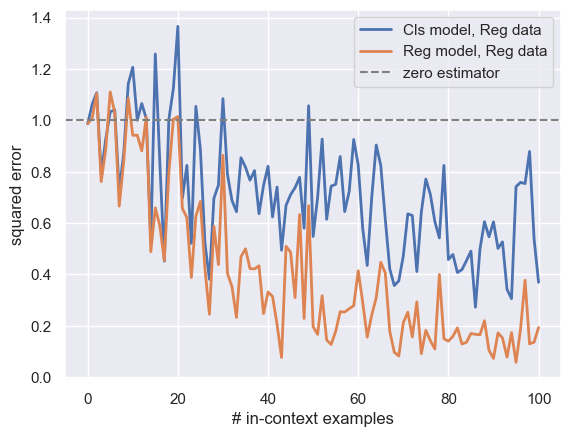

In [63]:
t_name = "DT"
task = tasks[t_name]
metric = task.get_metric()
xs = xs_all[t_name]
ys = ys_all[t_name]
model_cls = models["DTB"]
model_reg = models["DT"]
with torch.no_grad():
    pred_cls = model_cls(xs, ys)
    pred_reg = model_reg(xs, ys)
loss_cls = metric(pred_cls, ys).cpu().numpy()
loss_reg = metric(pred_reg, ys).cpu().numpy()
baseline = baselines["DT"]

plt.plot(loss_cls.mean(axis=0), lw=2, label="Cls model, Reg data")
plt.plot(loss_reg.mean(axis=0), lw=2, label="Reg model, Reg data")
plt.axhline(baseline, ls="--", color="gray", label="zero estimator")
plt.xlabel("# in-context examples")
plt.ylabel("squared error")
plt.legend()
plt.show()

As an exploration example, let's see how robust the decision tree model is to doubling all the inputs.

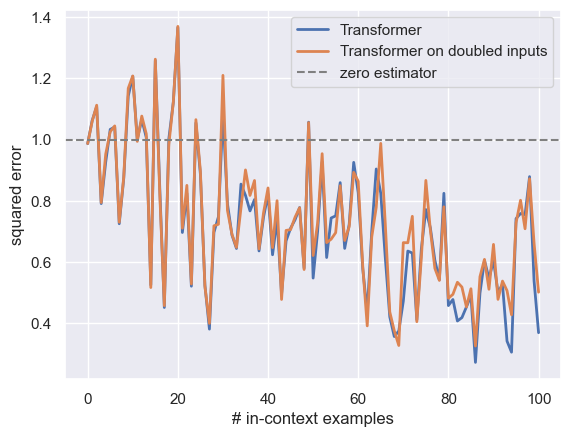

In [64]:
xs2 = 2 * xs
ys2 = task.evaluate(xs2)
with torch.no_grad():
    pred_cls2 = model_cls(xs2, ys2)
loss_cls2 = metric(pred_cls2, ys2).cpu().numpy()

plt.plot(loss_cls.mean(axis=0), lw=2, label="Transformer")
plt.plot(loss_cls2.mean(axis=0), lw=2, label="Transformer on doubled inputs")
plt.axhline(baseline, ls="--", color="gray", label="zero estimator")
plt.xlabel("# in-context examples")
plt.ylabel("squared error")
plt.legend()
plt.show()

The error does increase, especially when the number of in-context examples exceeds the dimension, but the model is still relatively accurate.

We compare boolean-valued vs continuous-valued outputs on single classifiers.

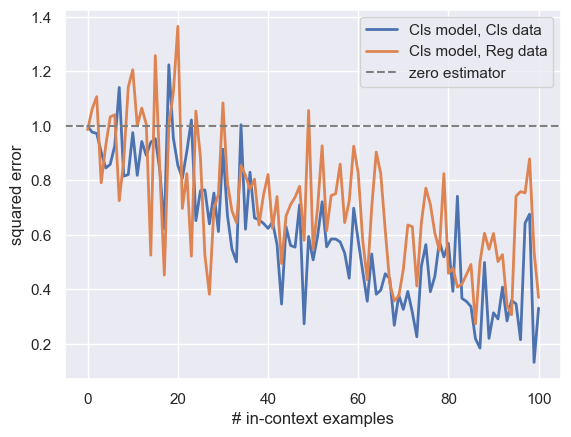

In [66]:
t_name = "DTB"
task = tasks[t_name]
metric = task.get_metric()
xs_bool = xs_all[t_name]
ys_bool = ys_all[t_name]
with torch.no_grad():
    pred_cls_bool = model_cls(xs_bool, ys_bool)
loss_cls_bool = metric(pred_cls_bool, ys_bool).cpu().numpy()

plt.plot(loss_cls_bool.mean(axis=0), lw=2, label="Cls model, Cls data")
plt.plot(loss_cls.mean(axis=0), lw=2, label="Cls model, Reg data")
plt.axhline(baseline, ls="--", color="gray", label="zero estimator")
plt.xlabel("# in-context examples")
plt.ylabel("squared error")
plt.legend()
plt.show()

We finally compare classification and regression datasets and models with both 3 and 4-layer DTs.

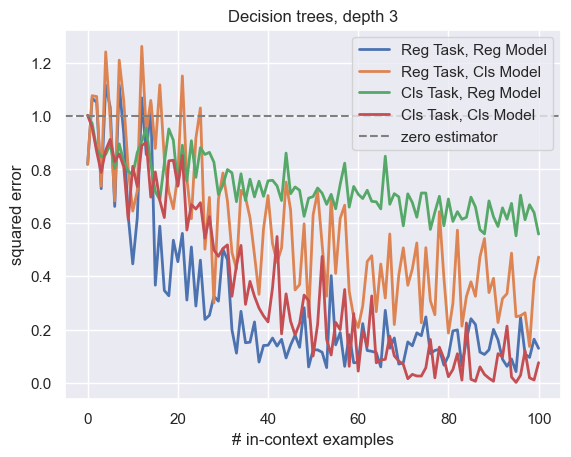

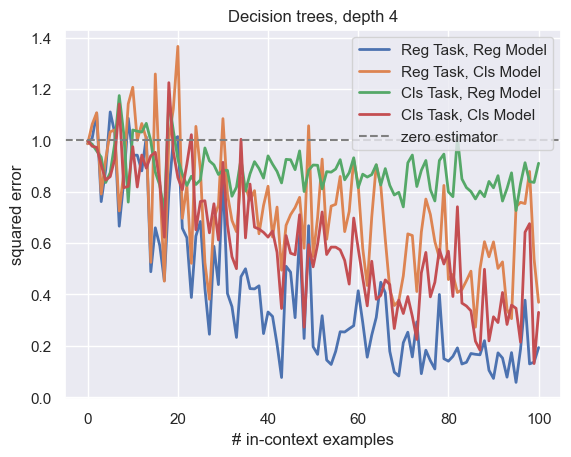

In [69]:
depths = [3,4]
categories = ["Reg", "Cls"]

for i, t_names_depth in enumerate([["DT_shallow", "DTB_shallow"], ["DT", "DTB"]]):
    for j, t_name in enumerate(t_names_depth):
        xs = xs_all[t_name]
        ys = ys_all[t_name]
        for k, m_name in enumerate(["DT", "DTB"]):
            label = f"{categories[j]} Task, {categories[k]} Model"
            with torch.no_grad():
                pred = models[m_name](xs, ys)
            loss = metric(pred, ys).cpu().numpy()
            plt.plot(loss.mean(axis=0), lw=2, label=label)

    plt.axhline(baseline, ls="--", color="gray", label="zero estimator")
    plt.xlabel("# in-context examples")
    plt.ylabel("squared error")
    plt.title(f"Decision trees, depth {depths[i]}")
    plt.legend()
    plt.show()


## Sequentiality: does order matter?

Question: to what extent does the model memorize recent outputs? If we change the order of the sequence (e.g. order the first 75 samples by output leaf and keeping the last 25 random), are results substantially worse?

/var/folders/67/jn51thvj1pb07505h888bfww0000gn/T/ipykernel_57034/3929330717.py:12: UserWarning: torch.range is deprecated and will be removed in a future release because its behavior is inconsistent with Python's range builtin. Instead, use torch.arange, which produces values in [start, end).
  torch.range(cutoff, samples-1, dtype=torch.int64).repeat((batch_size, 1))


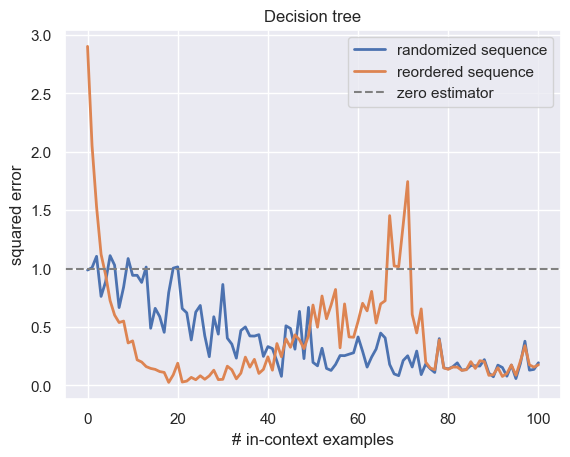

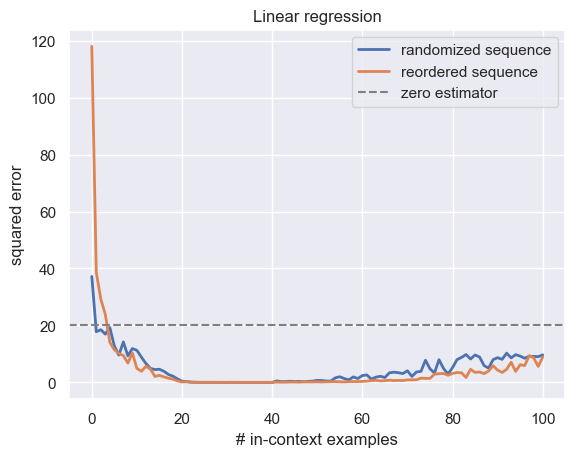

In [74]:
sequence_order_plot("DT")
sequence_order_plot("LR")

## Visualized function outputs

Creates 2-d plots that show how a the learned decision tree model changes its output as a function of two variables. All others are fixed, some with chosen signs and others with random signs.

In [76]:
def grid_visualization(var1, var2, preset_vars, t_name, m_name, max_val=1.5, width=20, train_samples=50):
    xs = data_samplers[t_name].sample_xs(b_size=1, n_points=train_samples, seeds=[0]).to(mps_device)
    # xs[0, train_samples] = xs[0, -1]
    # xs = xs[:, :train_samples+1]

    for var, sign in preset_vars.items():
        xs[0, -1, var] = abs(xs[0, -1, var]) * sign
    evaluated_grid = np.zeros((width, width))
    grid_ticks = np.linspace(-max_val, max_val, width)
    for i, val1 in enumerate(grid_ticks):
        for j, val2 in enumerate(grid_ticks):
            xs_cell = xs
            xs_cell[0, -1, var1] = val1
            xs_cell[0, -1, var2] = val2
            ys_cell = task.evaluate(xs_cell).to(mps_device)
            evaluated_grid[j, i] = models[m_name](xs_cell, ys_cell)[0][-1]
    # h = plt.contourf(grid_ticks, grid_ticks, evaluated_grid)
    plt.imshow(evaluated_grid, interpolation="bilinear", extent=[-max_val, max_val, -max_val, max_val], origin='lower')
    plt.axis('scaled')
    plt.xlabel(f"var {var1}")
    plt.ylabel(f"var {var2}")
    plt.colorbar()
    xv, yv = np.meshgrid(grid_ticks, grid_ticks)
    plt.plot(xv, yv, marker='.', color='b', linestyle='none')
    plt.title(f"n = {train_samples}, presets: {preset_vars}")
    plt.show()


**Task 0**

4?
* 19?
    * 0?
        * 2.8663
        * -0.5655
    * 3?
        * 0.1604
        * -0.0254
* 13?
    * 19? 
        * 1.0739
        * 2.2628
    * 7?
        * -0.9175
        * -0.2251

### Continuous-output decision trees

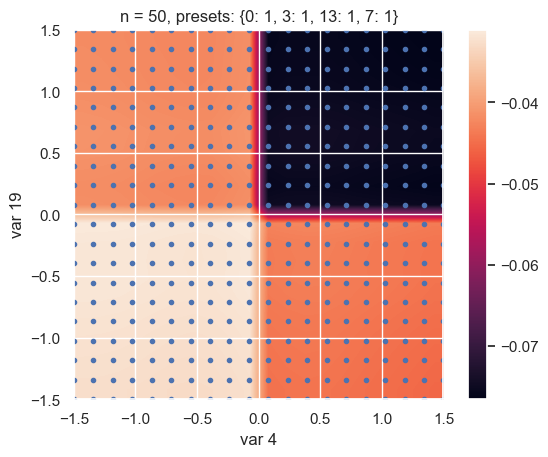

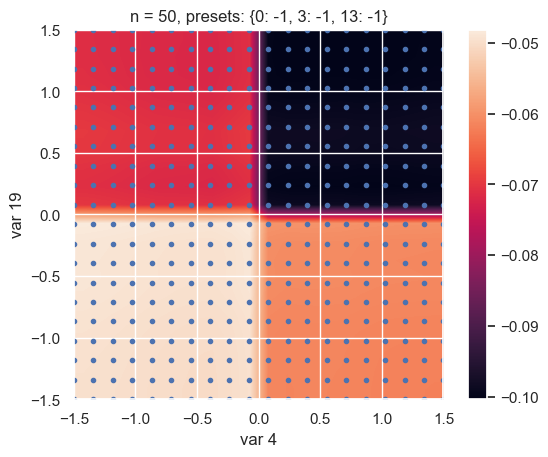

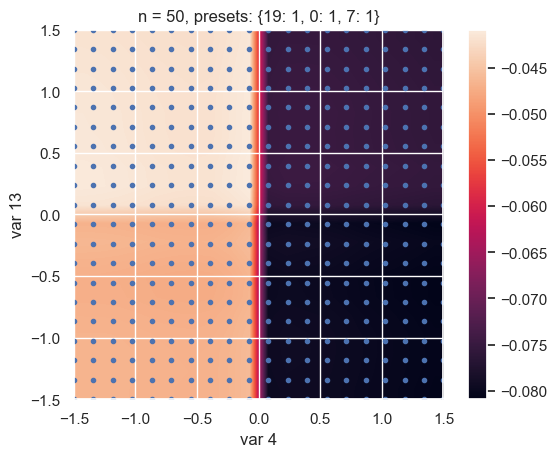

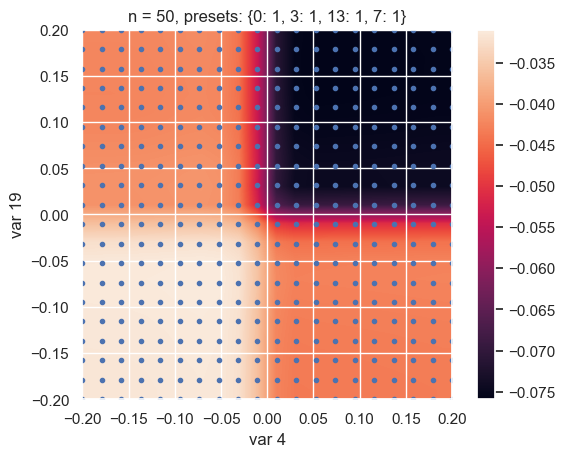

In [78]:
m_name = "DT"
t_name = "DT_shallow"

# top-level splits
grid_visualization(4, 19, {0: 1, 3: 1, 13: 1, 7: 1}, t_name, m_name)
grid_visualization(4, 19, {0: -1, 3: -1, 13: -1}, t_name, m_name)
grid_visualization(4, 13, {19: 1, 0: 1, 7: 1}, t_name, m_name)

# zoomed in
grid_visualization(4, 19, {0: 1, 3: 1, 13: 1, 7: 1}, t_name, m_name, max_val=0.2)

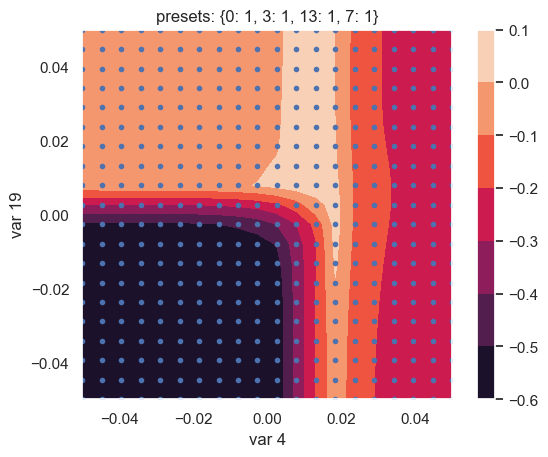

In [ ]:
# even more zoom
grid_visualization(4, 19, {0: 1, 3: 1, 13: 1, 7: 1}, t_name, m_name, max_val=0.05)

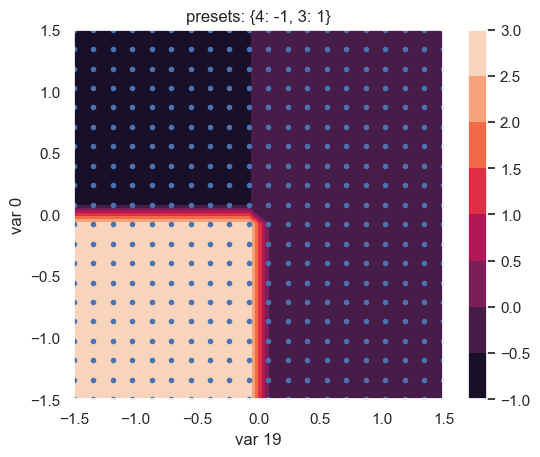

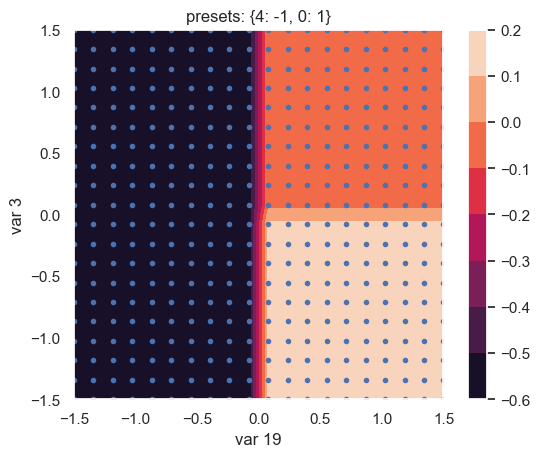

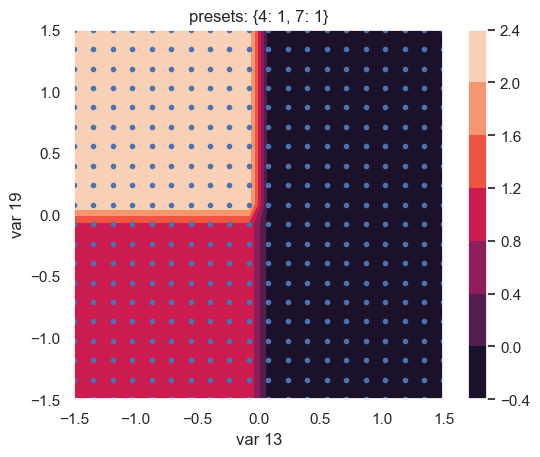

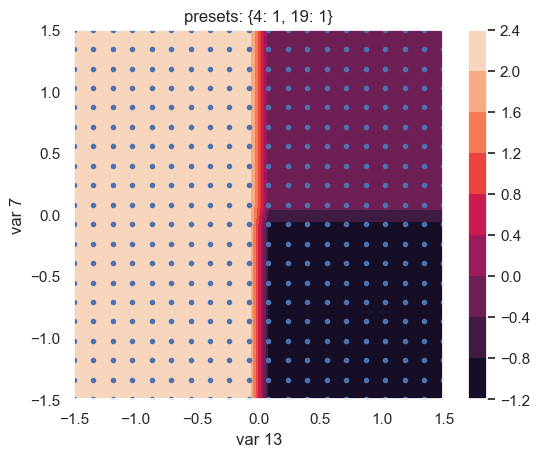

In [ ]:
# second-level splits
grid_visualization(19, 0, {4: -1, 3: 1}, t_name, m_name)
grid_visualization(19, 3, {4: -1, 0: 1}, t_name, m_name)
grid_visualization(13, 19, {4: 1, 7: 1}, t_name, m_name)
grid_visualization(13, 7, {4: 1, 19: 1}, t_name, m_name)

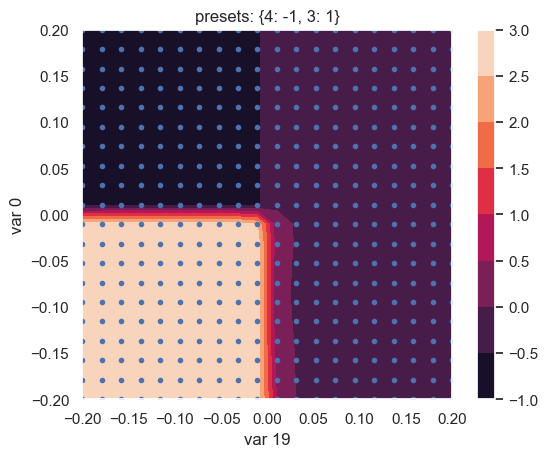

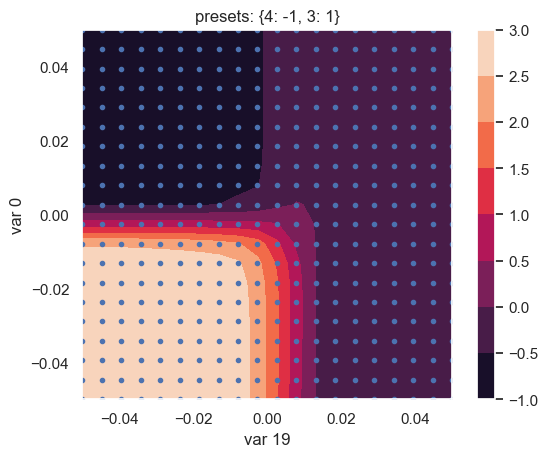

In [ ]:
# zoom
grid_visualization(19, 0, {4: -1, 3: 1}, t_name, m_name, max_val=0.2)
grid_visualization(19, 0, {4: -1, 3: 1}, t_name, m_name, max_val=0.05)

### Boolean-output decision trees

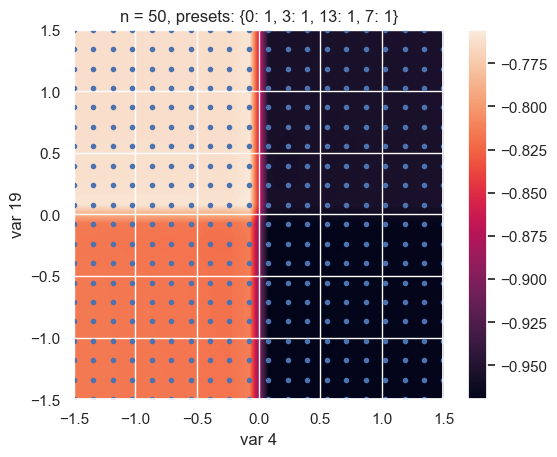

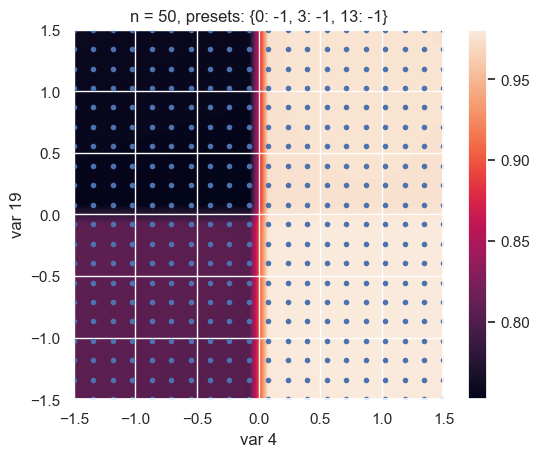

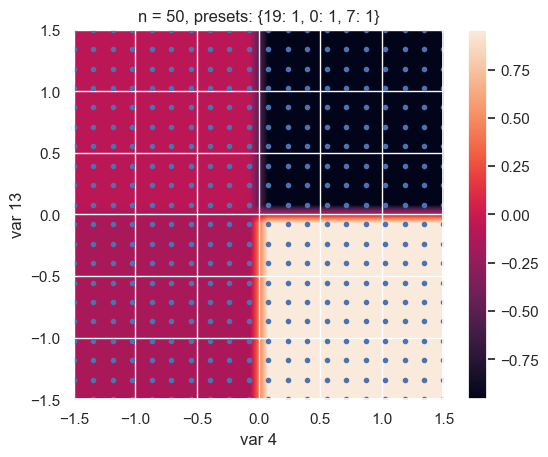

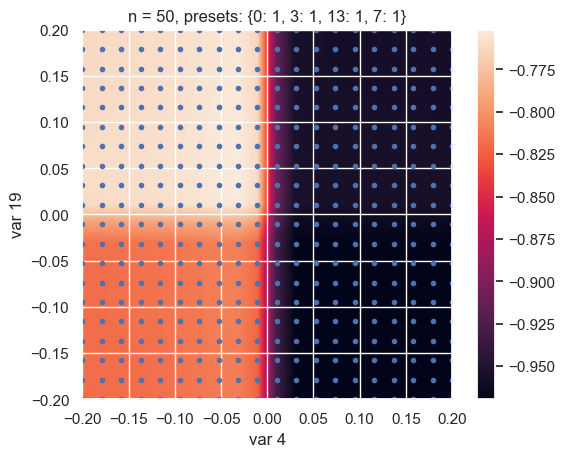

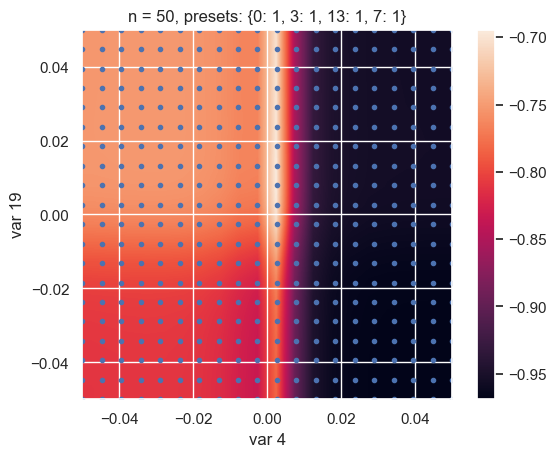

...

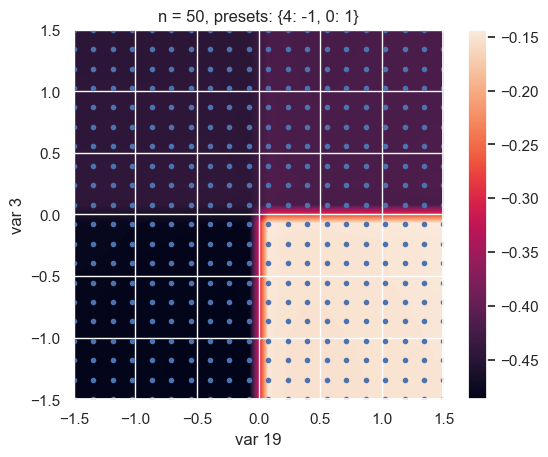

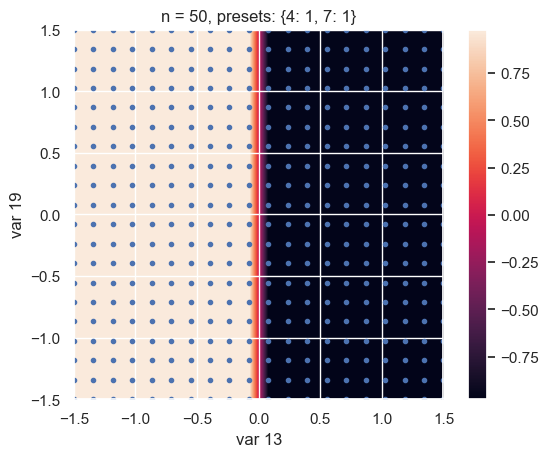

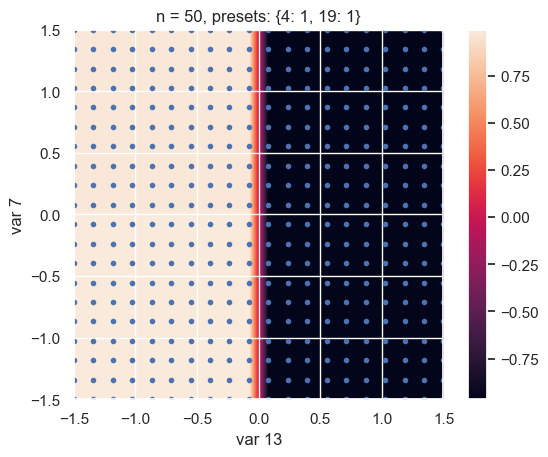

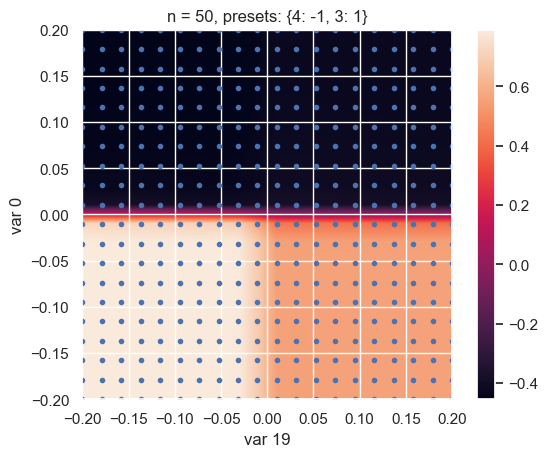

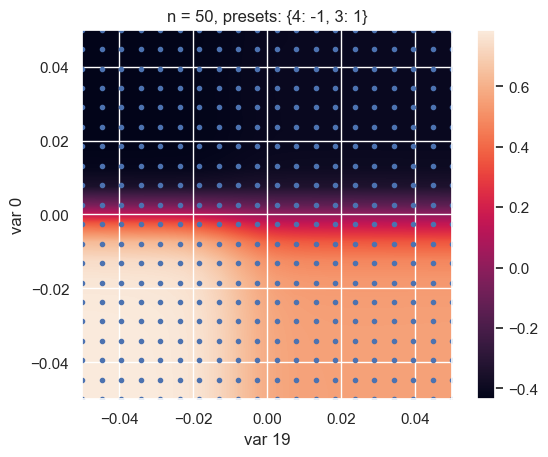

In [ ]:
m_name = "DTB"
t_name = "DTB_shallow"

# top-level splits
grid_visualization(4, 19, {0: 1, 3: 1, 13: 1, 7: 1}, t_name, m_name)
grid_visualization(4, 19, {0: -1, 3: -1, 13: -1}, t_name, m_name)
grid_visualization(4, 13, {19: 1, 0: 1, 7: 1}, t_name, m_name)

# zoomed in
grid_visualization(4, 19, {0: 1, 3: 1, 13: 1, 7: 1}, t_name, m_name, max_val=0.2)

# even more zoom
grid_visualization(4, 19, {0: 1, 3: 1, 13: 1, 7: 1}, t_name, m_name, max_val=0.05)

# second-level splits
grid_visualization(19, 0, {4: -1, 3: 1}, t_name, m_name)
grid_visualization(19, 3, {4: -1, 0: 1}, t_name, m_name)
grid_visualization(13, 19, {4: 1, 7: 1}, t_name, m_name)
grid_visualization(13, 7, {4: 1, 19: 1}, t_name, m_name)

# zoom
grid_visualization(19, 0, {4: -1, 3: 1}, t_name, m_name, max_val=0.2)
grid_visualization(19, 0, {4: -1, 3: 1}, t_name, m_name, max_val=0.05)

## Generates truth tables as CSVs
Can be used in sheets like this: https://docs.google.com/spreadsheets/d/1lnk35boHj4vB1eMp0rYzcIy4dSZSUHwoKDxpVhmNj4s/edit#gid=1149600274

In [ ]:
relevant_vars = [4, 19, 13, 0, 3, 7]

In [79]:
def truth_table(relevant_vars, train_samples=[50], t_name="DT_shallow", m_name="DT"):
    xs = data_samplers[t_name].sample_xs(b_size=1, n_points=train_samples[-1], seeds=[0]).to(mps_device)

    sign_labels = {var: f"{var} sign" for var in relevant_vars}
    ys_label = ["true ys"]
    pred_labels = {t: f"pred {t}" for t in train_samples}

    tt = pd.DataFrame()
    for i, var in enumerate(relevant_vars):
        tt[sign_labels[var]] = (-1)**(np.arange(2**len(relevant_vars)) // 2**(len(relevant_vars) - i - 1) % 2)
    
    tt[ys_label] = 0.
    for pred_label in pred_labels.values():
        tt[pred_label] = 0.

    for t in train_samples:
        print(t)
        xs_t = xs[:, :t+1].clone()
        xs_t[0, -1] = xs[0, -1]
        print(xs_t)
        for j, tt_row in tt.iterrows():
            for i, var in enumerate(relevant_vars):
                xs_t[0, -1, var] = abs(xs_t[0, -1, var]) * tt_row[sign_labels[var]]
            ys_t = task.evaluate(xs_t).to(mps_device)
            tt.loc[j, ys_label] = ys_t[0,-1].item()
            tt.loc[j, pred_labels[t]] = models[m_name](xs_t, ys_t)[0].detach().cpu()[-1].item()

    return tt, sign_labels, pred_labels

In [ ]:
tt_cls, _, _ = truth_table(relevant_vars=relevant_vars, train_samples=range(201), t_name="DTB_shallow", m_name="DTB")
tt_cls.to_csv("truth_table_boolean_201.csv")

/var/folders/67/jn51thvj1pb07505h888bfww0000gn/T/ipykernel_51417/3798444215.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  tt[pred_label] = 0.
/var/folders/67/jn51thvj1pb07505h888bfww0000gn/T/ipykernel_51417/3798444215.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  tt[pred_label] = 0.
/var/folders/67/jn51thvj1pb07505h888bfww0000gn/T/ipykernel_51417/3798444215.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consid

0
tensor([[[ 0.4873, -0.3065,  0.7303, -0.6932, -0.2841,  0.4120,  0.2585,
           0.4390,  0.2149, -0.5352, -1.2418,  0.5005, -0.2903, -1.2377,
          -0.1696, -0.1652, -0.3956,  0.7103,  0.3699, -0.1895]]],
       device='mps:0')
1
tensor([[[-1.1258, -1.1524, -0.2506, -0.4339,  0.8487,  0.6920, -0.3160,
          -2.1152,  0.3223, -1.2633,  0.3500,  0.3081,  0.1198,  1.2377,
           1.1168, -0.2473, -1.3527, -1.6959,  0.5667,  0.7935],
         [ 0.4873, -0.3065,  0.7303, -0.6932, -0.2841,  0.4120,  0.2585,
           0.4390,  0.2149, -0.5352, -1.2418,  0.5005, -0.2903, -1.2377,
          -0.1696, -0.1652, -0.3956,  0.7103,  0.3699, -0.1895]]],
       device='mps:0')
2
tensor([[[-1.1258, -1.1524, -0.2506, -0.4339,  0.8487,  0.6920, -0.3160,
          -2.1152,  0.3223, -1.2633,  0.3500,  0.3081,  0.1198,  1.2377,
           1.1168, -0.2473, -1.3527, -1.6959,  0.5667,  0.7935],
         [ 0.5988, -1.5551, -0.3414,  1.8530,  0.7502, -0.5855, -0.1734,
           0.1835,  1.3894,

RuntimeError: 2'th index 202 of condition tensor does not match the other tensors

In [ ]:
tt_reg, _, _ = truth_table(relevant_vars=relevant_vars, train_samples=range(201), t_name="DT_shallow", m_name="DT")
tt_cls.to_csv("truth_table_201.csv")

## Adding noise to trained decision trees

In [82]:
noise_stds = [0, 0.01, 0.005, 0.1, 0.5, 1]
base_t_name = "DT_shallow"
n_dims = task_confs[base_t_name].model.n_dims
noise_tasks = [NoisyDecisionTree(n_dims, batch_size, seeds=range(batch_size), depth=3, noise_std=std) for std in noise_stds]

In [83]:
xs = data_samplers[base_t_name].sample_xs(b_size=batch_size, n_points=samples, seeds=range(batch_size)).to(mps_device)
ys_all_noise = [task.evaluate(xs).to(mps_device) for task in noise_tasks]

In [85]:
model = models["DT"]
with torch.no_grad():
    preds = [model(xs, ys_i) for ys_i in ys_all_noise]

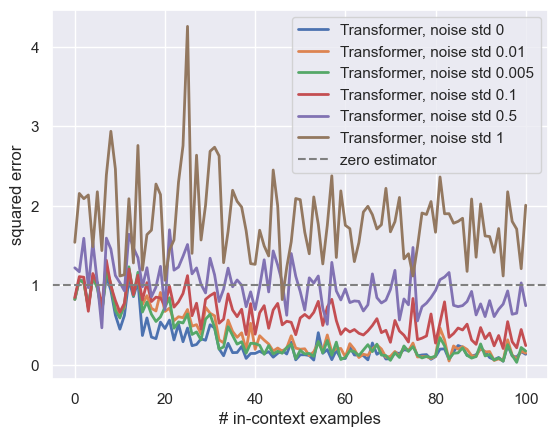

In [87]:
metric = noise_tasks[0].get_metric()
losses = [metric(pred_i, ys_i).cpu().numpy() for pred_i, ys_i in zip(preds, ys_all_noise)]

for j, std in enumerate(noise_stds):
    plt.plot(losses[j].mean(axis=0), lw=2, label=f"Transformer, noise std {std}")
plt.axhline(baselines["DT"], ls="--", color="gray", label="zero estimator")
plt.xlabel("# in-context examples")
plt.ylabel("squared error")
plt.legend()
plt.show()

## "Bertology" analysis

Looks attention unit by attention unit at the boolean-valued DT model.

In [9]:
def get_attention(xs, ys, model, samples=3):
    """Returns an attention matrix of full sequence inputs evaluated at a small number of samples"""
    pred = model(xs[:samples], ys[:samples], output_attentions=True)  # Run model
    attention = pred[-1]  # Retrieve attention from model outputs of a model evaluated at 
    tokens = [val for pair in zip([f"x{i}" for i in range(xs[0].shape[0])], [f"y{i}={ys[0][i].item():.1f}" for i in range(xs[0].shape[0])]) for val in pair]
    return attention, tokens


In [10]:
t_name = "DTB_shallow"
m_name = "DTB"
attention, tokens = get_attention(xs_all[t_name], ys_all[t_name], models[m_name])

### find commonalities

### analysis by clustering

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn import svm
import numpy as np
from matplotlib import gridspec
from itertools import product


In [ ]:
def print_dominant_literals(kmeans_x, x, c):
    """
    Given a collection of input points x partitioned into k clusters (with data stored in kmeans_x,
    analyzes the cth cluster to find 
    """
    c_labels = np.where(kmeans_x.labels_ == c)[0]
    literals1 = []
    scores1 = []
    for l in range(20):
        for s in [-1, 1]:
            literal = f"+{l}" if s == 1 else f"-{l}"
            literals1.append(literal)
            score = (x.cpu()[i][c_labels, l] * s >= 0).sum().item() / len(c_labels)
            scores1.append(score)

    order1 = np.argsort(-1 * np.asarray(scores1))
    scores1 = np.asarray(scores1)[order1]
    literals1 = np.asarray(literals1)[order1]
    print("; ".join([f"({i + 1}) {literals1[i]}: {scores1[i]:.2f}" for i in range(10)]))

    literals2_and = []
    scores2_and = []
    literals2_or = []
    scores2_or = []
    for l1 in range(20):
        for l2 in range(l1+1, 20):
            for s1, s2, gate in product([-1, 1], [-1, 1], [-1, 1]):
                lit1 = f"+{l1}" if s1 == 1 else f"-{l1}"
                lit2 = f"+{l2}" if s2 == 1 else f"-{l2}"
                literal = f"{lit1} AND {lit2}" if gate == 1 else f"{lit1} OR {lit2}"
                
                if gate == 1:
                    literals2_and.append(literal)
                    score = ((x.cpu()[i][c_labels, l1] * s1 >= 0) & (x.cpu()[i][c_labels, l2] * s2 >= 0)).sum().item() / len(c_labels)
                    scores2_and.append(score)
                else:
                    literals2_or.append(literal)
                    score = ((x.cpu()[i][c_labels, l1] * s1 >= 0) | (x.cpu()[i][c_labels, l2] * s2 >= 0)).sum().item() / len(c_labels)
                    scores2_or.append(score)

    order2_and = np.argsort(-1 * np.asarray(scores2_and))
    scores2_and = np.asarray(scores2_and)[order2_and]
    literals2_and = np.asarray(literals2_and)[order2_and]
    print("; ".join([f"({i + 1}) {literals2_and[i]}: {scores2_and[i]:.2f}" for i in range(10)]))

    order2_or = np.argsort(-1 * np.asarray(scores2_or))
    scores2_or = np.asarray(scores2_or)[order2_or]
    literals2_or = np.asarray(literals2_or)[order2_or]
    print("; ".join([f"({i + 1}) {literals2_or[i]}: {scores2_or[i]:.2f}" for i in range(10)]))

In [ ]:
def print_cluster_y_weight(kmeans, y, i, c):
    center = kmeans.cluster_centers_[c]
    total_weights = {}
    for j, weight in enumerate(center[1::2]):
        if y[j] not in total_weights:
            total_weights[y[j]] = 0
        total_weights[y[j]] += weight
    print(total_weights)            

In [ ]:
def print_cluster_pathways(kmeans, x, y, model, task, i, c):
    pathways = task.evaluate_pathway(x)
    center = kmeans.cluster_centers_[c]
    total_weights = {}
    for j, weight in enumerate(center[1::2]):
        if pathways[i][j].item() not in total_weights:
            total_weights[pathways[i][j].item()] = 0
        total_weights[pathways[i][j].item()] += weight
    print(total_weights)         

In [ ]:
def analyze_attn_matrix(x, y, model, layer, head, sample, task):
    # print(x.shape)

    attention, _ = get_attention(x, y, model)
    attn_mat = attention[layer].detach().cpu()[sample][head]

    gs = gridspec.GridSpec(3, 4, width_ratios=[0.25, 0.25, 1, 1],
    wspace=0.04, hspace=0.04, top=0.95, bottom=0.05, left=0.17, right=0.845) 

    attn_x = attn_mat[::2]
    attn_y = attn_mat[1::2]

    k_vals = range(2, 10)
    scores_x = []
    scores_y = []

    for k in k_vals:
        kmeans_x = KMeans(n_clusters=k, random_state=0, n_init="auto").fit(attn_x)
        scores_x.append(silhouette_score(attn_x, kmeans_x.labels_))
        kmeans_y = KMeans(n_clusters=k, random_state=0, n_init="auto").fit(attn_y)
        scores_y.append(silhouette_score(attn_y, kmeans_y.labels_))

    plt.plot(k_vals, scores_x, label="scores x")
    plt.plot(k_vals, scores_y, label="scores y")
    plt.legend()
    plt.show()

    k_x = k_vals[np.argmax(np.asarray(scores_x))]
    k_y = k_vals[np.argmax(np.asarray(scores_y))]

    kmeans_x = KMeans(n_clusters=k_x, random_state=0, n_init="auto").fit(attn_x)
    kmeans_y = KMeans(n_clusters=k_y, random_state=0, n_init="auto").fit(attn_y)

    kmeans_all = [kmeans_x, kmeans_y]

    for i, (kmeans, k) in enumerate(zip([kmeans_x, kmeans_y], [k_x, k_y])):
        if i == 0:
            print("x query cluster:")
        else:
            print("y query cluster:")

        cls = svm.LinearSVC(multi_class="ovr").fit(x.cpu()[i], kmeans.labels_)
        if k == 2:
            print(f"SVM coefs: {cls.coef_[0]}")
            print(f"class1: {np.where(kmeans.labels_ == 0)[0]}")
            print_dominant_literals(kmeans, x, sample, 0)
            # print_cluster_y_weight(kmeans, ys, i, 0)
            print_cluster_pathways(kmeans, x, y, model, task, sample, 0)
            print(f"class2: {np.where(kmeans.labels_ == 1)[0]}")
            print_dominant_literals(kmeans, x, sample, 1)
            # print_cluster_y_weight(kmeans, ys, i, 1)
            print_cluster_pathways(kmeans, x, y, model, task, sample, 1)
        else:
            for c in range(k):
                c_labels = np.where(kmeans.labels_ == c)[0]
                print(f"SVM coefs for class {c}: {cls.coef_[c]}\\class elements: {c_labels}")
                print_dominant_literals(kmeans, x, sample, c)
                # print_cluster_y_weight(kmeans, ys, i, c)
                print_cluster_pathways(kmeans, x, y, model, task, sample, c)


    # print(kmeans_x.labels_)

    fig = plt.figure(figsize=(15,8))

    # ax5 = plt.subplot(3, 4, 7)
    ax5 = plt.subplot(gs[1,2])
    plt.imshow(attn_mat[::2, ::2], vmin=0, vmax=1, cmap='Purples')
    plt.grid(None)
    plt.setp(ax5.get_xticklabels(), visible=False)
    plt.setp(ax5.get_yticklabels(), visible=False)

    # ax6 = plt.subplot(3, 4, 8, sharey=ax5)
    ax6 = plt.subplot(gs[1,3])
    plt.imshow(attn_mat[::2, 1::2], vmin=0, vmax=1, cmap='Purples')
    plt.grid(None)
    plt.setp(ax6.get_yticklabels(), visible=False)
    plt.setp(ax6.get_xticklabels(), visible=False)

    # ax8 = plt.subplot(3, 4, 11, sharex=ax5)
    ax8 = plt.subplot(gs[2,2])
    plt.imshow(attn_mat[1::2, ::2], vmin=0, vmax=1, cmap='Purples')
    plt.grid(None)
    plt.xlabel("x key")
    plt.setp(ax8.get_yticklabels(), visible=False)

    # ax9 = plt.subplot(3, 4, 12, sharey=ax8, sharex=ax6)
    ax9 = plt.subplot(gs[2,3])
    plt.imshow(attn_mat[1::2, 1::2], vmin=0, vmax=1, cmap='Purples')
    plt.grid(None)
    plt.setp(ax9.get_yticklabels(), visible=False)
    plt.xlabel("y key")

    # ax45 = plt.subplot(3, 4, 6, sharey=ax5)
    ax45 = plt.subplot(gs[1,1])
    plt.imshow(np.tile(kmeans_x.labels_, (10, 1)).T)
    plt.setp(ax45.get_xticklabels(), visible=False)
    plt.grid(None)
    plt.setp(ax45.get_yticklabels(), visible=False)

    # print(np.tile(kmeans_x.labels_, (10, 1)).T)

    # ax78 = plt.subplot(3, 4, 10, sharey=ax7, sharex=ax45)
    ax78 = plt.subplot(gs[2,1])
    plt.imshow(np.tile(kmeans_y.labels_, (10, 1)).T)
    plt.setp(ax78.get_xticklabels(), visible=False)
    plt.grid(None)
    plt.setp(ax78.get_yticklabels(), visible=False)

    # ax4 = plt.subplot(3, 4, 5, sharey=ax45)
    ax4 = plt.subplot(gs[1,0])
    plt.imshow(x.cpu()[sample] >= 0)
    plt.ylabel("x query")
    plt.grid(None)
    plt.setp(ax4.get_xticklabels(), visible=False)

    # ax7 = plt.subplot(3, 4, 9, sharex=ax4)
    ax7 = plt.subplot(gs[2,0])
    plt.imshow(y.cpu()[None, sample].tile(20,1).T, cmap="bwr")
    plt.grid(None)
    plt.setp(ax7.get_xticklabels(), visible=False)
    plt.ylabel("y query")

    # ax2 = plt.subplot(3, 4, 3, sharex=ax5)
    ax2 = plt.subplot(gs[0,2])
    plt.imshow(x.cpu()[sample].transpose(1,0) >= 0)
    plt.grid(None)
    plt.setp(ax2.get_xticklabels(), visible=False)
    plt.setp(ax2.get_yticklabels(), visible=False)

    # ax3 = plt.subplot(3, 4, 4, sharex=ax6, sharey=ax2)
    ax3 = plt.subplot(gs[0,3])
    plt.imshow(y.cpu()[None, sample].tile(20,1), cmap="bwr")
    plt.grid(None)
    plt.setp(ax3.get_xticklabels(), visible=False)
    plt.setp(ax3.get_yticklabels(), visible=False)

    # plt.subplots_adjust(wspace=0, hspace=0)

    # plt.tight_layout()
    
    fig.suptitle(f"layer {layer}, head {head}, round {sample}")


    plt.show()

    # plt.imshow(attn_mat, vmin=0, vmax=1, cmap="Purples")
    # plt.grid(None)
    # plt.show()

In [ ]:
analyze_attn_matrix(xs_boolean, ys_boolean, model, layer, head, i)

TypeError: analyze_attn_matrix() missing 1 required positional argument: 'task'

In [ ]:
xs_boolean.shape

torch.Size([32, 101, 20])

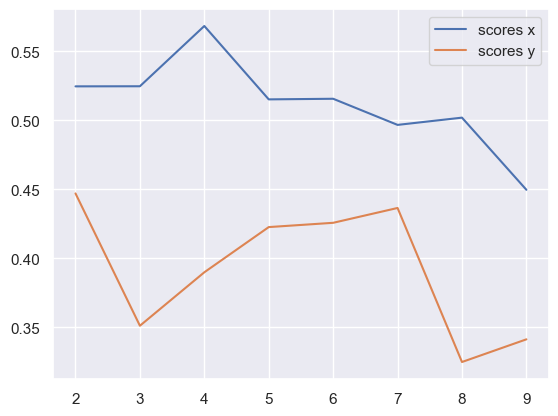

x query cluster:
SVM coefs for class 0: [-0.05783253 -0.10789471  0.27953599  0.08891318  0.02246073 -0.19238989
 -0.38329046 -0.01923216 -0.06000016 -0.24858711 -0.47809796  0.12081059
 -0.12372247  0.09940718 -0.05659219  0.00249835  0.14639384 -0.1018604
  0.40499848  0.04250744]\class elements: [ 0 15 17 18 23 26 27 39 41 44 47 49]
(1) -6: 0.75; (2) -11: 0.75; (3) -14: 0.67; (4) +13: 0.67; (5) -9: 0.67; (6) +4: 0.67; (7) +8: 0.58; (8) +5: 0.58; (9) +18: 0.58; (10) -19: 0.58
(1) -6 AND -11: 0.58; (2) -11 AND +16: 0.58; (3) -9 AND +13: 0.58; (4) -6 AND +16: 0.58; (5) +7 AND -14: 0.58; (6) -6 AND +18: 0.50; (7) -6 AND +8: 0.50; (8) -6 AND -9: 0.50; (9) -6 AND +10: 0.50; (10) +4 AND -11: 0.50
(1) -6 OR -16: 1.00; (2) -6 OR +7: 1.00; (3) +2 OR +18: 1.00; (4) -0 OR -6: 1.00; (5) +0 OR +5: 1.00; (6) -6 OR -10: 1.00; (7) -14 OR +18: 1.00; (8) -11 OR -17: 1.00; (9) +5 OR +8: 1.00; (10) -11 OR -16: 1.00
{7.0: 0.08364211154620878, 11.0: 0.11894186326679733, 8.0: 0.11349352281762398, 13.0: 0.1

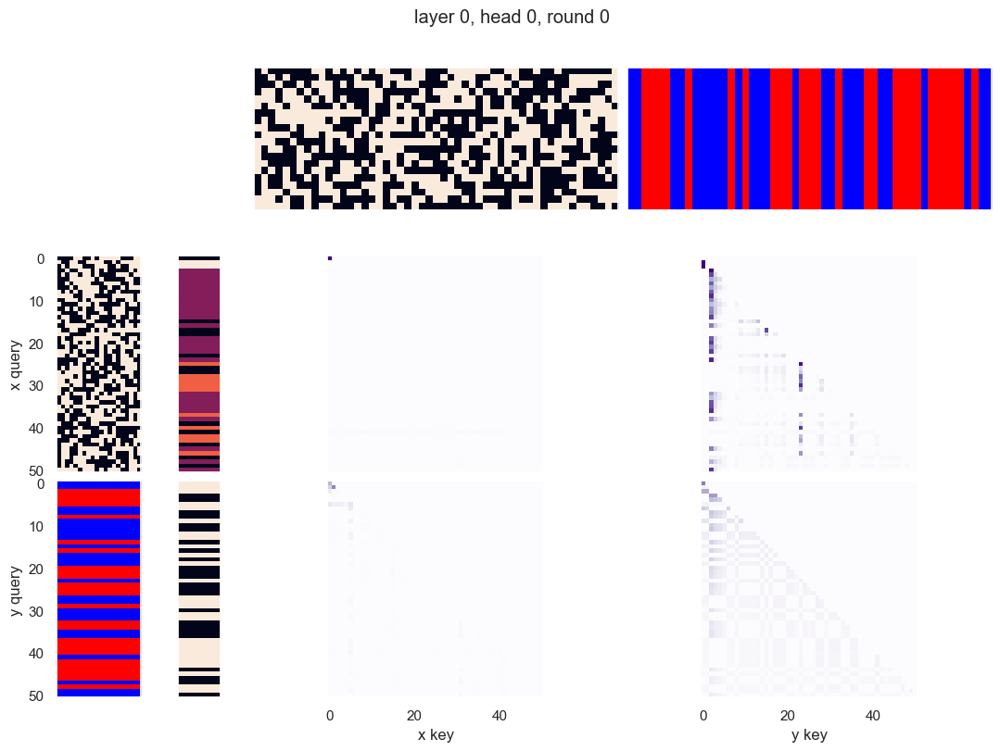

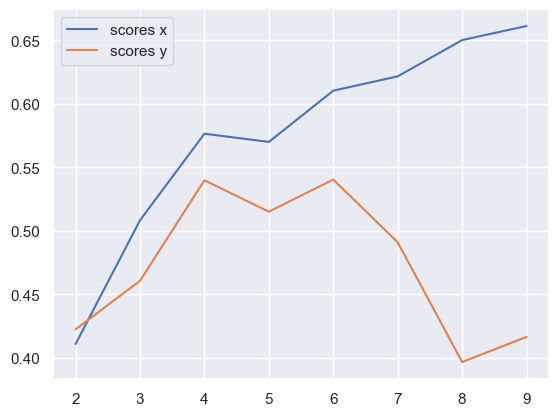

x query cluster:
SVM coefs for class 0: [ 0.04008597  0.3656721  -0.18225881 -0.1969884  -0.1234607   0.06967443
 -0.25455815  0.31519651  0.21002087 -0.41438249  0.44875373 -0.26335051
  0.13138005 -0.6076702   0.33976787 -0.85418584 -0.59870919 -0.20092648
  0.23382213 -0.1950771 ]\class elements: [44 46 48 50]
(1) -10: 1.00; (2) -18: 1.00; (3) -8: 1.00; (4) +2: 1.00; (5) +15: 1.00; (6) -6: 1.00; (7) -1: 0.75; (8) +17: 0.75; (9) +7: 0.75; (10) +14: 0.75
(1) -6 AND +15: 1.00; (2) -8 AND +15: 1.00; (3) -6 AND -8: 1.00; (4) -8 AND -18: 1.00; (5) +2 AND +15: 1.00; (6) -8 AND -10: 1.00; (7) -6 AND -10: 1.00; (8) +2 AND -18: 1.00; (9) +2 AND -8: 1.00; (10) +2 AND -10: 1.00
(1) +5 OR +15: 1.00; (2) +3 OR +13: 1.00; (3) -9 OR -10: 1.00; (4) +9 OR -10: 1.00; (5) -3 OR -13: 1.00; (6) +3 OR +12: 1.00; (7) -9 OR +11: 1.00; (8) +9 OR -11: 1.00; (9) -9 OR +12: 1.00; (10) -8 OR +19: 1.00
{0.0: 0.9999999822862264}
SVM coefs for class 1: [ 0.14212036 -0.1431751   0.0192565   0.29431403 -0.32448855 -0

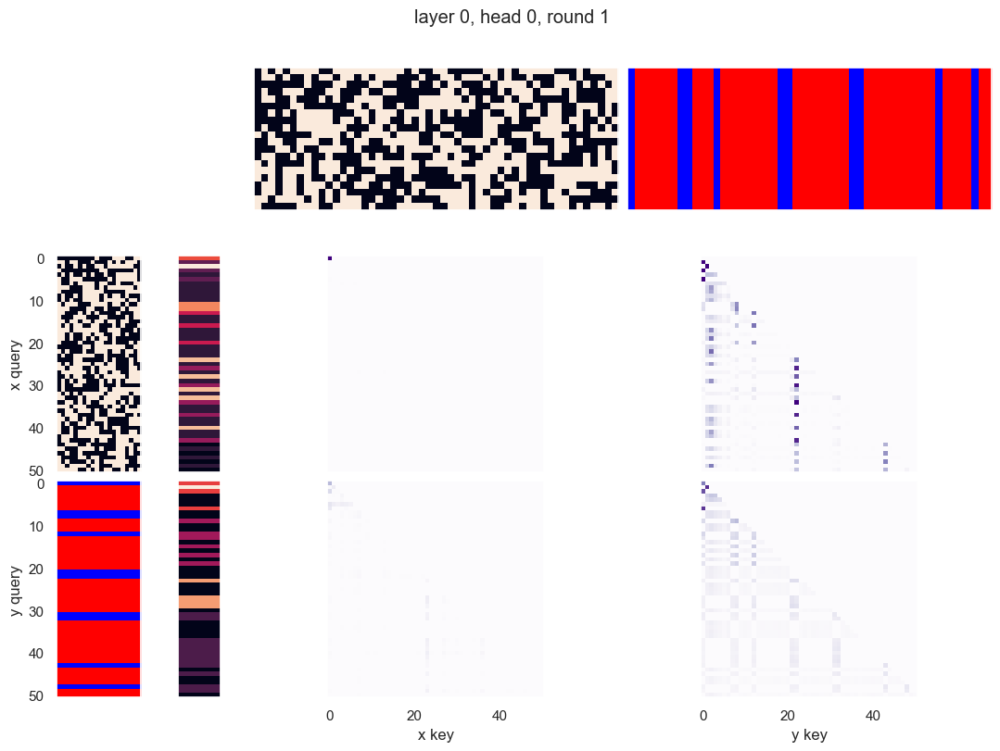

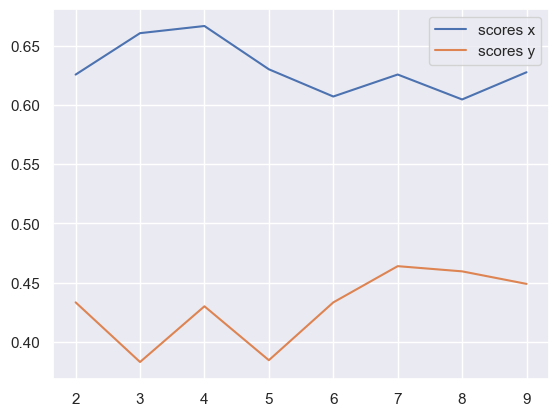

x query cluster:
SVM coefs for class 0: [ 0.26505756  0.02852229 -0.31108048  0.20951115  0.13127004  0.38955357
  0.07700055  0.08809604 -0.11328411 -0.03947506  0.06378351 -0.21580304
 -0.2687571   0.26993568  0.23747019 -0.16225495  0.31106894 -0.0379818
 -0.41753865  0.03165407]\class elements: [ 4  6  8  9 12 13 15 16 17 19 24 25 26 27 30 32 33 35 36 39 40 44 45 46
 49]
(1) +6: 1.00; (2) -0: 0.68; (3) +17: 0.64; (4) +4: 0.64; (5) +11: 0.60; (6) +14: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +16: 0.60; (10) -19: 0.60
(1) -0 AND +6: 0.68; (2) +6 AND +17: 0.64; (3) +4 AND +6: 0.64; (4) +6 AND +16: 0.60; (5) +6 AND +11: 0.60; (6) +6 AND +14: 0.60; (7) +2 AND +6: 0.60; (8) +6 AND -19: 0.60; (9) -3 AND +6: 0.60; (10) +6 AND +12: 0.56
(1) +6 OR -18: 1.00; (2) +6 OR +10: 1.00; (3) +6 OR -11: 1.00; (4) +6 OR +11: 1.00; (5) +6 OR -12: 1.00; (6) -2 OR +6: 1.00; (7) +6 OR -13: 1.00; (8) +6 OR +13: 1.00; (9) +6 OR -14: 1.00; (10) +6 OR +14: 1.00
{0.0: 0.9999999590168417}
SVM coefs for class 1: [-0

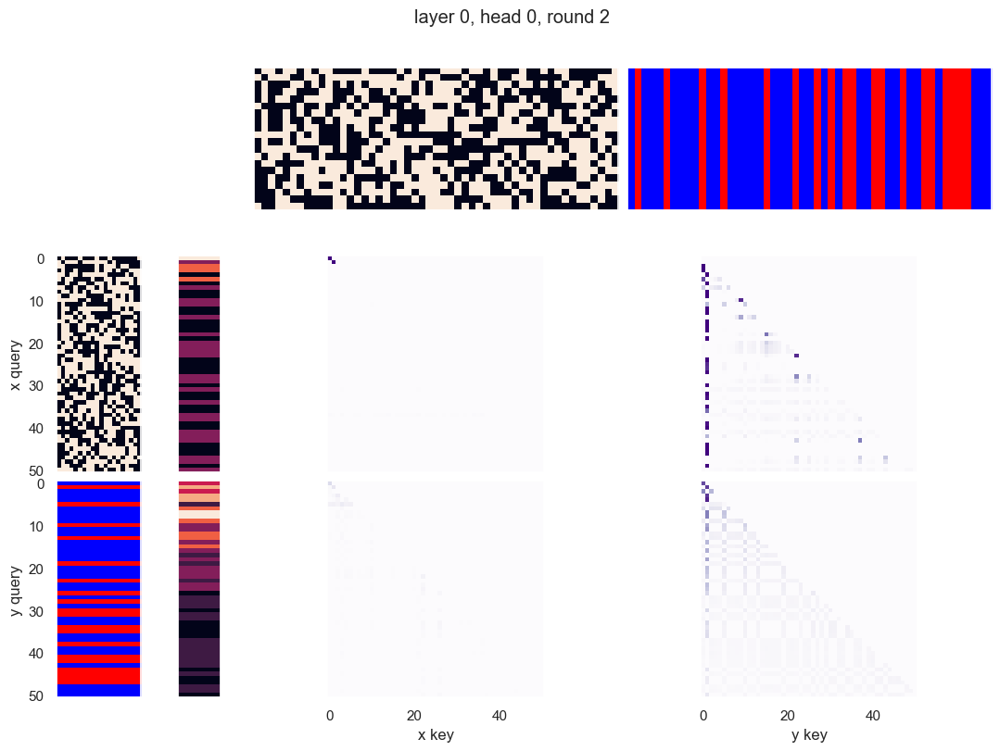

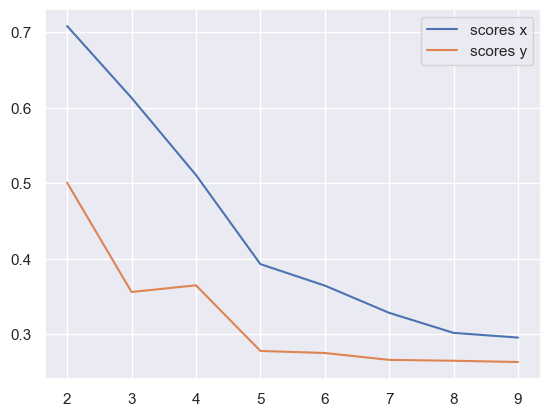

x query cluster:
SVM coefs: [ 0.25510043 -0.45921837  0.27299288  0.17551722 -0.21551345 -0.11984642
  0.07025495 -0.09278362  0.10832328  0.49035748 -0.00371066  0.20238024
 -0.11105036  0.23138145  0.04470233 -0.2945815  -0.46677614 -0.52135349
  0.5733143   0.62859397]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR

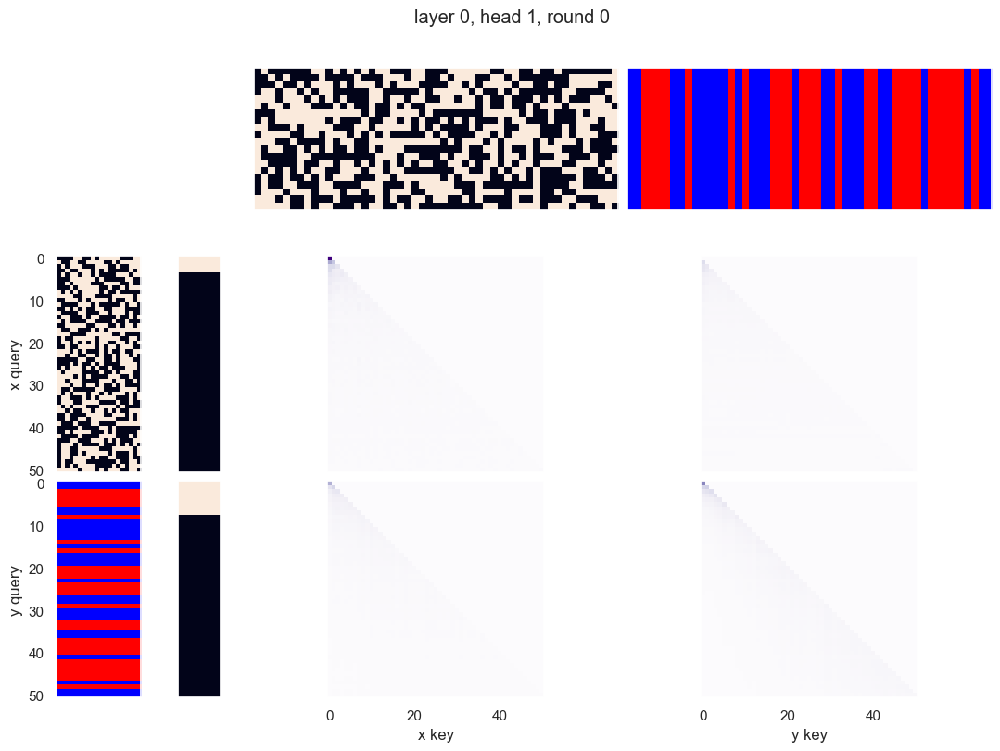

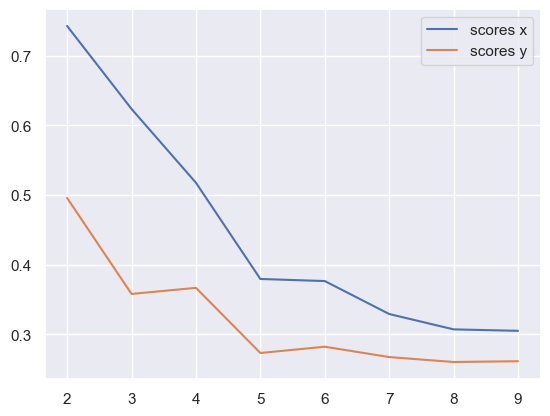

x query cluster:
SVM coefs: [ 0.26247867 -0.3228029   0.10229622  0.1478462  -0.20819989 -0.04183656
 -0.08340434 -0.00504046  0.46534481  0.28237072  0.02749884  0.26015663
  0.04959306  0.13378135  0.13217395 -0.16053122 -0.24772061 -0.5743163
  0.3758007   0.68952958]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) -12: 0.60; (4) +19: 0.58; (5) -16: 0.58; (6) +13: 0.58; (7) -2: 0.56; (8) -3: 0.56; (9) -4: 0.56; (10) +11: 0.56
(1) +0 AND -16: 0.42; (2) -3 AND +19: 0.42; (3) +0 AND -12: 0.42; (4) +0 AND +9: 0.42; (5) -2 AND -12: 0.42; (6) -12 AND -15: 0.42; (7) +0 AND -15: 0.40; (8) +9 AND +13: 0.40; (9) +5 AND -16: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.92; (2) +0 OR +14: 0.92; (3) +0 OR +11: 0.90; (4) +0 OR +17: 0.90; (5) +14 OR -15: 0.90; (6) +14 OR -16: 0.90; (7) +13 OR +19: 0.88; (8) +14 OR +19: 0.88; (9) +7 OR -12: 0.88; (10) +14 OR 

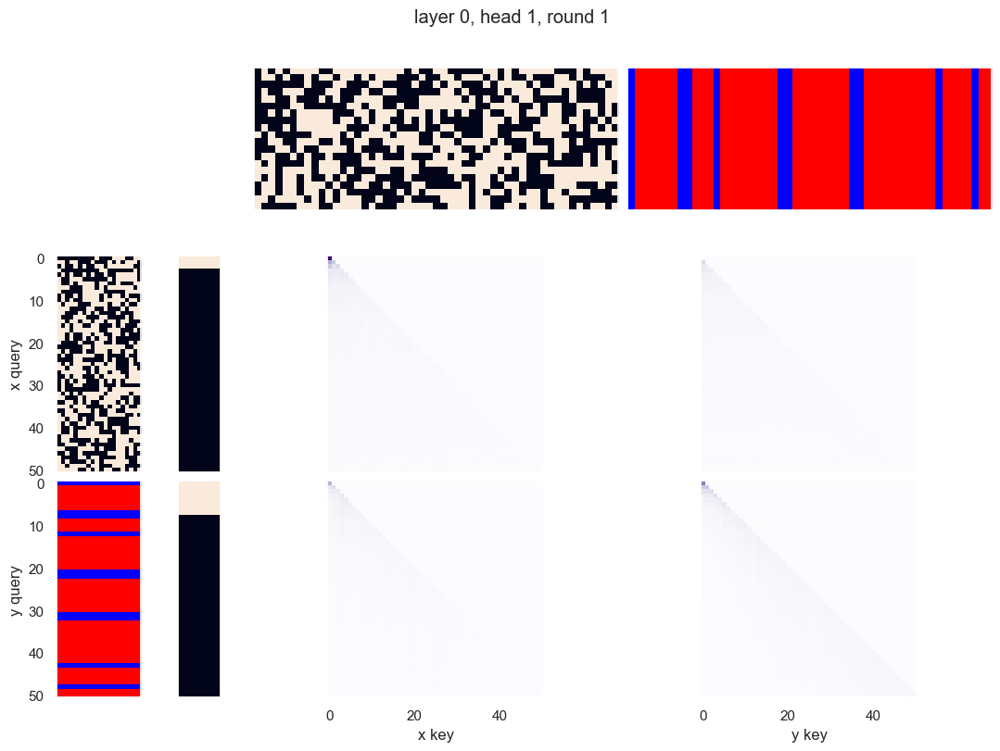

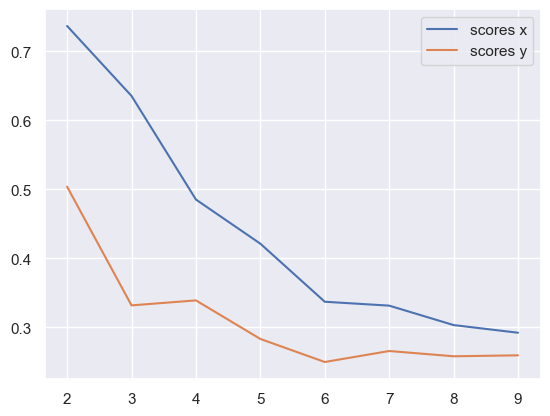

x query cluster:
SVM coefs: [ 0.26248132 -0.32280434  0.10229326  0.14784671 -0.20819848 -0.04183903
 -0.08340548 -0.00503991  0.46534696  0.28237285  0.0274991   0.26015396
  0.04958582  0.13378571  0.13217669 -0.16053375 -0.24771853 -0.57431874
  0.37580134  0.6895299 ]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -0: 0.60; (4) -19: 0.60; (5) +14: 0.60; (6) +2: 0.60; (7) +8: 0.58; (8) +13: 0.58; (9) +6: 0.56; (10) -5: 0.56
(1) +8 AND +16: 0.46; (2) +16 AND +17: 0.46; (3) +17 AND -19: 0.46; (4) -5 AND +16: 0.44; (5) +7 AND +16: 0.44; (6) -9 AND -19: 0.44; (7) -0 AND +17: 0.44; (8) +8 AND +13: 0.42; (9) +17 AND -18: 0.42; (10) -18 AND -19: 0.42
(1) +12 OR +16: 0.92; (2) +14 OR +16: 0.92; (3) +2 OR -5: 0.90; (4) -10 OR -19: 0.90; (5) +7 OR +17: 0.90; (6) +2 OR +4: 0.90; (7) -0 OR -10: 0.88; (8) -8 OR +16: 0.88; (9) +5 OR +16: 0.88; (10) +18 OR -

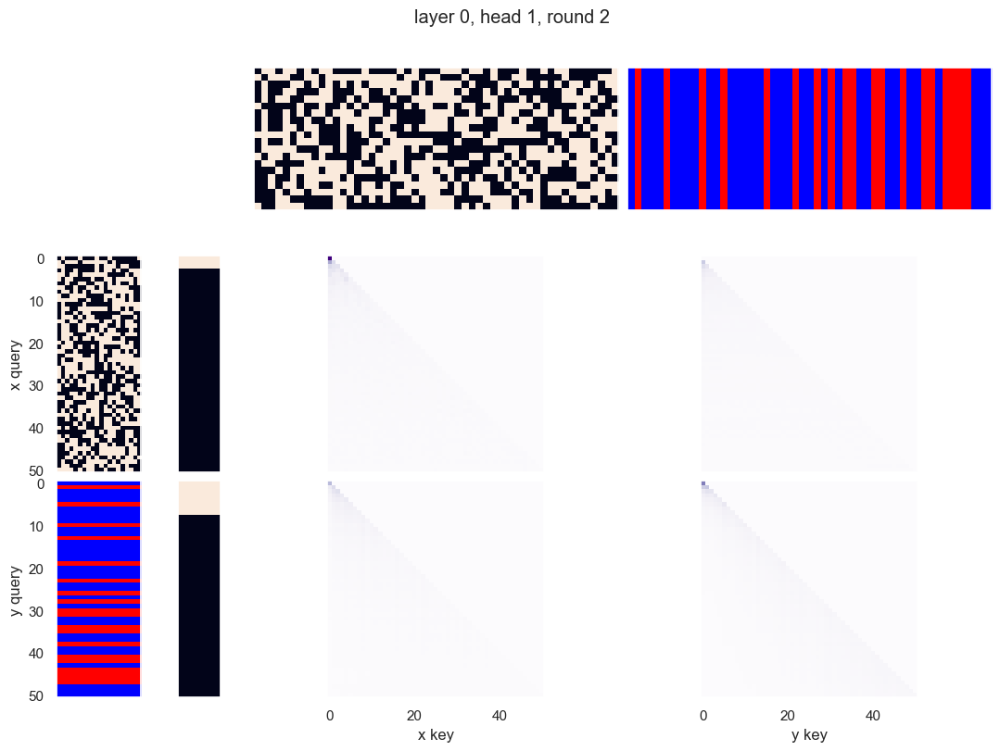

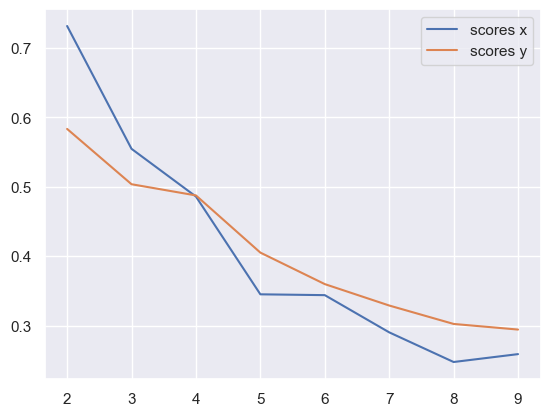

x query cluster:
SVM coefs: [ 0.26247719 -0.32280485  0.1022945   0.14784929 -0.20819586 -0.04183651
 -0.08340536 -0.00503981  0.46534974  0.28237561  0.02749661  0.2601539
  0.04958429  0.13378286  0.13217062 -0.16053081 -0.24771938 -0.574317
  0.37580099  0.68952977]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.65; (3) -11: 0.62; (4) -18: 0.62; (5) -12: 0.62; (6) +6: 0.62; (7) +10: 0.60; (8) -0: 0.58; (9) -3: 0.58; (10) +2: 0.58
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) -3 AND -18: 0.48; (5) +5 AND +17: 0.46; (6) -11 AND +17: 0.46; (7) +13 AND -18: 0.46; (8) +17 AND -18: 0.46; (9) -0 AND +17: 0.46; (10) +6 AND -16: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) -16 OR +17: 0.92; (7) +17 OR -19: 0.92; (8) +7 OR +10: 0.92; (9) +6 OR +10: 0.92; (10) +4 OR +

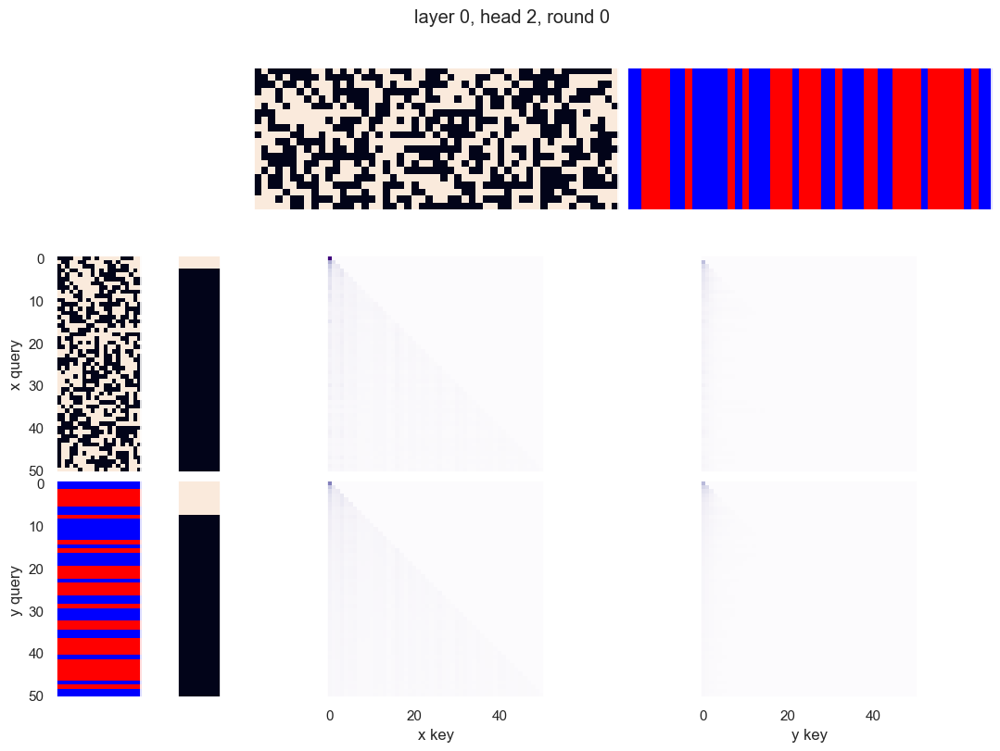

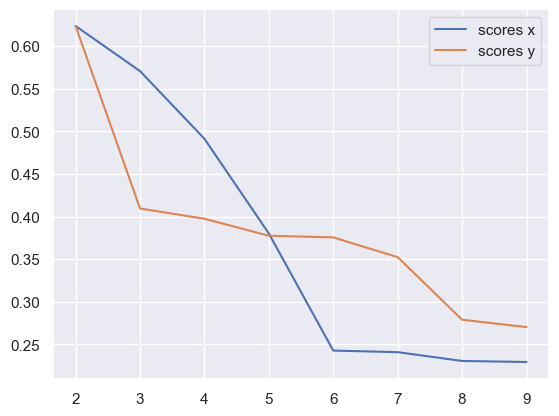

x query cluster:
SVM coefs: [-0.28794876 -0.47314376  1.02874005  0.38310607  0.32285284  0.25921739
  0.01952234  0.00168759  0.67963268  0.27149382 -0.32584055  0.59225006
  0.27769824 -0.56683263  0.12307531 -0.05073993  0.26541949 -0.64575592
  0.50792606  0.61017852]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +13: 0.64; (4) +19: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +9: 0.59; (8) -3: 0.59; (9) +6: 0.57; (10) +11: 0.55
(1) +0 AND +9: 0.45; (2) -3 AND +19: 0.45; (3) +9 AND +13: 0.43; (4) +13 AND +14: 0.43; (5) +0 AND +13: 0.41; (6) +9 AND +14: 0.41; (7) +13 AND -18: 0.41; (8) +0 AND -12: 0.41; (9) -12 AND -15: 0.41; (10) +5 AND -16: 0.41
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +6 OR -16: 0.89; (6) +7 OR -12: 0.89; (7) +14 OR +19: 0.89; (8) +14 OR +17: 0.89; (9) +14 OR -16: 0.89; (10) +0 OR +17: 0.89


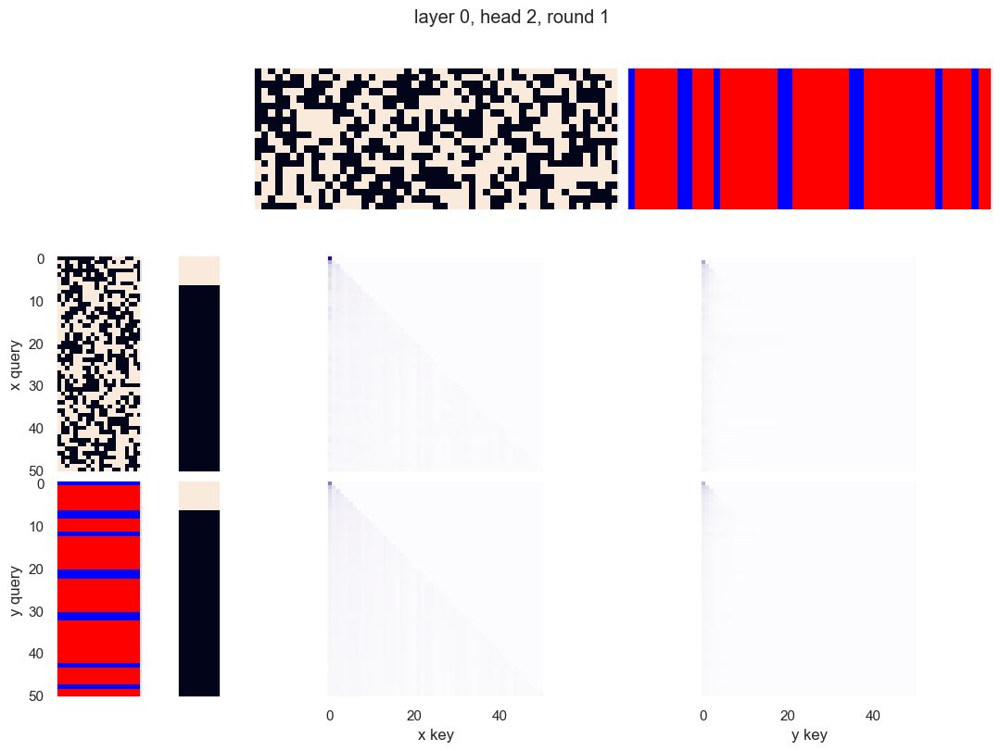

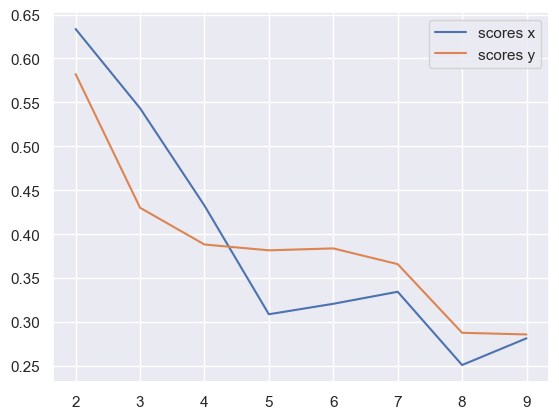

x query cluster:
SVM coefs: [-0.46865785 -0.57677886  0.27721027  0.2122645  -0.1184782  -0.05889439
  0.0072341  -0.45952593  0.42597117  0.43340747 -0.08995833  0.23647045
 -0.24495249 -0.49575645 -0.29612308  0.17306139  0.11536914 -0.67923993
  0.21284485  0.87186675]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.8

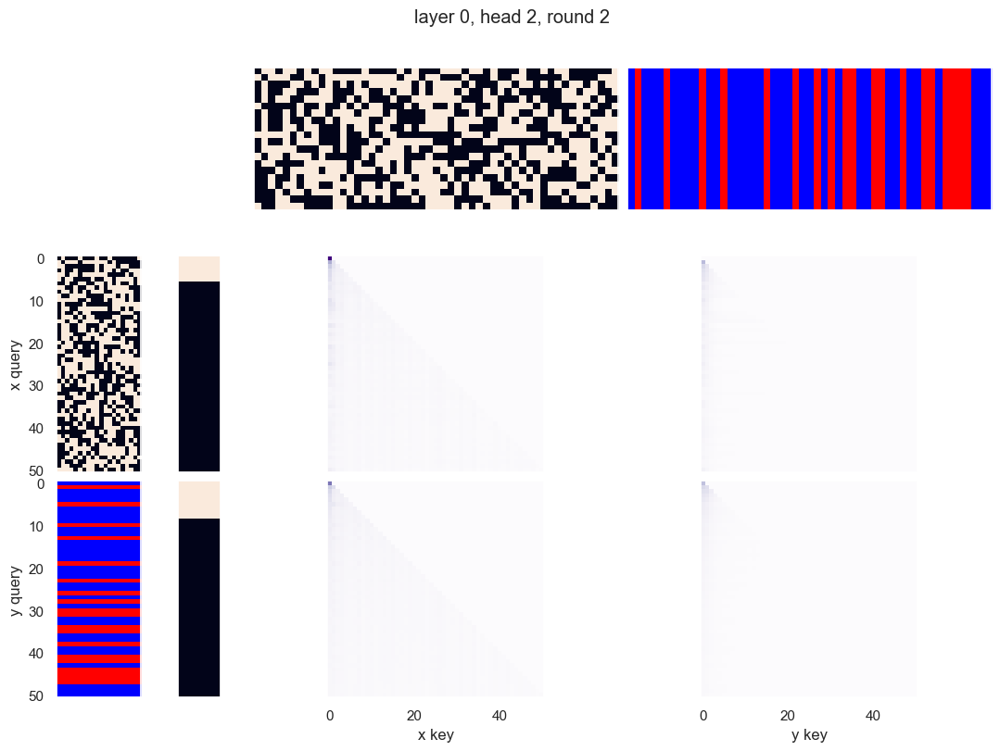

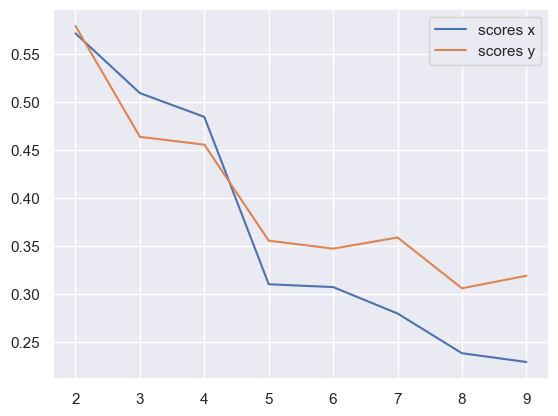

x query cluster:
SVM coefs: [ 0.18641138 -0.51159318  0.70710677  0.37003174  0.38306575  0.40484806
  0.38365101  0.51768069  0.9028004   0.00999742 -0.40022842  0.34730617
  0.18039892 -0.75014853  0.07032413 -0.44771204 -0.19461498 -0.76256025
  0.36405314  0.93666899]
class1: [10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) +10: 0.68; (3) -16: 0.66; (4) -11: 0.63; (5) -12: 0.61; (6) -18: 0.61; (7) +13: 0.61; (8) -3: 0.61; (9) +5: 0.59; (10) +2: 0.59
(1) +2 AND -18: 0.51; (2) -3 AND -16: 0.49; (3) -3 AND -18: 0.49; (4) +13 AND -18: 0.49; (5) -11 AND +17: 0.46; (6) +6 AND +17: 0.46; (7) -7 AND +10: 0.46; (8) +10 AND +17: 0.44; (9) +10 AND +13: 0.44; (10) +5 AND +17: 0.44
(1) -11 OR -16: 0.95; (2) +10 OR +17: 0.95; (3) +10 OR -11: 0.95; (4) -11 OR -18: 0.95; (5) -3 OR -11: 0.93; (6) +17 OR -19: 0.93; (7) +10 OR -12: 0.93; (8) -9 OR +17: 0.93; (9) -16 OR +17: 0.93; (10) -2 OR -18: 0.93
{7.0:

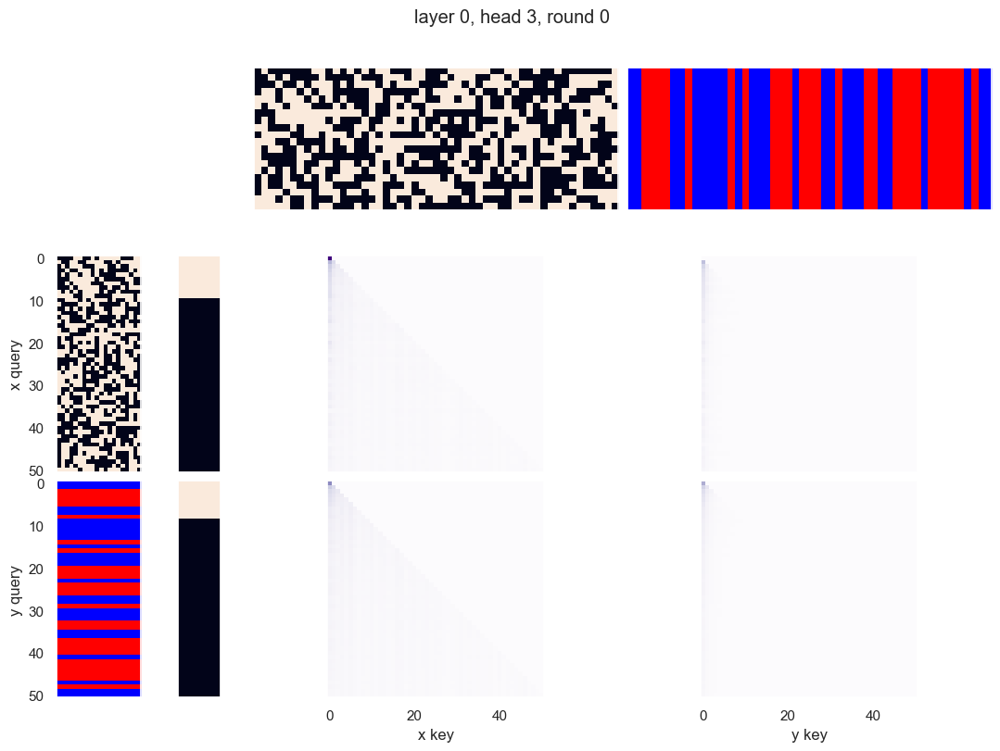

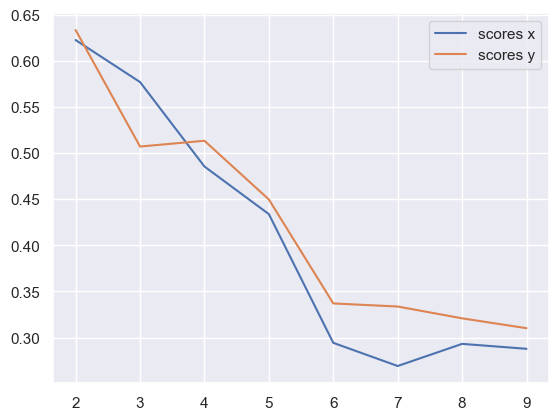

x query cluster:
SVM coefs: [-0.29940477 -0.73129373 -0.12039284  0.12679209 -0.29073119 -0.37083552
 -0.05053567 -0.16283921  0.37565543  0.37722984  0.01285785  0.63138244
 -0.18950786 -0.80244076 -0.32393981  0.08436909 -0.23863427 -0.77213396
  0.34004992  0.96410582]
class1: [ 6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +19: 0.61; (4) -16: 0.61; (5) +13: 0.61; (6) -12: 0.61; (7) +9: 0.59; (8) +11: 0.57; (9) -15: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.45; (2) +0 AND -12: 0.43; (3) -12 AND +19: 0.43; (4) +9 AND +13: 0.43; (5) -3 AND +19: 0.43; (6) -12 AND -15: 0.43; (7) +5 AND -16: 0.43; (8) +0 AND -16: 0.43; (9) -2 AND -12: 0.41; (10) +11 AND +19: 0.41
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +9 OR -12: 0.91; (6) +14 OR -16: 0.89; (7) +6 OR -16: 0.89; (8) +0 OR +11: 0.89; (9) +5 OR +9: 0.89; (10) +14 OR -15: 0.89
{

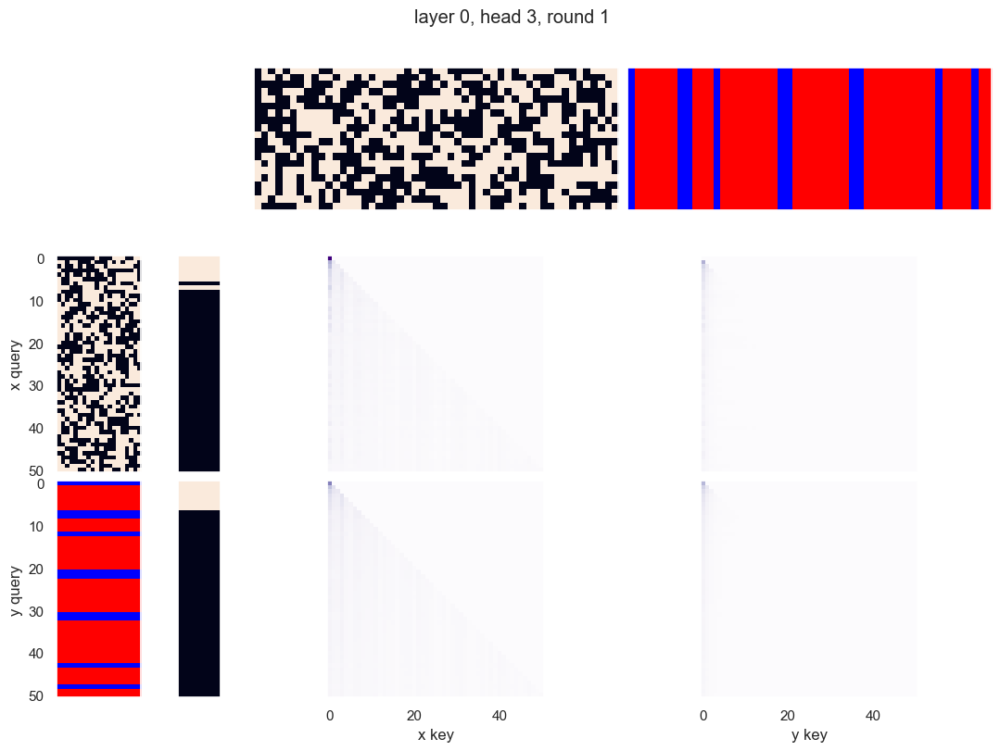

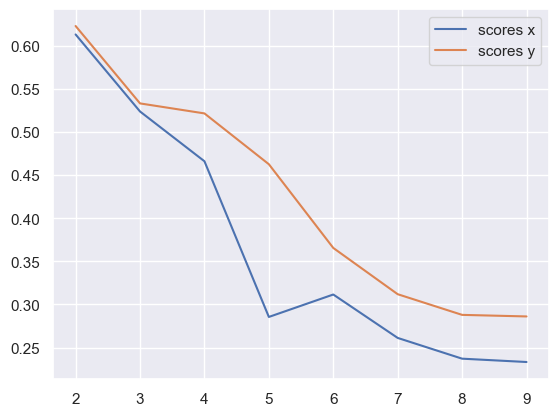

x query cluster:
SVM coefs: [-2.32153785e-01 -4.20207623e-01  7.42616878e-01  4.45009265e-01
  2.98552922e-01  3.58287354e-01  1.10684845e-01  1.84912257e-01
  8.03320591e-01  1.45547905e-01 -4.82856601e-01  6.11616870e-01
  2.99709566e-01 -6.64185854e-01 -3.04108155e-02 -3.09315449e-05
 -1.14822050e-01 -5.54177831e-01  5.13593424e-01  6.00328676e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.65; (3) +17: 0.65; (4) +13: 0.63; (5) +2: 0.63; (6) -0: 0.63; (7) +8: 0.58; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.51; (2) +16 AND +17: 0.49; (3) -9 AND -19: 0.47; (4) +7 AND +16: 0.44; (5) -0 AND +16: 0.44; (6) -9 AND +17: 0.44; (7) -0 AND +17: 0.44; (8) -9 AND +13: 0.44; (9) +8 AND +16: 0.44; (10) -18 AND -19: 0.44
(1) -10 OR -19: 0.93; (2) +14 OR +16: 0.91; (3) -0 OR -10: 0.91; (4) +7 OR -19: 0.91; (5) +15 OR +16: 0.91; (6) +18 OR -19: 0.91; (7) +2 OR

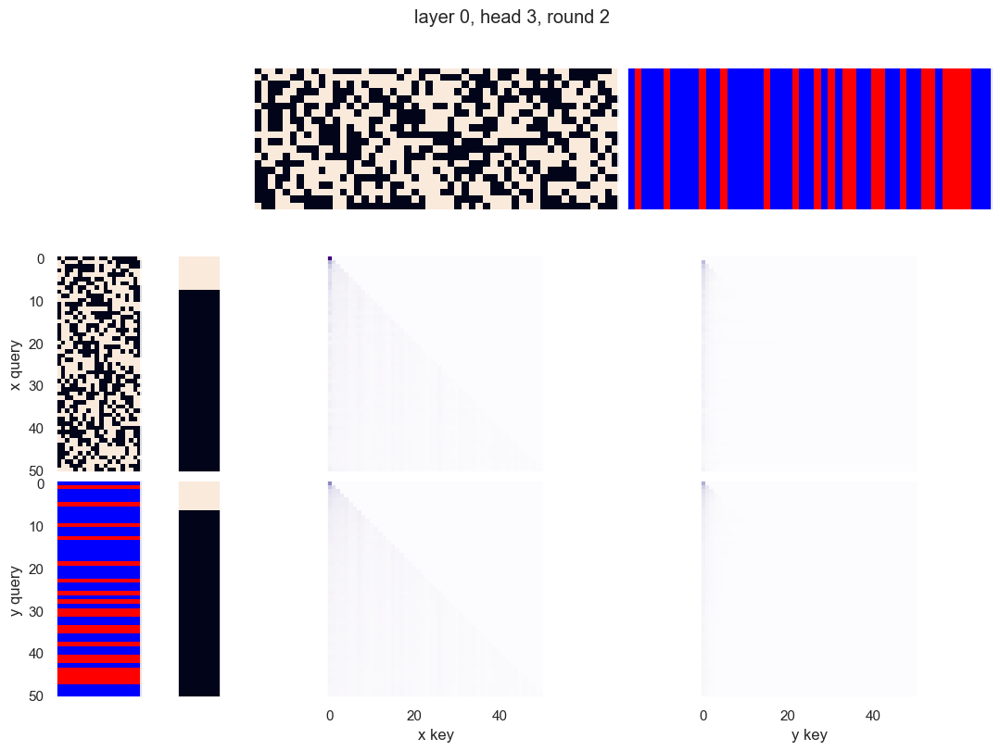

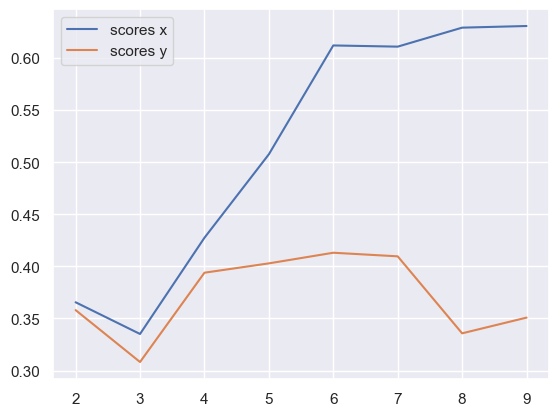

x query cluster:
SVM coefs for class 0: [-0.61106687  0.40816224 -0.16734504  0.23111069 -0.98003925  0.71493936
  0.20860802 -0.28645569 -0.83216817 -0.47312199 -0.27671957  0.2093477
  0.31525983 -0.18207695 -0.42837002 -0.14723616 -0.07248587 -0.11312692
 -0.13345495 -0.07602771]\class elements: [38 40 41 42 44 47 48 49]
(1) +5: 1.00; (2) -0: 0.88; (3) -16: 0.88; (4) -15: 0.88; (5) -8: 0.75; (6) +13: 0.75; (7) -9: 0.75; (8) -14: 0.75; (9) -3: 0.75; (10) -4: 0.62
(1) +5 AND -15: 0.88; (2) +5 AND -16: 0.88; (3) -0 AND +5: 0.88; (4) -14 AND -16: 0.75; (5) -3 AND -15: 0.75; (6) +5 AND -14: 0.75; (7) -0 AND -16: 0.75; (8) +5 AND +13: 0.75; (9) -3 AND -16: 0.75; (10) -0 AND -15: 0.75
(1) -0 OR -1: 1.00; (2) +5 OR -7: 1.00; (3) +5 OR +7: 1.00; (4) +5 OR -8: 1.00; (5) +5 OR +8: 1.00; (6) +5 OR -9: 1.00; (7) +5 OR +9: 1.00; (8) +5 OR -10: 1.00; (9) +5 OR +10: 1.00; (10) +5 OR -11: 1.00
{7.0: 0.0004711337270532478, 11.0: 0.12350004193629917, 8.0: 0.005301036025055161, 13.0: 0.0089328614841318

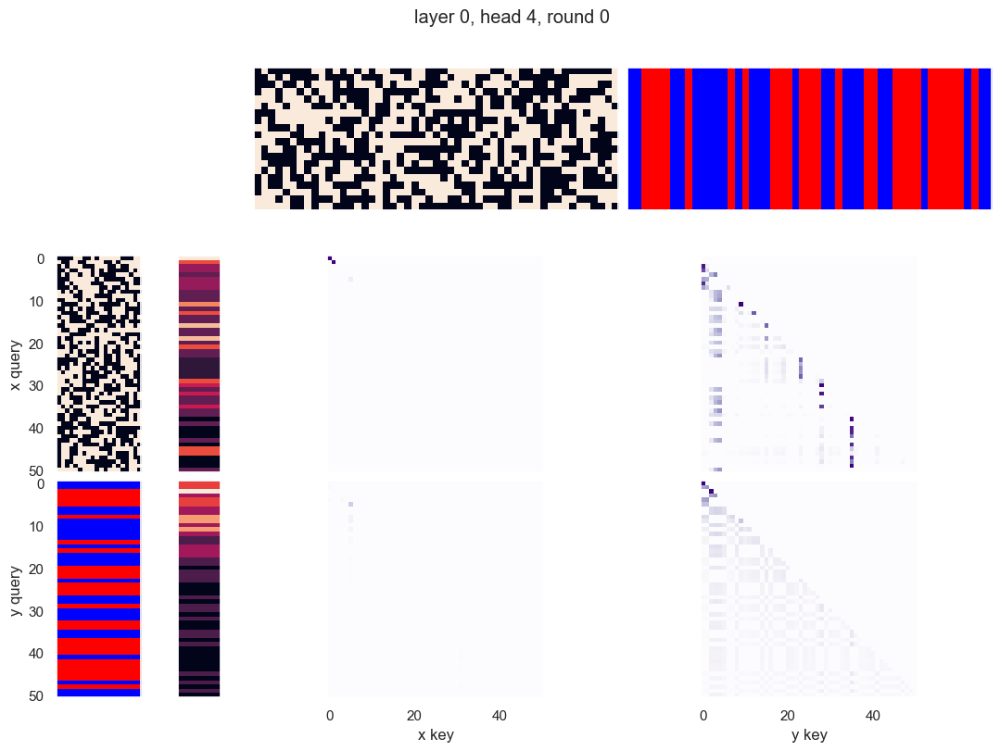

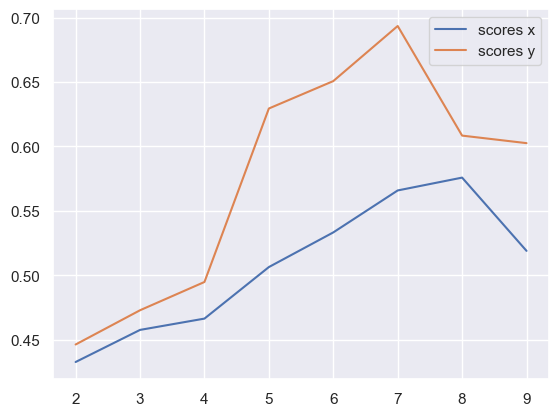

x query cluster:
SVM coefs for class 0: [ 0.04921097 -0.49463716  0.32557765  0.28714429 -0.27677918 -0.36140389
  0.14357372 -0.17249735  0.11543882  0.49492148 -0.11035576  0.24754332
 -0.08446853  0.28741602 -0.03766776 -0.15492958 -0.5708645  -0.52859467
  0.54883379  0.31337846]\class elements: [0 1 3]
(1) -6: 1.00; (2) +18: 1.00; (3) -2: 1.00; (4) -5: 1.00; (5) -7: 1.00; (6) -11: 0.67; (7) -10: 0.67; (8) -19: 0.67; (9) -9: 0.67; (10) +14: 0.67
(1) -6 AND +18: 1.00; (2) -2 AND -7: 1.00; (3) -2 AND +18: 1.00; (4) -7 AND +18: 1.00; (5) -2 AND -5: 1.00; (6) -6 AND -7: 1.00; (7) -5 AND -6: 1.00; (8) -5 AND -7: 1.00; (9) -5 AND +18: 1.00; (10) -2 AND -6: 1.00
(1) +18 OR +19: 1.00; (2) -9 OR -17: 1.00; (3) -4 OR -9: 1.00; (4) +4 OR -8: 1.00; (5) -4 OR +8: 1.00; (6) -9 OR +18: 1.00; (7) +4 OR -7: 1.00; (8) +9 OR +18: 1.00; (9) -4 OR -7: 1.00; (10) +4 OR -6: 1.00
{0.0: 0.3333333258827528}
SVM coefs for class 1: [-0.68142672 -0.26674737 -0.06666024  0.82884795 -0.30132816 -0.70692377
  0.2

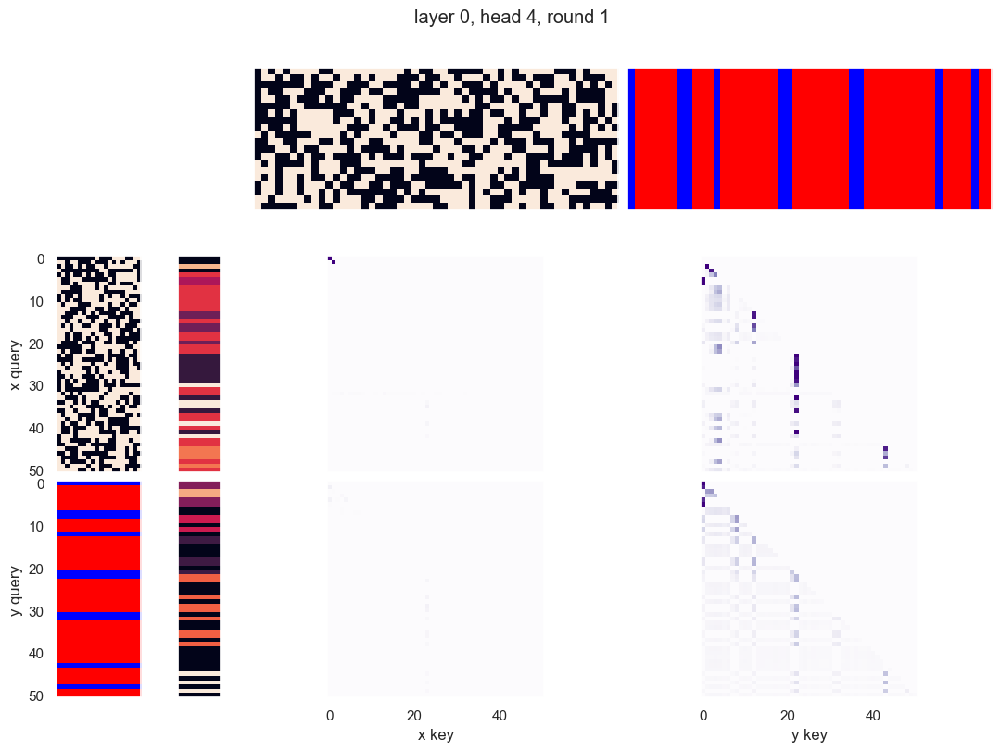

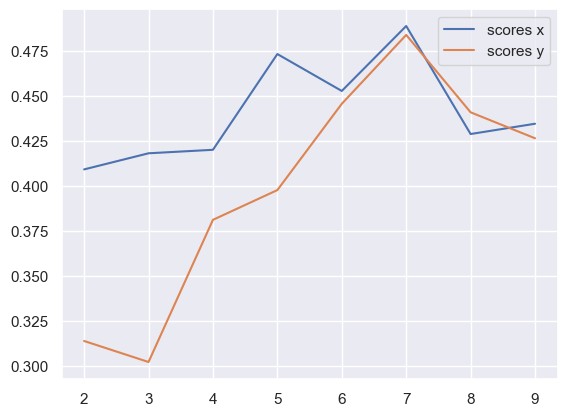

x query cluster:
SVM coefs for class 0: [ 0.08198588 -0.55840743 -0.74361955 -0.50913898 -0.65963636  0.00848349
 -0.20929145  0.36454429  0.95533523 -0.09474513 -0.71681664  1.29269981
 -0.37848262 -0.70004025  0.48744075 -0.5363714   0.01403611  0.31323843
  1.00452722  0.03285027]\class elements: [ 2  3  4  5  7  8 10 11 13 18 19 20 26 32 34 39 42 44 48]
(1) -5: 1.00; (2) +16: 0.74; (3) +17: 0.68; (4) +11: 0.68; (5) -19: 0.63; (6) +15: 0.63; (7) +4: 0.63; (8) +13: 0.58; (9) +1: 0.58; (10) +14: 0.58
(1) -5 AND +16: 0.74; (2) -5 AND +17: 0.68; (3) -5 AND +11: 0.68; (4) -5 AND +15: 0.63; (5) -5 AND -19: 0.63; (6) +4 AND -5: 0.63; (7) -5 AND -10: 0.58; (8) -5 AND +14: 0.58; (9) +1 AND -5: 0.58; (10) -0 AND -5: 0.58
(1) -5 OR -15: 1.00; (2) -5 OR +6: 1.00; (3) -5 OR -16: 1.00; (4) +3 OR -5: 1.00; (5) -5 OR +15: 1.00; (6) -3 OR -5: 1.00; (7) -5 OR +14: 1.00; (8) -5 OR -14: 1.00; (9) -5 OR -7: 1.00; (10) -5 OR +7: 1.00
{0.0: 1.0000000064613606}
SVM coefs for class 1: [-0.31129093  0.054881

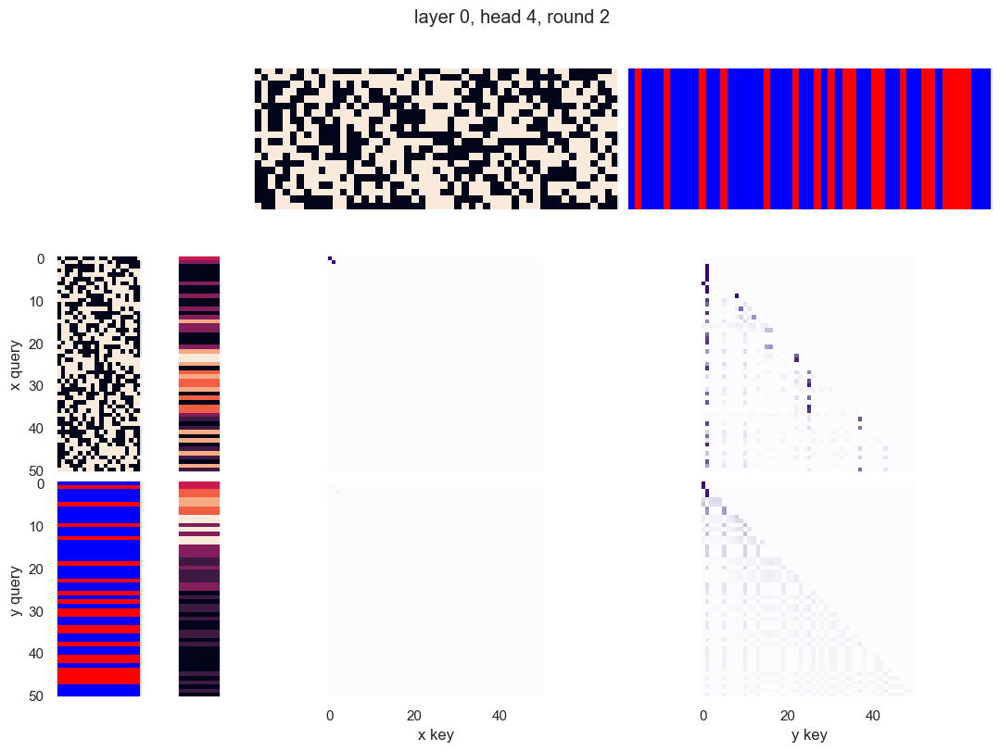

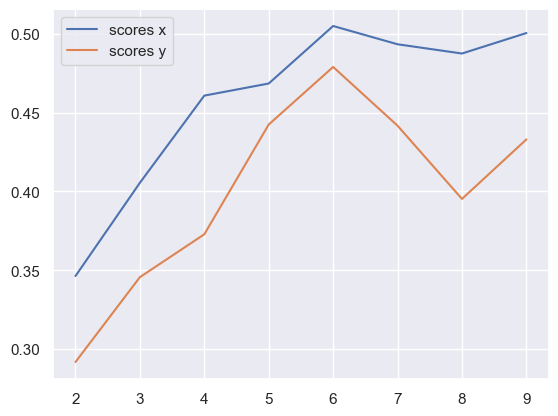

x query cluster:
SVM coefs for class 0: [-0.09618729  0.15967712 -0.79961685  0.05870615 -0.33995625 -0.78755936
 -0.29150245  0.46549349 -0.26742277 -0.36517229 -0.22561533 -0.14919099
  0.11511986  0.10258943 -0.24183907  0.28056325  0.13393733 -0.23924206
  1.56272384  0.09694018]\class elements: [ 4  7 11 17 19 22 23 25 26 31 36 39 43 44 49 50]
(1) +18: 1.00; (2) -11: 0.94; (3) -2: 0.81; (4) +3: 0.75; (5) +17: 0.69; (6) -13: 0.69; (7) +10: 0.62; (8) +15: 0.62; (9) +8: 0.56; (10) +7: 0.56
(1) -11 AND +18: 0.94; (2) -2 AND +18: 0.81; (3) +3 AND -11: 0.75; (4) -2 AND -11: 0.75; (5) +3 AND +18: 0.75; (6) -13 AND +18: 0.69; (7) +17 AND +18: 0.69; (8) -11 AND -13: 0.69; (9) -2 AND +17: 0.62; (10) -11 AND +17: 0.62
(1) +18 OR +19: 1.00; (2) +8 OR +18: 1.00; (3) +1 OR -11: 1.00; (4) -9 OR -11: 1.00; (5) -9 OR -13: 1.00; (6) -9 OR +18: 1.00; (7) +9 OR +18: 1.00; (8) +10 OR -11: 1.00; (9) -10 OR +18: 1.00; (10) +10 OR +18: 1.00
{7.0: 0.0638518709281917, 11.0: 0.003169963794334748, 8.0: 0.305

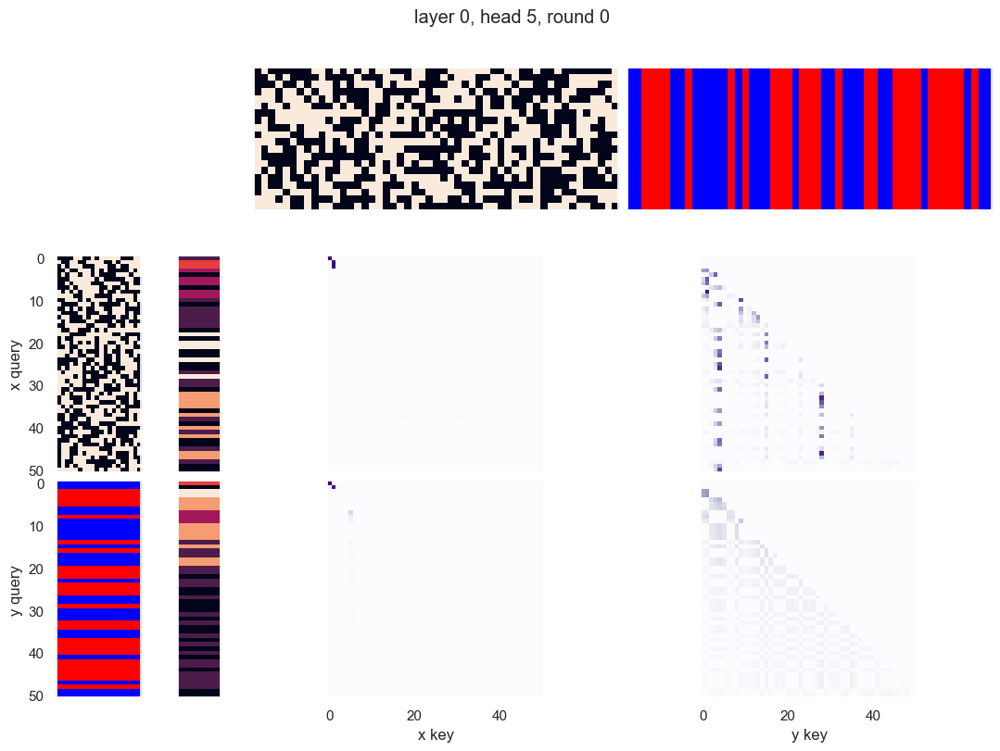

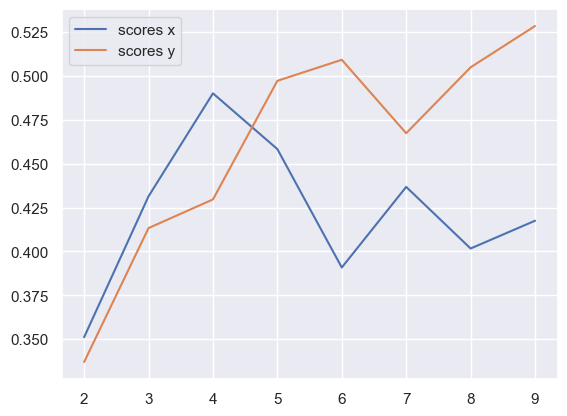

x query cluster:
SVM coefs for class 0: [-0.54895506  0.65069677  0.28875223  0.01310194 -0.1995694  -0.21999795
  0.35823373 -0.41408842 -0.0204097  -0.25072274 -0.02975012 -0.37216956
 -0.27383404  0.1708688  -0.16703871  0.34472057 -0.14385188 -0.56637885
 -0.26834159 -0.73264273]\class elements: [23 24 25 30 33 34 35 40 44 45 47 48 50]
(1) -18: 1.00; (2) +5: 0.69; (3) -10: 0.69; (4) +7: 0.69; (5) -3: 0.69; (6) -16: 0.69; (7) -8: 0.62; (8) +14: 0.62; (9) -6: 0.62; (10) -12: 0.62
(1) -3 AND -18: 0.69; (2) +5 AND -18: 0.69; (3) +7 AND -18: 0.69; (4) -16 AND -18: 0.69; (5) -10 AND -18: 0.69; (6) -12 AND -18: 0.62; (7) -6 AND -18: 0.62; (8) +14 AND -18: 0.62; (9) -3 AND +5: 0.62; (10) -8 AND -18: 0.62
(1) +15 OR -18: 1.00; (2) +5 OR +7: 1.00; (3) +5 OR -6: 1.00; (4) +4 OR -18: 1.00; (5) -9 OR -18: 1.00; (6) -4 OR -18: 1.00; (7) +9 OR -18: 1.00; (8) -13 OR -18: 1.00; (9) -15 OR -18: 1.00; (10) -10 OR -16: 1.00
{0.0: 0.9992218543817003}
SVM coefs for class 1: [-0.10226988 -0.48036102 -0.1

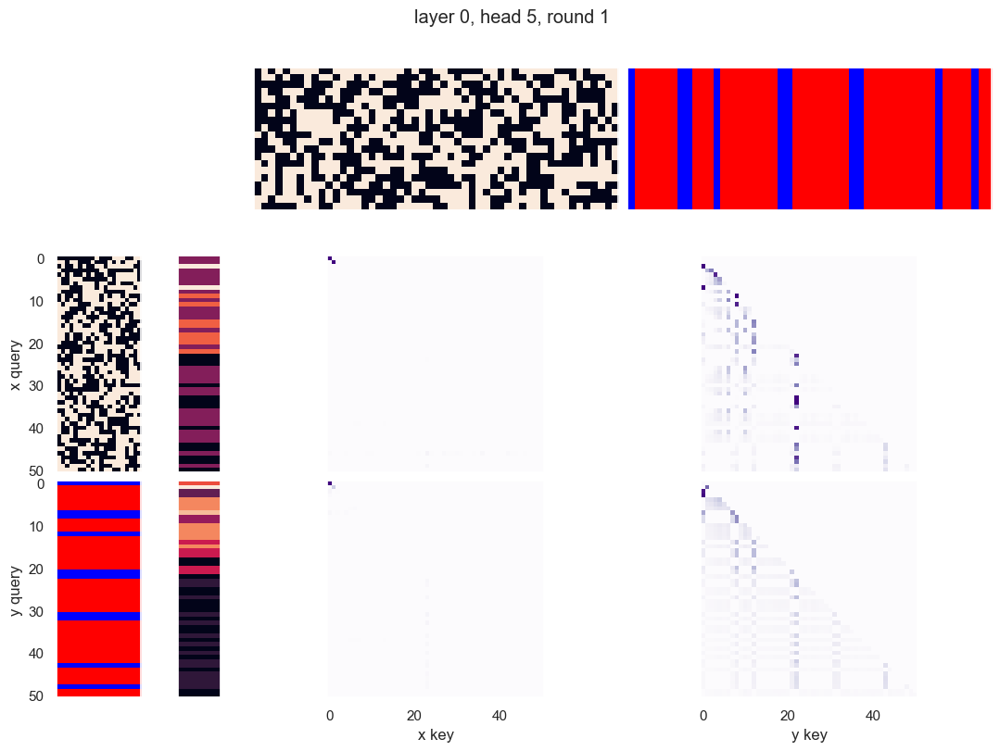

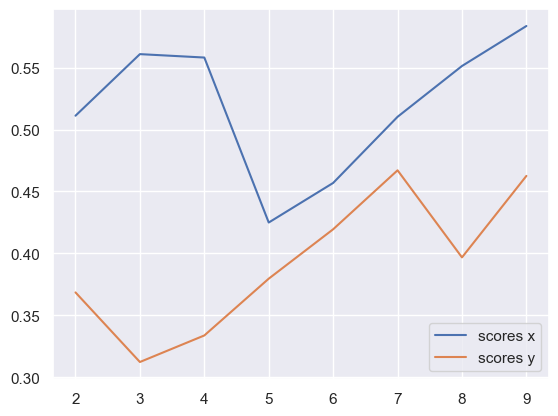

x query cluster:
SVM coefs for class 0: [-0.22027106  0.54100788 -0.18224449  0.2283759  -0.30820236  0.01503259
 -0.00225634  0.25287094 -0.33823961 -0.23196756  0.29439386  0.25695431
 -0.02452194  0.11279014 -0.1498976   0.33313536  0.25243951 -0.10744031
 -0.17364414 -0.02364878]\class elements: [20 21 23 28 29 30 31 36 38 40 41 42 44 47 49 50]
(1) -18: 1.00; (2) -4: 0.81; (3) +17: 0.75; (4) +2: 0.75; (5) +16: 0.75; (6) -19: 0.75; (7) -1: 0.69; (8) +12: 0.62; (9) -9: 0.62; (10) -6: 0.62
(1) -4 AND -18: 0.81; (2) -18 AND -19: 0.75; (3) +17 AND -18: 0.75; (4) +2 AND -18: 0.75; (5) +16 AND -18: 0.75; (6) -1 AND -18: 0.69; (7) +12 AND -18: 0.62; (8) +2 AND +16: 0.62; (9) +8 AND -18: 0.62; (10) -15 AND -18: 0.62
(1) -4 OR -18: 1.00; (2) -16 OR -18: 1.00; (3) +4 OR -18: 1.00; (4) +0 OR -18: 1.00; (5) +9 OR -18: 1.00; (6) -4 OR +17: 1.00; (7) -4 OR +16: 1.00; (8) +9 OR -19: 1.00; (9) -4 OR +13: 1.00; (10) -4 OR -12: 1.00
{0.0: 0.9960928832972713}
SVM coefs for class 1: [ 0.24472047 -0.386

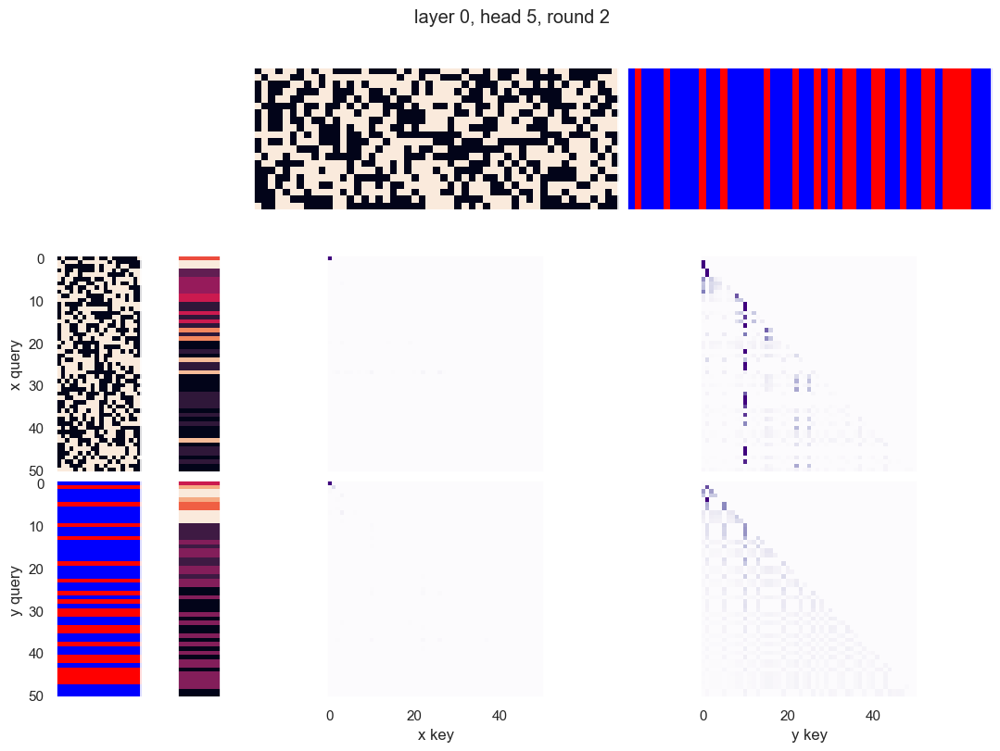

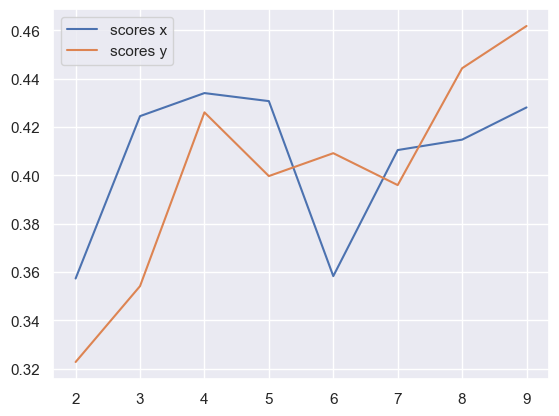

x query cluster:
SVM coefs for class 0: [ 0.25674546  0.52777206 -0.34074558 -0.65774999  0.18084901  0.88494082
 -0.12638361 -0.12359023 -0.77984287  0.05215354  0.49292774 -0.1818489
 -0.18272819 -0.16445333  0.24687469 -0.28572458 -0.09227175 -0.29960252
 -0.07234053 -0.01027104]\class elements: [ 0  2 11 12 13 16 22 24 28 30 31 40 41 42 44 47 48]
(1) -8: 0.88; (2) +5: 0.82; (3) -16: 0.76; (4) -12: 0.71; (5) +10: 0.71; (6) -3: 0.71; (7) -7: 0.71; (8) -19: 0.65; (9) -0: 0.59; (10) -11: 0.59
(1) +5 AND -8: 0.71; (2) -8 AND -16: 0.65; (3) -7 AND +10: 0.65; (4) -3 AND -16: 0.65; (5) +5 AND -16: 0.65; (6) -7 AND -8: 0.65; (7) -8 AND -12: 0.65; (8) -8 AND +10: 0.59; (9) -3 AND -8: 0.59; (10) -8 AND +17: 0.59
(1) +5 OR +15: 1.00; (2) +10 OR -16: 1.00; (3) -8 OR -9: 1.00; (4) -8 OR +10: 1.00; (5) -6 OR -8: 1.00; (6) -12 OR -16: 1.00; (7) -8 OR +13: 1.00; (8) -8 OR -16: 1.00; (9) +5 OR -11: 1.00; (10) -7 OR -16: 1.00
{7.0: 0.11106840630014092, 11.0: 0.013309572516773132, 8.0: 0.2393225661100

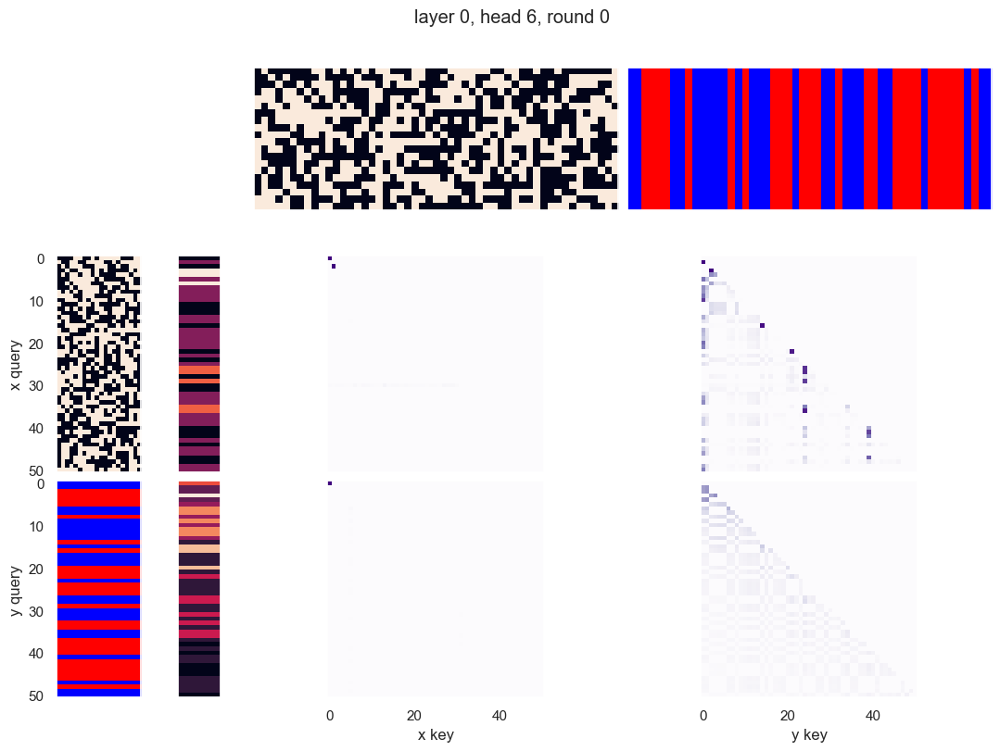

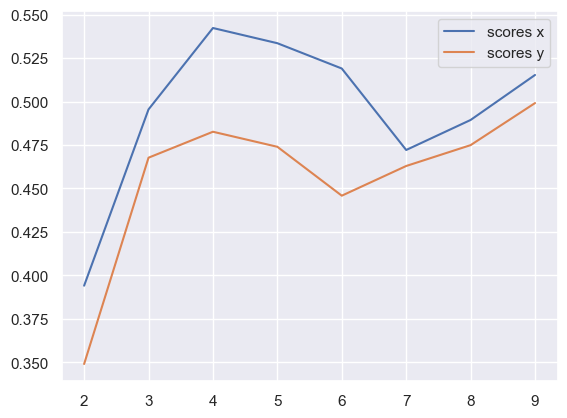

x query cluster:
SVM coefs for class 0: [ 0.51653368  0.50011231 -0.08467619 -0.75704301 -1.11217098  0.1012891
  0.04221694 -0.36626476  0.9129919   0.00325674  0.62607272 -0.44892456
  0.66819557 -0.33018311  0.65215467  0.14194613  0.01992859 -0.64792832
 -0.26429162 -0.2534316 ]\class elements: [ 0 13 14 15 18 20 21 22 24 25 28 29 30 31 33 34 35 36 37 38 44 45 46 48
 50]
(1) -8: 0.92; (2) +13: 0.68; (3) +19: 0.64; (4) +14: 0.64; (5) -3: 0.64; (6) -18: 0.60; (7) +17: 0.60; (8) -16: 0.60; (9) +9: 0.60; (10) +0: 0.56
(1) -8 AND +13: 0.64; (2) -8 AND +19: 0.60; (3) -3 AND -8: 0.56; (4) -8 AND +9: 0.56; (5) -1 AND -8: 0.56; (6) -8 AND +14: 0.56; (7) -8 AND -16: 0.52; (8) -8 AND +17: 0.52; (9) -8 AND -18: 0.52; (10) -6 AND -8: 0.52
(1) -8 OR -18: 1.00; (2) +7 OR -8: 1.00; (3) +1 OR -8: 1.00; (4) +0 OR -8: 1.00; (5) -2 OR -8: 1.00; (6) -8 OR -16: 1.00; (7) -3 OR -8: 1.00; (8) -8 OR +14: 1.00; (9) +5 OR -8: 1.00; (10) -8 OR +17: 1.00
{0.0: 0.9356401679160979}
SVM coefs for class 1: [-0.301

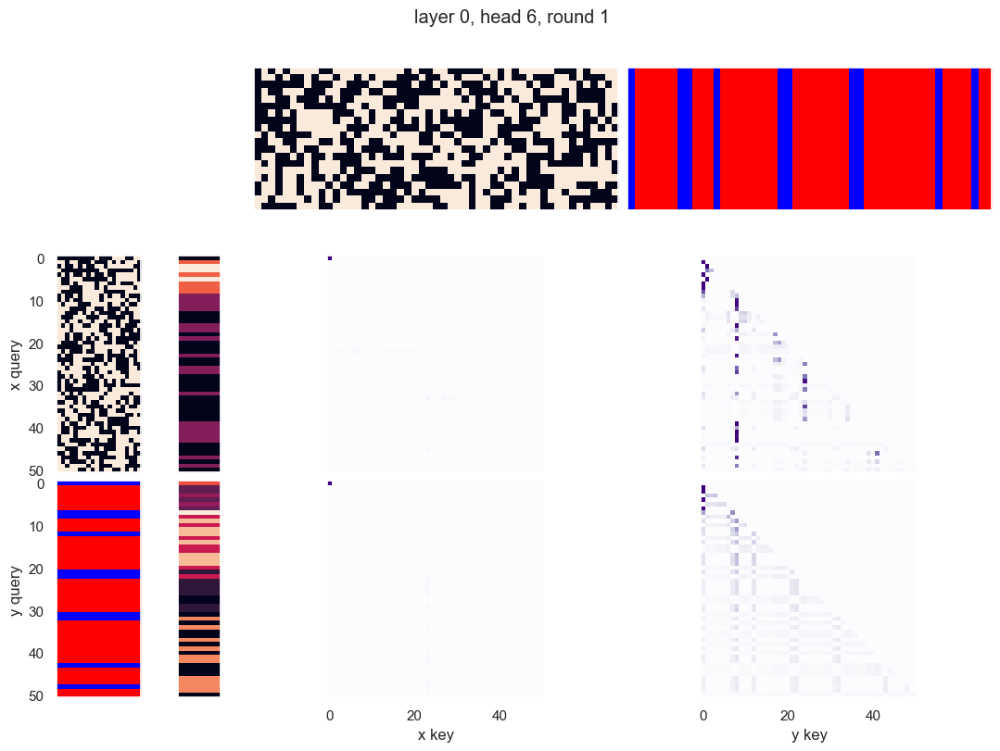

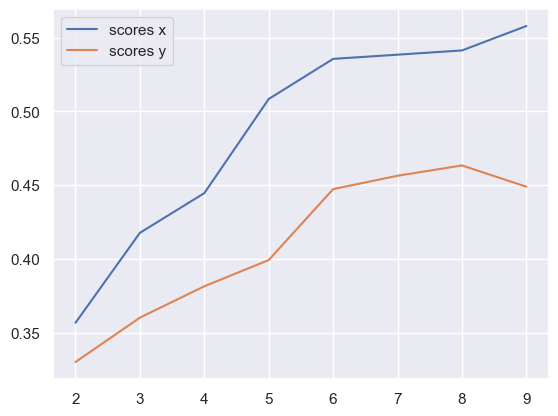

x query cluster:
SVM coefs for class 0: [-0.12535715  0.03709816 -0.11600569 -0.0594279  -0.2204291  -0.45080784
 -0.07108762 -0.09749503 -0.13366761 -0.13811383 -0.00414903 -0.41274212
 -0.18261619  0.06437162  0.10429945  0.14479293 -0.21853274 -0.17543017
 -0.10505682 -0.33476688]\class elements: [12 14 15 17 18 21 23 24 25 26 28 29 34 35 36 37 41 43 44 46 48 49 50]
(1) +8: 1.00; (2) -0: 0.74; (3) +16: 0.74; (4) +13: 0.74; (5) +7: 0.70; (6) +2: 0.65; (7) -19: 0.65; (8) +1: 0.65; (9) +17: 0.61; (10) +3: 0.61
(1) +8 AND +16: 0.74; (2) +8 AND +13: 0.74; (3) -0 AND +8: 0.74; (4) +7 AND +8: 0.70; (5) +2 AND +8: 0.65; (6) +8 AND -19: 0.65; (7) +1 AND +8: 0.65; (8) +8 AND +17: 0.61; (9) +3 AND +8: 0.61; (10) -0 AND +13: 0.61
(1) -0 OR +16: 1.00; (2) -4 OR +8: 1.00; (3) +8 OR -18: 1.00; (4) +8 OR +17: 1.00; (5) +8 OR -17: 1.00; (6) -0 OR +8: 1.00; (7) +8 OR +10: 1.00; (8) +0 OR +8: 1.00; (9) +8 OR -11: 1.00; (10) +3 OR +13: 1.00
{0.0: 1.0000000213520965}
SVM coefs for class 1: [ 0.24758686 

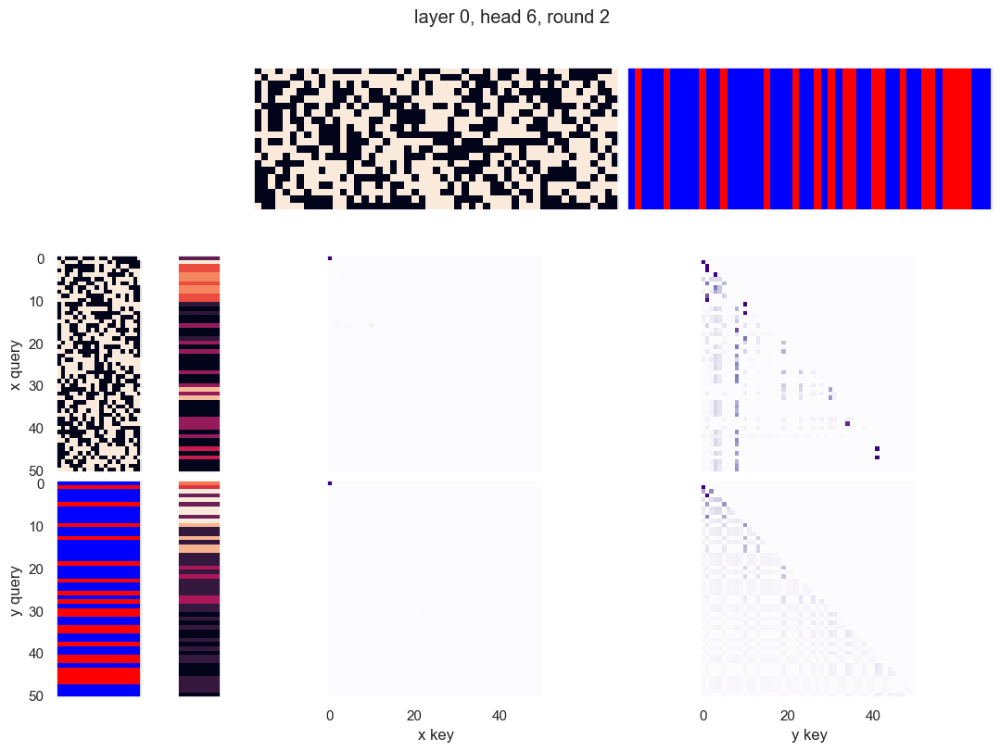

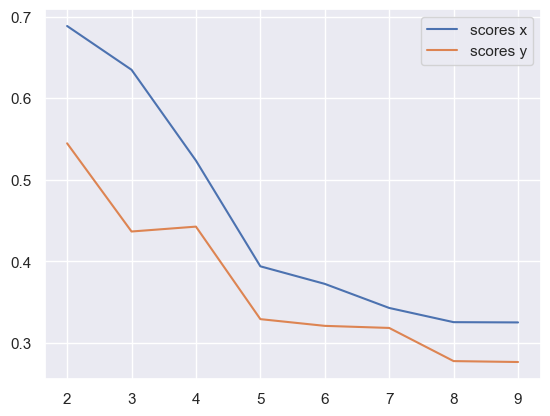

x query cluster:
SVM coefs: [ 0.10544444 -0.37930802  0.16403204  0.1208392  -0.24402935 -0.10237005
  0.08436871 -0.23419013  0.18886839  0.66353276 -0.0410945   0.52820799
 -0.17284257  0.06949174 -0.03458325 -0.08149381 -0.14972003 -0.68103629
  0.62447348  0.7590444 ]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17

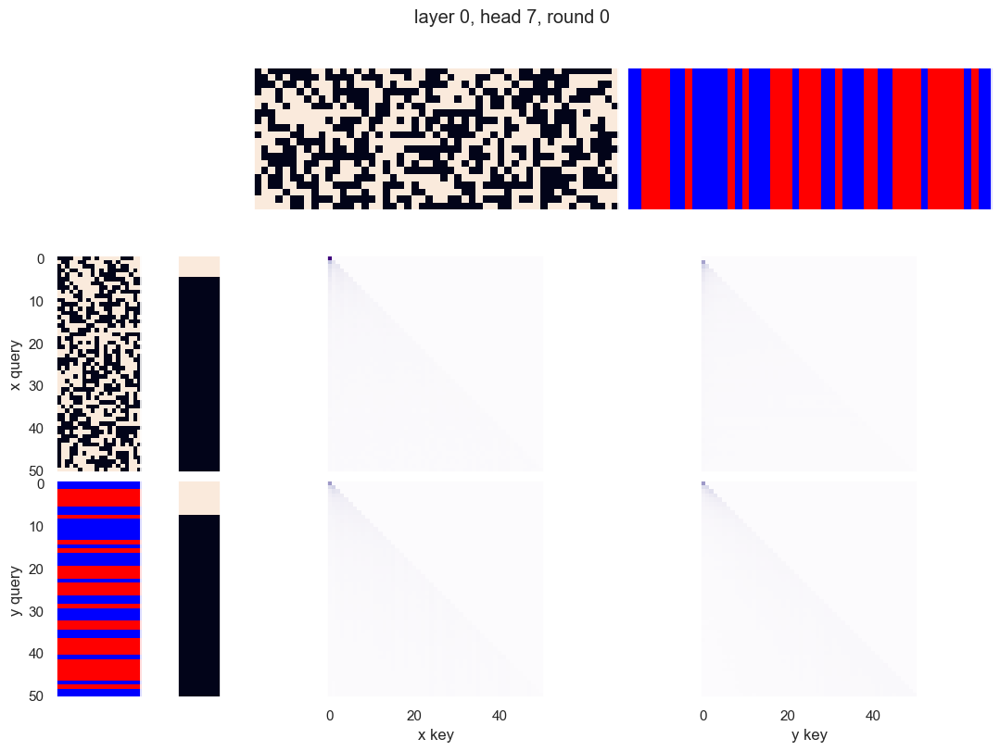

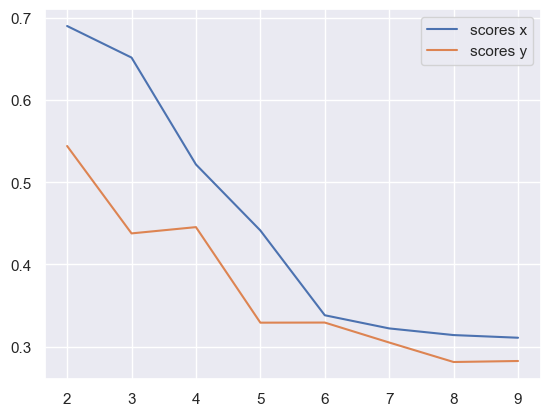

x query cluster:
SVM coefs: [ 0.10544108 -0.37931122  0.16403168  0.12083577 -0.24402725 -0.10237206
  0.08436731 -0.23419318  0.18886855  0.66353763 -0.04109199  0.52820819
 -0.17284898  0.06949318 -0.03458277 -0.08149457 -0.14972059 -0.68103557
  0.62447359  0.75904692]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) +19: 0.61; (4) +13: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +6: 0.57; (8) +5: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) +9 AND +13: 0.41; (4) +0 AND -12: 0.41; (5) +0 AND -16: 0.41; (6) +13 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +5 AND -16: 0.41; (9) -12 AND +19: 0.41; (10) +0 AND +19: 0.39
(1) +13 OR +19: 0.91; (2) -12 OR +13: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR +19: 0.89; (5) +0 OR +17: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -15: 0.89; (8) +0 OR +11: 0.89; (9) +14 OR -16: 0.89; (10) -16 OR +19:

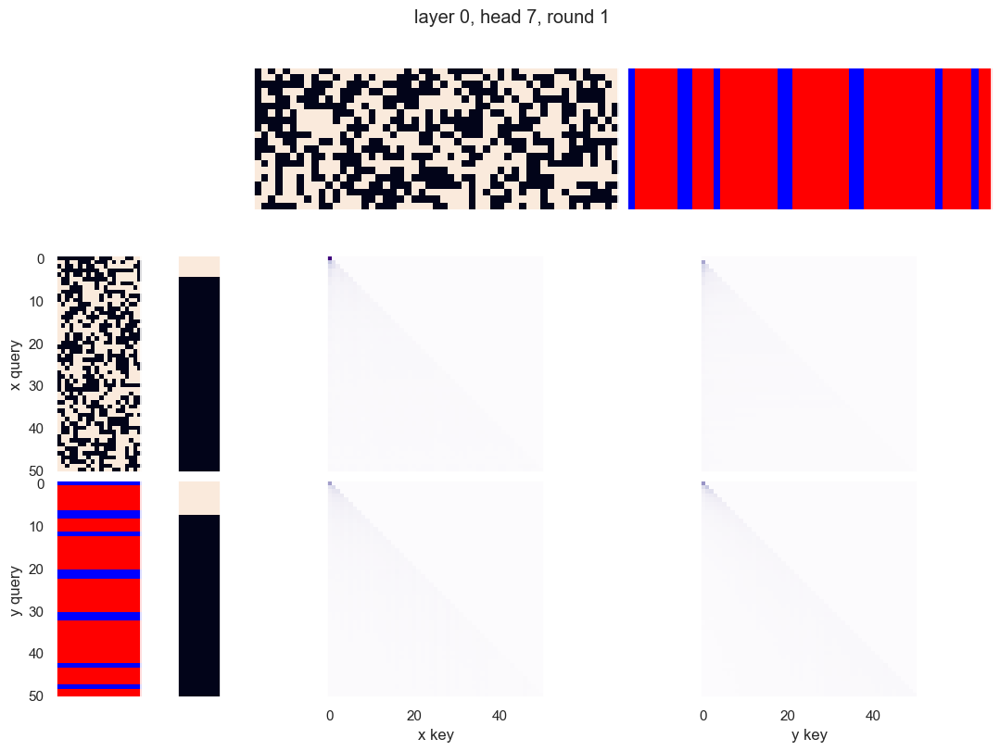

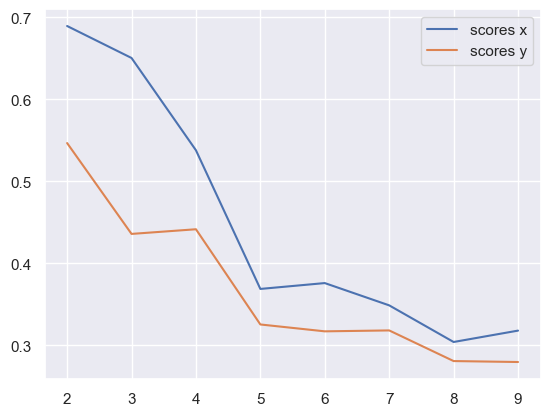

x query cluster:
SVM coefs: [ 0.10543859 -0.37931061  0.16403688  0.12083366 -0.24402284 -0.10237192
  0.08437431 -0.23419016  0.18886475  0.66354199 -0.0410962   0.52820655
 -0.17284851  0.0694935  -0.03457641 -0.0814959  -0.14972613 -0.68103804
  0.62447435  0.75904474]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

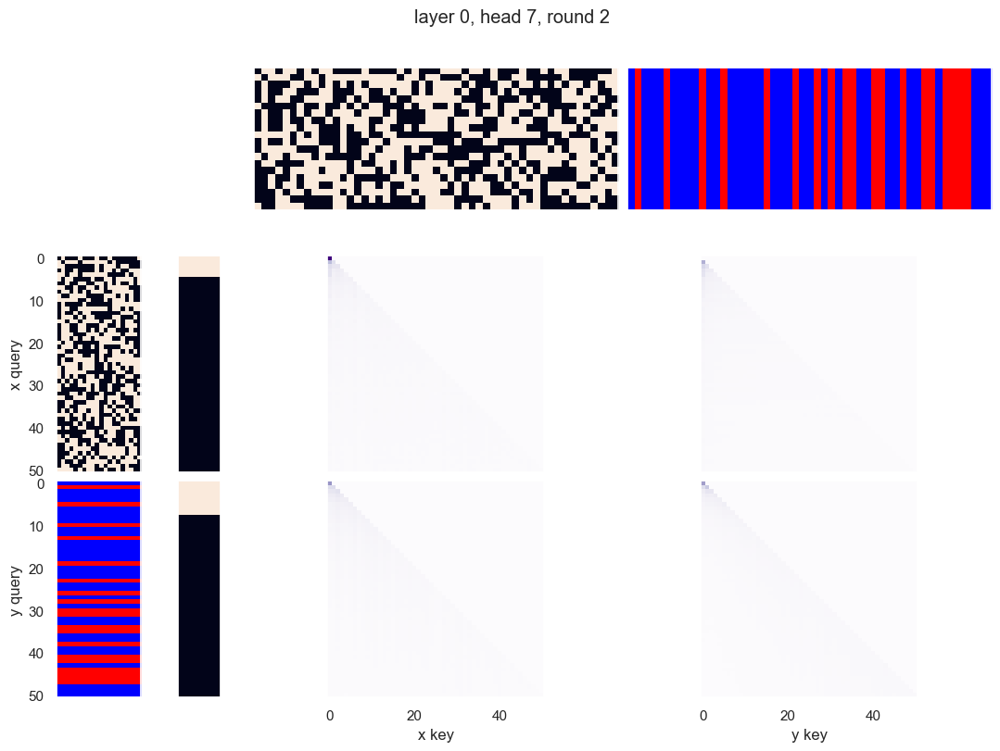

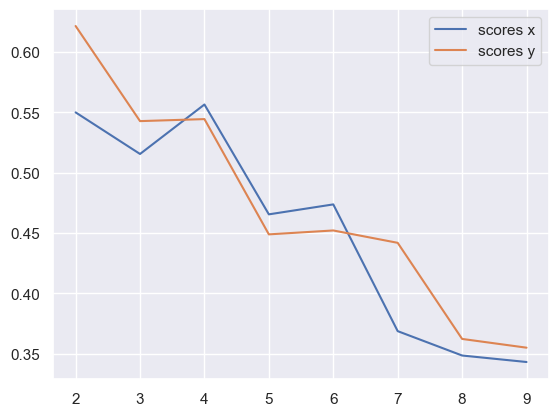

x query cluster:
SVM coefs for class 0: [-0.18640509  0.51159644 -0.70710622 -0.3700354  -0.38306477 -0.40485633
 -0.38364871 -0.51768186 -0.90279501 -0.01000298  0.40022894 -0.34730061
 -0.18039879  0.75015521 -0.0703233   0.4477109   0.19461642  0.76256038
 -0.36405468 -0.93667393]\class elements: [10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) +10: 0.68; (3) -16: 0.66; (4) -11: 0.63; (5) -12: 0.61; (6) -18: 0.61; (7) +13: 0.61; (8) -3: 0.61; (9) +5: 0.59; (10) +2: 0.59
(1) +2 AND -18: 0.51; (2) -3 AND -16: 0.49; (3) -3 AND -18: 0.49; (4) +13 AND -18: 0.49; (5) -11 AND +17: 0.46; (6) +6 AND +17: 0.46; (7) -7 AND +10: 0.46; (8) +10 AND +17: 0.44; (9) +10 AND +13: 0.44; (10) +5 AND +17: 0.44
(1) -11 OR -16: 0.95; (2) +10 OR +17: 0.95; (3) +10 OR -11: 0.95; (4) -11 OR -18: 0.95; (5) -3 OR -11: 0.93; (6) +17 OR -19: 0.93; (7) +10 OR -12: 0.93; (8) -9 OR +17: 0.93; (9) -16 OR +17: 0.93; (10) -

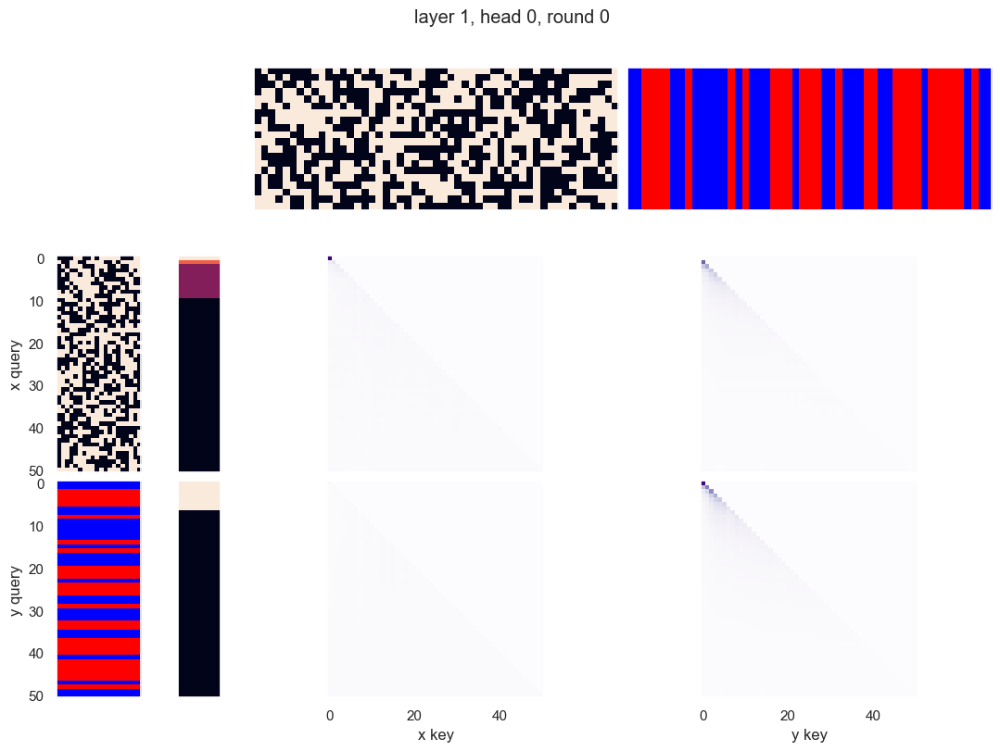

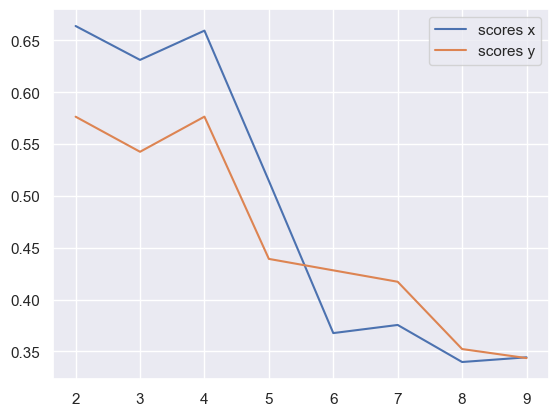

x query cluster:
SVM coefs: [ 0.3461001  -0.23437137  0.30746716  0.34994245  0.01560381  0.09450762
 -0.03540914  0.08967123 -0.12833214  0.52839949  0.10108687 -0.04732573
 -0.04375918  0.12066567 -0.07318741 -0.2589426  -0.17859966 -0.20129681
  0.15544724  0.51262796]
class1: [ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.67; (2) +0: 0.62; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.58; (7) +6: 0.56; (8) -4: 0.56; (9) +9: 0.56; (10) -2: 0.56
(1) -3 AND +19: 0.44; (2) -12 AND +19: 0.42; (3) +13 AND +14: 0.42; (4) -2 AND -12: 0.42; (5) +0 AND +9: 0.42; (6) -4 AND +14: 0.42; (7) +9 AND +13: 0.42; (8) -12 AND +14: 0.40; (9) -12 AND -15: 0.40; (10) +0 AND -16: 0.40
(1) -12 OR +13: 0.92; (2) +0 OR +14: 0.92; (3) +13 OR +19: 0.90; (4) +14 OR +17: 0.90; (5) +14 OR -16: 0.90; (6) +14 OR -15: 0.90; (7) +14 OR +19: 0.90; (8) +0 OR +11: 0.88; (9) +7 OR -12: 0.88; (10) +3 O

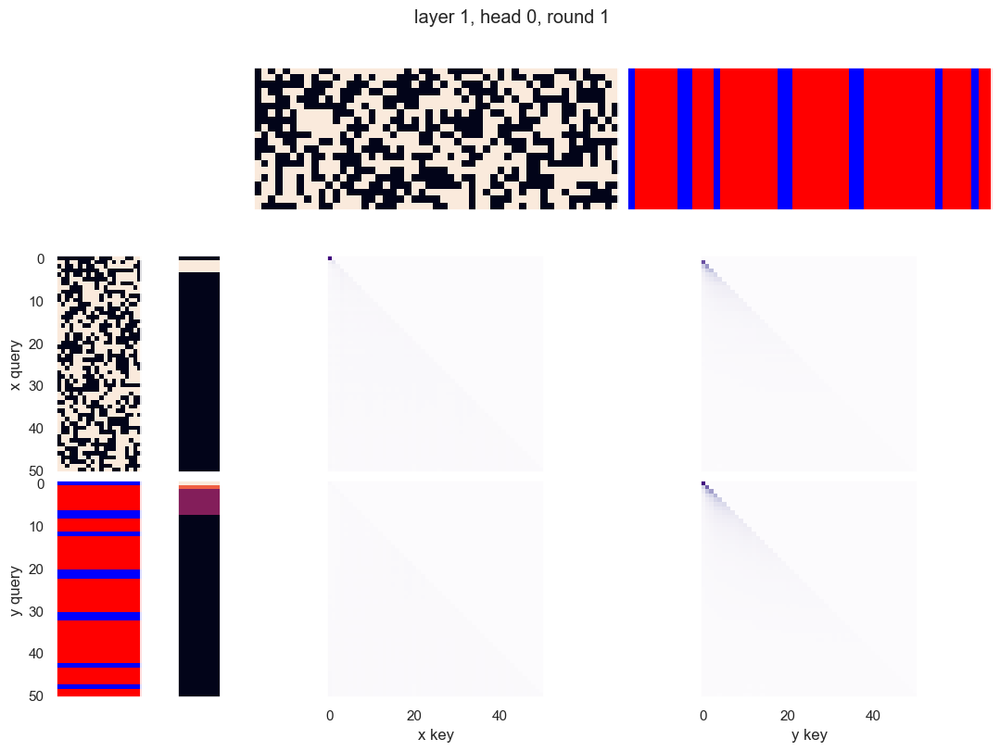

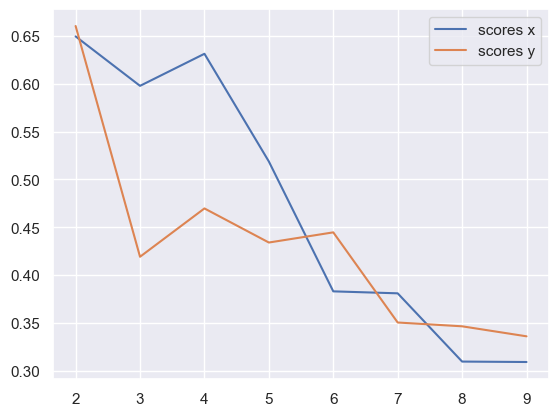

x query cluster:
SVM coefs: [ 0.34609658 -0.23437499  0.30746823  0.34994185  0.01560553  0.09451275
 -0.03540687  0.08967101 -0.12833723  0.52839797  0.10108366 -0.0473293
 -0.04375881  0.12066791 -0.07318827 -0.25894293 -0.17859836 -0.20129585
  0.15544394  0.51262955]
class1: [ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.62; (3) -19: 0.60; (4) +2: 0.60; (5) -0: 0.60; (6) +14: 0.58; (7) +8: 0.58; (8) +13: 0.58; (9) -9: 0.56; (10) -18: 0.56
(1) +17 AND -19: 0.46; (2) +8 AND +16: 0.46; (3) +16 AND +17: 0.46; (4) -9 AND -19: 0.44; (5) -5 AND +16: 0.44; (6) +7 AND +16: 0.44; (7) -9 AND +17: 0.42; (8) -18 AND -19: 0.42; (9) +17 AND -18: 0.42; (10) -0 AND +17: 0.42
(1) +12 OR +16: 0.92; (2) -10 OR -19: 0.90; (3) +14 OR +16: 0.90; (4) +5 OR +16: 0.90; (5) +9 OR -19: 0.88; (6) -10 OR +13: 0.88; (7) +1 OR +2: 0.88; (8) -8 OR +16: 0.88; (9) +16 OR -18: 0.88; (10) +13 O

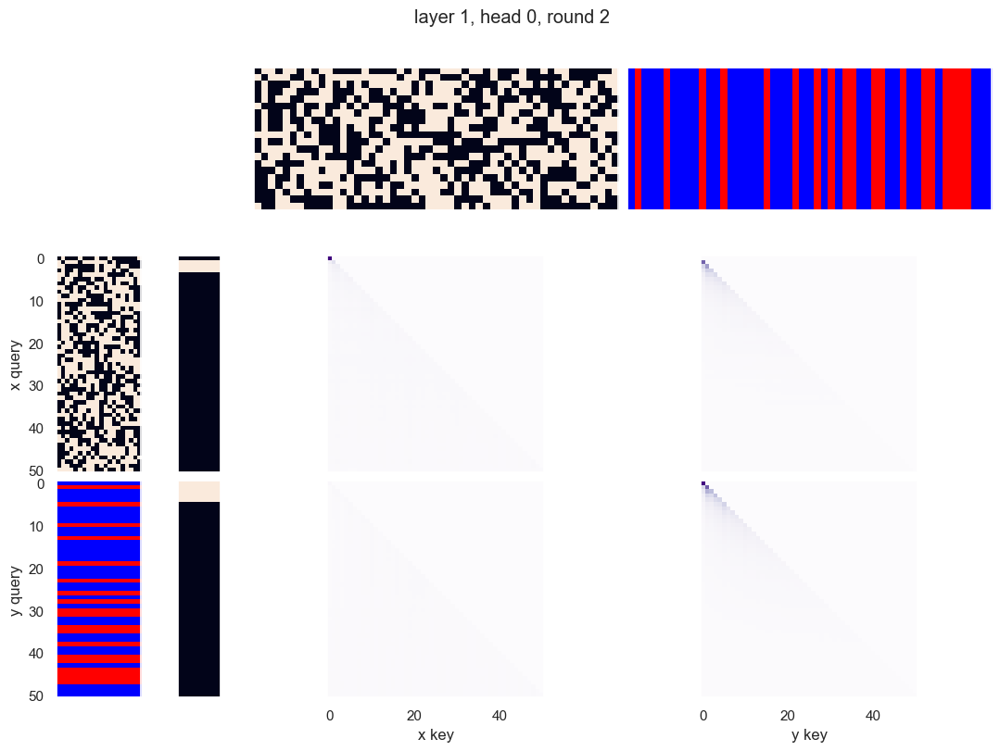

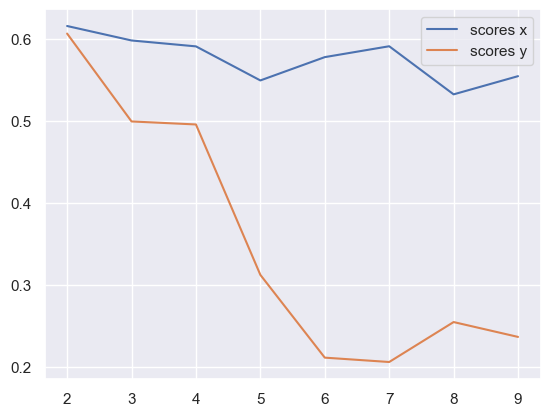

x query cluster:
SVM coefs: [-0.01811305 -0.28403462 -0.36335235  0.11309599  0.07985809 -0.32815315
 -0.1245613  -0.11838078 -0.22614488  0.37896251 -0.06788292  0.10475724
  0.04538064  0.30520413 -0.23077319 -0.11533743 -0.0922824   0.49659171
  0.05523743  1.75747586]
class1: [ 5  6  8 11 12 13 15 18 19 21 23 24 25 26 28 29 30 31 34 35 40 44 47 48
 50]
(1) -19: 1.00; (2) -11: 0.68; (3) +5: 0.68; (4) +10: 0.64; (5) -9: 0.64; (6) -16: 0.64; (7) -12: 0.60; (8) +17: 0.60; (9) -3: 0.60; (10) -18: 0.60
(1) -11 AND -19: 0.68; (2) +5 AND -19: 0.68; (3) -9 AND -19: 0.64; (4) -16 AND -19: 0.64; (5) +10 AND -19: 0.64; (6) -18 AND -19: 0.60; (7) +17 AND -19: 0.60; (8) +7 AND -19: 0.60; (9) -12 AND -19: 0.60; (10) -3 AND -19: 0.60
(1) -4 OR -19: 1.00; (2) +4 OR -19: 1.00; (3) -6 OR -19: 1.00; (4) -11 OR -16: 1.00; (5) +14 OR -19: 1.00; (6) -14 OR -19: 1.00; (7) +7 OR -19: 1.00; (8) -11 OR -19: 1.00; (9) -5 OR -19: 1.00; (10) +5 OR -19: 1.00
{7.0: 0.728942859324161, 11.0: 0.13443804572161755, 8.

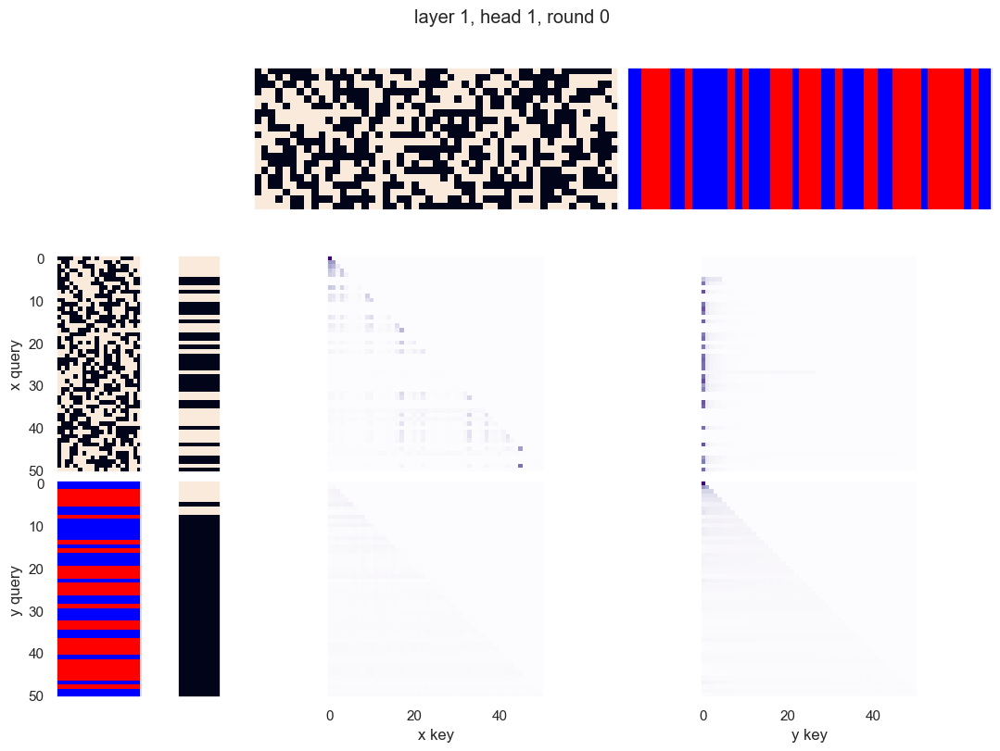

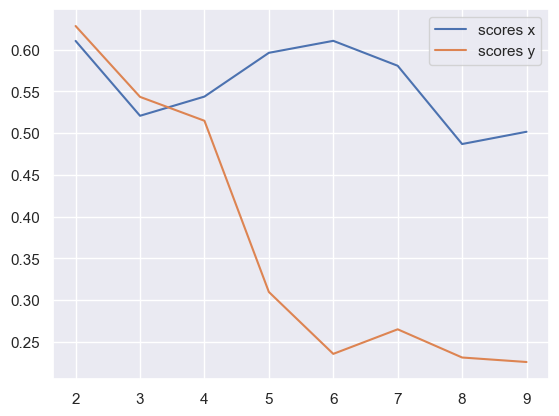

x query cluster:
SVM coefs for class 0: [-0.31083141  0.291411    0.41263432  0.31868499 -0.7662077   0.02390309
 -0.76840105  0.44484396  0.46932433 -0.06262461  0.18235174  0.48666592
 -0.38334938 -0.30477644  0.3484109  -0.73429141  0.5572456  -0.24965663
  0.73875498  0.66945003]\class elements: [ 1  2  3  4  5  9 10 15 18 19 25 26 30 33 34 37 40 41 44 46]
(1) -19: 1.00; (2) -2: 0.75; (3) +14: 0.70; (4) +13: 0.65; (5) +3: 0.65; (6) -16: 0.60; (7) +0: 0.60; (8) -18: 0.60; (9) -5: 0.60; (10) +17: 0.60
(1) -2 AND -19: 0.75; (2) +14 AND -19: 0.70; (3) +3 AND -19: 0.65; (4) +13 AND -19: 0.65; (5) -16 AND -19: 0.60; (6) -5 AND -19: 0.60; (7) -18 AND -19: 0.60; (8) +17 AND -19: 0.60; (9) +0 AND -19: 0.60; (10) +1 AND -2: 0.55
(1) +10 OR -19: 1.00; (2) -6 OR -19: 1.00; (3) -15 OR -19: 1.00; (4) +14 OR -19: 1.00; (5) -0 OR -19: 1.00; (6) -14 OR -19: 1.00; (7) +0 OR -19: 1.00; (8) -1 OR -2: 1.00; (9) -8 OR -19: 1.00; (10) +8 OR -19: 1.00
{0.0: 0.9999979878470183}
SVM coefs for class 1: [-0.1

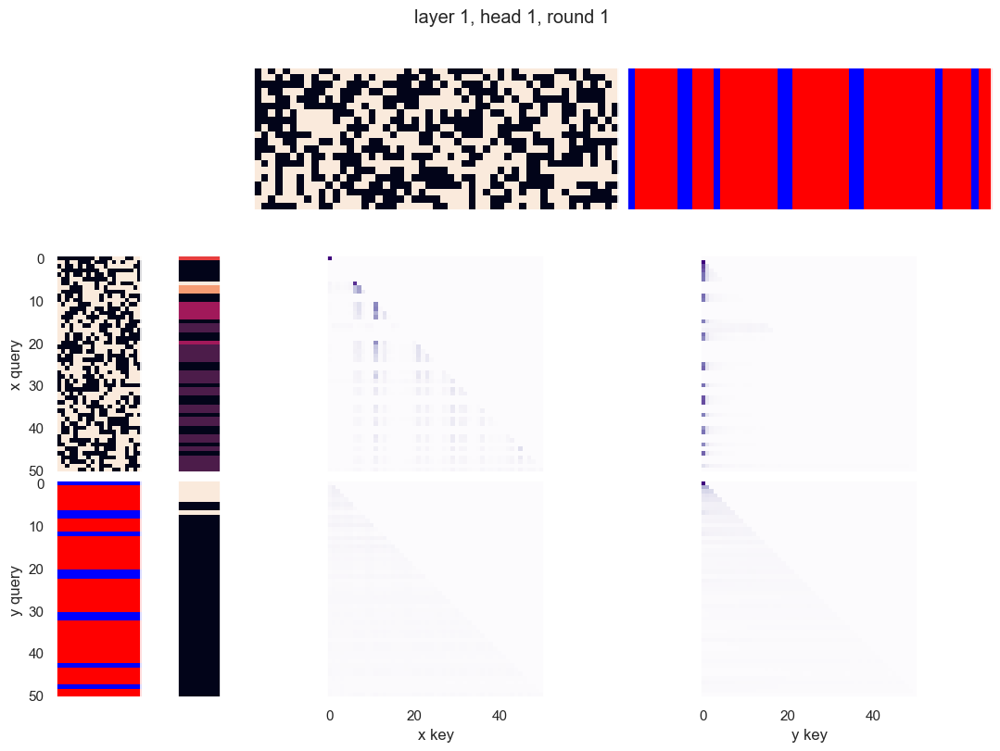

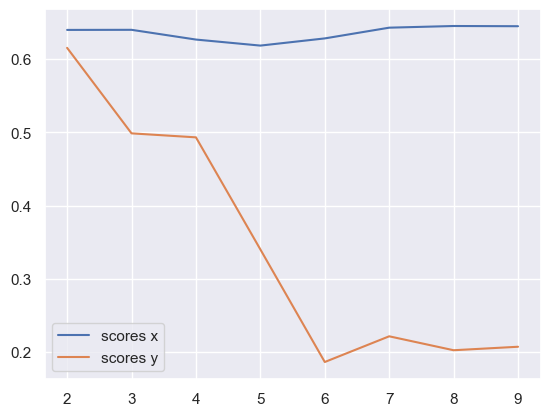

x query cluster:
SVM coefs for class 0: [ 0.40332773  0.36507201 -0.50961409  0.33962798  0.1652278  -0.03708496
  0.01352927  0.71315684  0.00716984 -0.09715716  0.17368838  0.23876081
 -0.08159937  0.06475996  0.22055283 -0.1861044  -0.34442862 -0.06573881
 -0.11856471  0.63005317]\class elements: [ 1  2  7  8  9 10 13 14 15 16 17 18 19 20 22 23 28 30 32 36 41 43 44 45
 46 48 49]
(1) -19: 1.00; (2) +13: 0.70; (3) +17: 0.70; (4) -5: 0.70; (5) -18: 0.67; (6) +16: 0.63; (7) +4: 0.63; (8) +10: 0.63; (9) -9: 0.63; (10) -0: 0.59
(1) +17 AND -19: 0.70; (2) -5 AND -19: 0.70; (3) +13 AND -19: 0.70; (4) -18 AND -19: 0.67; (5) +4 AND -19: 0.63; (6) +10 AND -19: 0.63; (7) +16 AND -19: 0.63; (8) -9 AND -19: 0.63; (9) +1 AND -19: 0.59; (10) +8 AND -19: 0.59
(1) -9 OR -19: 1.00; (2) -0 OR -19: 1.00; (3) +6 OR -19: 1.00; (4) +5 OR -19: 1.00; (5) -6 OR -19: 1.00; (6) +2 OR -19: 1.00; (7) +13 OR -19: 1.00; (8) -2 OR -19: 1.00; (9) -13 OR -19: 1.00; (10) -15 OR -19: 1.00
{0.0: 0.9999983680420508}
SVM c

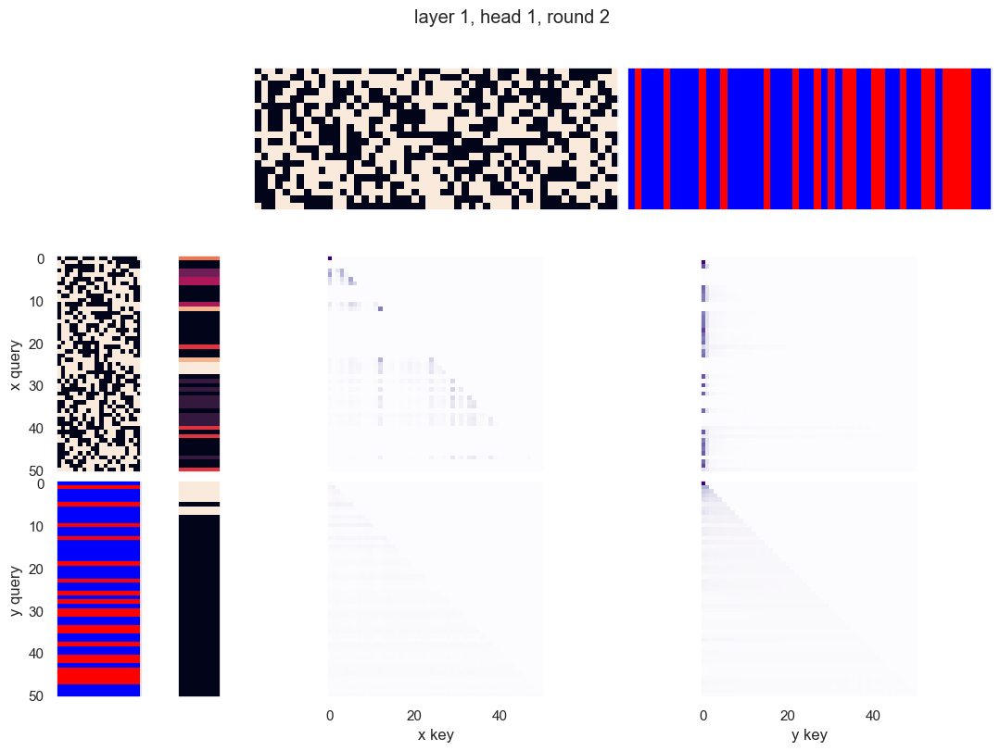

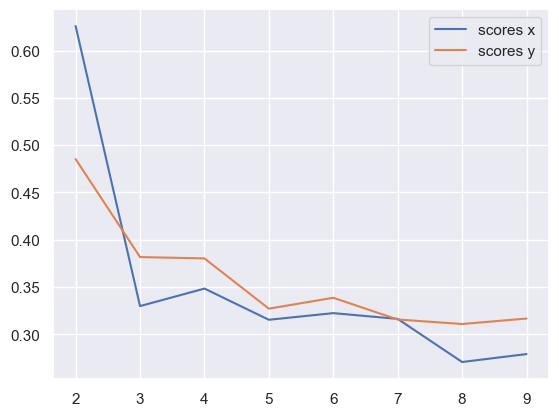

x query cluster:
SVM coefs: [ 0.1054415  -0.3793065   0.16402699  0.12083557 -0.24402768 -0.10237299
  0.08436934 -0.23419265  0.18886562  0.6635353  -0.0410949   0.52821069
 -0.17284354  0.06949054 -0.03457953 -0.08149412 -0.1497214  -0.68103922
  0.62447449  0.75904574]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17

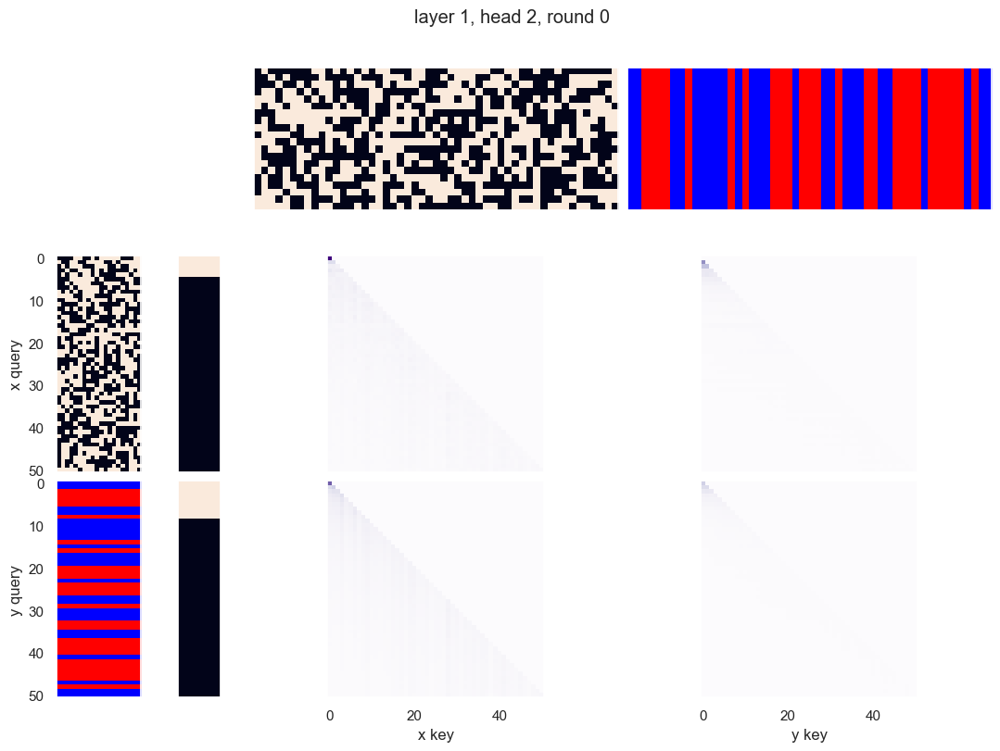

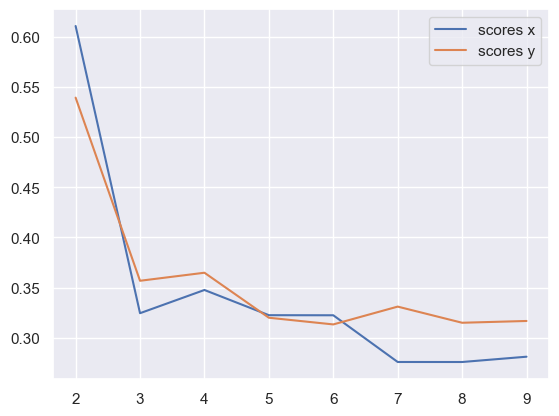

x query cluster:
SVM coefs: [-0.46865559 -0.57678151  0.27721265  0.21226385 -0.11847683 -0.05889432
  0.00723786 -0.45952378  0.42596888  0.43341284 -0.08995893  0.2364688
 -0.24495389 -0.49575186 -0.29612397  0.17306401  0.11536493 -0.67923909
  0.2128395   0.87186777]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +19: 0.62; (4) +13: 0.62; (5) -16: 0.60; (6) -12: 0.60; (7) +6: 0.58; (8) +9: 0.58; (9) -3: 0.58; (10) -4: 0.56
(1) -3 AND +19: 0.44; (2) +0 AND +9: 0.44; (3) +0 AND -12: 0.42; (4) +13 AND +14: 0.42; (5) +5 AND -16: 0.42; (6) +9 AND +13: 0.42; (7) -12 AND +19: 0.42; (8) -12 AND -15: 0.42; (9) +0 AND -16: 0.42; (10) -2 AND -12: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +0 OR +11: 0.89; (6) +0 OR +17: 0.89; (7) +14 OR +17: 0.89; (8) +7 OR -12: 0.89; (9) +14 OR -16: 0.89; (10) +6 OR -16: 0.89


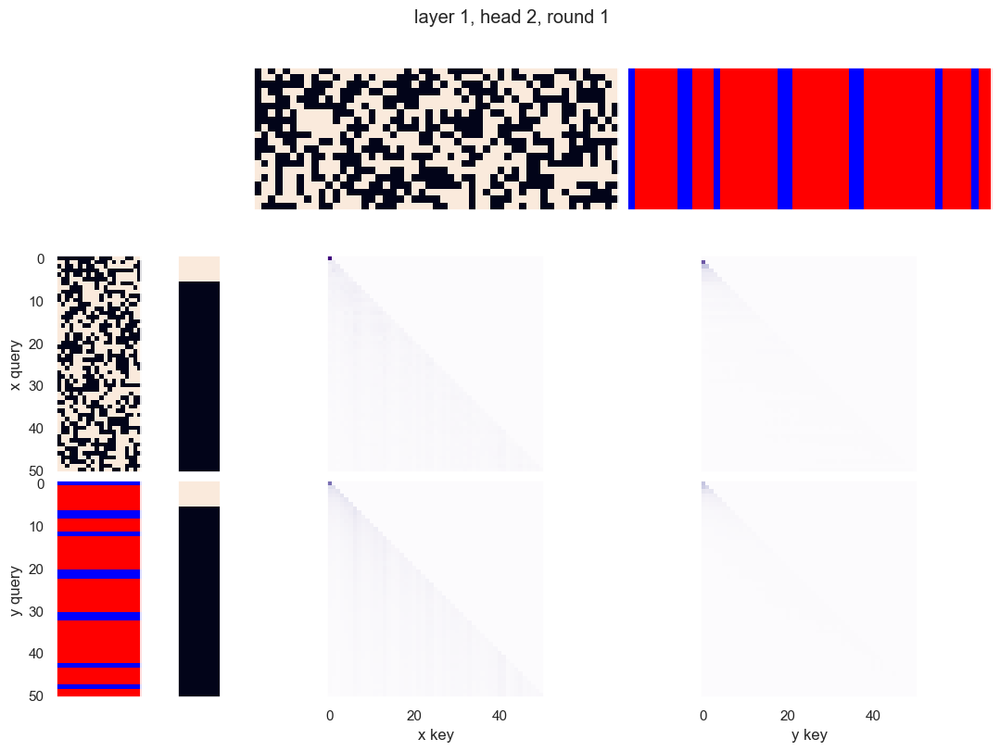

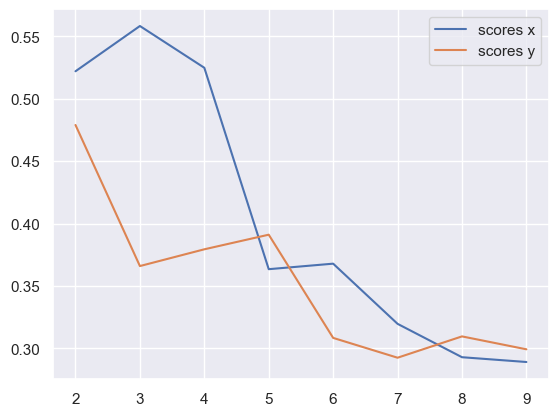

x query cluster:
SVM coefs for class 0: [ 0.28794518  0.47314521 -1.02873838 -0.3831101  -0.32285632 -0.25921239
 -0.01952575 -0.00168659 -0.67964204 -0.27149382  0.3258408  -0.59225049
 -0.27770118  0.56683314 -0.12307695  0.05074469 -0.26542396  0.64575169
 -0.50792329 -0.61017918]\class elements: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) -19: 0.66; (3) +17: 0.64; (4) +13: 0.64; (5) +2: 0.61; (6) -0: 0.61; (7) +8: 0.59; (8) -9: 0.59; (9) +7: 0.59; (10) +14: 0.59
(1) +17 AND -19: 0.50; (2) -9 AND -19: 0.48; (3) +16 AND +17: 0.48; (4) -9 AND +13: 0.45; (5) -18 AND -19: 0.45; (6) +7 AND +16: 0.45; (7) +8 AND +13: 0.45; (8) +8 AND +16: 0.45; (9) -0 AND +16: 0.43; (10) +13 AND -19: 0.43
(1) -10 OR -19: 0.93; (2) -10 OR +13: 0.91; (3) +13 OR +16: 0.91; (4) +15 OR +16: 0.91; (5) +16 OR -19: 0.91; (6) +14 OR +16: 0.91; (7) +12 OR +16: 0.91; (8) +18 OR -19: 0.91; (9) +7 OR -19: 0.91

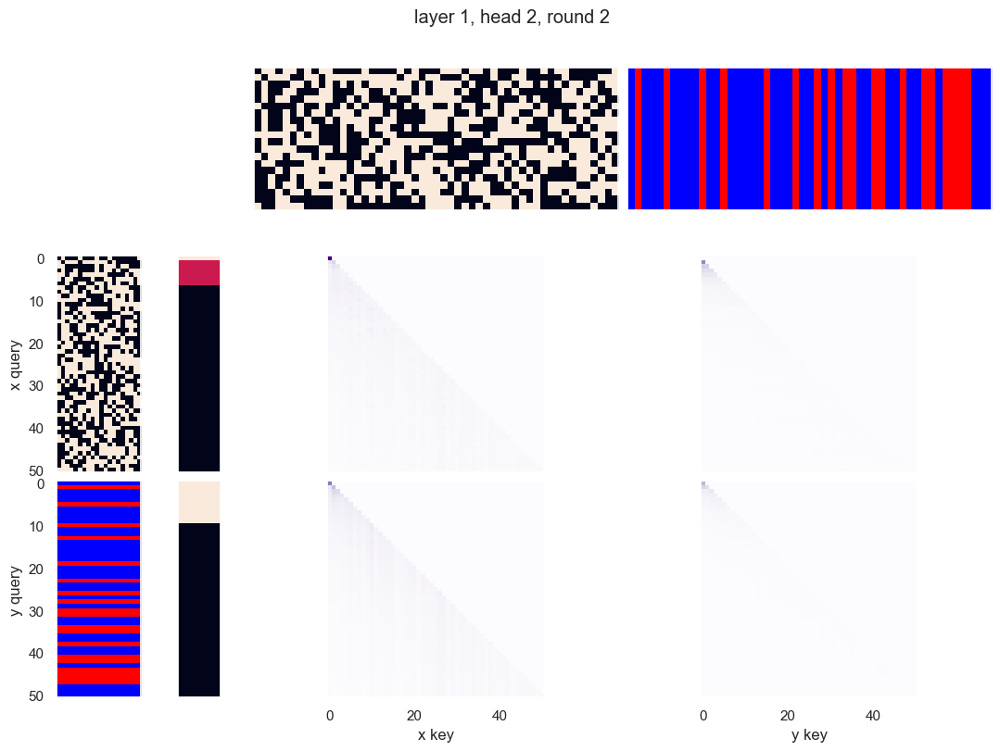

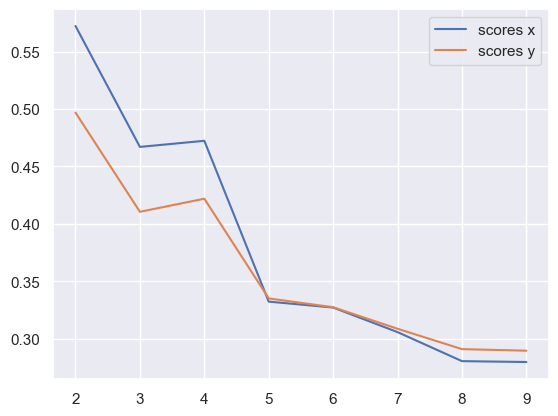

x query cluster:
SVM coefs: [-0.46864911 -0.57677485  0.27721019  0.21226755 -0.11847602 -0.0588977
  0.00723473 -0.45952478  0.425971    0.43340867 -0.08995756  0.23646763
 -0.24495063 -0.49575386 -0.29612474  0.17306156  0.11537035 -0.67924067
  0.21284489  0.87186664]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10: 

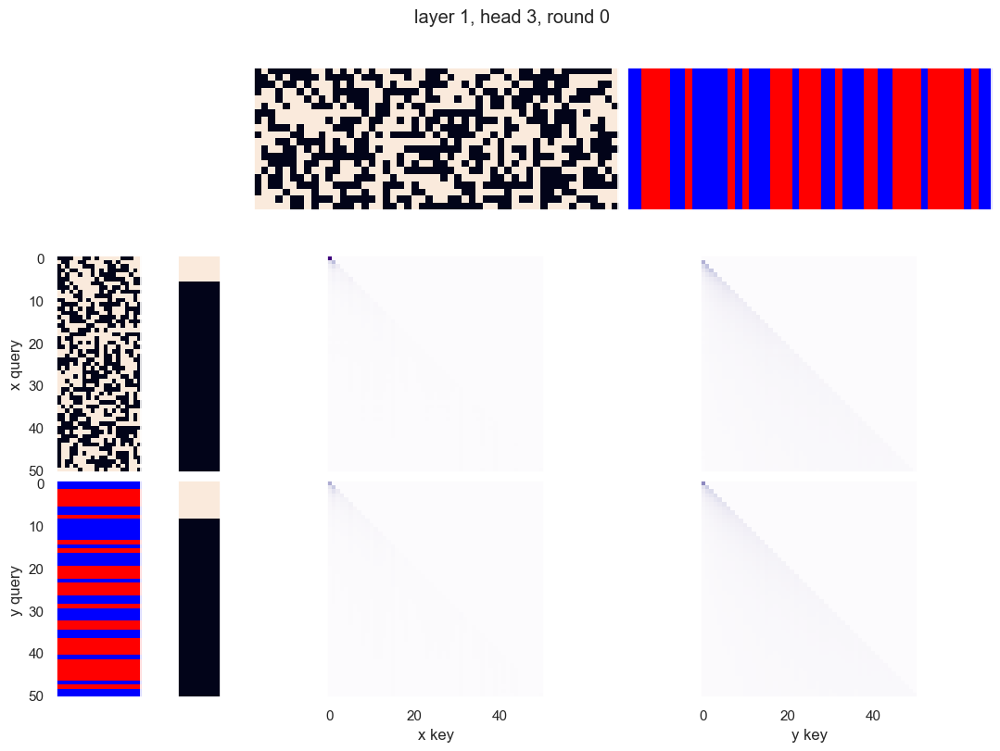

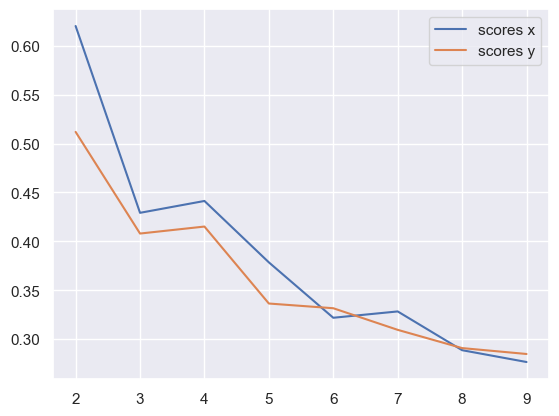

x query cluster:
SVM coefs: [ 0.2551049  -0.45921561  0.27299314  0.17551496 -0.2155185  -0.11985331
  0.07025511 -0.09279551  0.10831882  0.49035844 -0.00371235  0.20237769
 -0.11104509  0.23138537  0.04469579 -0.2945793  -0.46677534 -0.52135419
  0.57332476  0.6285885 ]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +0: 0.64; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.57; (7) +6: 0.57; (8) +17: 0.55; (9) +11: 0.55; (10) +5: 0.55
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) -12 AND -15: 0.40; (4) +5 AND -16: 0.40; (5) -12 AND +19: 0.40; (6) +9 AND +13: 0.40; (7) -4 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) -2 AND -12: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +0 OR +11: 0.89; (4) +14 OR +19: 0.89; (5) +14 OR +17: 0.89; (6) +0 OR +17: 0.89; (7) +13 OR +19: 0.89; (8) +14 OR -15: 0.89; (9) +14 OR -16: 0.89; (10) -12 OR

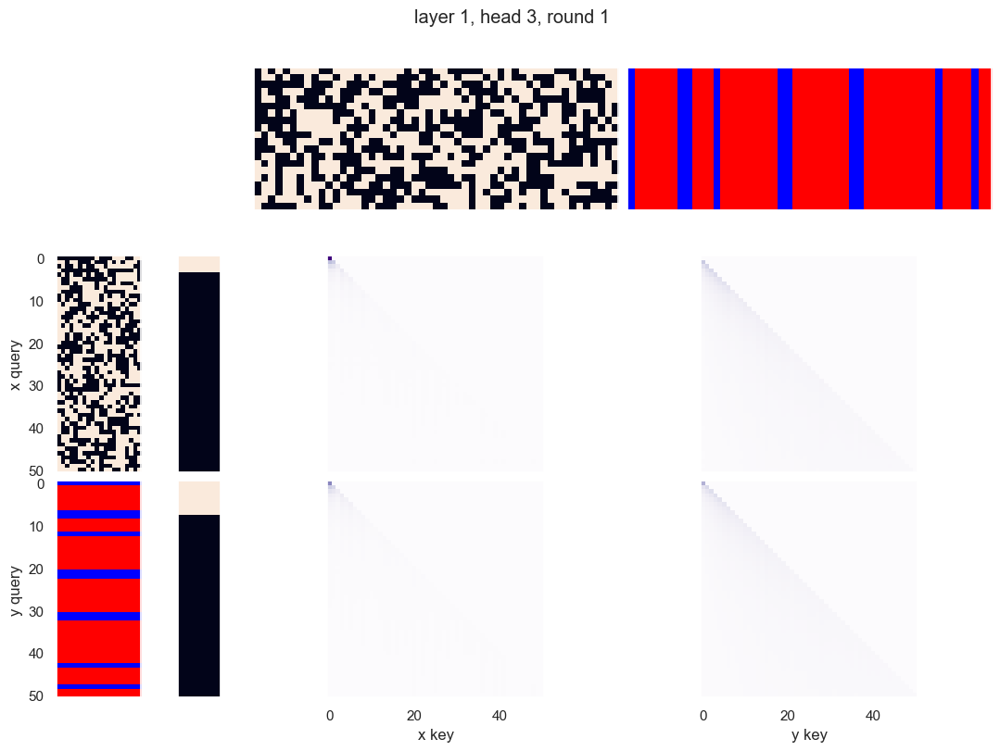

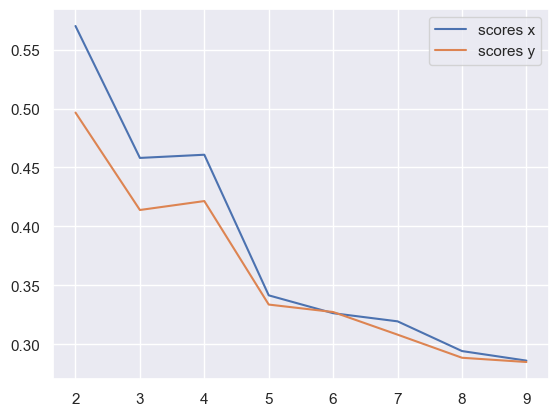

x query cluster:
SVM coefs: [-0.46865742 -0.57677839  0.27721161  0.2122632  -0.11847676 -0.05889017
  0.00723679 -0.45952167  0.42596741  0.43340787 -0.08996099  0.23647061
 -0.244953   -0.49574967 -0.29612501  0.17306034  0.11536486 -0.67924412
  0.21284526  0.8718651 ]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.8

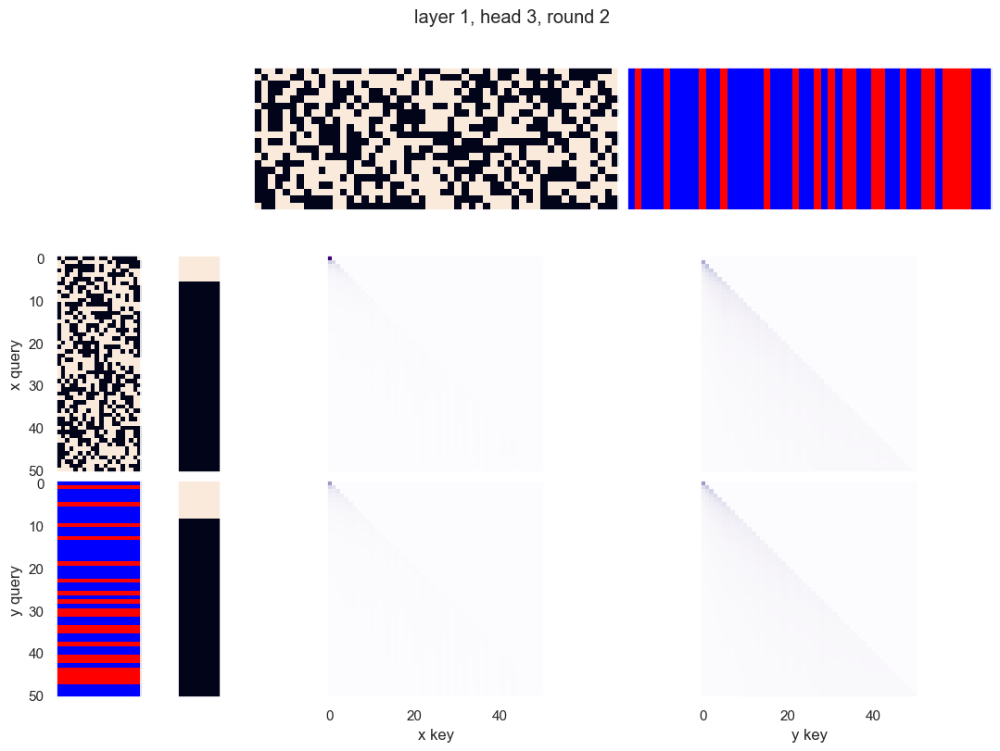

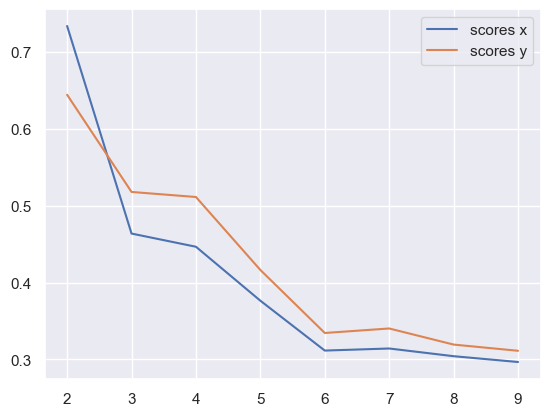

x query cluster:
SVM coefs: [ 0.26248119 -0.32280286  0.10229129  0.14784687 -0.2081984  -0.04183807
 -0.08340517 -0.0050391   0.46534557  0.28237284  0.02749808  0.26015479
  0.04958538  0.13378132  0.13217553 -0.16053198 -0.24771815 -0.57431841
  0.37580278  0.68952893]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.65; (3) -11: 0.62; (4) -18: 0.62; (5) -12: 0.62; (6) +6: 0.62; (7) +10: 0.60; (8) -0: 0.58; (9) -3: 0.58; (10) +2: 0.58
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) -3 AND -18: 0.48; (5) +5 AND +17: 0.46; (6) -11 AND +17: 0.46; (7) +13 AND -18: 0.46; (8) +17 AND -18: 0.46; (9) -0 AND +17: 0.46; (10) +6 AND -16: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) -16 OR +17: 0.92; (7) +17 OR -19: 0.92; (8) +7 OR +10: 0.92; (9) +6 OR +10: 0.92; (10) +4 O

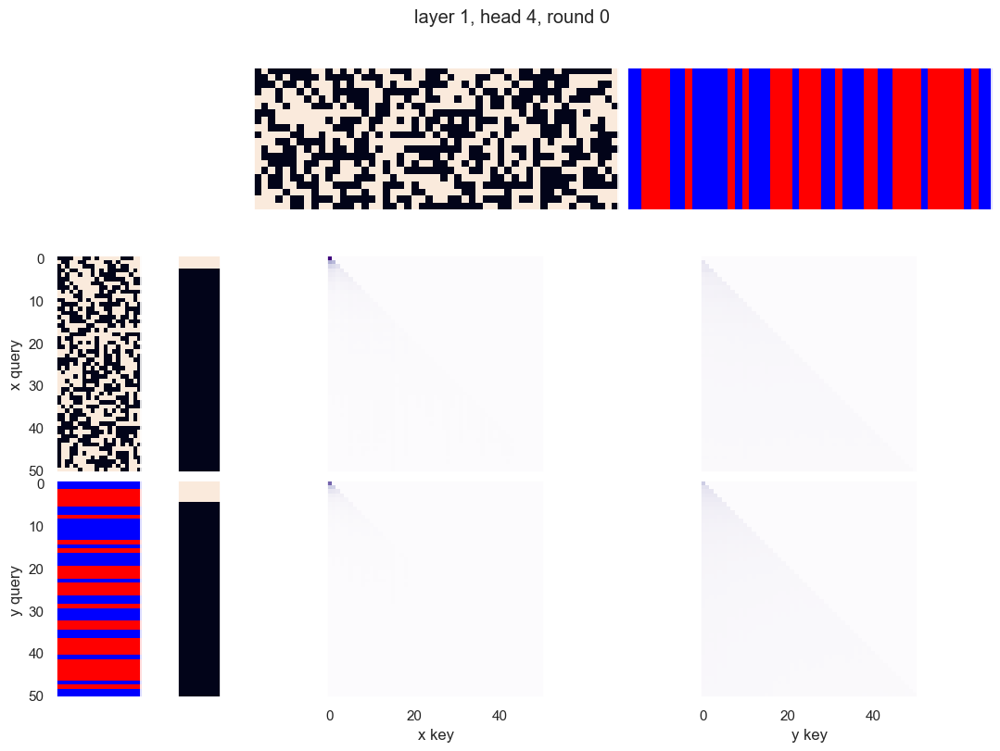

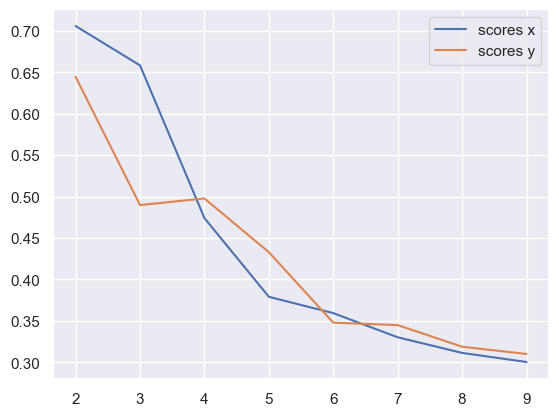

x query cluster:
SVM coefs: [ 0.25510344 -0.45922128  0.27299415  0.17551879 -0.2155213  -0.11985661
  0.07025541 -0.09279498  0.10831939  0.49036552 -0.00371579  0.20237766
 -0.11105342  0.23138569  0.04469119 -0.29457796 -0.46677271 -0.52135125
  0.57332331  0.62859129]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +0: 0.64; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.57; (7) +6: 0.57; (8) +17: 0.55; (9) +11: 0.55; (10) +5: 0.55
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) -12 AND -15: 0.40; (4) +5 AND -16: 0.40; (5) -12 AND +19: 0.40; (6) +9 AND +13: 0.40; (7) -4 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) -2 AND -12: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +0 OR +11: 0.89; (4) +14 OR +19: 0.89; (5) +14 OR +17: 0.89; (6) +0 OR +17: 0.89; (7) +13 OR +19: 0.89; (8) +14 OR -15: 0.89; (9) +14 OR -16: 0.89; (10) -12 OR

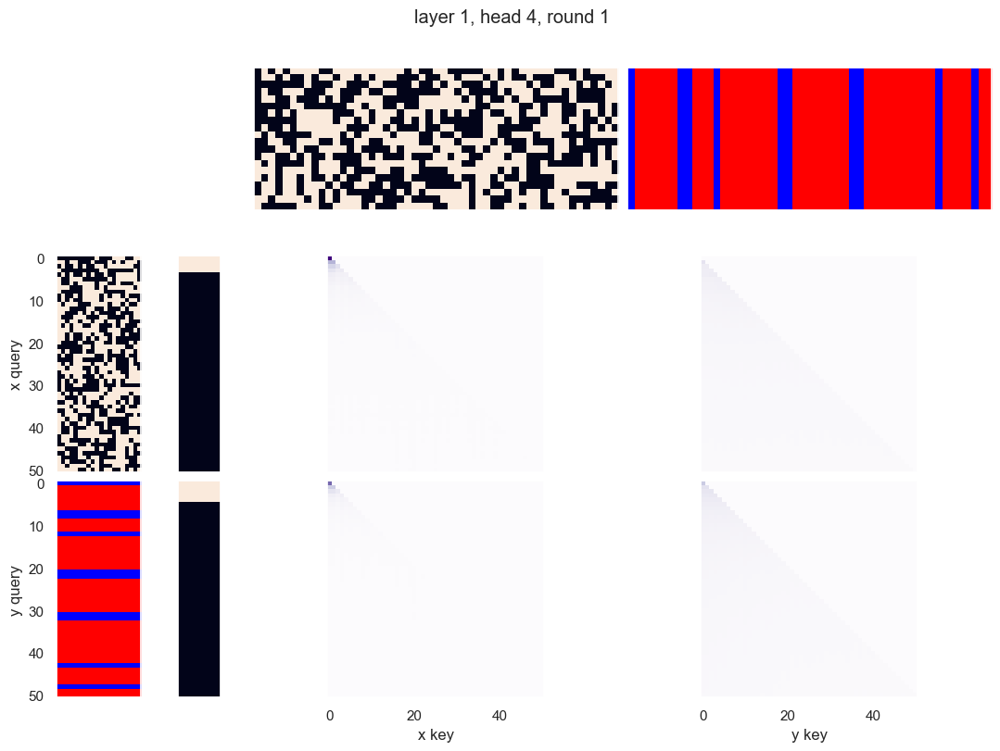

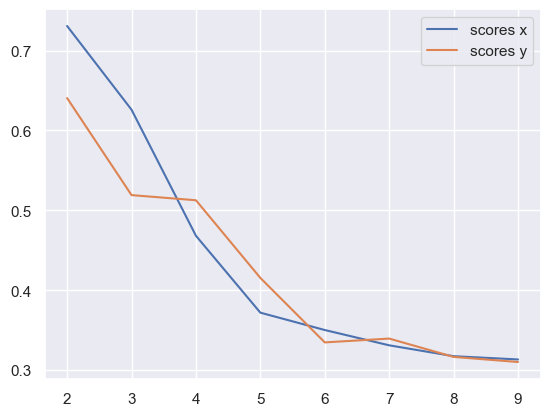

x query cluster:
SVM coefs: [ 0.262477   -0.32280291  0.10229138  0.14784062 -0.20820213 -0.04183628
 -0.08340245 -0.00503915  0.46534671  0.2823734   0.02749813  0.26015502
  0.04958752  0.13378383  0.13217341 -0.16053467 -0.24771957 -0.57431879
  0.37580261  0.68953023]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -0: 0.60; (4) -19: 0.60; (5) +14: 0.60; (6) +2: 0.60; (7) +8: 0.58; (8) +13: 0.58; (9) +6: 0.56; (10) -5: 0.56
(1) +8 AND +16: 0.46; (2) +16 AND +17: 0.46; (3) +17 AND -19: 0.46; (4) -5 AND +16: 0.44; (5) +7 AND +16: 0.44; (6) -9 AND -19: 0.44; (7) -0 AND +17: 0.44; (8) +8 AND +13: 0.42; (9) +17 AND -18: 0.42; (10) -18 AND -19: 0.42
(1) +12 OR +16: 0.92; (2) +14 OR +16: 0.92; (3) +2 OR -5: 0.90; (4) -10 OR -19: 0.90; (5) +7 OR +17: 0.90; (6) +2 OR +4: 0.90; (7) -0 OR -10: 0.88; (8) -8 OR +16: 0.88; (9) +5 OR +16: 0.88; (10) +18 OR -

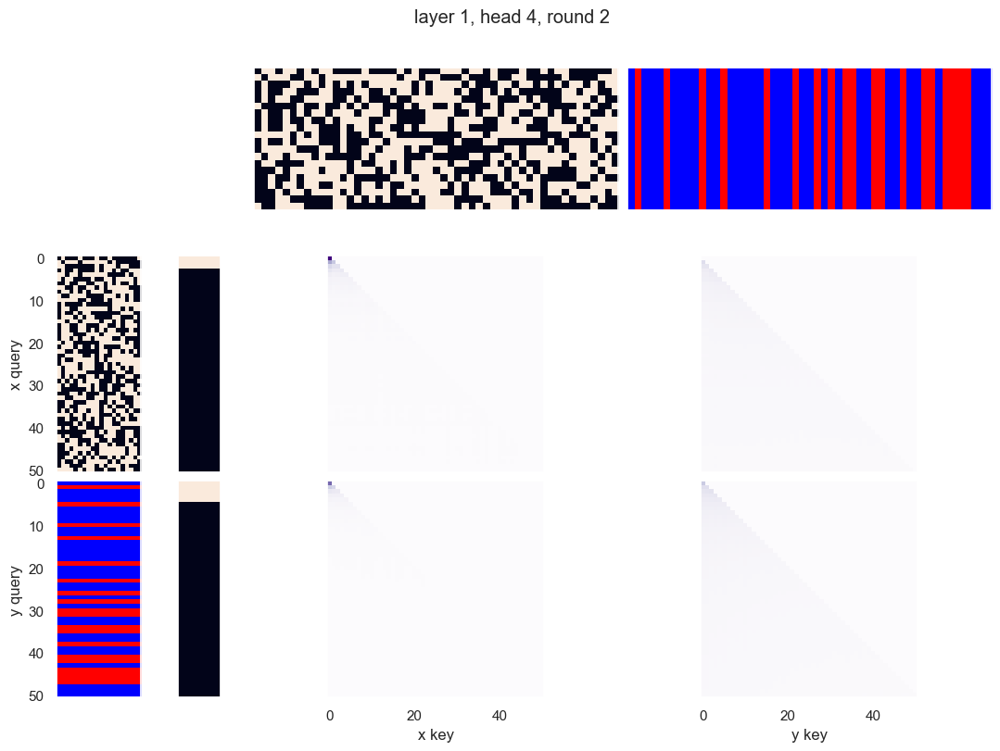

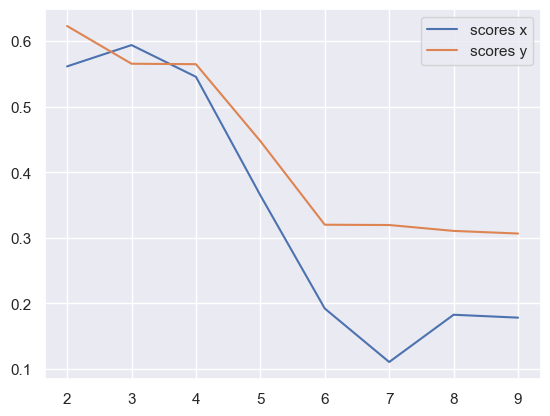

x query cluster:
SVM coefs for class 0: [-0.22388998  0.38446921 -0.9798361  -0.33723735 -0.22897814 -0.12420322
 -0.16796162  0.14935507 -0.31217347 -0.60125474  0.36793354 -0.67894037
 -0.22800535  0.00885034 -0.22799188  0.37240034 -0.08100632  0.63850073
 -0.84337255 -0.50115158]\class elements: [ 5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) +10: 0.64; (3) -16: 0.64; (4) -11: 0.64; (5) -12: 0.62; (6) -18: 0.62; (7) +6: 0.60; (8) +13: 0.58; (9) +8: 0.58; (10) +5: 0.58
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -11 AND +17: 0.49; (4) -3 AND -16: 0.47; (5) +13 AND -18: 0.47; (6) -3 AND -18: 0.47; (7) +17 AND -18: 0.44; (8) -0 AND +17: 0.44; (9) +6 AND -16: 0.44; (10) -12 AND +17: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) -12 OR -16: 0.93; (4) +10 OR -11: 0.93; (5) +17 OR -19: 0.93; (6) -2 OR -18: 0.93; (7) +10 OR +17: 0.93; (8) -16 OR +17: 0.93; (9) -3 OR -11: 

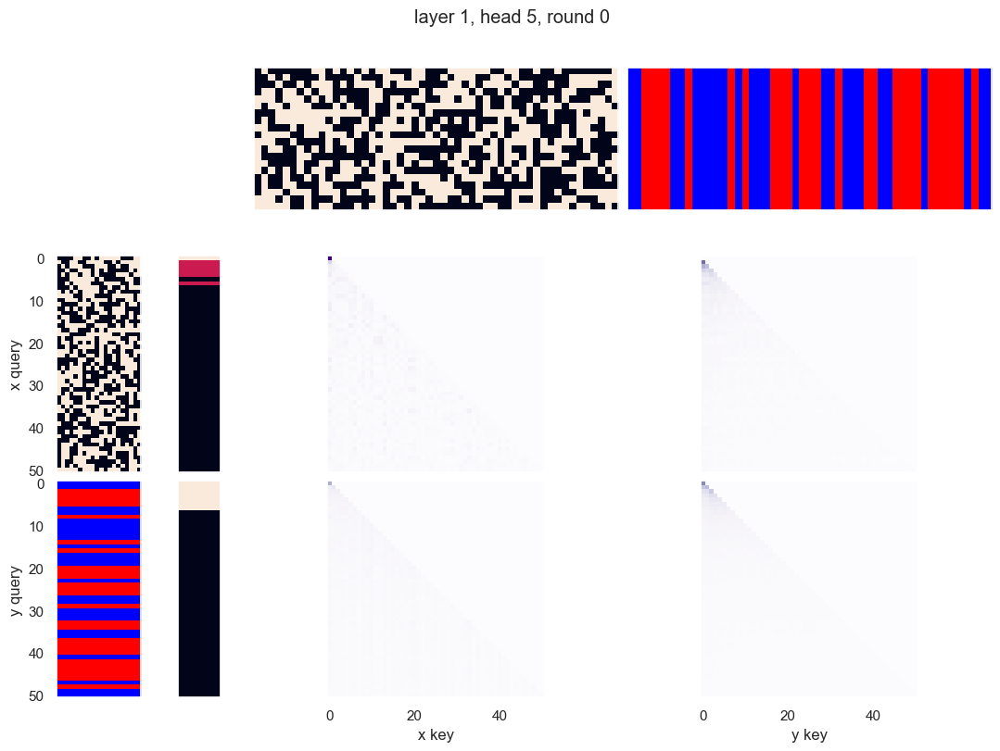

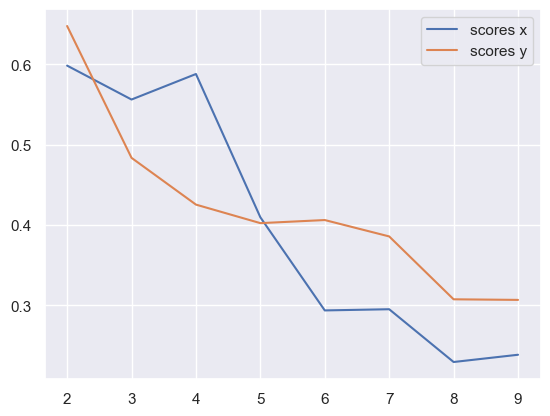

x query cluster:
SVM coefs: [-0.15737023 -0.3539326   0.24024783  0.27932714  0.12814186  0.12365152
 -0.03352094 -0.04216108  0.01451942  0.2841611   0.33000604 -0.29501472
 -0.28780461 -0.42926343 -0.31675915  0.05793623  0.07963217 -0.18366188
 -0.14570315  0.70564311]
class1: [ 0  4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +19: 0.62; (3) +0: 0.62; (4) +13: 0.62; (5) -12: 0.62; (6) -16: 0.60; (7) +6: 0.57; (8) -4: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) -3 AND +19: 0.45; (2) -2 AND -12: 0.43; (3) +9 AND +13: 0.43; (4) -4 AND +14: 0.43; (5) -12 AND +19: 0.43; (6) +0 AND +9: 0.43; (7) +13 AND +14: 0.43; (8) +5 AND -16: 0.40; (9) -12 AND +14: 0.40; (10) +0 AND -16: 0.40
(1) -12 OR +13: 0.94; (2) +13 OR +19: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR -15: 0.89; (5) +14 OR -16: 0.89; (6) -16 OR +19: 0.89; (7) +9 OR -12: 0.89; (8) +14 OR +17: 0.89; (9) +6 OR -16: 0.89; (10) +14 OR +

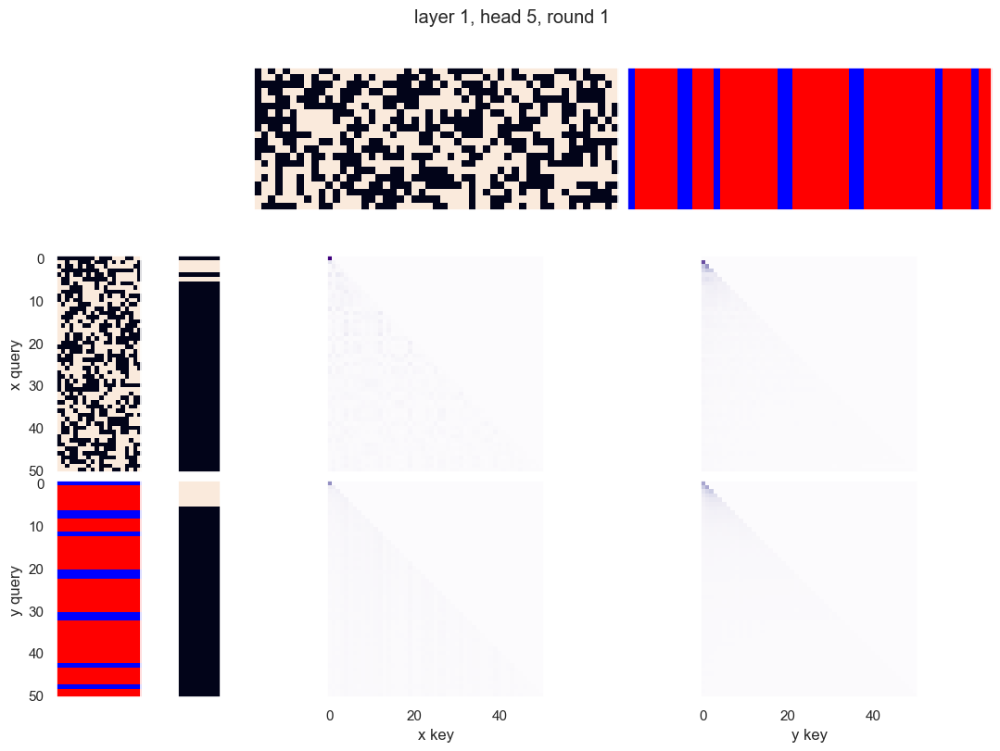

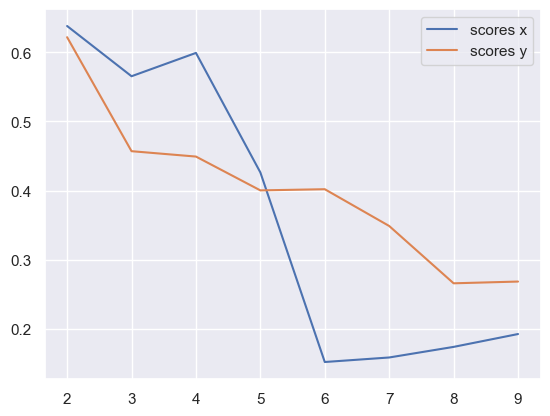

x query cluster:
SVM coefs: [ 0.3461025  -0.23436259  0.30746654  0.34993568  0.01560852  0.09451834
 -0.0354084   0.0896937  -0.12832905  0.52839214  0.10108819 -0.04732881
 -0.04376302  0.12067449 -0.07318227 -0.25894499 -0.1785925  -0.20129867
  0.15545995  0.51262438]
class1: [ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.62; (3) -19: 0.60; (4) +2: 0.60; (5) -0: 0.60; (6) +14: 0.58; (7) +8: 0.58; (8) +13: 0.58; (9) -9: 0.56; (10) -18: 0.56
(1) +17 AND -19: 0.46; (2) +8 AND +16: 0.46; (3) +16 AND +17: 0.46; (4) -9 AND -19: 0.44; (5) -5 AND +16: 0.44; (6) +7 AND +16: 0.44; (7) -9 AND +17: 0.42; (8) -18 AND -19: 0.42; (9) +17 AND -18: 0.42; (10) -0 AND +17: 0.42
(1) +12 OR +16: 0.92; (2) -10 OR -19: 0.90; (3) +14 OR +16: 0.90; (4) +5 OR +16: 0.90; (5) +9 OR -19: 0.88; (6) -10 OR +13: 0.88; (7) +1 OR +2: 0.88; (8) -8 OR +16: 0.88; (9) +16 OR -18: 0.88; (10) +13 

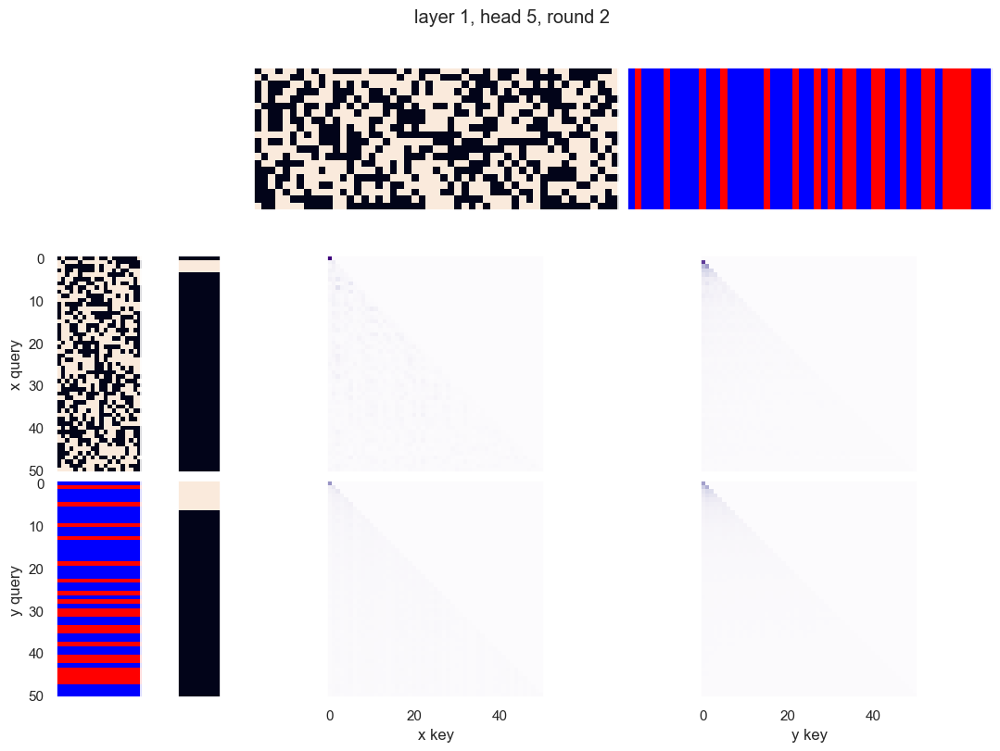

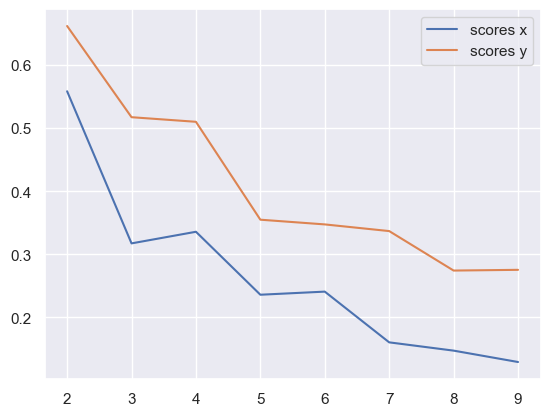

x query cluster:
SVM coefs: [-0.12267807 -0.24390413  0.71423786  0.23988362  0.26733853  0.3441626
  0.13319001  0.61014492  0.81259096  0.18137901 -0.20717174  0.514392
  0.15691951 -0.69493316 -0.07988439 -0.10377451  0.19404939 -0.41687728
  0.61618293  0.6277599 ]
class1: [ 0  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.68; (2) +10: 0.66; (3) -16: 0.66; (4) -12: 0.61; (5) -18: 0.61; (6) +13: 0.61; (7) -3: 0.61; (8) -11: 0.61; (9) +2: 0.59; (10) +8: 0.57
(1) +2 AND -18: 0.52; (2) -3 AND -16: 0.50; (3) -3 AND -18: 0.48; (4) +13 AND -18: 0.48; (5) +6 AND +17: 0.45; (6) -11 AND +17: 0.45; (7) -7 AND +10: 0.45; (8) +17 AND -18: 0.43; (9) -3 AND +13: 0.43; (10) -16 AND -18: 0.43
(1) -11 OR -16: 0.95; (2) +10 OR -11: 0.93; (3) +10 OR -12: 0.93; (4) -12 OR -16: 0.93; (5) -3 OR -11: 0.93; (6) -2 OR -18: 0.93; (7) -11 OR -18: 0.93; (8) -16 OR +17: 0.93; (9) +10 OR +17: 0.93; (10) +6 OR +10: 0.91

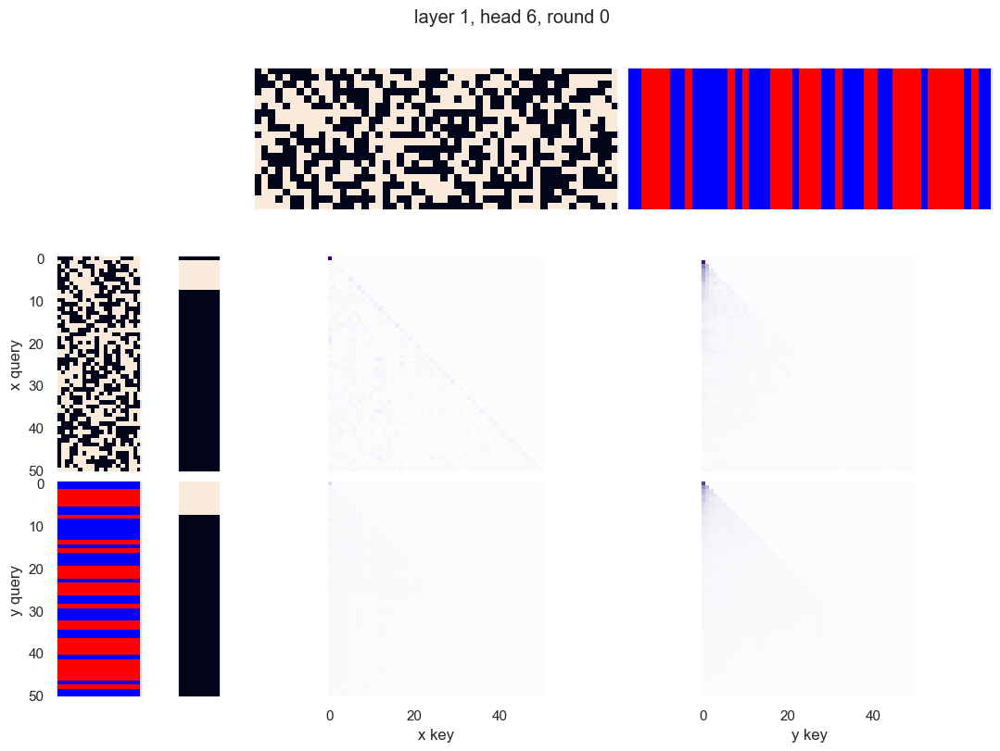

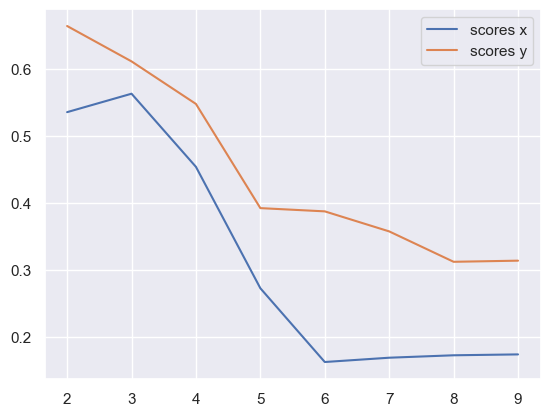

x query cluster:
SVM coefs for class 0: [-0.18640586  0.51159059 -0.70710627 -0.3700317  -0.38306491 -0.40485156
 -0.38365207 -0.51767845 -0.90279462 -0.0099979   0.40022698 -0.34730246
 -0.18040097  0.75015122 -0.07032401  0.44771114  0.19461412  0.76255967
 -0.36405207 -0.93666762]\class elements: [10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.63; (2) -16: 0.63; (3) +14: 0.63; (4) +13: 0.63; (5) +19: 0.61; (6) -12: 0.59; (7) +5: 0.59; (8) +9: 0.59; (9) +11: 0.56; (10) -3: 0.56
(1) +0 AND +9: 0.46; (2) +5 AND -16: 0.44; (3) +9 AND +13: 0.44; (4) -3 AND +19: 0.44; (5) +0 AND -16: 0.44; (6) +0 AND -12: 0.41; (7) +0 AND +13: 0.41; (8) -12 AND +19: 0.41; (9) +11 AND +19: 0.41; (10) +13 AND -16: 0.41
(1) -16 OR +19: 0.93; (2) -12 OR +13: 0.93; (3) +13 OR +19: 0.93; (4) +0 OR +14: 0.90; (5) +9 OR -12: 0.90; (6) +0 OR +17: 0.90; (7) +14 OR -16: 0.90; (8) +5 OR +14: 0.88; (9) +0 OR -8: 0.88; (10) -8 OR -1

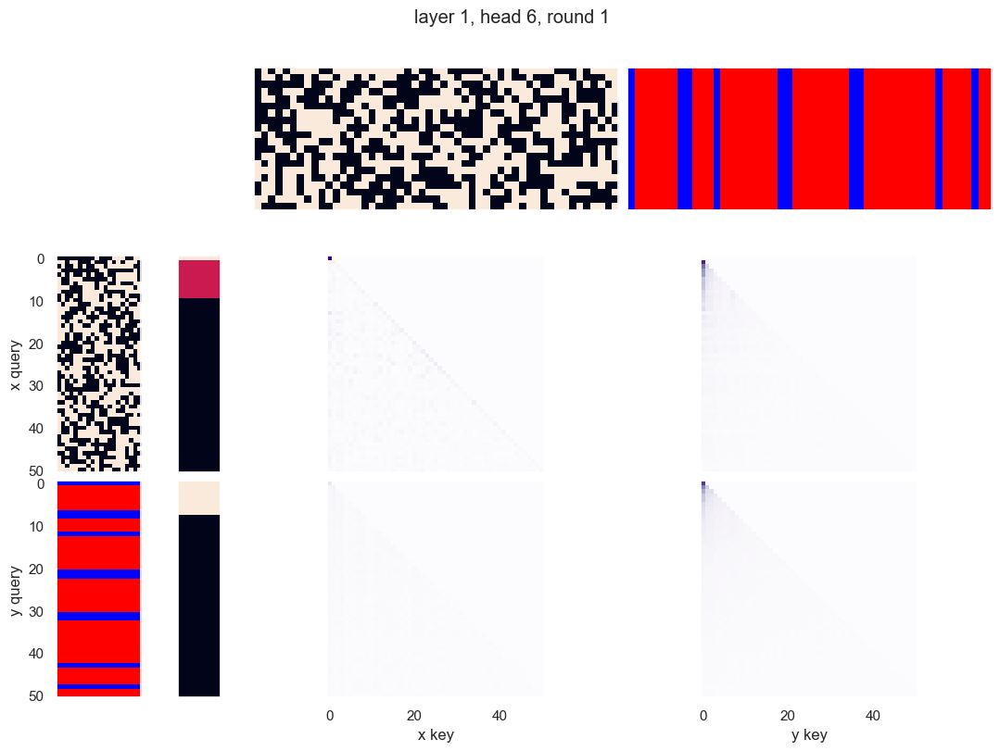

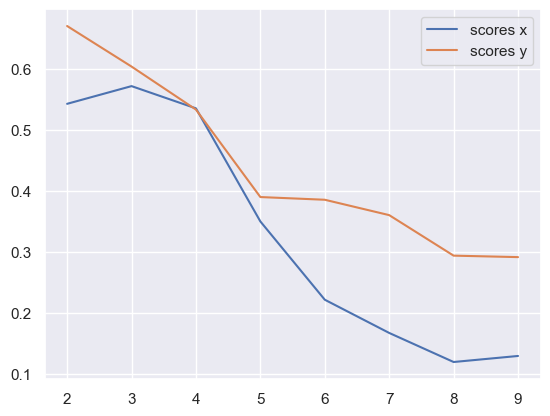

x query cluster:
SVM coefs for class 0: [-0.19384633  0.53395145 -0.33930652 -0.26735466 -0.36126082 -0.38596168
 -0.3751287  -0.61993787 -0.83782935 -0.19031659  0.21142142 -0.53884059
 -0.31613689  0.83768572 -0.18793464  0.69302766  0.26582835  0.91519278
 -0.1777953  -0.93399189]\class elements: [ 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) -0: 0.62; (5) +13: 0.62; (6) +2: 0.62; (7) -9: 0.60; (8) +7: 0.60; (9) +14: 0.57; (10) +6: 0.57
(1) +17 AND -19: 0.50; (2) -9 AND -19: 0.48; (3) +16 AND +17: 0.48; (4) -9 AND +13: 0.45; (5) +7 AND +16: 0.45; (6) -9 AND +17: 0.45; (7) +8 AND +16: 0.43; (8) +8 AND +13: 0.43; (9) -15 AND +16: 0.43; (10) -0 AND +16: 0.43
(1) -10 OR -19: 0.93; (2) -10 OR +13: 0.90; (3) +7 OR -9: 0.90; (4) +13 OR +16: 0.90; (5) +2 OR +17: 0.90; (6) +7 OR -19: 0.90; (7) +14 OR +16: 0.90; (8) +16 OR -19: 0.90; (9) +15 OR +16: 0.90; (10) -0 

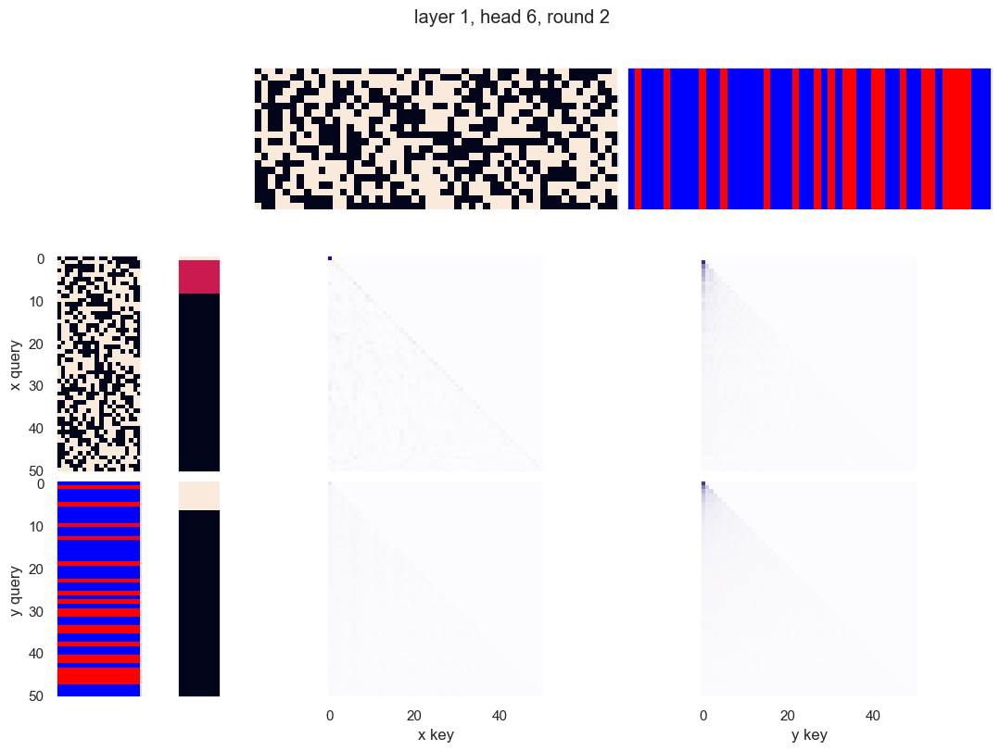

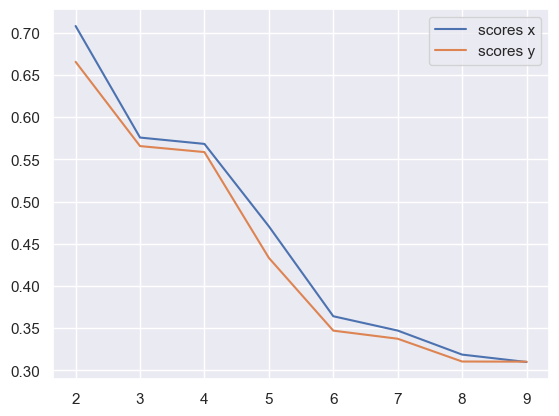

x query cluster:
SVM coefs: [ 0.25510074 -0.45922121  0.27299301  0.17551605 -0.21551729 -0.11984943
  0.07025426 -0.09278599  0.10831793  0.49036252 -0.00371339  0.20237649
 -0.11105013  0.23138476  0.04469714 -0.29458032 -0.46677695 -0.52135295
  0.57331805  0.6285946 ]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR

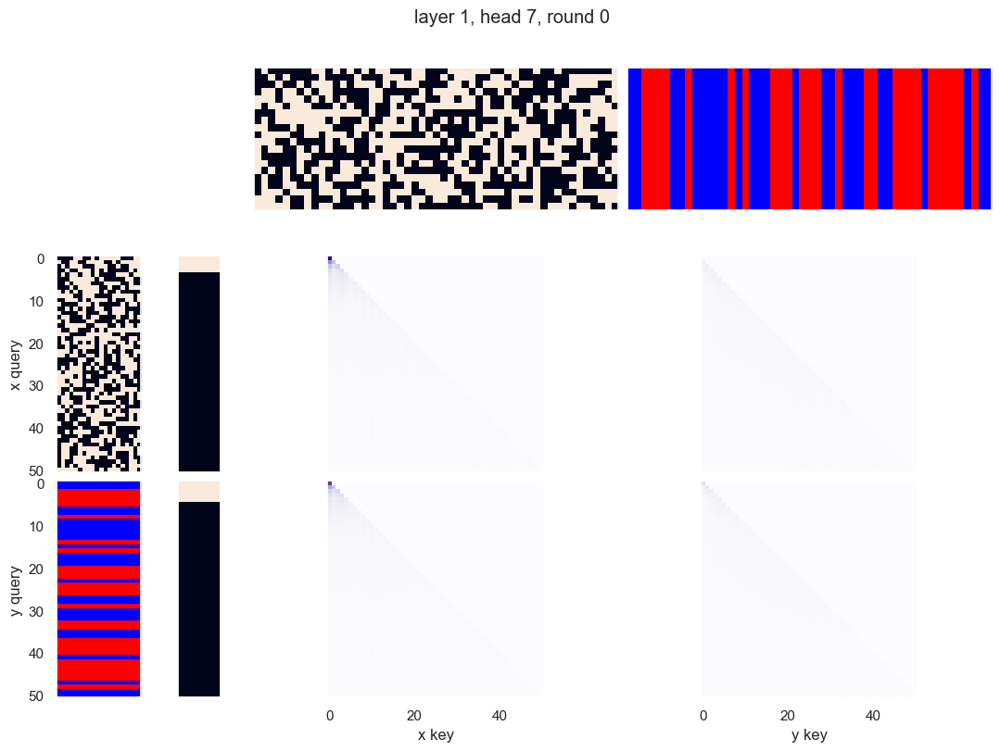

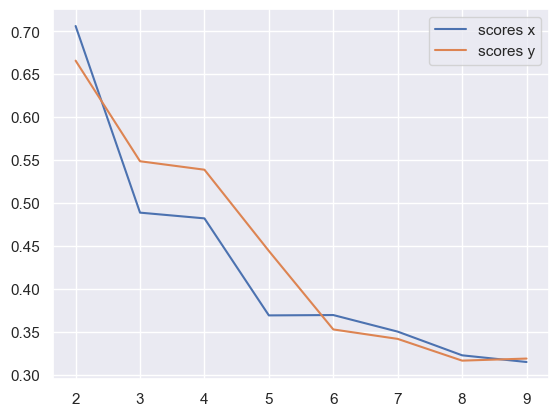

x query cluster:
SVM coefs: [ 0.2551033  -0.4592236   0.27299131  0.17551151 -0.21551207 -0.11984746
  0.07025014 -0.09277946  0.10832436  0.49034957 -0.00371373  0.20238986
 -0.11104339  0.23137943  0.04470146 -0.29457908 -0.46677584 -0.52135587
  0.57331863  0.62858866]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +0: 0.64; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.57; (7) +6: 0.57; (8) +17: 0.55; (9) +11: 0.55; (10) +5: 0.55
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) -12 AND -15: 0.40; (4) +5 AND -16: 0.40; (5) -12 AND +19: 0.40; (6) +9 AND +13: 0.40; (7) -4 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) -2 AND -12: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +0 OR +11: 0.89; (4) +14 OR +19: 0.89; (5) +14 OR +17: 0.89; (6) +0 OR +17: 0.89; (7) +13 OR +19: 0.89; (8) +14 OR -15: 0.89; (9) +14 OR -16: 0.89; (10) -12 OR

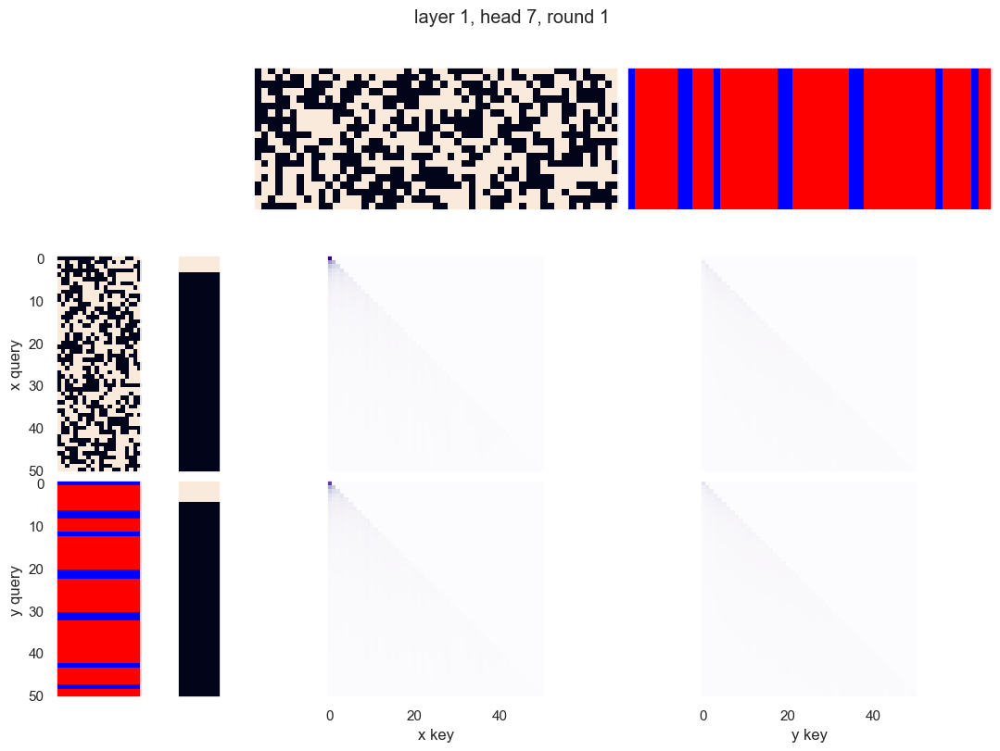

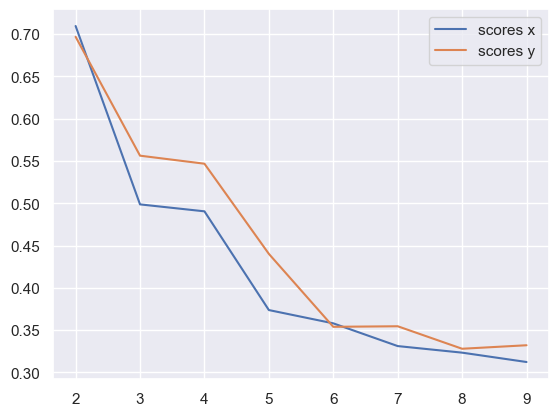

x query cluster:
SVM coefs: [ 0.25510009 -0.45922433  0.27299453  0.17551638 -0.21551713 -0.11985172
  0.07025303 -0.09279049  0.10831918  0.49036549 -0.00370972  0.20237754
 -0.11105185  0.2313867   0.04469181 -0.29457884 -0.46677682 -0.52135375
  0.57332194  0.62859108]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) +17: 0.64; (3) -19: 0.62; (4) +2: 0.62; (5) +8: 0.60; (6) +13: 0.60; (7) -0: 0.60; (8) +14: 0.60; (9) -9: 0.57; (10) +6: 0.57
(1) +8 AND +16: 0.47; (2) +17 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) -9 AND -19: 0.45; (5) -5 AND +16: 0.45; (6) +7 AND +16: 0.45; (7) -0 AND +17: 0.43; (8) -9 AND +13: 0.43; (9) +8 AND +13: 0.43; (10) +17 AND -18: 0.43
(1) +12 OR +16: 0.91; (2) +14 OR +16: 0.91; (3) +13 OR +16: 0.89; (4) +15 OR +16: 0.89; (5) +6 OR +16: 0.89; (6) +5 OR +16: 0.89; (7) +16 OR -19: 0.89; (8) +2 OR +16: 0.89; (9) +7 OR +17: 0.89; (10) +2 OR +4

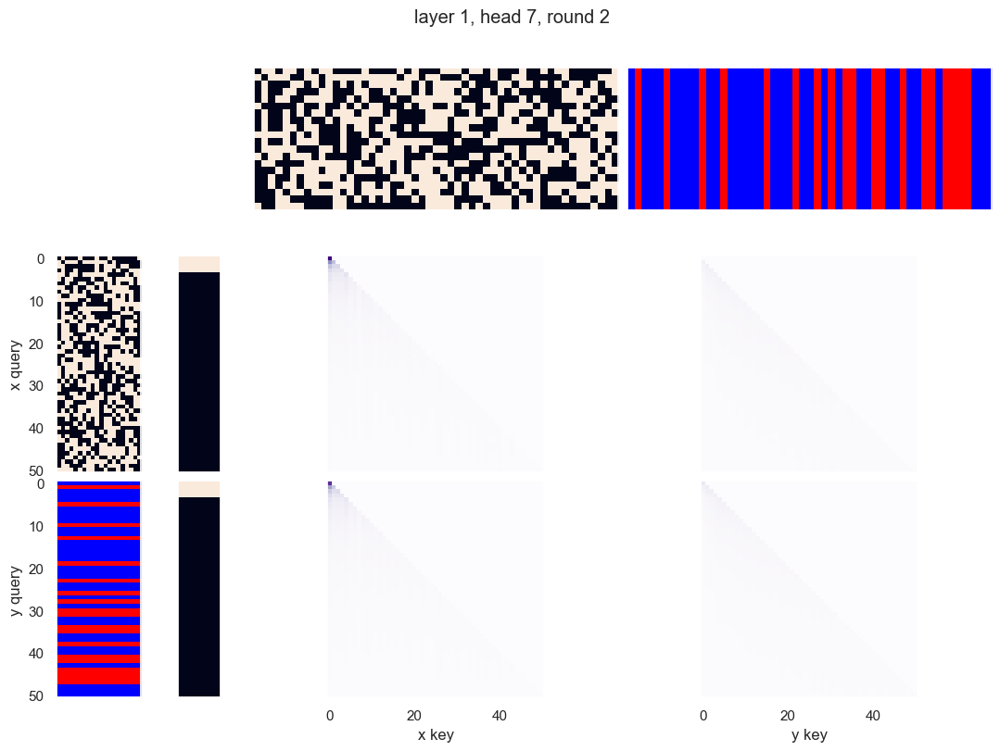

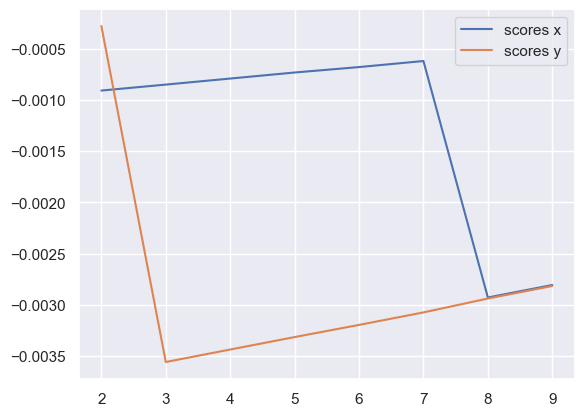

x query cluster:
SVM coefs for class 0: [-0.25282951 -0.02782045 -0.10311539  0.30596289 -0.43911398  0.15161295
 -0.0371026  -0.02366142  0.14232797  0.13887539 -0.08178916 -0.0205761
 -0.00313359  0.12607352  0.35488562 -0.02169368  0.21673441 -0.16241877
  0.00913381  0.0793081 ]\class elements: [44 45]
(1) -0: 1.00; (2) -11: 1.00; (3) -12: 1.00; (4) +1: 1.00; (5) +2: 1.00; (6) +16: 1.00; (7) -4: 1.00; (8) +14: 1.00; (9) +5: 1.00; (10) -13: 0.50
(1) -11 AND -12: 1.00; (2) -0 AND -11: 1.00; (3) -0 AND -12: 1.00; (4) -12 AND +14: 1.00; (5) -0 AND +14: 1.00; (6) -4 AND +5: 1.00; (7) -0 AND +16: 1.00; (8) -12 AND +16: 1.00; (9) +2 AND +5: 1.00; (10) +2 AND -4: 1.00
(1) -0 OR -1: 1.00; (2) +6 OR -17: 1.00; (3) -6 OR +17: 1.00; (4) +6 OR +16: 1.00; (5) -6 OR +16: 1.00; (6) +6 OR -15: 1.00; (7) -6 OR +15: 1.00; (8) +6 OR +14: 1.00; (9) -6 OR +14: 1.00; (10) +6 OR -13: 1.00
{7.0: 4.0578112737833344e-16, 11.0: 5.713702774238438e-07, 8.0: 5.838383452054935e-19, 13.0: 2.579465496754807e-08, 12

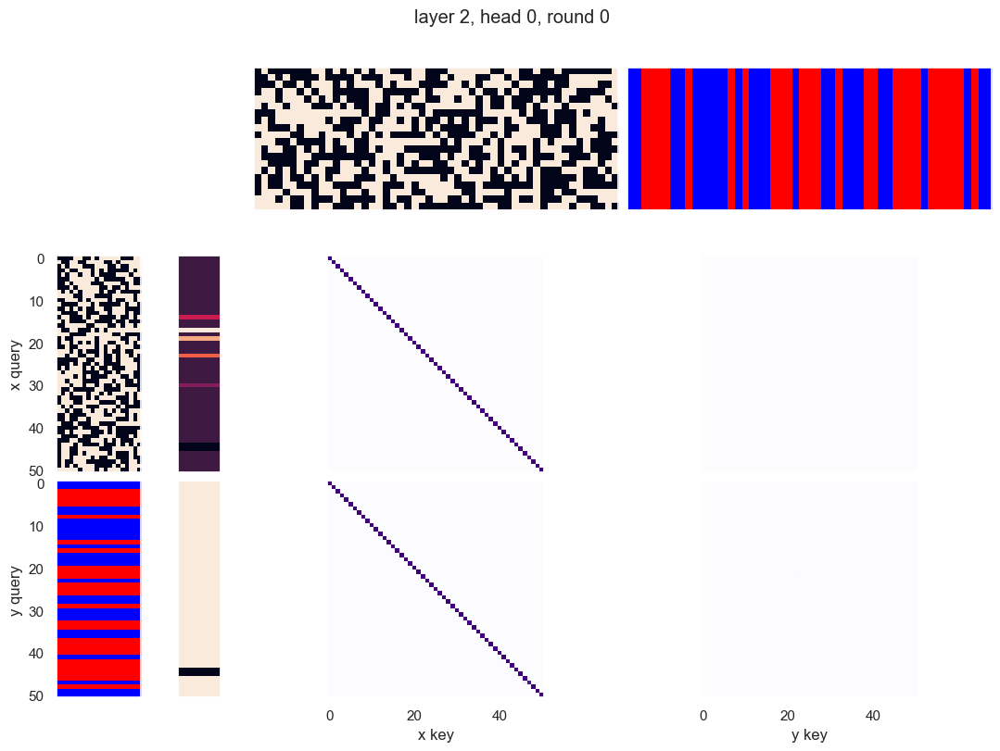

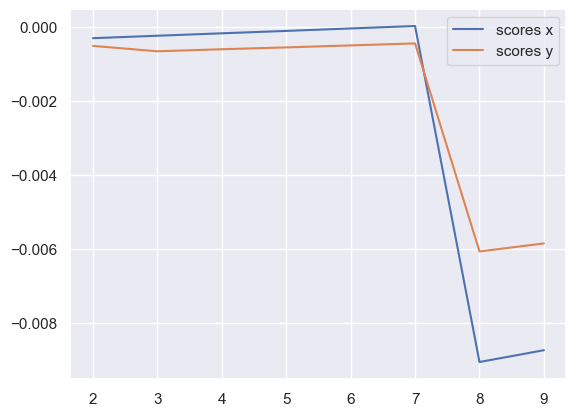

x query cluster:
SVM coefs for class 0: [ 0.03571983  0.04280279 -0.03109681  0.23935114 -0.30185603  0.14473453
 -0.00269925  0.09226918  0.14555119 -0.0617576   0.02882823  0.04208163
  0.0131057  -0.14418051  0.1634868  -0.15123199  0.08349083 -0.3087898
  0.09516348  0.04678758]\class elements: [44]
(1) -0: 1.00; (2) -11: 1.00; (3) -10: 1.00; (4) -19: 1.00; (5) -9: 1.00; (6) +14: 1.00; (7) -8: 1.00; (8) +7: 1.00; (9) +15: 1.00; (10) -12: 1.00
(1) -0 AND -1: 1.00; (2) -10 AND +15: 1.00; (3) +2 AND -19: 1.00; (4) -10 AND +14: 1.00; (5) +3 AND +4: 1.00; (6) +3 AND -5: 1.00; (7) -10 AND -13: 1.00; (8) +3 AND -6: 1.00; (9) -10 AND -12: 1.00; (10) +3 AND +7: 1.00
(1) -0 OR -1: 1.00; (2) -7 OR -12: 1.00; (3) +7 OR -12: 1.00; (4) +7 OR +12: 1.00; (5) -7 OR -13: 1.00; (6) +7 OR -13: 1.00; (7) +7 OR +13: 1.00; (8) -7 OR +14: 1.00; (9) +7 OR +11: 1.00; (10) +7 OR -14: 1.00
{0.0: 9.391306598378283e-08}
SVM coefs for class 1: [-0.26389628 -0.8156304   0.12630666  0.10671828  0.67867485 -0.71008

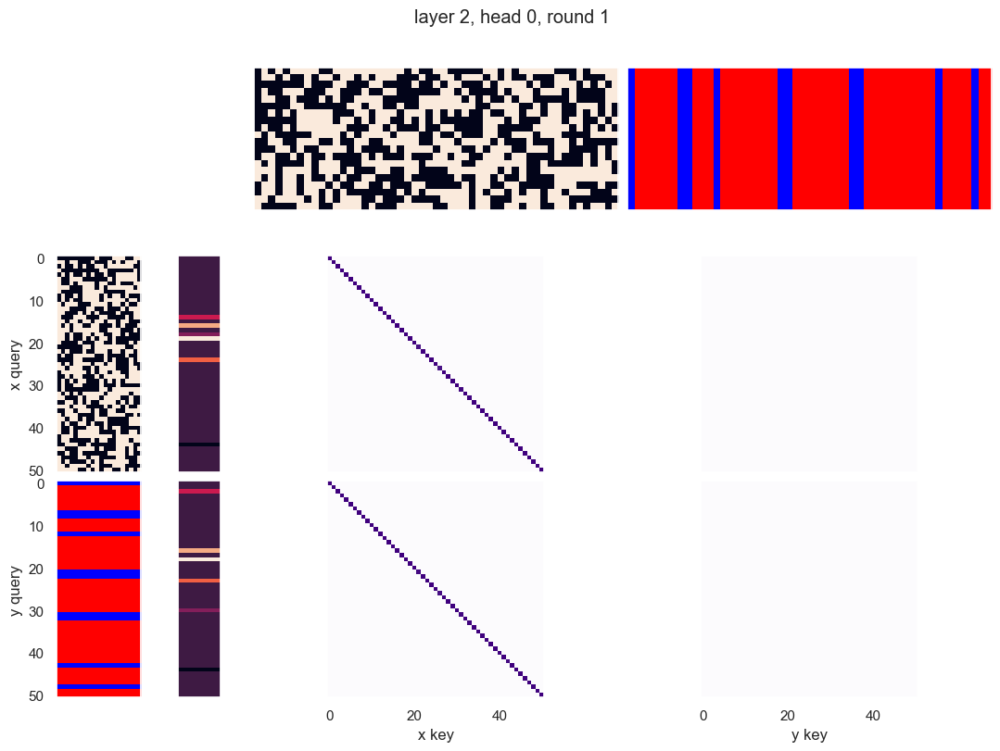

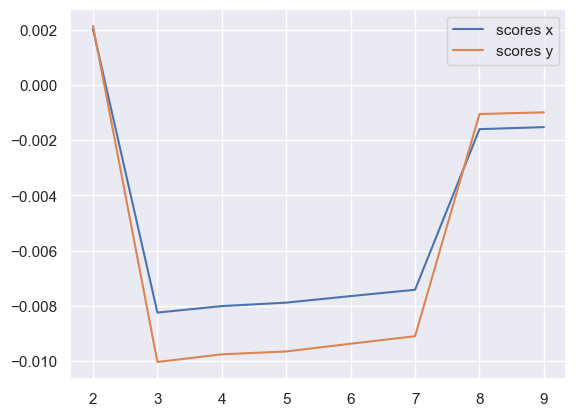

x query cluster:
SVM coefs: [-0.03572183 -0.04280351  0.03109656 -0.23934967  0.30185719 -0.14473519
  0.00270151 -0.09226766 -0.14554952  0.06175348 -0.02882827 -0.04208312
 -0.01310385  0.14417861 -0.16348686  0.15123112 -0.08349139  0.30879285
 -0.09516143 -0.04678935]
class1: [44]
(1) -0: 1.00; (2) +8: 1.00; (3) -14: 1.00; (4) -15: 1.00; (5) -7: 1.00; (6) +6: 1.00; (7) -12: 1.00; (8) +10: 1.00; (9) -5: 1.00; (10) +4: 1.00
(1) -0 AND -1: 1.00; (2) +11 AND +17: 1.00; (3) +2 AND -5: 1.00; (4) -5 AND +6: 1.00; (5) +11 AND +16: 1.00; (6) +2 AND +6: 1.00; (7) +8 AND +10: 1.00; (8) +4 AND -19: 1.00; (9) +2 AND -7: 1.00; (10) +11 AND -15: 1.00
(1) -0 OR -1: 1.00; (2) +5 OR -19: 1.00; (3) -12 OR -16: 1.00; (4) -6 OR -7: 1.00; (5) +6 OR -7: 1.00; (6) +6 OR +7: 1.00; (7) +12 OR -15: 1.00; (8) -5 OR +19: 1.00; (9) -6 OR +8: 1.00; (10) +6 OR +8: 1.00
{0.0: 4.069184635820208e-08}
class2: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35

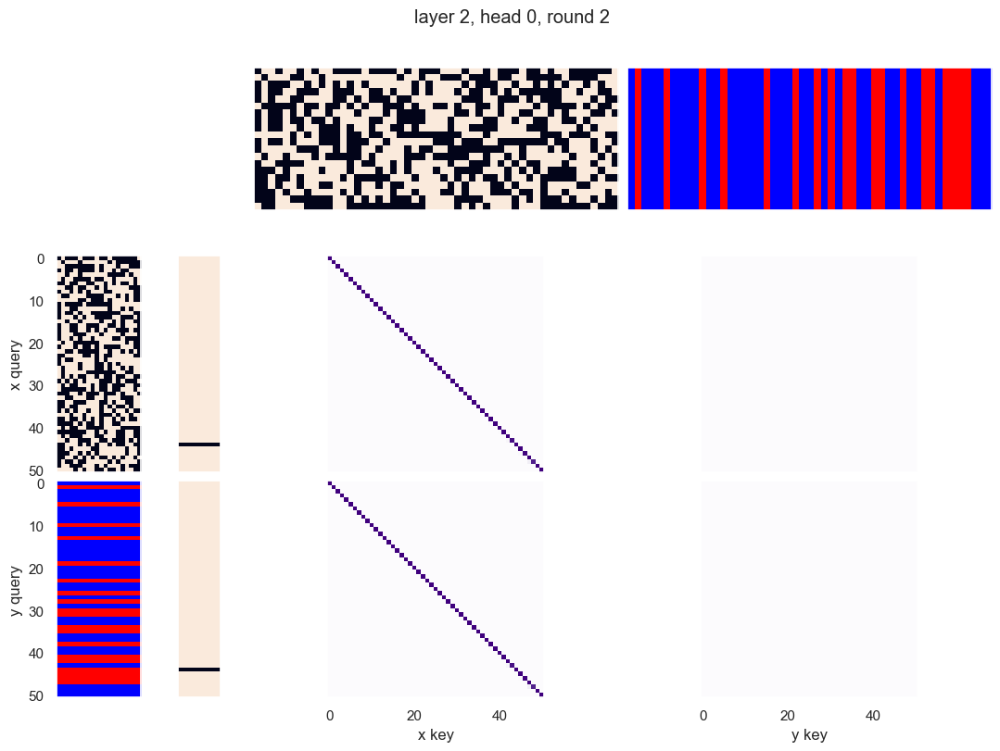

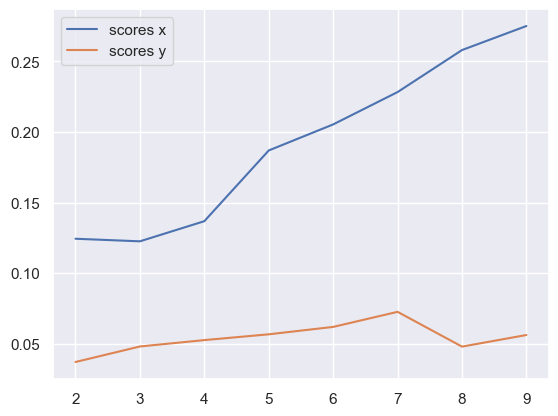

x query cluster:
SVM coefs for class 0: [-0.36000565  0.03283255 -0.0502707  -0.20985188 -0.17535614 -0.12438037
 -0.39334513 -0.01752491  0.08014363  0.03883572 -0.22715382  0.06127693
  0.01979067  0.02222871 -0.04297037 -0.25014594 -0.09139208  0.1320769
  0.06778909  0.00719789]\class elements: [33 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) -0: 0.80; (2) -16: 0.80; (3) +17: 0.73; (4) -15: 0.73; (5) +13: 0.73; (6) -3: 0.73; (7) +5: 0.67; (8) +19: 0.67; (9) -4: 0.60; (10) -18: 0.60
(1) -0 AND -16: 0.67; (2) -15 AND -16: 0.67; (3) +13 AND -16: 0.67; (4) -3 AND +13: 0.60; (5) -3 AND -16: 0.60; (6) -0 AND +13: 0.60; (7) -0 AND -15: 0.60; (8) -0 AND +5: 0.60; (9) +13 AND -18: 0.60; (10) -0 AND -3: 0.60
(1) -0 OR +17: 1.00; (2) -11 OR -18: 1.00; (3) +13 OR +18: 1.00; (4) +8 OR -15: 1.00; (5) -3 OR -11: 1.00; (6) -3 OR +18: 1.00; (7) -15 OR +17: 1.00; (8) -15 OR +19: 1.00; (9) -7 OR +13: 1.00; (10) -11 OR +13: 1.00
{7.0: 0.04291256045890121, 11.0: 0.1598357120922761, 8.0: 0.15026578465

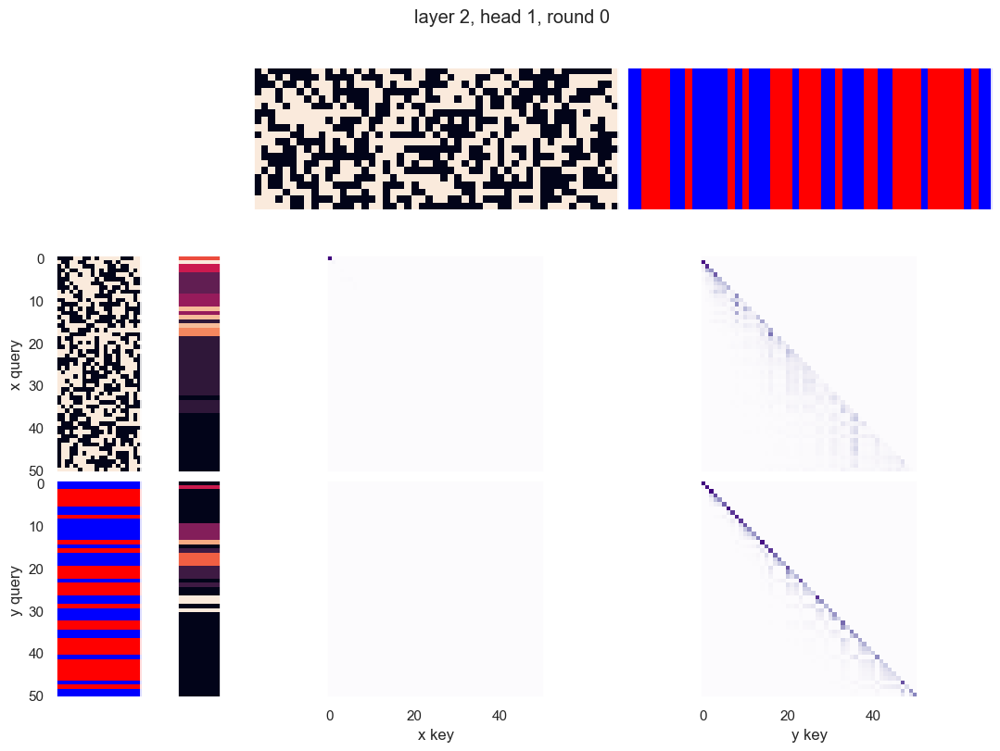

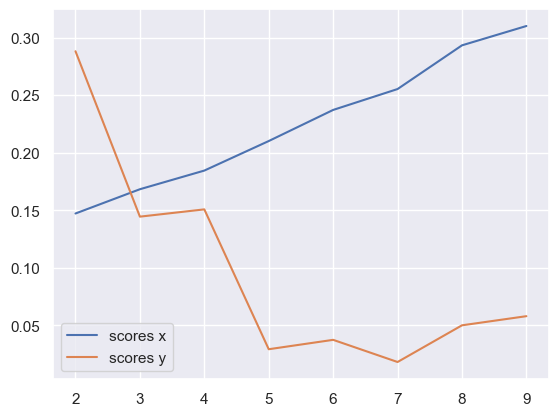

x query cluster:
SVM coefs for class 0: [-0.21085427 -0.16142089 -0.06995752 -0.0776756  -0.24049846 -0.17821704
 -0.27308221 -0.09937185 -0.159289    0.02689905 -0.30563789 -0.09583599
  0.10303603  0.03764167 -0.02479698 -0.04144956 -0.28094014  0.10238184
  0.05225552 -0.03027312]\class elements: [25 26 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.71; (2) -16: 0.67; (3) +14: 0.67; (4) +9: 0.62; (5) -10: 0.62; (6) +5: 0.62; (7) +17: 0.62; (8) +2: 0.62; (9) +13: 0.57; (10) -4: 0.57
(1) +0 AND -16: 0.57; (2) +0 AND +9: 0.52; (3) +0 AND +14: 0.48; (4) +5 AND -16: 0.48; (5) +5 AND +17: 0.48; (6) -16 AND +17: 0.48; (7) +14 AND +15: 0.48; (8) +0 AND -10: 0.48; (9) -10 AND +14: 0.48; (10) -4 AND +5: 0.43
(1) +14 OR +17: 1.00; (2) +0 OR +2: 1.00; (3) +2 OR -16: 1.00; (4) +0 OR -4: 0.95; (5) -16 OR +19: 0.95; (6) +2 OR +8: 0.95; (7) +0 OR +17: 0.95; (8) +14 OR -16: 0.95; (9) +0 OR +15: 0.95; (10) +0 OR +12: 0.90
{0.0: 0.9987561559345315}
SVM coefs for class 1: [ 4.08376

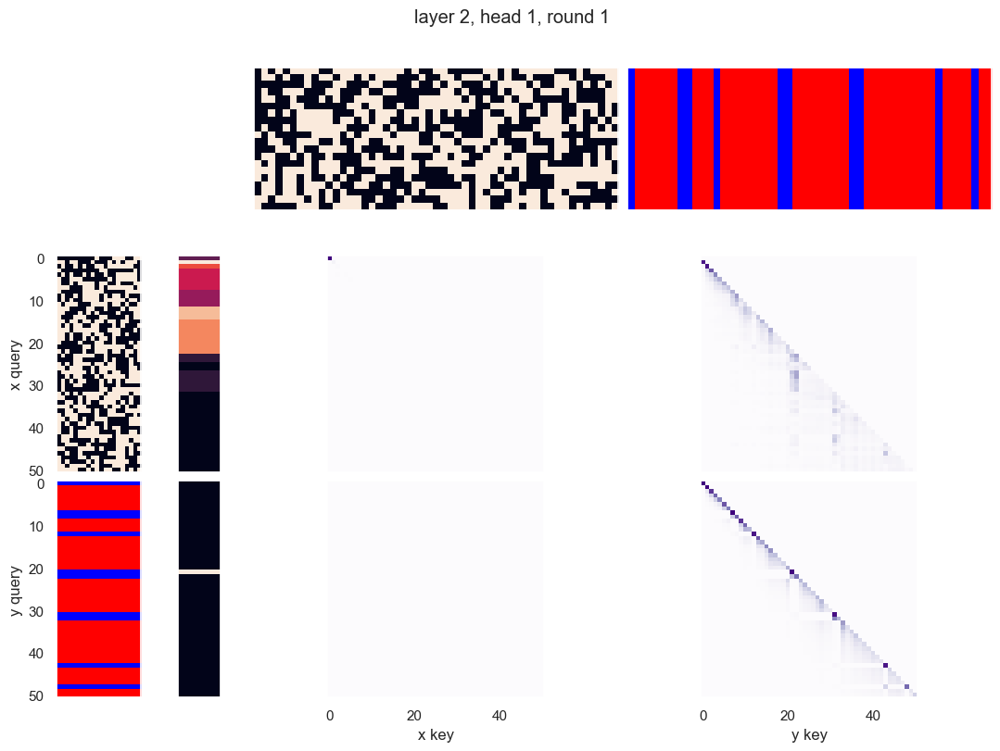

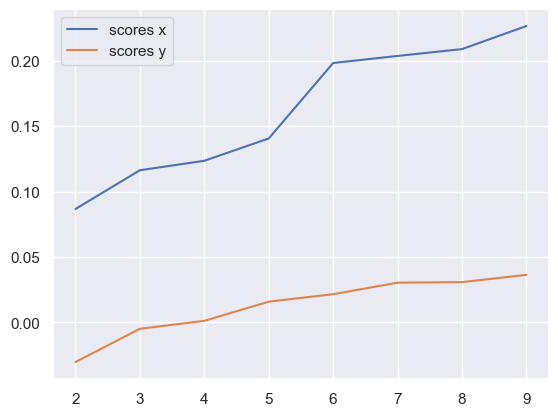

x query cluster:
SVM coefs for class 0: [-0.03133316 -0.07734331 -0.18504322 -0.04840795 -0.12649601 -0.19539164
 -0.17570134  0.05684108 -0.17756262  0.02675198 -0.1639627  -0.08163224
  0.08398076 -0.04539829  0.02962963 -0.21844905 -0.29858487 -0.08689525
 -0.22334564  0.08110617]\class elements: [ 8 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) -0: 0.68; (2) +16: 0.68; (3) +12: 0.68; (4) +8: 0.68; (5) +2: 0.63; (6) -3: 0.63; (7) +13: 0.63; (8) -19: 0.63; (9) +17: 0.58; (10) -15: 0.58
(1) +8 AND -19: 0.53; (2) +8 AND +16: 0.53; (3) -3 AND +13: 0.53; (4) -0 AND -1: 0.47; (5) -0 AND +17: 0.47; (6) +12 AND +14: 0.47; (7) +13 AND -19: 0.47; (8) -0 AND +12: 0.47; (9) -1 AND +12: 0.47; (10) +2 AND +7: 0.47
(1) -10 OR +13: 1.00; (2) +9 OR -19: 1.00; (3) +14 OR +16: 1.00; (4) +8 OR +12: 1.00; (5) +12 OR +16: 1.00; (6) -0 OR -10: 0.95; (7) +6 OR +7: 0.95; (8) +6 OR +16: 0.95; (9) +5 OR +8: 0.95; (10) +8 OR +14: 0.95
{0.0: 0.9988710892467764}
SVM coefs for class 1: [-0.03344211  

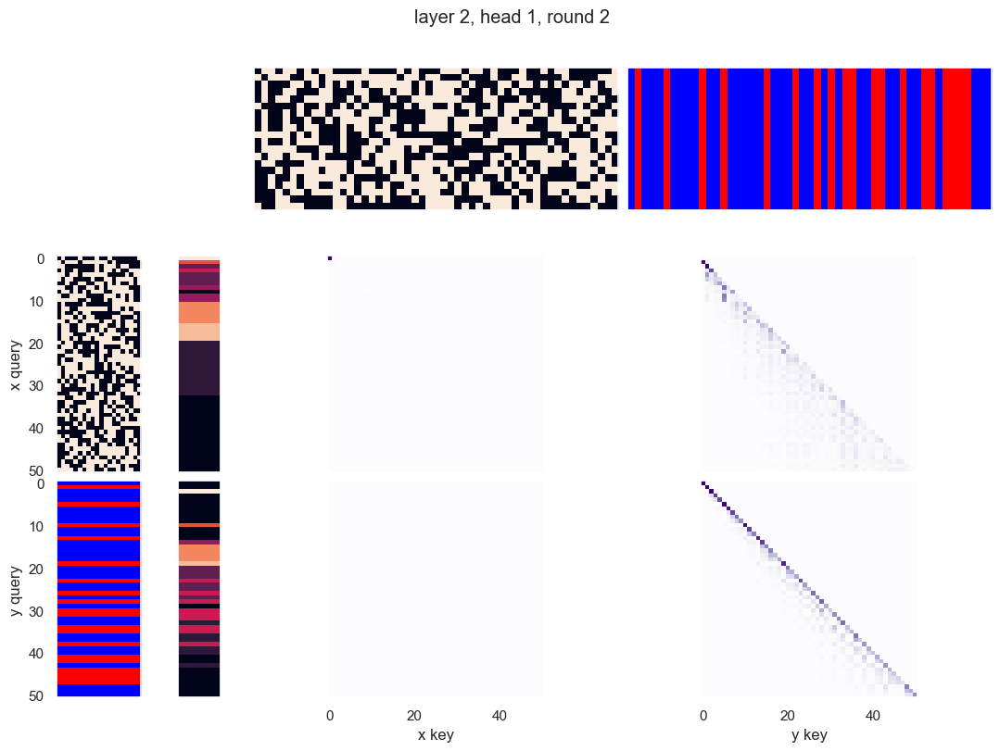

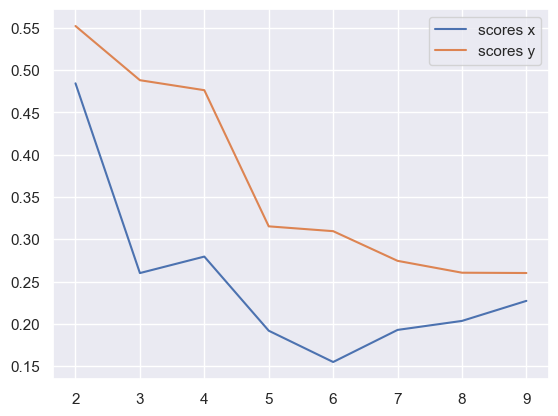

x query cluster:
SVM coefs: [ 0.23397186 -0.38574605 -0.54104615 -0.40235204 -0.01581193  0.48934344
  0.34911994 -0.02374276  0.41956452  0.57362654  0.24446666  0.13738443
 -0.1546776  -0.27130979  0.32257186 -0.17425711 -0.11137367 -0.61566815
  0.6367712   0.1419667 ]
class1: [ 3  5  6  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.73; (2) -18: 0.64; (3) -16: 0.64; (4) +10: 0.62; (5) +5: 0.60; (6) +6: 0.60; (7) -11: 0.60; (8) -12: 0.60; (9) +2: 0.60; (10) -3: 0.58
(1) +2 AND -18: 0.53; (2) +6 AND +17: 0.51; (3) -3 AND -18: 0.49; (4) +17 AND -18: 0.49; (5) -0 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) -3 AND -16: 0.47; (8) +5 AND +17: 0.47; (9) +13 AND -18: 0.47; (10) -12 AND -18: 0.44
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -9 OR +17: 0.93; (7) +5 OR +8: 0.93; (8) -3 OR -11: 0.93; (9) -2 OR -18: 0.93; (10) -16 OR +17: 0

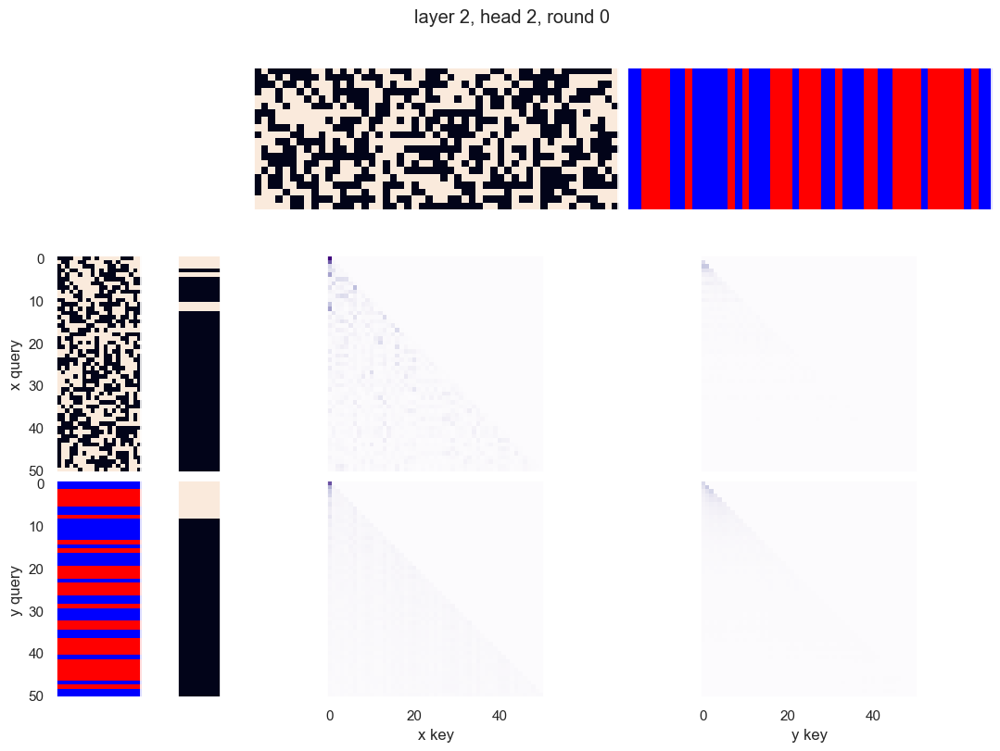

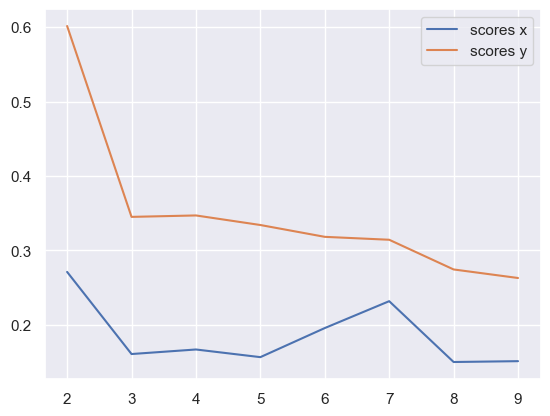

x query cluster:
SVM coefs: [ 0.07893905 -0.24693409  0.37721991  0.0302538   0.29400984 -0.10661429
  0.27434167 -0.24910301  0.21765794  0.15686386 -0.33840448 -0.00104933
 -0.23636259  0.12430133 -0.05231147 -0.32736131 -0.16020427 -0.09230232
  0.8113735   0.08791105]
class1: [ 5  8 13 15 16 17 18 20 21 22 24 25 28 29 30 31 32 33 34 35 36 37 38 40
 41 42 44 45 46 47 48 49 50]
(1) +9: 0.70; (2) +14: 0.70; (3) +0: 0.67; (4) -8: 0.67; (5) +13: 0.64; (6) -16: 0.61; (7) -11: 0.61; (8) +5: 0.61; (9) -18: 0.58; (10) +17: 0.58
(1) +0 AND +9: 0.58; (2) +9 AND +13: 0.48; (3) +0 AND +14: 0.45; (4) +5 AND -16: 0.45; (5) +9 AND +14: 0.45; (6) +9 AND -16: 0.45; (7) +0 AND -11: 0.45; (8) -8 AND +13: 0.45; (9) +7 AND +9: 0.45; (10) -10 AND +14: 0.42
(1) -8 OR +9: 0.97; (2) +0 OR -8: 0.97; (3) -8 OR +14: 0.94; (4) +14 OR +17: 0.94; (5) +5 OR +9: 0.94; (6) +9 OR +14: 0.94; (7) +9 OR +17: 0.94; (8) +0 OR +17: 0.94; (9) -8 OR -16: 0.91; (10) +13 OR +17: 0.91
{0.0: 0.11987506705653762}
class2: [ 0  1  

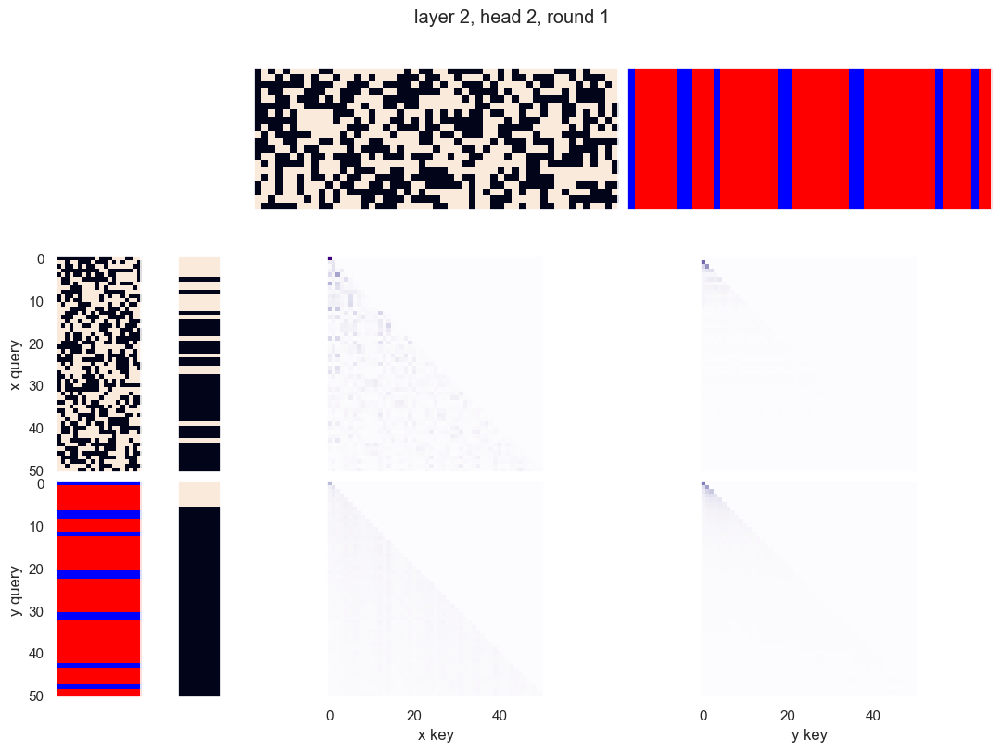

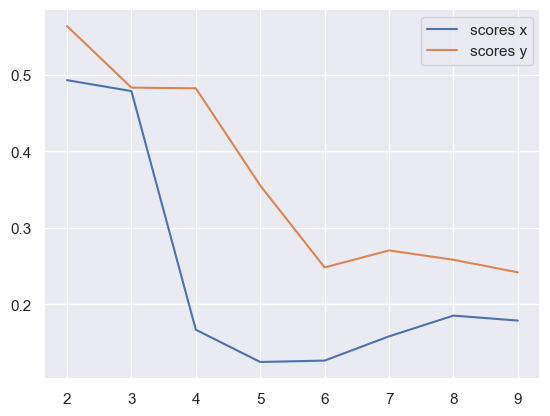

x query cluster:
SVM coefs: [-0.46865204 -0.57677744  0.27721334  0.2122629  -0.11847966 -0.05889824
  0.00723984 -0.45952406  0.42597159  0.43341126 -0.08996027  0.23647113
 -0.24495577 -0.49575323 -0.29612509  0.17306128  0.11536848 -0.67924158
  0.21284321  0.87186942]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.8

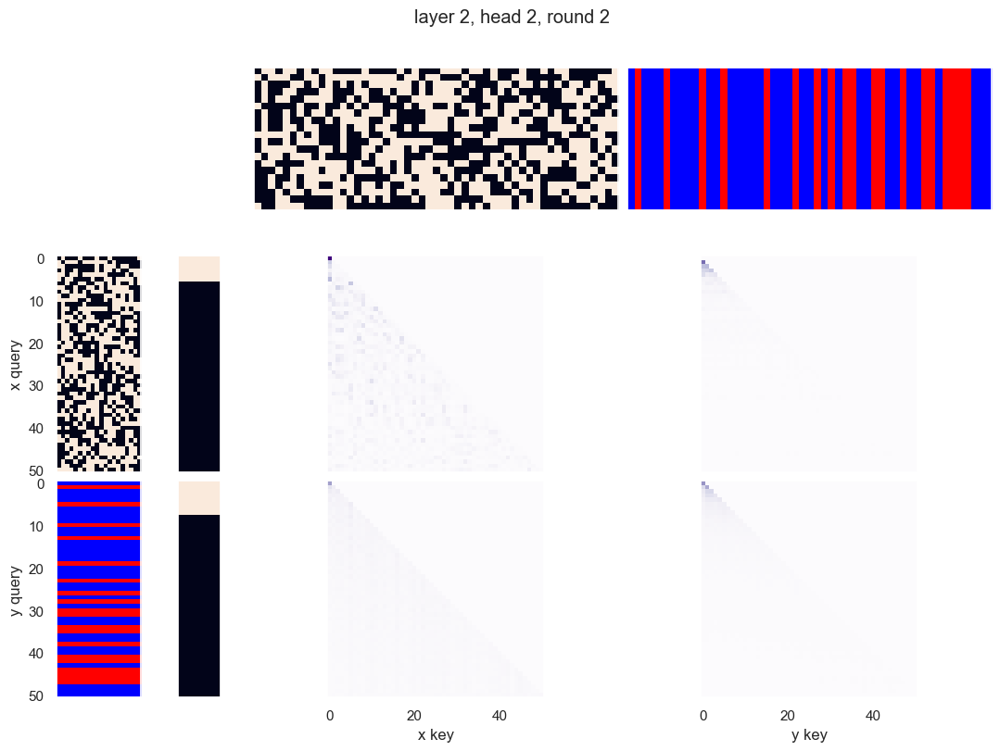

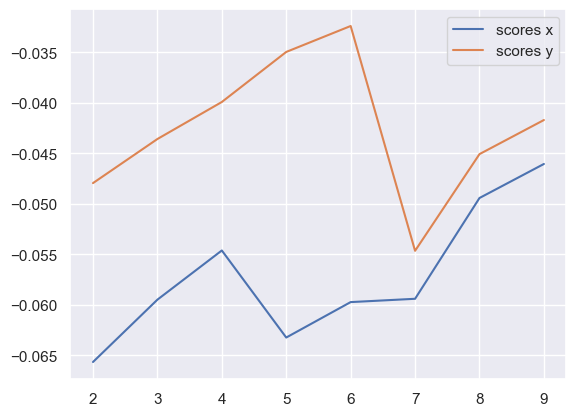

x query cluster:
SVM coefs for class 0: [-0.86716757 -0.12463297 -0.09329291  0.18555524 -0.42201048 -0.68128223
 -0.83792049 -0.14043805 -0.1350642   0.41660839 -0.48413702  0.75908149
  0.3855234  -0.02158279  0.34923764 -0.5131269   0.27533612  0.03389498
  0.40599004  0.05228499]\class elements: [41 42 43 44 45]
(1) -0: 0.80; (2) -15: 0.80; (3) +5: 0.80; (4) +19: 0.80; (5) +10: 0.60; (6) -11: 0.60; (7) +13: 0.60; (8) +14: 0.60; (9) -9: 0.60; (10) -16: 0.60
(1) +13 AND -18: 0.60; (2) +5 AND -18: 0.60; (3) -9 AND -15: 0.60; (4) -15 AND +19: 0.60; (5) +5 AND -15: 0.60; (6) +13 AND +19: 0.60; (7) -0 AND -11: 0.60; (8) -3 AND +13: 0.60; (9) -3 AND +5: 0.60; (10) -1 AND +19: 0.60
(1) -0 OR -1: 1.00; (2) +4 OR +5: 1.00; (3) -4 OR -15: 1.00; (4) -4 OR -16: 1.00; (5) -4 OR -17: 1.00; (6) -4 OR +19: 1.00; (7) +5 OR -6: 1.00; (8) +5 OR -7: 1.00; (9) +5 OR +8: 1.00; (10) +5 OR +9: 1.00
{7.0: 0.12991046589540706, 11.0: 0.3415918240431371, 8.0: 0.04592699904048823, 13.0: 0.11378798644662166, 12.

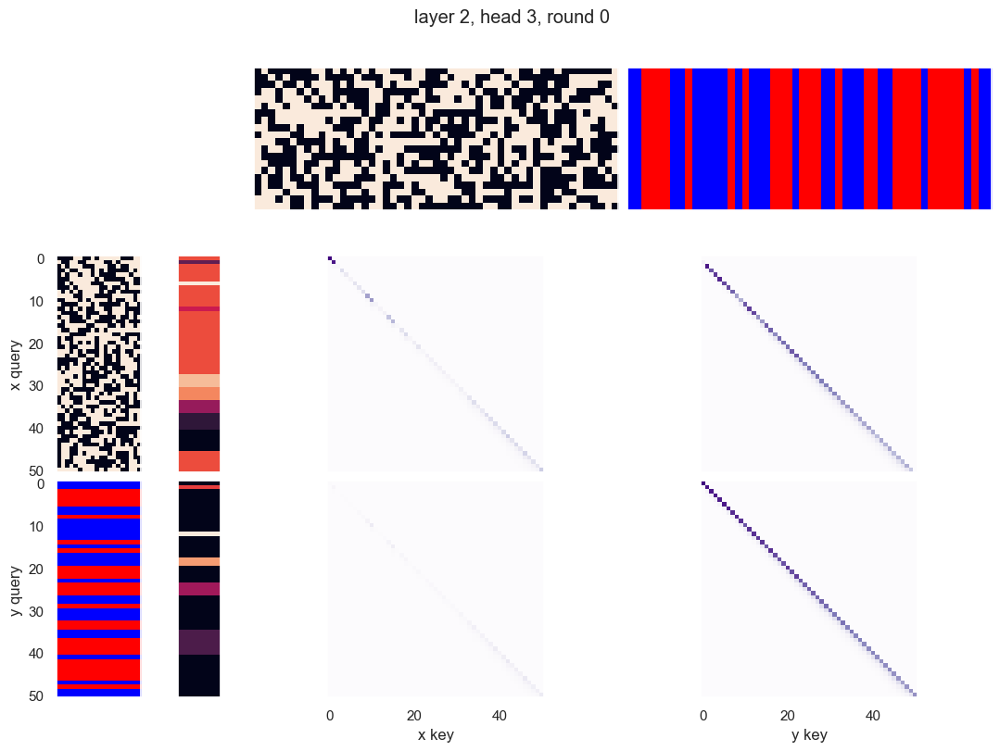

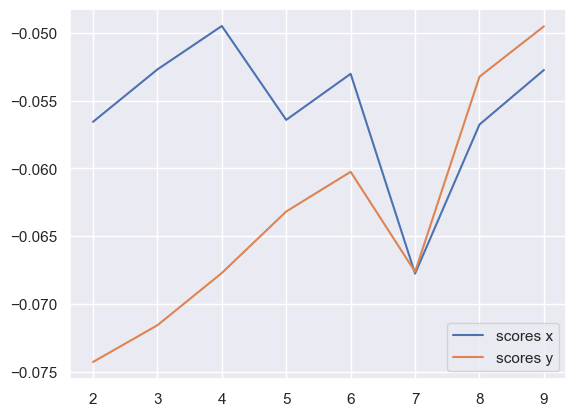

x query cluster:
SVM coefs for class 0: [ 0.49100258  0.46319924  0.32229457  0.19766999  0.96659189  0.88412722
  0.10693934  0.01407654  0.14265938 -0.08320695 -0.14297674 -0.10788832
  0.10388893 -0.24910299 -0.00997466  0.36805973 -0.25376328  0.1091214
 -0.47351038 -0.58994741]\class elements: [ 0  1  2  3  4  5  6  7  8  9 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 42 43 44 45 46 47 48 49 50]
(1) +14: 0.70; (2) -3: 0.63; (3) +0: 0.60; (4) +13: 0.60; (5) +19: 0.58; (6) -2: 0.58; (7) -12: 0.58; (8) -18: 0.56; (9) +1: 0.56; (10) +17: 0.53
(1) -3 AND +19: 0.44; (2) -3 AND +14: 0.44; (3) +13 AND +14: 0.42; (4) +14 AND +19: 0.42; (5) -3 AND +13: 0.42; (6) +1 AND +14: 0.42; (7) +13 AND -18: 0.42; (8) -2 AND +14: 0.40; (9) +14 AND +16: 0.40; (10) -12 AND +19: 0.40
(1) +0 OR +14: 0.93; (2) +14 OR -16: 0.93; (3) +14 OR -18: 0.91; (4) +13 OR +14: 0.88; (5) -12 OR +13: 0.88; (6) -12 OR +14: 0.88; (7) +1 OR -3: 0.88; (8) -2 OR +14: 0.88; (9) -2 OR +13: 0.88; (10)

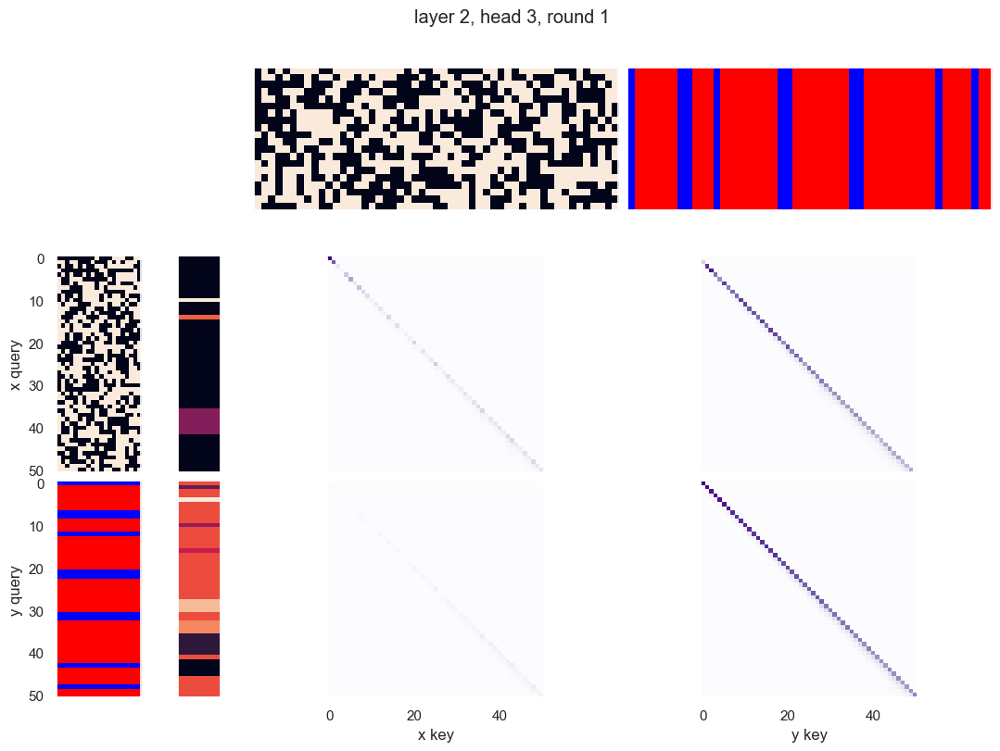

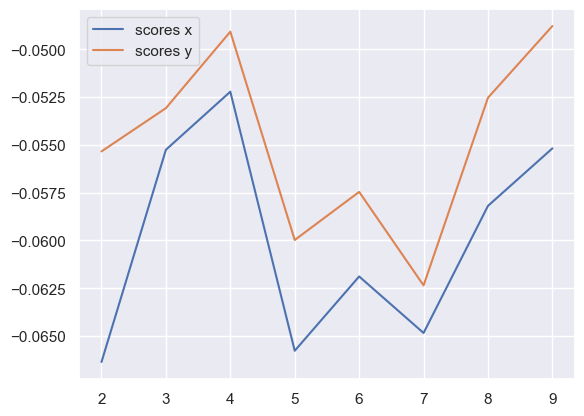

x query cluster:
SVM coefs for class 0: [-1.25803989e-01  8.56787654e-01  2.22727380e-01 -2.43815834e-01
  7.71292080e-01  3.15870196e-01  1.52233126e-01  8.61577350e-02
  3.35843255e-01 -3.00134480e-01 -1.02846641e-02  1.92217615e-01
 -7.77326283e-02 -8.21522945e-02 -7.12803990e-02 -1.31856393e-04
 -1.27592524e-02  3.94824807e-01  3.35774468e-01 -6.18180811e-01]\class elements: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 42 43 44 45 46 47 48 49 50]
(1) +17: 0.67; (2) +16: 0.67; (3) -19: 0.62; (4) -5: 0.62; (5) +14: 0.60; (6) +1: 0.60; (7) +13: 0.57; (8) -9: 0.57; (9) -0: 0.57; (10) -18: 0.57
(1) +16 AND +17: 0.48; (2) -5 AND +16: 0.48; (3) +17 AND -19: 0.48; (4) +16 AND -19: 0.45; (5) -9 AND +17: 0.45; (6) +8 AND +16: 0.45; (7) +1 AND +16: 0.43; (8) -0 AND +17: 0.43; (9) +2 AND +17: 0.43; (10) -18 AND -19: 0.43
(1) +1 OR +17: 0.93; (2) +12 OR +16: 0.93; (3) +14 OR -18: 0.90; (4) +1 OR +2: 0.90; (5) -8 OR +16: 0.90; (6) +2 OR -5:

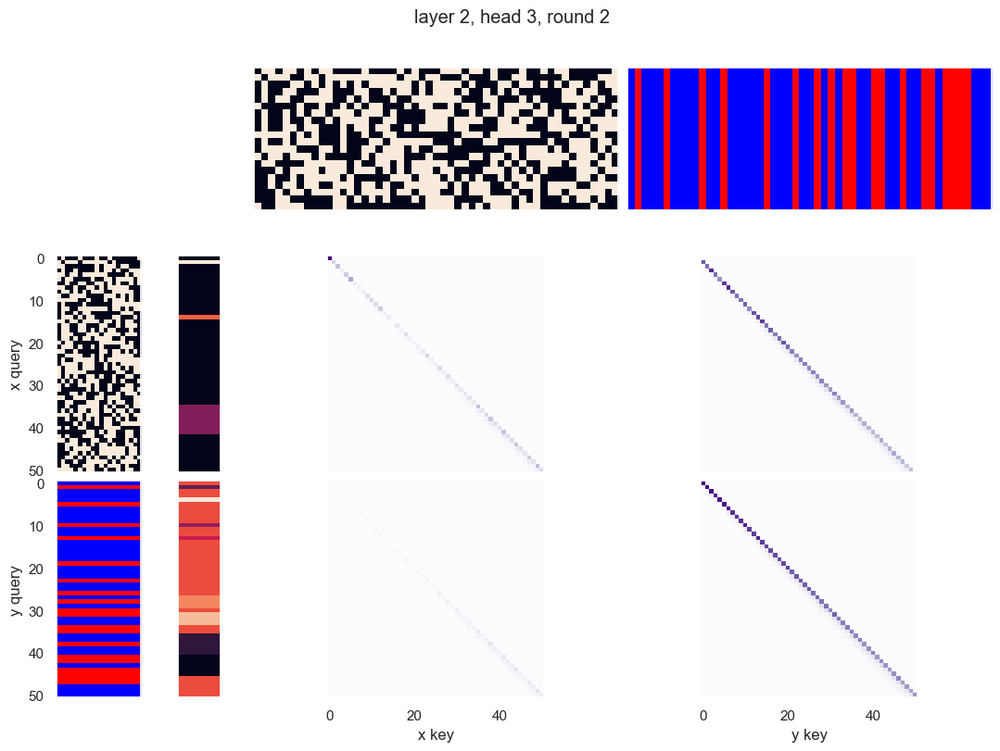

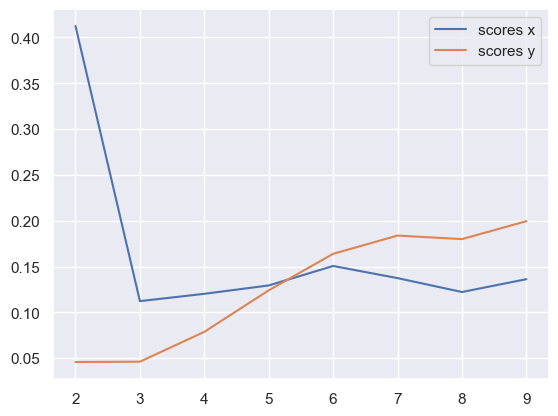

x query cluster:
SVM coefs: [ 0.05179906 -0.75413592 -0.36880724 -0.35666977 -0.18128338  0.21230739
  0.33665247 -0.02494321  0.23931925  0.7195226  -0.00758698  0.20395809
 -0.26648478 -0.68179436  0.08793458 -0.07912029 -0.68339069 -0.59041752
  0.71773644  0.33485536]
class1: [ 5  6  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -18: 0.65; (3) +10: 0.65; (4) -16: 0.63; (5) -12: 0.60; (6) -11: 0.60; (7) +2: 0.60; (8) +13: 0.60; (9) -3: 0.58; (10) -9: 0.58
(1) +2 AND -18: 0.53; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.49; (4) +13 AND -18: 0.49; (5) +17 AND -18: 0.49; (6) -3 AND -16: 0.47; (7) -11 AND +17: 0.47; (8) +13 AND +17: 0.47; (9) -0 AND +17: 0.47; (10) -12 AND +17: 0.44
(1) -11 OR -18: 0.95; (2) -11 OR -16: 0.95; (3) -2 OR -18: 0.93; (4) -9 OR +17: 0.93; (5) +5 OR +8: 0.93; (6) -3 OR -11: 0.93; (7) +17 OR -19: 0.93; (8) -12 OR -16: 0.93; (9) -16 OR +17: 0.93; (10) +10 OR +17: 0.93


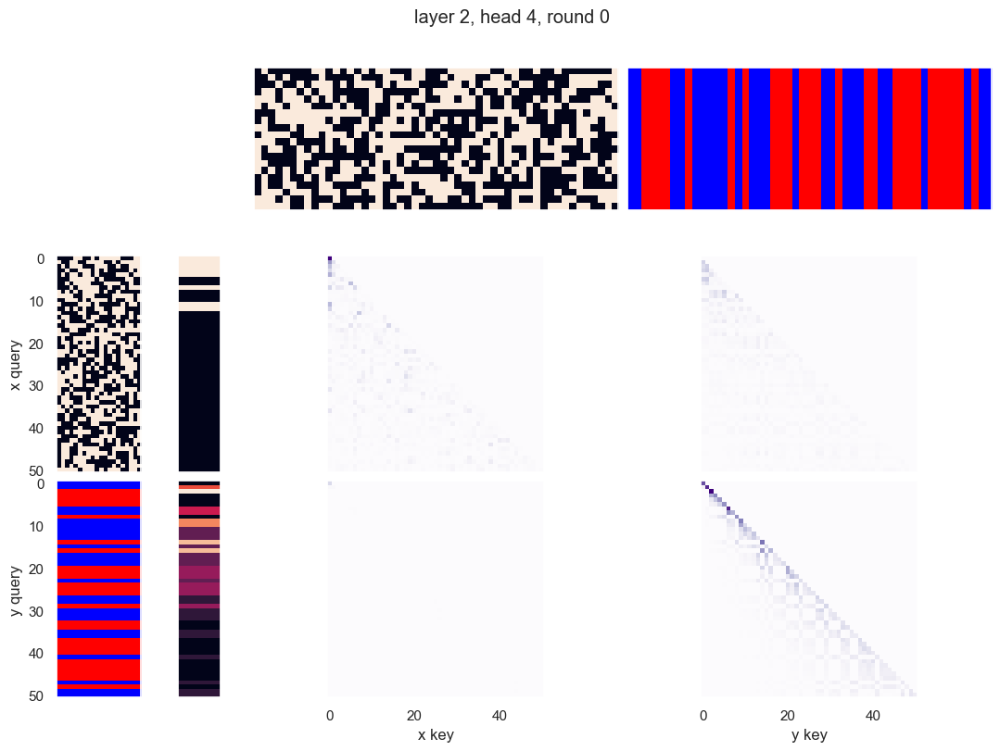

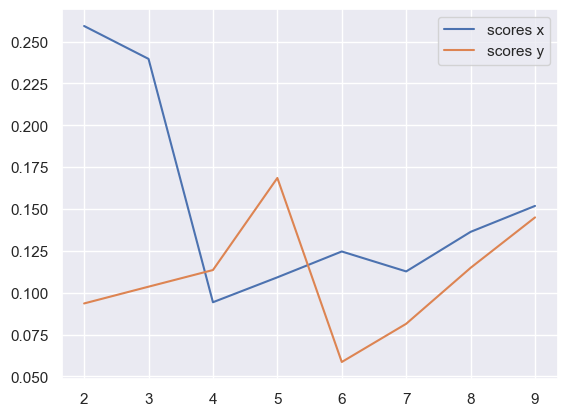

x query cluster:
SVM coefs: [-0.15301898 -0.20624441  0.45941247  0.30864649  0.52891328 -0.05738414
  0.27876906 -0.20733211  0.34020798  0.04746931 -0.37728798  0.09126574
 -0.25315423  0.32745877 -0.03854601 -0.06079938  0.15821101 -0.15659853
  0.54837137 -0.47053643]
class1: [ 2  3  5  7  8 13 14 15 16 17 18 20 21 22 24 25 28 29 30 31 32 33 34 35
 36 37 38 39 40 41 42 44 45 46 47 48 49 50]
(1) +0: 0.68; (2) +14: 0.66; (3) -8: 0.66; (4) +9: 0.63; (5) -3: 0.63; (6) +13: 0.61; (7) +17: 0.58; (8) -16: 0.58; (9) -11: 0.58; (10) +5: 0.58
(1) +0 AND +9: 0.50; (2) +9 AND +13: 0.45; (3) -3 AND +19: 0.45; (4) +0 AND -3: 0.45; (5) +9 AND +14: 0.42; (6) -3 AND +14: 0.42; (7) -11 AND +14: 0.42; (8) +0 AND -12: 0.42; (9) -3 AND +13: 0.42; (10) +0 AND -16: 0.42
(1) +0 OR -8: 0.97; (2) +0 OR +17: 0.95; (3) -1 OR +14: 0.92; (4) -8 OR +14: 0.92; (5) +6 OR -8: 0.92; (6) -8 OR +9: 0.92; (7) +0 OR +14: 0.92; (8) -11 OR +19: 0.89; (9) -7 OR +9: 0.89; (10) +7 OR -8: 0.89
{0.0: 0.43214410659857094}
class

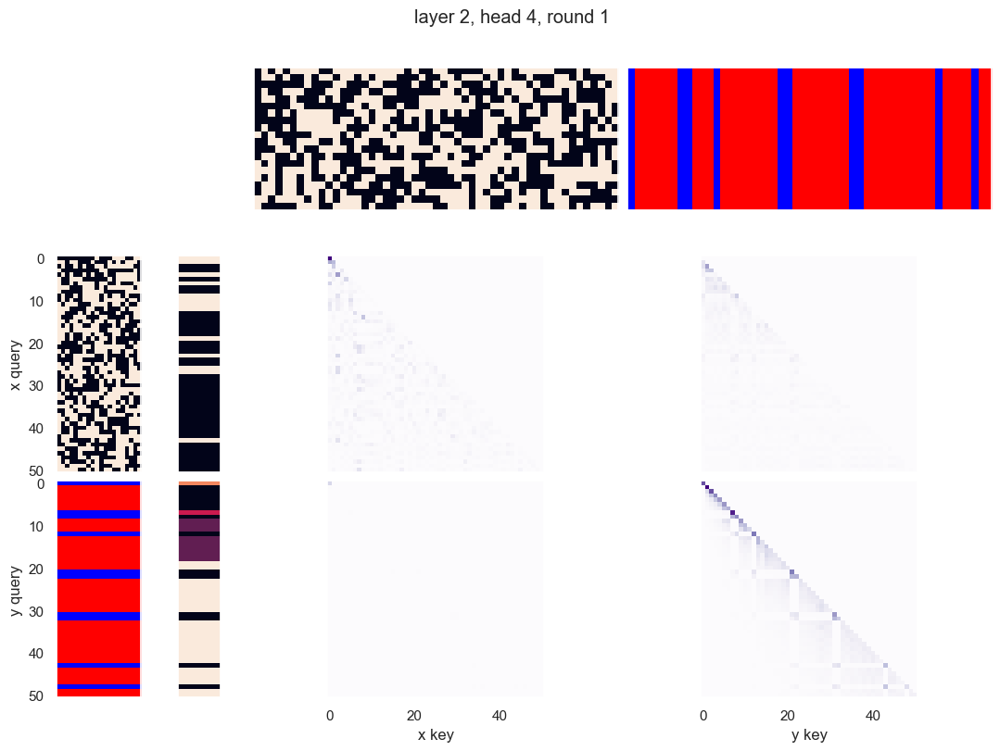

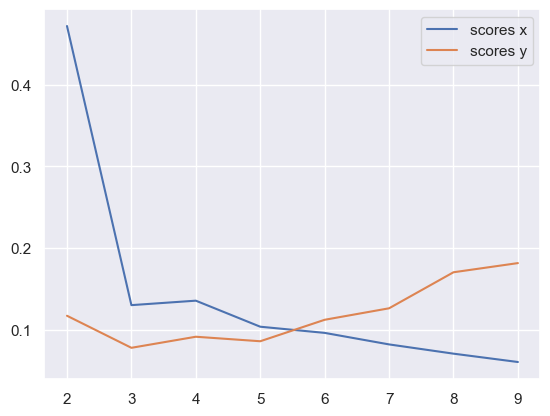

x query cluster:
SVM coefs: [-0.46865611 -0.57677948  0.27720897  0.21226714 -0.11848098 -0.05889437
  0.00723856 -0.4595188   0.4259723   0.43341162 -0.08995863  0.2364721
 -0.24495456 -0.49575503 -0.296128    0.17306084  0.11536741 -0.67924064
  0.21284258  0.87186674]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.89

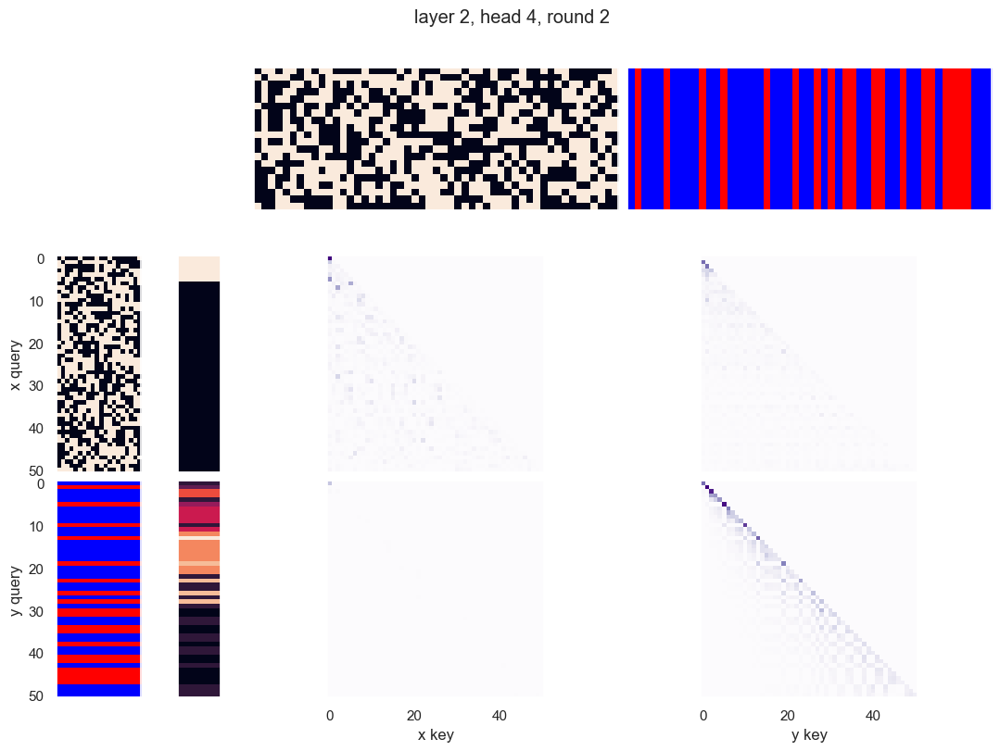

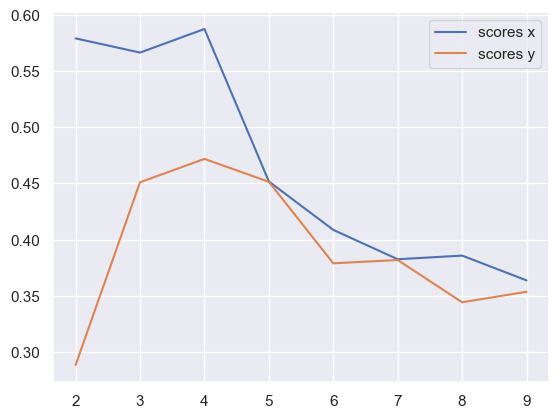

x query cluster:
SVM coefs for class 0: [ 0.28794579  0.47314228 -1.028742   -0.38310888 -0.32285624 -0.25921186
 -0.01951977 -0.0016863  -0.6796407  -0.2714915   0.32584257 -0.59225551
 -0.27769889  0.56682721 -0.12307419  0.05074139 -0.26542444  0.64575572
 -0.50792715 -0.61018673]\class elements: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.66; (3) +10: 0.64; (4) -11: 0.64; (5) -18: 0.61; (6) -12: 0.61; (7) +2: 0.59; (8) -3: 0.59; (9) +13: 0.59; (10) +6: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.48; (3) -11 AND +17: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -16: 0.48; (6) -3 AND -18: 0.48; (7) +6 AND -16: 0.45; (8) -0 AND +17: 0.43; (9) -12 AND +17: 0.43; (10) -12 AND -18: 0.43
(1) -11 OR -16: 0.95; (2) -11 OR -18: 0.95; (3) +10 OR -11: 0.93; (4) +17 OR -19: 0.93; (5) -2 OR -18: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) -3 OR -11: 0.9

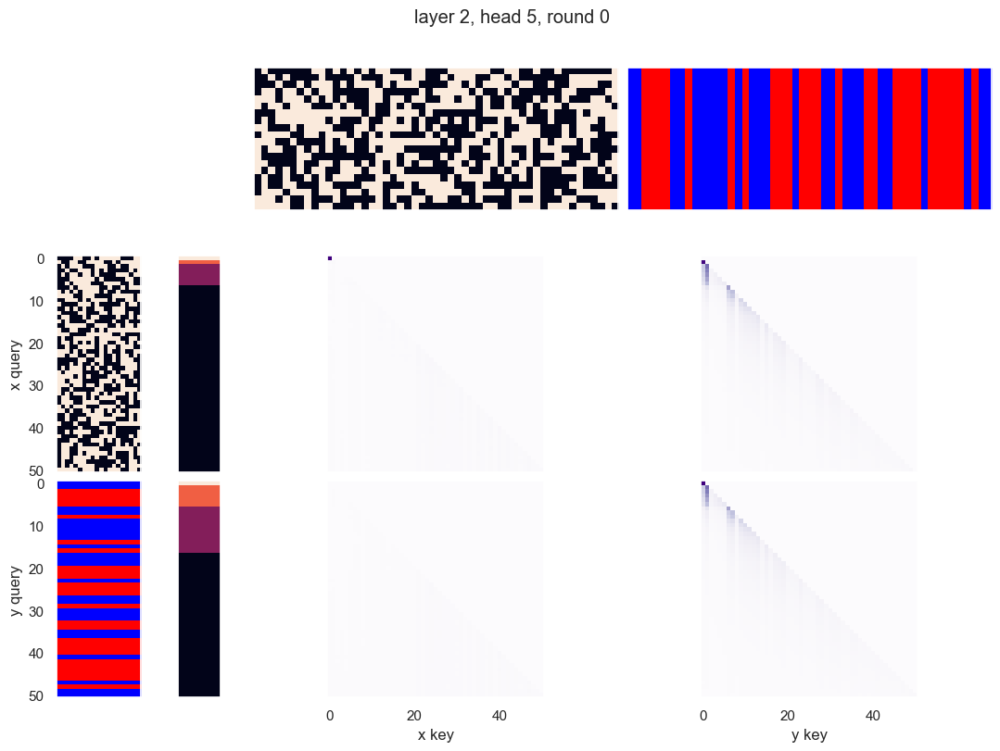

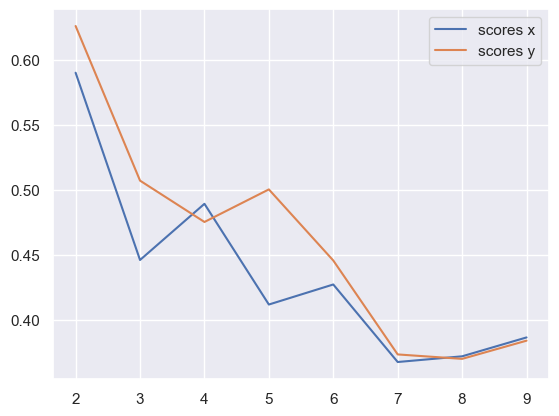

x query cluster:
SVM coefs: [-0.1506512  -0.27793025  1.09860807  0.17014083  0.36166563  0.33775885
 -0.01594442  0.31648634  0.64442344  0.32146225 -0.05036051  0.37116963
  0.10660588 -0.5884382   0.02284082 -0.0596868   0.56934619 -0.53948895
  0.45949769  0.57550199]
class1: [ 0  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.64; (2) +13: 0.64; (3) +19: 0.62; (4) +0: 0.62; (5) -16: 0.60; (6) -12: 0.60; (7) +9: 0.60; (8) -3: 0.60; (9) -4: 0.56; (10) +6: 0.56
(1) -3 AND +19: 0.47; (2) +13 AND +14: 0.44; (3) +0 AND +9: 0.44; (4) +9 AND +13: 0.44; (5) -12 AND +19: 0.42; (6) +9 AND +14: 0.42; (7) +0 AND +13: 0.40; (8) +5 AND -16: 0.40; (9) +13 AND -16: 0.40; (10) +0 AND -16: 0.40
(1) +13 OR +19: 0.93; (2) -12 OR +13: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +14 OR +19: 0.89; (6) -18 OR +19: 0.89; (7) +6 OR -16: 0.89; (8) +14 OR -15: 0.89; (9) +9 OR -12: 0.89; (10) +14 OR -16: 0.

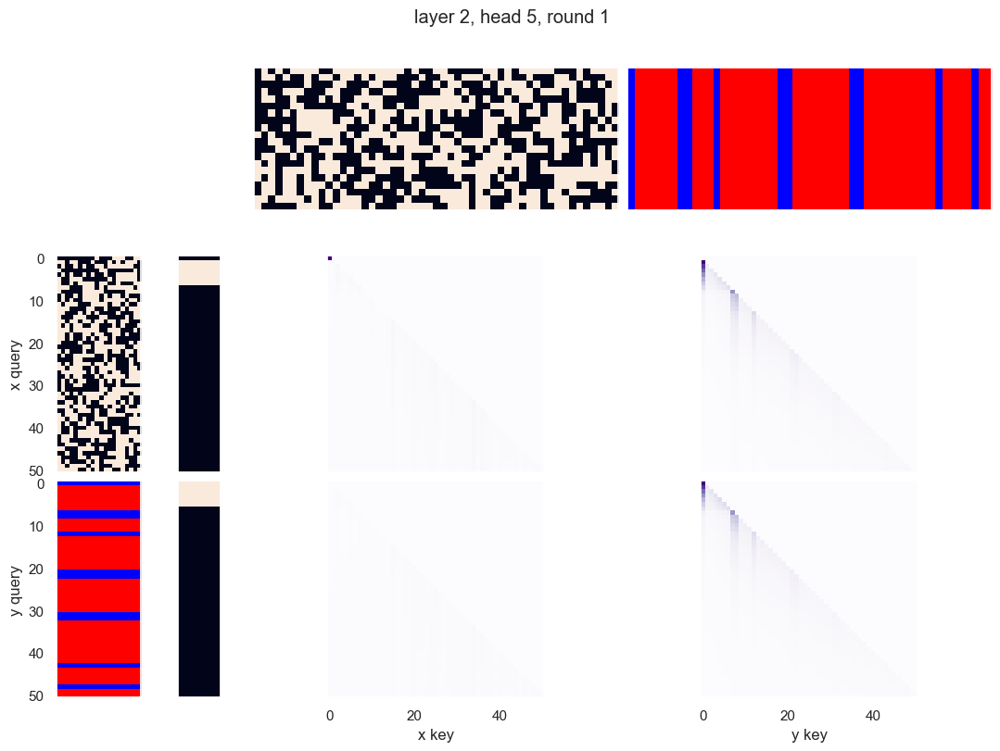

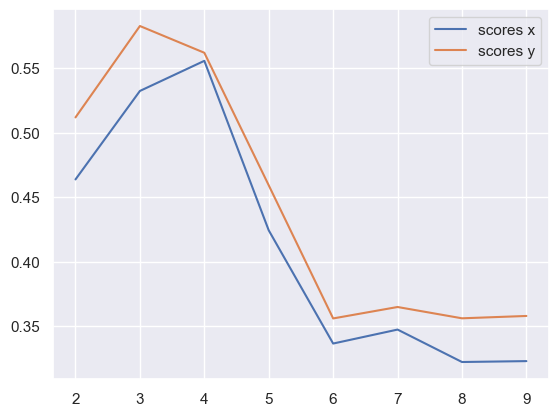

x query cluster:
SVM coefs for class 0: [ 2.32155038e-01  4.20212879e-01 -7.42616542e-01 -4.45010979e-01
 -2.98548029e-01 -3.58291720e-01 -1.10683091e-01 -1.84917542e-01
 -8.03327440e-01 -1.45552369e-01  4.82856658e-01 -6.11613721e-01
 -2.99704982e-01  6.64189578e-01  3.04171002e-02  2.90162902e-05
  1.14826756e-01  5.54173773e-01 -5.13596131e-01 -6.00331514e-01]\class elements: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.65; (3) +17: 0.65; (4) +13: 0.63; (5) +2: 0.63; (6) -0: 0.63; (7) +8: 0.58; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.51; (2) +16 AND +17: 0.49; (3) -9 AND -19: 0.47; (4) +7 AND +16: 0.44; (5) -0 AND +16: 0.44; (6) -9 AND +17: 0.44; (7) -0 AND +17: 0.44; (8) -9 AND +13: 0.44; (9) +8 AND +16: 0.44; (10) -18 AND -19: 0.44
(1) -10 OR -19: 0.93; (2) +14 OR +16: 0.91; (3) -0 OR -10: 0.91; (4) +7 OR -19: 0.91; (5) +15 OR +16: 0.91; (6) +18 OR 

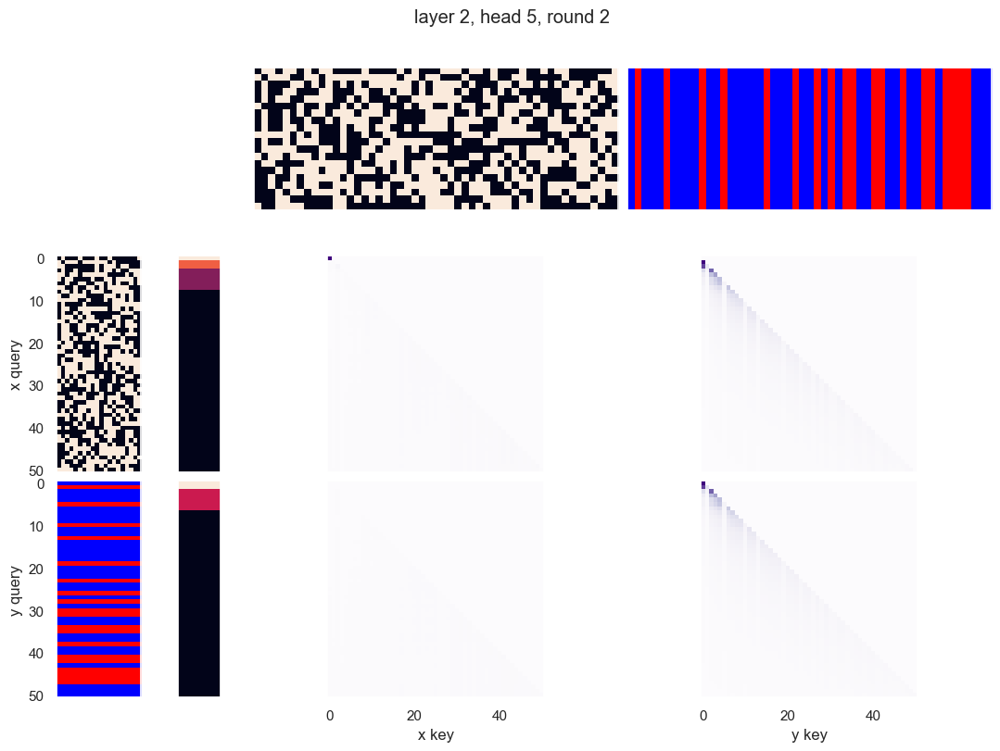

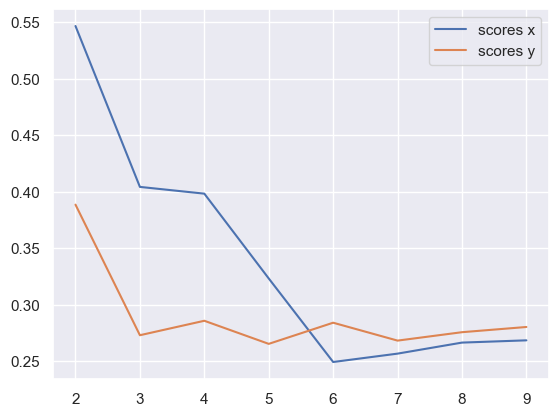

x query cluster:
SVM coefs: [-0.13913174 -0.43622472  1.04112178  0.4776199   0.29654959  0.33509856
  0.16730826  0.17748622  0.91070003 -0.00198647 -0.63131192  0.49040608
  0.22351884 -0.68877877 -0.0757844   0.03261816 -0.06575561 -0.52205493
  0.68958803  0.6861472 ]
class1: [ 8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.69; (2) -16: 0.67; (3) +10: 0.67; (4) -11: 0.62; (5) -18: 0.62; (6) -12: 0.62; (7) -3: 0.62; (8) +2: 0.60; (9) +13: 0.60; (10) -19: 0.57
(1) +2 AND -18: 0.52; (2) -3 AND -18: 0.50; (3) -3 AND -16: 0.50; (4) +13 AND -18: 0.48; (5) +6 AND -16: 0.45; (6) +6 AND +17: 0.45; (7) -16 AND -18: 0.45; (8) -7 AND +10: 0.45; (9) -11 AND +17: 0.45; (10) +10 AND +17: 0.43
(1) -11 OR -18: 0.95; (2) -11 OR -16: 0.95; (3) +17 OR -19: 0.93; (4) -3 OR -11: 0.93; (5) +10 OR -11: 0.93; (6) +10 OR -12: 0.93; (7) -2 OR -18: 0.93; (8) +10 OR +17: 0.93; (9) -16 OR +17: 0.93; (10) -12 OR -16: 0.93


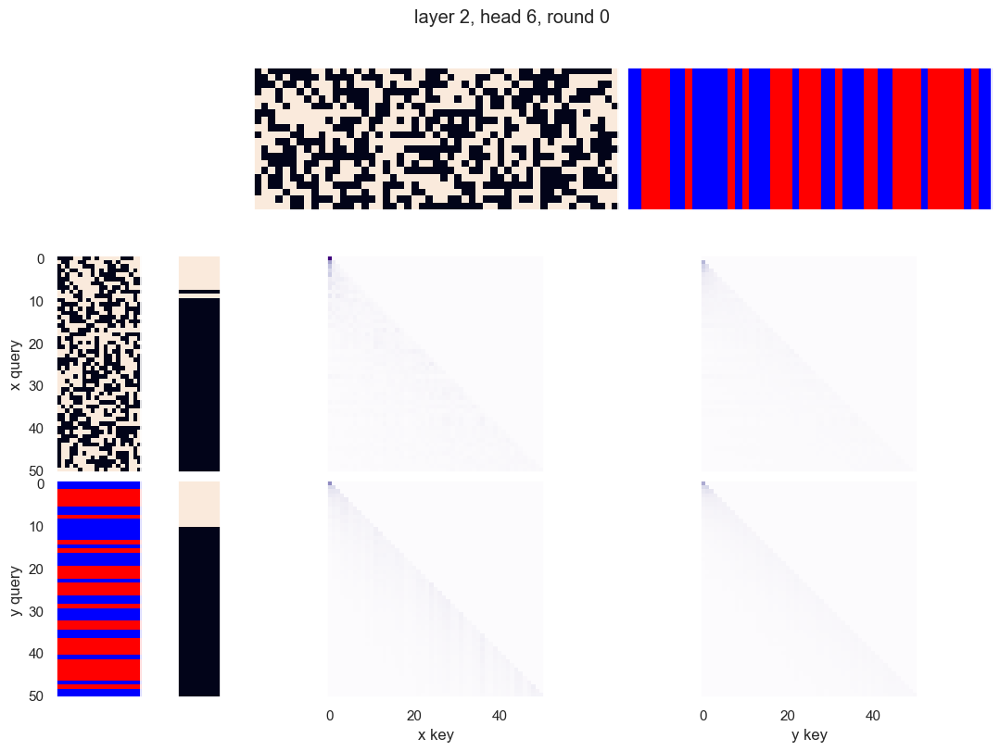

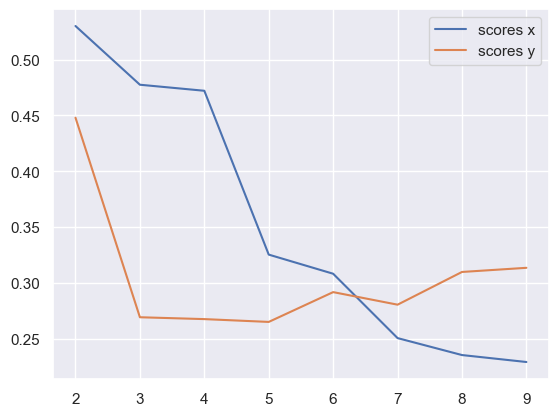

x query cluster:
SVM coefs: [ 0.1864063  -0.51159788  0.70710831  0.37003286  0.38306607  0.40484809
  0.38364981  0.51767948  0.90280137  0.00999886 -0.40022964  0.34730122
  0.18039808 -0.75015525  0.07032277 -0.44771195 -0.19461578 -0.76255568
  0.36405225  0.93667273]
class1: [10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33
 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.63; (2) -16: 0.63; (3) +14: 0.63; (4) +13: 0.63; (5) +19: 0.61; (6) -12: 0.59; (7) +5: 0.59; (8) +9: 0.59; (9) +11: 0.56; (10) -3: 0.56
(1) +0 AND +9: 0.46; (2) +5 AND -16: 0.44; (3) +9 AND +13: 0.44; (4) -3 AND +19: 0.44; (5) +0 AND -16: 0.44; (6) +0 AND -12: 0.41; (7) +0 AND +13: 0.41; (8) -12 AND +19: 0.41; (9) +11 AND +19: 0.41; (10) +13 AND -16: 0.41
(1) -16 OR +19: 0.93; (2) -12 OR +13: 0.93; (3) +13 OR +19: 0.93; (4) +0 OR +14: 0.90; (5) +9 OR -12: 0.90; (6) +0 OR +17: 0.90; (7) +14 OR -16: 0.90; (8) +5 OR +14: 0.88; (9) +0 OR -8: 0.88; (10) -8 OR -16: 0.88
{0.0: 0.4204

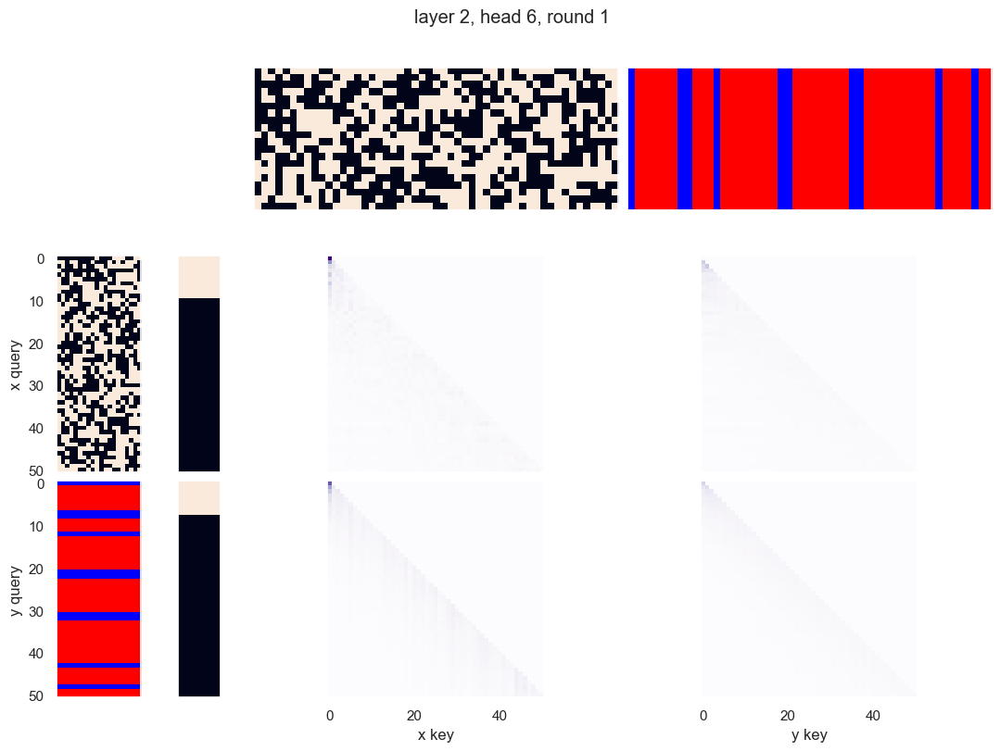

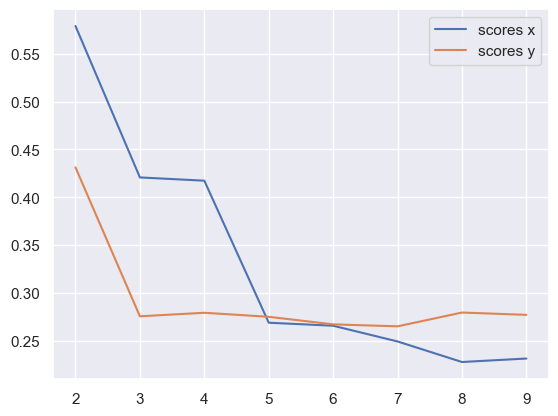

x query cluster:
SVM coefs: [-0.46865748 -0.57677521  0.27721004  0.21226337 -0.11847754 -0.05889408
  0.00723672 -0.45951936  0.42596876  0.43341333 -0.08995861  0.23646843
 -0.24495417 -0.49575211 -0.29612443  0.1730591   0.11536455 -0.67924419
  0.212843    0.87186939]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.8

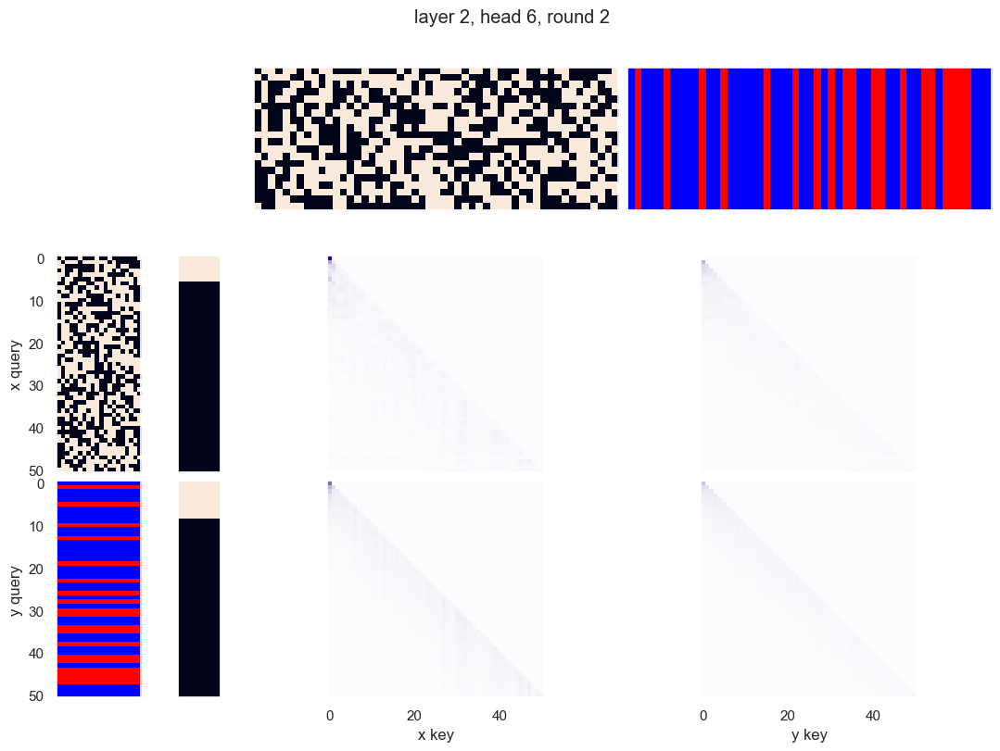

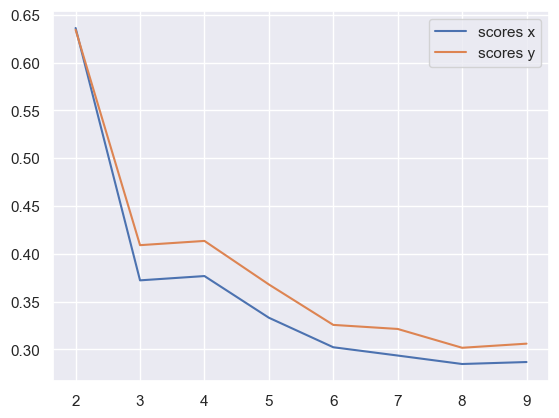

x query cluster:
SVM coefs: [ 0.25510214 -0.45922098  0.27299555  0.17551611 -0.21552138 -0.11985214
  0.07025494 -0.09279238  0.10831894  0.4903589  -0.00371264  0.20237691
 -0.11104839  0.23138386  0.04469343 -0.29457857 -0.46677542 -0.52135332
  0.57332165  0.62859092]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR

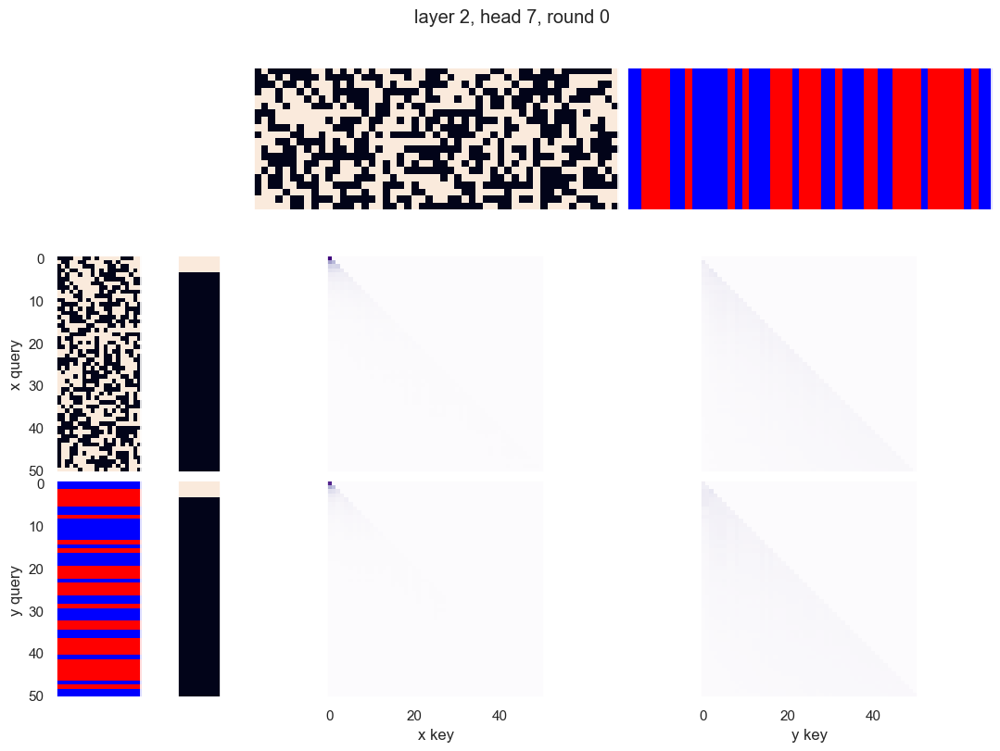

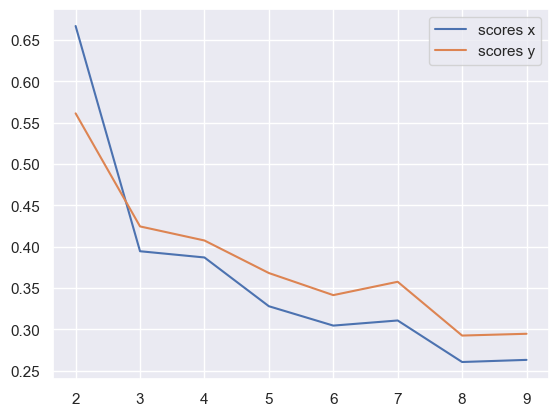

x query cluster:
SVM coefs: [ 0.26248076 -0.32280285  0.10229443  0.14784704 -0.20820342 -0.04183693
 -0.08340317 -0.00503826  0.46534712  0.28237166  0.02750088  0.2601543
  0.04959017  0.13378439  0.13217248 -0.16052956 -0.24771999 -0.57431814
  0.37580229  0.6895301 ]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) -12: 0.60; (4) +19: 0.58; (5) -16: 0.58; (6) +13: 0.58; (7) -2: 0.56; (8) -3: 0.56; (9) -4: 0.56; (10) +11: 0.56
(1) +0 AND -16: 0.42; (2) -3 AND +19: 0.42; (3) +0 AND -12: 0.42; (4) +0 AND +9: 0.42; (5) -2 AND -12: 0.42; (6) -12 AND -15: 0.42; (7) +0 AND -15: 0.40; (8) +9 AND +13: 0.40; (9) +5 AND -16: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.92; (2) +0 OR +14: 0.92; (3) +0 OR +11: 0.90; (4) +0 OR +17: 0.90; (5) +14 OR -15: 0.90; (6) +14 OR -16: 0.90; (7) +13 OR +19: 0.88; (8) +14 OR +19: 0.88; (9) +7 OR -12: 0.88; (10) +14 OR 

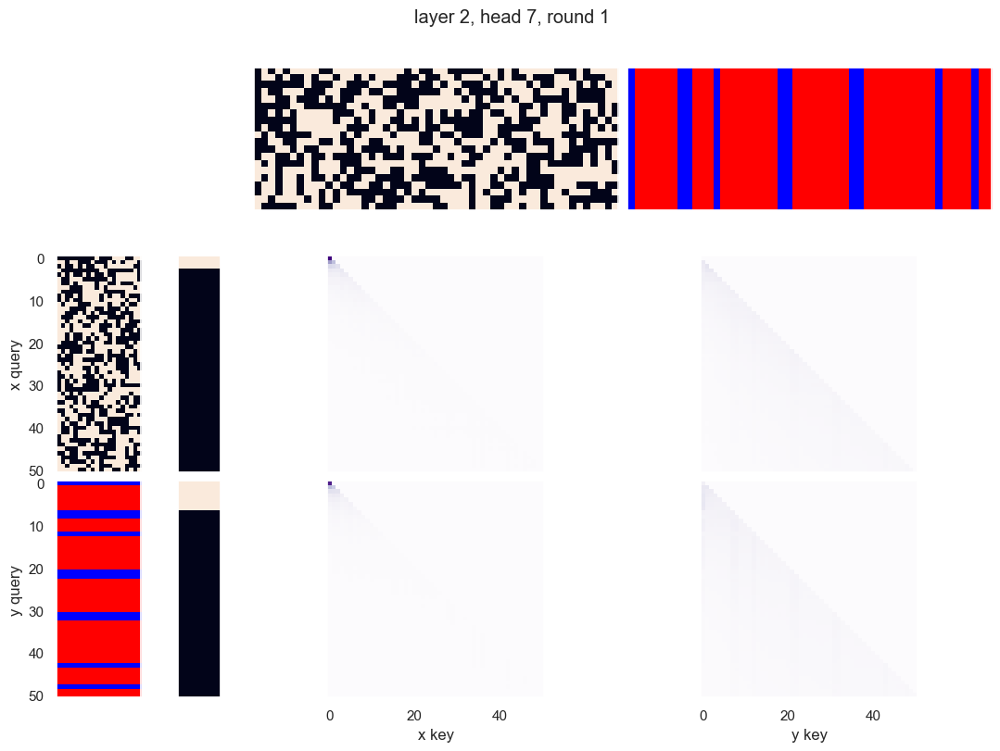

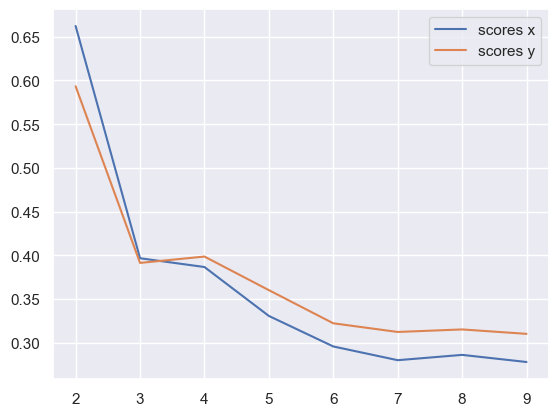

x query cluster:
SVM coefs: [ 0.26248422 -0.32281097  0.10228673  0.14780978 -0.20820463 -0.0418443
 -0.08338559 -0.00502007  0.46534169  0.28237522  0.02752922  0.26013888
  0.04955336  0.13377542  0.1321848  -0.1605301  -0.24772756 -0.57431855
  0.37581351  0.68953088]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -0: 0.60; (4) -19: 0.60; (5) +14: 0.60; (6) +2: 0.60; (7) +8: 0.58; (8) +13: 0.58; (9) +6: 0.56; (10) -5: 0.56
(1) +8 AND +16: 0.46; (2) +16 AND +17: 0.46; (3) +17 AND -19: 0.46; (4) -5 AND +16: 0.44; (5) +7 AND +16: 0.44; (6) -9 AND -19: 0.44; (7) -0 AND +17: 0.44; (8) +8 AND +13: 0.42; (9) +17 AND -18: 0.42; (10) -18 AND -19: 0.42
(1) +12 OR +16: 0.92; (2) +14 OR +16: 0.92; (3) +2 OR -5: 0.90; (4) -10 OR -19: 0.90; (5) +7 OR +17: 0.90; (6) +2 OR +4: 0.90; (7) -0 OR -10: 0.88; (8) -8 OR +16: 0.88; (9) +5 OR +16: 0.88; (10) +18 OR -1

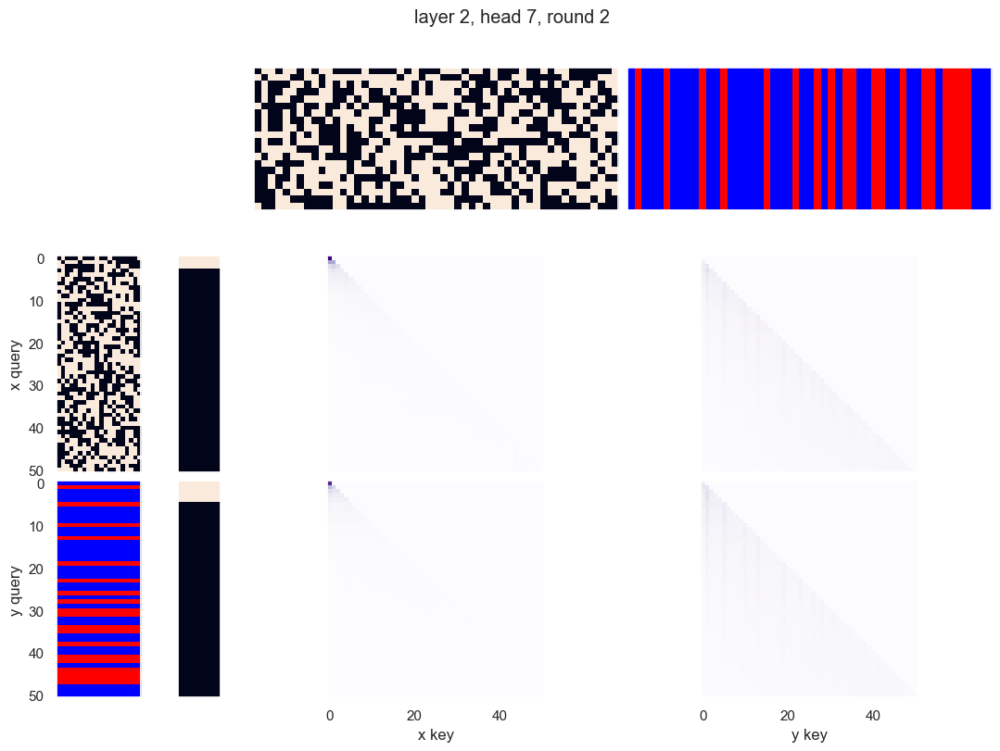

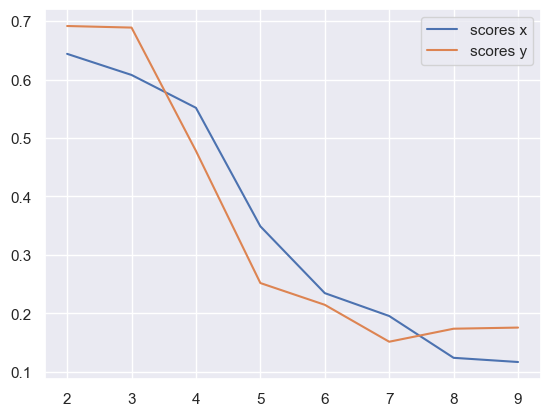

x query cluster:
SVM coefs: [-0.3799614  -0.69116761  0.34135401  0.40016074 -0.00206435 -0.03161997
 -0.08018182 -0.33012325  0.32761862  0.20366657 -0.01289323  0.11102882
 -0.17391335 -0.46095746 -0.10850499  0.08409004 -0.29188905 -0.3429559
  0.05579563  0.84831779]
class1: [ 4  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.65; (3) -11: 0.63; (4) -12: 0.61; (5) -18: 0.61; (6) +10: 0.61; (7) +6: 0.61; (8) +2: 0.59; (9) -3: 0.59; (10) +13: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.48; (3) +13 AND -18: 0.48; (4) -3 AND -16: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.46; (7) +6 AND -16: 0.46; (8) -0 AND +17: 0.43; (9) +13 AND +17: 0.43; (10) +17 AND -18: 0.43
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) -3 OR -11: 0.93; (4) -12 OR -16: 0.93; (5) -2 OR -18: 0.93; (6) +2 OR +18: 0.91; (7) +10 OR -11: 0.91; (8) +10 OR +17: 0.91; (9) +6 OR +10: 0.91; (10) +7 OR +10

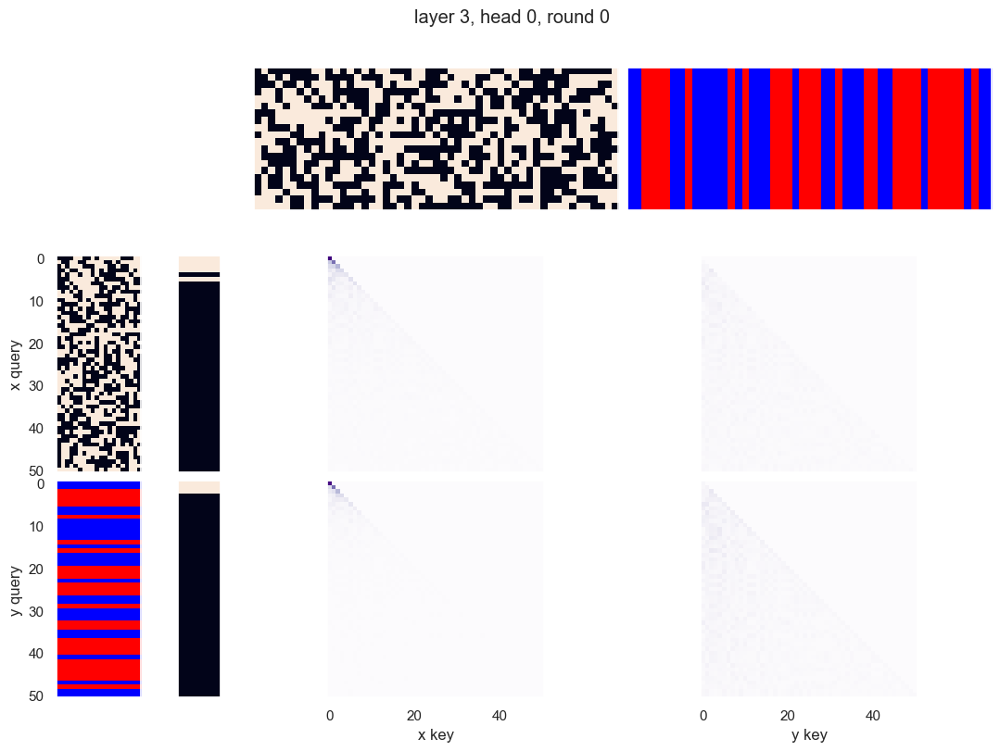

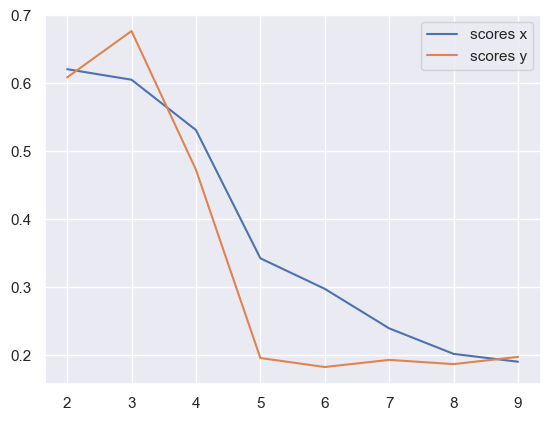

x query cluster:
SVM coefs: [-0.46865441 -0.57678048  0.27720808  0.21226662 -0.11848134 -0.05889036
  0.00723574 -0.45952043  0.42596707  0.43341361 -0.08995661  0.23647062
 -0.24495111 -0.4957543  -0.29613     0.17305953  0.11536863 -0.67923969
  0.21283871  0.87186806]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +19: 0.62; (4) +13: 0.62; (5) -16: 0.60; (6) -12: 0.60; (7) +6: 0.58; (8) +9: 0.58; (9) -3: 0.58; (10) -4: 0.56
(1) -3 AND +19: 0.44; (2) +0 AND +9: 0.44; (3) +0 AND -12: 0.42; (4) +13 AND +14: 0.42; (5) +5 AND -16: 0.42; (6) +9 AND +13: 0.42; (7) -12 AND +19: 0.42; (8) -12 AND -15: 0.42; (9) +0 AND -16: 0.42; (10) -2 AND -12: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +0 OR +11: 0.89; (6) +0 OR +17: 0.89; (7) +14 OR +17: 0.89; (8) +7 OR -12: 0.89; (9) +14 OR -16: 0.89; (10) +6 OR -16: 0.89

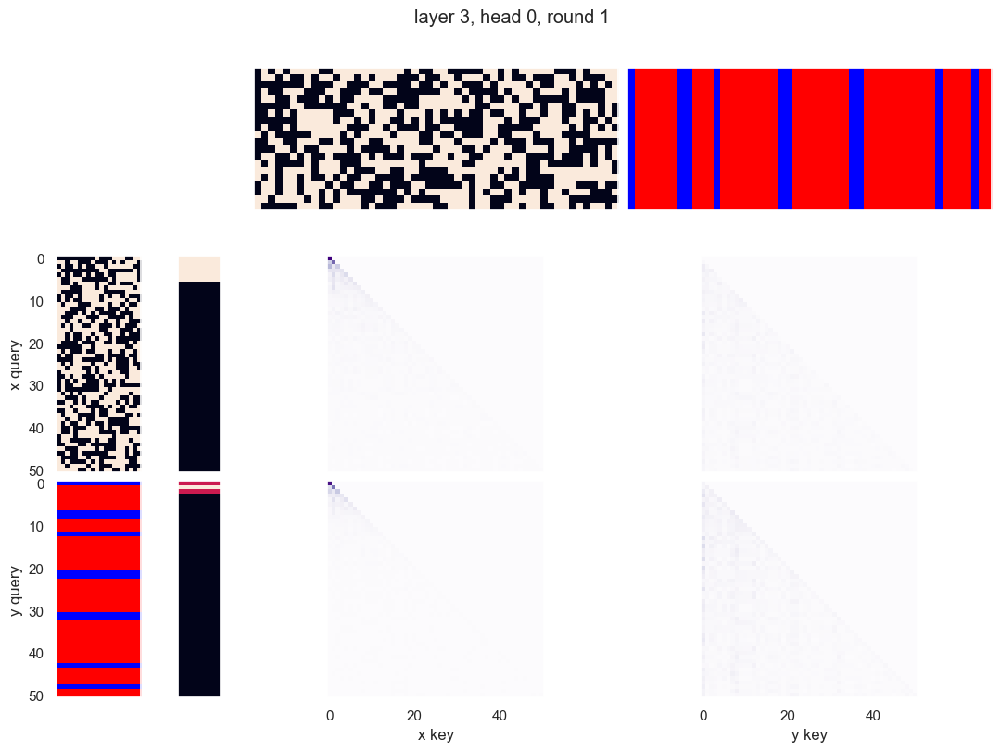

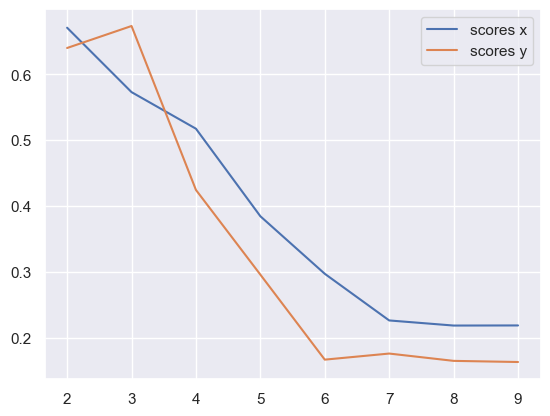

x query cluster:
SVM coefs: [ 0.25510306 -0.45921609  0.27299265  0.17551553 -0.21551765 -0.11985113
  0.07025463 -0.09279334  0.1083197   0.4903599  -0.00371692  0.20237982
 -0.11104924  0.23138697  0.04469998 -0.29457599 -0.46677543 -0.52135477
  0.57332266  0.62858932]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) +17: 0.64; (3) -19: 0.62; (4) +2: 0.62; (5) +8: 0.60; (6) +13: 0.60; (7) -0: 0.60; (8) +14: 0.60; (9) -9: 0.57; (10) +6: 0.57
(1) +8 AND +16: 0.47; (2) +17 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) -9 AND -19: 0.45; (5) -5 AND +16: 0.45; (6) +7 AND +16: 0.45; (7) -0 AND +17: 0.43; (8) -9 AND +13: 0.43; (9) +8 AND +13: 0.43; (10) +17 AND -18: 0.43
(1) +12 OR +16: 0.91; (2) +14 OR +16: 0.91; (3) +13 OR +16: 0.89; (4) +15 OR +16: 0.89; (5) +6 OR +16: 0.89; (6) +5 OR +16: 0.89; (7) +16 OR -19: 0.89; (8) +2 OR +16: 0.89; (9) +7 OR +17: 0.89; (10) +2 OR +4

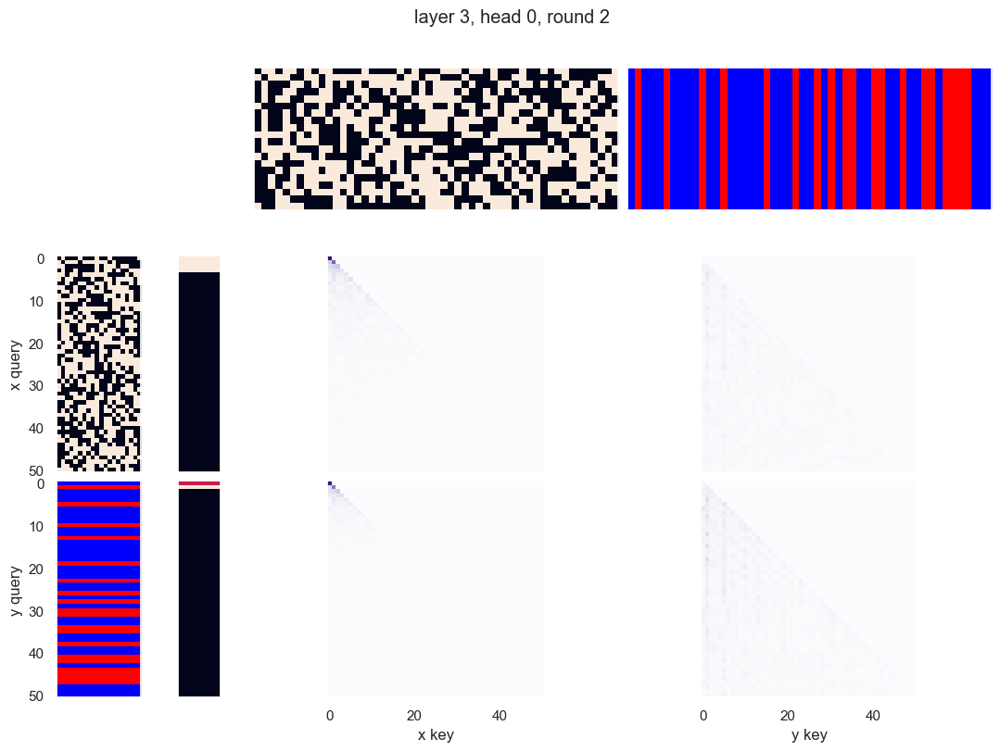

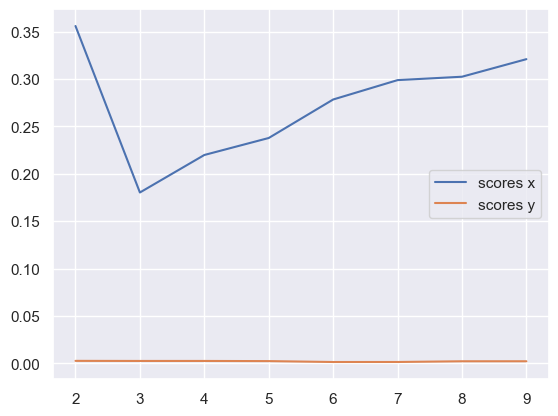

x query cluster:
SVM coefs: [-0.15688043  0.49108253 -0.89164341 -0.22306975 -0.33206454 -0.32428735
  0.07434335 -0.60404172 -0.5942083  -0.19668398 -0.13033861 -0.22900285
 -0.19713324  0.65994329 -0.27049393  0.33356725 -0.06360122  0.57909845
 -0.0244438  -0.81829471]
class1: [1 2 3 5 6 8]
(1) -1: 0.83; (2) +17: 0.83; (3) -15: 0.83; (4) -12: 0.83; (5) +4: 0.83; (6) +7: 0.83; (7) -0: 0.67; (8) -18: 0.67; (9) -16: 0.67; (10) -13: 0.67
(1) -1 AND +7: 0.83; (2) +7 AND -18: 0.67; (3) +7 AND -12: 0.67; (4) -1 AND +17: 0.67; (5) +4 AND -15: 0.67; (6) +4 AND +17: 0.67; (7) -1 AND +4: 0.67; (8) -1 AND -18: 0.67; (9) -12 AND +17: 0.67; (10) +11 AND -16: 0.67
(1) -0 OR -1: 1.00; (2) +2 OR +3: 1.00; (3) +2 OR +4: 1.00; (4) +4 OR -14: 1.00; (5) -2 OR +6: 1.00; (6) +8 OR +17: 1.00; (7) +8 OR -16: 1.00; (8) -2 OR +7: 1.00; (9) +8 OR -15: 1.00; (10) -8 OR -12: 1.00
{7.0: 0.7955460750721008, 11.0: 0.1795388764391343, 8.0: 0.019261339310711872, 13.0: 0.0008340588149925144, 12.0: 0.004819628724362715

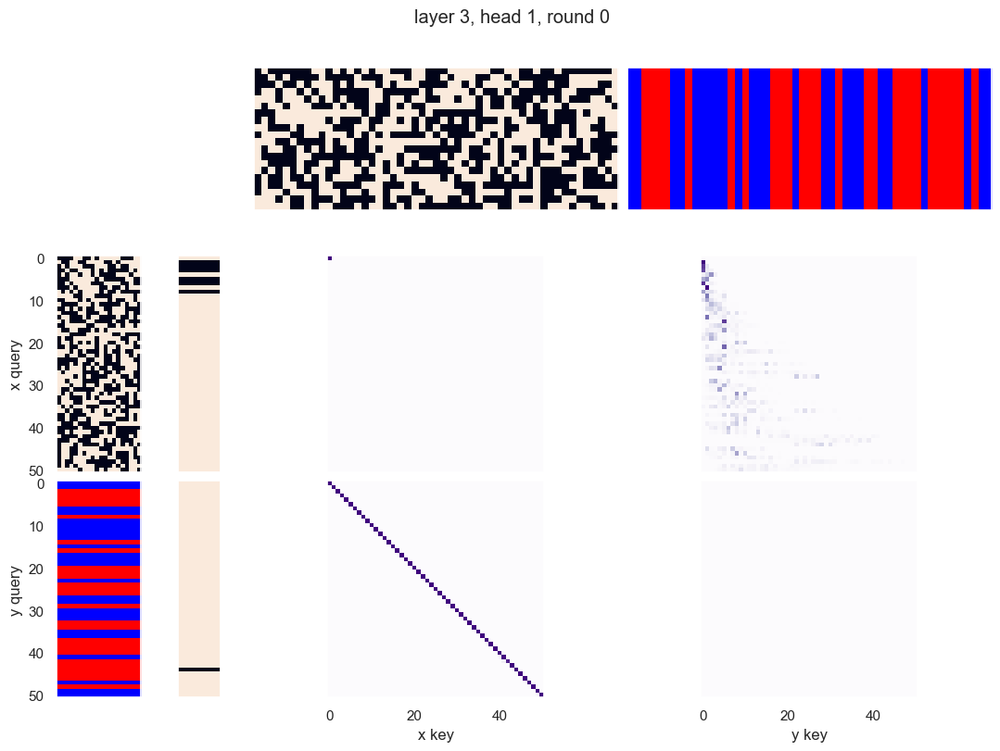

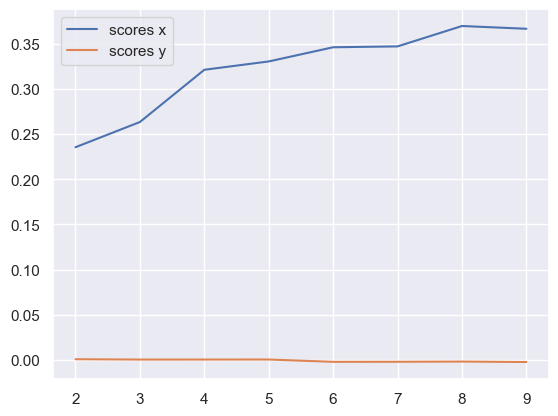

x query cluster:
SVM coefs for class 0: [ 0.51949946 -0.13673795 -0.24903189  0.92783727 -0.51073505  0.4051546
  0.05482032  0.61818791  0.15474263  0.18272739 -0.65800129  0.54086858
  0.25907875 -0.1645543   0.19068803 -0.04052002  0.32700236 -0.30584231
 -0.62372989  0.72874281]\class elements: [ 4  7  8  9 32 44 45]
(1) -5: 0.86; (2) +8: 0.86; (3) +7: 0.86; (4) +6: 0.86; (5) +16: 0.86; (6) +14: 0.86; (7) -12: 0.71; (8) -3: 0.71; (9) +17: 0.71; (10) -11: 0.71
(1) -5 AND +16: 0.86; (2) +6 AND +8: 0.86; (3) +8 AND +16: 0.71; (4) -5 AND +14: 0.71; (5) +8 AND +14: 0.71; (6) +6 AND +14: 0.71; (7) -5 AND +7: 0.71; (8) -5 AND +6: 0.71; (9) +14 AND +15: 0.71; (10) -5 AND +8: 0.71
(1) -3 OR -5: 1.00; (2) +3 OR +7: 1.00; (3) -10 OR -11: 1.00; (4) +3 OR +8: 1.00; (5) -3 OR -9: 1.00; (6) -3 OR -10: 1.00; (7) -3 OR -12: 1.00; (8) +9 OR +17: 1.00; (9) -3 OR -13: 1.00; (10) -9 OR +16: 1.00
{0.0: 0.9999874218509206}
SVM coefs for class 1: [-0.08821557  0.09202722  0.37646284 -0.51975293 -0.6323669

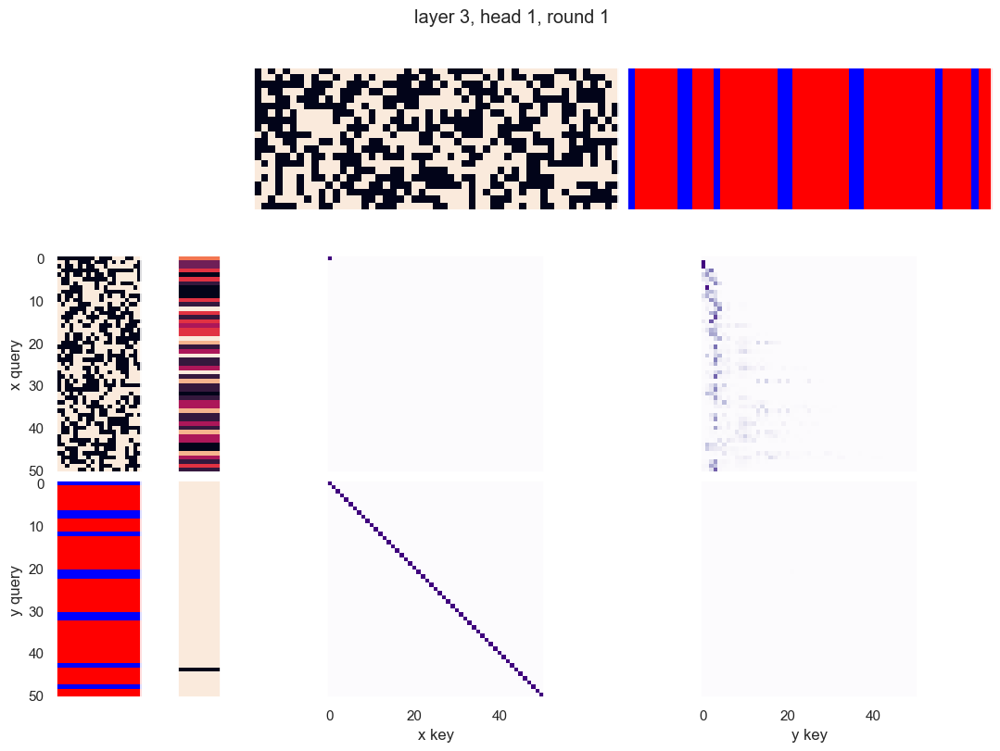

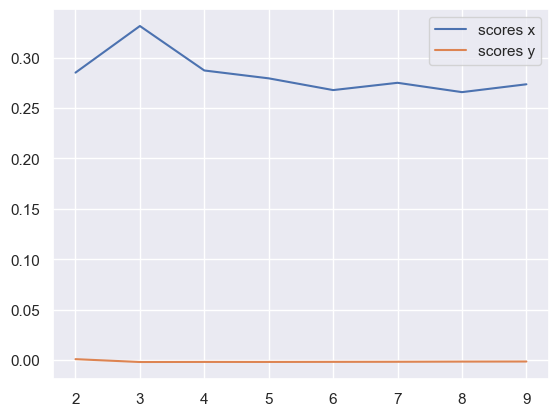

x query cluster:
SVM coefs for class 0: [-0.87658547  0.72333649  0.52518585  0.90323546  0.3182835  -0.20795791
 -0.22235366 -0.34879459 -0.40181256  0.06957248  0.04804628  0.16335273
  0.72678446  0.36345409 -0.34817095  1.02553029 -0.22197785  0.1408016
 -0.42248069 -0.02089919]\class elements: [ 0 14 16 17 20 21 22 23 26 27 28 29 30 32 33 34 35 37 38 40 41 42 43 44
 45 46 47 49 50]
(1) +2: 0.72; (2) -15: 0.69; (3) -19: 0.66; (4) -9: 0.66; (5) +16: 0.62; (6) +13: 0.62; (7) -0: 0.59; (8) +14: 0.59; (9) -11: 0.59; (10) +5: 0.59
(1) -9 AND -19: 0.59; (2) +2 AND -9: 0.52; (3) -15 AND +16: 0.52; (4) +2 AND -15: 0.48; (5) +17 AND -19: 0.48; (6) -15 AND -19: 0.48; (7) -9 AND +13: 0.48; (8) -1 AND +2: 0.48; (9) +2 AND +5: 0.48; (10) +2 AND -4: 0.48
(1) -10 OR -19: 0.97; (2) -17 OR -19: 0.97; (3) -9 OR -10: 0.97; (4) +2 OR -7: 0.93; (5) -9 OR +19: 0.93; (6) +5 OR -19: 0.93; (7) +3 OR -15: 0.93; (8) +8 OR +14: 0.93; (9) +9 OR -19: 0.93; (10) -9 OR -17: 0.93
{0.0: 0.9653435735092142}
SVM coef

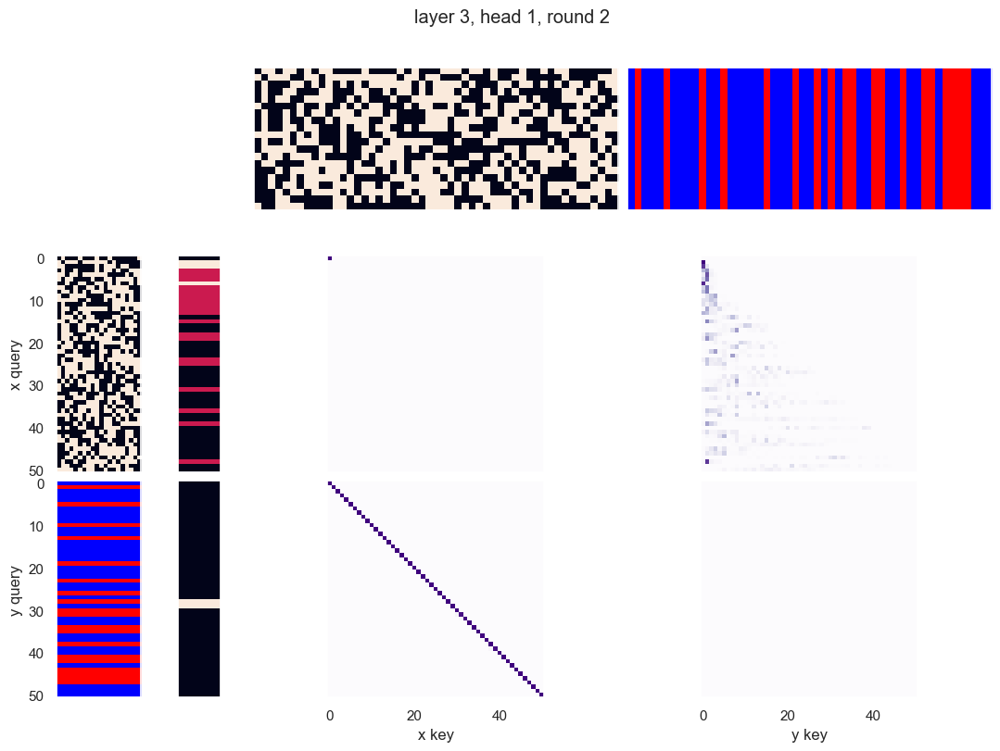

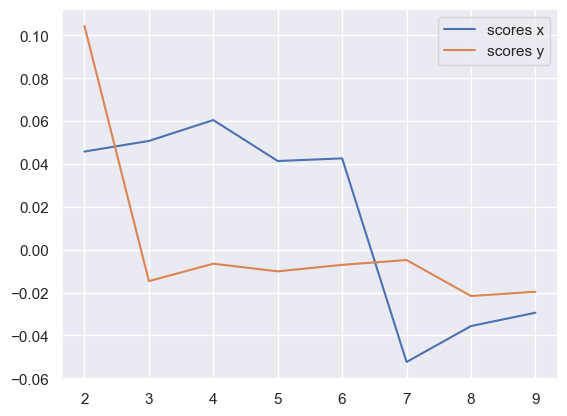

x query cluster:
SVM coefs for class 0: [ 0.03322832  0.14931837  0.34393273  0.17979047  0.28533727  0.5432039
  0.0186664   0.02553576  0.18918162  0.2159972  -0.02210326 -0.07746746
 -0.33866757  0.12564832 -0.20072893  0.19806159  0.15523691  0.52429459
 -0.21896258 -0.35525558]\class elements: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27 28 29 30 31 32 33 34 35 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.73; (2) -12: 0.67; (3) -18: 0.62; (4) -16: 0.62; (5) -0: 0.60; (6) -11: 0.60; (7) +10: 0.60; (8) +5: 0.60; (9) +13: 0.58; (10) +6: 0.58
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.48; (3) -3 AND -18: 0.48; (4) +5 AND +17: 0.48; (5) -0 AND +17: 0.48; (6) -12 AND +17: 0.48; (7) +17 AND -18: 0.46; (8) -11 AND +17: 0.46; (9) +13 AND -18: 0.46; (10) -3 AND -16: 0.46
(1) -11 OR -16: 0.96; (2) -2 OR -18: 0.96; (3) +5 OR +8: 0.94; (4) +17 OR -19: 0.94; (5) -11 OR -18: 0.94; (6) -12 OR -16: 0.94; (7) +4 OR +17: 0.92; (8) +10 OR +17: 0.92; (9) +3 OR 

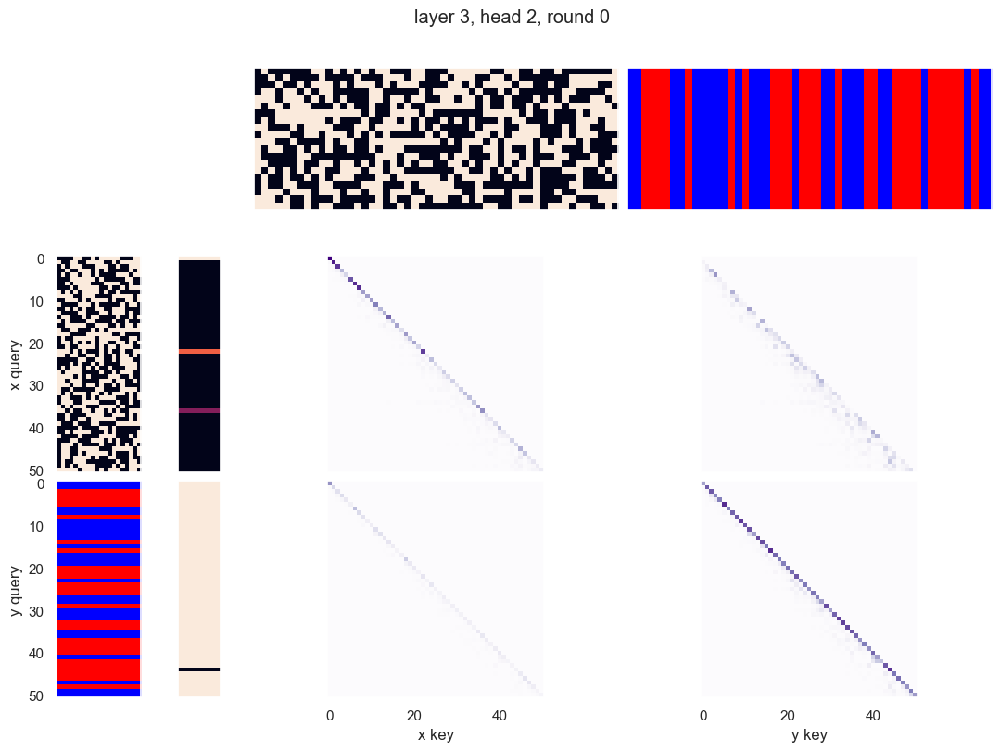

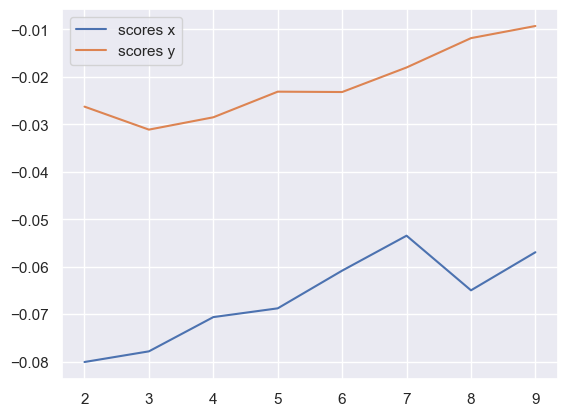

x query cluster:
SVM coefs for class 0: [-0.33213901  0.32972854 -0.06037702  0.15546739  0.0911206  -0.12094628
 -0.47339105  0.28399255  0.40904873  0.35774134  0.15950304 -0.20484944
  0.26633468 -0.0917209   0.50675167 -0.69901885  0.16078861 -0.40274552
 -0.00712471  0.07000531]\class elements: [43 44 45 46]
(1) -9: 1.00; (2) +14: 1.00; (3) +15: 1.00; (4) -11: 0.75; (5) -6: 0.75; (6) -12: 0.75; (7) -13: 0.75; (8) -0: 0.75; (9) +2: 0.75; (10) +17: 0.75
(1) -9 AND +14: 1.00; (2) -9 AND +15: 1.00; (3) +14 AND +15: 1.00; (4) -0 AND -9: 0.75; (5) -3 AND -9: 0.75; (6) -12 AND +15: 0.75; (7) -9 AND -13: 0.75; (8) -12 AND +14: 0.75; (9) -12 AND -13: 0.75; (10) -11 AND -18: 0.75
(1) +5 OR +15: 1.00; (2) -3 OR -5: 1.00; (3) -9 OR -12: 1.00; (4) +3 OR -4: 1.00; (5) -3 OR +4: 1.00; (6) -9 OR +12: 1.00; (7) +2 OR +19: 1.00; (8) -9 OR +11: 1.00; (9) -9 OR -13: 1.00; (10) +2 OR -18: 1.00
{0.0: 0.5562811379649364}
SVM coefs for class 1: [-0.08928127 -0.37066382 -0.0745435  -0.46405324 -0.0939701 

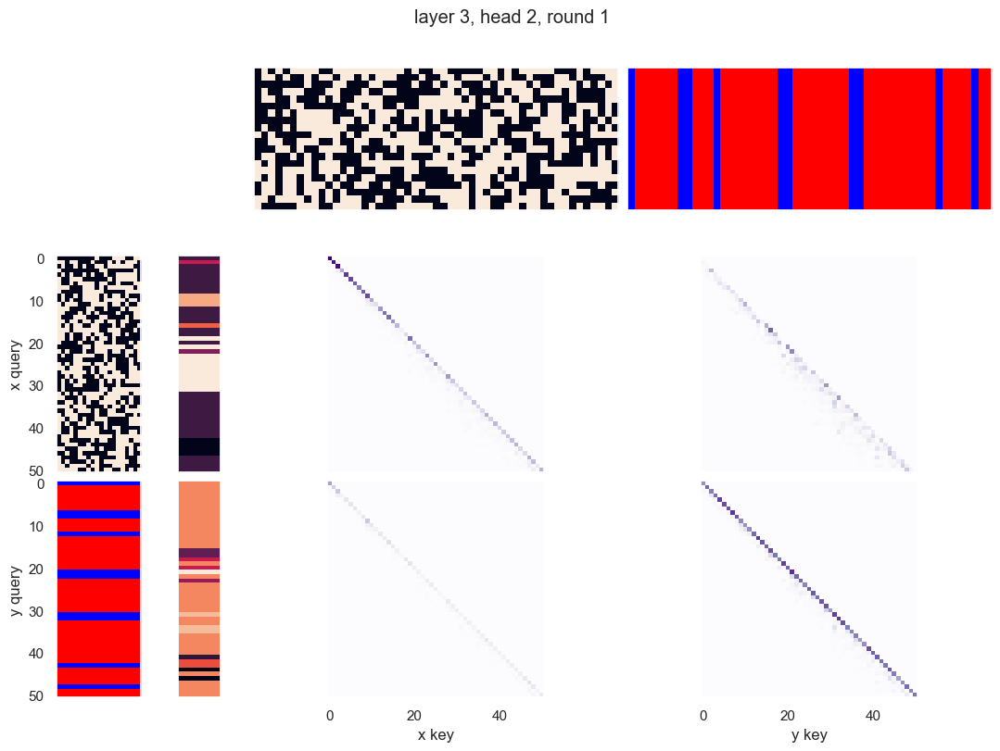

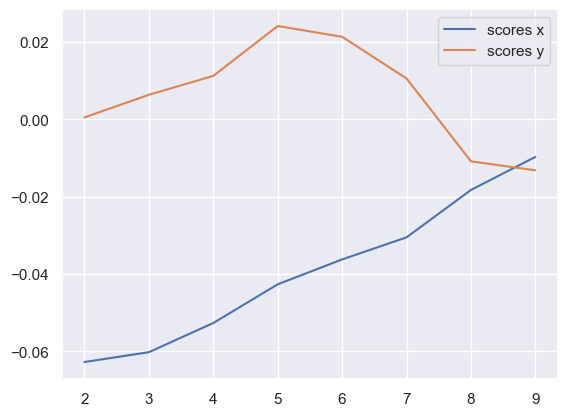

x query cluster:
SVM coefs for class 0: [-0.54423486 -0.08617477 -0.29890626 -0.0456955  -0.5042941  -0.39347146
 -0.62252401 -0.39688811  0.10999895  0.73367168 -0.1095008   0.33939964
  0.25290102 -0.01571933  0.34613191 -0.67503753  0.19334949  0.0608814
  0.24114373 -0.21585319]\class elements: [42 43 44 45 46]
(1) -19: 1.00; (2) +13: 0.80; (3) -1: 0.80; (4) +12: 0.80; (5) +11: 0.80; (6) -9: 0.80; (7) +4: 0.80; (8) -5: 0.80; (9) +17: 0.80; (10) +8: 0.80
(1) -1 AND -19: 0.80; (2) +6 AND +13: 0.80; (3) +4 AND -19: 0.80; (4) +13 AND -19: 0.80; (5) +8 AND -19: 0.80; (6) -1 AND +6: 0.80; (7) -1 AND +17: 0.80; (8) -9 AND +11: 0.80; (9) +11 AND +13: 0.80; (10) -1 AND -9: 0.80
(1) +9 OR +11: 1.00; (2) -6 OR +17: 1.00; (3) +6 OR +16: 1.00; (4) -2 OR +11: 1.00; (5) +6 OR -15: 1.00; (6) +13 OR -15: 1.00; (7) +10 OR -14: 1.00; (8) +2 OR +12: 1.00; (9) +6 OR -14: 1.00; (10) -2 OR +13: 1.00
{0.0: 0.6098780521231837}
SVM coefs for class 1: [ 0.10407604 -1.36230099 -0.23947374  0.11776439 -0.70035

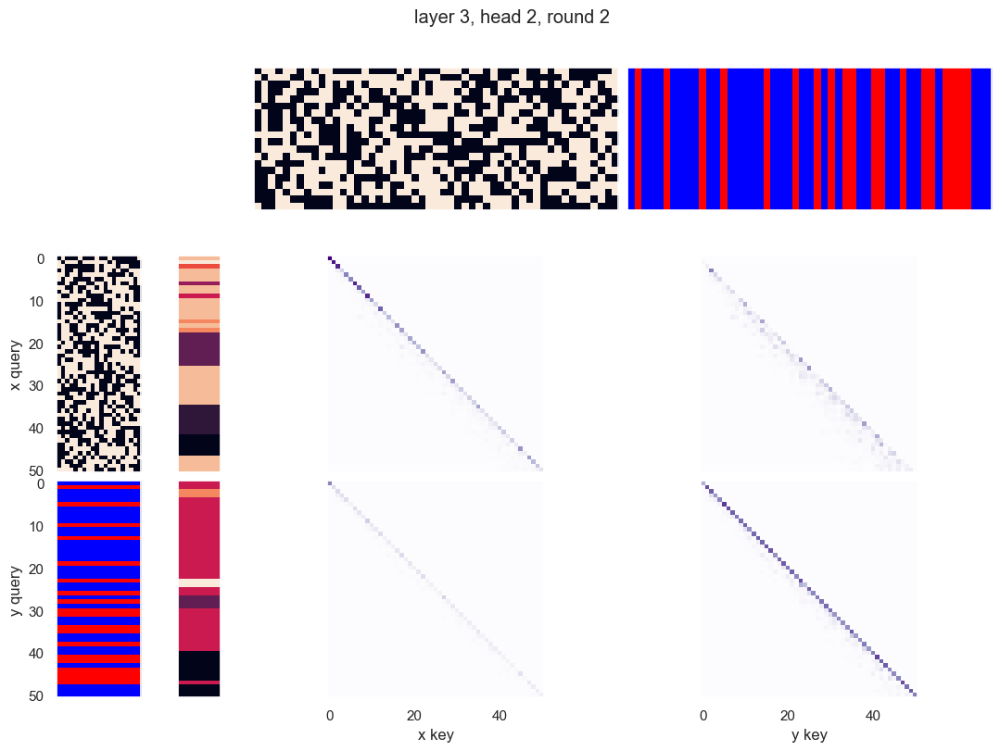

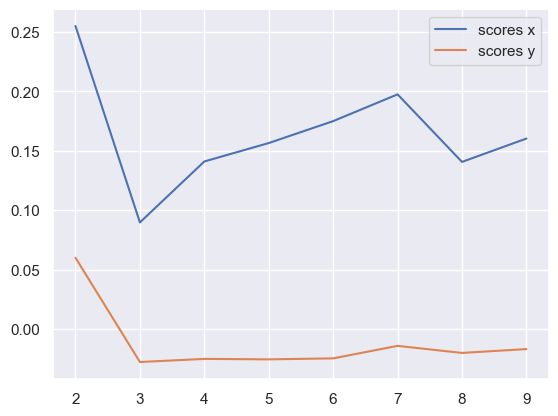

x query cluster:
SVM coefs: [ 0.17432493 -0.23072395  0.08033118  0.19731594  0.206766   -0.00975709
  0.13151753  0.27299272  0.13643268  0.00314679  0.12504772  0.02664911
 -0.34530267 -0.09370216 -0.02226864 -0.13858736  0.01961951 -0.1099
  0.05610598  0.1304933 ]
class1: [ 0 14 16 18 19 20 21 22 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39
 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.71; (3) +10: 0.69; (4) +5: 0.66; (5) -3: 0.63; (6) -0: 0.63; (7) -18: 0.60; (8) -11: 0.60; (9) +2: 0.60; (10) +13: 0.57
(1) -3 AND -16: 0.51; (2) +2 AND -18: 0.51; (3) -3 AND -18: 0.49; (4) -0 AND +17: 0.49; (5) -11 AND +17: 0.49; (6) +10 AND -16: 0.49; (7) +5 AND +13: 0.49; (8) +13 AND -16: 0.46; (9) +1 AND -16: 0.46; (10) -7 AND +10: 0.46
(1) +10 OR +17: 0.97; (2) -11 OR -16: 0.97; (3) -16 OR +17: 0.97; (4) -3 OR -11: 0.94; (5) +5 OR -16: 0.94; (6) -9 OR +17: 0.94; (7) -12 OR -16: 0.94; (8) +10 OR -11: 0.94; (9) -11 OR -18: 0.91; (10) -3 OR +17: 0.91
{7.0: 0.14519525666388153, 11.

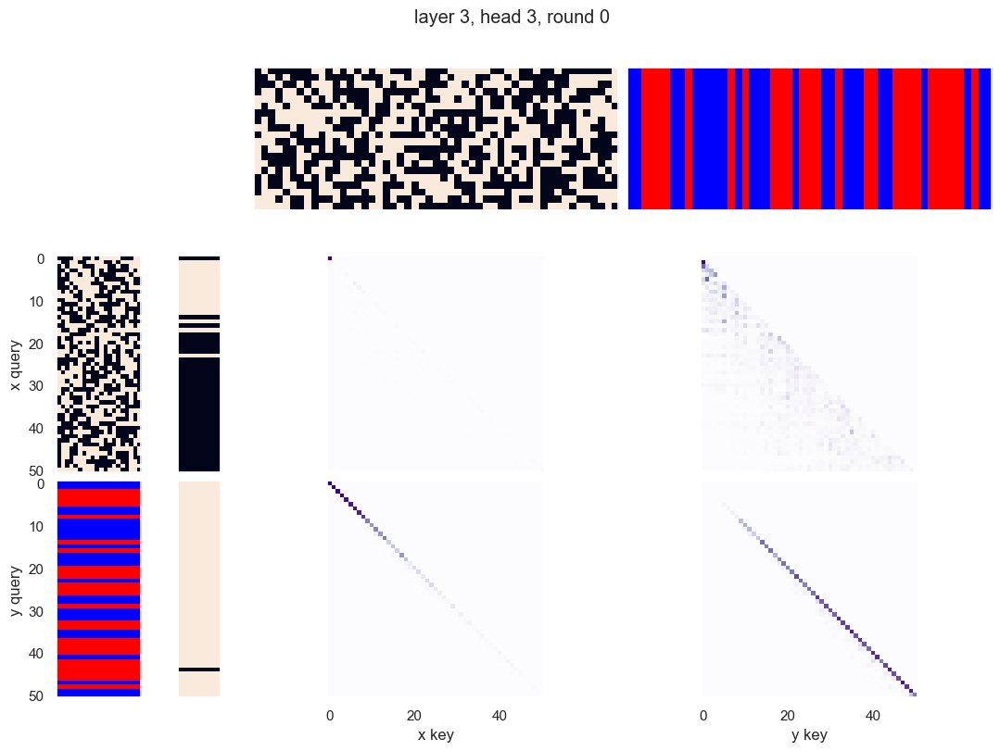

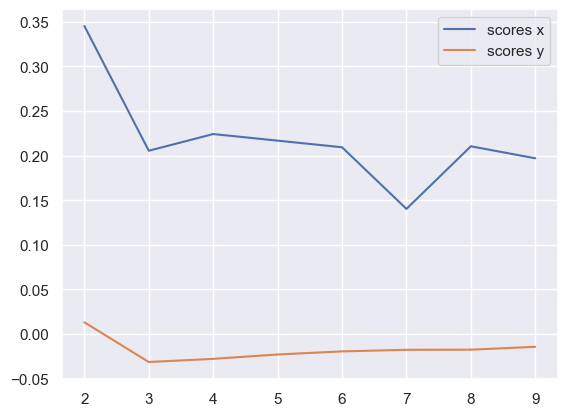

x query cluster:
SVM coefs: [ 0.54896309 -0.33469009 -0.03636494 -0.25062342  0.32227407  0.87666309
  0.35394313  0.85760739  0.54816165  0.35279772  0.01651218 -0.14439263
  0.07208986 -1.01815304  0.03457076 -0.58812154 -0.26591814 -0.67507482
  0.1383502   0.35433169]
class1: [ 0  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) -16: 0.64; (2) +14: 0.64; (3) +13: 0.64; (4) +9: 0.60; (5) -12: 0.60; (6) -3: 0.60; (7) +19: 0.60; (8) +0: 0.60; (9) +5: 0.57; (10) +11: 0.55
(1) -3 AND +19: 0.45; (2) +9 AND +13: 0.45; (3) +9 AND +14: 0.43; (4) +13 AND +14: 0.43; (5) +0 AND -16: 0.43; (6) +0 AND +9: 0.43; (7) +5 AND -16: 0.43; (8) +13 AND -16: 0.43; (9) -10 AND -16: 0.40; (10) -12 AND +19: 0.40
(1) +13 OR +19: 0.93; (2) -12 OR +13: 0.93; (3) +0 OR +14: 0.90; (4) -16 OR +19: 0.90; (5) +9 OR -12: 0.90; (6) +6 OR -16: 0.90; (7) +14 OR -16: 0.90; (8) +1 OR +13: 0.88; (9) -8 OR -16: 0.88; (10) +14 OR -15: 0.88
{0.0: 

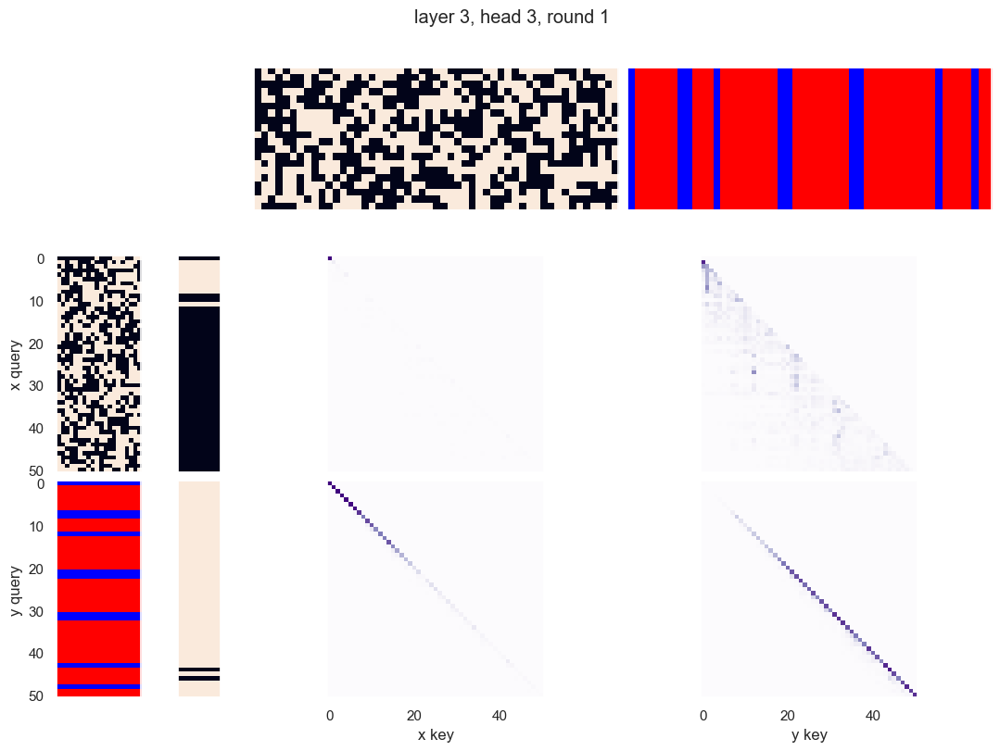

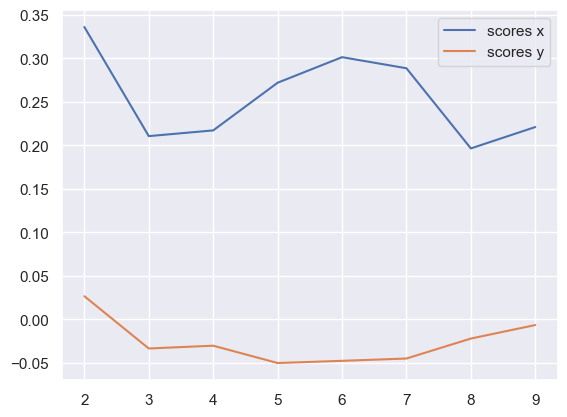

x query cluster:
SVM coefs: [ 0.34951379  0.05105607 -0.77958324  0.84616232  0.25817491  0.21028211
  0.06955879  0.66232057  0.20809861 -0.40601825 -0.25962368  0.14284741
  0.22710969 -0.16181007  0.11917578 -0.48986467  0.14633278 -0.46373733
 -1.05528833  1.11630642]
class1: [ 0  1  3  6 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) -0: 0.67; (2) +16: 0.63; (3) +17: 0.60; (4) +2: 0.60; (5) -19: 0.58; (6) +6: 0.58; (7) +14: 0.58; (8) -15: 0.58; (9) +12: 0.56; (10) +13: 0.56
(1) -0 AND +17: 0.47; (2) +16 AND +17: 0.44; (3) +17 AND -19: 0.42; (4) -0 AND +16: 0.42; (5) +8 AND +13: 0.42; (6) +7 AND +16: 0.42; (7) -0 AND +14: 0.40; (8) +7 AND +8: 0.40; (9) +2 AND -15: 0.40; (10) +2 AND +7: 0.40
(1) -3 OR +8: 0.91; (2) -0 OR -15: 0.91; (3) -10 OR -19: 0.91; (4) +12 OR +16: 0.91; (5) -0 OR -10: 0.91; (6) -0 OR +2: 0.88; (7) +2 OR +17: 0.88; (8) -15 OR +17: 0.88; (9) -10 OR +13: 0.88; (10) +1 OR +2: 0.88
{0.0: 0.9

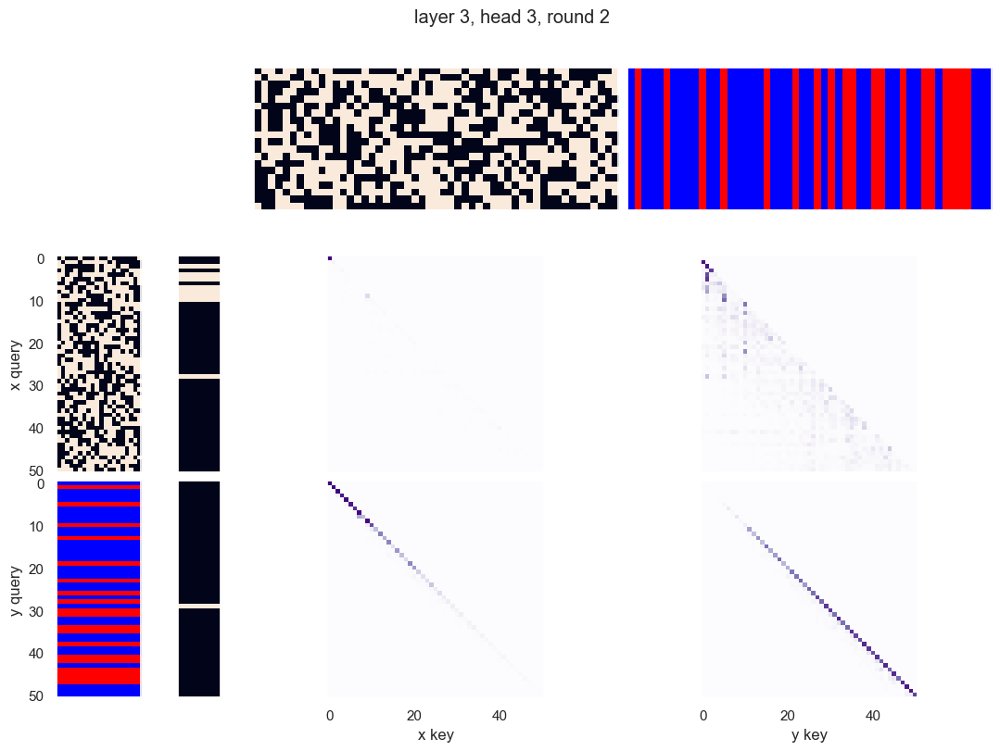

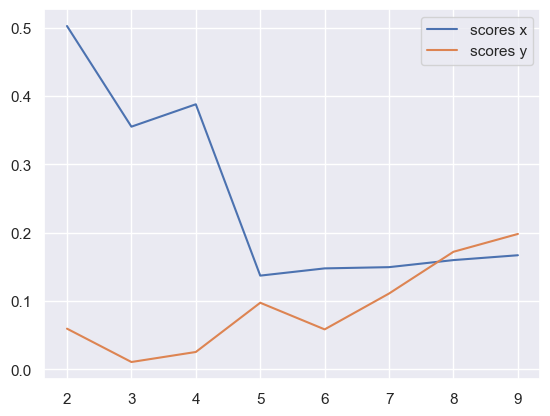

x query cluster:
SVM coefs: [-0.17112437 -0.18774864  0.03348617  0.27044448 -0.04334018 -0.0977013
 -0.2128492   0.32031804  0.21600671  0.4910891   0.19209512  0.37243457
 -0.10580173 -0.787918   -0.45563116  0.16128185  0.19947138 -0.25663333
  0.01237904  0.76310223]
class1: [ 0  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.69; (2) -16: 0.67; (3) +10: 0.64; (4) -18: 0.62; (5) -3: 0.62; (6) +13: 0.62; (7) -12: 0.60; (8) -11: 0.60; (9) +2: 0.60; (10) +5: 0.58
(1) +2 AND -18: 0.53; (2) -3 AND -16: 0.51; (3) +13 AND -18: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.47; (6) -11 AND +17: 0.44; (7) -7 AND +10: 0.44; (8) +6 AND -16: 0.44; (9) -16 AND -18: 0.44; (10) -3 AND +13: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.93; (3) +10 OR +17: 0.93; (4) -12 OR -16: 0.93; (5) -2 OR -18: 0.93; (6) -16 OR +17: 0.93; (7) -3 OR -11: 0.93; (8) +4 OR +17: 0.91; (9) -9 OR +17: 0.91; (10) +2 OR +18: 0.

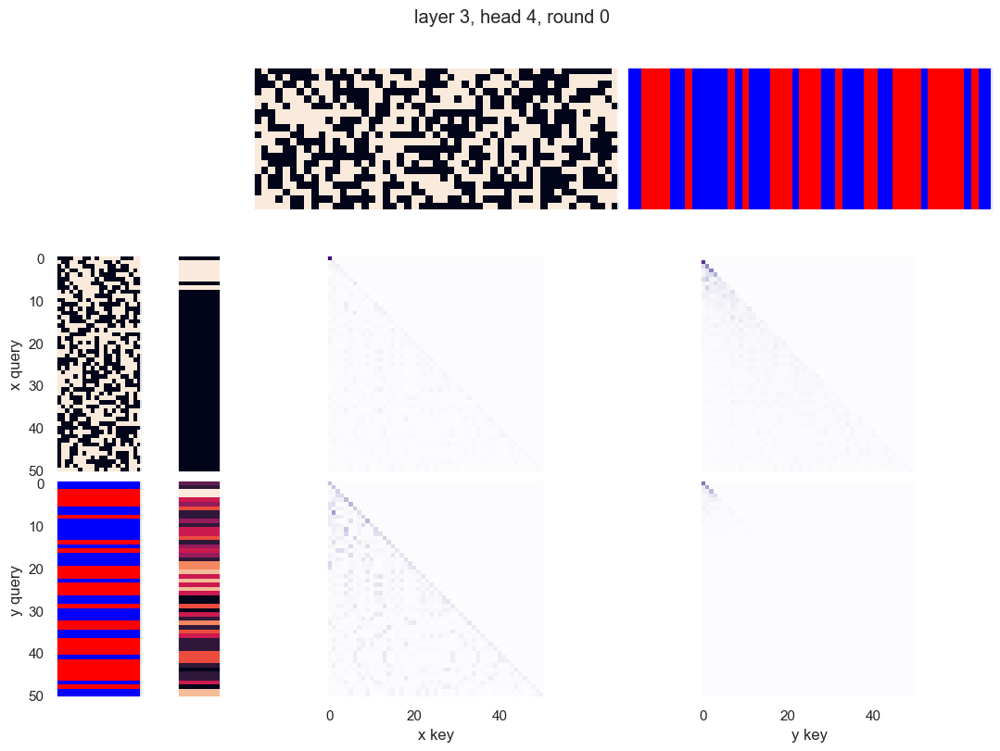

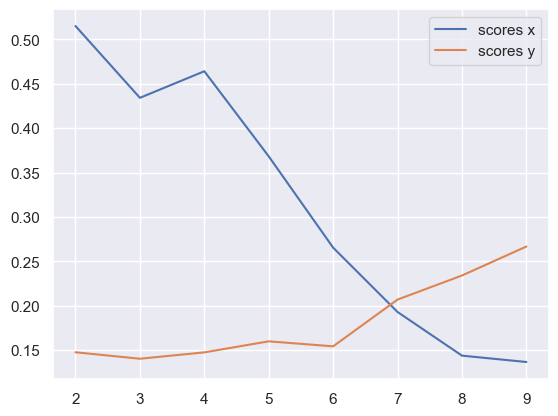

x query cluster:
SVM coefs: [-0.21931197 -0.09930724  0.17326771  0.16568121  0.09256228  0.17729384
 -0.03813006 -0.04670464  0.09746898  0.60325894  0.2633968  -0.02124213
 -0.26205756 -0.51860748 -0.41847766  0.20954681  0.54426129 -0.34367467
 -0.15722974  0.60897867]
class1: [ 0  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.65; (2) +19: 0.63; (3) +0: 0.63; (4) +13: 0.63; (5) -16: 0.61; (6) -12: 0.61; (7) +9: 0.59; (8) -3: 0.59; (9) -4: 0.57; (10) +6: 0.57
(1) -3 AND +19: 0.46; (2) -12 AND +19: 0.43; (3) +0 AND +9: 0.43; (4) +9 AND +13: 0.43; (5) +13 AND +14: 0.43; (6) +9 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +0 AND -16: 0.41; (9) +5 AND -16: 0.41; (10) -4 AND +14: 0.41
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +14 OR -15: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -16: 0.89; (8) -18 OR +19: 0.89; (9) +14 OR +19: 0.89; (10) +9 OR -12

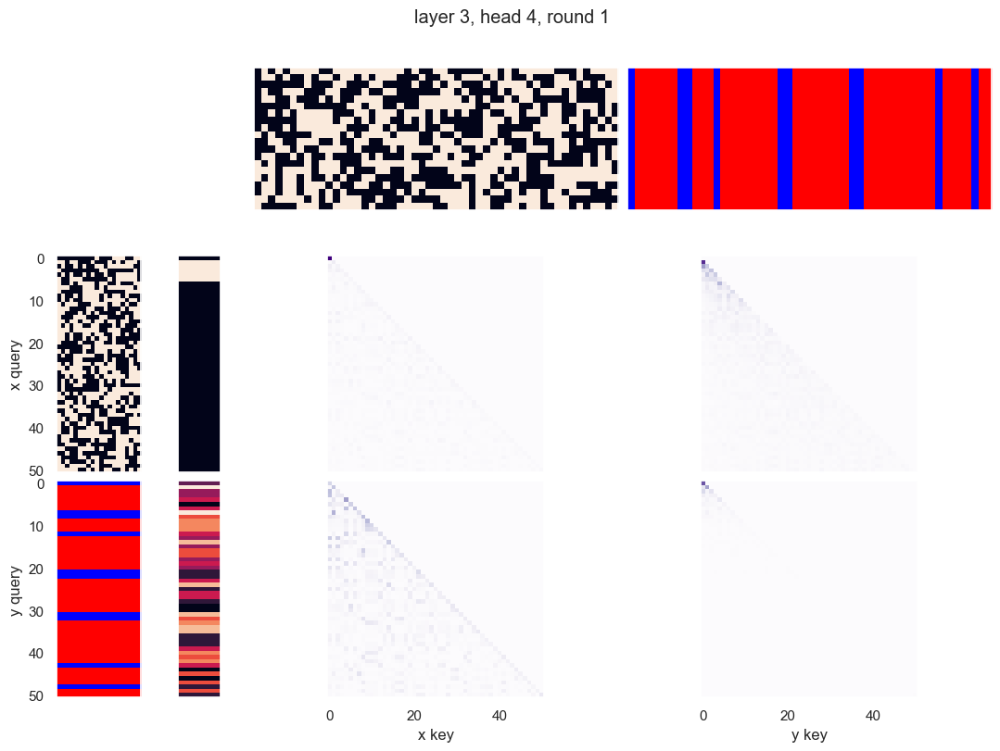

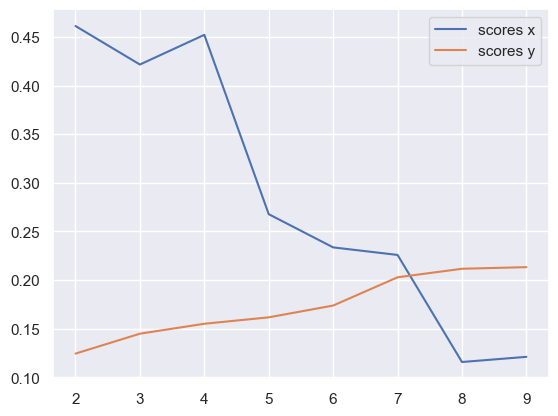

x query cluster:
SVM coefs: [-0.15065684 -0.27793011  1.09860671  0.17013716  0.36166326  0.33776022
 -0.01594744  0.3164822   0.64442125  0.32146269 -0.05036404  0.37117327
  0.10660356 -0.5884352   0.02283857 -0.05968164  0.56934207 -0.53949303
  0.4595037   0.57550243]
class1: [ 0  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) -0: 0.62; (4) +13: 0.62; (5) +17: 0.62; (6) +2: 0.60; (7) -9: 0.58; (8) +7: 0.58; (9) +8: 0.58; (10) +14: 0.58
(1) +17 AND -19: 0.49; (2) +16 AND +17: 0.47; (3) -9 AND -19: 0.47; (4) +8 AND +16: 0.44; (5) +8 AND +13: 0.44; (6) +7 AND +16: 0.44; (7) -9 AND +13: 0.44; (8) -18 AND -19: 0.44; (9) +16 AND -19: 0.42; (10) -9 AND +17: 0.42
(1) -10 OR -19: 0.93; (2) +12 OR +16: 0.91; (3) -10 OR +13: 0.91; (4) +7 OR -19: 0.89; (5) +13 OR +16: 0.89; (6) -0 OR -19: 0.89; (7) +14 OR +16: 0.89; (8) +15 OR +16: 0.89; (9) -0 OR -10: 0.89; (10) -9 OR -10: 0

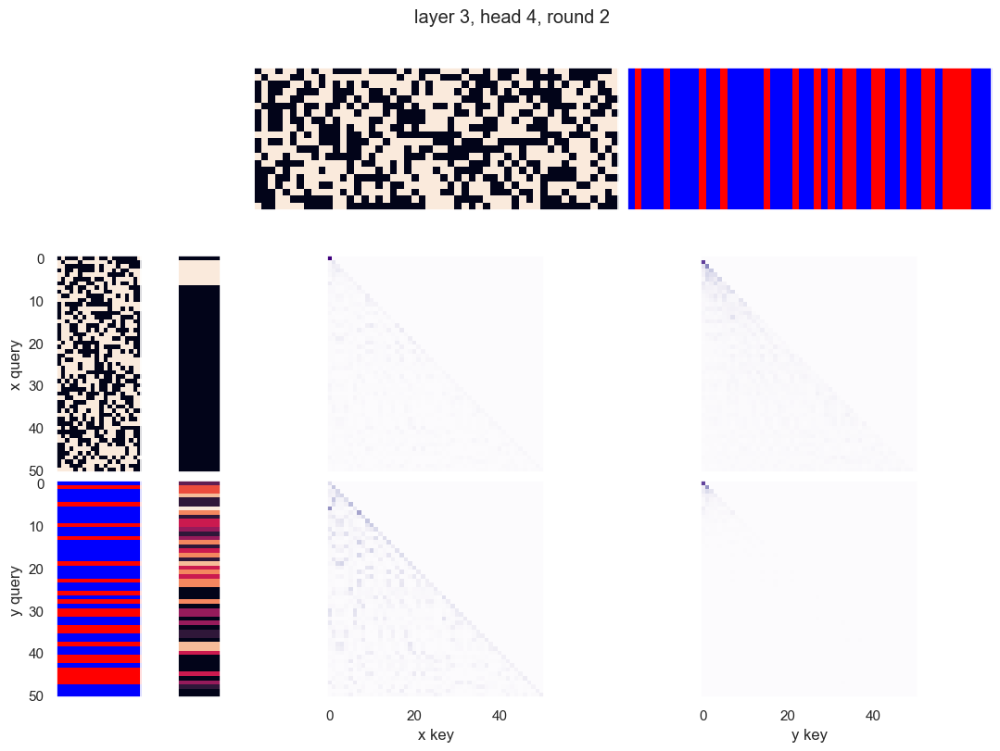

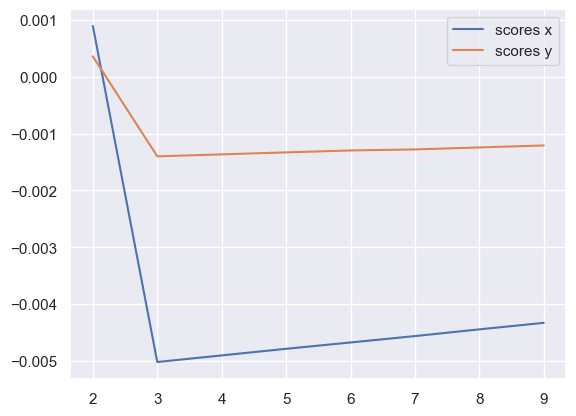

x query cluster:
SVM coefs: [-0.03572016 -0.04280132  0.03109916 -0.23935243  0.30185345 -0.14473627
  0.00270123 -0.09226804 -0.14554948  0.06175547 -0.02882894 -0.04208306
 -0.01310605  0.14417944 -0.16348401  0.15122998 -0.08349076  0.30878976
 -0.09516265 -0.04678697]
class1: [44]
(1) -0: 1.00; (2) -11: 1.00; (3) +10: 1.00; (4) -19: 1.00; (5) -9: 1.00; (6) +14: 1.00; (7) -8: 1.00; (8) -15: 1.00; (9) -7: 1.00; (10) -12: 1.00
(1) -6 AND +16: 1.00; (2) -8 AND +10: 1.00; (3) +5 AND -6: 1.00; (4) +2 AND +5: 1.00; (5) +2 AND -6: 1.00; (6) -11 AND -17: 1.00; (7) -8 AND -11: 1.00; (8) +2 AND -7: 1.00; (9) -11 AND +16: 1.00; (10) -4 AND -19: 1.00
(1) -0 OR -1: 1.00; (2) -7 OR -12: 1.00; (3) -7 OR +12: 1.00; (4) +7 OR -12: 1.00; (5) -7 OR -13: 1.00; (6) -7 OR +13: 1.00; (7) +7 OR -13: 1.00; (8) -7 OR -14: 1.00; (9) +7 OR -11: 1.00; (10) -7 OR +14: 1.00
{7.0: 1.1368659165854485e-16, 11.0: 2.4343917452620406e-12, 8.0: 1.5609532761501825e-19, 13.0: 6.206905822648257e-11, 12.0: 1.070326476203868

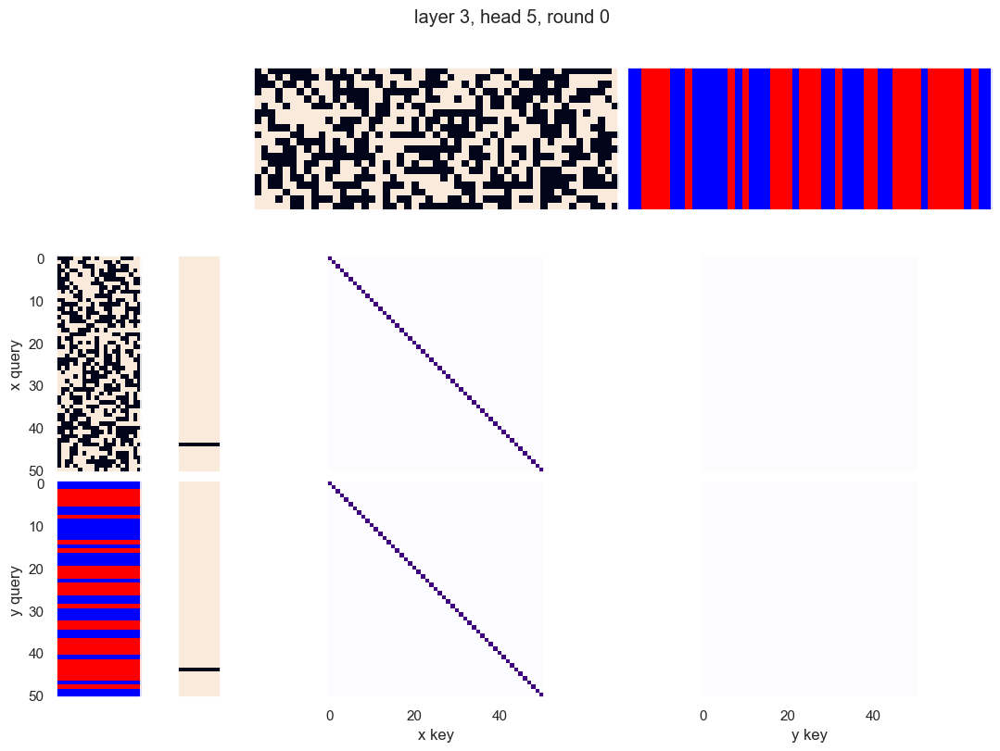

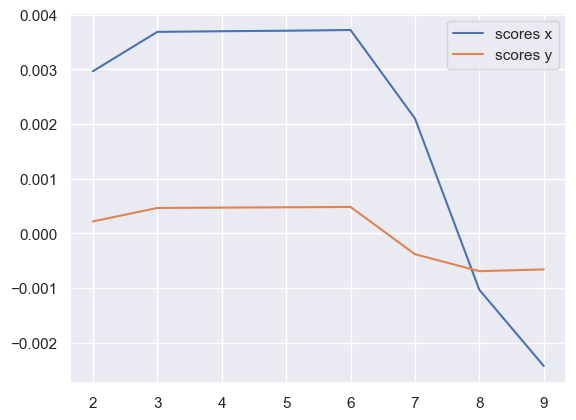

x query cluster:
SVM coefs for class 0: [ 0.03572244  0.04280198 -0.0310978   0.2393533  -0.30185437  0.14473413
 -0.00270042  0.0922664   0.14555192 -0.06175396  0.02882904  0.04208221
  0.01310432 -0.1441821   0.16348749 -0.1512294   0.08349204 -0.30879033
  0.09516415  0.0467864 ]\class elements: [44]
(1) -0: 1.00; (2) -11: 1.00; (3) -10: 1.00; (4) -19: 1.00; (5) -9: 1.00; (6) +14: 1.00; (7) -8: 1.00; (8) +7: 1.00; (9) +15: 1.00; (10) -12: 1.00
(1) -0 AND -1: 1.00; (2) -10 AND +15: 1.00; (3) +2 AND -19: 1.00; (4) -10 AND +14: 1.00; (5) +3 AND +4: 1.00; (6) +3 AND -5: 1.00; (7) -10 AND -13: 1.00; (8) +3 AND -6: 1.00; (9) -10 AND -12: 1.00; (10) +3 AND +7: 1.00
(1) -0 OR -1: 1.00; (2) -7 OR -12: 1.00; (3) +7 OR -12: 1.00; (4) +7 OR +12: 1.00; (5) -7 OR -13: 1.00; (6) +7 OR -13: 1.00; (7) +7 OR +13: 1.00; (8) -7 OR +14: 1.00; (9) +7 OR +11: 1.00; (10) +7 OR -14: 1.00
{0.0: 8.689330073357279e-09}
SVM coefs for class 1: [ 0.00345584  0.21129327  0.09596076  0.29537227 -0.03485273 -0.1184

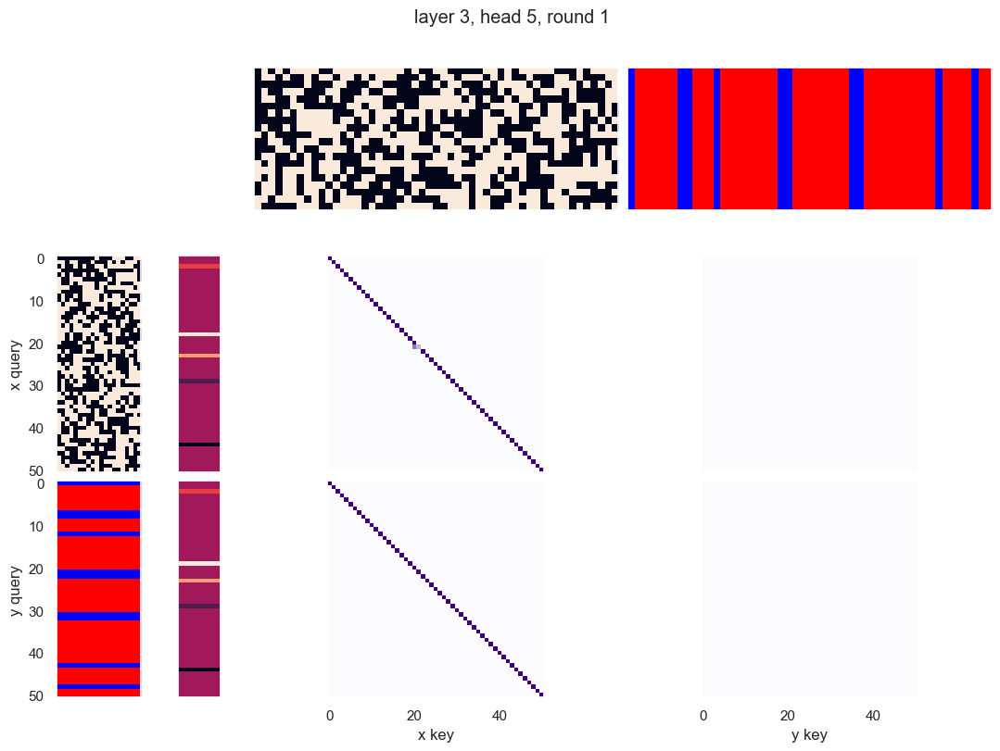

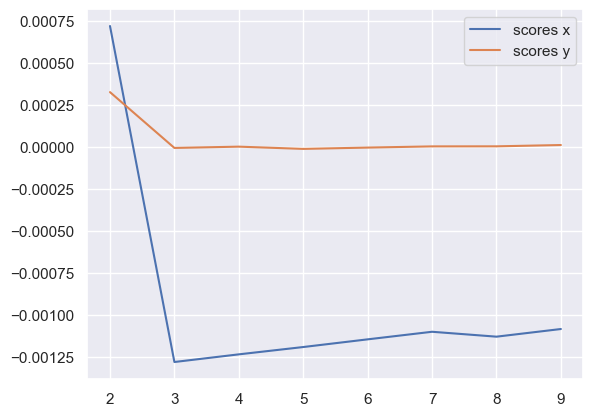

x query cluster:
SVM coefs: [ 0.0034538   0.2112929   0.09595734  0.29537553 -0.03484891 -0.11848854
 -0.17706436 -0.2734187  -0.16148323 -0.034457   -0.1805916   0.23913464
  0.17414595 -0.16809922 -0.06807261  0.19109982  0.00499943 -0.10763748
 -0.09475926  0.02687954]
class1: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50]
(1) +16: 0.66; (2) -19: 0.62; (3) +17: 0.62; (4) +2: 0.60; (5) -0: 0.58; (6) +13: 0.58; (7) +14: 0.58; (8) -5: 0.58; (9) -3: 0.56; (10) +6: 0.56
(1) +8 AND +16: 0.44; (2) -18 AND -19: 0.44; (3) +17 AND -19: 0.44; (4) -5 AND +16: 0.44; (5) +16 AND +17: 0.44; (6) +13 AND -19: 0.42; (7) -0 AND +17: 0.42; (8) +7 AND +16: 0.42; (9) -9 AND -19: 0.42; (10) -5 AND -19: 0.40
(1) +12 OR +16: 0.92; (2) +2 OR -5: 0.90; (3) -10 OR -19: 0.90; (4) +14 OR +16: 0.90; (5) +1 OR +2: 0.88; (6) -15 OR +17: 0.88; (7) +2 OR +4: 0.88; (8) +2 OR +16: 0.88; (9) +2 OR +12: 0.88; (10) +

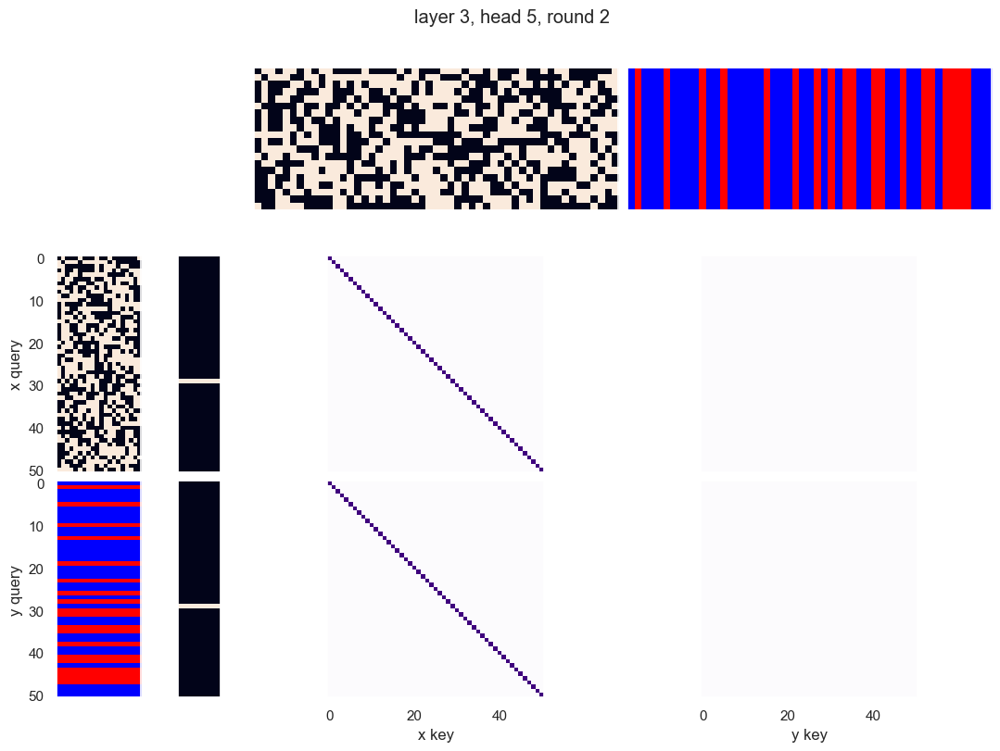

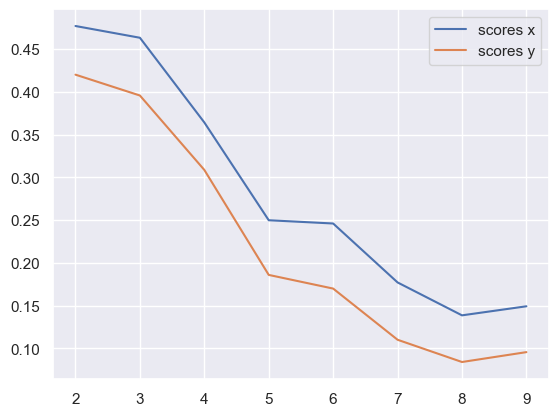

x query cluster:
SVM coefs: [-0.02811333 -0.54873719  0.7350901   0.30769728  0.32837534  0.25864241
  0.19371929  0.24594909  0.71810974  0.3203633  -0.21613921  0.58285039
  0.34706381 -0.74748281  0.27725708 -0.49685358  0.07290327 -0.88163003
  0.25841781  0.84145985]
class1: [ 7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -11: 0.65; (3) +10: 0.65; (4) -16: 0.65; (5) -18: 0.60; (6) -12: 0.60; (7) +13: 0.60; (8) +6: 0.58; (9) +5: 0.58; (10) -3: 0.58
(1) +2 AND -18: 0.51; (2) +13 AND -18: 0.49; (3) +6 AND +17: 0.49; (4) -11 AND +17: 0.49; (5) -3 AND -16: 0.47; (6) -3 AND -18: 0.47; (7) -0 AND +17: 0.44; (8) -4 AND +17: 0.44; (9) +17 AND -18: 0.44; (10) +8 AND +17: 0.44
(1) -11 OR -18: 0.95; (2) -11 OR -16: 0.95; (3) +10 OR -11: 0.95; (4) +10 OR +17: 0.95; (5) -12 OR -16: 0.93; (6) +17 OR -19: 0.93; (7) -9 OR +17: 0.93; (8) -3 OR -11: 0.93; (9) -2 OR -18: 0.93; (10) -16 OR +17: 0.93


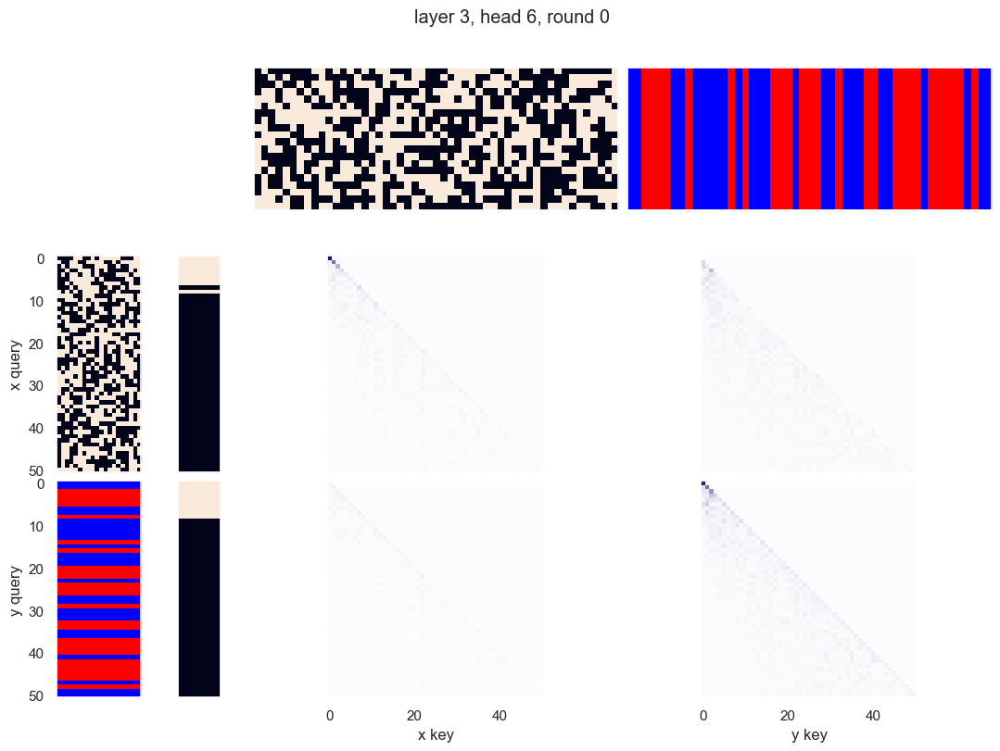

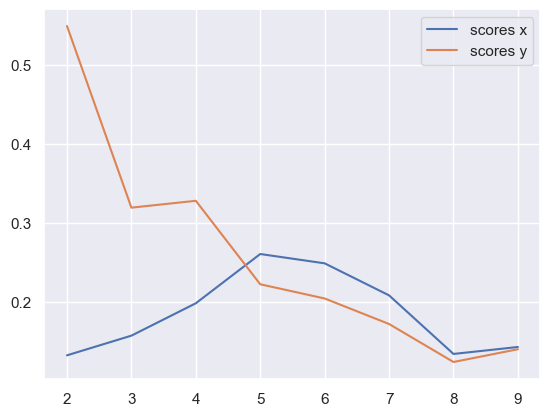

x query cluster:
SVM coefs for class 0: [ 0.07602269  0.07474518 -0.10853448 -0.38841009 -0.34869938 -0.06876981
 -0.28991736 -0.00772245 -0.07590484 -0.0357574  -0.03852674 -0.01922867
  0.17342198  0.00728723  0.02508625  0.25684768 -0.0763046  -0.07998265
 -0.19335282 -0.08264058]\class elements: [13 15 18 20 21 22 24 25 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43
 44 45 46 47 48 49 50]
(1) +14: 0.71; (2) -8: 0.68; (3) +9: 0.65; (4) -16: 0.61; (5) +13: 0.61; (6) -4: 0.61; (7) +19: 0.61; (8) +0: 0.61; (9) -18: 0.58; (10) +5: 0.58
(1) +0 AND +9: 0.52; (2) -8 AND +13: 0.48; (3) -4 AND +14: 0.48; (4) -3 AND +14: 0.45; (5) +9 AND +14: 0.45; (6) +9 AND +13: 0.45; (7) -3 AND +19: 0.45; (8) +5 AND -16: 0.45; (9) -8 AND +19: 0.42; (10) -4 AND +19: 0.42
(1) -8 OR +14: 0.97; (2) +14 OR +17: 0.97; (3) -4 OR -8: 0.94; (4) -18 OR +19: 0.94; (5) +0 OR -8: 0.94; (6) +14 OR -16: 0.94; (7) -0 OR +9: 0.90; (8) +9 OR +14: 0.90; (9) +9 OR +17: 0.90; (10) +6 OR -8: 0.90
{0.0: 0.5445306998106741}
SVM 

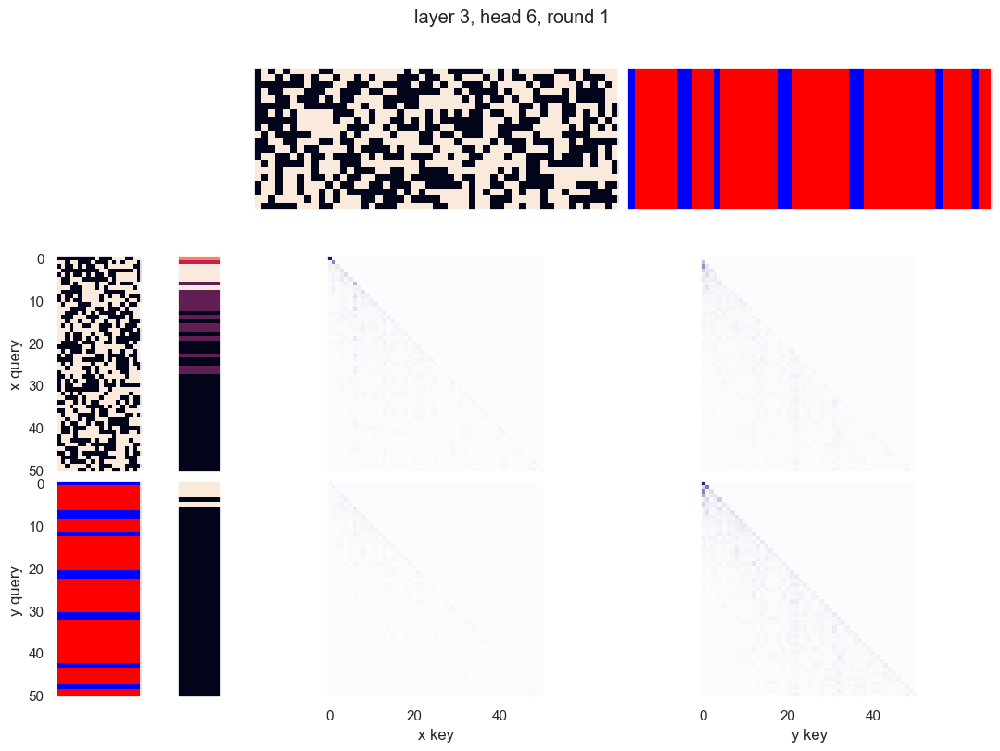

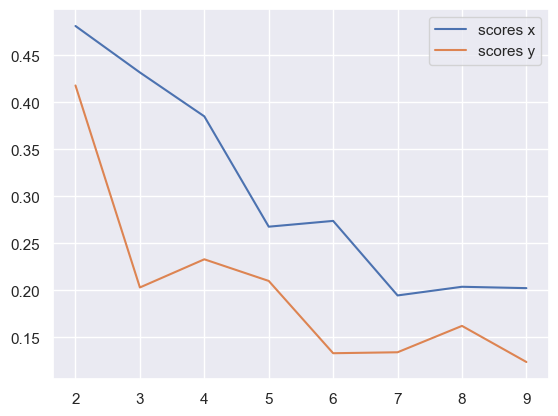

x query cluster:
SVM coefs: [-0.02810989 -0.54873503  0.73508306  0.30769769  0.32837517  0.25864072
  0.1937167   0.24594675  0.71811141  0.32036885 -0.2161386   0.58284853
  0.3470635  -0.74748161  0.27725814 -0.49685175  0.07289957 -0.88162853
  0.25841842  0.84146357]
class1: [ 7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.65; (3) +13: 0.63; (4) +17: 0.63; (5) -0: 0.60; (6) -9: 0.60; (7) +7: 0.60; (8) +2: 0.60; (9) +14: 0.58; (10) +8: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.49; (3) -9 AND +13: 0.47; (4) +7 AND +16: 0.47; (5) +16 AND +17: 0.47; (6) -9 AND +17: 0.44; (7) +8 AND +16: 0.44; (8) -18 AND -19: 0.44; (9) +8 AND +13: 0.44; (10) +16 AND -19: 0.42
(1) -10 OR -19: 0.93; (2) +14 OR +16: 0.91; (3) -9 OR -10: 0.91; (4) +15 OR +16: 0.91; (5) -10 OR +13: 0.91; (6) +13 OR +16: 0.91; (7) +16 OR -19: 0.91; (8) +18 OR -19: 0.91; (9) +7 OR -9: 0.91; (10) +12 OR +16: 0.91
{

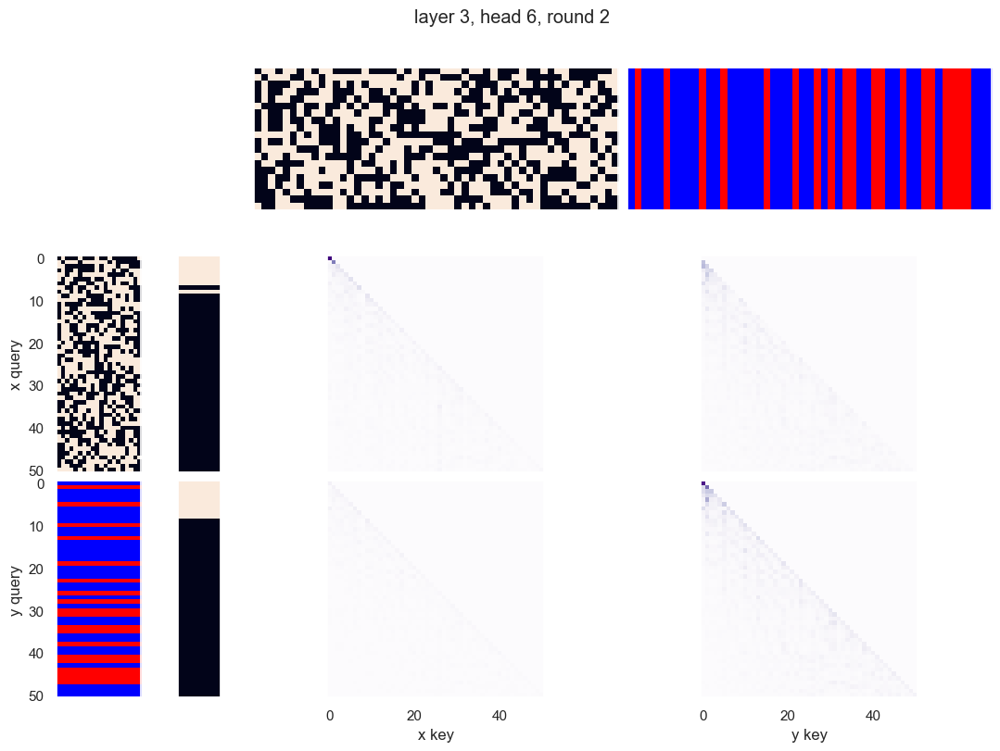

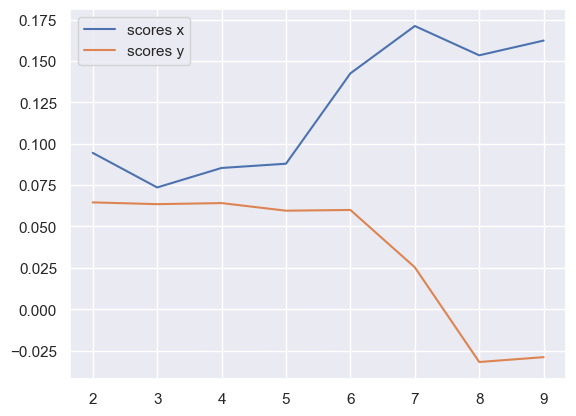

x query cluster:
SVM coefs for class 0: [-0.14216472  0.56039113 -0.07973736  0.57821551 -0.56872855  0.24338111
 -0.60187204 -0.17869636 -1.04407592 -0.18688932 -0.67074574  0.01206801
  0.15290356  0.0341648  -0.14723237  0.09657293  0.24963957  0.08272809
 -0.47838801 -0.13954808]\class elements: [26 27 28 29 30 40 41 42 44 47 48]
(1) +5: 1.00; (2) -8: 0.91; (3) -19: 0.82; (4) -9: 0.82; (5) -16: 0.73; (6) -15: 0.73; (7) -6: 0.73; (8) -18: 0.64; (9) +1: 0.64; (10) -14: 0.64
(1) +5 AND -8: 0.91; (2) +5 AND -19: 0.82; (3) +5 AND -9: 0.82; (4) -8 AND -9: 0.73; (5) +5 AND -16: 0.73; (6) +5 AND -15: 0.73; (7) +5 AND -6: 0.73; (8) -8 AND -15: 0.73; (9) -8 AND -19: 0.73; (10) +5 AND -18: 0.64
(1) +5 OR +15: 1.00; (2) -3 OR -19: 1.00; (3) -8 OR -16: 1.00; (4) -8 OR +15: 1.00; (5) -4 OR +5: 1.00; (6) +4 OR +5: 1.00; (7) -8 OR -14: 1.00; (8) +4 OR -6: 1.00; (9) -8 OR +13: 1.00; (10) +1 OR +5: 1.00
{7.0: 0.06482339626977177, 11.0: 0.0676433537512573, 8.0: 0.2504277726118082, 13.0: 0.14112765092

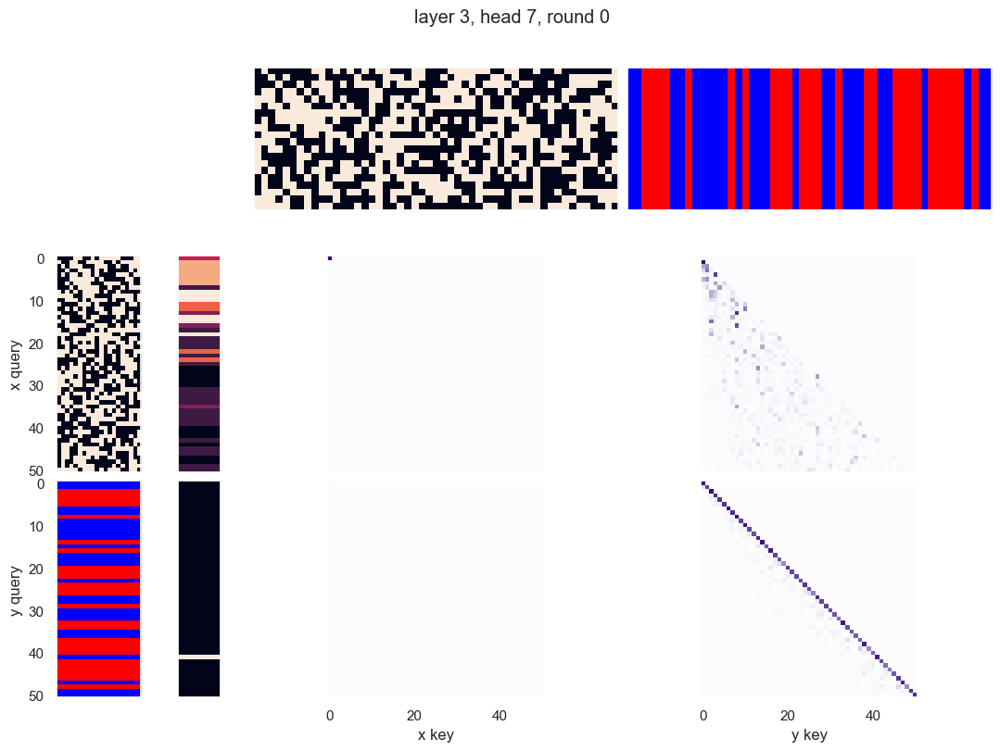

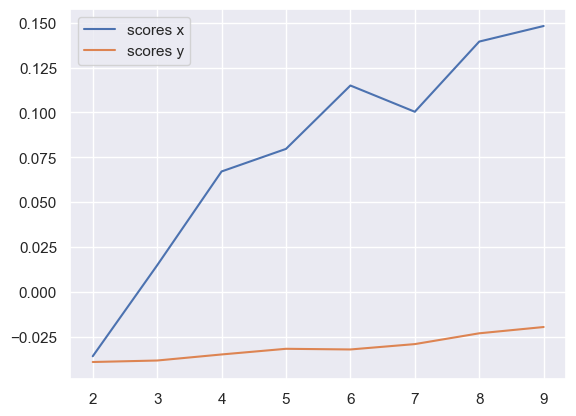

x query cluster:
SVM coefs for class 0: [-0.16851959  0.20983976 -0.03582217  0.44952525 -0.30660339 -0.09914649
 -0.28857393  0.39637952  0.31196598  0.12293844  0.17298817  0.1575307
  0.08134398 -0.22932702  0.31779883 -0.40261105 -0.33961259 -0.01802516
 -0.09258141  0.06056336]\class elements: [34 44 46]
(1) -0: 1.00; (2) -19: 1.00; (3) -9: 1.00; (4) -8: 1.00; (5) -6: 1.00; (6) +15: 1.00; (7) -1: 1.00; (8) +17: 1.00; (9) +2: 1.00; (10) -18: 1.00
(1) -0 AND -1: 1.00; (2) -9 AND +17: 1.00; (3) -9 AND +15: 1.00; (4) -8 AND -19: 1.00; (5) -8 AND -18: 1.00; (6) -8 AND +17: 1.00; (7) -8 AND +15: 1.00; (8) -0 AND +15: 1.00; (9) -8 AND -9: 1.00; (10) -0 AND +17: 1.00
(1) -0 OR -1: 1.00; (2) -6 OR -19: 1.00; (3) +6 OR -18: 1.00; (4) -6 OR +18: 1.00; (5) -6 OR -18: 1.00; (6) +6 OR +17: 1.00; (7) -6 OR +17: 1.00; (8) -6 OR -17: 1.00; (9) -6 OR +16: 1.00; (10) -6 OR -16: 1.00
{0.0: 0.9984453339129687}
SVM coefs for class 1: [-0.00443332 -0.28412289  0.52480544 -0.95605921 -0.14995616 -0.70959

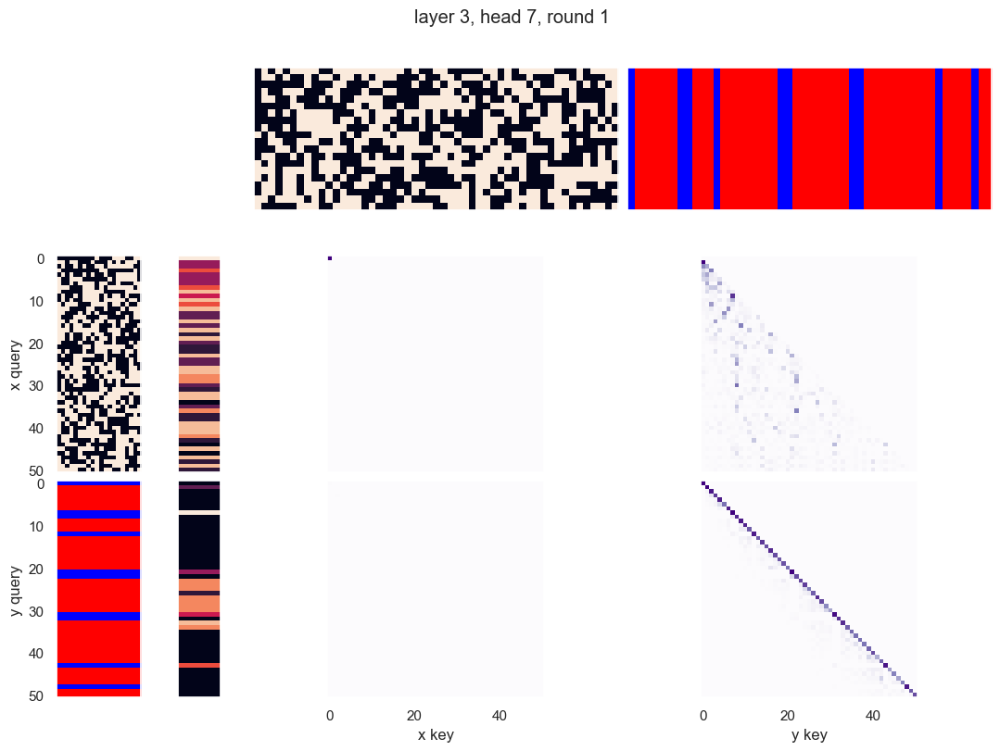

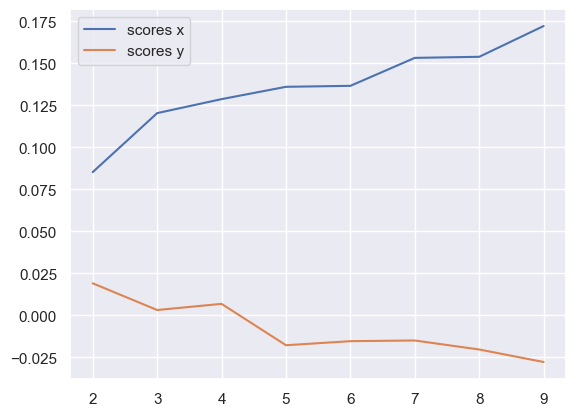

x query cluster:
SVM coefs for class 0: [ 0.22407181 -0.02721041 -0.48754897 -0.14390766 -0.05100319 -0.18152931
 -0.16834488 -0.02231216 -0.25227538 -0.1543623  -0.11452036 -0.18553964
 -0.2573994  -0.15789044  0.05889252 -0.1669526  -0.24510513 -0.09145966
 -0.37821853  0.04504553]\class elements: [ 8 15 17 18 24 25 34 35 36 41 42 43 44 46 48 49]
(1) +8: 1.00; (2) -0: 0.81; (3) +13: 0.75; (4) -5: 0.75; (5) +16: 0.75; (6) -19: 0.75; (7) +17: 0.75; (8) +12: 0.69; (9) +6: 0.69; (10) +1: 0.62
(1) -0 AND +8: 0.81; (2) -5 AND +8: 0.75; (3) +8 AND +13: 0.75; (4) +8 AND +16: 0.75; (5) +8 AND +17: 0.75; (6) +8 AND -19: 0.75; (7) +6 AND +8: 0.69; (8) +8 AND +12: 0.69; (9) -0 AND +13: 0.69; (10) +13 AND +17: 0.62
(1) +8 OR -15: 1.00; (2) +3 OR +8: 1.00; (3) +8 OR -9: 1.00; (4) +7 OR -19: 1.00; (5) +3 OR +13: 1.00; (6) -10 OR +13: 1.00; (7) +1 OR +8: 1.00; (8) -1 OR +8: 1.00; (9) -4 OR +8: 1.00; (10) +8 OR +9: 1.00
{0.0: 0.9984746032459951}
SVM coefs for class 1: [ 0.0266537   0.45851266  0.4046

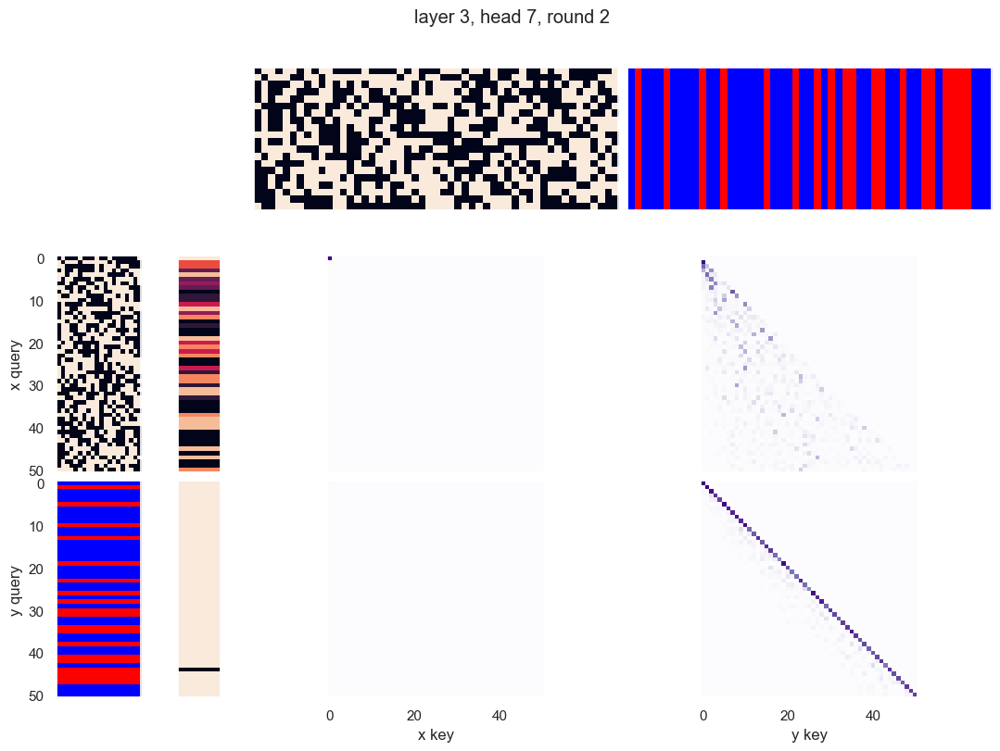

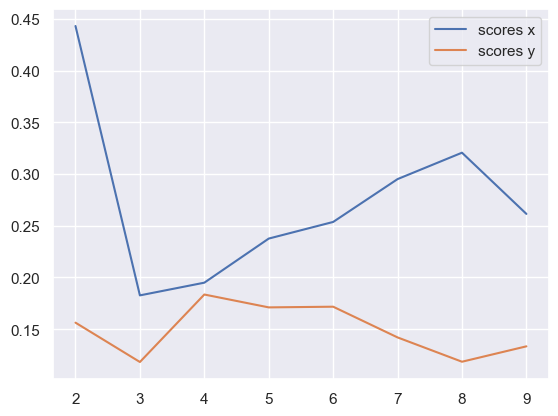

x query cluster:
SVM coefs: [ 2.32154208e-01  4.20210713e-01 -7.42618718e-01 -4.45013787e-01
 -2.98553161e-01 -3.58289722e-01 -1.10680408e-01 -1.84910925e-01
 -8.03328758e-01 -1.45546027e-01  4.82854861e-01 -6.11612530e-01
 -2.99704579e-01  6.64190576e-01  3.04101574e-02  3.04023181e-05
  1.14828786e-01  5.54176448e-01 -5.13599276e-01 -6.00331173e-01]
class1: [0 1 2 3 4 5 6 7]
(1) -0: 0.88; (2) +17: 0.75; (3) +7: 0.75; (4) +5: 0.75; (5) +4: 0.75; (6) +19: 0.75; (7) -2: 0.75; (8) -1: 0.75; (9) +9: 0.62; (10) +3: 0.62
(1) -0 AND +5: 0.75; (2) -0 AND -1: 0.62; (3) -0 AND -15: 0.62; (4) -0 AND -16: 0.62; (5) -0 AND +17: 0.62; (6) -0 AND +19: 0.62; (7) -1 AND +5: 0.62; (8) -1 AND +7: 0.62; (9) -1 AND +17: 0.62; (10) -0 AND -13: 0.62
(1) -0 OR -1: 1.00; (2) +4 OR -10: 1.00; (3) +4 OR +9: 1.00; (4) +4 OR +7: 1.00; (5) +4 OR +6: 1.00; (6) +4 OR +5: 1.00; (7) +3 OR -16: 1.00; (8) +3 OR -15: 1.00; (9) +3 OR +11: 1.00; (10) +3 OR +5: 1.00
{7.0: 0.6885474468581377, 11.0: 0.03126837289892137, 8.0: 

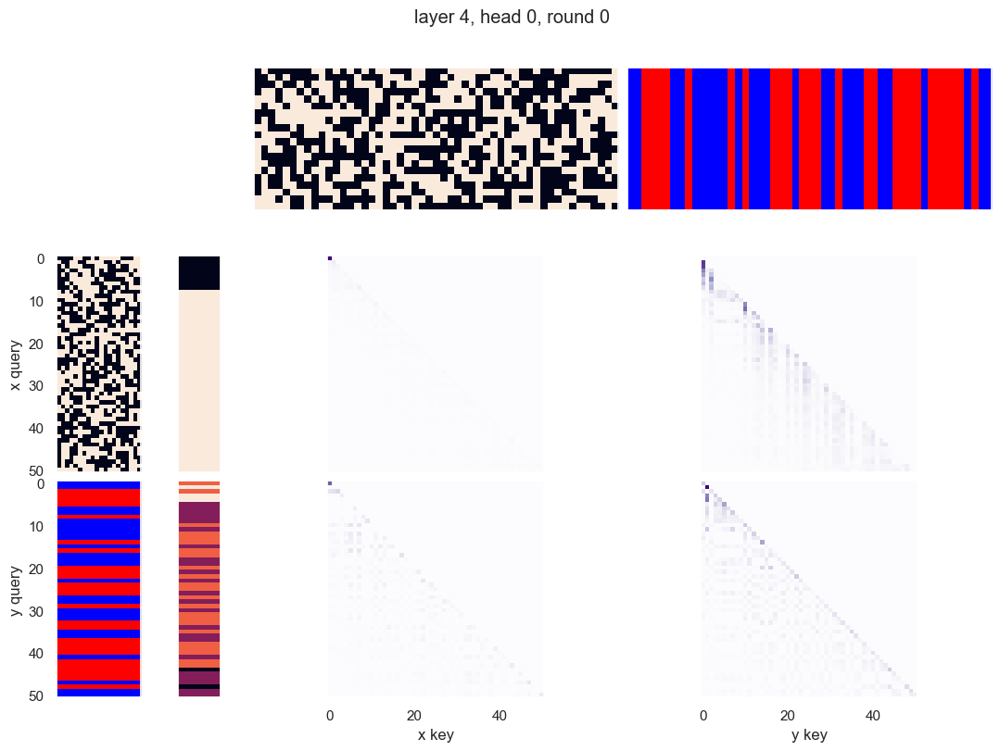

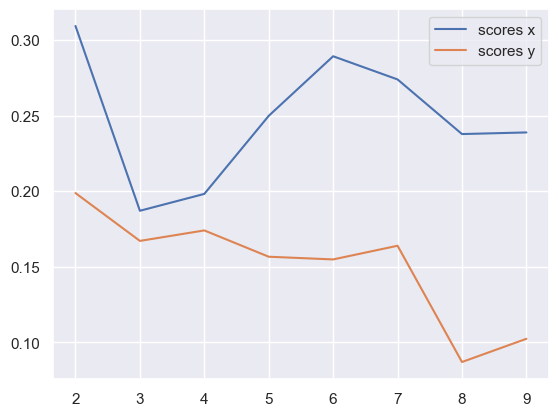

x query cluster:
SVM coefs: [ 0.26635676 -0.22436025  0.09219398  0.02503697 -0.01575758  0.24769451
  0.49764945  0.26657796  0.34239812  0.13987545  0.02835199  0.13855098
 -0.27046611 -0.396945   -0.08006986 -0.34737216 -0.23190138 -0.18714193
  0.21241657  0.31565076]
class1: [ 0 12 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36
 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) -16: 0.66; (2) +13: 0.66; (3) +14: 0.63; (4) +19: 0.61; (5) +0: 0.61; (6) -12: 0.58; (7) +5: 0.58; (8) +9: 0.58; (9) -3: 0.58; (10) -4: 0.55
(1) +5 AND -16: 0.45; (2) +0 AND +9: 0.45; (3) +9 AND +13: 0.45; (4) -3 AND +19: 0.45; (5) +0 AND -16: 0.45; (6) +13 AND -16: 0.45; (7) -8 AND +13: 0.42; (8) +0 AND +13: 0.42; (9) +13 AND +14: 0.42; (10) -3 AND +14: 0.39
(1) -12 OR +13: 0.92; (2) +13 OR +19: 0.92; (3) -16 OR +19: 0.92; (4) +14 OR -16: 0.92; (5) +0 OR +14: 0.89; (6) +13 OR +17: 0.89; (7) +1 OR +13: 0.89; (8) +9 OR -12: 0.89; (9) +6 OR -16: 0.89; (10) +14 OR +17: 0.89
{0.0: 0.869780017973

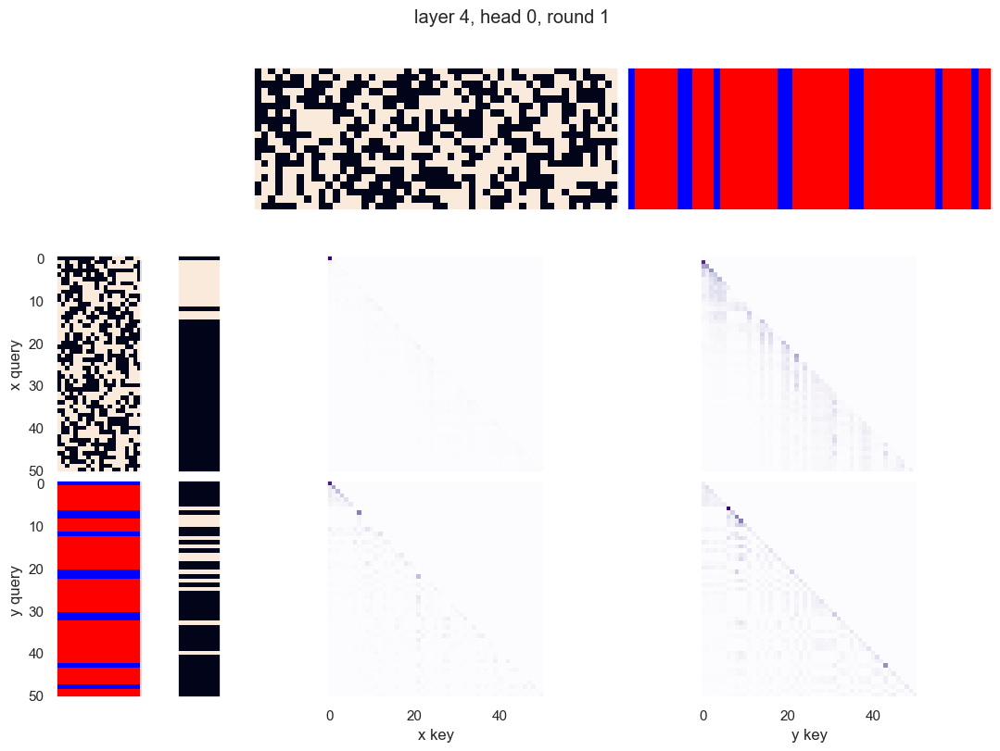

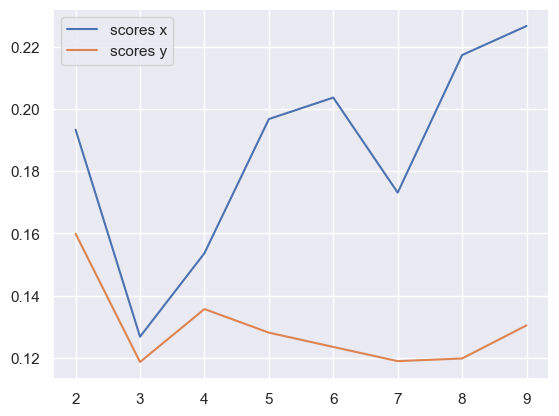

x query cluster:
SVM coefs for class 0: [-0.55587517  0.77456384 -0.4168592   0.20886522  0.63206881  0.19816654
  0.47361217  0.30369525 -0.11680622 -0.19201428  0.07394624 -0.60585043
 -0.66036791 -0.00874068  0.03945899 -0.61018039 -0.7220116  -0.28003731
 -0.31849401  0.2325564 ]\class elements: [41 43 44 45 46 47 48 49 50]
(1) -19: 0.89; (2) -0: 0.78; (3) +8: 0.78; (4) +16: 0.78; (5) +17: 0.78; (6) +12: 0.67; (7) -5: 0.67; (8) -15: 0.67; (9) +13: 0.67; (10) +7: 0.67
(1) +8 AND -19: 0.78; (2) -5 AND -19: 0.67; (3) -0 AND +10: 0.67; (4) +16 AND -19: 0.67; (5) -0 AND +13: 0.67; (6) +10 AND -19: 0.67; (7) -9 AND -19: 0.67; (8) -0 AND +17: 0.67; (9) -0 AND -19: 0.67; (10) -5 AND +8: 0.67
(1) +2 OR +8: 1.00; (2) +7 OR -19: 1.00; (3) +15 OR +16: 1.00; (4) +2 OR -5: 1.00; (5) +8 OR +12: 1.00; (6) -15 OR +17: 1.00; (7) -1 OR -19: 1.00; (8) +8 OR +14: 1.00; (9) +1 OR +17: 1.00; (10) -1 OR +16: 1.00
{0.0: 0.9066221826974596}
SVM coefs for class 1: [ 0.51457886 -0.2457392   0.03225991 -0.2371

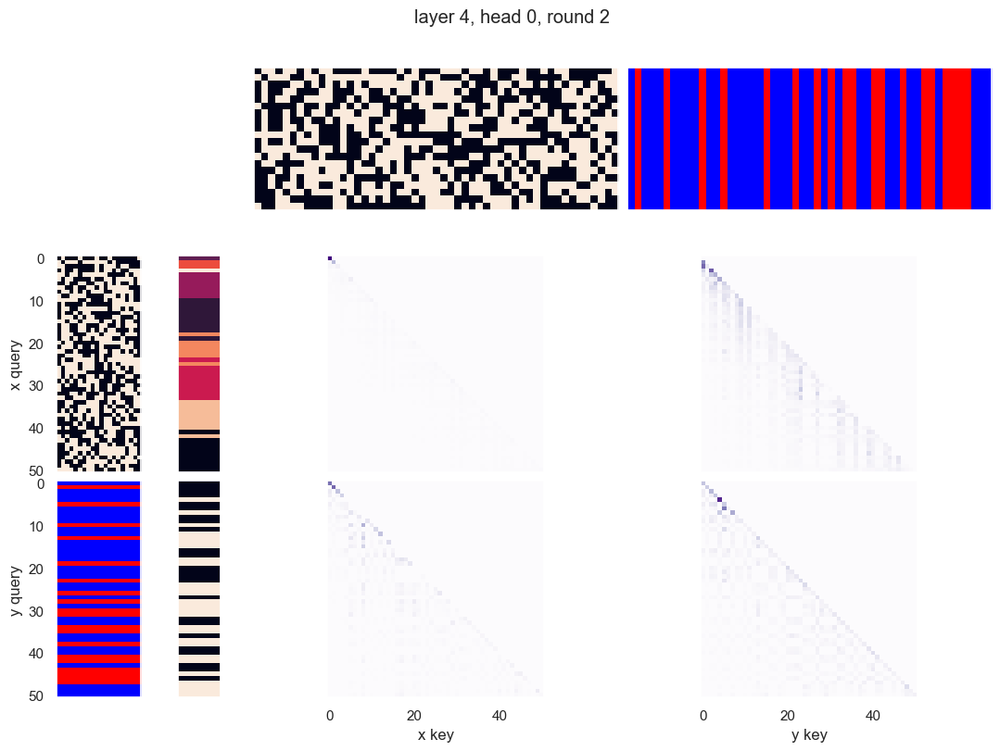

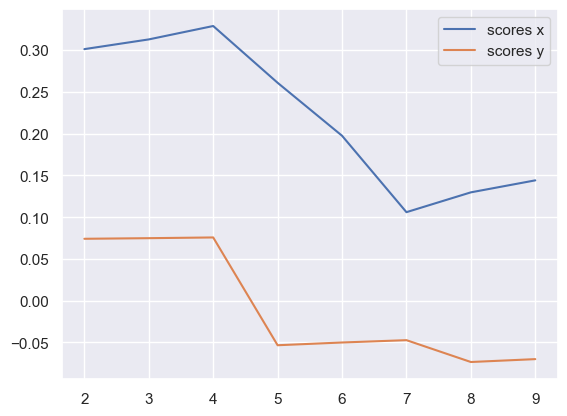

x query cluster:
SVM coefs for class 0: [ 0.23793661  0.24379808  0.14662373  0.36316892  0.10700103  0.36156045
 -0.11272745  0.31289915 -0.08053982 -0.12860428  0.08304975 -0.18070203
  0.00763389 -0.00233119 -0.24410355  0.28829901 -0.44628074  0.80728843
 -0.26491153  0.01827194]\class elements: [ 1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.75; (2) -16: 0.65; (3) +10: 0.62; (4) -12: 0.62; (5) -18: 0.60; (6) +5: 0.60; (7) -11: 0.60; (8) +6: 0.58; (9) +8: 0.56; (10) +13: 0.56
(1) +2 AND -18: 0.50; (2) +6 AND +17: 0.50; (3) -12 AND +17: 0.48; (4) -11 AND +17: 0.48; (5) +5 AND +17: 0.48; (6) -0 AND +17: 0.48; (7) -16 AND +17: 0.46; (8) -3 AND -18: 0.46; (9) -3 AND -16: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -16: 0.96; (2) +10 OR +17: 0.94; (3) +17 OR -19: 0.94; (4) -11 OR -18: 0.94; (5) +5 OR +8: 0.94; (6) -12 OR -16: 0.94; (7) -16 OR +17: 0.94; (8) -2 OR -18: 0.94; (9) -9 O

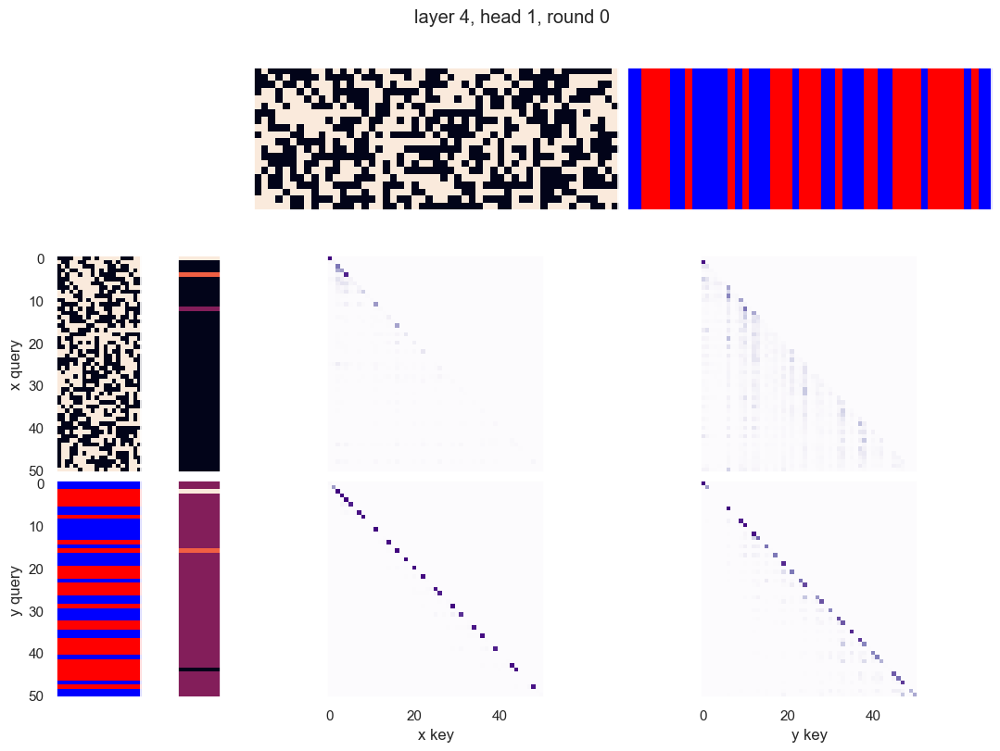

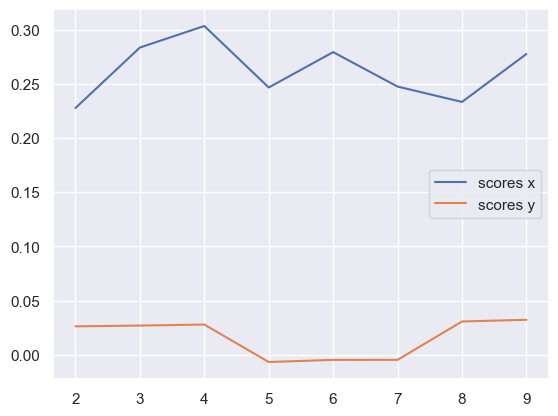

x query cluster:
SVM coefs for class 0: [ 0.0574398  -0.01352659  0.12800441  0.33600407 -0.143106   -0.03472164
 -0.18248336 -0.10421315 -0.39750164  0.21685455 -0.15500412 -0.42067958
  0.15645001  0.2100963  -0.20589648  0.07057563 -0.27828832 -0.05303039
 -0.20338113 -0.02337026]\class elements: [ 1  2  3  8  9 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39
 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.69; (2) +17: 0.63; (3) -3: 0.60; (4) +19: 0.57; (5) -16: 0.57; (6) +13: 0.57; (7) +11: 0.57; (8) -15: 0.54; (9) -12: 0.54; (10) -8: 0.54
(1) -3 AND +14: 0.43; (2) +13 AND +14: 0.43; (3) -3 AND +19: 0.40; (4) +11 AND +19: 0.40; (5) +14 AND +15: 0.40; (6) +5 AND -16: 0.40; (7) +5 AND +17: 0.40; (8) -7 AND +14: 0.40; (9) +9 AND +14: 0.40; (10) +6 AND +19: 0.40
(1) +14 OR -15: 0.94; (2) +14 OR +17: 0.94; (3) +14 OR -16: 0.91; (4) +11 OR +14: 0.91; (5) -3 OR +17: 0.91; (6) +0 OR +14: 0.89; (7) -12 OR +17: 0.89; (8) -16 OR +19: 0.89; (9) -1 OR +14: 0.89; (10) -7 OR +9: 0.89
{0.0:

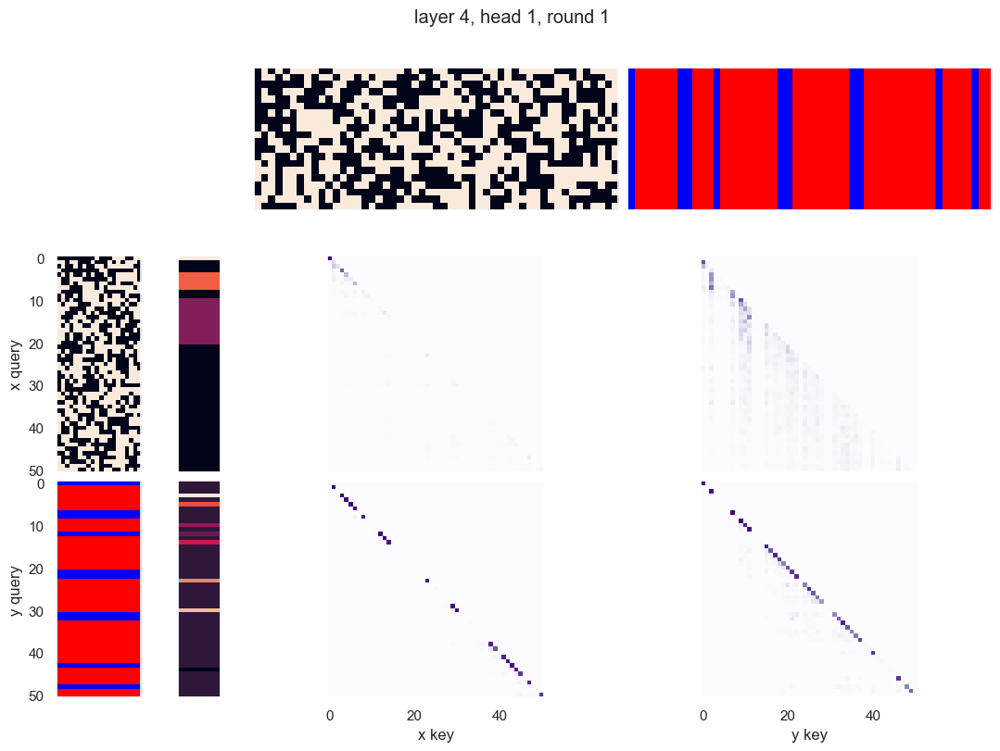

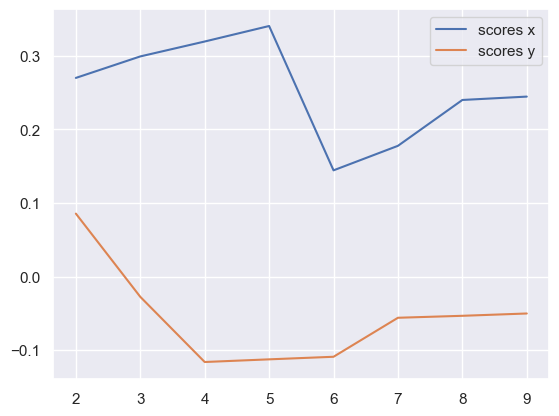

x query cluster:
SVM coefs for class 0: [ 0.06338482 -0.79177142  0.4015711   0.60036305  0.24472806 -0.06304001
  0.11161005  0.84975304  0.25430281  0.14735194 -0.16692767  0.08816731
  0.04909569 -0.41129283 -0.11877707 -0.08697079 -0.20195679 -0.1632698
 -0.23848295 -0.26054337]\class elements: [1 3 5 6 7 8]
(1) -18: 0.83; (2) +14: 0.83; (3) -5: 0.83; (4) +9: 0.67; (5) +8: 0.67; (6) +12: 0.67; (7) -7: 0.67; (8) +4: 0.67; (9) -3: 0.67; (10) +2: 0.67
(1) +14 AND -18: 0.67; (2) -3 AND +14: 0.67; (3) +8 AND -18: 0.67; (4) +12 AND +14: 0.67; (5) -5 AND +8: 0.67; (6) -5 AND +14: 0.67; (7) +2 AND -18: 0.67; (8) -7 AND +14: 0.67; (9) +10 AND -18: 0.67; (10) -7 AND +17: 0.67
(1) -7 OR -17: 1.00; (2) -5 OR -16: 1.00; (3) -5 OR -15: 1.00; (4) -5 OR +14: 1.00; (5) +9 OR +12: 1.00; (6) -5 OR +12: 1.00; (7) -1 OR +14: 1.00; (8) -5 OR +17: 1.00; (9) +13 OR +14: 1.00; (10) -5 OR +10: 1.00
{0.0: 0.47351274320196046}
SVM coefs for class 1: [ 0.38953263 -0.49628368 -0.399281   -0.95711795 -0.04726945

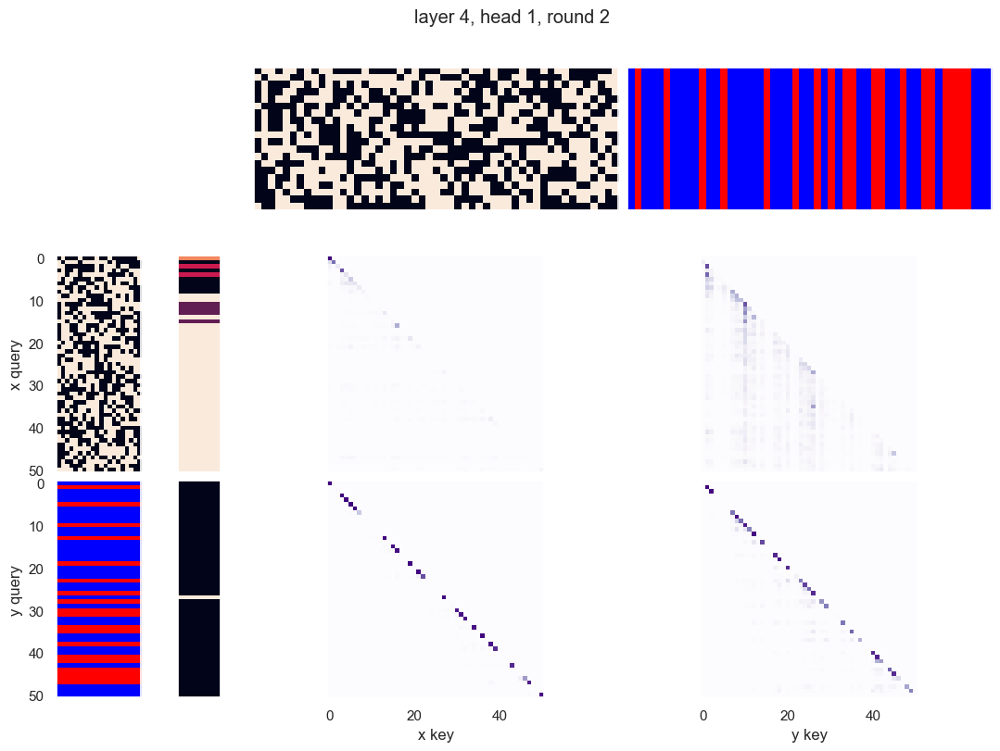

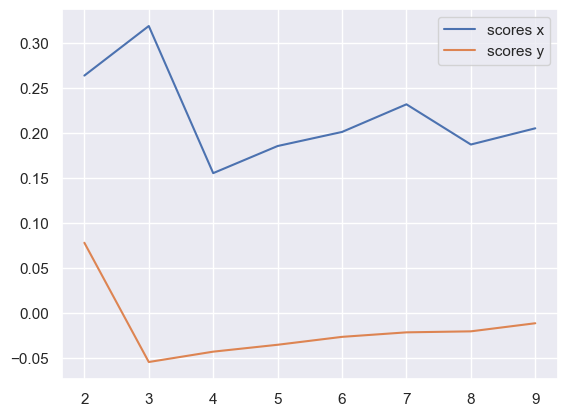

x query cluster:
SVM coefs for class 0: [-0.39810195  0.41806876 -0.26081005  0.20728908 -0.15344155 -0.37961345
 -0.29654828 -0.24388062 -0.46517155 -0.13402837  0.04498578 -0.30869283
  0.43867232  0.49255416 -0.08529092  0.57331606  0.07826156  0.23030404
 -0.35436953 -0.0786126 ]\class elements: [14 17 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40
 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.74; (2) -11: 0.68; (3) +10: 0.68; (4) -16: 0.68; (5) +13: 0.62; (6) +5: 0.62; (7) -3: 0.59; (8) -9: 0.59; (9) -0: 0.59; (10) +1: 0.56
(1) -11 AND +17: 0.53; (2) -16 AND +17: 0.47; (3) -0 AND +17: 0.47; (4) +13 AND -18: 0.47; (5) -9 AND +10: 0.47; (6) +2 AND -18: 0.47; (7) +13 AND +17: 0.47; (8) +8 AND +17: 0.47; (9) -3 AND -16: 0.47; (10) -3 AND -18: 0.47
(1) -11 OR -16: 1.00; (2) +10 OR +17: 0.97; (3) -9 OR +17: 0.97; (4) -3 OR -11: 0.97; (5) +5 OR -11: 0.94; (6) +15 OR -16: 0.94; (7) -16 OR +17: 0.94; (8) +4 OR +17: 0.94; (9) +10 OR -11: 0.94; (10) -11 OR -18: 0.94
{7.0: 0.1

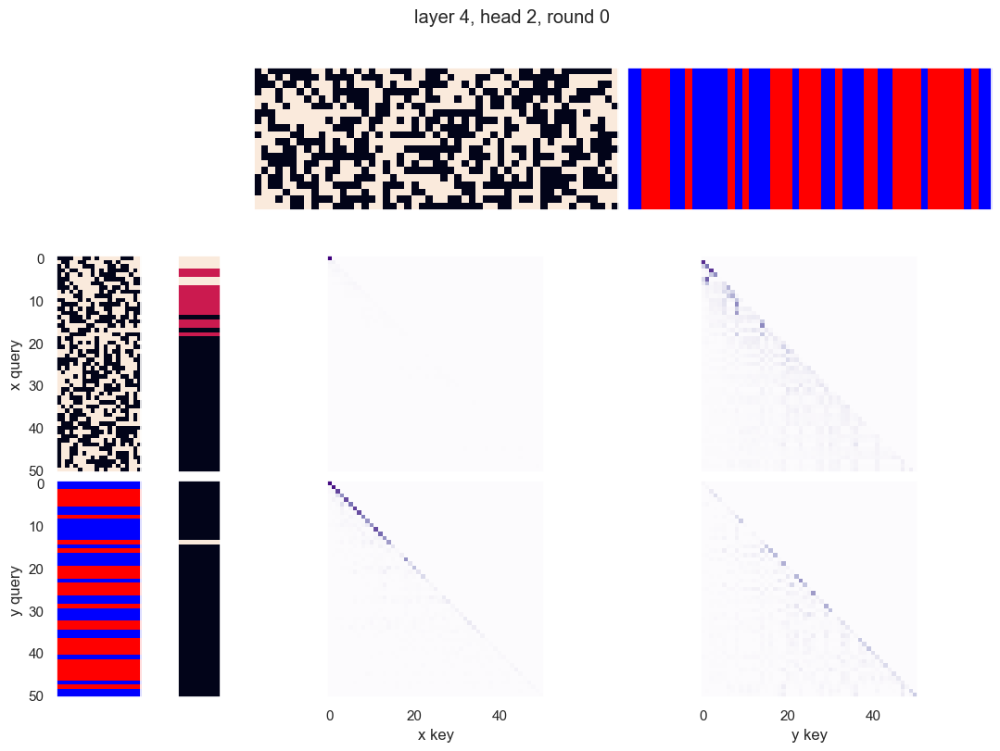

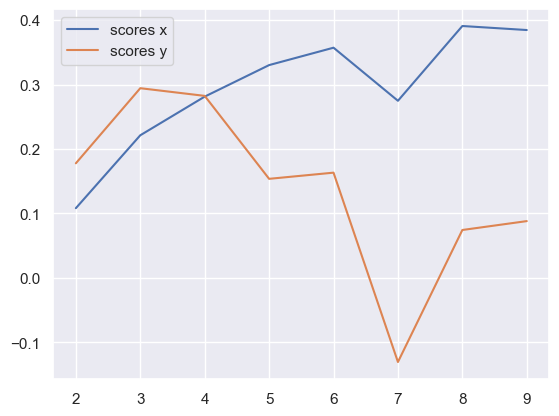

x query cluster:
SVM coefs for class 0: [-0.14916842 -0.09639285 -0.12269349  0.00380013 -0.19520844 -0.21276814
 -0.18711057 -0.00703434 -0.16531984  0.07006522 -0.24149463  0.0121835
  0.1049628   0.07292049 -0.00061111 -0.02831943 -0.3168071   0.03953904
 -0.13656751  0.06776108]\class elements: [32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.74; (2) +0: 0.68; (3) -10: 0.68; (4) +9: 0.63; (5) -16: 0.63; (6) +2: 0.63; (7) +15: 0.63; (8) -4: 0.63; (9) -18: 0.58; (10) +17: 0.58
(1) +0 AND +9: 0.53; (2) +0 AND -16: 0.53; (3) +14 AND +15: 0.53; (4) -10 AND +14: 0.53; (5) +0 AND +14: 0.53; (6) +0 AND -10: 0.53; (7) +9 AND -10: 0.47; (8) +14 AND -18: 0.47; (9) +8 AND +14: 0.47; (10) -1 AND -10: 0.47
(1) +14 OR +17: 1.00; (2) +0 OR +2: 1.00; (3) +2 OR -16: 1.00; (4) +2 OR +8: 0.95; (5) +0 OR +15: 0.95; (6) +14 OR +19: 0.95; (7) +14 OR -16: 0.95; (8) -10 OR +15: 0.95; (9) +2 OR +9: 0.95; (10) +2 OR -12: 0.95
{0.0: 0.9499078430648966}
SVM coefs for class 1: [ 0.25036464 

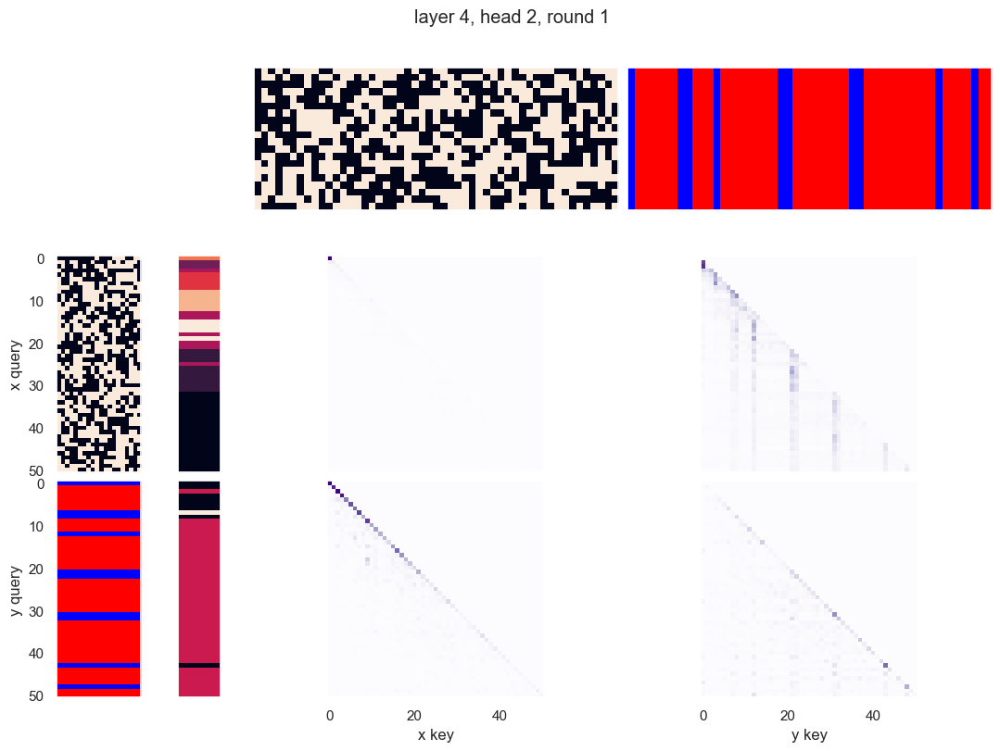

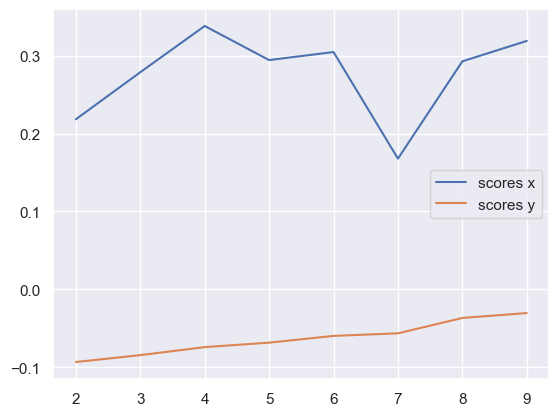

x query cluster:
SVM coefs for class 0: [ 0.17235735 -0.05017646 -0.14008073  0.4154169  -0.184059    0.18698601
 -0.14326807 -0.03439273 -0.24570301  0.44729528 -0.14081961 -0.29094247
  0.24380695  0.58370701  0.08288076 -0.25752644 -0.67451891 -0.16009882
 -0.55064694 -0.35059756]\class elements: [ 0  1  3  6  8 11 13 14 19 21 23 24 27 28 29 30 31 32 33 34 35 36 37 38
 39 40 41 42 43 44 45 46 47 48 49 50]
(1) -0: 0.69; (2) +17: 0.61; (3) +16: 0.61; (4) -3: 0.61; (5) -11: 0.61; (6) -18: 0.58; (7) +2: 0.58; (8) -19: 0.58; (9) +12: 0.56; (10) -10: 0.56
(1) -0 AND +17: 0.47; (2) +16 AND +17: 0.47; (3) -11 AND +16: 0.42; (4) -0 AND -11: 0.42; (5) +8 AND -19: 0.42; (6) +2 AND -18: 0.42; (7) -0 AND +14: 0.42; (8) -3 AND +12: 0.42; (9) +8 AND +13: 0.42; (10) -0 AND +16: 0.42
(1) -0 OR -10: 0.92; (2) -10 OR -19: 0.92; (3) -3 OR +8: 0.92; (4) -0 OR +2: 0.92; (5) -0 OR -15: 0.92; (6) +9 OR -19: 0.92; (7) -0 OR +7: 0.89; (8) +8 OR -13: 0.89; (9) -0 OR -11: 0.89; (10) +2 OR +17: 0.89
{0.0: 0.918

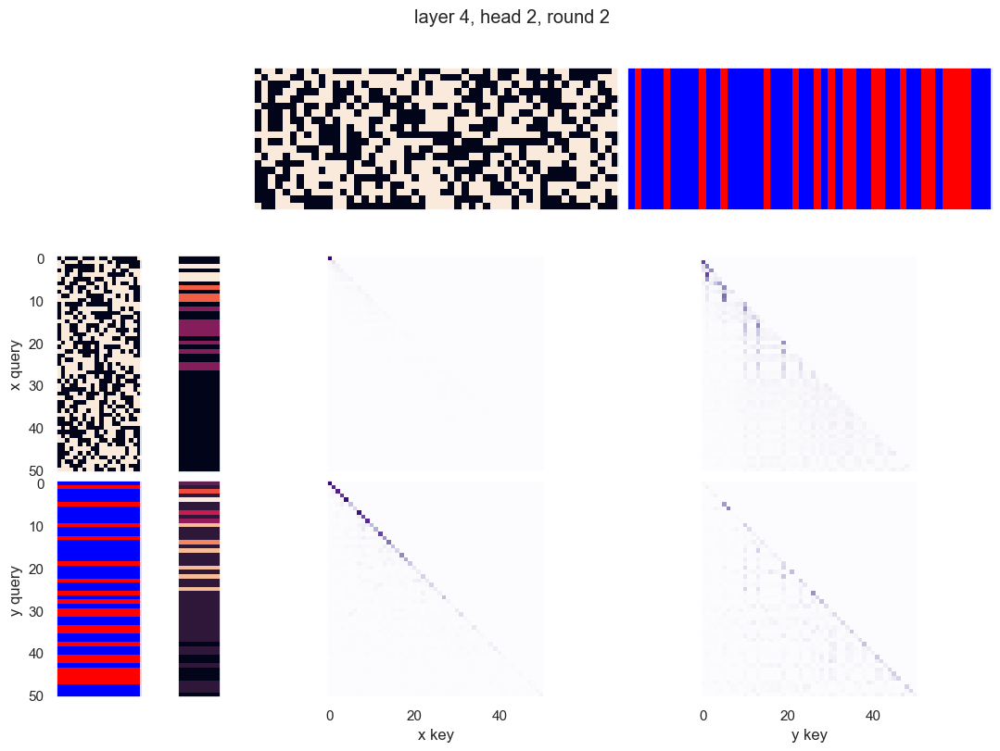

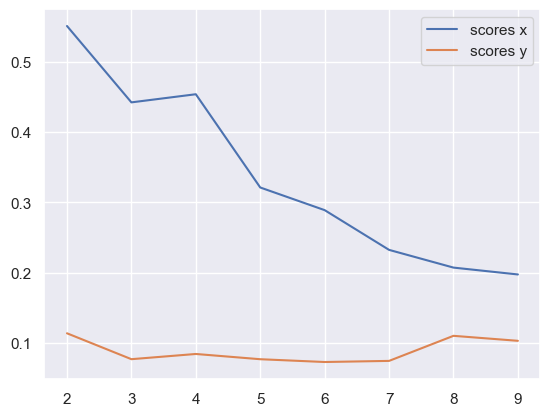

x query cluster:
SVM coefs: [-2.32159419e-01 -4.20213745e-01  7.42617697e-01  4.45010922e-01
  2.98554835e-01  3.58294287e-01  1.10683717e-01  1.84914027e-01
  8.03327794e-01  1.45547878e-01 -4.82855431e-01  6.11614675e-01
  2.99705558e-01 -6.64193500e-01 -3.04129206e-02 -2.92437156e-05
 -1.14824623e-01 -5.54179339e-01  5.13597408e-01  6.00331053e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) +10: 0.65; (3) -16: 0.65; (4) -12: 0.63; (5) -18: 0.63; (6) -11: 0.63; (7) +13: 0.60; (8) +2: 0.60; (9) -3: 0.60; (10) +6: 0.58
(1) +2 AND -18: 0.53; (2) -3 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) +13 AND -18: 0.49; (5) +6 AND +17: 0.47; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.44; (8) -16 AND -18: 0.44; (9) -12 AND -18: 0.44; (10) +17 AND -18: 0.44
(1) -11 OR -18: 0.95; (2) -11 OR -16: 0.95; (3) +10 OR -11: 0.93; (4) -2 OR -18: 0.93; (5) +10 OR +17: 0.93; (6) -16 OR +17: 0.93; (7)

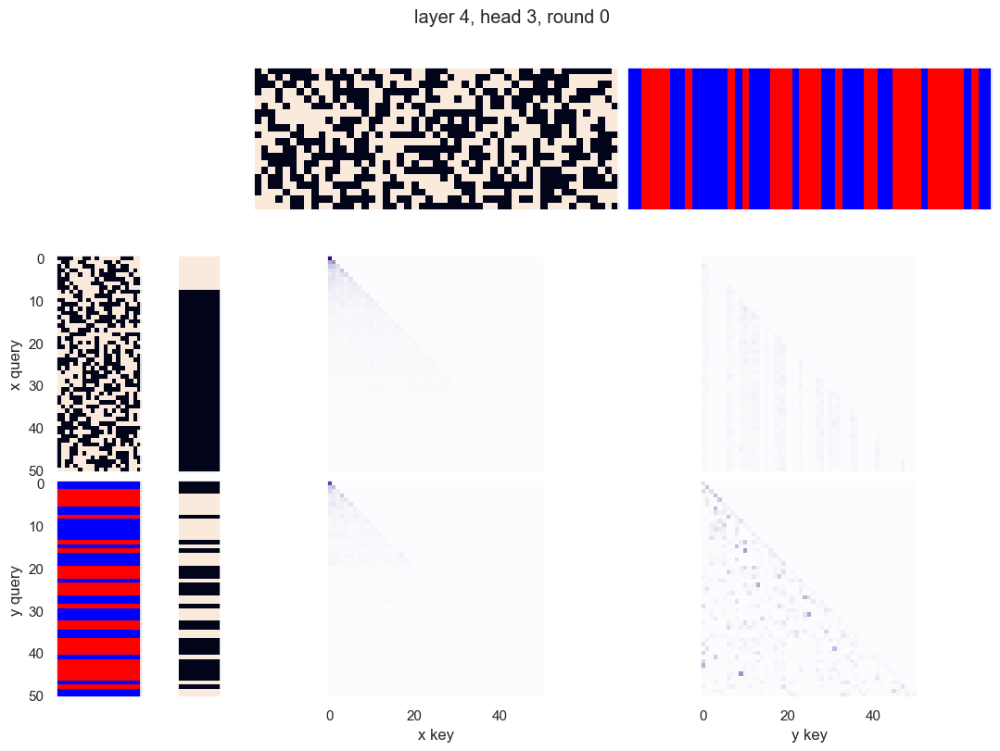

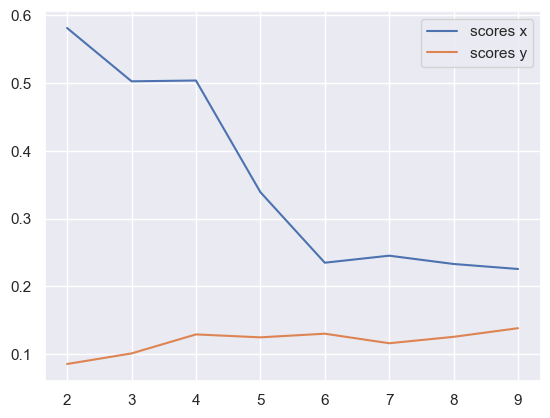

x query cluster:
SVM coefs: [-0.2879447  -0.4731398   1.02874237  0.3831073   0.32285274  0.25921547
  0.01952123  0.00169167  0.67963087  0.27149246 -0.32584285  0.59225382
  0.27770202 -0.56682752  0.12307676 -0.05073688  0.26541558 -0.64575722
  0.50792714  0.61018076]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +13: 0.64; (4) +19: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +9: 0.59; (8) -3: 0.59; (9) +6: 0.57; (10) +11: 0.55
(1) +0 AND +9: 0.45; (2) -3 AND +19: 0.45; (3) +9 AND +13: 0.43; (4) +13 AND +14: 0.43; (5) +0 AND +13: 0.41; (6) +9 AND +14: 0.41; (7) +13 AND -18: 0.41; (8) +0 AND -12: 0.41; (9) -12 AND -15: 0.41; (10) +5 AND -16: 0.41
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +6 OR -16: 0.89; (6) +7 OR -12: 0.89; (7) +14 OR +19: 0.89; (8) +14 OR +17: 0.89; (9) +14 OR -16: 0.89; (10) +0 OR +17: 0.89


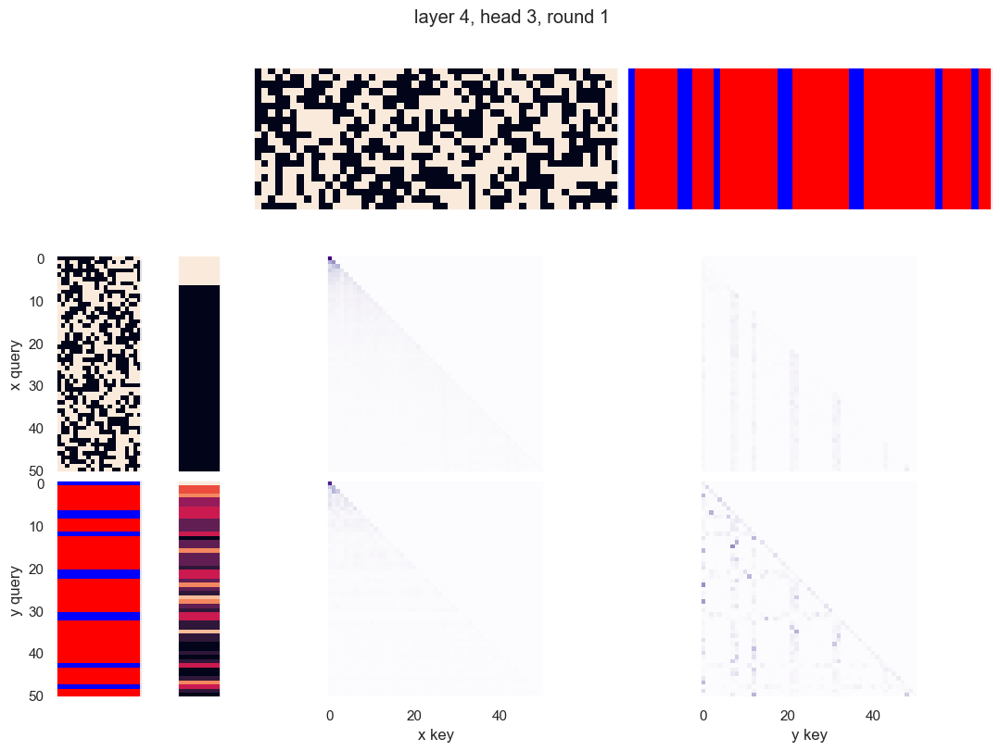

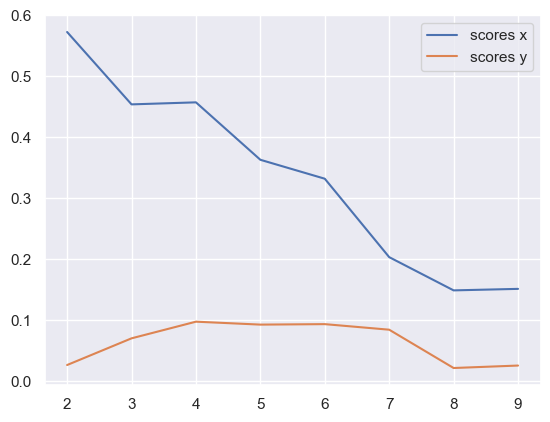

x query cluster:
SVM coefs: [-0.28793739 -0.4731379   1.02873796  0.38310451  0.32285573  0.25921129
  0.0195207   0.00168741  0.67963958  0.27148994 -0.32584106  0.59225047
  0.27770356 -0.56682769  0.12307737 -0.05074124  0.26542545 -0.64575877
  0.50792664  0.61017692]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) -19: 0.66; (3) +17: 0.64; (4) +13: 0.64; (5) +2: 0.61; (6) -0: 0.61; (7) +8: 0.59; (8) -9: 0.59; (9) +7: 0.59; (10) +14: 0.59
(1) +17 AND -19: 0.50; (2) -9 AND -19: 0.48; (3) +16 AND +17: 0.48; (4) -9 AND +13: 0.45; (5) -18 AND -19: 0.45; (6) +7 AND +16: 0.45; (7) +8 AND +13: 0.45; (8) +8 AND +16: 0.45; (9) -0 AND +16: 0.43; (10) +13 AND -19: 0.43
(1) -10 OR -19: 0.93; (2) -10 OR +13: 0.91; (3) +13 OR +16: 0.91; (4) +15 OR +16: 0.91; (5) +16 OR -19: 0.91; (6) +14 OR +16: 0.91; (7) +12 OR +16: 0.91; (8) +18 OR -19: 0.91; (9) +7 OR -19: 0.91; (10) +2 OR +16: 0.

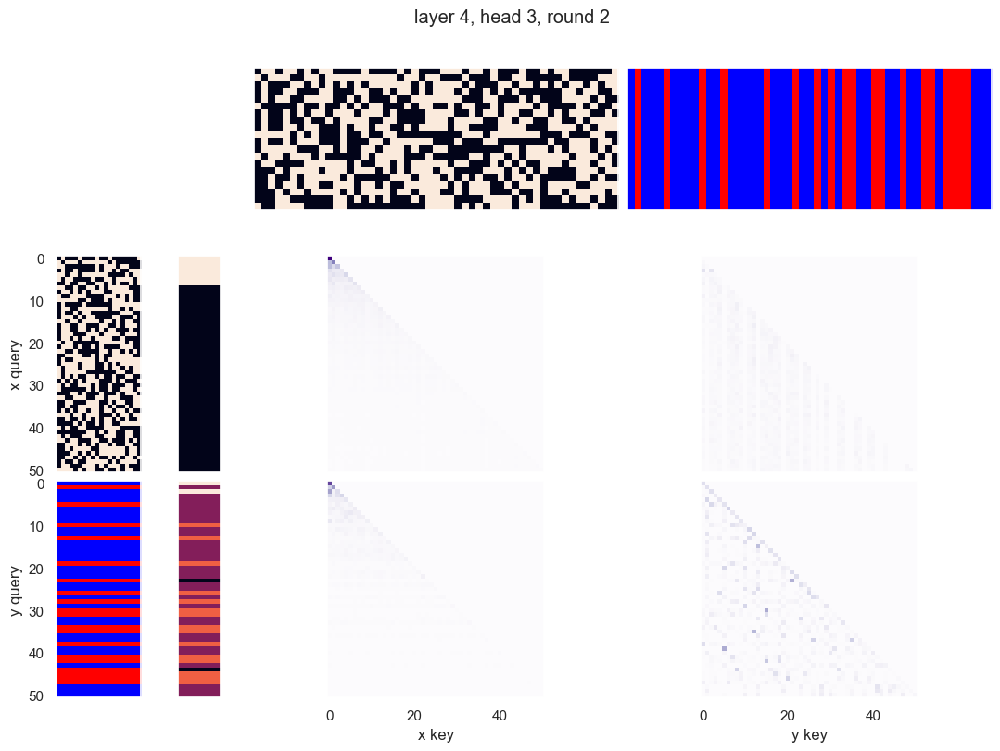

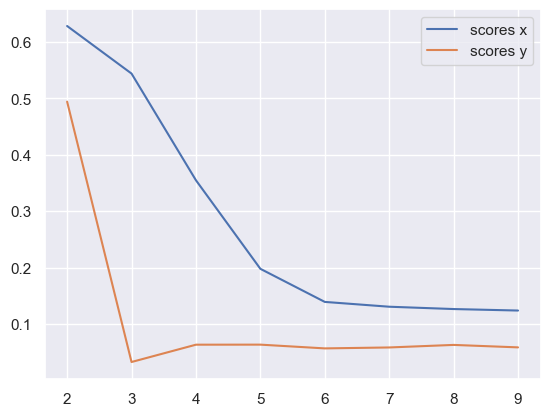

x query cluster:
SVM coefs: [-0.4686584  -0.57677924  0.27720927  0.21226386 -0.11847808 -0.05889264
  0.00723395 -0.45951905  0.42596699  0.43340938 -0.08995989  0.23646846
 -0.2449534  -0.49575358 -0.29612664  0.17306254  0.11536489 -0.67924654
  0.21284343  0.87186843]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10:

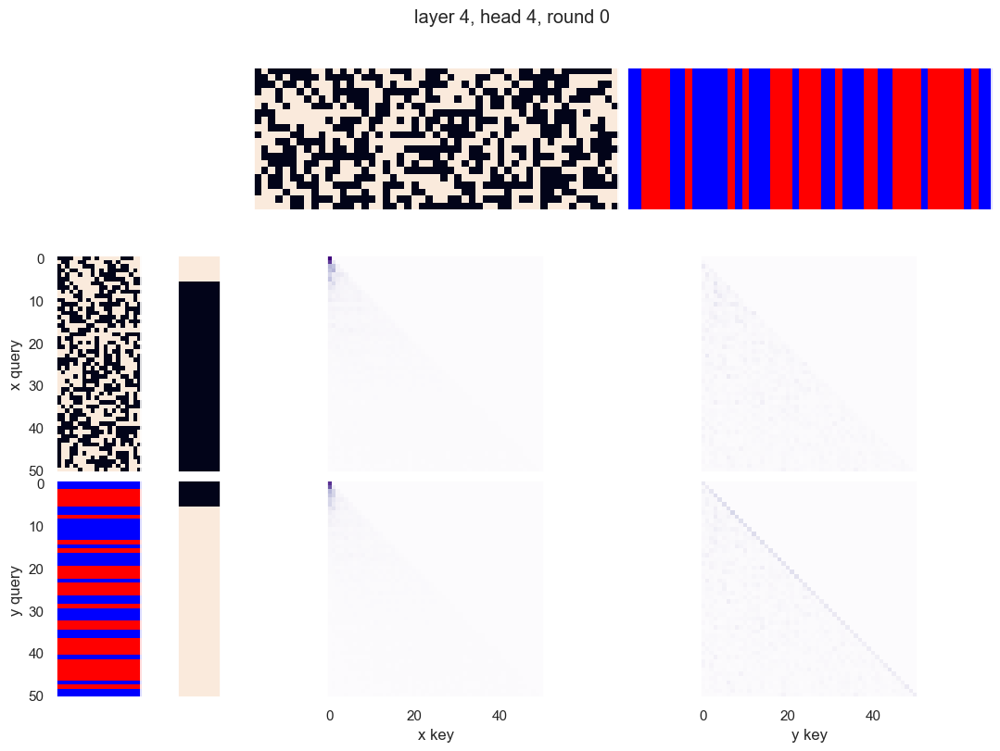

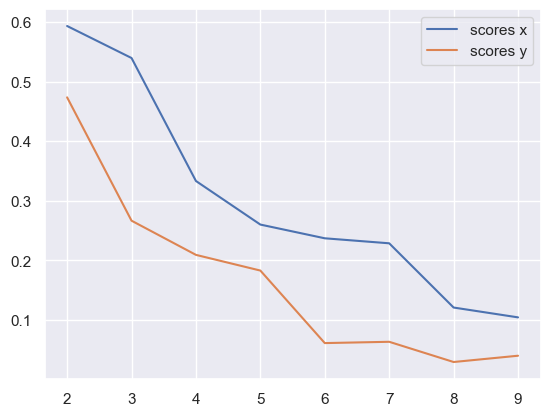

x query cluster:
SVM coefs: [-0.28794524 -0.4731407   1.02874092  0.38310697  0.32285503  0.25921058
  0.01952064  0.00168549  0.67964122  0.27149466 -0.32583969  0.59225244
  0.2777014  -0.56682858  0.1230698  -0.05074145  0.26542098 -0.64575623
  0.50792951  0.61018212]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +13: 0.64; (4) +19: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +9: 0.59; (8) -3: 0.59; (9) +6: 0.57; (10) +11: 0.55
(1) +0 AND +9: 0.45; (2) -3 AND +19: 0.45; (3) +9 AND +13: 0.43; (4) +13 AND +14: 0.43; (5) +0 AND +13: 0.41; (6) +9 AND +14: 0.41; (7) +13 AND -18: 0.41; (8) +0 AND -12: 0.41; (9) -12 AND -15: 0.41; (10) +5 AND -16: 0.41
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +6 OR -16: 0.89; (6) +7 OR -12: 0.89; (7) +14 OR +19: 0.89; (8) +14 OR +17: 0.89; (9) +14 OR -16: 0.89; (10) +0 OR +17: 0.89


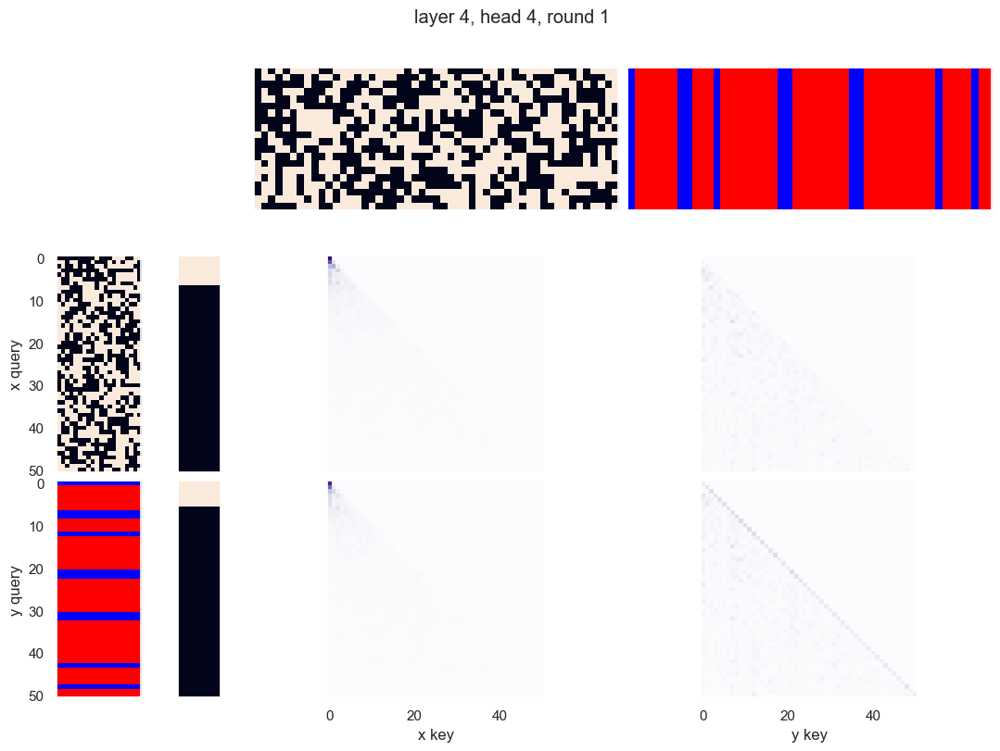

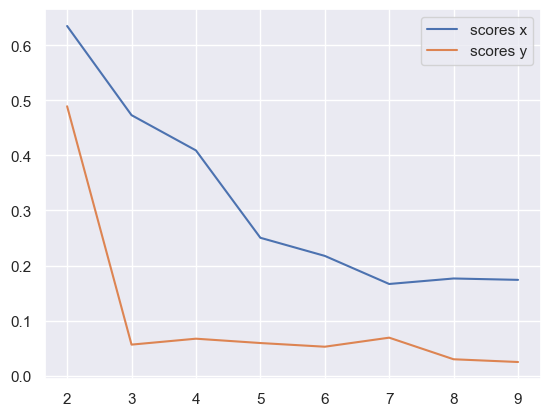

x query cluster:
SVM coefs: [ 0.10543808 -0.37931105  0.16402913  0.12083802 -0.24402825 -0.10237383
  0.08436982 -0.23418982  0.18886375  0.66354038 -0.04109537  0.52820678
 -0.17284916  0.06948968 -0.03458178 -0.08149876 -0.14971987 -0.68103641
  0.62447457  0.75904657]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

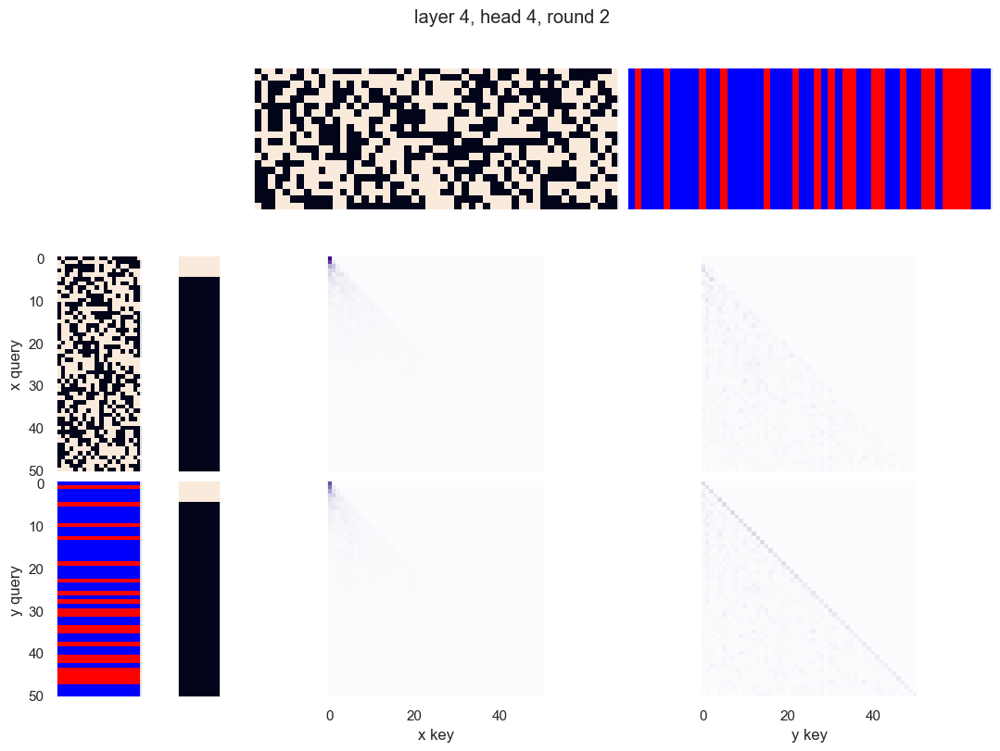

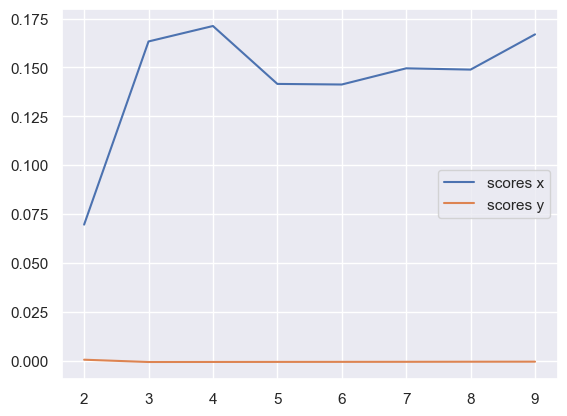

x query cluster:
SVM coefs for class 0: [ 0.00507288 -0.02610077 -0.10886713  0.33782151 -0.15406627 -0.10836734
 -0.39823371 -0.02625427 -0.37954317  0.13884175 -0.29873166 -0.11405666
  0.23329499  0.1993223  -0.05713105  0.07323026 -0.32181711 -0.00624137
 -0.44586145 -0.04556572]\class elements: [27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) -16: 0.79; (2) +17: 0.71; (3) +5: 0.67; (4) +13: 0.67; (5) -18: 0.62; (6) +10: 0.62; (7) +2: 0.62; (8) -11: 0.62; (9) -3: 0.58; (10) -15: 0.58
(1) +13 AND -16: 0.58; (2) +13 AND -18: 0.58; (3) -16 AND +17: 0.54; (4) +2 AND -18: 0.54; (5) +5 AND +13: 0.54; (6) +2 AND +13: 0.54; (7) +5 AND -16: 0.54; (8) -15 AND -16: 0.54; (9) -16 AND -18: 0.54; (10) +5 AND -18: 0.50
(1) -11 OR -16: 1.00; (2) -12 OR -16: 1.00; (3) +5 OR -11: 0.96; (4) -9 OR +17: 0.96; (5) -16 OR +17: 0.96; (6) -6 OR -16: 0.96; (7) +15 OR -16: 0.96; (8) -11 OR +13: 0.96; (9) +13 OR +14: 0.96; (10) +13 OR +18: 0.96
{7.0: 0.07863902097785316, 11.0: 0.1

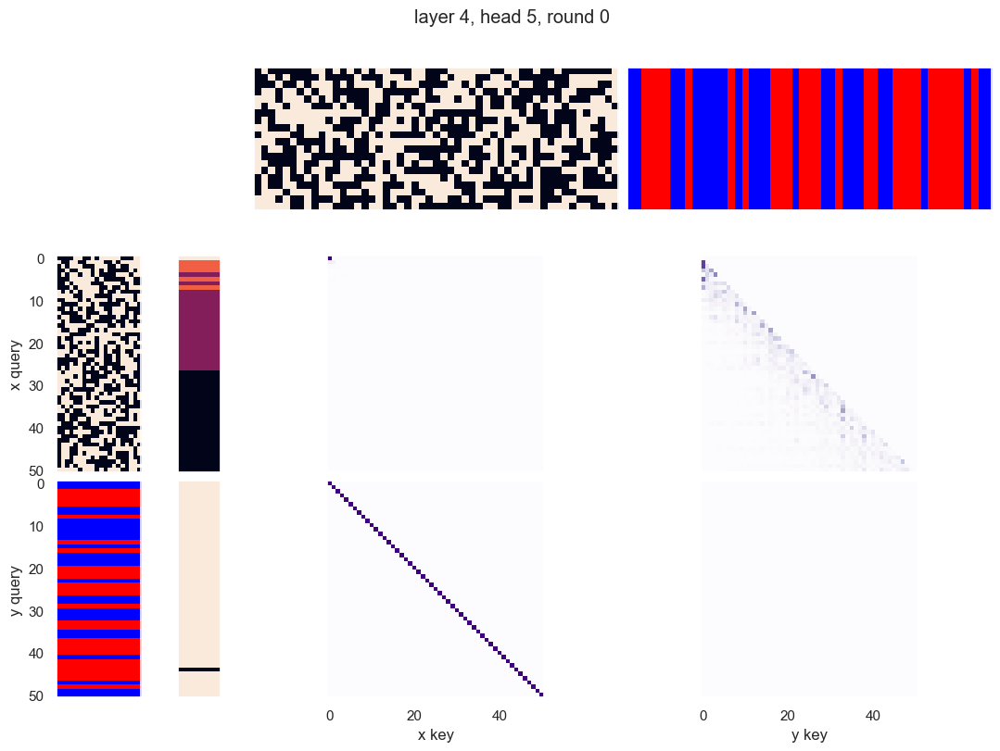

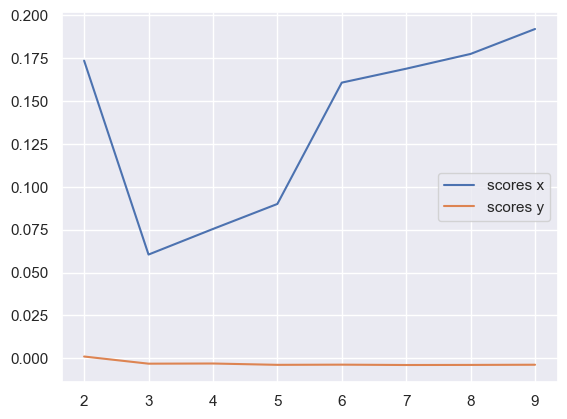

x query cluster:
SVM coefs for class 0: [-0.10339446 -0.12135691 -0.14073468  0.03748418  0.08638056  0.09297167
 -0.10548714  0.02716482 -0.02698901  0.05413702 -0.17829384 -0.14407237
  0.11086072 -0.00435636 -0.04536798 -0.14731657 -0.25632115 -0.19592033
 -0.10534394  0.01358259]\class elements: [35 38 39 40 41 43 44 45 46 47 48 49 50]
(1) +0: 0.77; (2) +14: 0.77; (3) -12: 0.77; (4) -10: 0.77; (5) -18: 0.69; (6) -16: 0.69; (7) +19: 0.62; (8) +15: 0.62; (9) -13: 0.62; (10) -4: 0.62
(1) +0 AND -12: 0.62; (2) +0 AND -16: 0.62; (3) +14 AND -18: 0.62; (4) -12 AND +14: 0.62; (5) -10 AND +14: 0.62; (6) +0 AND -10: 0.62; (7) -10 AND -18: 0.62; (8) +0 AND +9: 0.54; (9) +0 AND +14: 0.54; (10) +0 AND +19: 0.54
(1) -12 OR -18: 1.00; (2) -10 OR -13: 1.00; (3) -6 OR -12: 1.00; (4) +0 OR -9: 1.00; (5) -10 OR -12: 1.00; (6) -13 OR +14: 1.00; (7) -8 OR -12: 1.00; (8) -10 OR +19: 1.00; (9) +14 OR -16: 1.00; (10) +1 OR -10: 1.00
{0.0: 0.9997663001094209}
SVM coefs for class 1: [ 0.22021428  0.5045939

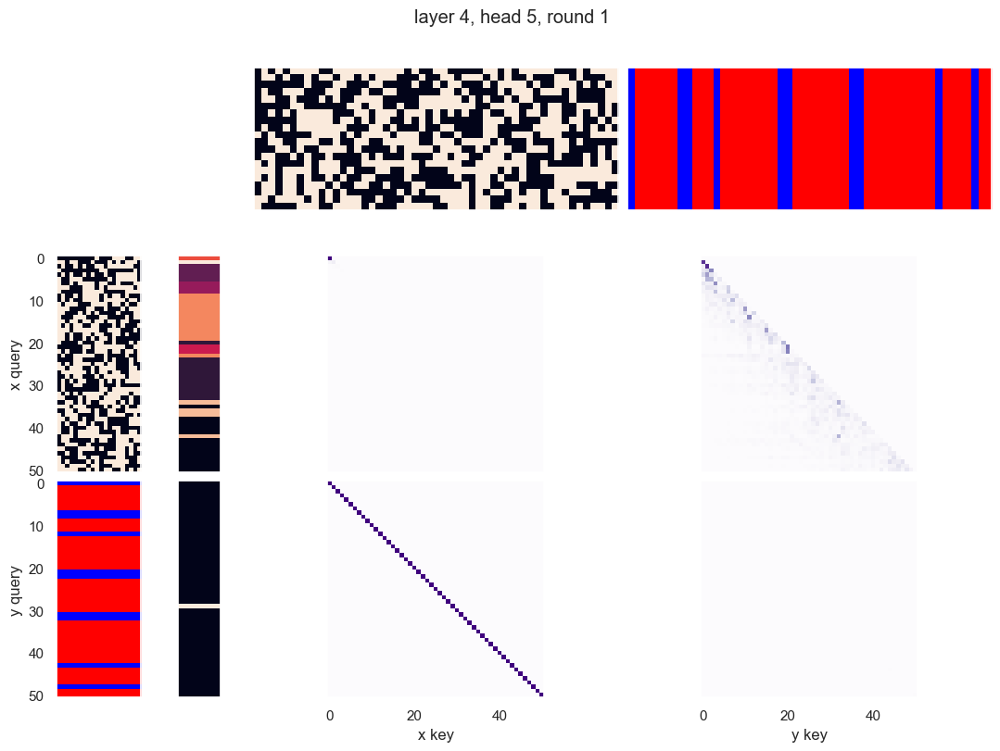

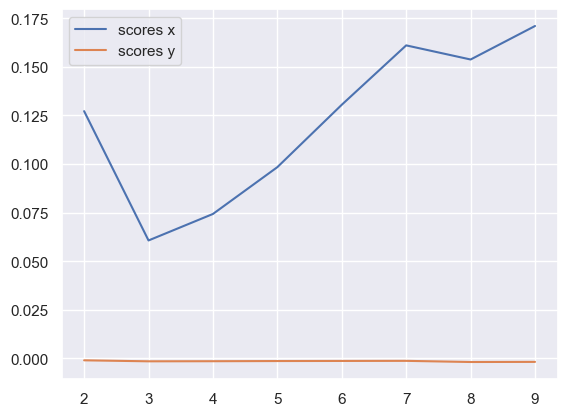

x query cluster:
SVM coefs for class 0: [-0.12554323  0.22999163 -0.24135937 -0.12805555 -0.01661962 -0.00912493
 -0.14156065  0.0127936   0.07087191  0.05613326 -0.08996816 -0.04587074
 -0.06720908 -0.02264988  0.05379916 -0.20023502 -0.22784638  0.08306803
 -0.03245515 -0.03844664]\class elements: [42 43 44 45 46 47 48 49 50]
(1) -19: 0.89; (2) +8: 0.78; (3) +16: 0.78; (4) +17: 0.78; (5) -0: 0.67; (6) +12: 0.67; (7) +11: 0.67; (8) -15: 0.67; (9) -9: 0.67; (10) +7: 0.67
(1) +8 AND -19: 0.78; (2) +16 AND -19: 0.67; (3) +11 AND +17: 0.67; (4) +13 AND -19: 0.67; (5) -15 AND +16: 0.67; (6) +11 AND -19: 0.67; (7) -5 AND -19: 0.67; (8) +8 AND +16: 0.67; (9) -9 AND -19: 0.67; (10) -5 AND +8: 0.67
(1) +2 OR +8: 1.00; (2) +15 OR +16: 1.00; (3) +2 OR -5: 1.00; (4) +7 OR -19: 1.00; (5) +2 OR +4: 1.00; (6) -15 OR +17: 1.00; (7) -1 OR -19: 1.00; (8) +1 OR +17: 1.00; (9) +8 OR +12: 1.00; (10) -1 OR +16: 1.00
{0.0: 0.9995118106147233}
SVM coefs for class 1: [ 0.48528224  0.07083039 -0.02166346  0.00

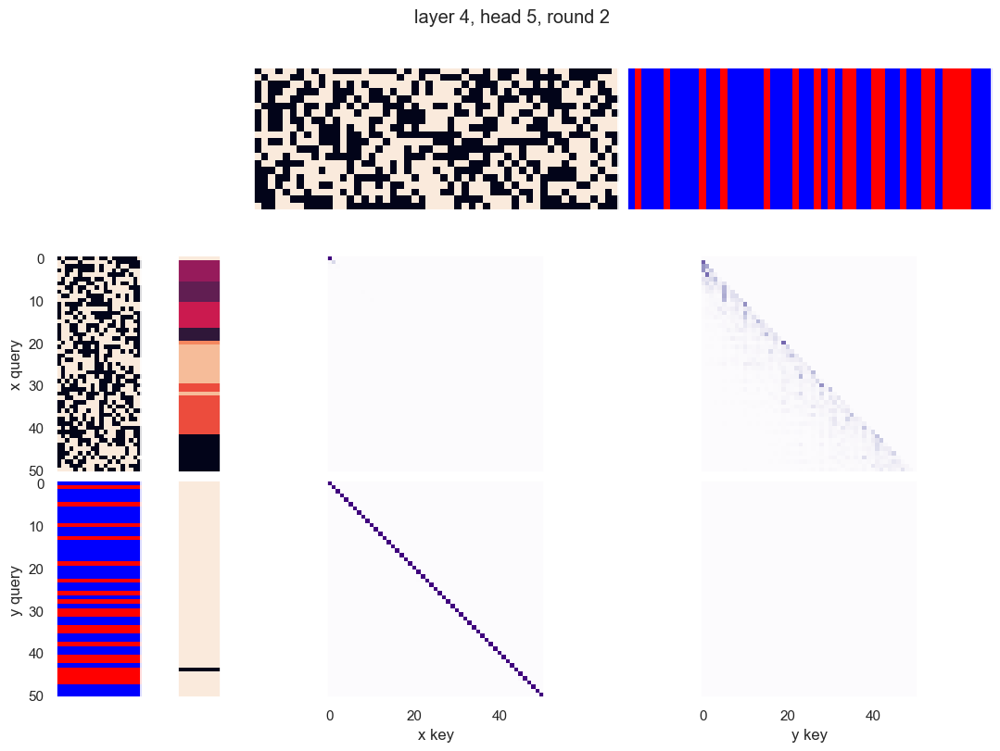

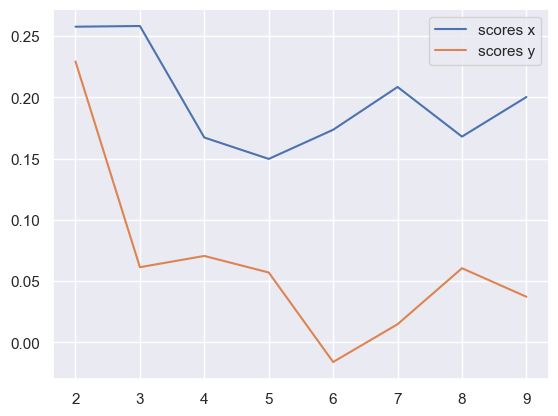

x query cluster:
SVM coefs for class 0: [-0.2783971   0.25520023 -0.1387648  -0.08876234 -0.17184108 -0.1360092
 -0.0628801  -0.1313227  -0.21470023 -0.05198017 -0.05072814 -0.08515271
  0.16286156  0.2819123  -0.0937522   0.27705402  0.03853725  0.10601482
 -0.05134767 -0.20002844]\class elements: [19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42
 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) +10: 0.69; (3) -16: 0.69; (4) -11: 0.66; (5) +5: 0.66; (6) +13: 0.62; (7) -9: 0.59; (8) -0: 0.59; (9) -3: 0.59; (10) -12: 0.56
(1) +5 AND +13: 0.50; (2) +13 AND -18: 0.50; (3) -11 AND +17: 0.50; (4) -3 AND -16: 0.47; (5) +10 AND -16: 0.47; (6) +5 AND +17: 0.47; (7) -3 AND +13: 0.47; (8) +13 AND +17: 0.47; (9) -16 AND +17: 0.47; (10) +2 AND -18: 0.47
(1) -11 OR -16: 1.00; (2) +10 OR +17: 0.97; (3) -9 OR +17: 0.97; (4) -3 OR -11: 0.97; (5) +5 OR -11: 0.94; (6) +5 OR +10: 0.94; (7) +10 OR -11: 0.94; (8) +4 OR +17: 0.94; (9) -16 OR +17: 0.94; (10) -12 OR -16: 0.94
{7.0: 0.1023102

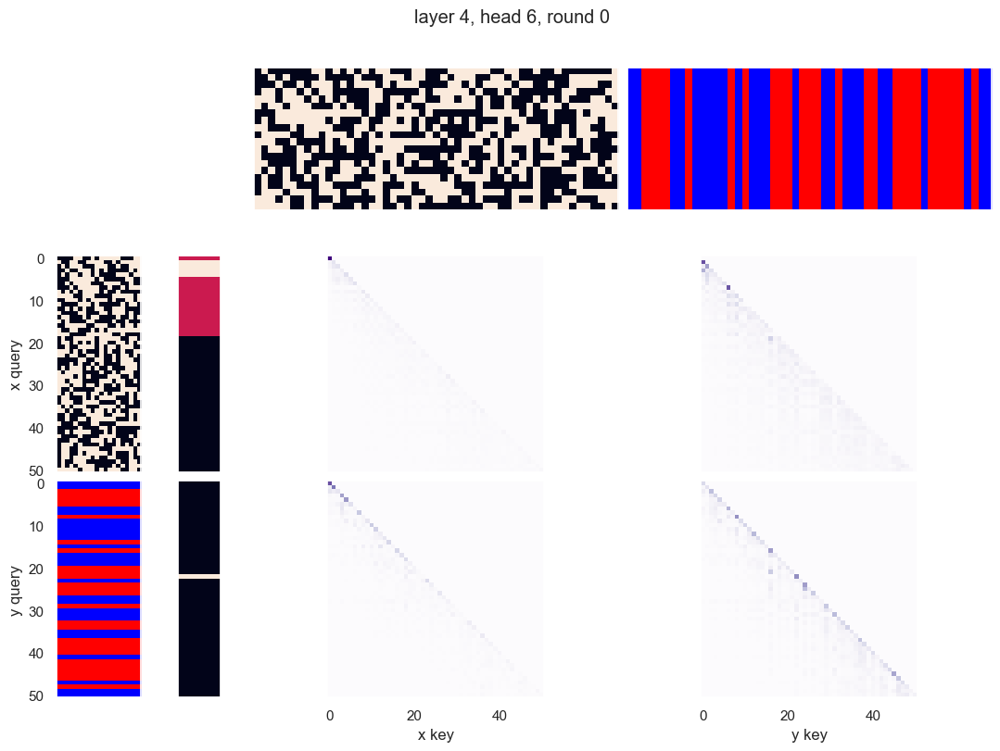

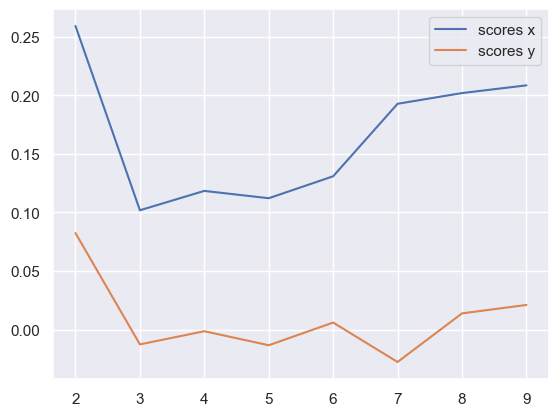

x query cluster:
SVM coefs: [ 0.78487118 -0.34787801  0.48343579 -0.16609158  0.5750458   0.81044877
  1.08420897  0.57619227  0.17027303  0.4645418   0.3903319  -0.05536196
 -1.0300361  -1.04562996 -0.11581837 -0.79334733 -0.17013788  0.34305002
  0.10911585  0.23084779]
class1: [ 0 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39
 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.69; (2) -16: 0.66; (3) +13: 0.66; (4) +19: 0.60; (5) +5: 0.60; (6) +17: 0.57; (7) -12: 0.57; (8) -8: 0.57; (9) +9: 0.57; (10) -4: 0.57
(1) +13 AND -16: 0.46; (2) +13 AND +14: 0.46; (3) +5 AND -16: 0.46; (4) +9 AND +13: 0.43; (5) -3 AND +19: 0.43; (6) -8 AND +13: 0.43; (7) +0 AND -16: 0.43; (8) +0 AND +9: 0.43; (9) -3 AND +14: 0.43; (10) -4 AND +14: 0.43
(1) +14 OR +17: 0.94; (2) +14 OR -16: 0.94; (3) +14 OR -15: 0.94; (4) -16 OR +19: 0.94; (5) +11 OR +14: 0.91; (6) +13 OR +19: 0.91; (7) +5 OR +14: 0.91; (8) -12 OR +13: 0.91; (9) +2 OR -16: 0.89; (10) +5 OR +13: 0.89
{0.0: 0.7245211198568413}
c

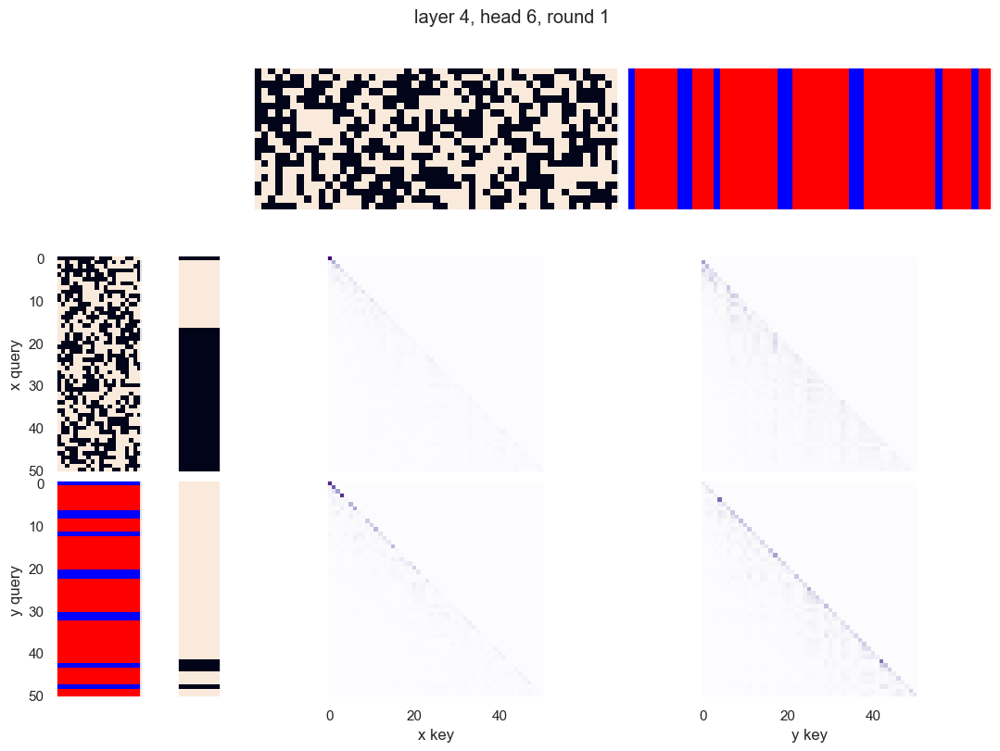

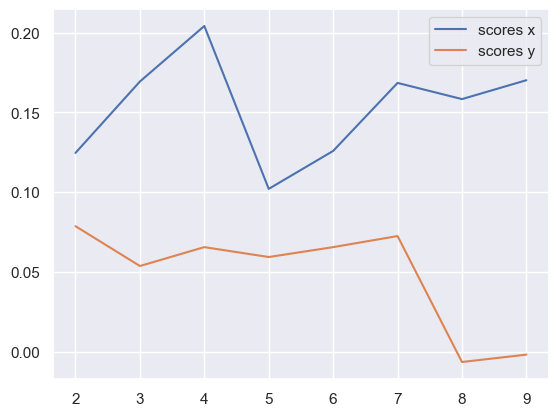

x query cluster:
SVM coefs for class 0: [ 7.45681166e-03  2.75781699e-01  2.14171609e-01 -7.61582587e-02
 -2.37763908e-02  3.12551258e-02 -1.73702595e-01  3.46149935e-01
 -1.44407670e-02 -4.76674790e-01 -1.52609493e-01  1.93046814e-01
  2.88738307e-01  1.57880566e-01 -4.71618270e-02 -3.47931183e-04
  4.27169629e-01  1.87893777e-01 -9.74355655e-02 -3.77932868e-01]\class elements: [ 5  6  7  8  9 10 13 15 16 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.69; (2) +17: 0.67; (3) -19: 0.64; (4) +2: 0.62; (5) -18: 0.60; (6) +14: 0.60; (7) -0: 0.57; (8) -9: 0.57; (9) +8: 0.57; (10) +7: 0.57
(1) +17 AND -19: 0.50; (2) +16 AND +17: 0.50; (3) +8 AND +16: 0.48; (4) +7 AND +16: 0.45; (5) -18 AND -19: 0.45; (6) -5 AND +16: 0.45; (7) -9 AND -19: 0.45; (8) +16 AND -19: 0.45; (9) +17 AND -18: 0.45; (10) -5 AND -19: 0.43
(1) +15 OR +16: 0.93; (2) -10 OR -19: 0.93; (3) +12 OR +16: 0.93; (4) +14 OR +16: 0.93; (5) +6 OR +16: 0.90; (6) +4 OR 

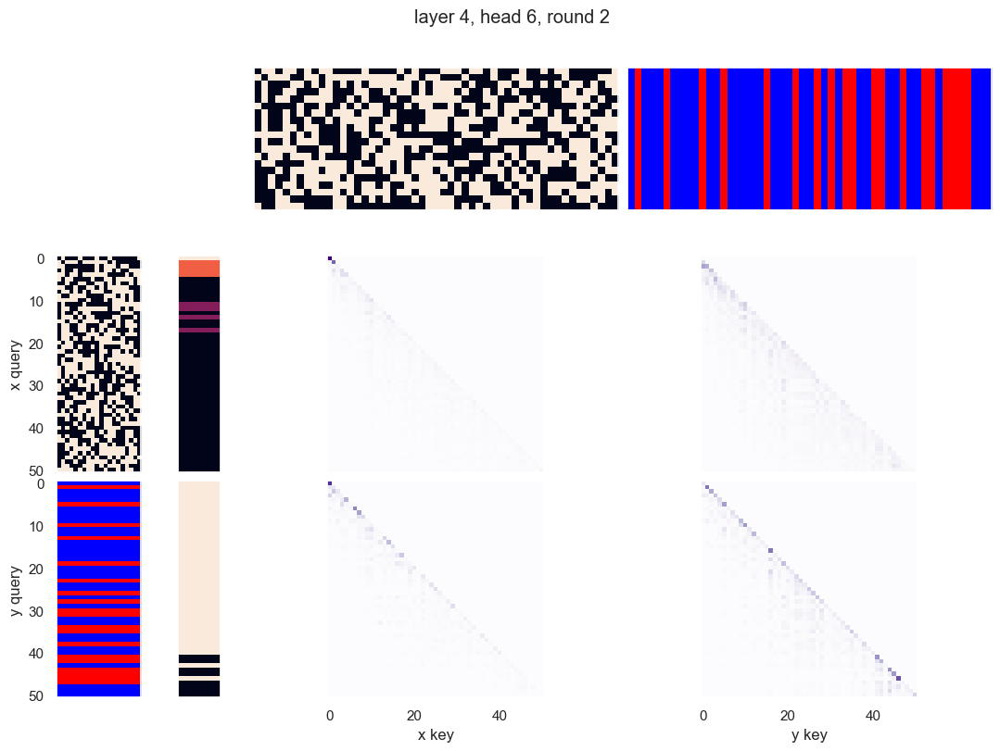

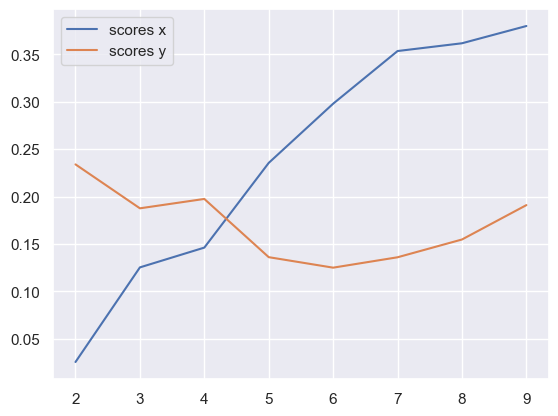

x query cluster:
SVM coefs for class 0: [-0.03578991  0.40362642 -0.56703579  0.3509651   0.39145393  0.16858059
  0.54601293  0.43039879  0.37975814 -0.21837288  0.37034768 -0.40352269
 -0.3018728  -0.28808621  0.05926354 -0.22376968 -0.63703923 -0.53613806
  0.14037767  0.3454413 ]\class elements: [43 44 49 50]
(1) +18: 1.00; (2) -11: 1.00; (3) +3: 1.00; (4) -0: 0.75; (5) +10: 0.75; (6) -9: 0.75; (7) +14: 0.75; (8) -16: 0.75; (9) +1: 0.75; (10) -15: 0.75
(1) +3 AND -11: 1.00; (2) +3 AND +18: 1.00; (3) -11 AND +18: 1.00; (4) -0 AND +18: 0.75; (5) +3 AND -16: 0.75; (6) +1 AND -11: 0.75; (7) -15 AND +18: 0.75; (8) -11 AND -16: 0.75; (9) +8 AND -11: 0.75; (10) -9 AND -11: 0.75
(1) +18 OR +19: 1.00; (2) +3 OR -8: 1.00; (3) +8 OR -17: 1.00; (4) +3 OR +7: 1.00; (5) +3 OR -7: 1.00; (6) -8 OR +18: 1.00; (7) +3 OR +6: 1.00; (8) +3 OR +8: 1.00; (9) +3 OR -6: 1.00; (10) +3 OR +5: 1.00
{7.0: 0.014190353377273368, 11.0: 0.20740395556967428, 8.0: 0.17493569393786856, 13.0: 0.17340866603939276, 12.0

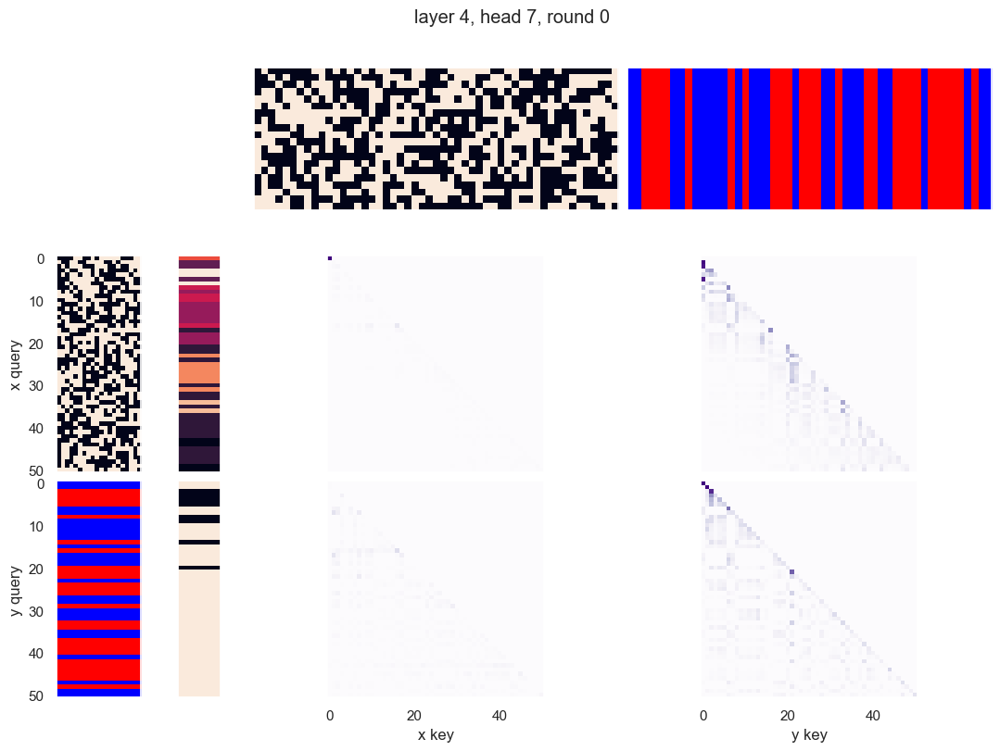

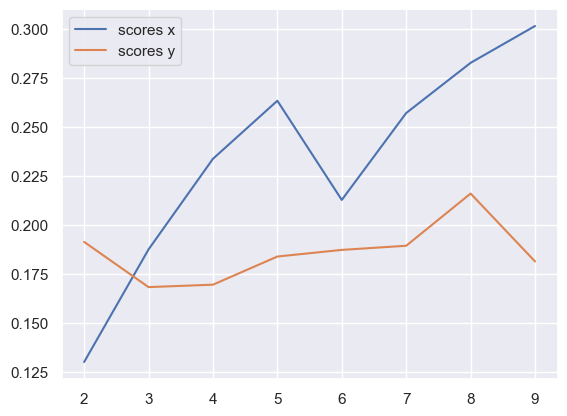

x query cluster:
SVM coefs for class 0: [-0.35808384  0.03793767 -0.23264681  0.08931808 -0.28067213 -0.27654489
 -0.37587805  0.01434733 -0.3292571   0.04679104 -0.23699536 -0.0083245
  0.13537408  0.08101154  0.04718954 -0.05610843 -0.13618482  0.1975519
  0.00169178 -0.03314918]\class elements: [26 27 29 34 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.68; (2) -16: 0.68; (3) +3: 0.68; (4) +14: 0.68; (5) -4: 0.63; (6) +5: 0.63; (7) +19: 0.58; (8) +0: 0.58; (9) +2: 0.58; (10) +15: 0.58
(1) +3 AND +17: 0.53; (2) +5 AND +17: 0.53; (3) +0 AND -16: 0.53; (4) +5 AND -16: 0.47; (5) +3 AND -16: 0.47; (6) -4 AND +5: 0.47; (7) -1 AND -10: 0.47; (8) -4 AND +14: 0.47; (9) -16 AND +17: 0.47; (10) +14 AND +15: 0.47
(1) +14 OR +17: 1.00; (2) +3 OR -4: 1.00; (3) +14 OR -16: 0.95; (4) +3 OR +15: 0.95; (5) +3 OR +14: 0.95; (6) +5 OR -6: 0.95; (7) +3 OR +19: 0.95; (8) +15 OR +17: 0.95; (9) +1 OR -10: 0.95; (10) +9 OR +17: 0.95
{0.0: 0.920424812880547}
SVM coefs for class 1: [ 0.42708246 -0.4

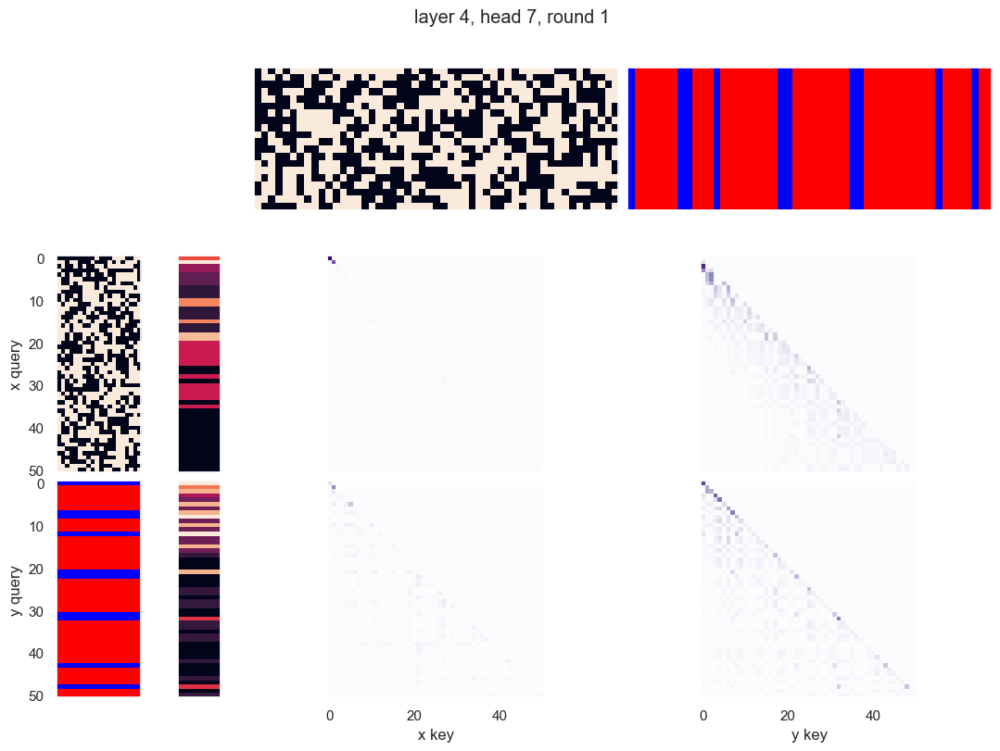

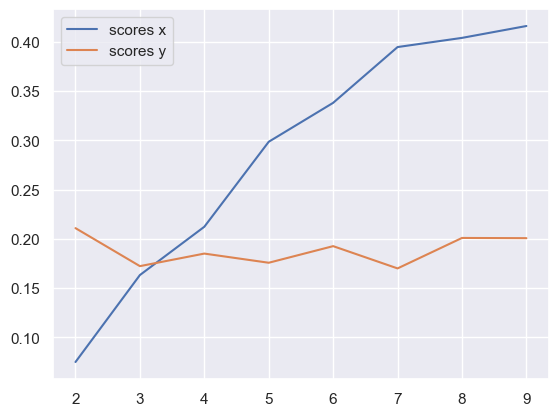

x query cluster:
SVM coefs for class 0: [-0.74002747  0.61143856 -0.5122205   0.86735799  0.30870518 -0.1714481
  0.48647394  0.24911548  0.02086844  0.27953765 -0.17935135 -0.20227708
  0.21579951  0.04490704  0.15245783  0.29491169 -0.74774936 -0.12524859
 -0.68383397  0.06378815]\class elements: [ 4  5 32 34 36 43 44 45 46 47 48 49 50]
(1) +8: 0.77; (2) +3: 0.77; (3) -0: 0.69; (4) -19: 0.69; (5) +14: 0.69; (6) +16: 0.69; (7) -5: 0.69; (8) +17: 0.69; (9) +11: 0.62; (10) -13: 0.62
(1) +3 AND +8: 0.62; (2) +3 AND -13: 0.62; (3) -5 AND +8: 0.62; (4) +8 AND -19: 0.54; (5) -0 AND -19: 0.54; (6) -15 AND +16: 0.54; (7) +14 AND +17: 0.54; (8) +3 AND -5: 0.54; (9) +12 AND +14: 0.54; (10) +3 AND +14: 0.54
(1) +3 OR +10: 1.00; (2) -0 OR -13: 1.00; (3) -1 OR +8: 1.00; (4) +3 OR +13: 1.00; (5) +10 OR -13: 1.00; (6) +4 OR +14: 1.00; (7) -0 OR +16: 1.00; (8) +15 OR +16: 1.00; (9) +3 OR +7: 1.00; (10) -0 OR +8: 1.00
{0.0: 0.9301702498655862}
SVM coefs for class 1: [ 0.0991253  -0.65925579  0.5374737

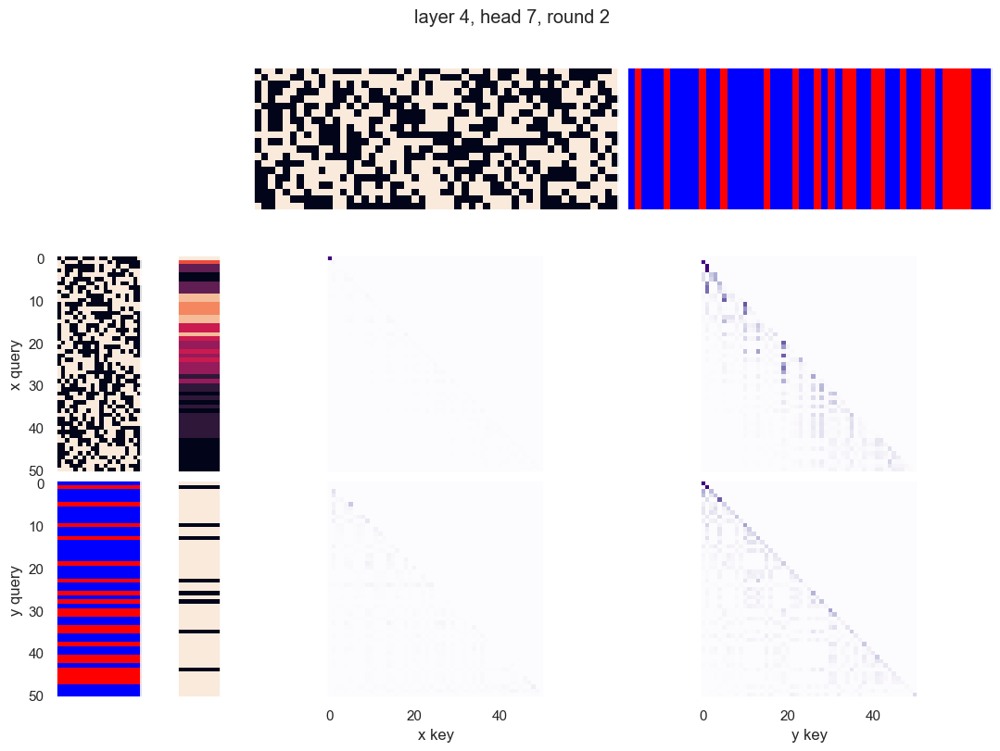

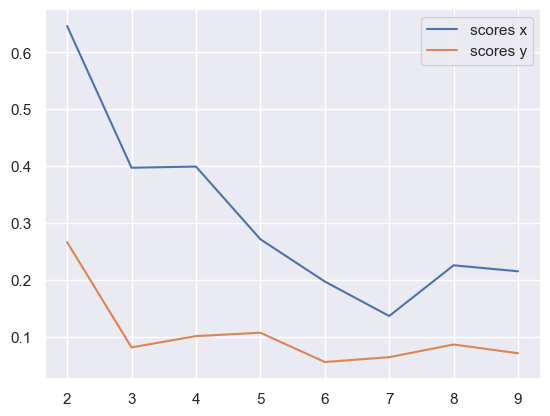

x query cluster:
SVM coefs: [ 0.25510036 -0.45922097  0.27299419  0.17551643 -0.21551752 -0.11985262
  0.0702531  -0.09278947  0.10831716  0.49036252 -0.00371484  0.20237855
 -0.11105314  0.23138818  0.04469836 -0.29458037 -0.46677306 -0.52135331
  0.5733236   0.62858719]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR

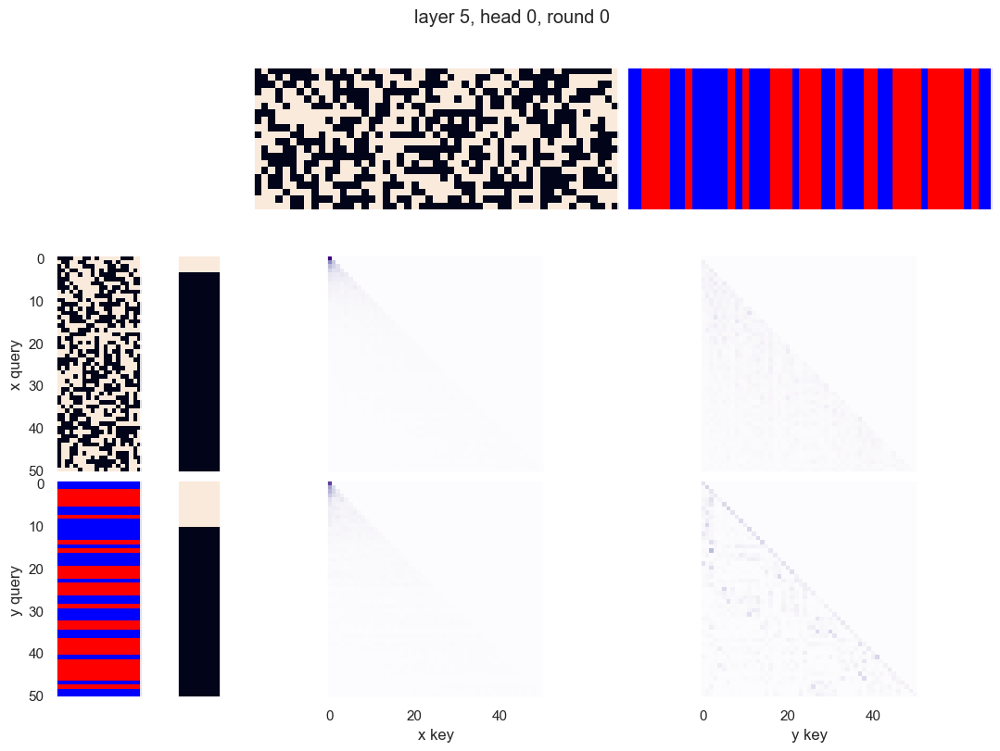

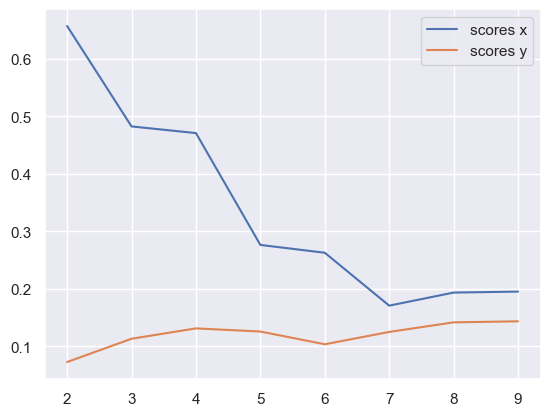

x query cluster:
SVM coefs: [ 0.25510546 -0.45922533  0.27298902  0.17551637 -0.21551204 -0.11985423
  0.07024729 -0.09278309  0.10832751  0.49035361 -0.00371322  0.20238825
 -0.11104411  0.23137673  0.04469822 -0.29457661 -0.46677251 -0.52135159
  0.57332364  0.62858751]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +0: 0.64; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.57; (7) +6: 0.57; (8) +17: 0.55; (9) +11: 0.55; (10) +5: 0.55
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) -12 AND -15: 0.40; (4) +5 AND -16: 0.40; (5) -12 AND +19: 0.40; (6) +9 AND +13: 0.40; (7) -4 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) -2 AND -12: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +0 OR +11: 0.89; (4) +14 OR +19: 0.89; (5) +14 OR +17: 0.89; (6) +0 OR +17: 0.89; (7) +13 OR +19: 0.89; (8) +14 OR -15: 0.89; (9) +14 OR -16: 0.89; (10) -12 OR

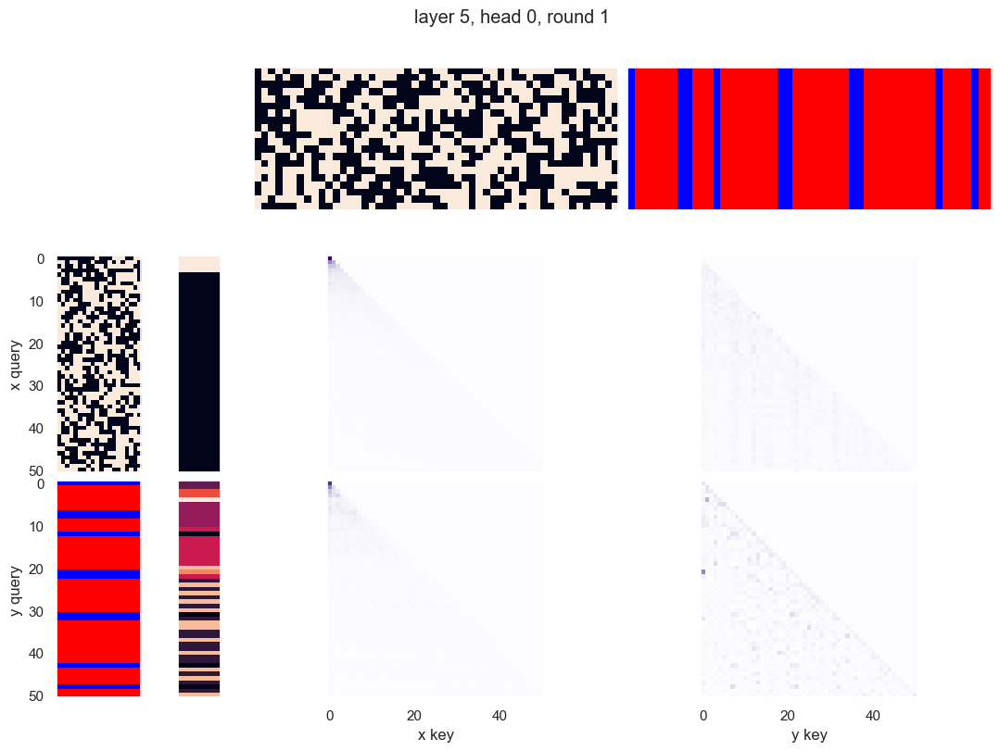

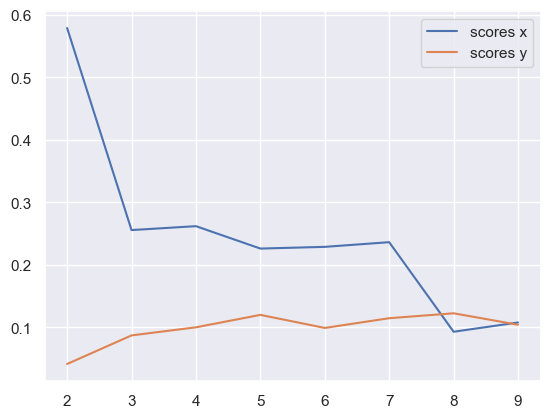

x query cluster:
SVM coefs: [ 0.10544169 -0.3793095   0.16403042  0.12083748 -0.24402596 -0.10237278
  0.0843726  -0.23419089  0.1888629   0.6635336  -0.04109447  0.52821377
 -0.17284362  0.06949073 -0.03457847 -0.08149602 -0.14972297 -0.68103926
  0.62447289  0.75904378]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

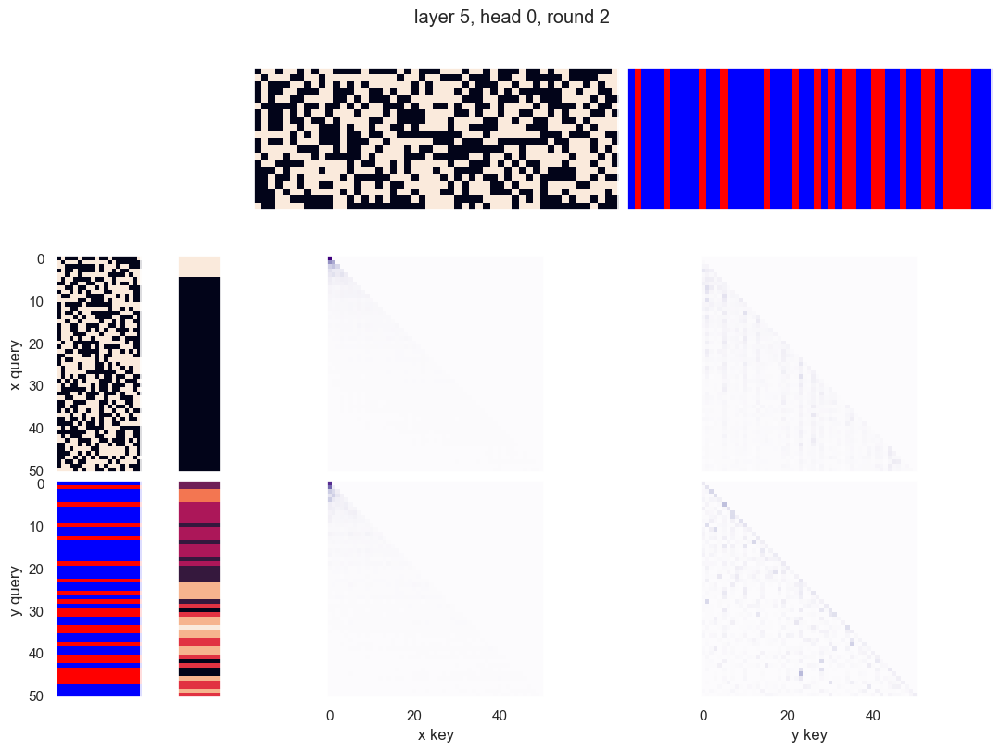

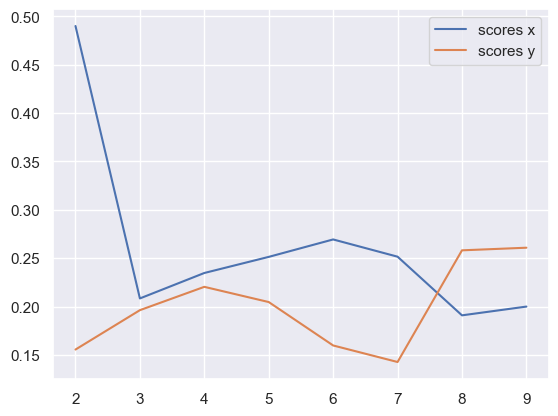

x query cluster:
SVM coefs: [-2.32155114e-01 -4.20207904e-01  7.42616910e-01  4.45015721e-01
  2.98548685e-01  3.58290201e-01  1.10678821e-01  1.84917801e-01
  8.03327526e-01  1.45552677e-01 -4.82860235e-01  6.11612443e-01
  2.99700883e-01 -6.64193688e-01 -3.04083990e-02 -3.10215739e-05
 -1.14821834e-01 -5.54174747e-01  5.13595558e-01  6.00331419e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) +10: 0.65; (3) -16: 0.65; (4) -12: 0.63; (5) -18: 0.63; (6) -11: 0.63; (7) +13: 0.60; (8) +2: 0.60; (9) -3: 0.60; (10) +6: 0.58
(1) +2 AND -18: 0.53; (2) -3 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) +13 AND -18: 0.49; (5) +6 AND +17: 0.47; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.44; (8) -16 AND -18: 0.44; (9) -12 AND -18: 0.44; (10) +17 AND -18: 0.44
(1) -11 OR -18: 0.95; (2) -11 OR -16: 0.95; (3) +10 OR -11: 0.93; (4) -2 OR -18: 0.93; (5) +10 OR +17: 0.93; (6) -16 OR +17: 0.93; (7)

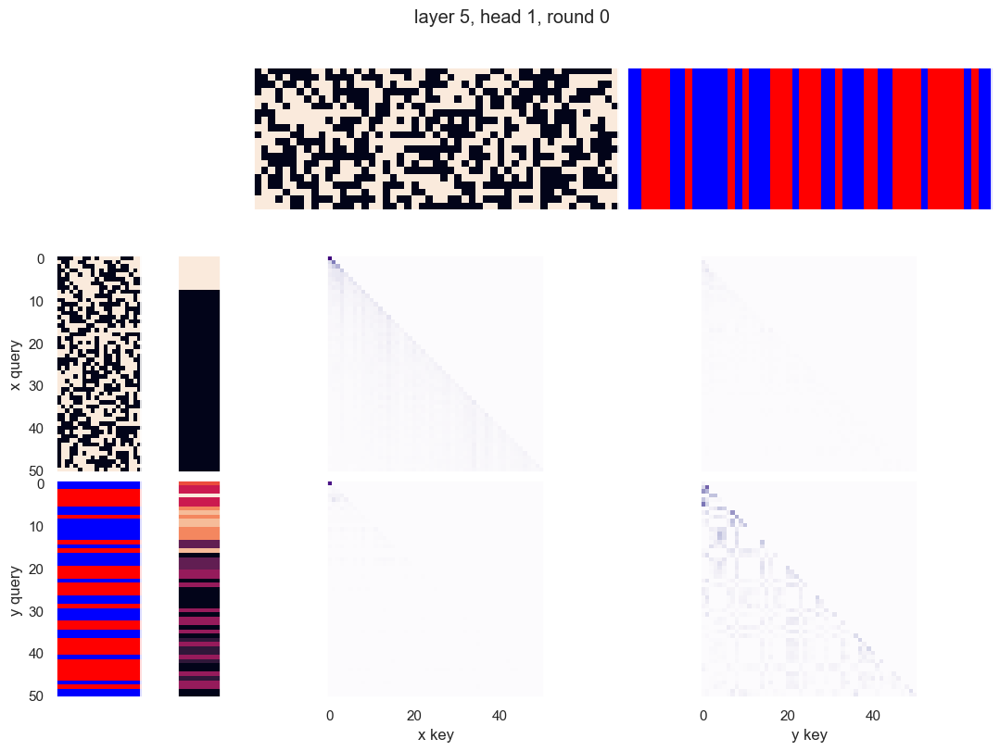

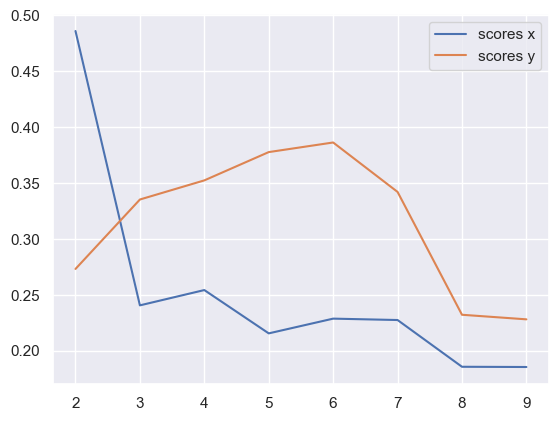

x query cluster:
SVM coefs: [ 0.19384928 -0.53394553  0.33930829  0.26735638  0.36126134  0.38595789
  0.3751269   0.61993259  0.83783292  0.19031544 -0.21142245  0.53883769
  0.31613778 -0.83768587  0.18793892 -0.6930318  -0.26582977 -0.91519961
  0.17779244  0.93398889]
class1: [ 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.64; (2) +13: 0.64; (3) +0: 0.62; (4) -16: 0.62; (5) +9: 0.60; (6) -12: 0.60; (7) +19: 0.60; (8) +11: 0.57; (9) -3: 0.57; (10) +5: 0.57
(1) +0 AND +9: 0.45; (2) +9 AND +13: 0.45; (3) -3 AND +19: 0.43; (4) +5 AND -16: 0.43; (5) +13 AND +14: 0.43; (6) +9 AND +14: 0.43; (7) +0 AND -16: 0.43; (8) +13 AND -16: 0.40; (9) +0 AND -12: 0.40; (10) +11 AND +19: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.90; (4) +14 OR -16: 0.90; (5) -16 OR +19: 0.90; (6) +9 OR -12: 0.90; (7) +0 OR +17: 0.88; (8) +5 OR +14: 0.88; (9) +6 OR -16: 0.88; (10) +5 OR +13: 0.88
{0.0: 0.

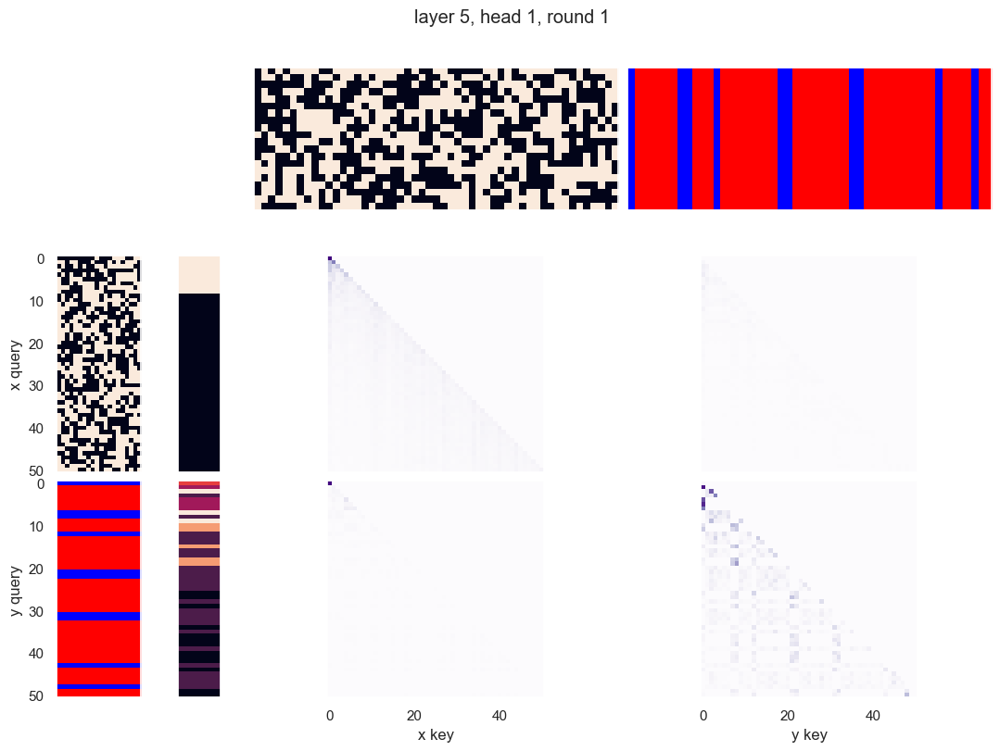

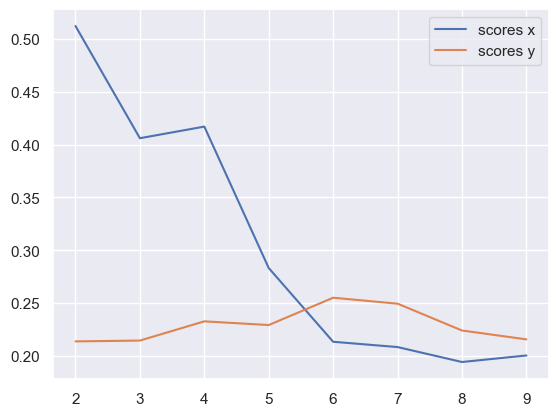

x query cluster:
SVM coefs: [-2.32155791e-01 -4.20213506e-01  7.42620978e-01  4.45011684e-01
  2.98556586e-01  3.58289645e-01  1.10680509e-01  1.84921716e-01
  8.03338611e-01  1.45552920e-01 -4.82861775e-01  6.11616660e-01
  2.99707332e-01 -6.64200714e-01 -3.04112450e-02 -3.38733192e-05
 -1.14828279e-01 -5.54179290e-01  5.13603278e-01  6.00329644e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.65; (3) +17: 0.65; (4) +13: 0.63; (5) +2: 0.63; (6) -0: 0.63; (7) +8: 0.58; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.51; (2) +16 AND +17: 0.49; (3) -9 AND -19: 0.47; (4) +7 AND +16: 0.44; (5) -0 AND +16: 0.44; (6) -9 AND +17: 0.44; (7) -0 AND +17: 0.44; (8) -9 AND +13: 0.44; (9) +8 AND +16: 0.44; (10) -18 AND -19: 0.44
(1) -10 OR -19: 0.93; (2) +14 OR +16: 0.91; (3) -0 OR -10: 0.91; (4) +7 OR -19: 0.91; (5) +15 OR +16: 0.91; (6) +18 OR -19: 0.91; (7) +2 OR

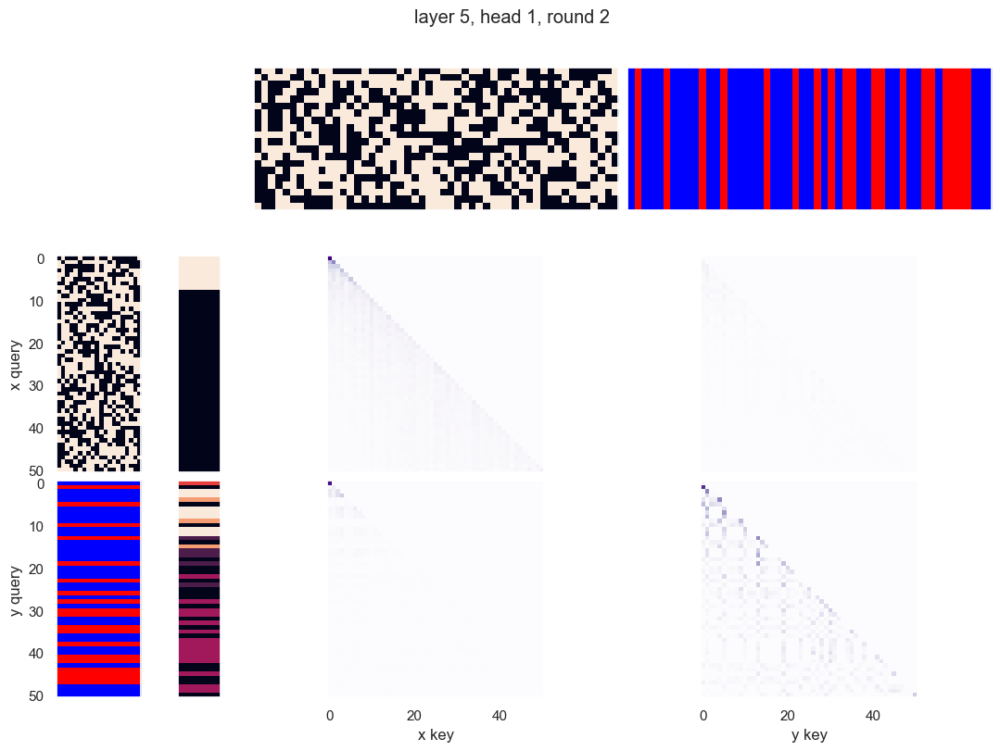

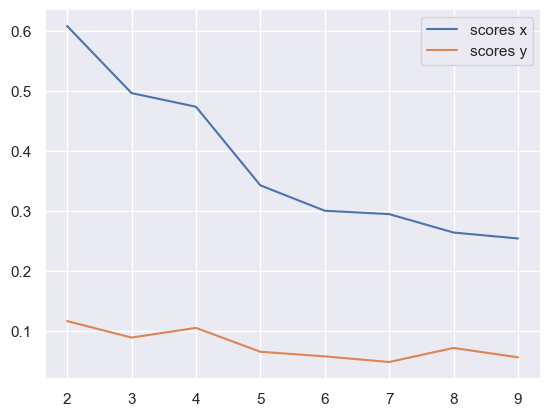

x query cluster:
SVM coefs: [-0.46865811 -0.5767806   0.27720998  0.21226284 -0.11847808 -0.05889352
  0.00723613 -0.45952354  0.42596789  0.43340941 -0.0899586   0.23647135
 -0.24495465 -0.49575459 -0.29612459  0.1730609   0.11536482 -0.67924238
  0.21284043  0.87186665]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10:

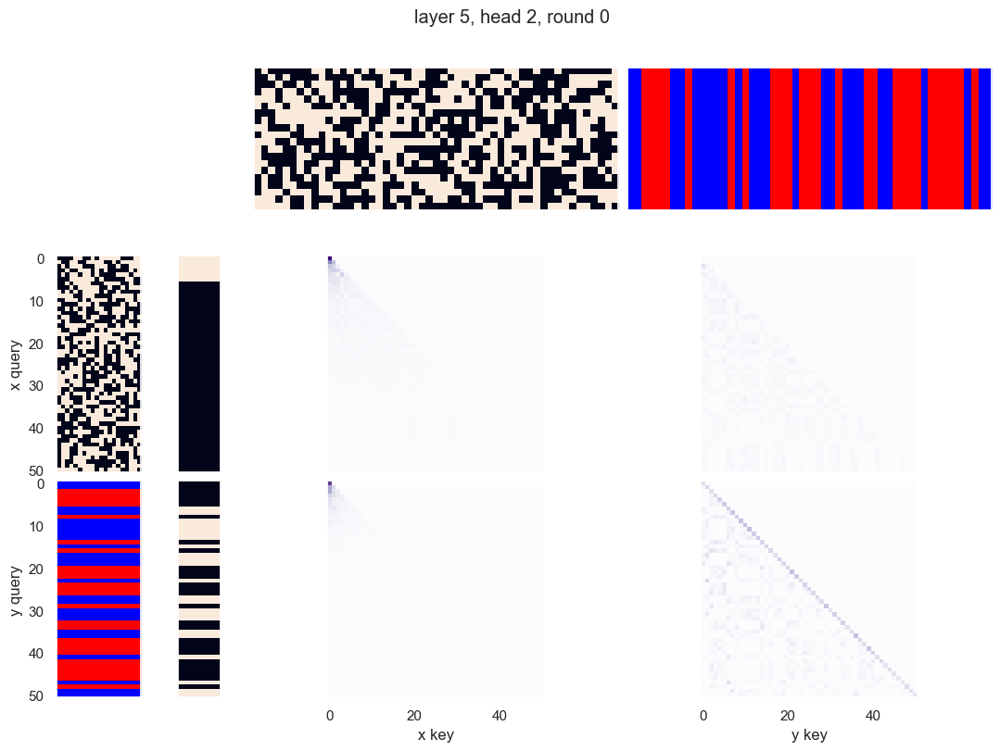

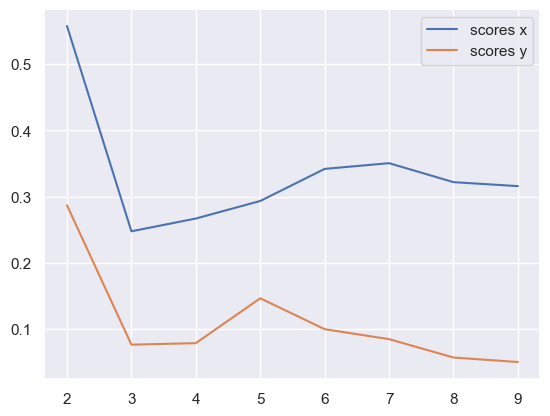

x query cluster:
SVM coefs: [-2.32150836e-01 -4.20209651e-01  7.42615588e-01  4.45009983e-01
  2.98551354e-01  3.58287804e-01  1.10679235e-01  1.84916771e-01
  8.03329230e-01  1.45555375e-01 -4.82856274e-01  6.11614099e-01
  2.99705664e-01 -6.64194484e-01 -3.04151494e-02 -3.08167746e-05
 -1.14824681e-01 -5.54172253e-01  5.13597016e-01  6.00328109e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.63; (2) +14: 0.63; (3) +13: 0.63; (4) +9: 0.60; (5) -16: 0.60; (6) -12: 0.60; (7) +19: 0.60; (8) -3: 0.58; (9) +11: 0.56; (10) +5: 0.56
(1) +0 AND +9: 0.47; (2) +9 AND +13: 0.44; (3) -3 AND +19: 0.44; (4) -12 AND +19: 0.42; (5) +13 AND +14: 0.42; (6) +9 AND +14: 0.42; (7) +0 AND -16: 0.42; (8) -12 AND -15: 0.42; (9) +5 AND -16: 0.42; (10) +0 AND -12: 0.42
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +9 OR -12: 0.91; (6) +0 OR +17: 0.88; (7) +5 OR

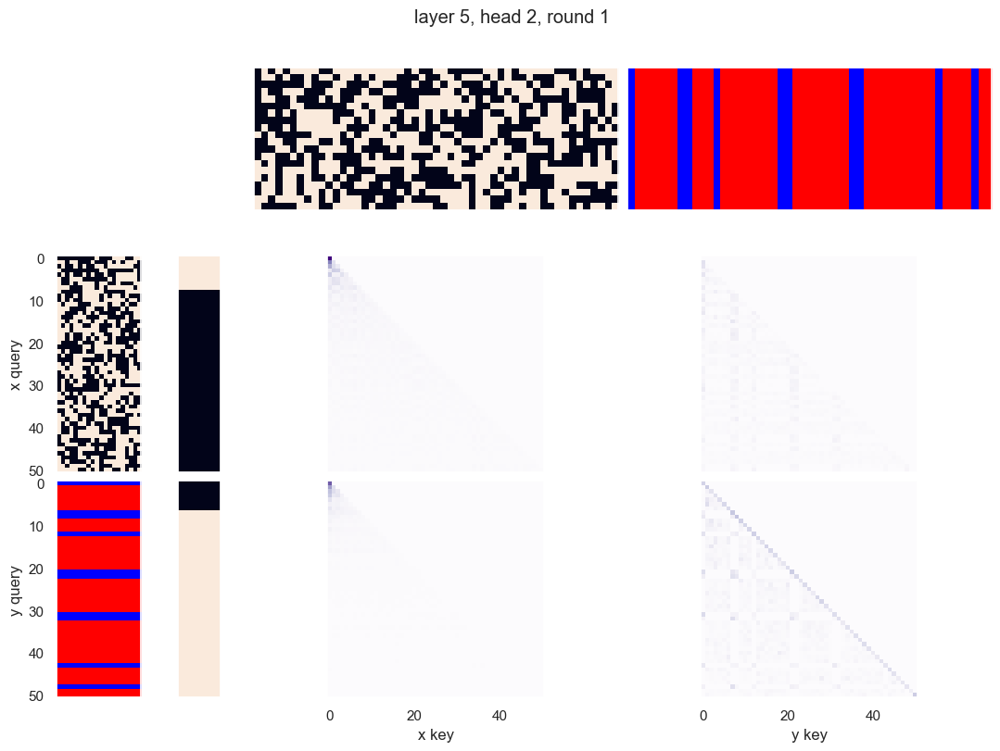

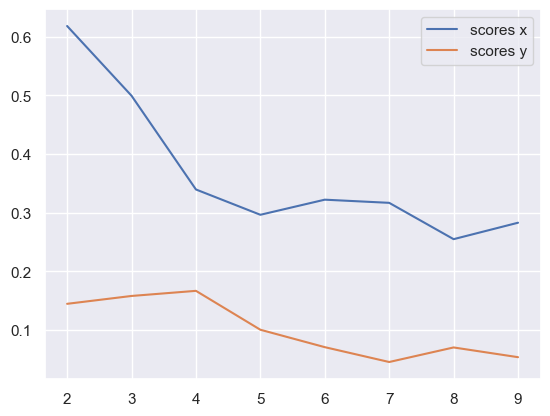

x query cluster:
SVM coefs: [-0.46865622 -0.57677979  0.27721112  0.21226235 -0.11847842 -0.05889509
  0.00723771 -0.45952241  0.42596769  0.43341199 -0.08995705  0.23647302
 -0.24495445 -0.49575105 -0.29612248  0.17305856  0.11536723 -0.67924262
  0.21283989  0.87186902]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.8

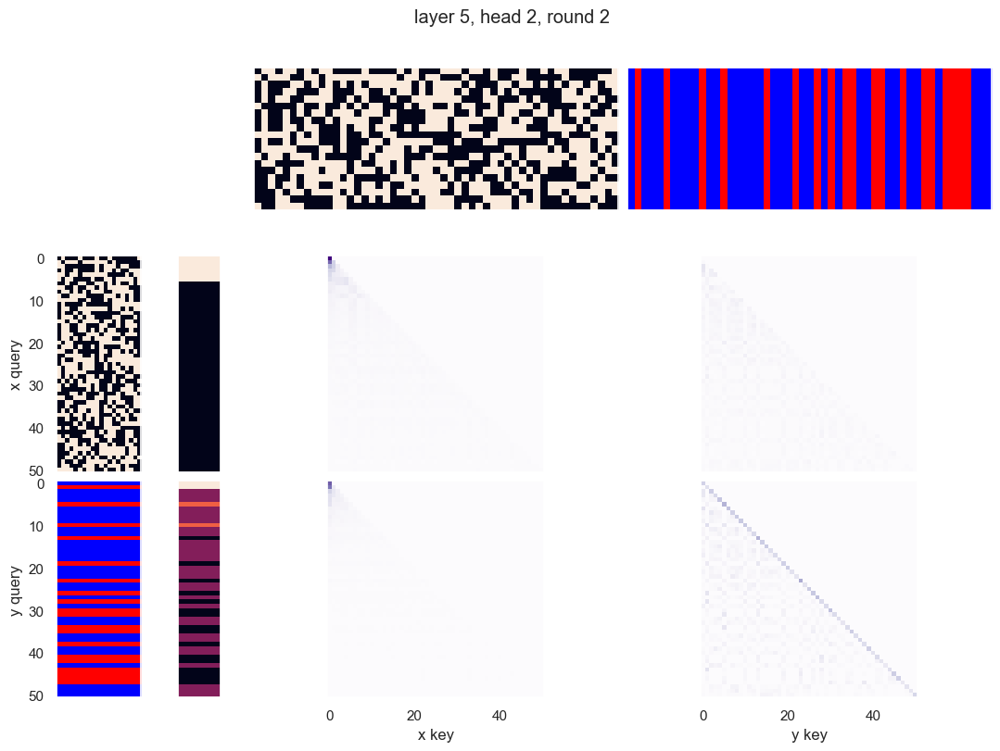

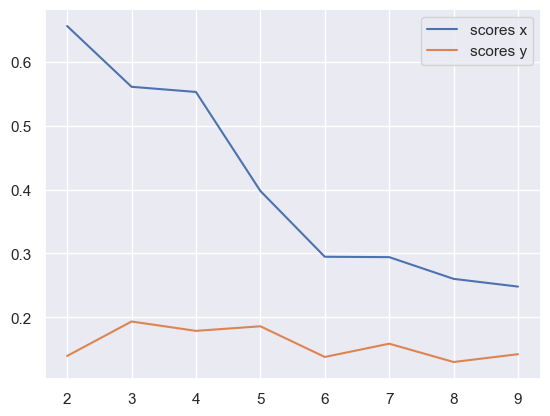

x query cluster:
SVM coefs: [-0.46865572 -0.57677958  0.27720939  0.21226428 -0.11848249 -0.05889463
  0.0072338  -0.45951945  0.42596792  0.43340878 -0.08996137  0.23647056
 -0.24494862 -0.49575335 -0.29612607  0.17306189  0.11537039 -0.67924289
  0.21284266  0.87186806]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10:

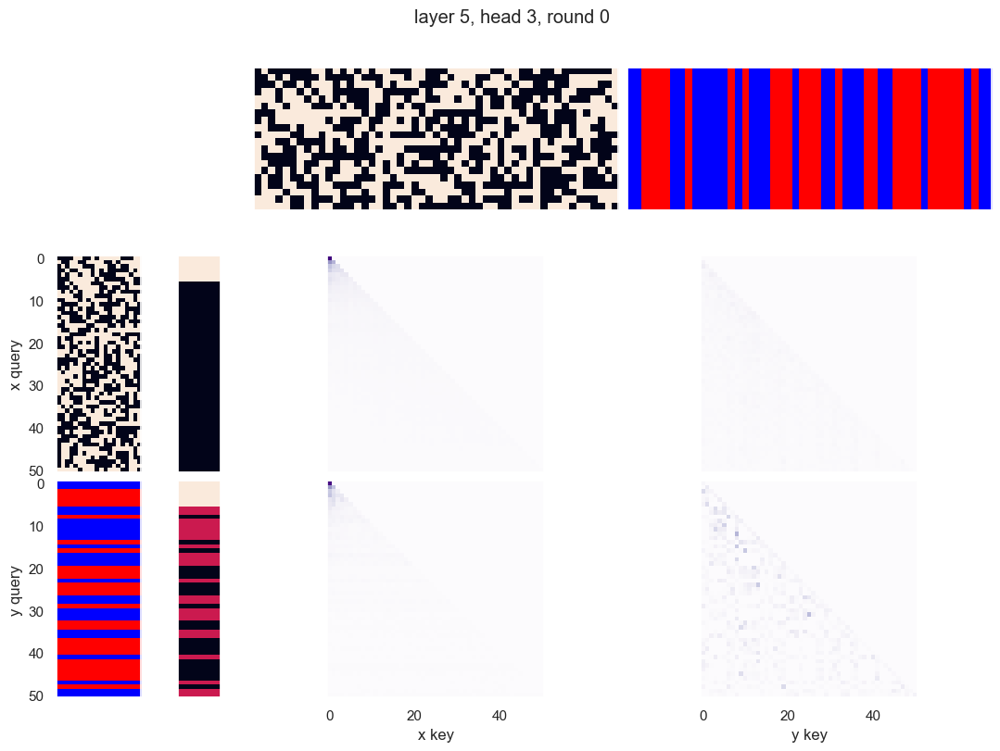

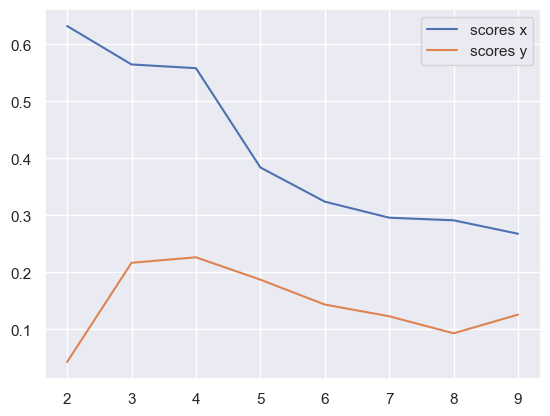

x query cluster:
SVM coefs: [-0.28794276 -0.47314397  1.02873715  0.38311033  0.32285493  0.2592128
  0.01952003  0.00168611  0.67964118  0.2714947  -0.32583801  0.59224768
  0.27769951 -0.56683399  0.12307375 -0.05074054  0.26542084 -0.6457583
  0.5079295   0.61017885]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +13: 0.64; (4) +19: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +9: 0.59; (8) -3: 0.59; (9) +6: 0.57; (10) +11: 0.55
(1) +0 AND +9: 0.45; (2) -3 AND +19: 0.45; (3) +9 AND +13: 0.43; (4) +13 AND +14: 0.43; (5) +0 AND +13: 0.41; (6) +9 AND +14: 0.41; (7) +13 AND -18: 0.41; (8) +0 AND -12: 0.41; (9) -12 AND -15: 0.41; (10) +5 AND -16: 0.41
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +6 OR -16: 0.89; (6) +7 OR -12: 0.89; (7) +14 OR +19: 0.89; (8) +14 OR +17: 0.89; (9) +14 OR -16: 0.89; (10) +0 OR +17: 0.89
{0

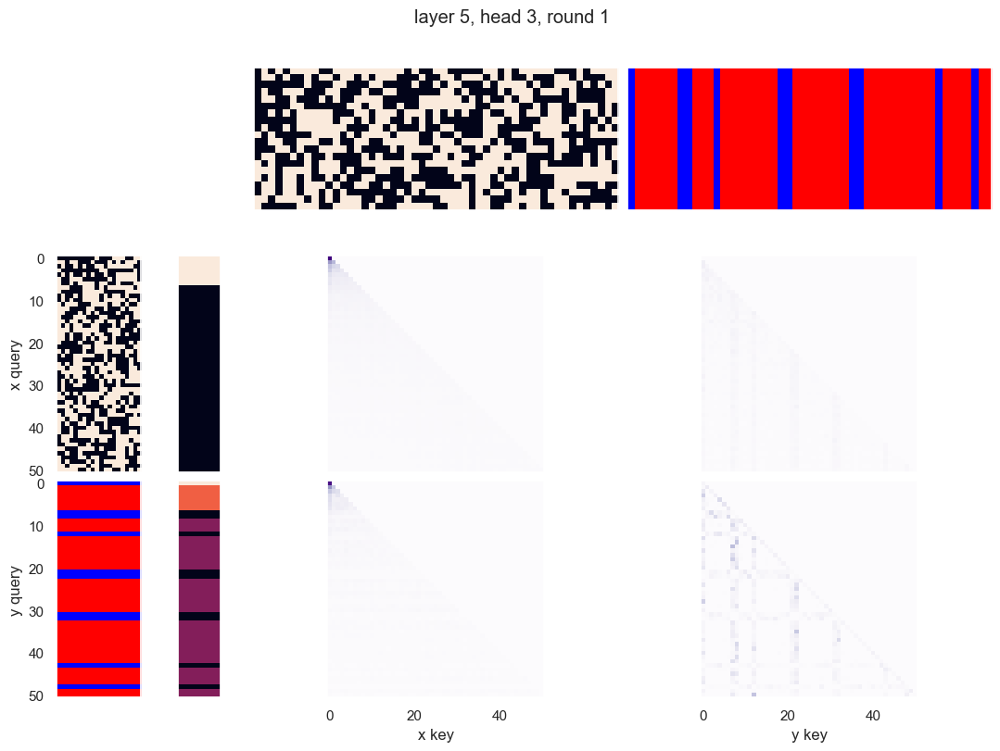

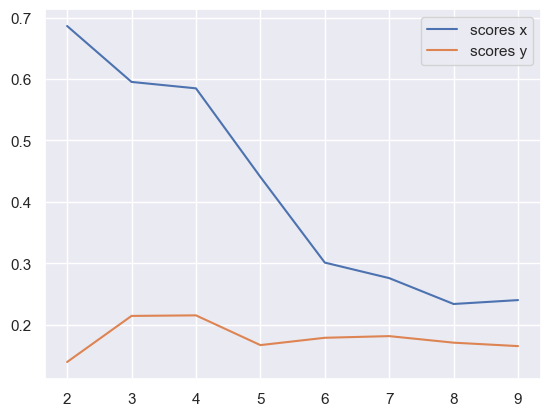

x query cluster:
SVM coefs: [ 0.10544269 -0.37930396  0.16403319  0.12083909 -0.2440302  -0.102374
  0.08437039 -0.23419043  0.18886677  0.66353523 -0.04109671  0.52820558
 -0.1728469   0.06948966 -0.03458036 -0.08149932 -0.14972196 -0.68103995
  0.62447381  0.75904551]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0.8

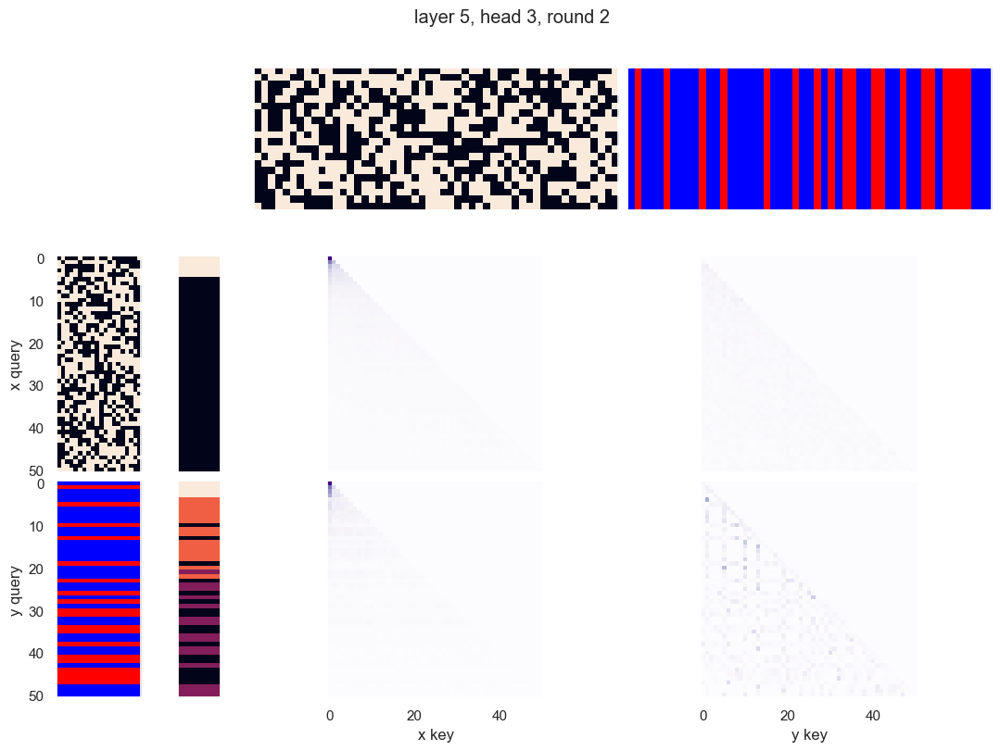

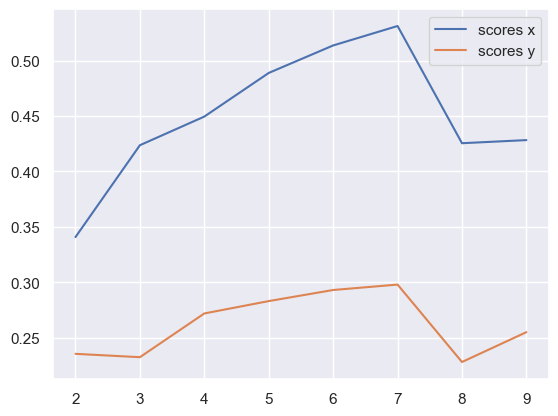

x query cluster:
SVM coefs for class 0: [-0.52785534 -0.1539494  -0.52838554  0.19349914 -1.91103604 -0.35953346
 -0.53424915 -0.14224101 -0.30457921  0.33676144  0.27674345 -0.20900615
  0.34615955  0.67990618 -0.0447035   0.16403987 -0.00203974 -0.22934118
 -0.61907268 -0.18591202]\class elements: [18 21 24 25 28 31 33 34 36 37 38 40 42 44 45 46 49]
(1) -4: 1.00; (2) +17: 0.82; (3) +10: 0.76; (4) -0: 0.71; (5) -18: 0.71; (6) -16: 0.65; (7) -14: 0.65; (8) +13: 0.65; (9) +5: 0.65; (10) -11: 0.65
(1) -4 AND +17: 0.82; (2) -4 AND +10: 0.76; (3) -4 AND -18: 0.71; (4) -0 AND -4: 0.71; (5) -4 AND -16: 0.65; (6) -4 AND +5: 0.65; (7) -4 AND +13: 0.65; (8) -4 AND -14: 0.65; (9) -4 AND -11: 0.65; (10) -3 AND -18: 0.59
(1) -4 OR -17: 1.00; (2) -4 OR -5: 1.00; (3) -4 OR -19: 1.00; (4) -3 OR -4: 1.00; (5) -4 OR +19: 1.00; (6) -4 OR +10: 1.00; (7) -4 OR -10: 1.00; (8) +10 OR +17: 1.00; (9) +1 OR -4: 1.00; (10) -4 OR +9: 1.00
{7.0: 0.26204830279068525, 11.0: 0.01869275927484142, 8.0: 0.1426901433382

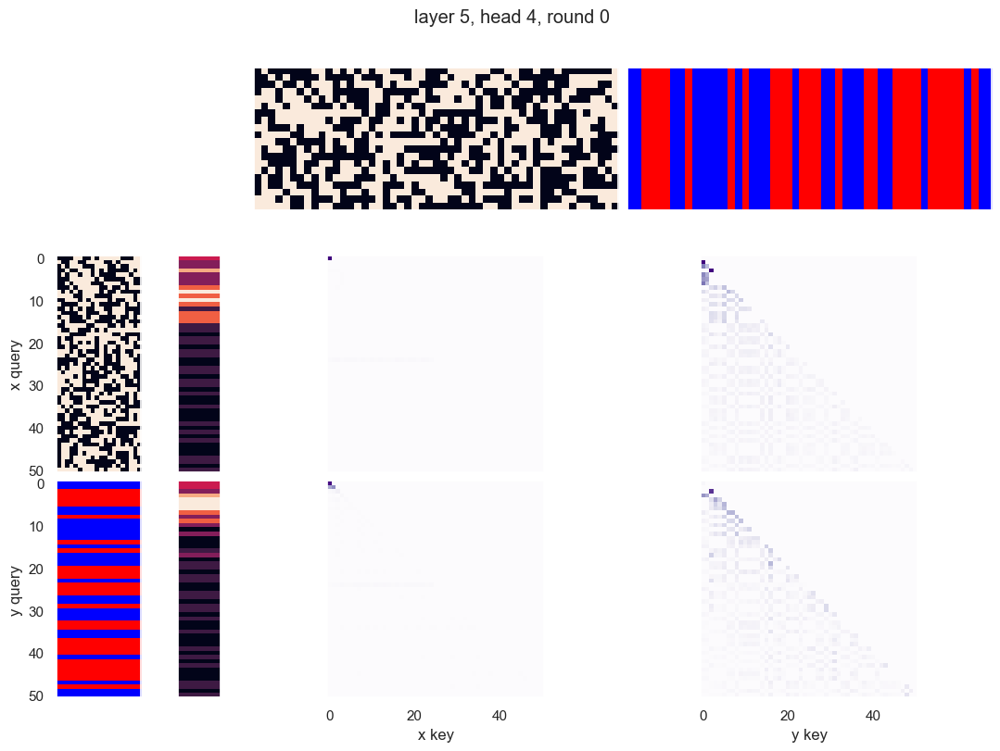

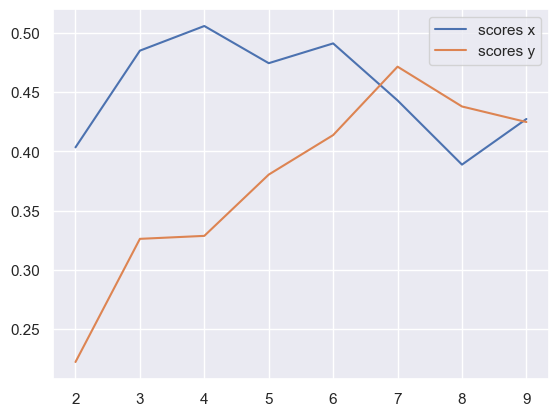

x query cluster:
SVM coefs for class 0: [ 0.11294093 -0.06666066  0.75125935  0.49730283 -0.23387902  0.61772913
  0.3651644  -0.46749441  0.41297617 -0.60937049  0.10013771 -0.81784449
 -0.68302832  0.12031455 -0.18082393  0.37384279 -0.05524725  0.71382355
  0.42744078 -0.27854293]\class elements: [ 9 11 14 15 16 17 23 24 25 26 27 28 30 32 35 37 38 44 49 50]
(1) +4: 1.00; (2) +13: 0.70; (3) +0: 0.65; (4) +9: 0.60; (5) -18: 0.60; (6) -17: 0.60; (7) -16: 0.60; (8) -15: 0.60; (9) -12: 0.60; (10) +5: 0.60
(1) +4 AND +13: 0.70; (2) +0 AND +4: 0.65; (3) +4 AND -16: 0.60; (4) +4 AND -17: 0.60; (5) +4 AND -12: 0.60; (6) +4 AND -18: 0.60; (7) +4 AND +9: 0.60; (8) +4 AND +5: 0.60; (9) +4 AND -7: 0.60; (10) +4 AND -15: 0.60
(1) +4 OR +14: 1.00; (2) +4 OR +12: 1.00; (3) +4 OR -13: 1.00; (4) +4 OR +13: 1.00; (5) +4 OR -14: 1.00; (6) +4 OR -15: 1.00; (7) +4 OR +15: 1.00; (8) +4 OR -16: 1.00; (9) +4 OR -12: 1.00; (10) +4 OR +16: 1.00
{0.0: 0.9873752919260398}
SVM coefs for class 1: [ 0.05885956  0.

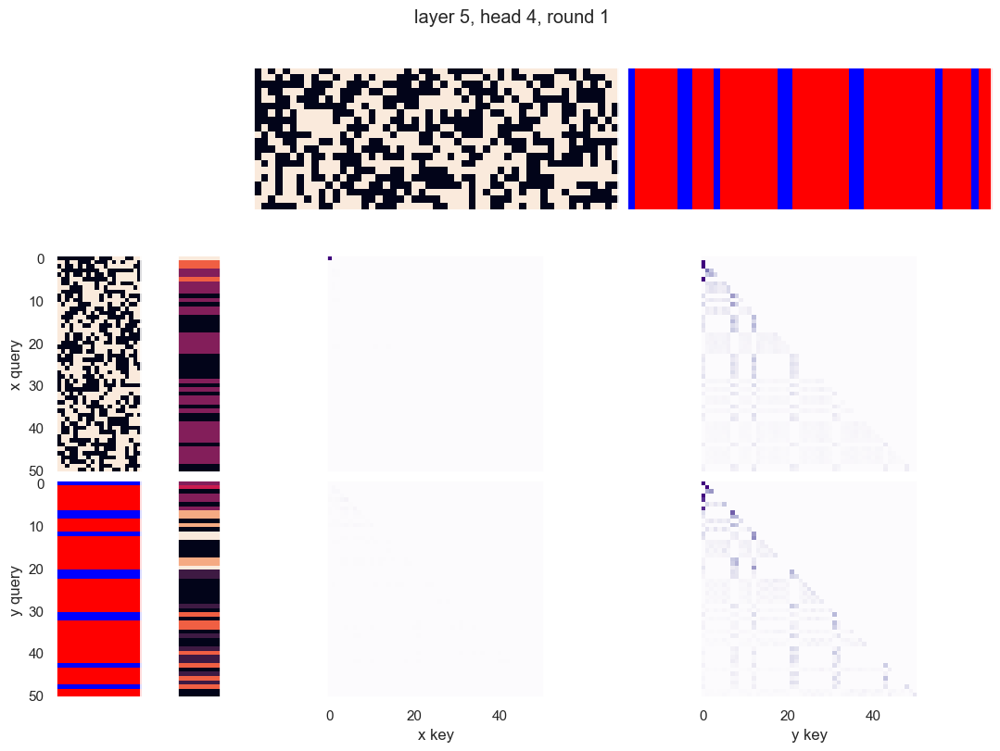

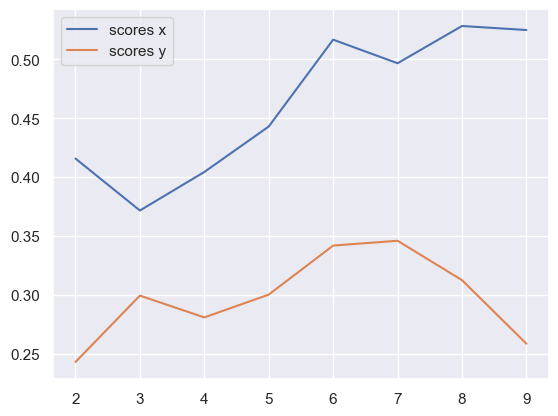

x query cluster:
SVM coefs for class 0: [-0.06147995 -0.01377972  0.04118759 -0.1714363  -0.06415118 -0.02919261
 -0.09900023 -0.18122365  0.04241582 -0.02577167 -0.0938681  -0.27637759
 -0.03653309  0.26194434  0.09580266 -0.09659466 -0.0767859   0.1870397
  0.14050983 -0.24677444]\class elements: [13 15 19 22 23 24 25 26 27 28 32 33 37 39 43 44 45 46 48]
(1) +4: 1.00; (2) +16: 0.74; (3) +18: 0.68; (4) -5: 0.68; (5) +6: 0.68; (6) +13: 0.63; (7) -19: 0.63; (8) -9: 0.63; (9) +17: 0.63; (10) -0: 0.58
(1) +4 AND +16: 0.74; (2) +4 AND +18: 0.68; (3) +4 AND +6: 0.68; (4) +4 AND -5: 0.68; (5) +4 AND -9: 0.63; (6) +4 AND +17: 0.63; (7) +4 AND -19: 0.63; (8) +4 AND +13: 0.63; (9) -0 AND +4: 0.58; (10) +4 AND +15: 0.58
(1) +4 OR +8: 1.00; (2) +4 OR +15: 1.00; (3) +4 OR -16: 1.00; (4) +4 OR +16: 1.00; (5) +4 OR -17: 1.00; (6) +4 OR +17: 1.00; (7) +18 OR -19: 1.00; (8) +4 OR -18: 1.00; (9) +4 OR +18: 1.00; (10) +4 OR -19: 1.00
{0.0: 0.9896812472931098}
SVM coefs for class 1: [ 0.08937462 -0.19243

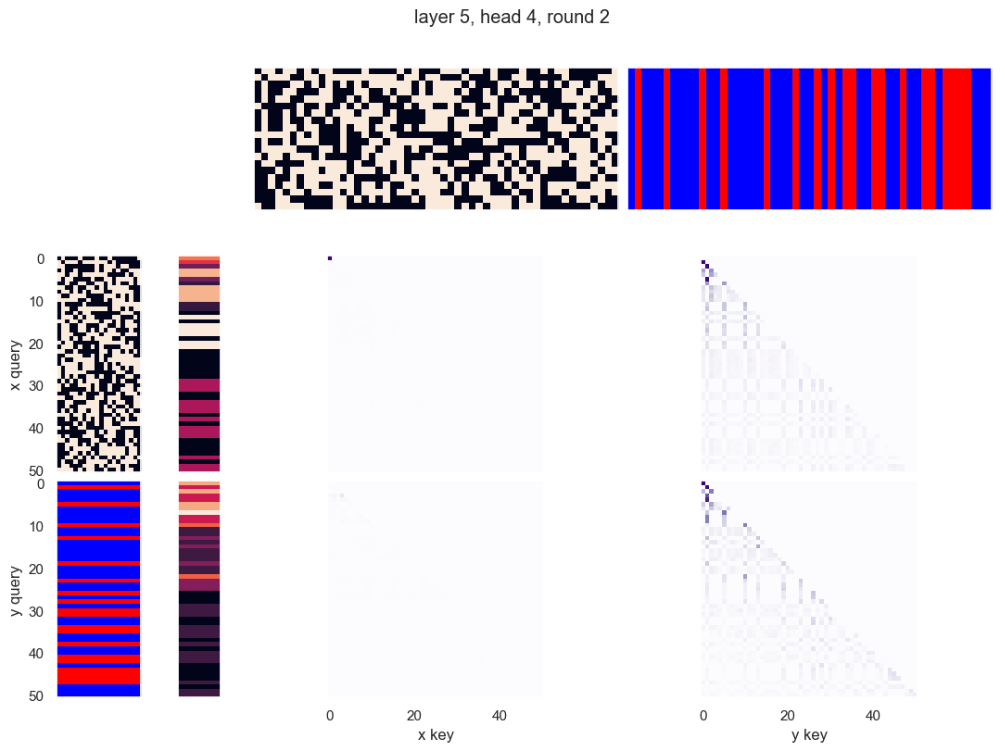

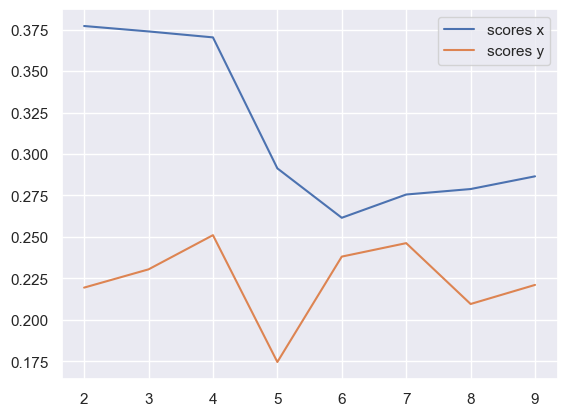

x query cluster:
SVM coefs: [ 0.46582633 -0.5193015   0.26398718 -0.33147573  0.14320635  0.40480341
  0.69308594  0.09727331  0.39841362  0.18076836  0.01754208 -0.00917014
 -0.70866737 -0.6476645   0.02653757 -0.89343251 -0.36138112 -0.21333486
  0.4187671   0.23925406]
class1: [17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40
 41 42 43 44 45 46 47 48 49 50]
(1) +10: 0.71; (2) +17: 0.71; (3) -16: 0.68; (4) -11: 0.65; (5) +13: 0.62; (6) +5: 0.62; (7) -3: 0.59; (8) -9: 0.59; (9) -14: 0.56; (10) -19: 0.56
(1) -11 AND +17: 0.50; (2) +5 AND +13: 0.47; (3) +13 AND +17: 0.47; (4) -9 AND +10: 0.47; (5) +2 AND -18: 0.47; (6) +13 AND -18: 0.47; (7) -3 AND -18: 0.47; (8) -3 AND -16: 0.47; (9) +10 AND -16: 0.47; (10) +8 AND +17: 0.44
(1) -11 OR -16: 1.00; (2) +10 OR +17: 0.97; (3) -3 OR -11: 0.97; (4) -11 OR -18: 0.94; (5) +15 OR -16: 0.94; (6) +10 OR -11: 0.94; (7) -16 OR +17: 0.94; (8) -9 OR +17: 0.94; (9) +5 OR +10: 0.94; (10) +6 OR +10: 0.91
{7.0: 0.0740649523818587, 1

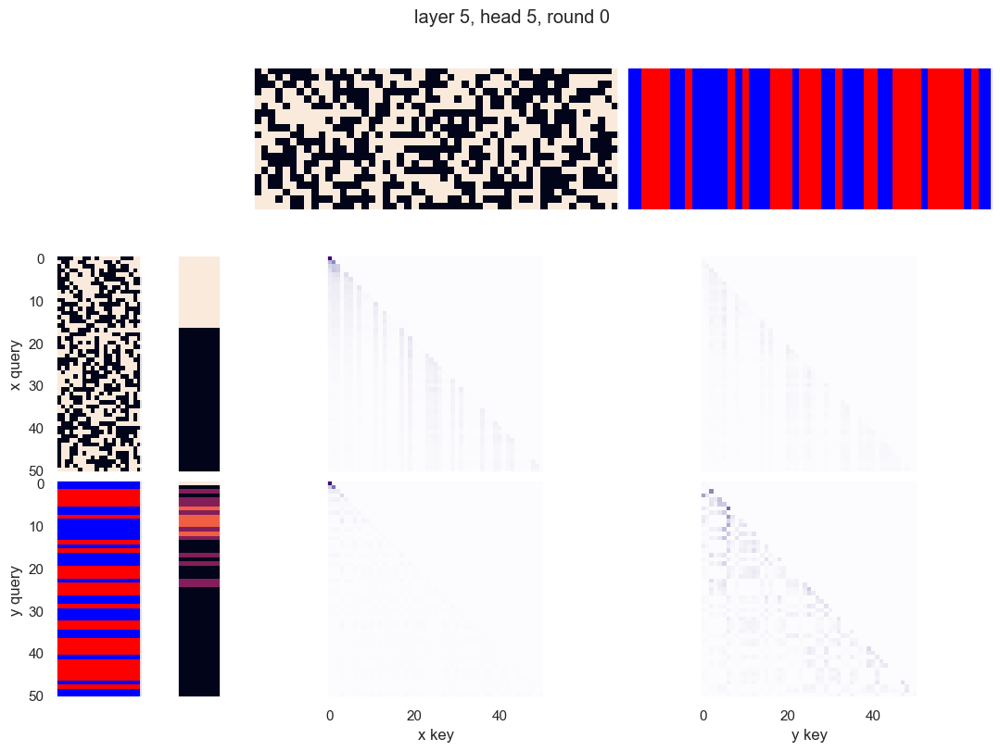

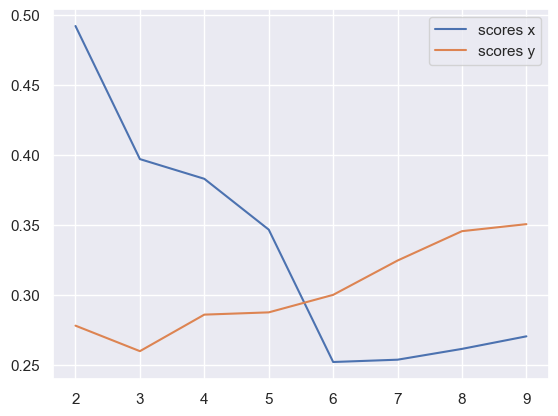

x query cluster:
SVM coefs: [ 0.19384838 -0.53394926  0.33930533  0.26735992  0.36125991  0.38596031
  0.37512593  0.61993068  0.83782671  0.19031459 -0.21141409  0.53884005
  0.31613993 -0.83768588  0.1879383  -0.69302886 -0.2658296  -0.91518954
  0.17779256  0.93398997]
class1: [ 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.64; (2) +13: 0.64; (3) +0: 0.62; (4) -16: 0.62; (5) +9: 0.60; (6) -12: 0.60; (7) +19: 0.60; (8) +11: 0.57; (9) -3: 0.57; (10) +5: 0.57
(1) +0 AND +9: 0.45; (2) +9 AND +13: 0.45; (3) -3 AND +19: 0.43; (4) +5 AND -16: 0.43; (5) +13 AND +14: 0.43; (6) +9 AND +14: 0.43; (7) +0 AND -16: 0.43; (8) +13 AND -16: 0.40; (9) +0 AND -12: 0.40; (10) +11 AND +19: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.90; (4) +14 OR -16: 0.90; (5) -16 OR +19: 0.90; (6) +9 OR -12: 0.90; (7) +0 OR +17: 0.88; (8) +5 OR +14: 0.88; (9) +6 OR -16: 0.88; (10) +5 OR +13: 0.88
{0.0: 0.

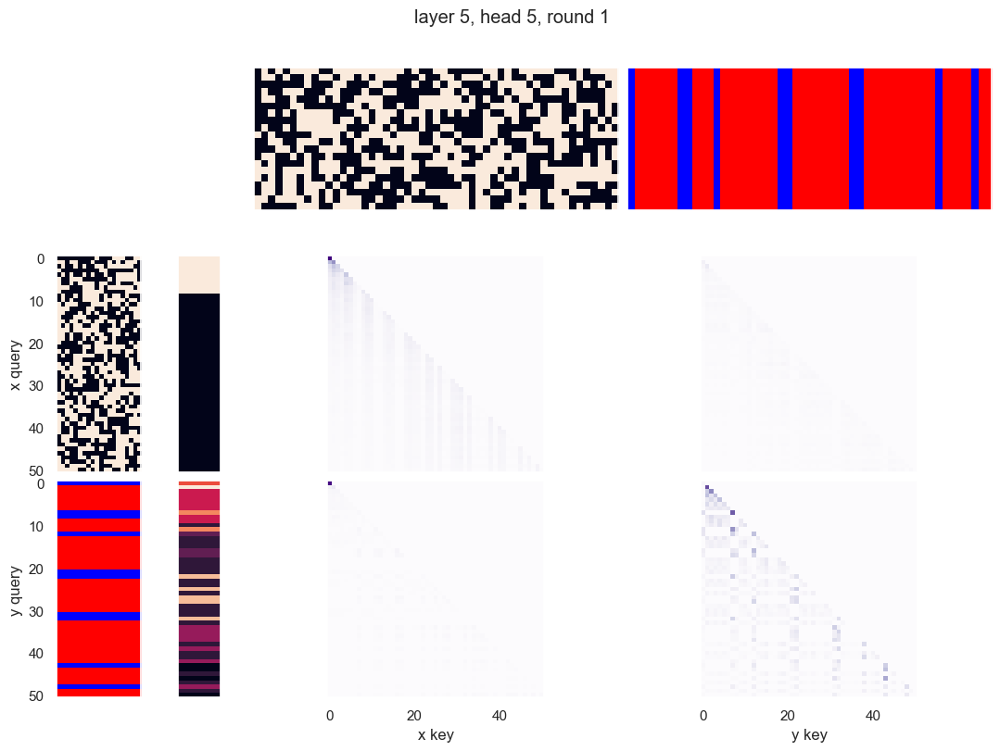

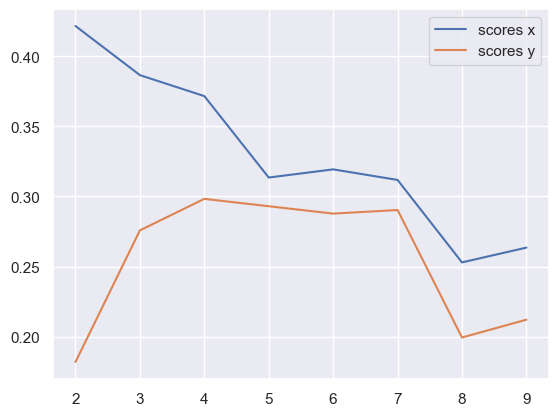

x query cluster:
SVM coefs: [ 0.20987689 -0.59218436  0.44595439  0.5311413   0.27330878  0.10194884
  0.43207591  0.61533777  0.76813613  0.07028551 -0.17484201  0.53800029
  0.10627193 -0.49712533  0.16500998 -0.6244985  -0.10635227 -0.74118175
  0.22841834  1.06104744]
class1: [11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34
 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.70; (2) -0: 0.65; (3) -19: 0.62; (4) +2: 0.62; (5) +17: 0.62; (6) +7: 0.60; (7) +8: 0.60; (8) +13: 0.60; (9) -9: 0.57; (10) +6: 0.57
(1) +16 AND +17: 0.50; (2) +17 AND -19: 0.47; (3) +7 AND +16: 0.47; (4) -15 AND +16: 0.45; (5) +8 AND +13: 0.45; (6) -0 AND +16: 0.45; (7) -9 AND -19: 0.45; (8) -0 AND +17: 0.45; (9) +8 AND +16: 0.45; (10) +2 AND +7: 0.42
(1) +14 OR +16: 0.93; (2) -10 OR -19: 0.93; (3) +12 OR +16: 0.93; (4) +2 OR +16: 0.90; (5) +5 OR +16: 0.90; (6) -3 OR +8: 0.90; (7) +2 OR +17: 0.90; (8) -10 OR +13: 0.90; (9) -0 OR -15: 0.90; (10) +15 OR +16: 0.90
{0.0: 0.37465005

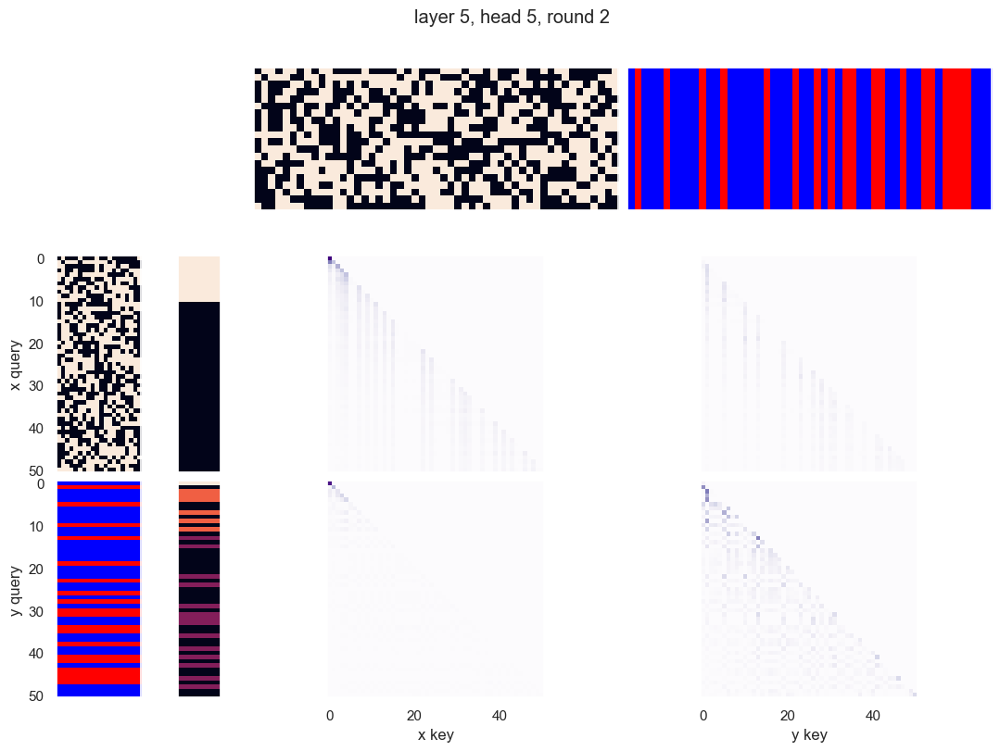

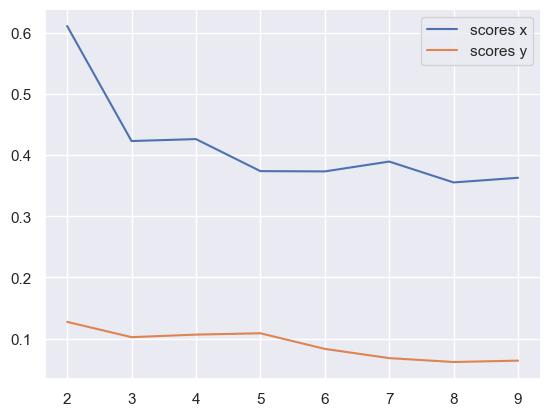

x query cluster:
SVM coefs: [ 0.10544056 -0.37930818  0.16402986  0.12083533 -0.24402563 -0.10237132
  0.08437014 -0.23419479  0.18886487  0.66353422 -0.04109389  0.52821066
 -0.17284437  0.06948832 -0.03458119 -0.08149822 -0.14972162 -0.68103882
  0.62447532  0.75904333]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17

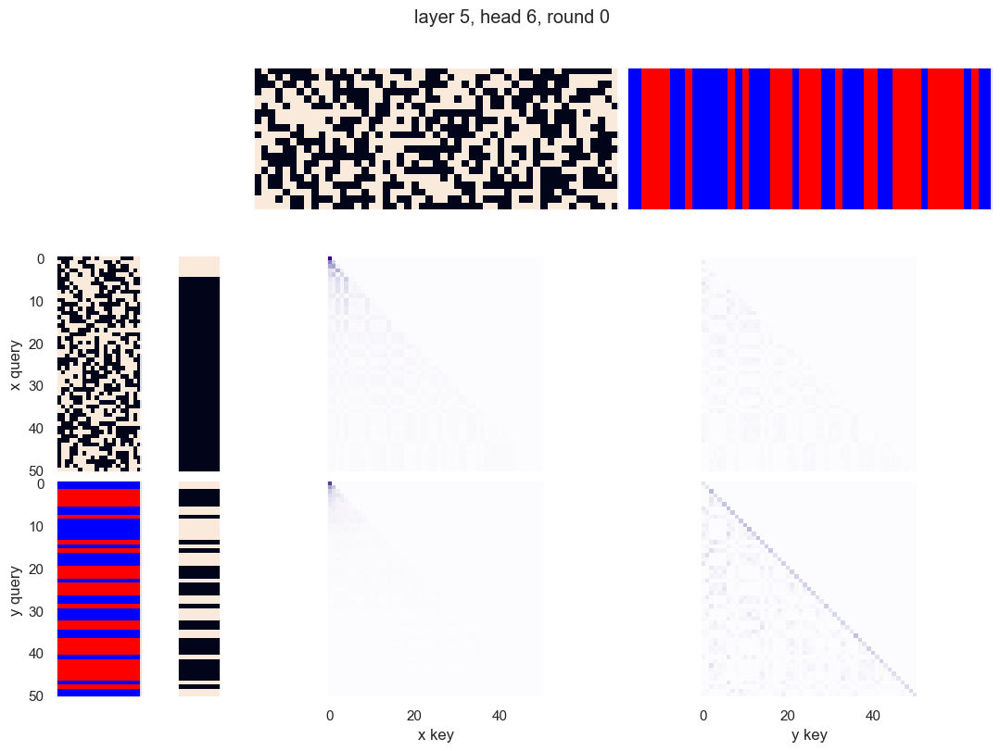

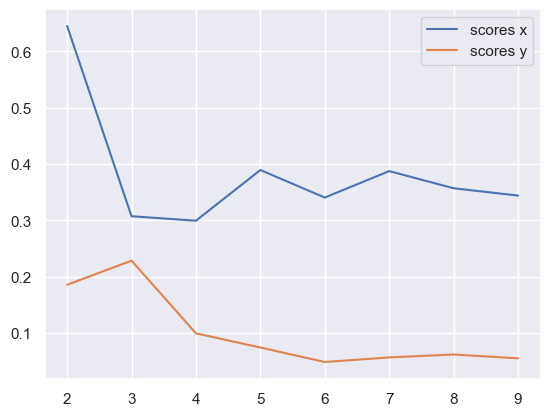

x query cluster:
SVM coefs: [ 0.30201578 -0.11642613 -0.13520373  0.24389045 -0.20115919 -0.18016961
 -0.06608418 -0.03781655  0.40099383  0.28782246 -0.15562802  0.41648583
  0.08840417  0.20325798  0.02847136 -0.15123032  0.05899644 -0.84680153
  0.36338022  0.81864889]
class1: [ 3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.66; (2) +14: 0.64; (3) +19: 0.60; (4) -16: 0.60; (5) +13: 0.60; (6) -12: 0.60; (7) -3: 0.57; (8) -15: 0.55; (9) +11: 0.55; (10) +6: 0.55
(1) -3 AND +19: 0.43; (2) +0 AND -12: 0.43; (3) +0 AND -16: 0.43; (4) -12 AND -15: 0.43; (5) +0 AND +9: 0.43; (6) +0 AND -15: 0.40; (7) -12 AND +19: 0.40; (8) -2 AND -12: 0.40; (9) +9 AND +13: 0.40; (10) +5 AND -16: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +13 OR +19: 0.89; (4) +0 OR +17: 0.89; (5) +14 OR -15: 0.89; (6) +14 OR -16: 0.89; (7) -16 OR +19: 0.89; (8) +0 OR +11: 0.89; (9) +6 OR -16: 0.87; (10) +0 OR -9

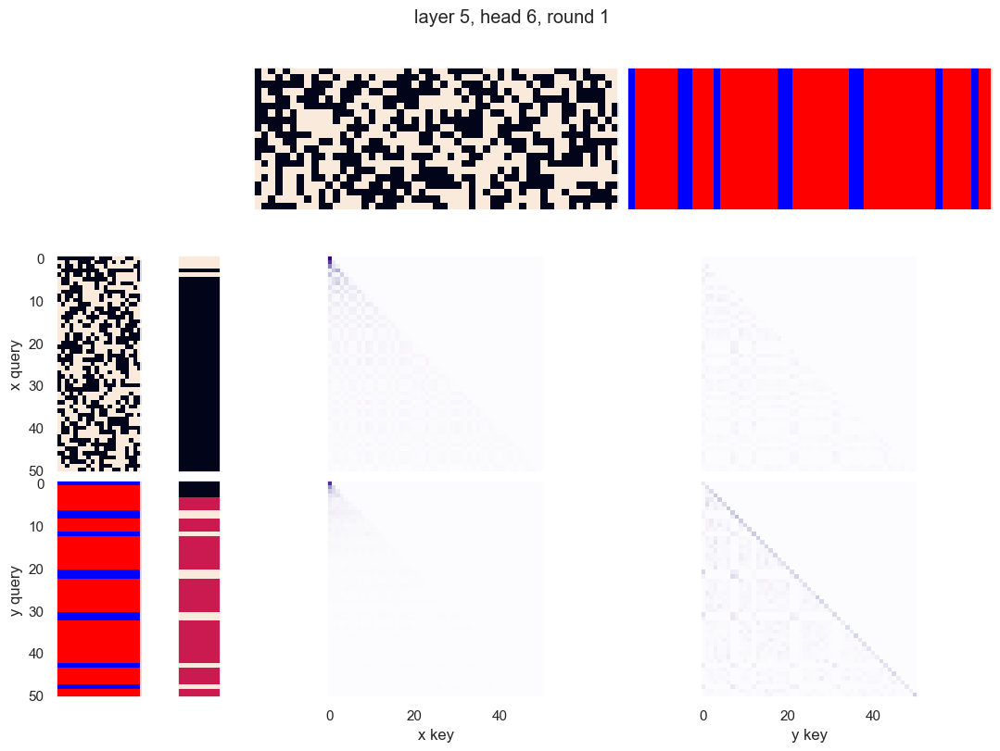

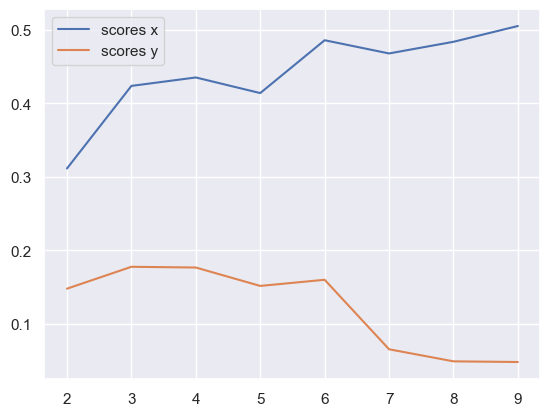

x query cluster:
SVM coefs for class 0: [-0.10436944  0.08095931 -0.01115374  0.03765535 -0.01644936  0.02943219
 -0.2573628   0.04356229 -0.14847512  0.04377025 -0.19065232  0.07102808
  0.04091721  0.16133235 -0.07534236  0.20724101  0.10381423  0.05789116
 -0.1946688  -0.12910327]\class elements: [20 23 26 27 28 30 31 32 34 35 38 39 40 41 42 44 45 46 47]
(1) -1: 1.00; (2) +2: 0.74; (3) +17: 0.68; (4) +16: 0.68; (5) -9: 0.63; (6) +12: 0.63; (7) -0: 0.58; (8) +14: 0.58; (9) -10: 0.58; (10) -19: 0.58
(1) -1 AND +2: 0.74; (2) -1 AND +16: 0.68; (3) -1 AND +17: 0.68; (4) -1 AND -9: 0.63; (5) -1 AND +12: 0.63; (6) -1 AND -5: 0.58; (7) -1 AND +6: 0.58; (8) -1 AND +7: 0.58; (9) -1 AND -10: 0.58; (10) -1 AND +13: 0.58
(1) -0 OR -1: 1.00; (2) -1 OR -11: 1.00; (3) +14 OR +16: 1.00; (4) -1 OR +10: 1.00; (5) -1 OR -10: 1.00; (6) -1 OR +9: 1.00; (7) -1 OR -9: 1.00; (8) -1 OR +8: 1.00; (9) -1 OR -8: 1.00; (10) -9 OR -10: 1.00
{0.0: 0.4560728845137515}
SVM coefs for class 1: [ 0.46950388 -0.15431637

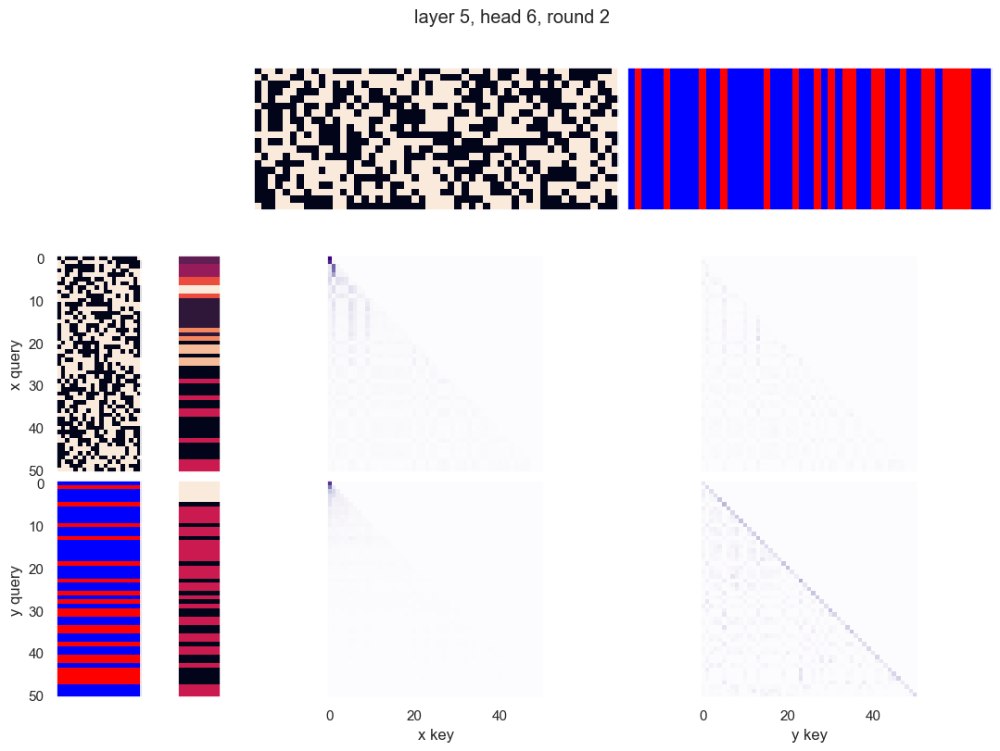

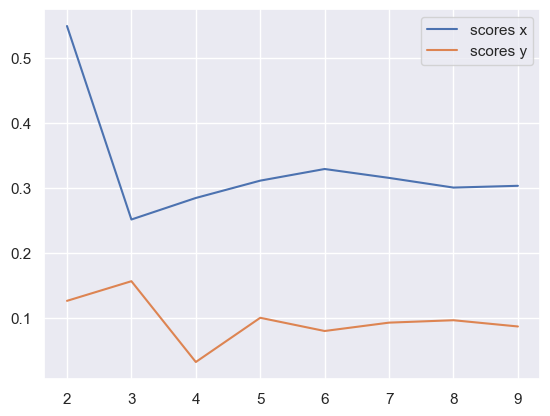

x query cluster:
SVM coefs: [-2.32157774e-01 -4.20209698e-01  7.42616076e-01  4.45009492e-01
  2.98553554e-01  3.58288711e-01  1.10685273e-01  1.84912119e-01
  8.03323558e-01  1.45550954e-01 -4.82855342e-01  6.11612931e-01
  2.99701154e-01 -6.64192153e-01 -3.04122446e-02 -3.18679152e-05
 -1.14828762e-01 -5.54175828e-01  5.13595973e-01  6.00326632e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) +10: 0.65; (3) -16: 0.65; (4) -12: 0.63; (5) -18: 0.63; (6) -11: 0.63; (7) +13: 0.60; (8) +2: 0.60; (9) -3: 0.60; (10) +6: 0.58
(1) +2 AND -18: 0.53; (2) -3 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) +13 AND -18: 0.49; (5) +6 AND +17: 0.47; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.44; (8) -16 AND -18: 0.44; (9) -12 AND -18: 0.44; (10) +17 AND -18: 0.44
(1) -11 OR -18: 0.95; (2) -11 OR -16: 0.95; (3) +10 OR -11: 0.93; (4) -2 OR -18: 0.93; (5) +10 OR +17: 0.93; (6) -16 OR +17: 0.93; (7)

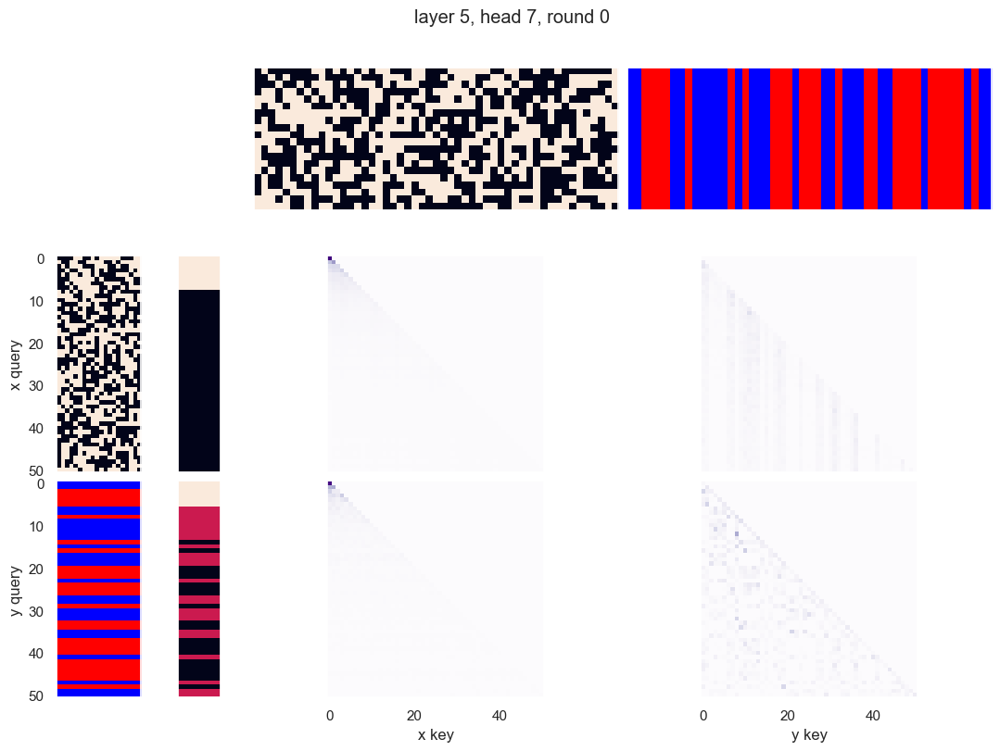

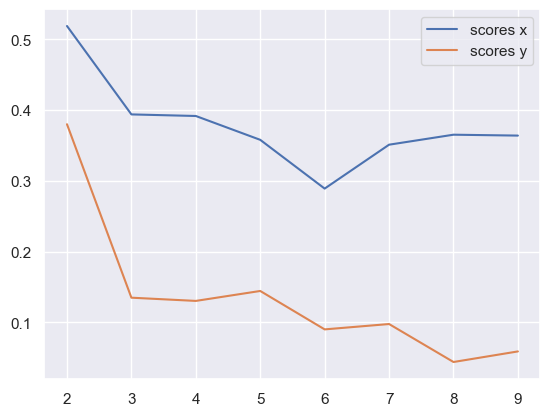

x query cluster:
SVM coefs: [-2.32148677e-01 -4.20216051e-01  7.42617647e-01  4.45014615e-01
  2.98550709e-01  3.58288327e-01  1.10682826e-01  1.84917316e-01
  8.03329948e-01  1.45550249e-01 -4.82853003e-01  6.11617452e-01
  2.99708668e-01 -6.64192039e-01 -3.04163702e-02 -3.23291346e-05
 -1.14823856e-01 -5.54174211e-01  5.13599237e-01  6.00330278e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.63; (2) +14: 0.63; (3) +13: 0.63; (4) +9: 0.60; (5) -16: 0.60; (6) -12: 0.60; (7) +19: 0.60; (8) -3: 0.58; (9) +11: 0.56; (10) +5: 0.56
(1) +0 AND +9: 0.47; (2) +9 AND +13: 0.44; (3) -3 AND +19: 0.44; (4) -12 AND +19: 0.42; (5) +13 AND +14: 0.42; (6) +9 AND +14: 0.42; (7) +0 AND -16: 0.42; (8) -12 AND -15: 0.42; (9) +5 AND -16: 0.42; (10) +0 AND -12: 0.42
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +9 OR -12: 0.91; (6) +0 OR +17: 0.88; (7) +5 OR

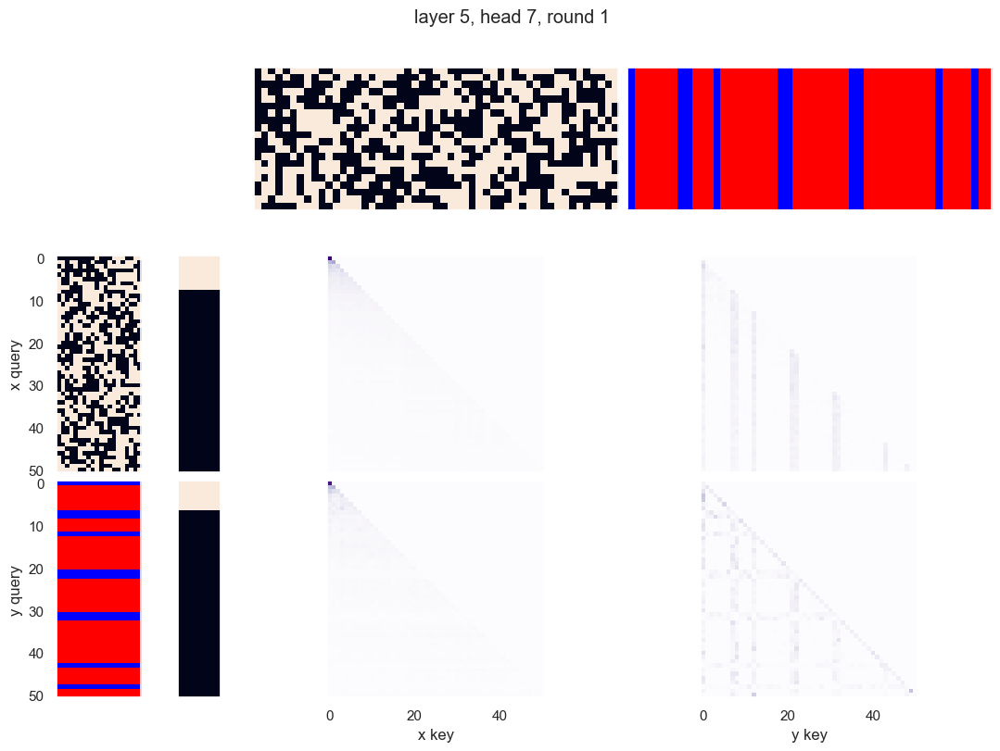

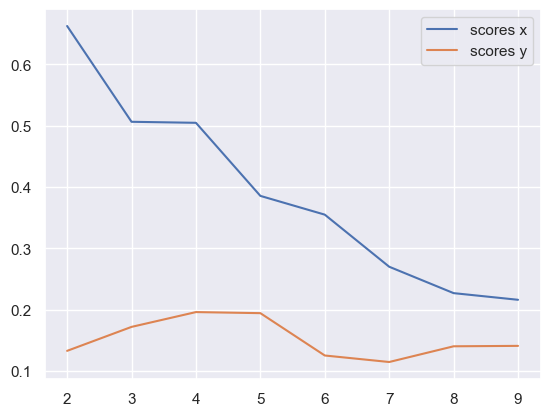

x query cluster:
SVM coefs: [ 0.25510348 -0.45922273  0.27299262  0.17551032 -0.21551543 -0.11984904
  0.07025126 -0.09278071  0.10832007  0.49035291 -0.0037133   0.20239096
 -0.1110449   0.23137769  0.04469956 -0.29458117 -0.46677535 -0.52135043
  0.57332102  0.62858871]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) +17: 0.64; (3) -19: 0.62; (4) +2: 0.62; (5) +8: 0.60; (6) +13: 0.60; (7) -0: 0.60; (8) +14: 0.60; (9) -9: 0.57; (10) +6: 0.57
(1) +8 AND +16: 0.47; (2) +17 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) -9 AND -19: 0.45; (5) -5 AND +16: 0.45; (6) +7 AND +16: 0.45; (7) -0 AND +17: 0.43; (8) -9 AND +13: 0.43; (9) +8 AND +13: 0.43; (10) +17 AND -18: 0.43
(1) +12 OR +16: 0.91; (2) +14 OR +16: 0.91; (3) +13 OR +16: 0.89; (4) +15 OR +16: 0.89; (5) +6 OR +16: 0.89; (6) +5 OR +16: 0.89; (7) +16 OR -19: 0.89; (8) +2 OR +16: 0.89; (9) +7 OR +17: 0.89; (10) +2 OR +4

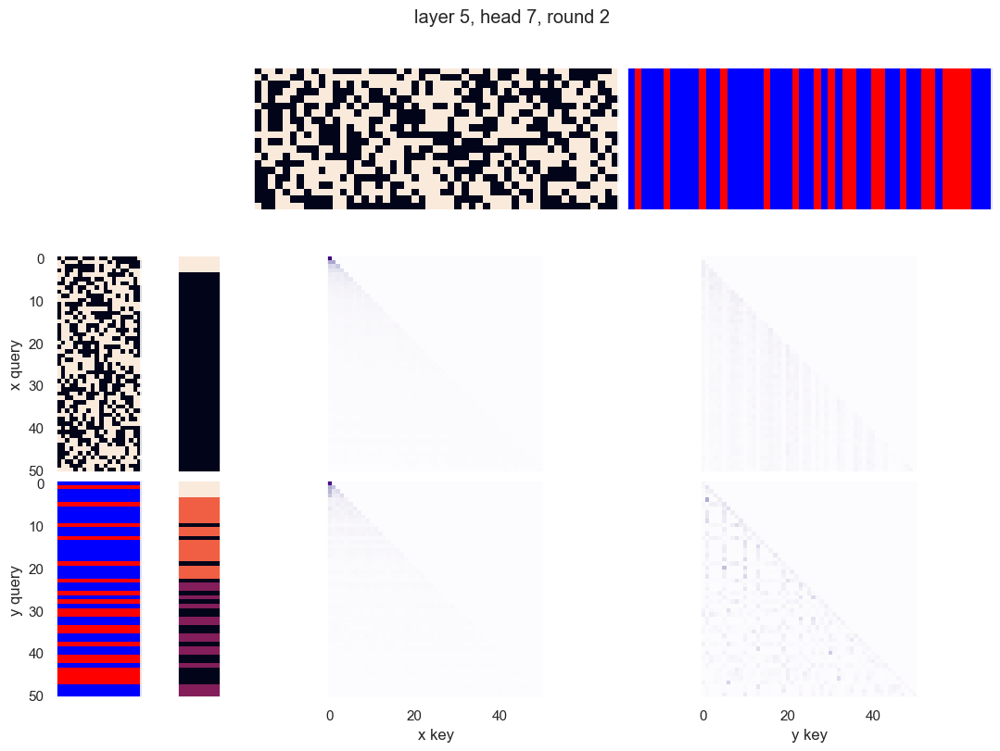

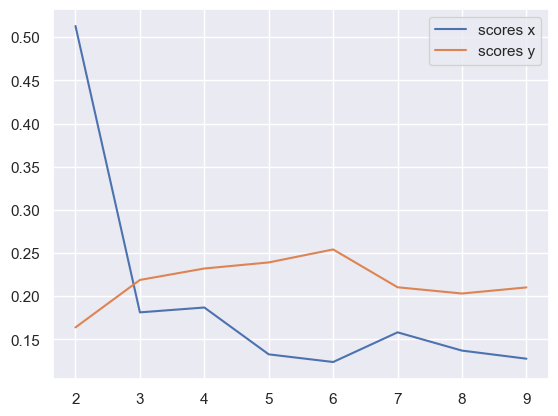

x query cluster:
SVM coefs: [ 0.10543743 -0.37931132  0.16403135  0.12083564 -0.24402588 -0.10237238
  0.08437089 -0.23419331  0.18886614  0.6635371  -0.04109716  0.52820951
 -0.17284375  0.0694913  -0.03457446 -0.08149747 -0.14972341 -0.68104115
  0.62447345  0.75904629]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17

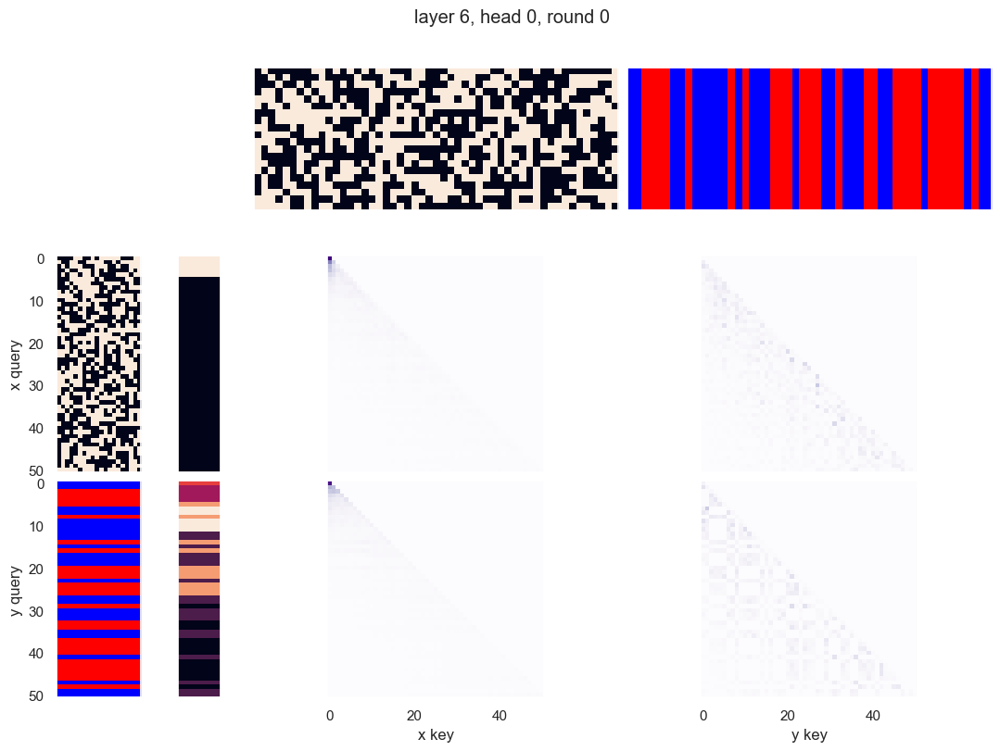

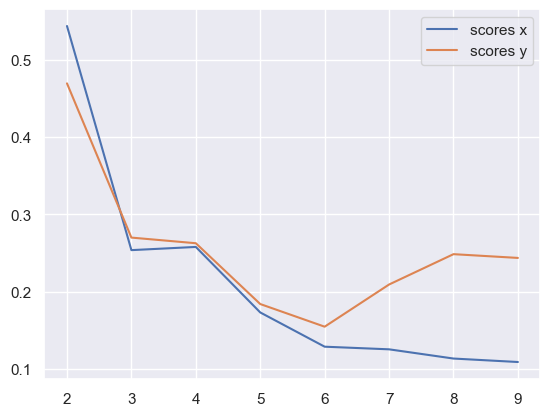

x query cluster:
SVM coefs: [ 0.10544168 -0.37930845  0.16403283  0.12083494 -0.24402757 -0.10237027
  0.08436982 -0.23419023  0.18886541  0.66353258 -0.04109465  0.5282107
 -0.17284404  0.06949492 -0.03458151 -0.08149443 -0.1497249  -0.6810368
  0.62447408  0.75904491]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) +19: 0.61; (4) +13: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +6: 0.57; (8) +5: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) +9 AND +13: 0.41; (4) +0 AND -12: 0.41; (5) +0 AND -16: 0.41; (6) +13 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +5 AND -16: 0.41; (9) -12 AND +19: 0.41; (10) +0 AND +19: 0.39
(1) +13 OR +19: 0.91; (2) -12 OR +13: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR +19: 0.89; (5) +0 OR +17: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -15: 0.89; (8) +0 OR +11: 0.89; (9) +14 OR -16: 0.89; (10) -16 OR +19: 0

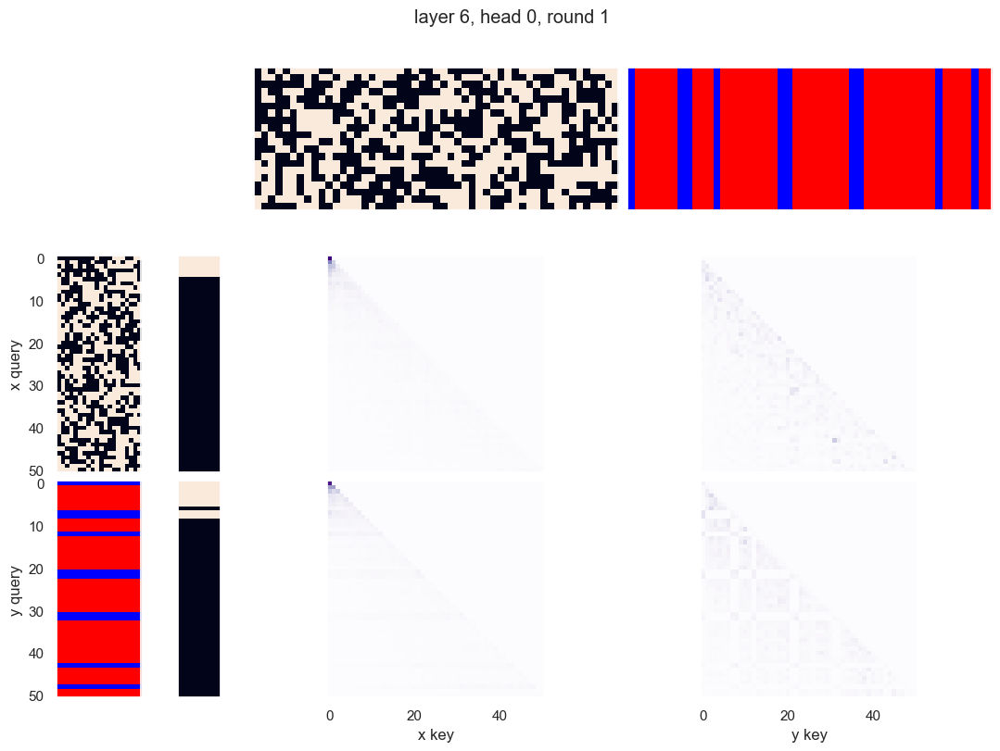

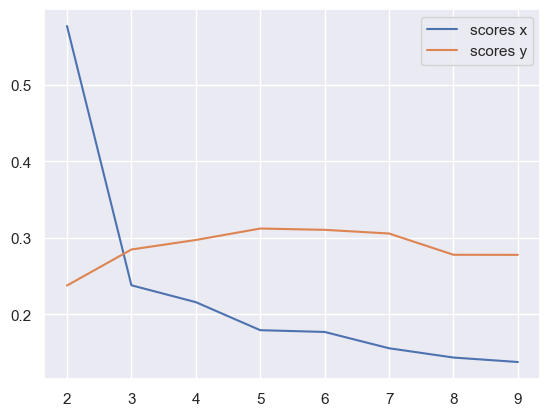

x query cluster:
SVM coefs: [ 0.25509827 -0.45921848  0.27299383  0.17551318 -0.21552206 -0.11984963
  0.07025342 -0.09279257  0.10831637  0.49036052 -0.00371725  0.20238005
 -0.11105076  0.23138286  0.04469596 -0.29457791 -0.46677612 -0.52135216
  0.57332311  0.62858994]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) +17: 0.64; (3) -19: 0.62; (4) +2: 0.62; (5) +8: 0.60; (6) +13: 0.60; (7) -0: 0.60; (8) +14: 0.60; (9) -9: 0.57; (10) +6: 0.57
(1) +8 AND +16: 0.47; (2) +17 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) -9 AND -19: 0.45; (5) -5 AND +16: 0.45; (6) +7 AND +16: 0.45; (7) -0 AND +17: 0.43; (8) -9 AND +13: 0.43; (9) +8 AND +13: 0.43; (10) +17 AND -18: 0.43
(1) +12 OR +16: 0.91; (2) +14 OR +16: 0.91; (3) +13 OR +16: 0.89; (4) +15 OR +16: 0.89; (5) +6 OR +16: 0.89; (6) +5 OR +16: 0.89; (7) +16 OR -19: 0.89; (8) +2 OR +16: 0.89; (9) +7 OR +17: 0.89; (10) +2 OR +4

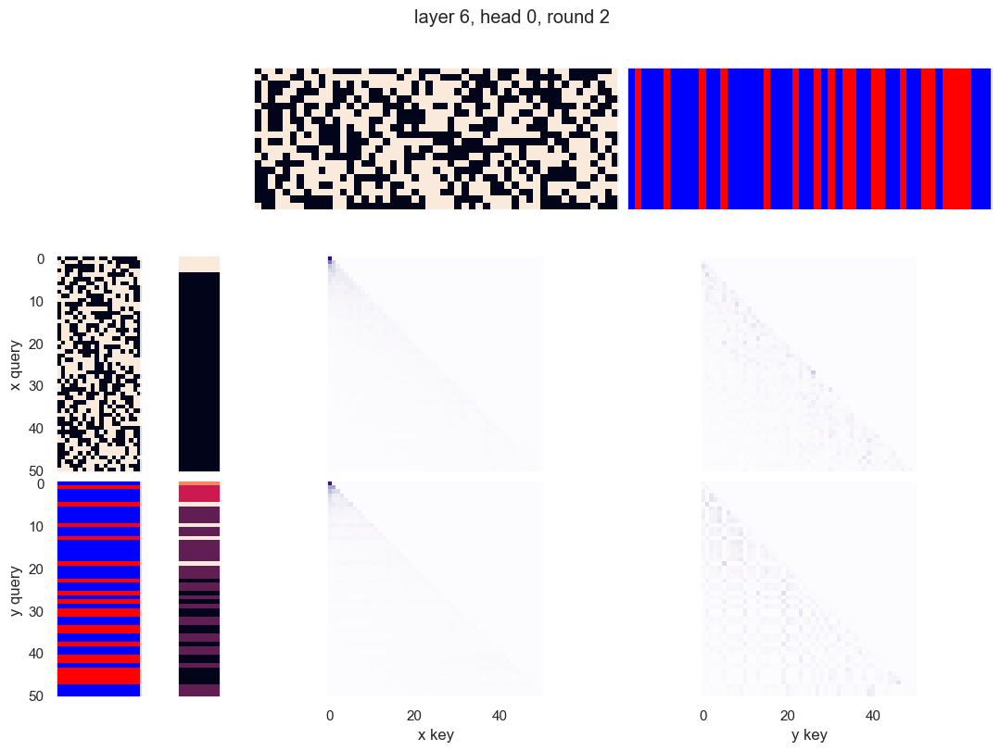

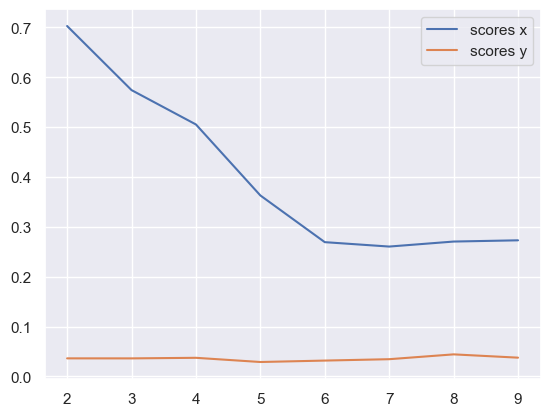

x query cluster:
SVM coefs: [ 0.26248152 -0.32281896  0.10228748  0.1478112  -0.20819857 -0.04184166
 -0.08338785 -0.00501568  0.46534085  0.28237279  0.02753789  0.2601404
  0.04954918  0.13378216  0.13218418 -0.16053288 -0.24773457 -0.57431667
  0.37581441  0.68953537]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.65; (3) -11: 0.62; (4) -18: 0.62; (5) -12: 0.62; (6) +6: 0.62; (7) +10: 0.60; (8) -0: 0.58; (9) -3: 0.58; (10) +2: 0.58
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) -3 AND -18: 0.48; (5) +5 AND +17: 0.46; (6) -11 AND +17: 0.46; (7) +13 AND -18: 0.46; (8) +17 AND -18: 0.46; (9) -0 AND +17: 0.46; (10) +6 AND -16: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) -16 OR +17: 0.92; (7) +17 OR -19: 0.92; (8) +7 OR +10: 0.92; (9) +6 OR +10: 0.92; (10) +4 OR

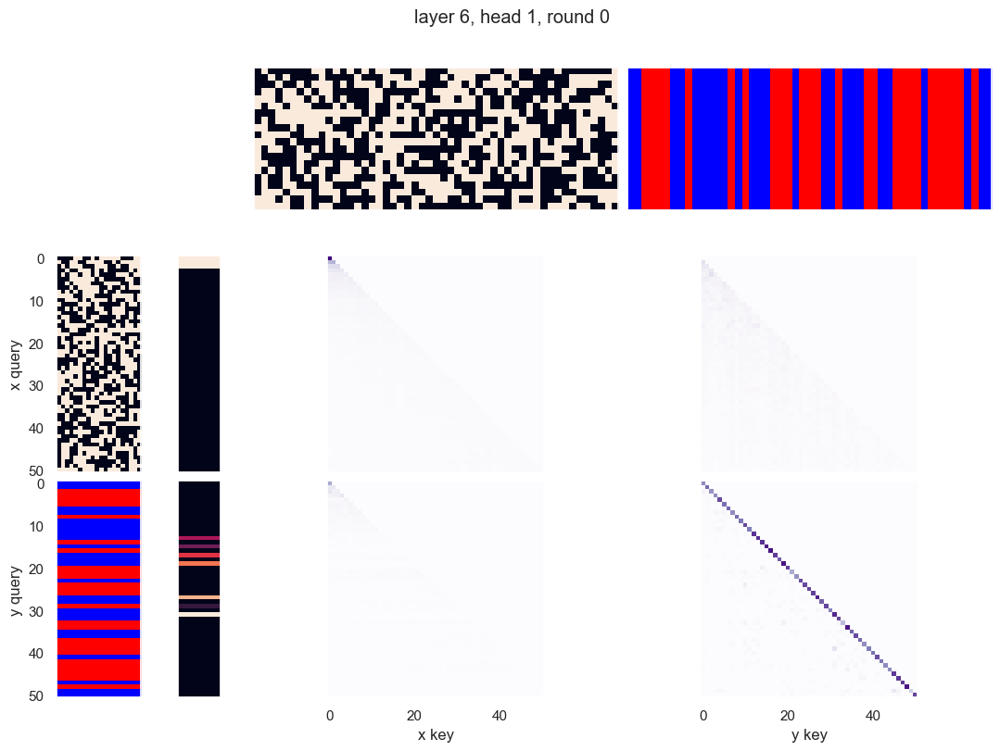

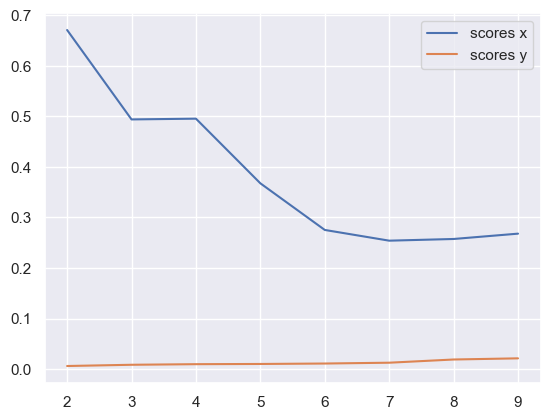

x query cluster:
SVM coefs: [ 0.2551042  -0.45922102  0.27298889  0.17552172 -0.21551361 -0.11985059
  0.07025176 -0.09278961  0.10832451  0.49035906 -0.0037111   0.20237685
 -0.11104845  0.23138503  0.04469721 -0.29458054 -0.46677325 -0.52135281
  0.57331813  0.6285905 ]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +0: 0.64; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.57; (7) +6: 0.57; (8) +17: 0.55; (9) +11: 0.55; (10) +5: 0.55
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) -12 AND -15: 0.40; (4) +5 AND -16: 0.40; (5) -12 AND +19: 0.40; (6) +9 AND +13: 0.40; (7) -4 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) -2 AND -12: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +0 OR +11: 0.89; (4) +14 OR +19: 0.89; (5) +14 OR +17: 0.89; (6) +0 OR +17: 0.89; (7) +13 OR +19: 0.89; (8) +14 OR -15: 0.89; (9) +14 OR -16: 0.89; (10) -12 OR

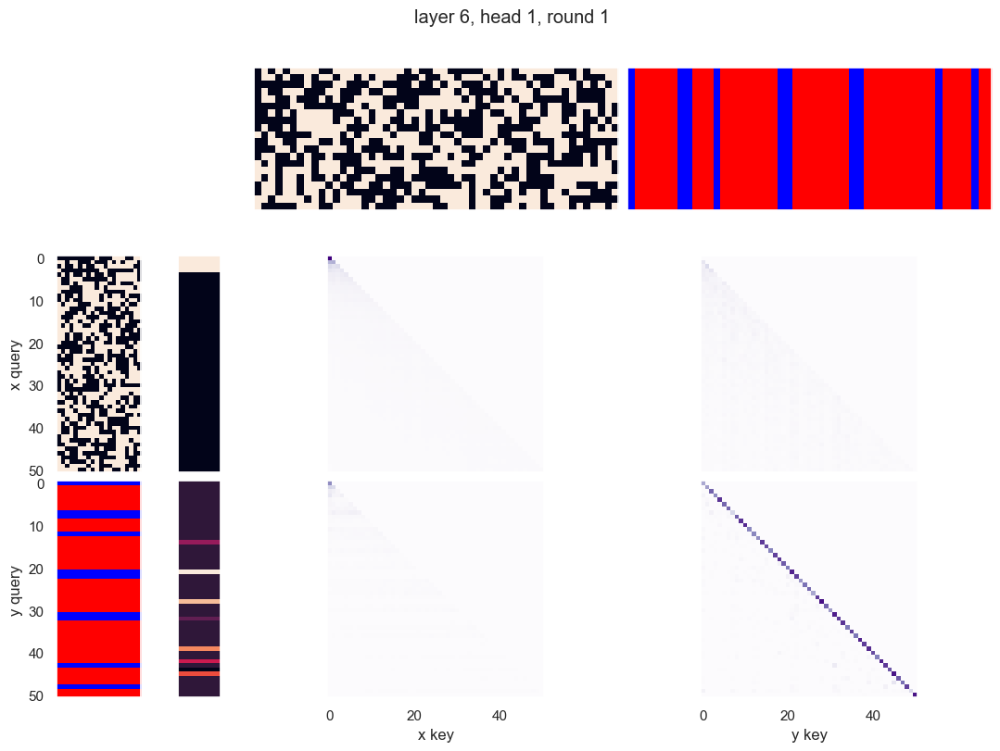

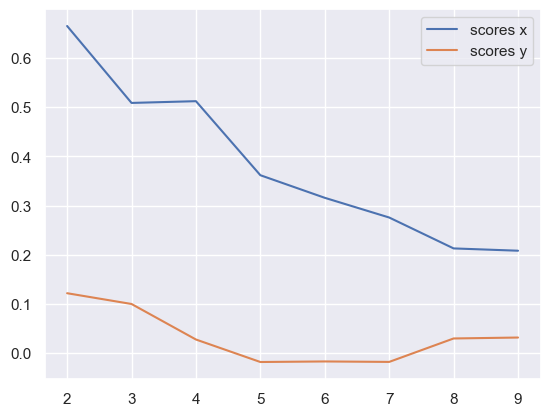

x query cluster:
SVM coefs: [ 0.25510431 -0.45921982  0.27299195  0.17551745 -0.21552042 -0.11985462
  0.07025337 -0.09279429  0.10832218  0.49036464 -0.00371441  0.20237595
 -0.1110508   0.23138662  0.04469502 -0.29457851 -0.46677324 -0.52135154
  0.57332386  0.62858882]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) +17: 0.64; (3) -19: 0.62; (4) +2: 0.62; (5) +8: 0.60; (6) +13: 0.60; (7) -0: 0.60; (8) +14: 0.60; (9) -9: 0.57; (10) +6: 0.57
(1) +8 AND +16: 0.47; (2) +17 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) -9 AND -19: 0.45; (5) -5 AND +16: 0.45; (6) +7 AND +16: 0.45; (7) -0 AND +17: 0.43; (8) -9 AND +13: 0.43; (9) +8 AND +13: 0.43; (10) +17 AND -18: 0.43
(1) +12 OR +16: 0.91; (2) +14 OR +16: 0.91; (3) +13 OR +16: 0.89; (4) +15 OR +16: 0.89; (5) +6 OR +16: 0.89; (6) +5 OR +16: 0.89; (7) +16 OR -19: 0.89; (8) +2 OR +16: 0.89; (9) +7 OR +17: 0.89; (10) +2 OR +4

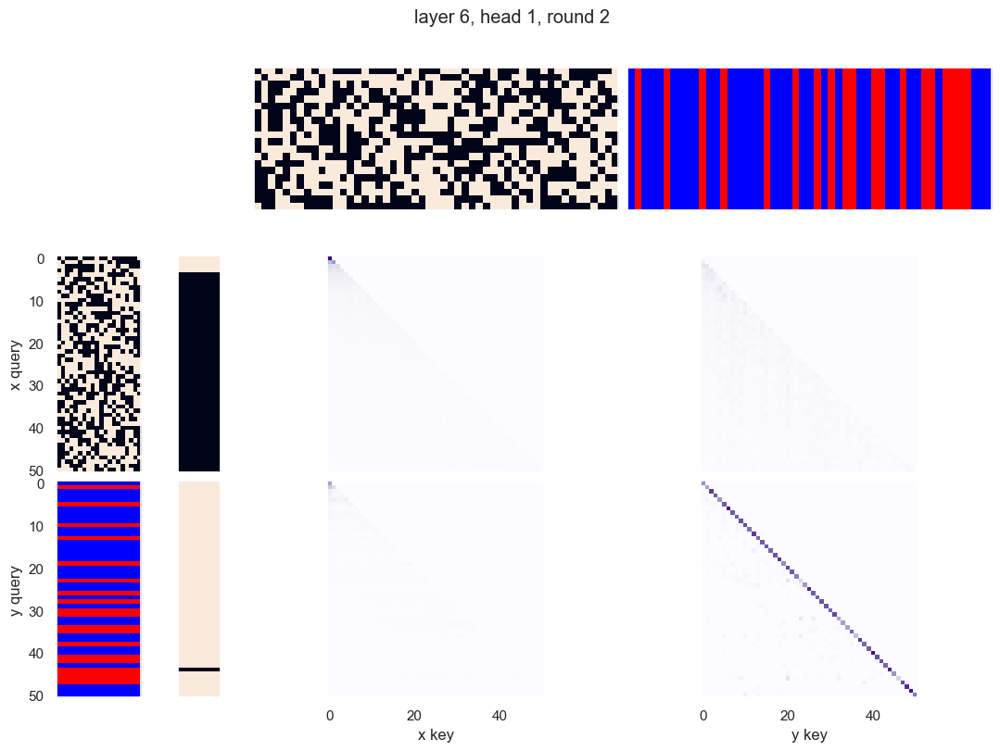

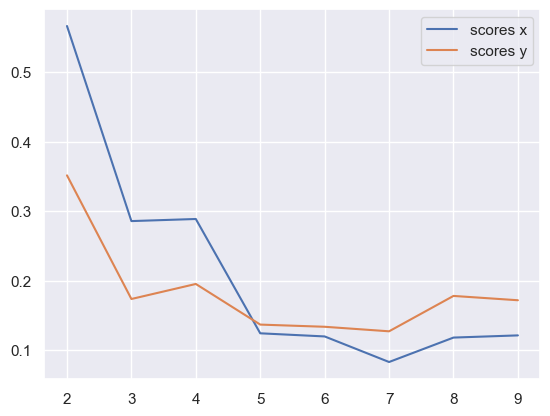

x query cluster:
SVM coefs: [ 0.25510269 -0.45921952  0.27299175  0.17551645 -0.21551948 -0.11985356
  0.07025064 -0.09279439  0.10831867  0.49036042 -0.00371359  0.20237719
 -0.11104625  0.23138594  0.04469466 -0.29457609 -0.46678009 -0.52135211
  0.57332406  0.62858954]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR

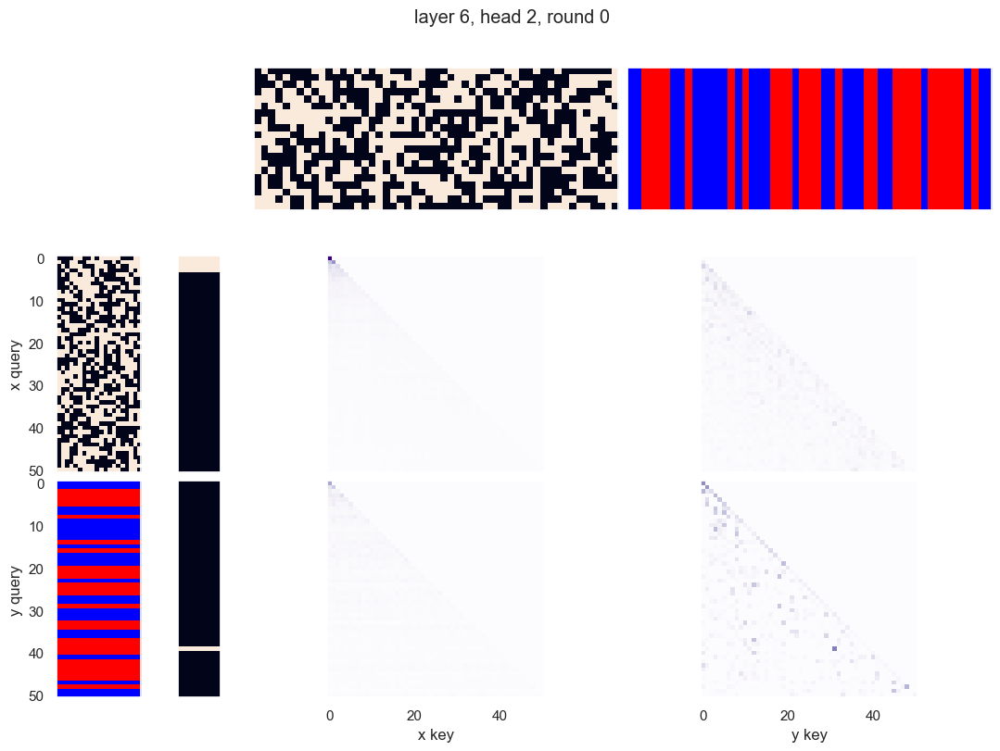

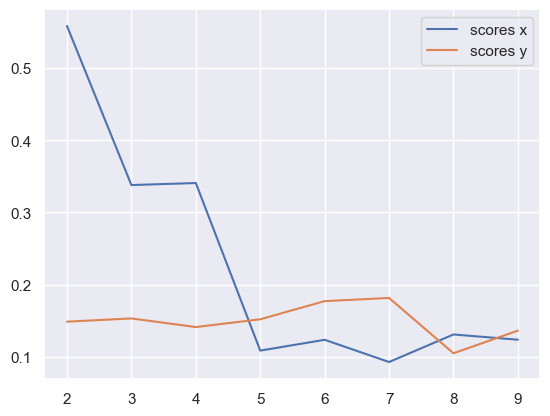

x query cluster:
SVM coefs: [ 0.10543732 -0.37930971  0.16403294  0.12083233 -0.24402502 -0.10236895
  0.08437324 -0.2341911   0.18886103  0.66353257 -0.04109572  0.52821219
 -0.17284491  0.06949512 -0.03457932 -0.08149599 -0.14972365 -0.68104041
  0.62447504  0.75904373]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) +19: 0.61; (4) +13: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +6: 0.57; (8) +5: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) +9 AND +13: 0.41; (4) +0 AND -12: 0.41; (5) +0 AND -16: 0.41; (6) +13 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +5 AND -16: 0.41; (9) -12 AND +19: 0.41; (10) +0 AND +19: 0.39
(1) +13 OR +19: 0.91; (2) -12 OR +13: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR +19: 0.89; (5) +0 OR +17: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -15: 0.89; (8) +0 OR +11: 0.89; (9) +14 OR -16: 0.89; (10) -16 OR +19:

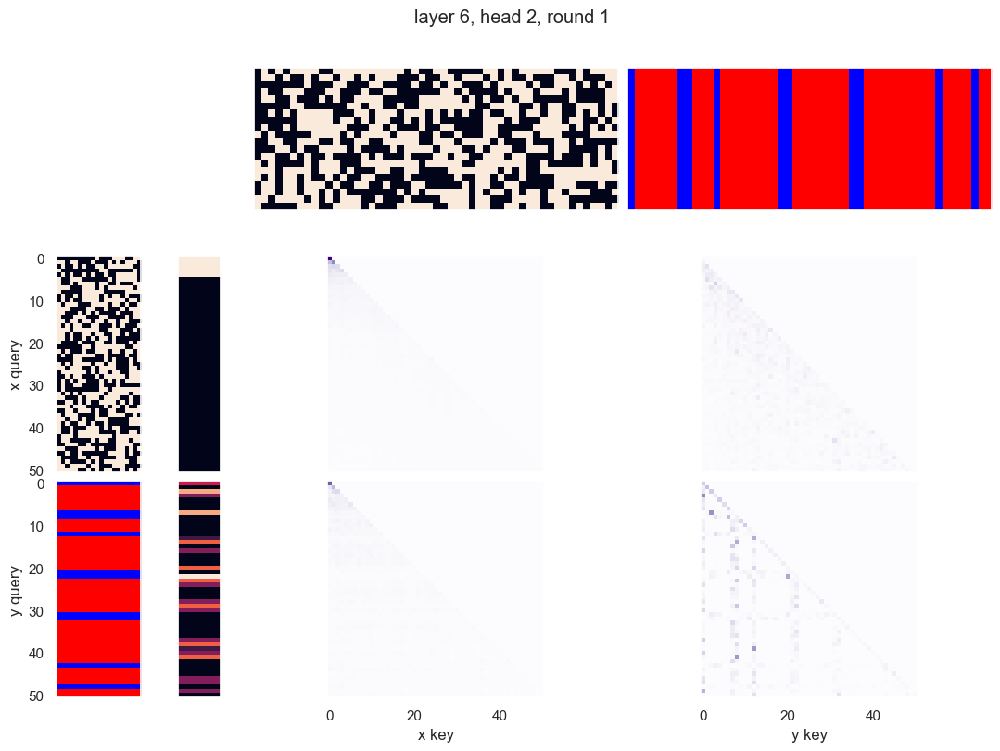

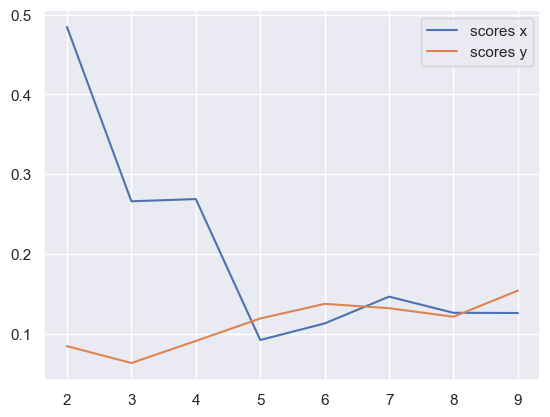

x query cluster:
SVM coefs: [-0.28794525 -0.47313709  1.02874114  0.38310878  0.32285411  0.25921345
  0.01952224  0.0016929   0.67963547  0.27149297 -0.32584408  0.59225181
  0.2776992  -0.56683139  0.12307551 -0.0507418   0.26542284 -0.64575765
  0.50792873  0.61017925]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) -19: 0.66; (3) +17: 0.64; (4) +13: 0.64; (5) +2: 0.61; (6) -0: 0.61; (7) +8: 0.59; (8) -9: 0.59; (9) +7: 0.59; (10) +14: 0.59
(1) +17 AND -19: 0.50; (2) -9 AND -19: 0.48; (3) +16 AND +17: 0.48; (4) -9 AND +13: 0.45; (5) -18 AND -19: 0.45; (6) +7 AND +16: 0.45; (7) +8 AND +13: 0.45; (8) +8 AND +16: 0.45; (9) -0 AND +16: 0.43; (10) +13 AND -19: 0.43
(1) -10 OR -19: 0.93; (2) -10 OR +13: 0.91; (3) +13 OR +16: 0.91; (4) +15 OR +16: 0.91; (5) +16 OR -19: 0.91; (6) +14 OR +16: 0.91; (7) +12 OR +16: 0.91; (8) +18 OR -19: 0.91; (9) +7 OR -19: 0.91; (10) +2 OR +16: 0.

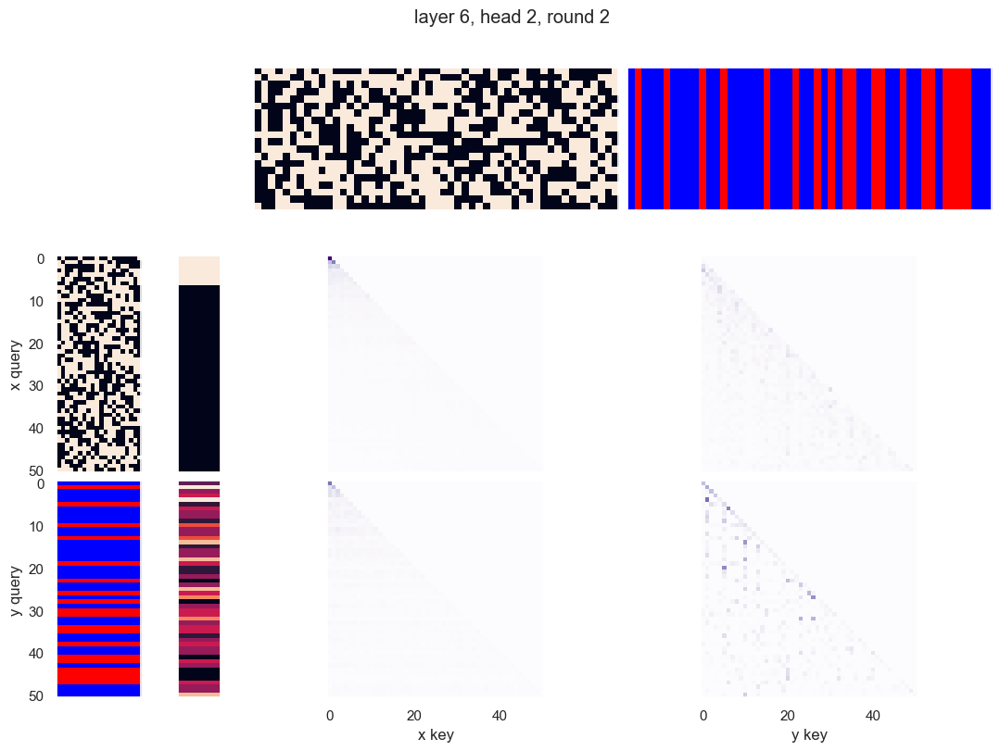

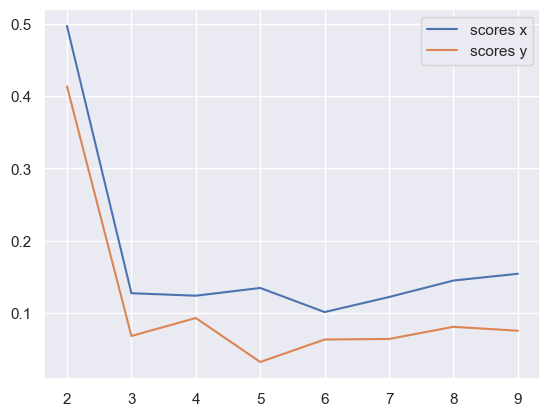

x query cluster:
SVM coefs: [ 0.25510313 -0.45922108  0.27298829  0.17551479 -0.21550762 -0.11984923
  0.07025054 -0.09277123  0.10832648  0.49035493 -0.00370923  0.20238721
 -0.11104667  0.23137245  0.04470317 -0.29457977 -0.46677198 -0.5213559
  0.57331129  0.62859108]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR 

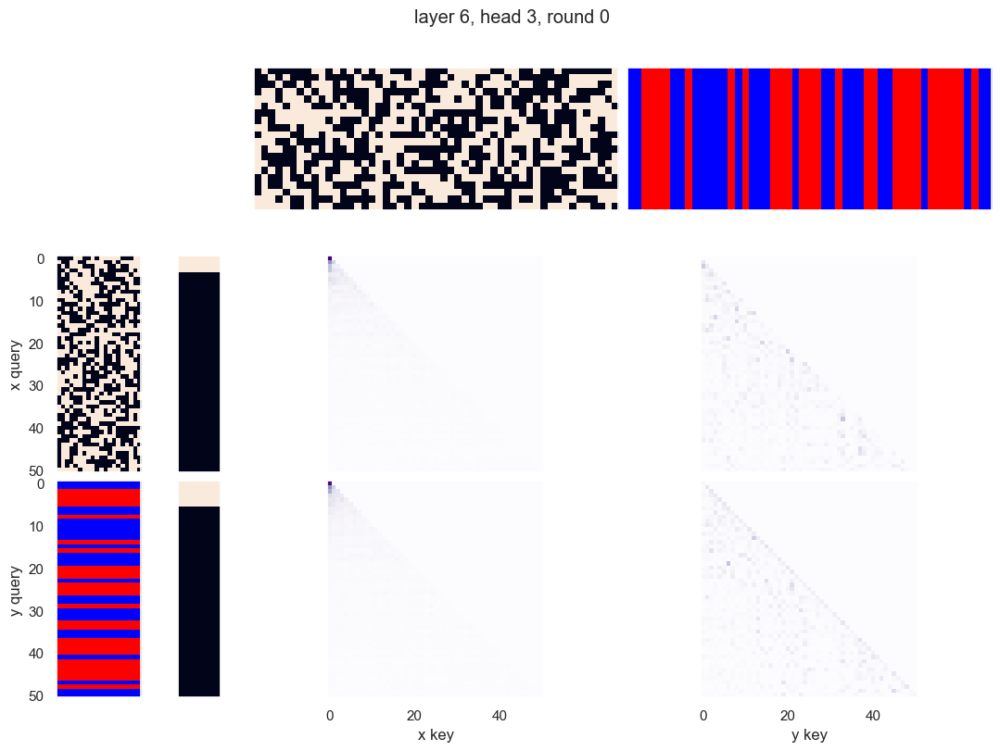

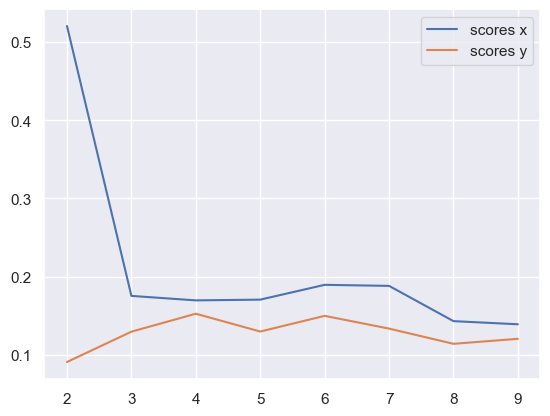

x query cluster:
SVM coefs: [ 0.25510262 -0.4592202   0.2729914   0.17551694 -0.21551677 -0.11985474
  0.07025271 -0.09279223  0.10832335  0.49036051 -0.00371221  0.20237808
 -0.11104714  0.23138755  0.04469265 -0.29457667 -0.46677645 -0.52135391
  0.57332601  0.62858971]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +0: 0.64; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.57; (7) +6: 0.57; (8) +17: 0.55; (9) +11: 0.55; (10) +5: 0.55
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) -12 AND -15: 0.40; (4) +5 AND -16: 0.40; (5) -12 AND +19: 0.40; (6) +9 AND +13: 0.40; (7) -4 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) -2 AND -12: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +0 OR +11: 0.89; (4) +14 OR +19: 0.89; (5) +14 OR +17: 0.89; (6) +0 OR +17: 0.89; (7) +13 OR +19: 0.89; (8) +14 OR -15: 0.89; (9) +14 OR -16: 0.89; (10) -12 OR

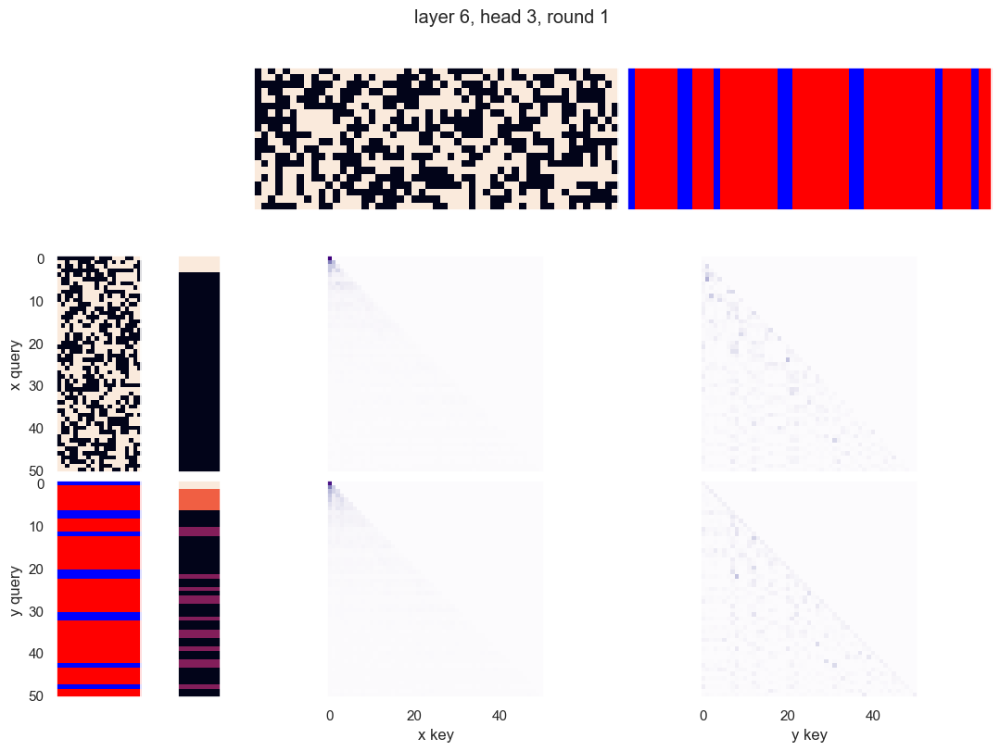

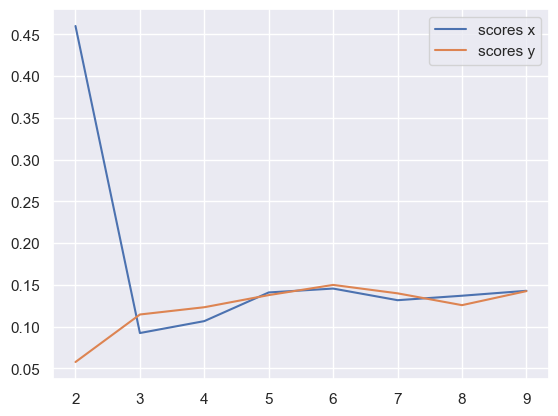

x query cluster:
SVM coefs: [-0.28794191 -0.47313719  1.02873946  0.38310681  0.32285293  0.25920851
  0.01952075  0.00168739  0.67963857  0.27148899 -0.32583883  0.59225452
  0.27770195 -0.56682969  0.12307503 -0.05074224  0.26541931 -0.64576058
  0.50792658  0.61017617]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) -19: 0.66; (3) +17: 0.64; (4) +13: 0.64; (5) +2: 0.61; (6) -0: 0.61; (7) +8: 0.59; (8) -9: 0.59; (9) +7: 0.59; (10) +14: 0.59
(1) +17 AND -19: 0.50; (2) -9 AND -19: 0.48; (3) +16 AND +17: 0.48; (4) -9 AND +13: 0.45; (5) -18 AND -19: 0.45; (6) +7 AND +16: 0.45; (7) +8 AND +13: 0.45; (8) +8 AND +16: 0.45; (9) -0 AND +16: 0.43; (10) +13 AND -19: 0.43
(1) -10 OR -19: 0.93; (2) -10 OR +13: 0.91; (3) +13 OR +16: 0.91; (4) +15 OR +16: 0.91; (5) +16 OR -19: 0.91; (6) +14 OR +16: 0.91; (7) +12 OR +16: 0.91; (8) +18 OR -19: 0.91; (9) +7 OR -19: 0.91; (10) +2 OR +16: 0.

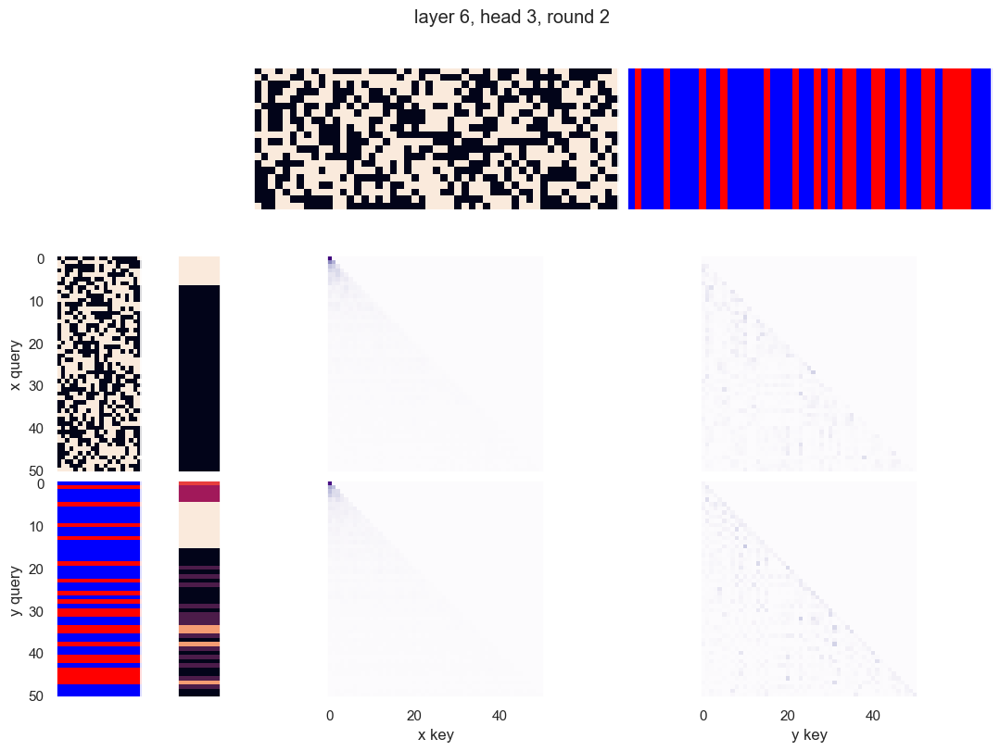

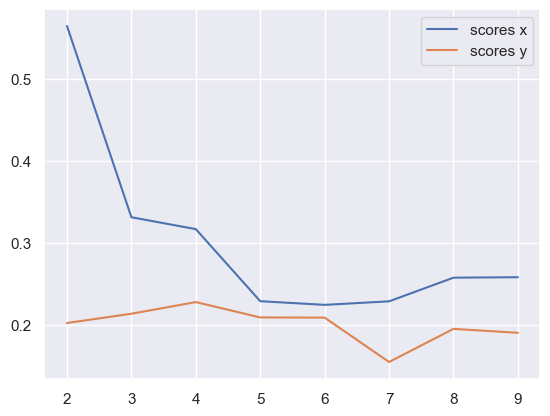

x query cluster:
SVM coefs: [-0.46865595 -0.57678022  0.2772111   0.21226455 -0.11848061 -0.05889256
  0.00723439 -0.45952035  0.42596715  0.43341157 -0.08995871  0.23646945
 -0.24495289 -0.49575544 -0.2961282   0.1730615   0.11536626 -0.67924223
  0.21284554  0.87186743]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10:

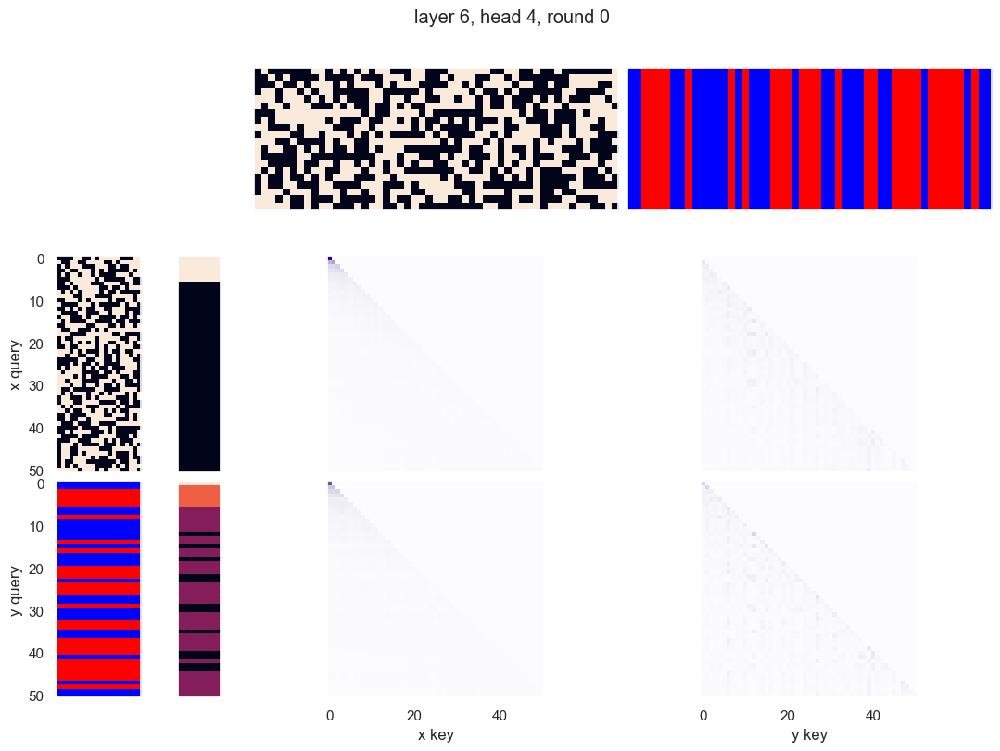

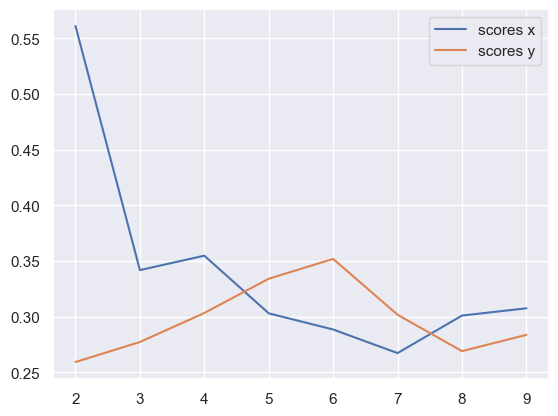

x query cluster:
SVM coefs: [-0.46864971 -0.57677824  0.27720771  0.21226698 -0.118481   -0.05889601
  0.00723406 -0.45952277  0.42597002  0.43340716 -0.08995587  0.23647097
 -0.24495171 -0.49575393 -0.29612986  0.17306016  0.11536756 -0.67924217
  0.21284333  0.87186513]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +19: 0.62; (4) +13: 0.62; (5) -16: 0.60; (6) -12: 0.60; (7) +6: 0.58; (8) +9: 0.58; (9) -3: 0.58; (10) -4: 0.56
(1) -3 AND +19: 0.44; (2) +0 AND +9: 0.44; (3) +0 AND -12: 0.42; (4) +13 AND +14: 0.42; (5) +5 AND -16: 0.42; (6) +9 AND +13: 0.42; (7) -12 AND +19: 0.42; (8) -12 AND -15: 0.42; (9) +0 AND -16: 0.42; (10) -2 AND -12: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +0 OR +11: 0.89; (6) +0 OR +17: 0.89; (7) +14 OR +17: 0.89; (8) +7 OR -12: 0.89; (9) +14 OR -16: 0.89; (10) +6 OR -16: 0.89

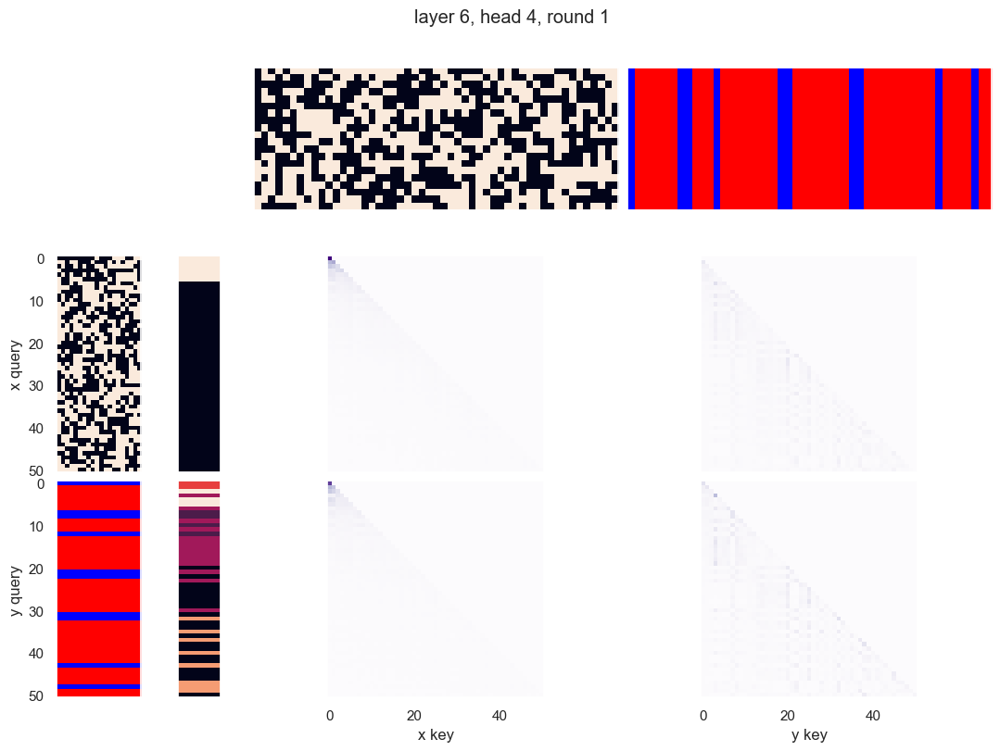

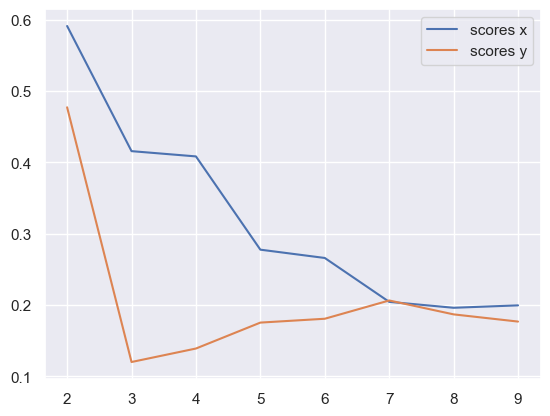

x query cluster:
SVM coefs: [ 0.10543786 -0.37931181  0.1640295   0.12083662 -0.24402335 -0.10237247
  0.08436956 -0.2341934   0.18886418  0.66353987 -0.04109227  0.52820843
 -0.17284812  0.06949002 -0.03457866 -0.0814971  -0.14971945 -0.68103739
  0.62447412  0.7590451 ]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

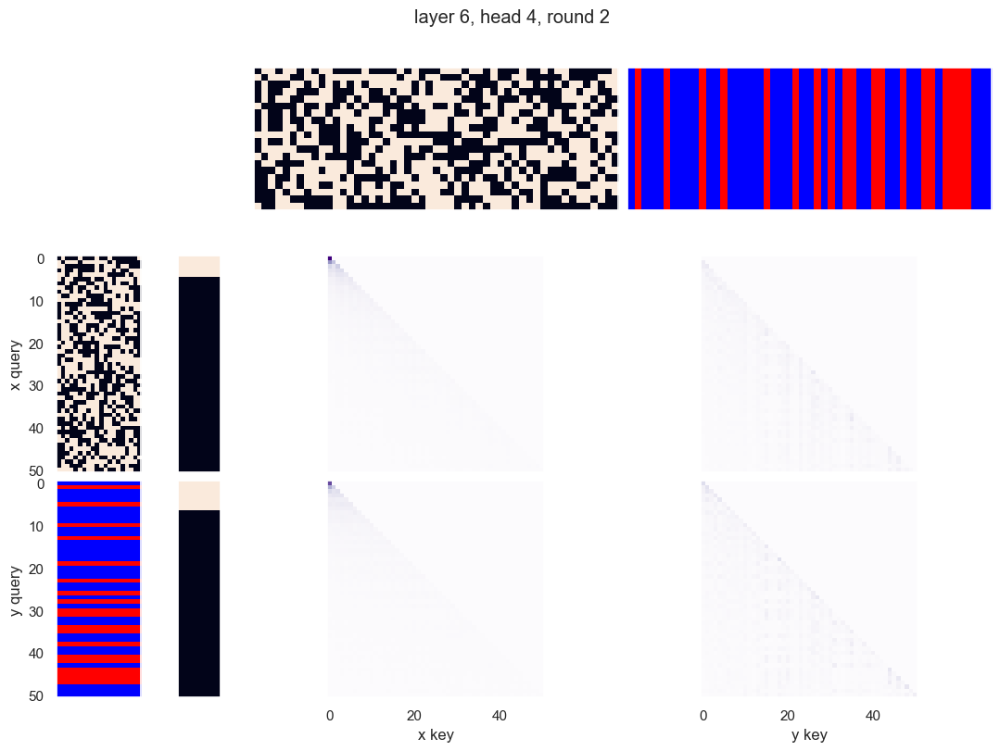

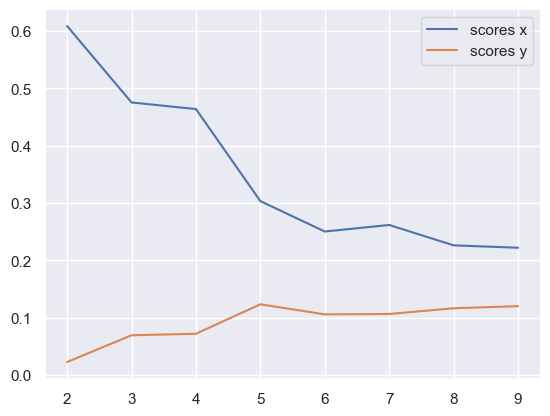

x query cluster:
SVM coefs: [-0.46865719 -0.57677514  0.27721477  0.21226016 -0.11847881 -0.05889423
  0.00724167 -0.45952228  0.42597306  0.43340903 -0.08996049  0.2364707
 -0.24494973 -0.4957531  -0.29612606  0.17306097  0.11536905 -0.67924105
  0.21284392  0.87187113]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10: 

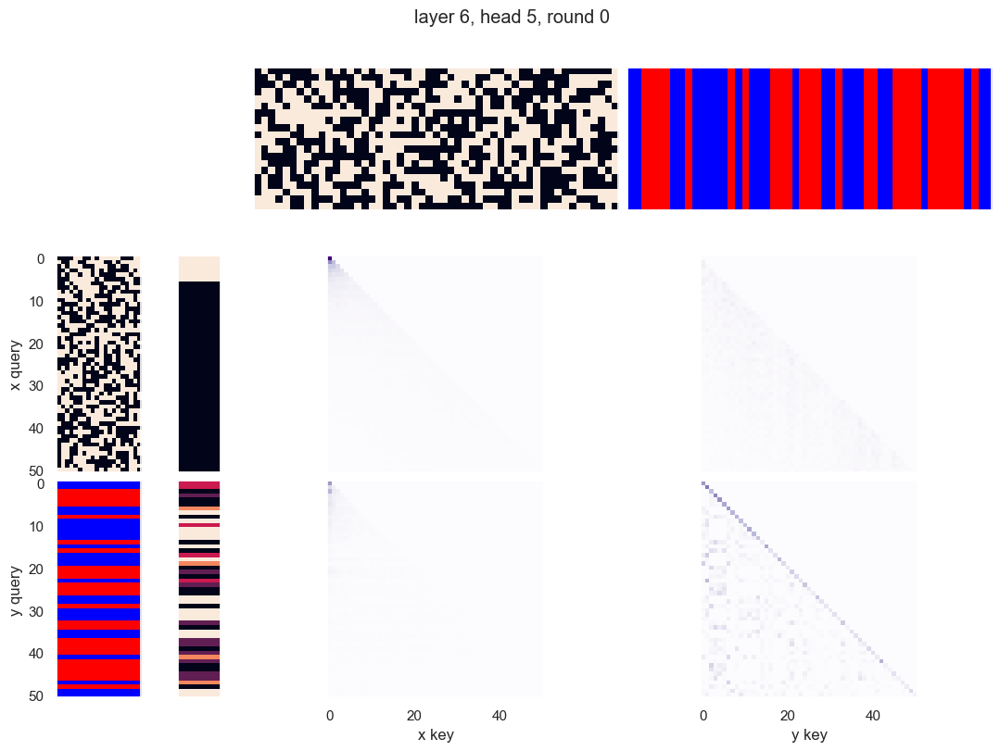

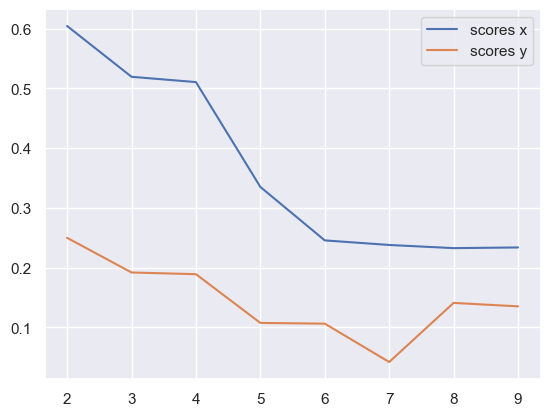

x query cluster:
SVM coefs: [-0.28794161 -0.47314164  1.02873853  0.3831094   0.32285414  0.25921401
  0.01951988  0.00168981  0.67964039  0.27149438 -0.32584053  0.59225038
  0.27769922 -0.56683531  0.12307331 -0.05074004  0.26542428 -0.64575449
  0.50792739  0.61018445]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +13: 0.64; (4) +19: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +9: 0.59; (8) -3: 0.59; (9) +6: 0.57; (10) +11: 0.55
(1) +0 AND +9: 0.45; (2) -3 AND +19: 0.45; (3) +9 AND +13: 0.43; (4) +13 AND +14: 0.43; (5) +0 AND +13: 0.41; (6) +9 AND +14: 0.41; (7) +13 AND -18: 0.41; (8) +0 AND -12: 0.41; (9) -12 AND -15: 0.41; (10) +5 AND -16: 0.41
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +6 OR -16: 0.89; (6) +7 OR -12: 0.89; (7) +14 OR +19: 0.89; (8) +14 OR +17: 0.89; (9) +14 OR -16: 0.89; (10) +0 OR +17: 0.89


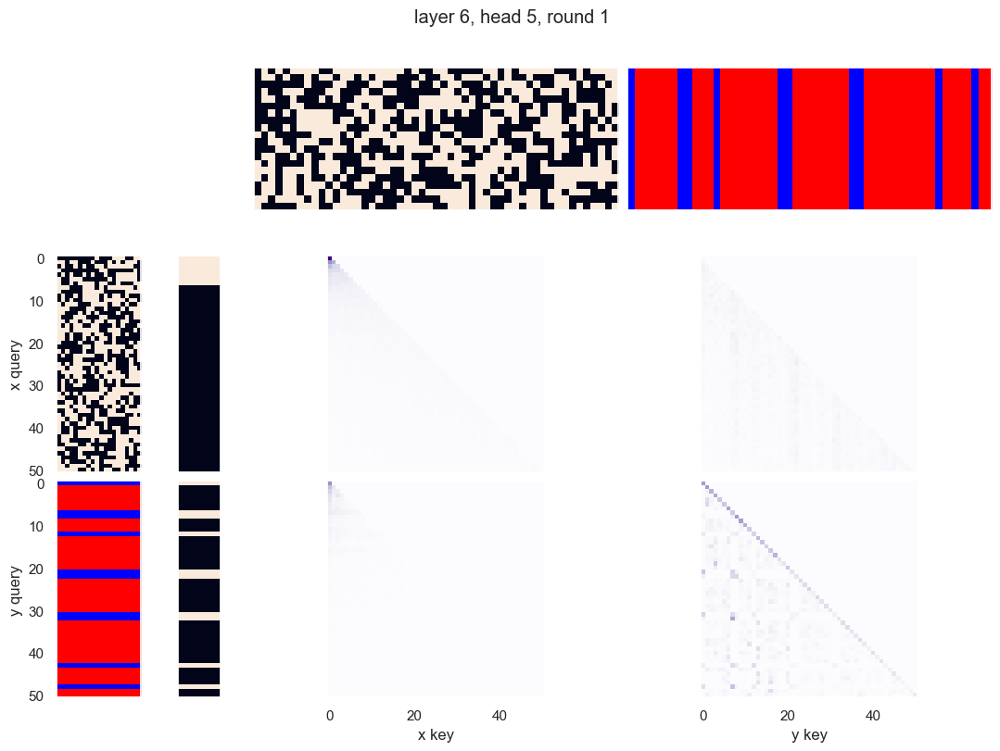

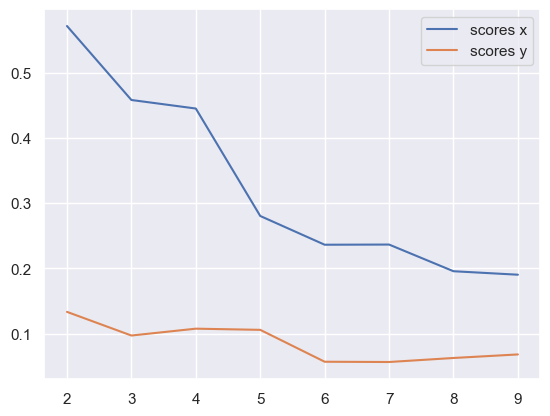

x query cluster:
SVM coefs: [-0.2879392  -0.47313612  1.02873944  0.38310529  0.32285644  0.25920966
  0.01951837  0.00168497  0.67963821  0.27149167 -0.3258387   0.5922524
  0.27770166 -0.56683119  0.12307448 -0.05074307  0.2654233  -0.64575599
  0.50792925  0.61018338]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) -19: 0.66; (3) +17: 0.64; (4) +13: 0.64; (5) +2: 0.61; (6) -0: 0.61; (7) +8: 0.59; (8) -9: 0.59; (9) +7: 0.59; (10) +14: 0.59
(1) +17 AND -19: 0.50; (2) -9 AND -19: 0.48; (3) +16 AND +17: 0.48; (4) -9 AND +13: 0.45; (5) -18 AND -19: 0.45; (6) +7 AND +16: 0.45; (7) +8 AND +13: 0.45; (8) +8 AND +16: 0.45; (9) -0 AND +16: 0.43; (10) +13 AND -19: 0.43
(1) -10 OR -19: 0.93; (2) -10 OR +13: 0.91; (3) +13 OR +16: 0.91; (4) +15 OR +16: 0.91; (5) +16 OR -19: 0.91; (6) +14 OR +16: 0.91; (7) +12 OR +16: 0.91; (8) +18 OR -19: 0.91; (9) +7 OR -19: 0.91; (10) +2 OR +16: 0.8

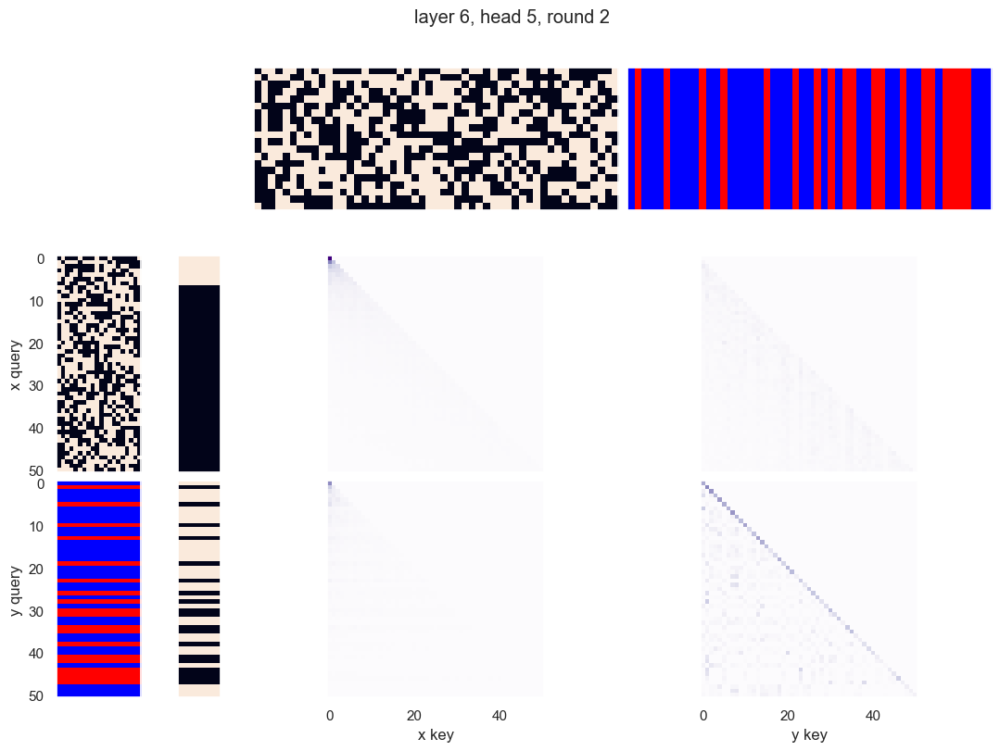

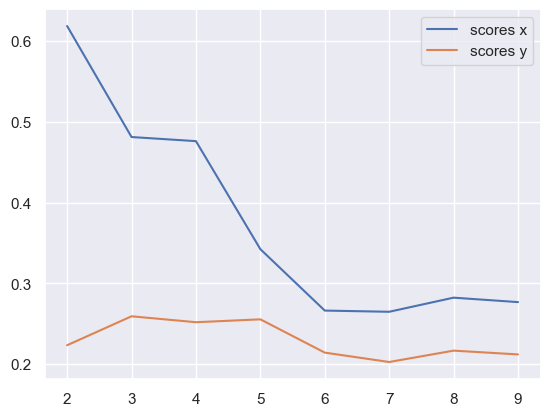

x query cluster:
SVM coefs: [-0.468659   -0.57677731  0.27721219  0.21226263 -0.1184812  -0.05889583
  0.00723798 -0.45951589  0.42596799  0.43340789 -0.08996119  0.23646973
 -0.24495258 -0.4957521  -0.29612282  0.17306099  0.11536693 -0.67924287
  0.21283964  0.87186976]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10:

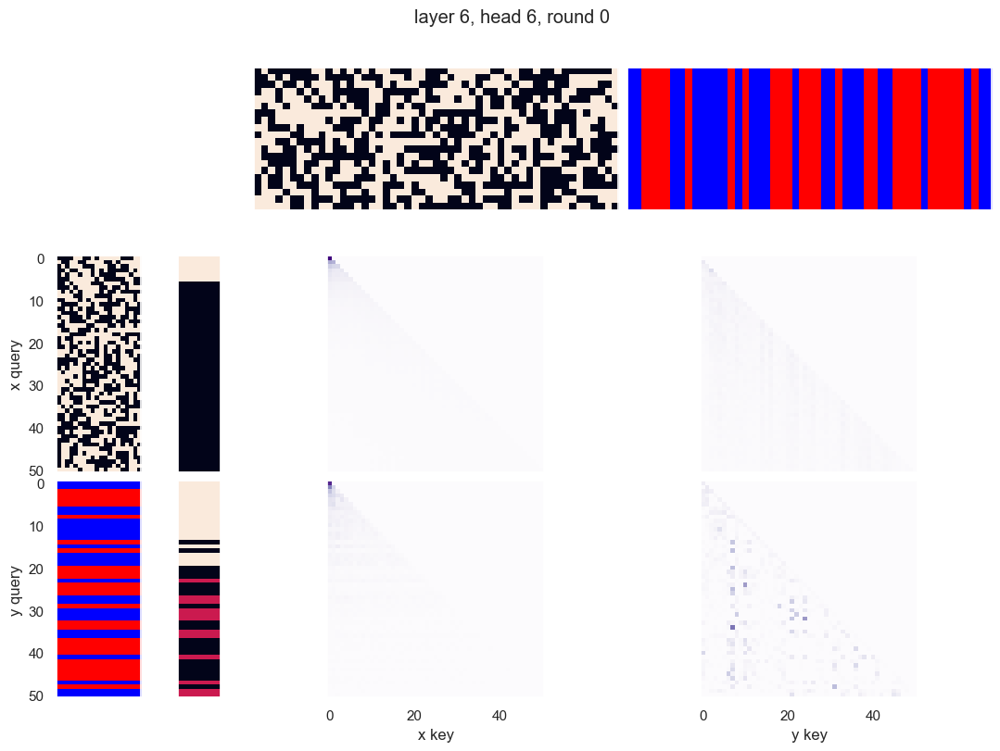

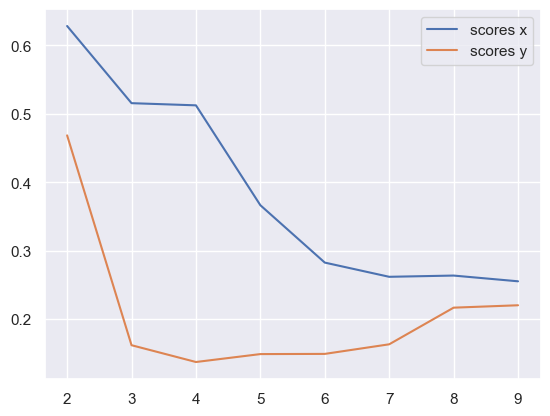

x query cluster:
SVM coefs: [-0.46865703 -0.57677533  0.27721085  0.21226278 -0.11847676 -0.05889014
  0.00723575 -0.45952079  0.42596511  0.43341239 -0.08995838  0.23646987
 -0.24495323 -0.49575065 -0.29612111  0.17306098  0.11536521 -0.67924247
  0.21284     0.87186905]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +19: 0.62; (4) +13: 0.62; (5) -16: 0.60; (6) -12: 0.60; (7) +6: 0.58; (8) +9: 0.58; (9) -3: 0.58; (10) -4: 0.56
(1) -3 AND +19: 0.44; (2) +0 AND +9: 0.44; (3) +0 AND -12: 0.42; (4) +13 AND +14: 0.42; (5) +5 AND -16: 0.42; (6) +9 AND +13: 0.42; (7) -12 AND +19: 0.42; (8) -12 AND -15: 0.42; (9) +0 AND -16: 0.42; (10) -2 AND -12: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +0 OR +11: 0.89; (6) +0 OR +17: 0.89; (7) +14 OR +17: 0.89; (8) +7 OR -12: 0.89; (9) +14 OR -16: 0.89; (10) +6 OR -16: 0.89

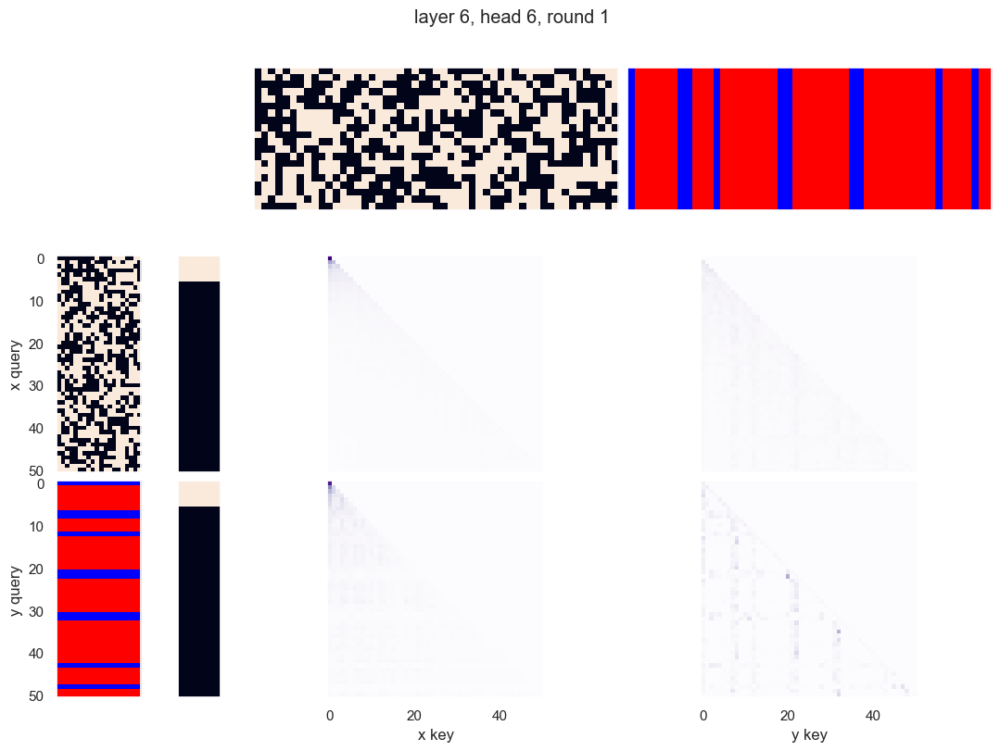

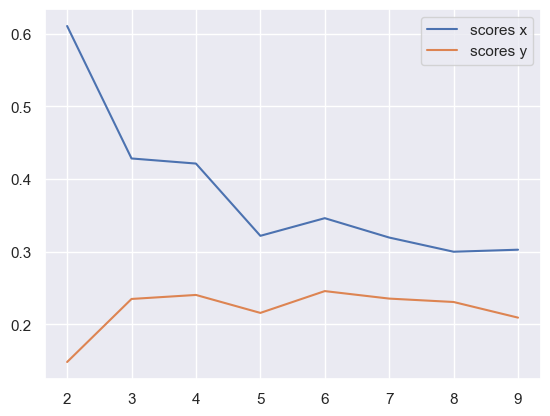

x query cluster:
SVM coefs: [ 0.10544584 -0.37930802  0.16403228  0.12083884 -0.24402742 -0.10237215
  0.08436993 -0.23419084  0.18886603  0.66353359 -0.04109526  0.52820932
 -0.172841    0.06949161 -0.03458194 -0.08149555 -0.14972065 -0.68104041
  0.62447463  0.75904276]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

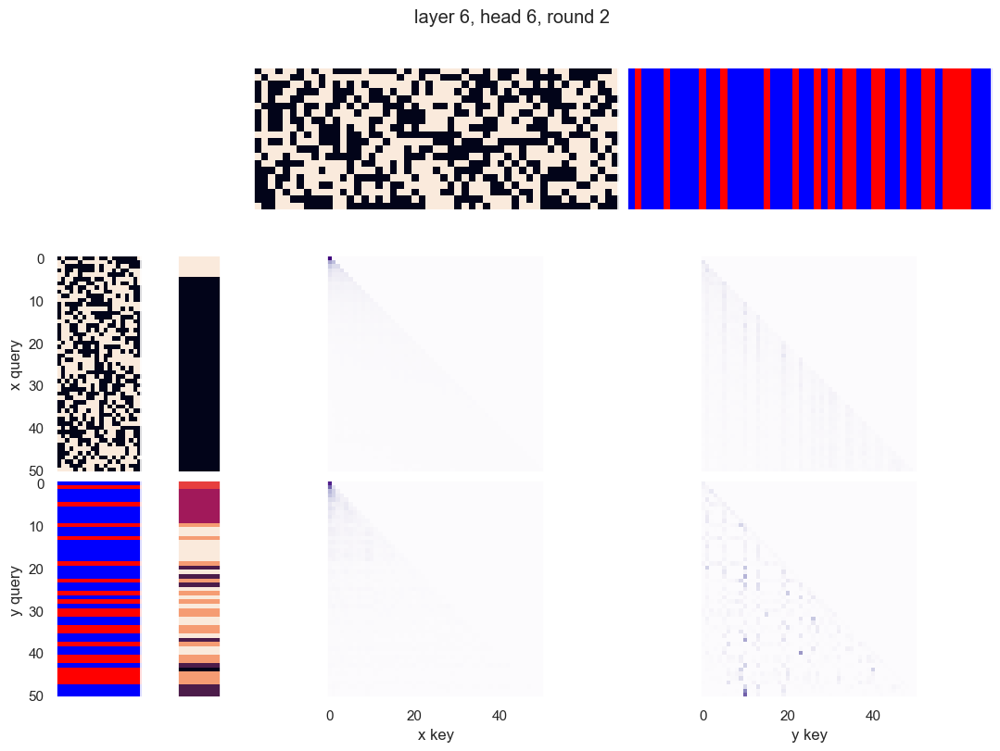

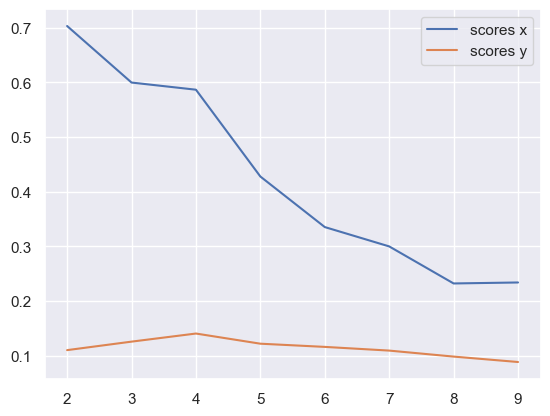

x query cluster:
SVM coefs: [ 0.10543867 -0.37930792  0.16403409  0.12083415 -0.24402636 -0.10237148
  0.0843703  -0.23419146  0.18886862  0.6635372  -0.04109558  0.52820664
 -0.17284891  0.06949097 -0.03457924 -0.08149306 -0.14971886 -0.68103879
  0.62447263  0.75904838]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17

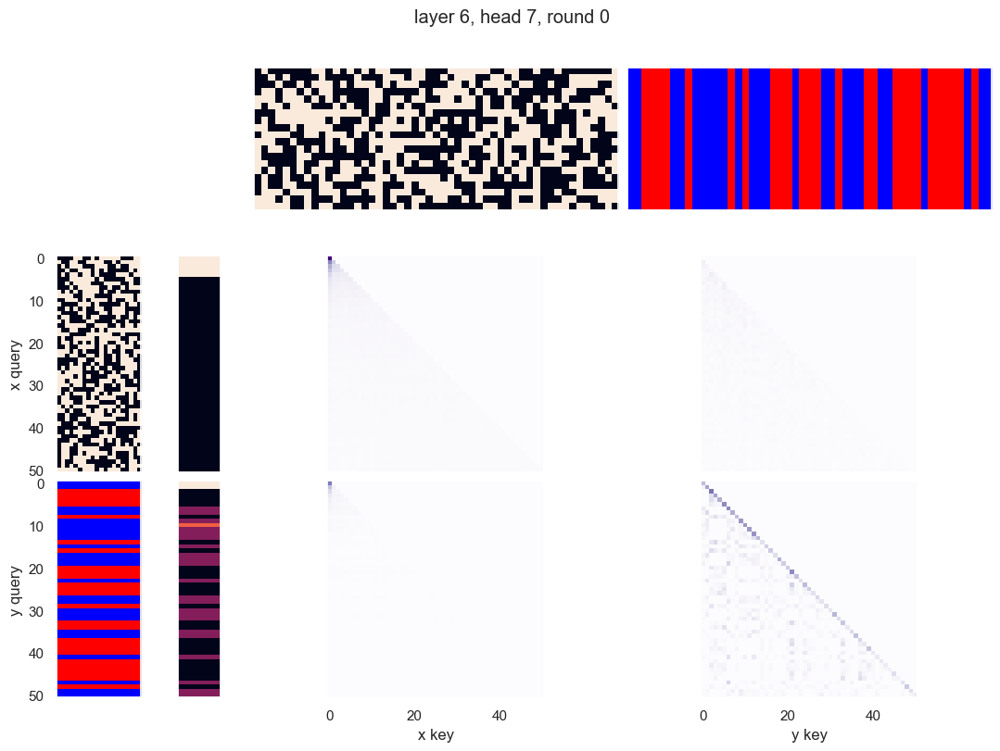

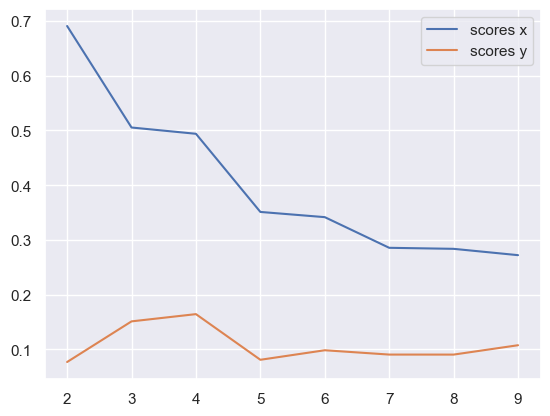

x query cluster:
SVM coefs: [ 0.10544437 -0.37930523  0.16403711  0.12083593 -0.24402784 -0.10236969
  0.08437024 -0.23419342  0.18886368  0.66353526 -0.04109283  0.52820851
 -0.17284388  0.06949114 -0.03458115 -0.08149906 -0.14972578 -0.68103621
  0.62447262  0.75904083]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) +19: 0.61; (4) +13: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +6: 0.57; (8) +5: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) +9 AND +13: 0.41; (4) +0 AND -12: 0.41; (5) +0 AND -16: 0.41; (6) +13 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +5 AND -16: 0.41; (9) -12 AND +19: 0.41; (10) +0 AND +19: 0.39
(1) +13 OR +19: 0.91; (2) -12 OR +13: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR +19: 0.89; (5) +0 OR +17: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -15: 0.89; (8) +0 OR +11: 0.89; (9) +14 OR -16: 0.89; (10) -16 OR +19:

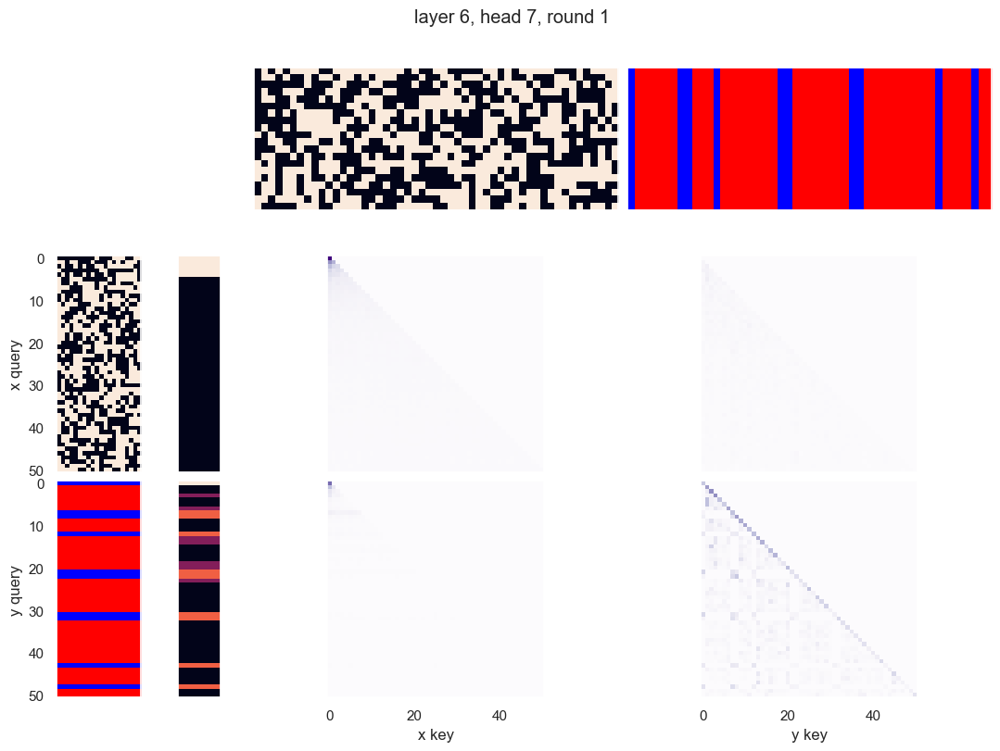

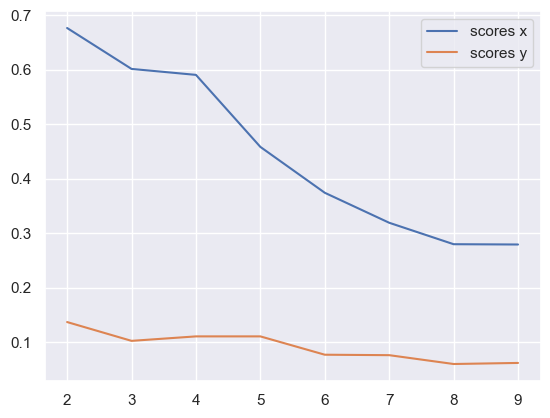

x query cluster:
SVM coefs: [-0.46865272 -0.57677766  0.27720648  0.21226651 -0.11848007 -0.05889254
  0.00723522 -0.45951869  0.42597154  0.43341297 -0.08995937  0.23647072
 -0.24495558 -0.49575389 -0.29612665  0.17305987  0.11536819 -0.6792426
  0.21284539  0.87186768]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.89

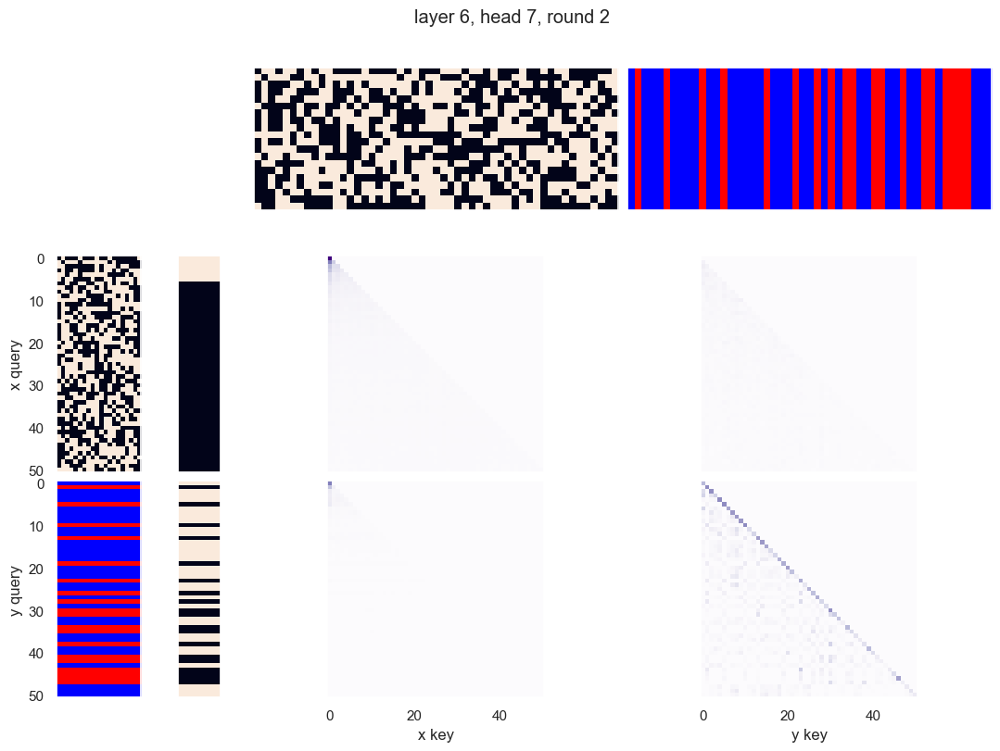

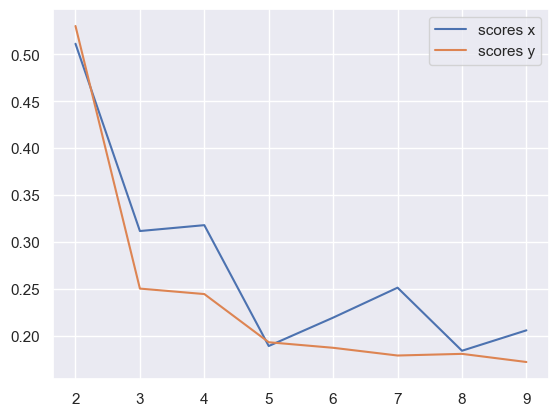

x query cluster:
SVM coefs: [-0.28794417 -0.47313876  1.0287389   0.38310559  0.32285976  0.25921264
  0.01952204  0.00168668  0.67964181  0.27148974 -0.32583783  0.59225339
  0.27769978 -0.56683023  0.12307228 -0.05074142  0.26542411 -0.64575537
  0.50792504  0.61018396]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.66; (3) +10: 0.64; (4) -11: 0.64; (5) -18: 0.61; (6) -12: 0.61; (7) +2: 0.59; (8) -3: 0.59; (9) +13: 0.59; (10) +6: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.48; (3) -11 AND +17: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -16: 0.48; (6) -3 AND -18: 0.48; (7) +6 AND -16: 0.45; (8) -0 AND +17: 0.43; (9) -12 AND +17: 0.43; (10) -12 AND -18: 0.43
(1) -11 OR -16: 0.95; (2) -11 OR -18: 0.95; (3) +10 OR -11: 0.93; (4) +17 OR -19: 0.93; (5) -2 OR -18: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) -3 OR -11: 0.93; (10) +10 OR -12: 

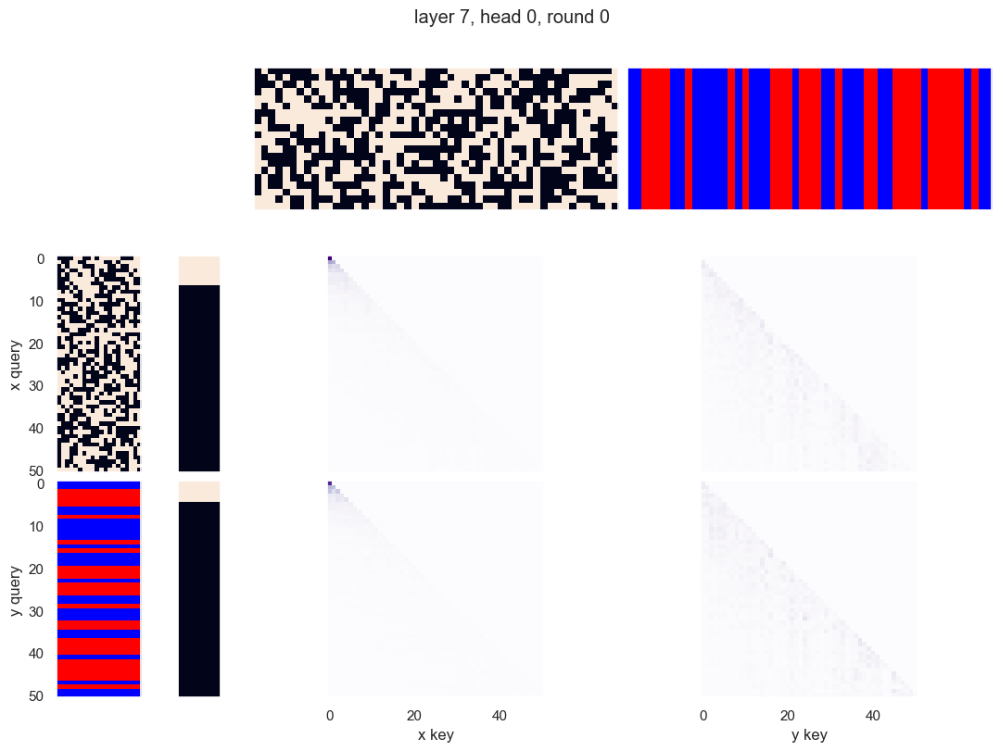

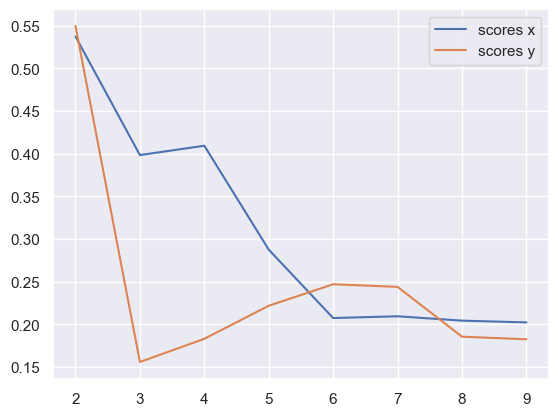

x query cluster:
SVM coefs: [-0.28794352 -0.47313681  1.02873889  0.38311053  0.3228528   0.2592145
  0.01951931  0.00169114  0.67964051  0.27148961 -0.32584358  0.59225202
  0.27770087 -0.5668296   0.12307292 -0.0507417   0.2654214  -0.64575743
  0.50792706  0.61017766]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +13: 0.64; (4) +19: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +9: 0.59; (8) -3: 0.59; (9) +6: 0.57; (10) +11: 0.55
(1) +0 AND +9: 0.45; (2) -3 AND +19: 0.45; (3) +9 AND +13: 0.43; (4) +13 AND +14: 0.43; (5) +0 AND +13: 0.41; (6) +9 AND +14: 0.41; (7) +13 AND -18: 0.41; (8) +0 AND -12: 0.41; (9) -12 AND -15: 0.41; (10) +5 AND -16: 0.41
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +6 OR -16: 0.89; (6) +7 OR -12: 0.89; (7) +14 OR +19: 0.89; (8) +14 OR +17: 0.89; (9) +14 OR -16: 0.89; (10) +0 OR +17: 0.89
{

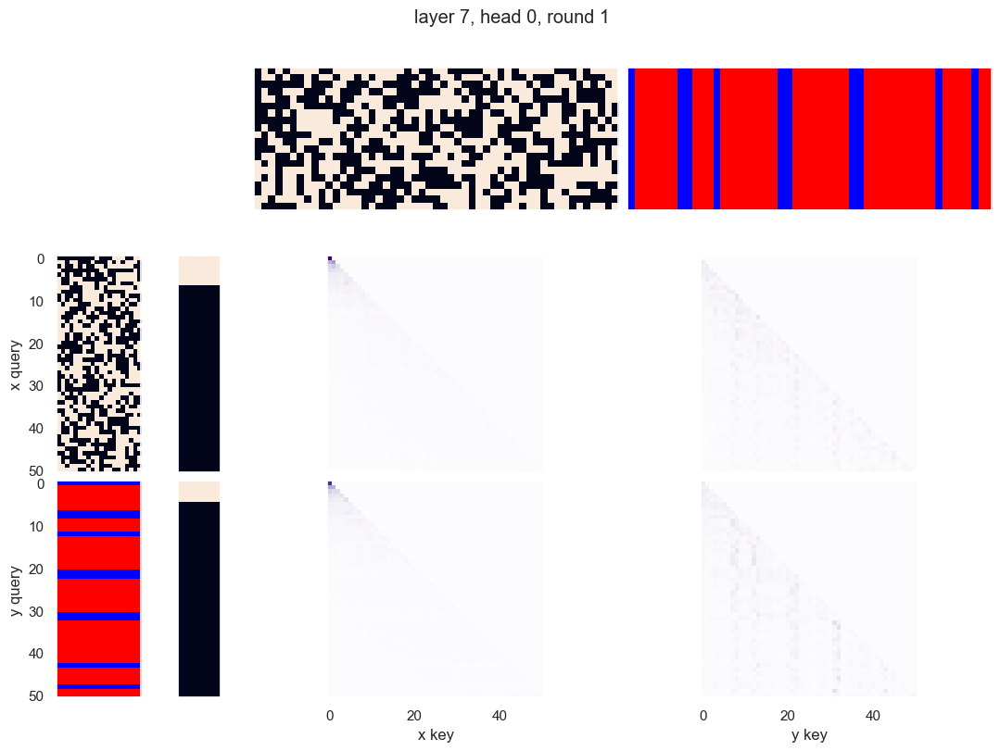

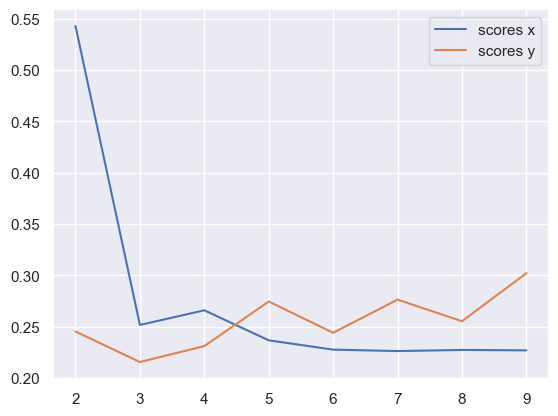

x query cluster:
SVM coefs: [ 0.10544266 -0.37931161  0.16403437  0.12083694 -0.24402323 -0.10237011
  0.08436602 -0.23419536  0.18886539  0.66353716 -0.04109315  0.52820792
 -0.17284366  0.06949271 -0.03457769 -0.08149366 -0.14972209 -0.68104121
  0.62447696  0.75904469]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

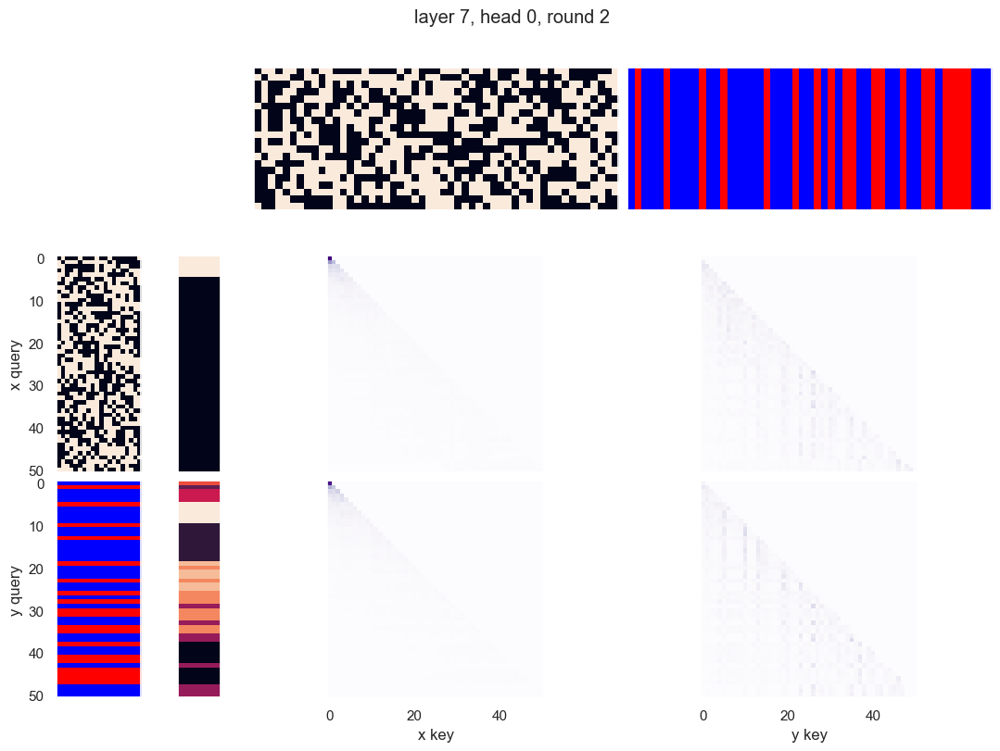

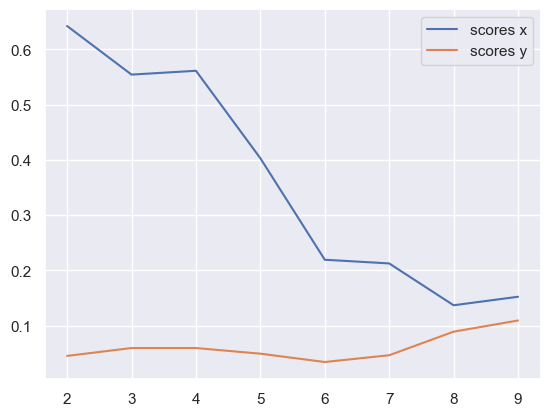

x query cluster:
SVM coefs: [ 0.1054422  -0.37930489  0.16403333  0.12084045 -0.24402495 -0.10236857
  0.08437131 -0.2341829   0.18886168  0.66353919 -0.04108952  0.52820404
 -0.17284518  0.06950397 -0.03458672 -0.08149976 -0.14972878 -0.68104426
  0.62446067  0.75904511]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17

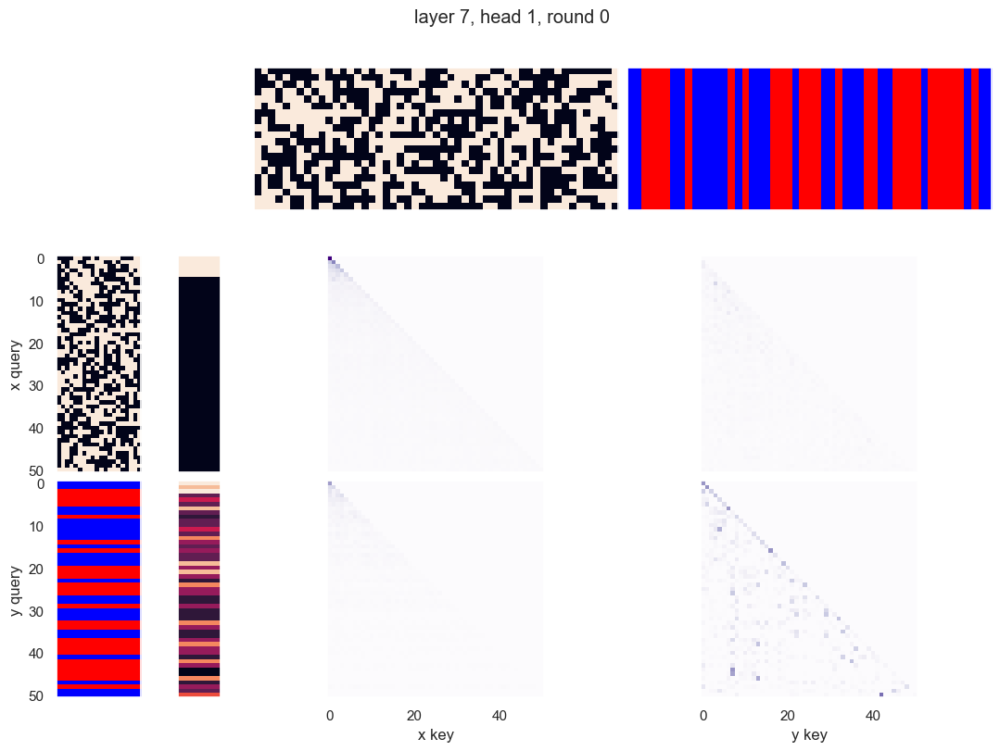

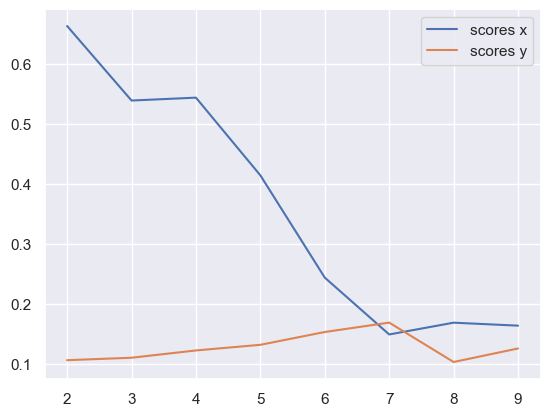

x query cluster:
SVM coefs: [ 0.25510596 -0.45922043  0.27299364  0.17551789 -0.21551853 -0.11985554
  0.0702553  -0.09279628  0.10832088  0.49036075 -0.00371204  0.20237955
 -0.11104858  0.23138841  0.04469414 -0.29457782 -0.4667766  -0.52135004
  0.57332333  0.62858595]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +0: 0.64; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.57; (7) +6: 0.57; (8) +17: 0.55; (9) +11: 0.55; (10) +5: 0.55
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) -12 AND -15: 0.40; (4) +5 AND -16: 0.40; (5) -12 AND +19: 0.40; (6) +9 AND +13: 0.40; (7) -4 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) -2 AND -12: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +0 OR +11: 0.89; (4) +14 OR +19: 0.89; (5) +14 OR +17: 0.89; (6) +0 OR +17: 0.89; (7) +13 OR +19: 0.89; (8) +14 OR -15: 0.89; (9) +14 OR -16: 0.89; (10) -12 OR

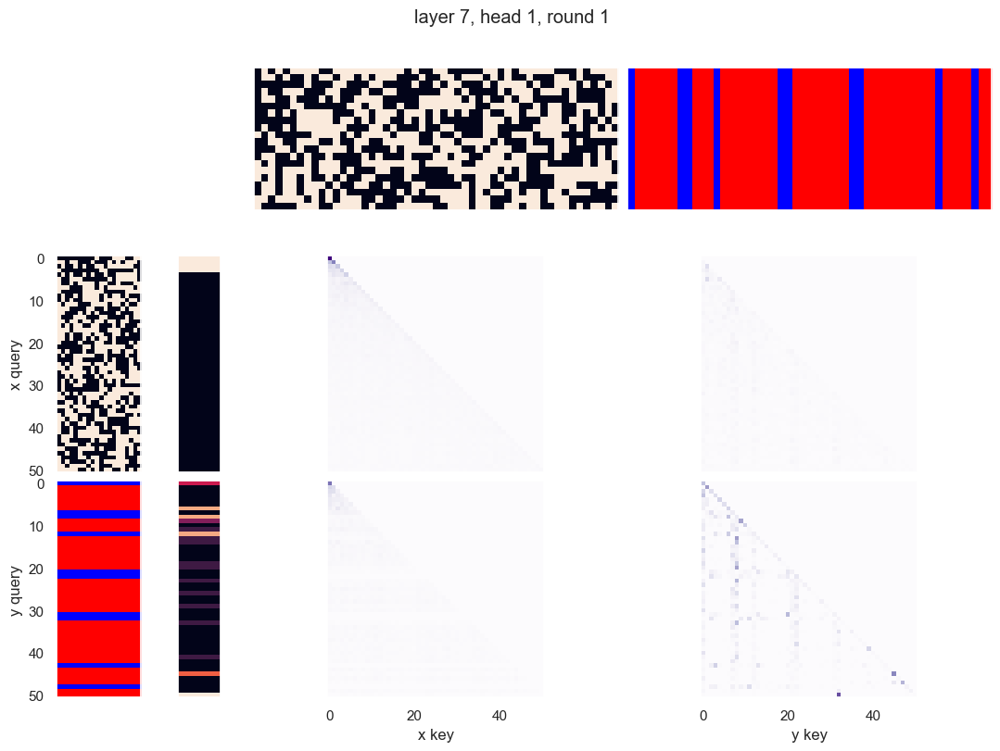

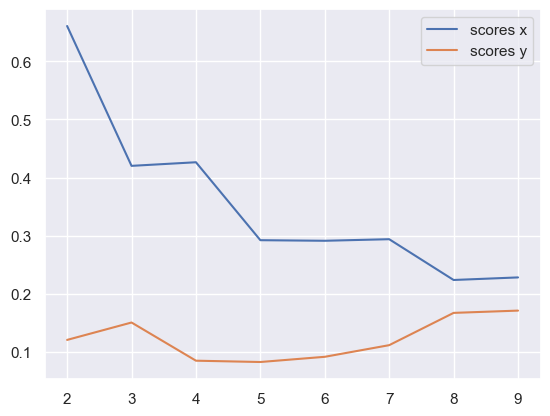

x query cluster:
SVM coefs: [ 0.25510325 -0.45922002  0.27299206  0.17551897 -0.21551579 -0.11985368
  0.07025667 -0.09279067  0.10832418  0.49036156 -0.00371221  0.20237537
 -0.11104904  0.23138394  0.04469655 -0.29457749 -0.46677373 -0.52135046
  0.5733199   0.62859318]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) +17: 0.64; (3) -19: 0.62; (4) +2: 0.62; (5) +8: 0.60; (6) +13: 0.60; (7) -0: 0.60; (8) +14: 0.60; (9) -9: 0.57; (10) +6: 0.57
(1) +8 AND +16: 0.47; (2) +17 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) -9 AND -19: 0.45; (5) -5 AND +16: 0.45; (6) +7 AND +16: 0.45; (7) -0 AND +17: 0.43; (8) -9 AND +13: 0.43; (9) +8 AND +13: 0.43; (10) +17 AND -18: 0.43
(1) +12 OR +16: 0.91; (2) +14 OR +16: 0.91; (3) +13 OR +16: 0.89; (4) +15 OR +16: 0.89; (5) +6 OR +16: 0.89; (6) +5 OR +16: 0.89; (7) +16 OR -19: 0.89; (8) +2 OR +16: 0.89; (9) +7 OR +17: 0.89; (10) +2 OR +4

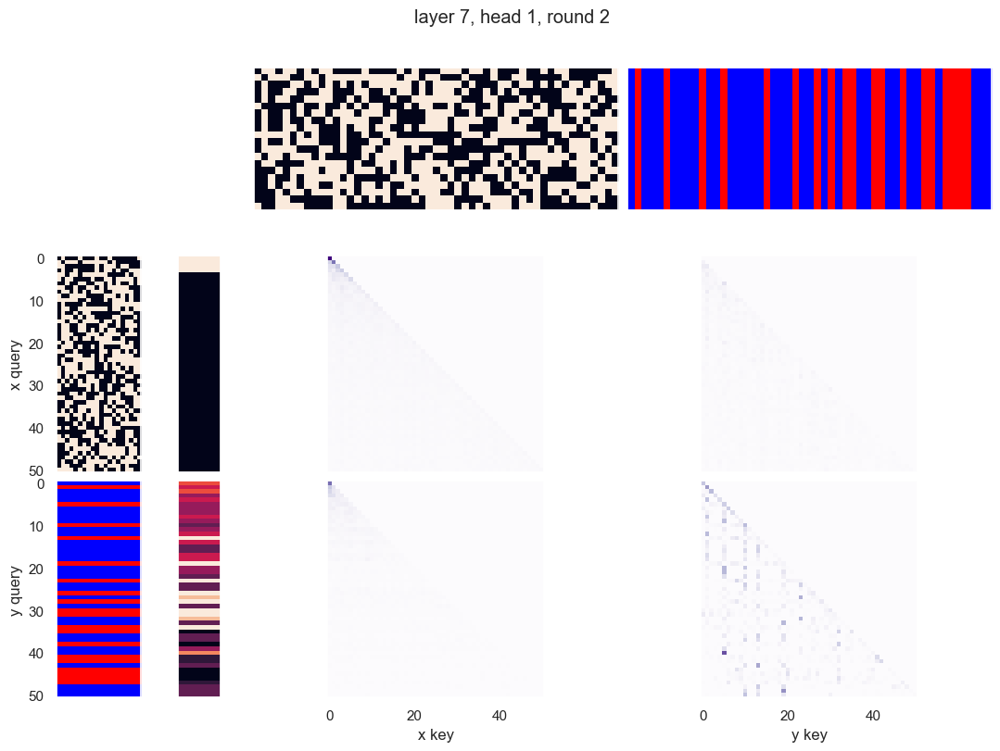

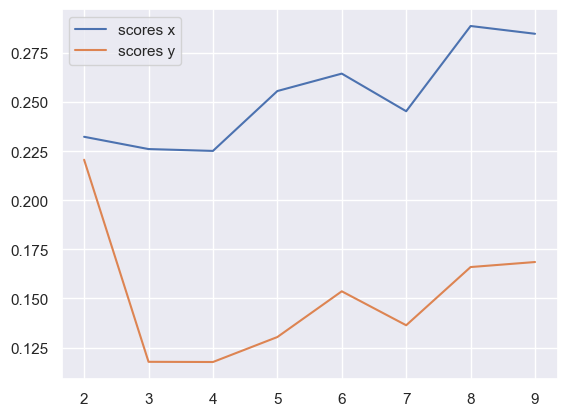

x query cluster:
SVM coefs for class 0: [-0.18065332 -0.05777803  0.32909696  0.08250991 -0.10636961  0.01303732
  0.04612716 -0.01095951  0.0408825   0.11933931  0.0229951  -0.10001815
  0.00384885 -0.01102639  0.09498455  0.03559001 -0.20115184 -0.09129278
  0.01132636 -0.06039569]\class elements: [34 35 37 38 41 44 45 46 47 50]
(1) +2: 1.00; (2) -0: 0.80; (3) -18: 0.80; (4) -16: 0.80; (5) +13: 0.80; (6) +17: 0.70; (7) -15: 0.70; (8) -3: 0.70; (9) +5: 0.70; (10) +6: 0.70
(1) +2 AND +13: 0.80; (2) +2 AND -18: 0.80; (3) +2 AND -16: 0.80; (4) -0 AND +2: 0.80; (5) -16 AND -18: 0.70; (6) +2 AND +6: 0.70; (7) +2 AND +5: 0.70; (8) +13 AND -18: 0.70; (9) -3 AND +13: 0.70; (10) -3 AND -18: 0.70
(1) +2 OR -9: 1.00; (2) +2 OR +10: 1.00; (3) +2 OR -10: 1.00; (4) +2 OR +9: 1.00; (5) +2 OR +8: 1.00; (6) +2 OR -8: 1.00; (7) +2 OR +7: 1.00; (8) +2 OR -7: 1.00; (9) +2 OR +6: 1.00; (10) +2 OR -6: 1.00
{7.0: 0.11612793828026043, 11.0: 0.08139420342340599, 8.0: 0.2549234377278481, 13.0: 0.03524514373566

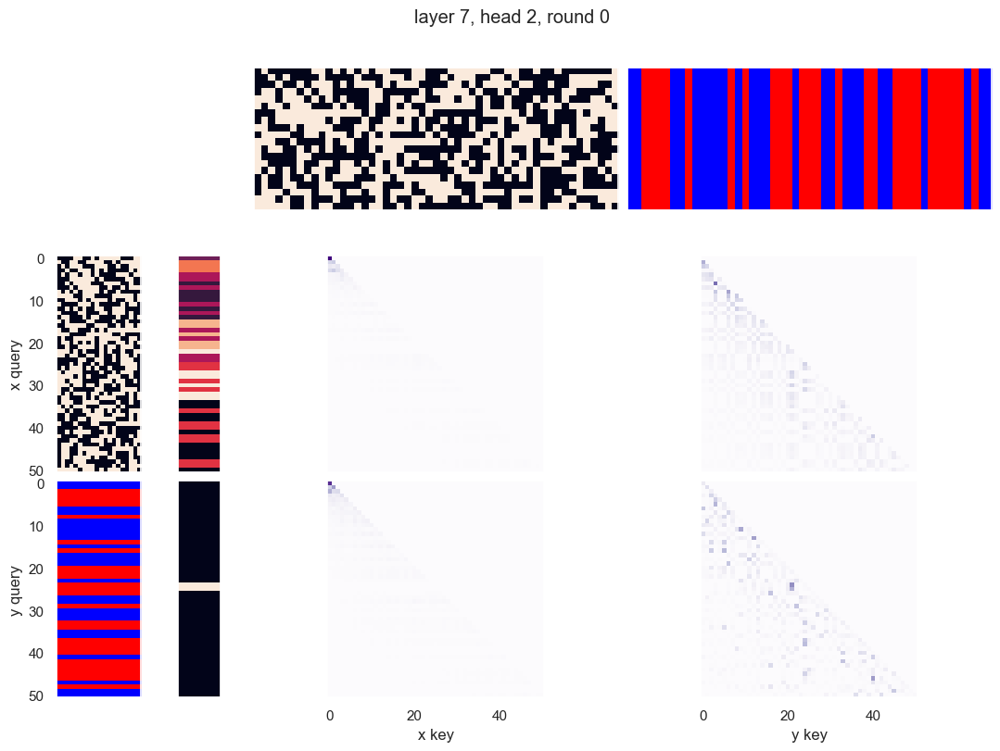

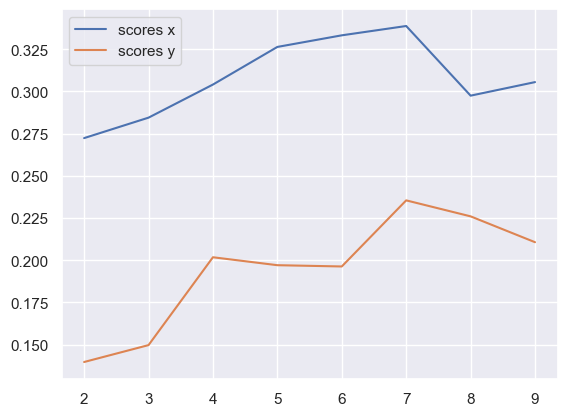

x query cluster:
SVM coefs for class 0: [-0.01340737 -0.45281932 -0.48825823 -0.60812134 -0.58500692 -1.09758074
 -0.85915392  0.57483749 -0.32577845 -0.16816875  0.27137856  0.2360781
 -0.04454888 -0.49735538  0.76674755 -1.02051442 -0.52312418  0.28156627
  0.86961821  0.0711475 ]\class elements: [36 37 39 42 43 44 46 48 50]
(1) +2: 1.00; (2) +15: 0.78; (3) -10: 0.78; (4) +19: 0.67; (5) -1: 0.67; (6) +17: 0.67; (7) +14: 0.67; (8) -4: 0.67; (9) +12: 0.67; (10) -6: 0.67
(1) +2 AND +15: 0.78; (2) +2 AND -10: 0.78; (3) +2 AND +14: 0.67; (4) +2 AND +17: 0.67; (5) -8 AND -10: 0.67; (6) +2 AND +12: 0.67; (7) +2 AND +19: 0.67; (8) +2 AND -8: 0.67; (9) +14 AND +15: 0.67; (10) -1 AND +2: 0.67
(1) +5 OR +15: 1.00; (2) +2 OR -4: 1.00; (3) +2 OR +3: 1.00; (4) +2 OR -3: 1.00; (5) -1 OR +19: 1.00; (6) -4 OR -5: 1.00; (7) -4 OR -6: 1.00; (8) -4 OR -8: 1.00; (9) -4 OR -10: 1.00; (10) -1 OR +15: 1.00
{0.0: 0.9461487217437632}
SVM coefs for class 1: [-0.46448418  0.71480111  0.30467226 -0.20097986 -0.5

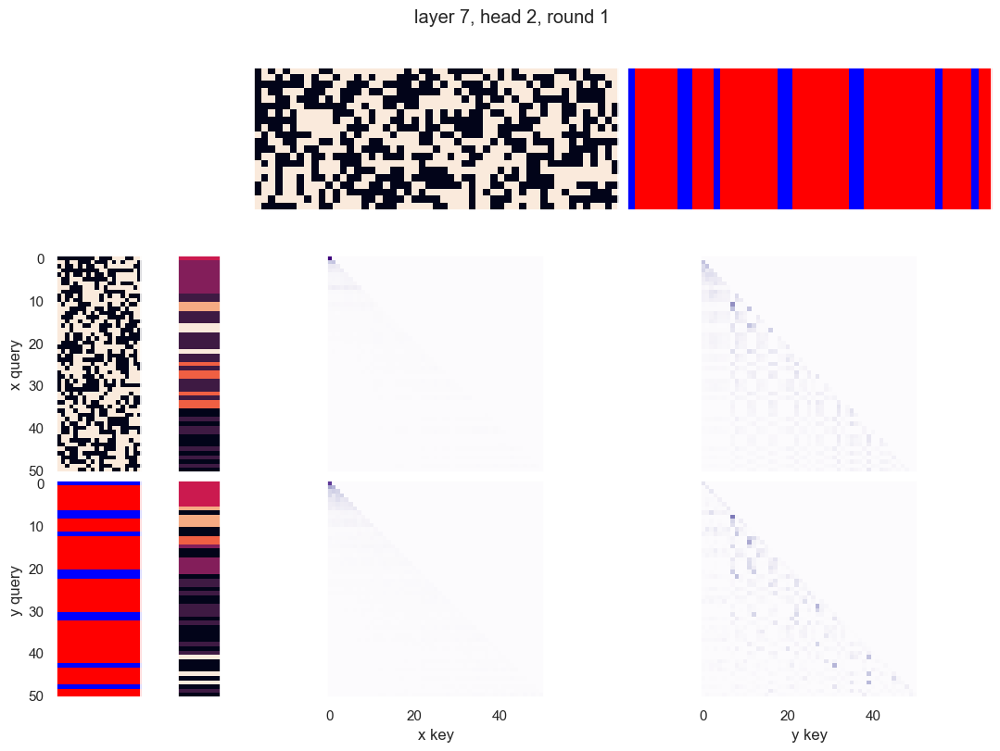

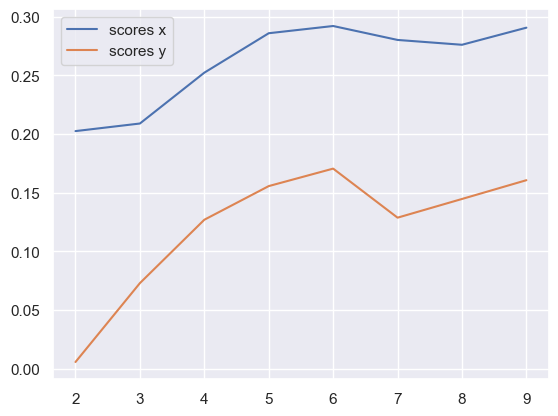

x query cluster:
SVM coefs for class 0: [-0.29492919  0.04590679  0.27250967  0.36562818 -0.50829184  0.09229592
 -0.21721727 -0.01391106 -0.10427574 -0.08280115 -0.06358694 -0.24537832
  0.1500189   0.29776201 -0.11214952  0.39355683  0.01167072 -0.01226906
 -0.0646704  -0.33650688]\class elements: [21 23 25 26 27 28 30 34 35 37 38 40 42 44 45 47 49 50]
(1) +2: 1.00; (2) +16: 0.78; (3) -1: 0.72; (4) +7: 0.72; (5) -10: 0.67; (6) -9: 0.67; (7) +8: 0.67; (8) -18: 0.61; (9) +13: 0.61; (10) -15: 0.61
(1) +2 AND +16: 0.78; (2) -1 AND +2: 0.72; (3) +2 AND +7: 0.72; (4) +2 AND -10: 0.67; (5) +2 AND -9: 0.67; (6) +2 AND +8: 0.67; (7) +2 AND +5: 0.61; (8) +2 AND -18: 0.61; (9) +8 AND +16: 0.61; (10) +2 AND -15: 0.61
(1) +2 OR +16: 1.00; (2) +2 OR +15: 1.00; (3) +2 OR -11: 1.00; (4) +2 OR +6: 1.00; (5) +2 OR -7: 1.00; (6) +2 OR -15: 1.00; (7) +2 OR +14: 1.00; (8) +2 OR -14: 1.00; (9) -1 OR +16: 1.00; (10) +2 OR +7: 1.00
{0.0: 0.9845194443813752}
SVM coefs for class 1: [ 0.10091088 -0.10767921 -0

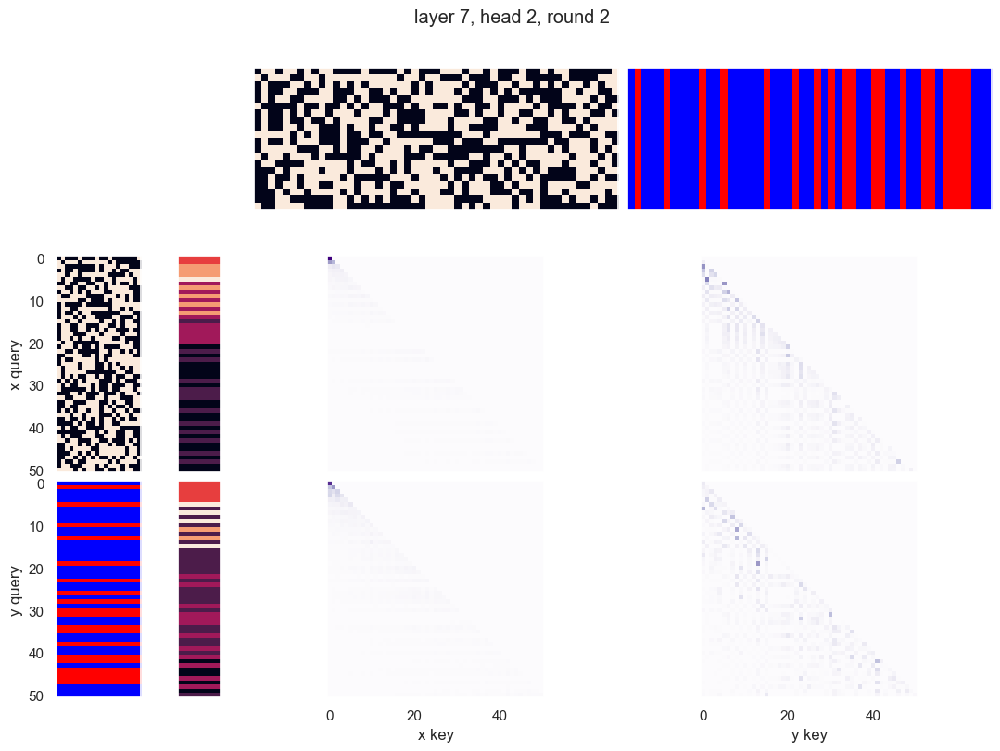

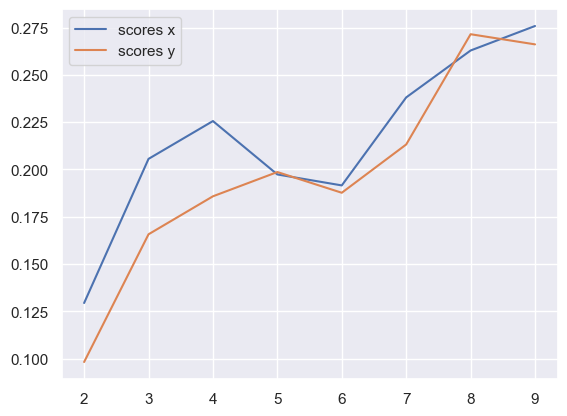

x query cluster:
SVM coefs for class 0: [-0.43223262  0.06095137 -1.03761479  0.25327684 -1.09899352  0.04903331
 -0.4614661   0.06691242  0.15112636  0.24832833 -0.03339595  0.35098924
 -0.1347542   0.32045955  0.12156853 -0.23321619  0.24546784 -0.19337527
 -0.34977242  0.11012245]\class elements: [40 42 44 45 46 49]
(1) -4: 1.00; (2) +5: 1.00; (3) -0: 0.83; (4) +13: 0.83; (5) -12: 0.83; (6) -18: 0.67; (7) +17: 0.67; (8) -16: 0.67; (9) -15: 0.67; (10) -14: 0.67
(1) -4 AND +5: 1.00; (2) -0 AND -4: 0.83; (3) -0 AND +5: 0.83; (4) -4 AND +13: 0.83; (5) +5 AND -12: 0.83; (6) -4 AND -12: 0.83; (7) -0 AND -12: 0.83; (8) +5 AND +13: 0.83; (9) -4 AND +19: 0.67; (10) -4 AND -15: 0.67
(1) -0 OR -1: 1.00; (2) -4 OR -14: 1.00; (3) -4 OR +14: 1.00; (4) -4 OR -15: 1.00; (5) -4 OR +15: 1.00; (6) -4 OR -16: 1.00; (7) -4 OR +16: 1.00; (8) -4 OR -17: 1.00; (9) -4 OR +17: 1.00; (10) -4 OR -18: 1.00
{7.0: 0.1689401884408047, 11.0: 0.05385545247312014, 8.0: 0.14621221949346366, 13.0: 0.14431700579977286, 

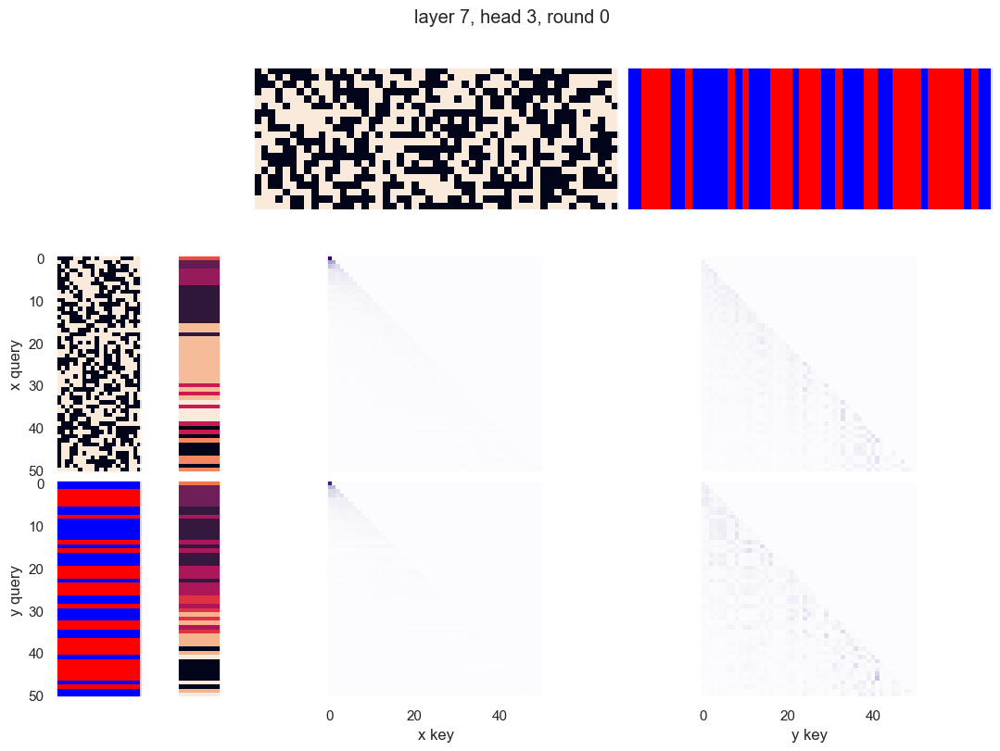

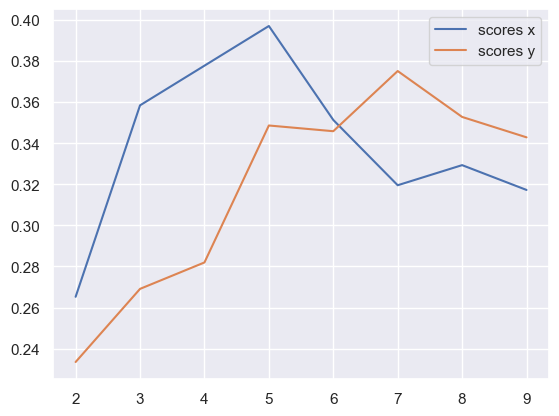

x query cluster:
SVM coefs for class 0: [ 0.28337251  0.64611831  0.02823551  0.20346226 -0.30735289  0.63695843
  0.04586876 -0.15695734  0.58082613 -0.12641252  0.53387419 -0.04086289
  0.2871243   0.17895181  0.18264657  0.65270293  1.01972372  0.32157958
 -0.11164465 -0.4303633 ]\class elements: [14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 35 37 38 44 49
 50]
(1) +13: 0.72; (2) +4: 0.72; (3) -8: 0.68; (4) +0: 0.64; (5) -7: 0.64; (6) +19: 0.60; (7) -16: 0.60; (8) -15: 0.60; (9) -12: 0.60; (10) +10: 0.60
(1) +0 AND +13: 0.52; (2) +4 AND -16: 0.48; (3) -7 AND -12: 0.48; (4) -7 AND +13: 0.48; (5) +0 AND +9: 0.48; (6) +13 AND -16: 0.48; (7) +4 AND +5: 0.48; (8) +0 AND +4: 0.48; (9) +4 AND +13: 0.48; (10) +9 AND +13: 0.48
(1) +4 OR +10: 1.00; (2) +4 OR -8: 0.96; (3) -2 OR +4: 0.96; (4) +4 OR +13: 0.96; (5) -8 OR +13: 0.96; (6) +1 OR -8: 0.92; (7) -8 OR -16: 0.92; (8) -12 OR +13: 0.92; (9) +4 OR -15: 0.92; (10) +4 OR +14: 0.92
{0.0: 0.7025461824983359}
SVM coefs for class 1: 

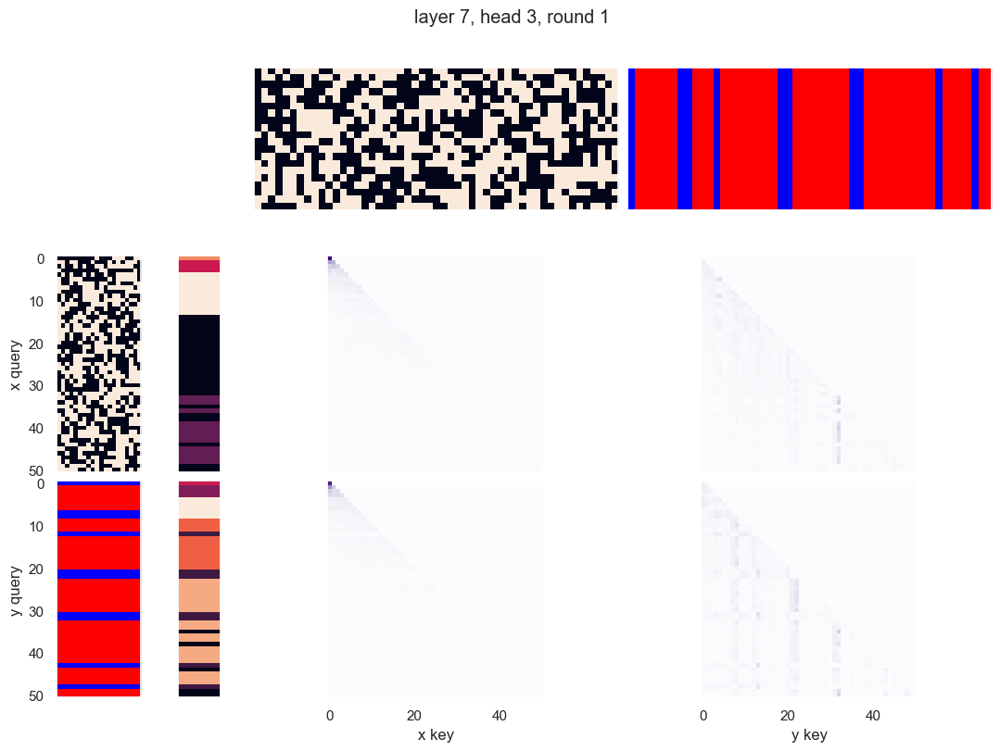

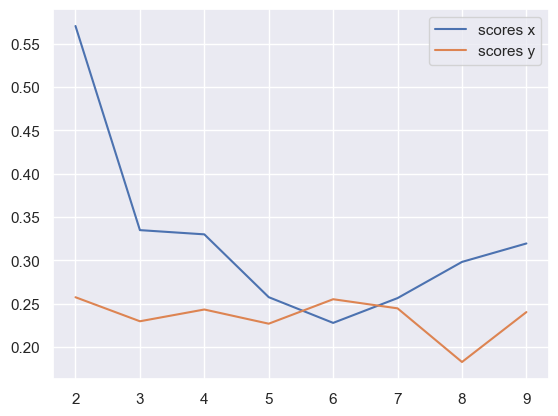

x query cluster:
SVM coefs: [ 0.10544255 -0.37930475  0.16403334  0.12083843 -0.24402893 -0.10237373
  0.08436836 -0.23418911  0.18886595  0.66353408 -0.04109711  0.52821078
 -0.17284571  0.06948893 -0.03458049 -0.08149744 -0.14972198 -0.68104109
  0.62447634  0.75904418]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

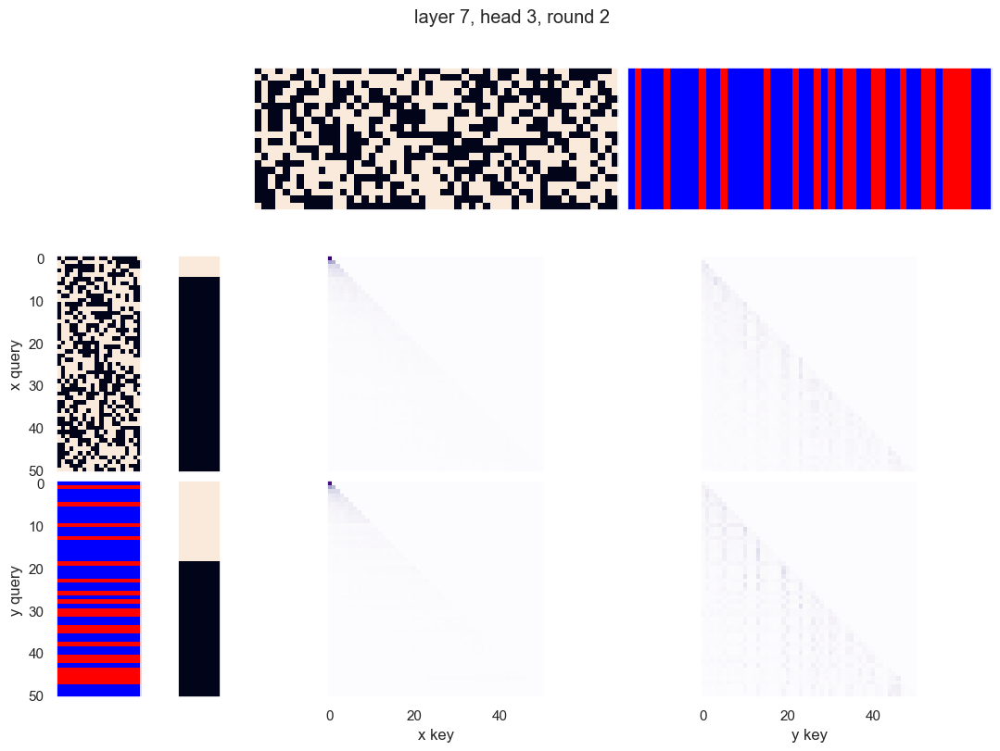

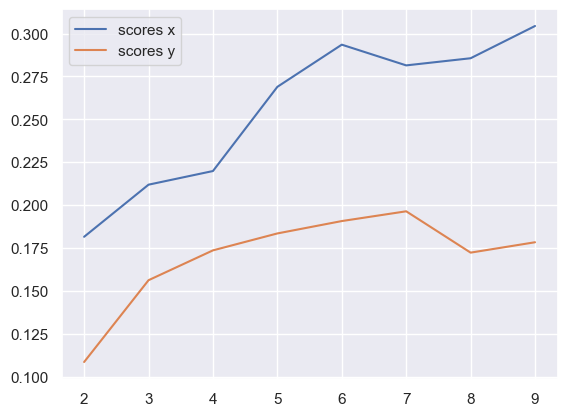

x query cluster:
SVM coefs for class 0: [ 0.50253735 -0.29348035 -0.20389157  0.25491547 -0.35288055 -0.80304647
 -0.74729122 -0.17375762 -0.68566144  0.58044433 -0.54364674 -0.28340228
  0.37000759 -0.52691131  0.521906   -0.46024377 -0.68329339 -0.19635488
  0.46286129 -0.11992237]\class elements: [26 29 31 34 36 39 43 44 48]
(1) -13: 1.00; (2) +18: 0.89; (3) -11: 0.89; (4) +14: 0.78; (5) -2: 0.78; (6) +3: 0.78; (7) -7: 0.67; (8) -6: 0.67; (9) +9: 0.67; (10) -15: 0.67
(1) -13 AND +18: 0.89; (2) -11 AND -13: 0.89; (3) -2 AND -13: 0.78; (4) -2 AND +18: 0.78; (5) +3 AND -13: 0.78; (6) -11 AND +18: 0.78; (7) -13 AND +14: 0.78; (8) +3 AND +18: 0.67; (9) -13 AND +17: 0.67; (10) -11 AND -15: 0.67
(1) +9 OR +14: 1.00; (2) +7 OR +18: 1.00; (3) +11 OR -13: 1.00; (4) +3 OR -12: 1.00; (5) -11 OR +14: 1.00; (6) +1 OR -11: 1.00; (7) -7 OR +17: 1.00; (8) -3 OR -13: 1.00; (9) +3 OR -13: 1.00; (10) -11 OR +15: 1.00
{7.0: 0.18432225343874759, 11.0: 0.009462788038136855, 8.0: 0.1204849379007808, 13.0: 

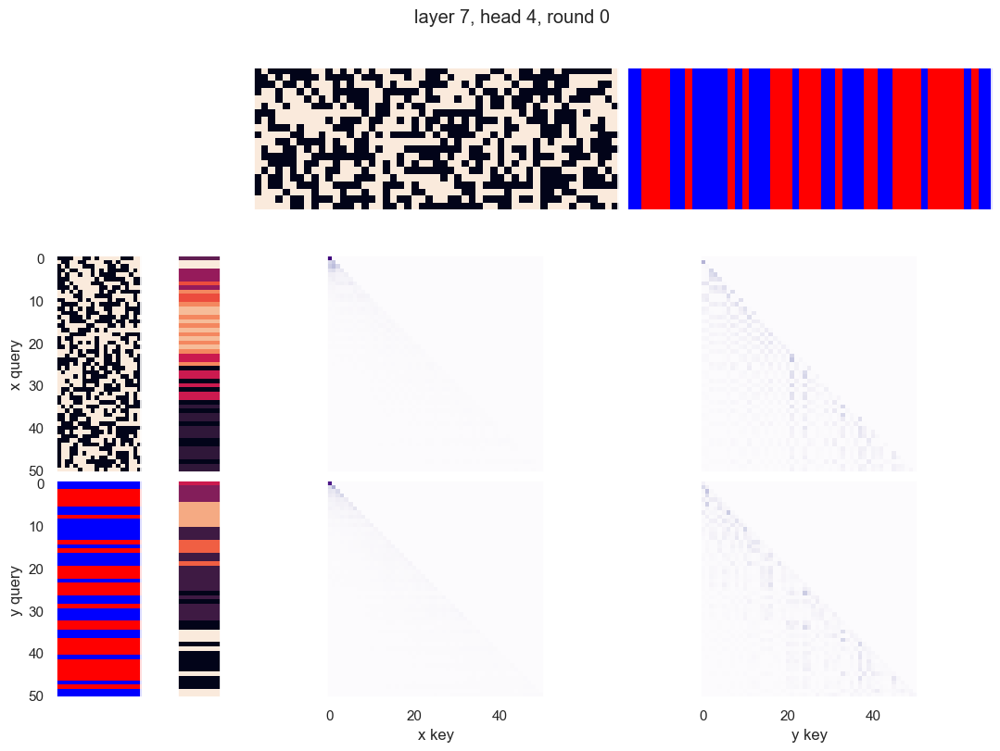

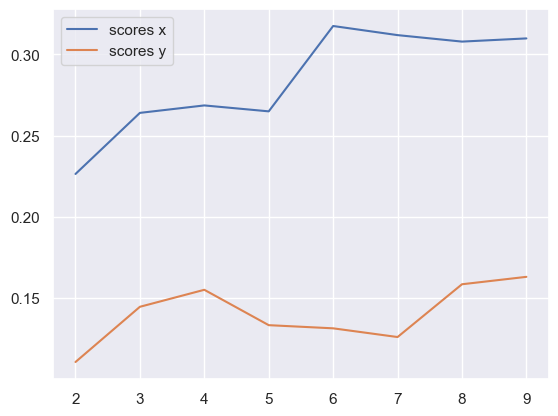

x query cluster:
SVM coefs for class 0: [-0.17016893  0.09419549  0.19225187  0.01071045  0.07288472 -0.04550013
 -0.12976593 -0.05714091 -0.01937816  0.09558096 -0.07337453  0.1445352
  0.06954583 -0.0346275   0.02848075  0.07030861 -0.02664899 -0.11804196
  0.12109612 -0.10445181]\class elements: [12 13 14 23 29 30 38 39 41 42 43 44 45 47 50]
(1) -13: 1.00; (2) +19: 0.80; (3) -12: 0.80; (4) +1: 0.67; (5) +5: 0.67; (6) -9: 0.60; (7) -16: 0.60; (8) -4: 0.60; (9) +6: 0.60; (10) +18: 0.60
(1) -12 AND -13: 0.80; (2) -13 AND +19: 0.80; (3) +5 AND -13: 0.67; (4) +1 AND -13: 0.67; (5) +1 AND +19: 0.60; (6) +0 AND -13: 0.60; (7) +6 AND -13: 0.60; (8) -9 AND -13: 0.60; (9) -3 AND -13: 0.60; (10) -2 AND -13: 0.60
(1) +9 OR -13: 1.00; (2) -13 OR +14: 1.00; (3) -13 OR -14: 1.00; (4) -12 OR +19: 1.00; (5) -4 OR -13: 1.00; (6) +4 OR -13: 1.00; (7) -12 OR +17: 1.00; (8) +10 OR -13: 1.00; (9) -7 OR -13: 1.00; (10) -5 OR -13: 1.00
{0.0: 0.673538634836829}
SVM coefs for class 1: [-0.15594284 -0.1313128

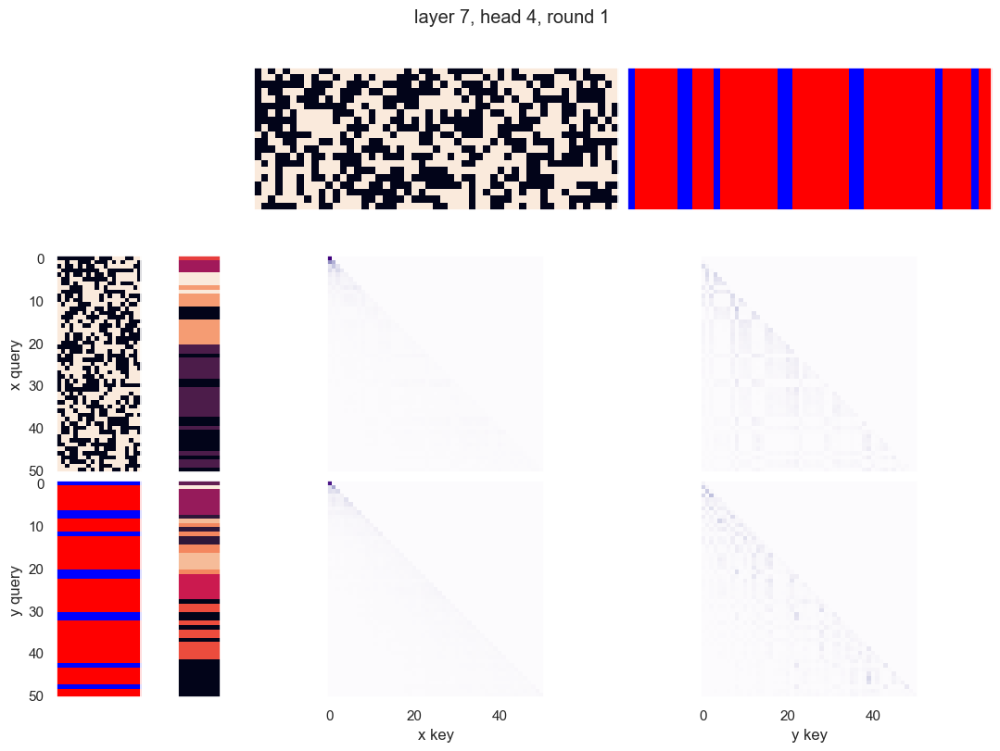

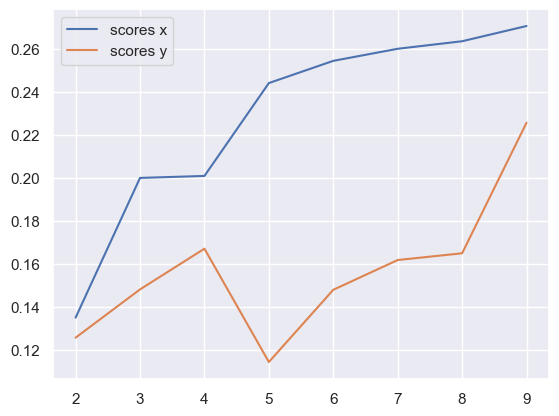

x query cluster:
SVM coefs for class 0: [-0.49698687 -0.20099478 -0.20627769  0.26314029 -0.97334171  0.19506427
 -0.66913159 -0.66173782 -0.49382789  0.22179535 -0.63711157 -0.41869512
 -0.02336369  0.43681542 -0.11059228  0.12486192  0.10829593 -0.35413308
 -0.80931509 -0.46962297]\class elements: [24 25 26 28 29 33 35 37 40 41 42 44 45 46 48 49]
(1) +13: 1.00; (2) +8: 0.81; (3) +7: 0.75; (4) -9: 0.69; (5) -3: 0.69; (6) +16: 0.69; (7) +6: 0.69; (8) -0: 0.62; (9) +2: 0.62; (10) +4: 0.62
(1) +8 AND +13: 0.81; (2) +7 AND +13: 0.75; (3) -3 AND +13: 0.69; (4) +13 AND +16: 0.69; (5) +6 AND +13: 0.69; (6) +8 AND +16: 0.69; (7) +7 AND +8: 0.69; (8) -9 AND +13: 0.69; (9) +2 AND +13: 0.62; (10) +4 AND +13: 0.62
(1) +13 OR -19: 1.00; (2) +13 OR -18: 1.00; (3) +8 OR +13: 1.00; (4) +13 OR +18: 1.00; (5) +7 OR +13: 1.00; (6) +12 OR +13: 1.00; (7) -5 OR +13: 1.00; (8) +6 OR -14: 1.00; (9) +1 OR +13: 1.00; (10) +13 OR +15: 1.00
{0.0: 0.8625732776308723}
SVM coefs for class 1: [ 0.61071882  0.1672876

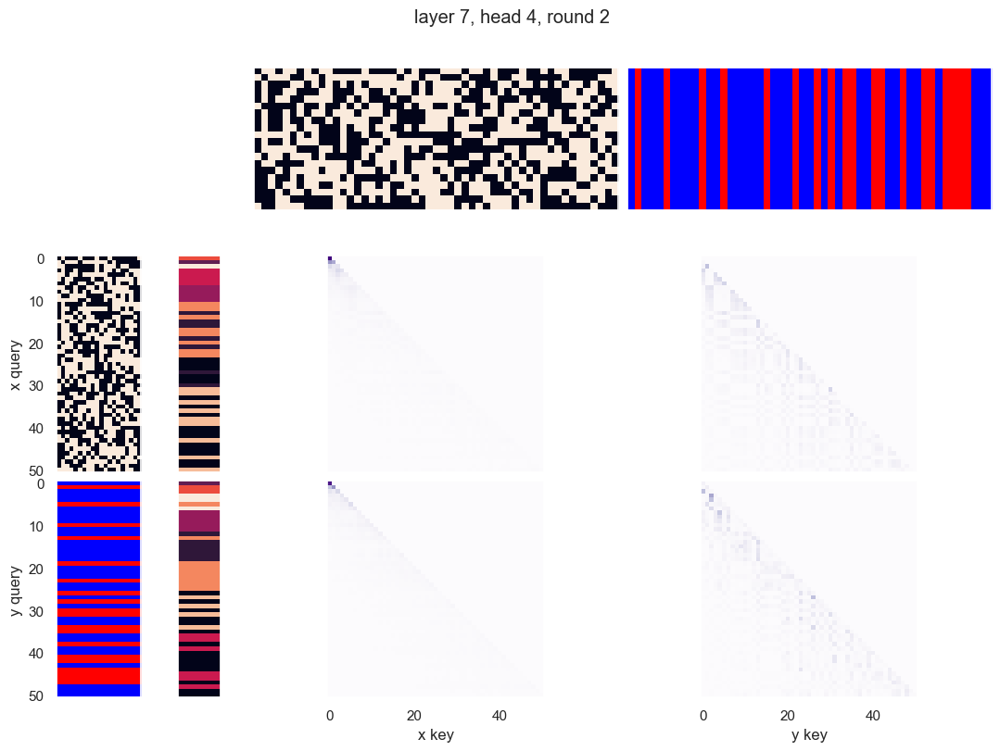

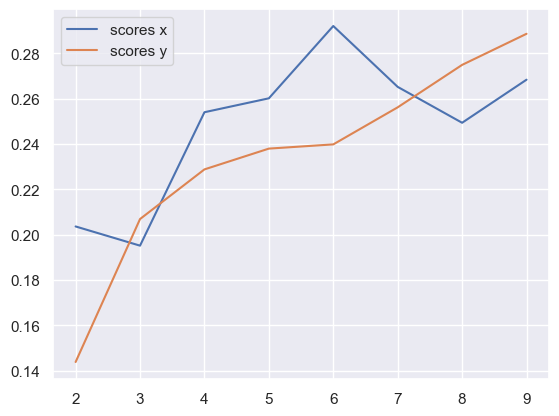

x query cluster:
SVM coefs for class 0: [-0.21148677  0.95021659 -0.29592928  1.61100707  0.08496957 -0.60197855
  0.23178169 -0.21950491 -0.6059646  -0.23195698 -0.09377058 -0.5884786
 -0.0383596   0.19344702 -0.69148927 -0.18663844 -0.56363629 -0.42735231
  0.16621251 -0.41690891]\class elements: [23 25 26 27 28 29 31 34 36 43 44 49 50]
(1) +3: 1.00; (2) -11: 0.92; (3) -19: 0.77; (4) +18: 0.77; (5) +10: 0.69; (6) +1: 0.69; (7) +17: 0.69; (8) -6: 0.69; (9) -2: 0.62; (10) -13: 0.62
(1) +3 AND -11: 0.92; (2) +3 AND -19: 0.77; (3) +3 AND +18: 0.77; (4) +3 AND +10: 0.69; (5) +3 AND +17: 0.69; (6) +3 AND -6: 0.69; (7) -11 AND +18: 0.69; (8) +1 AND +3: 0.69; (9) -11 AND -19: 0.69; (10) -11 AND +17: 0.69
(1) +3 OR +8: 1.00; (2) +3 OR +6: 1.00; (3) +3 OR -7: 1.00; (4) +3 OR +7: 1.00; (5) +3 OR -8: 1.00; (6) +3 OR -9: 1.00; (7) +3 OR +9: 1.00; (8) +3 OR -10: 1.00; (9) +3 OR +10: 1.00; (10) +3 OR -11: 1.00
{7.0: 0.12327065697620405, 11.0: 0.0844193214478974, 8.0: 0.083981446911751, 13.0: 0.1542

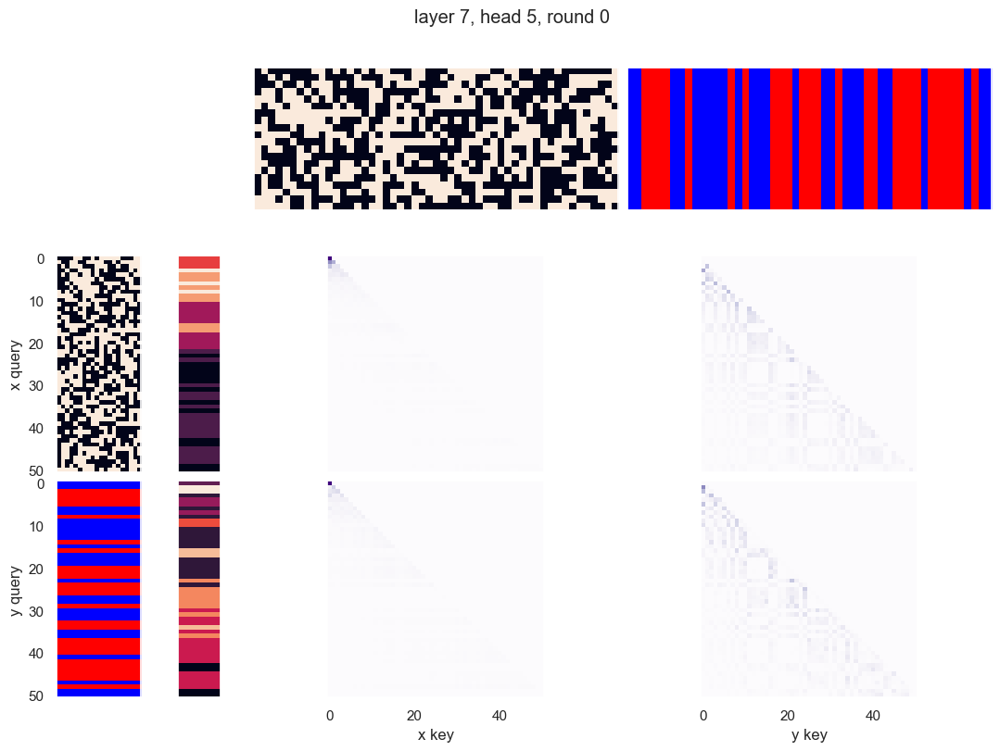

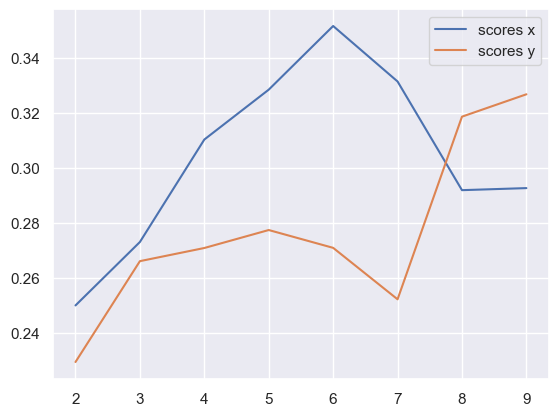

x query cluster:
SVM coefs for class 0: [-0.22172074 -0.00602818 -0.14117597  0.3870459  -0.86783131 -0.20578305
 -0.34053335  0.20821228 -0.24472354 -0.20934985 -0.21085197  0.55603226
  0.15891009  0.16026007  0.065816   -0.01508811  0.27448272  0.14677038
  0.33659336  0.08320206]\class elements: [15 18 19 26 27 29 34 36 37 38 40 41 42 44 49 50]
(1) +3: 1.00; (2) +9: 0.62; (3) +13: 0.62; (4) -19: 0.62; (5) +6: 0.62; (6) +17: 0.62; (7) -16: 0.62; (8) +0: 0.62; (9) +1: 0.62; (10) -8: 0.56
(1) +3 AND +13: 0.62; (2) +1 AND +3: 0.62; (3) +3 AND +6: 0.62; (4) +3 AND -19: 0.62; (5) +3 AND +17: 0.62; (6) +3 AND +9: 0.62; (7) +3 AND -16: 0.62; (8) +0 AND +3: 0.62; (9) -2 AND +3: 0.56; (10) +3 AND +14: 0.56
(1) +3 OR -12: 1.00; (2) +3 OR +16: 1.00; (3) +3 OR -7: 1.00; (4) +3 OR +7: 1.00; (5) +3 OR -8: 1.00; (6) +3 OR +8: 1.00; (7) +3 OR -16: 1.00; (8) +17 OR -19: 1.00; (9) +3 OR -9: 1.00; (10) +3 OR +15: 1.00
{0.0: 0.7016401737255364}
SVM coefs for class 1: [ 0.26450164  0.4311541  -0.0730034

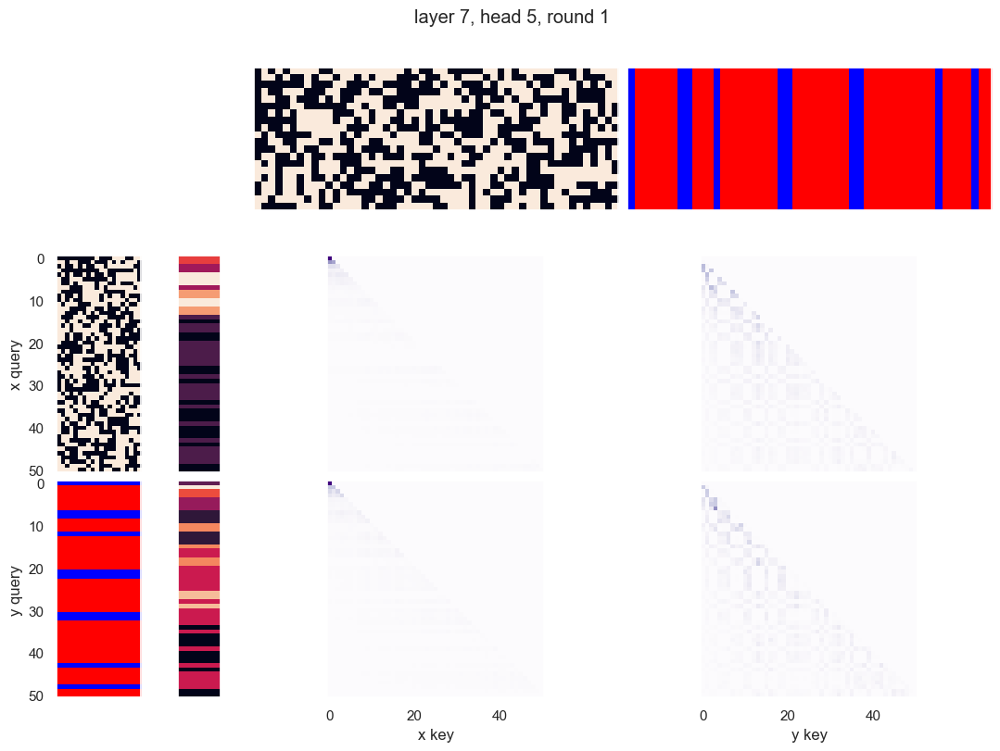

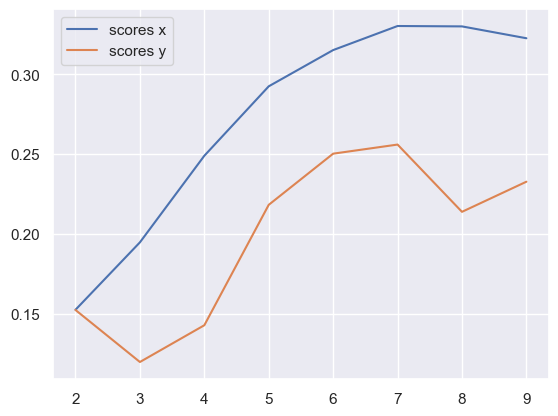

x query cluster:
SVM coefs for class 0: [-0.5311036   0.27747144  0.22141538  0.53889421 -0.0090388  -0.39469134
  0.04308915 -0.18376266 -0.13140628  0.10988849  0.06427382 -0.05684315
  0.16352654  0.19038863 -0.11706795  0.33488292 -0.22843351  0.21593829
  0.06132463 -0.50949   ]\class elements: [21 23 25 26 27 29 32 34 36 43 44 46 47 50]
(1) +3: 1.00; (2) +8: 0.79; (3) -0: 0.71; (4) -10: 0.64; (5) -9: 0.64; (6) +14: 0.64; (7) -12: 0.64; (8) +2: 0.64; (9) +16: 0.64; (10) +17: 0.64
(1) +3 AND +8: 0.79; (2) -0 AND +3: 0.71; (3) +3 AND +16: 0.64; (4) +3 AND -12: 0.64; (5) +3 AND +17: 0.64; (6) +3 AND -10: 0.64; (7) +3 AND -9: 0.64; (8) +2 AND +3: 0.64; (9) +3 AND +14: 0.64; (10) +3 AND -7: 0.57
(1) +3 OR -7: 1.00; (2) -9 OR -10: 1.00; (3) +3 OR +10: 1.00; (4) +3 OR -10: 1.00; (5) -10 OR -19: 1.00; (6) +3 OR +9: 1.00; (7) +3 OR -9: 1.00; (8) +3 OR +8: 1.00; (9) +3 OR -11: 1.00; (10) -2 OR +3: 1.00
{0.0: 0.89315441258181}
SVM coefs for class 1: [-0.07764686 -0.45664015 -0.40467647 -0.28

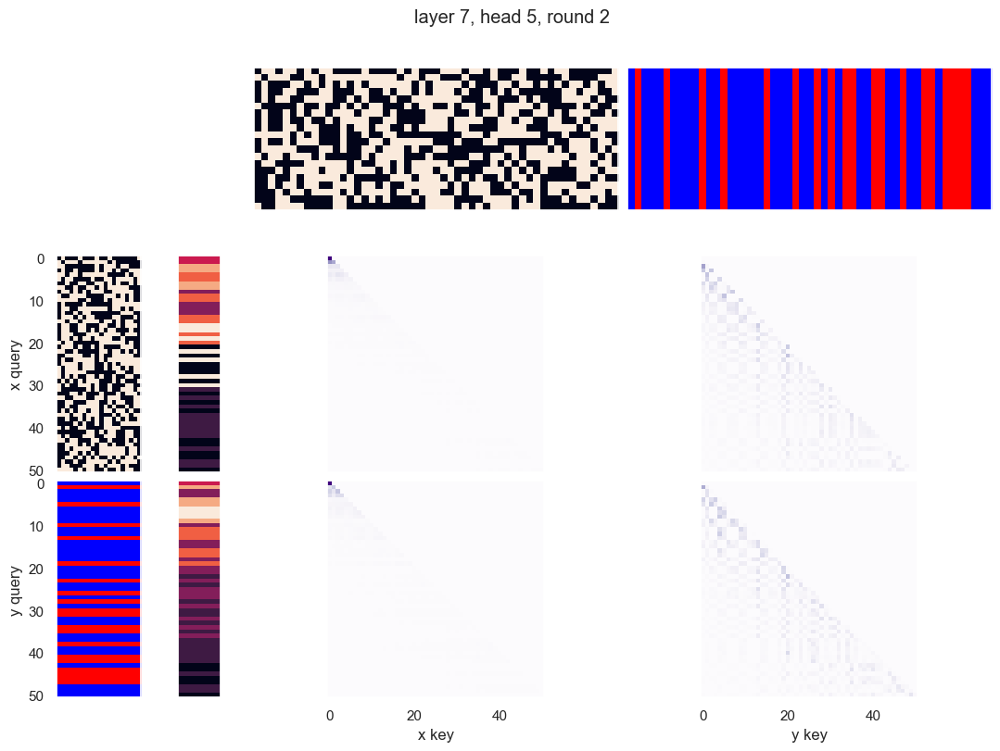

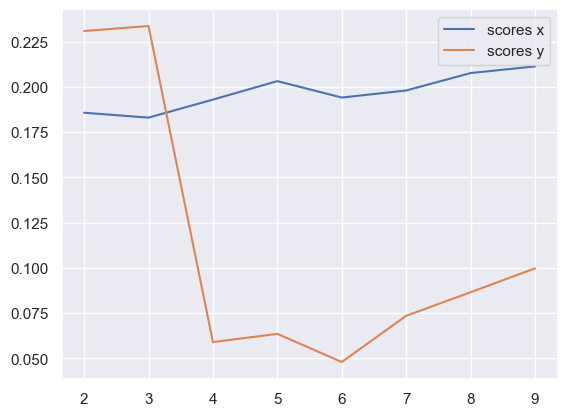

x query cluster:
SVM coefs for class 0: [-0.43222988  0.06095507 -1.03761279  0.25328071 -1.09898738  0.04903309
 -0.46146512  0.06691118  0.15112759  0.24832608 -0.03339648  0.35098828
 -0.13475345  0.32046387  0.12157077 -0.23321528  0.24546417 -0.19337355
 -0.3497696   0.11012393]\class elements: [40 42 44 45 46 49]
(1) -4: 1.00; (2) +5: 1.00; (3) -0: 0.83; (4) +13: 0.83; (5) -12: 0.83; (6) -18: 0.67; (7) +17: 0.67; (8) -16: 0.67; (9) -15: 0.67; (10) -14: 0.67
(1) -4 AND +5: 1.00; (2) -0 AND -4: 0.83; (3) -0 AND +5: 0.83; (4) -4 AND +13: 0.83; (5) +5 AND -12: 0.83; (6) -4 AND -12: 0.83; (7) -0 AND -12: 0.83; (8) +5 AND +13: 0.83; (9) -4 AND +19: 0.67; (10) -4 AND -15: 0.67
(1) -0 OR -1: 1.00; (2) -4 OR -14: 1.00; (3) -4 OR +14: 1.00; (4) -4 OR -15: 1.00; (5) -4 OR +15: 1.00; (6) -4 OR -16: 1.00; (7) -4 OR +16: 1.00; (8) -4 OR -17: 1.00; (9) -4 OR +17: 1.00; (10) -4 OR -18: 1.00
{7.0: 0.06014881893740191, 11.0: 0.11440781079969989, 8.0: 0.25183092626442277, 13.0: 0.17899933201260868,

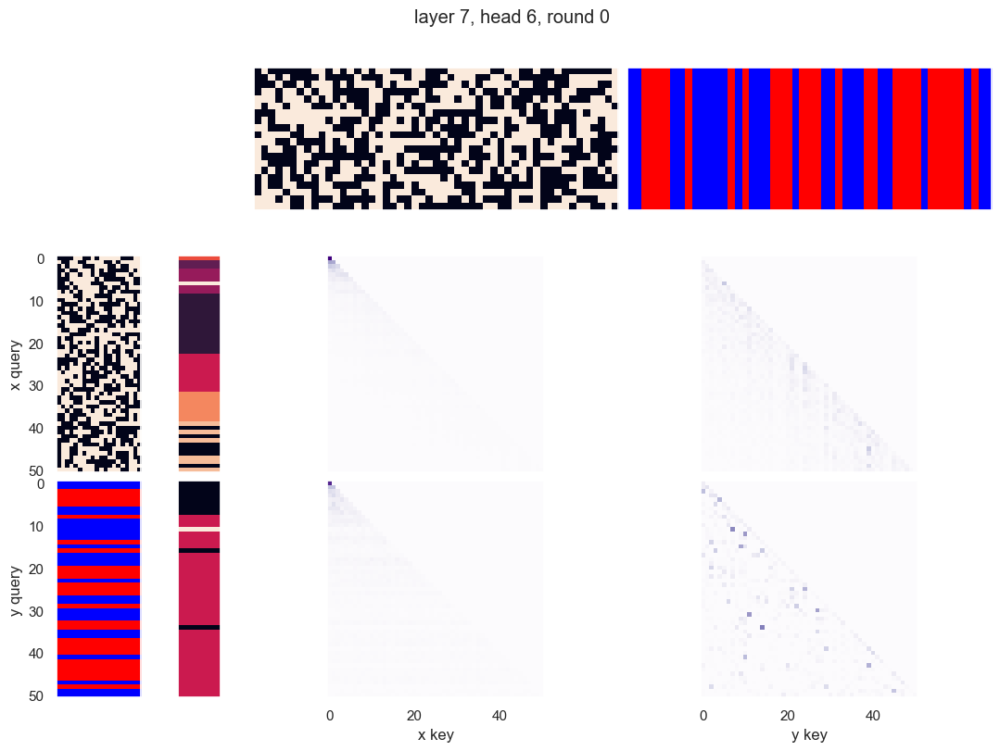

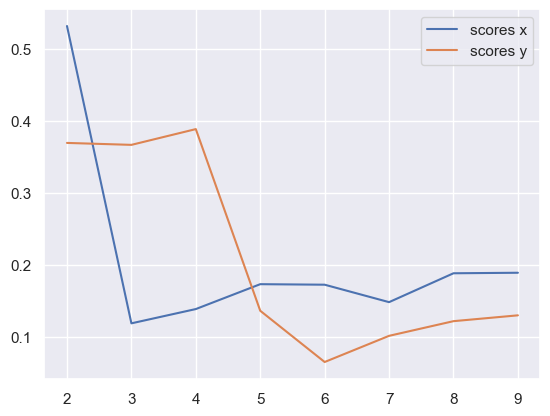

x query cluster:
SVM coefs: [ 0.10543973 -0.37931171  0.16403266  0.12083632 -0.244026   -0.10237148
  0.08437149 -0.23419244  0.18886864  0.66353691 -0.04109383  0.5282109
 -0.17284593  0.0694928  -0.03457899 -0.08149508 -0.14972113 -0.681039
  0.62447252  0.75904687]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) +19: 0.61; (4) +13: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +6: 0.57; (8) +5: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) +9 AND +13: 0.41; (4) +0 AND -12: 0.41; (5) +0 AND -16: 0.41; (6) +13 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +5 AND -16: 0.41; (9) -12 AND +19: 0.41; (10) +0 AND +19: 0.39
(1) +13 OR +19: 0.91; (2) -12 OR +13: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR +19: 0.89; (5) +0 OR +17: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -15: 0.89; (8) +0 OR +11: 0.89; (9) +14 OR -16: 0.89; (10) -16 OR +19: 0.

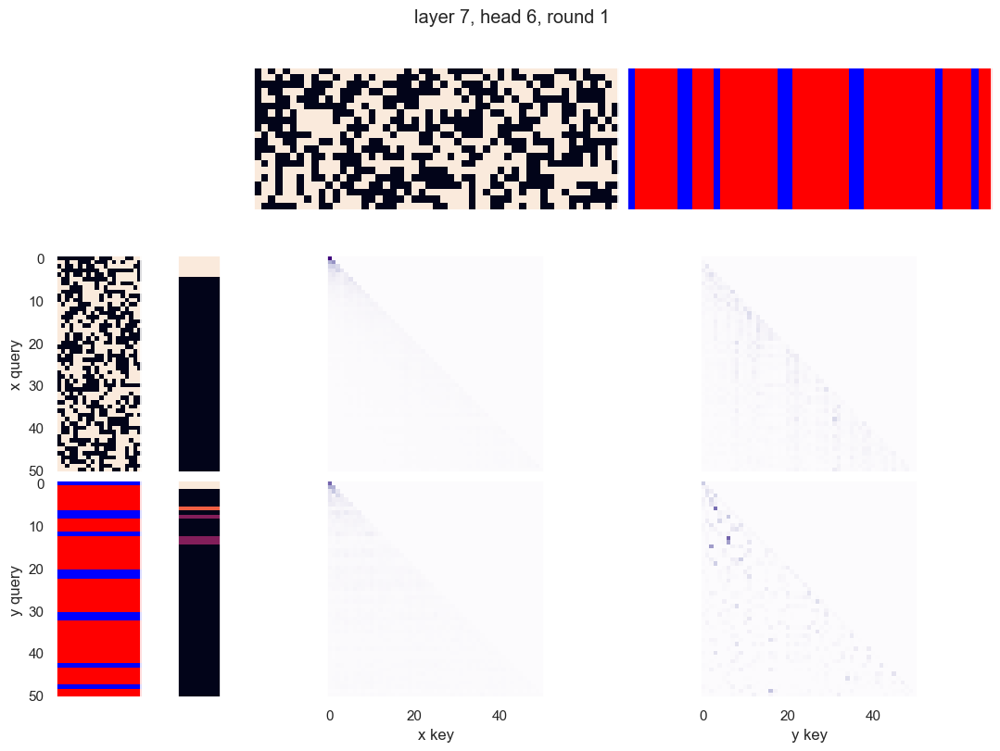

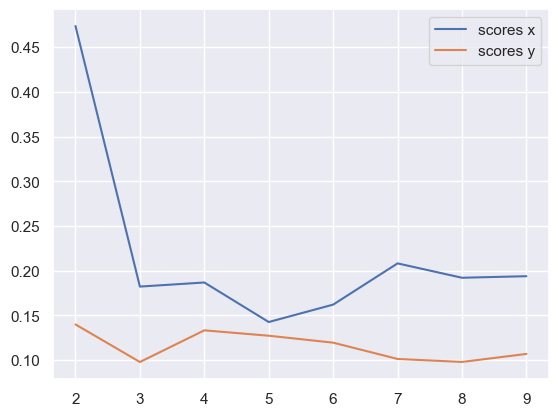

x query cluster:
SVM coefs: [-0.10543898  0.3793129  -0.16403446 -0.1208351   0.24402549  0.10236855
 -0.08437161  0.23418961 -0.18886224 -0.66353404  0.04109724 -0.52821027
  0.172849   -0.06949181  0.03457776  0.08149458  0.14972281  0.68103879
 -0.62447282 -0.75904469]
class1: [0 1 2 3 4]
(1) +9: 1.00; (2) -17: 0.80; (3) +1: 0.80; (4) -2: 0.80; (5) -15: 0.80; (6) -14: 0.80; (7) -5: 0.80; (8) +11: 0.80; (9) -18: 0.60; (10) -16: 0.60
(1) -5 AND +11: 0.80; (2) +9 AND -14: 0.80; (3) +1 AND +9: 0.80; (4) +9 AND -17: 0.80; (5) -2 AND +9: 0.80; (6) -14 AND -17: 0.80; (7) +9 AND +11: 0.80; (8) +9 AND -15: 0.80; (9) -5 AND +9: 0.80; (10) +1 AND -2: 0.80
(1) -4 OR +11: 1.00; (2) +1 OR -18: 1.00; (3) -10 OR -12: 1.00; (4) +13 OR +19: 1.00; (5) -3 OR -14: 1.00; (6) +1 OR -19: 1.00; (7) -6 OR -14: 1.00; (8) +10 OR +12: 1.00; (9) -2 OR +3: 1.00; (10) +12 OR -15: 1.00
{0.0: 0.18836934082210066}
class2: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 3

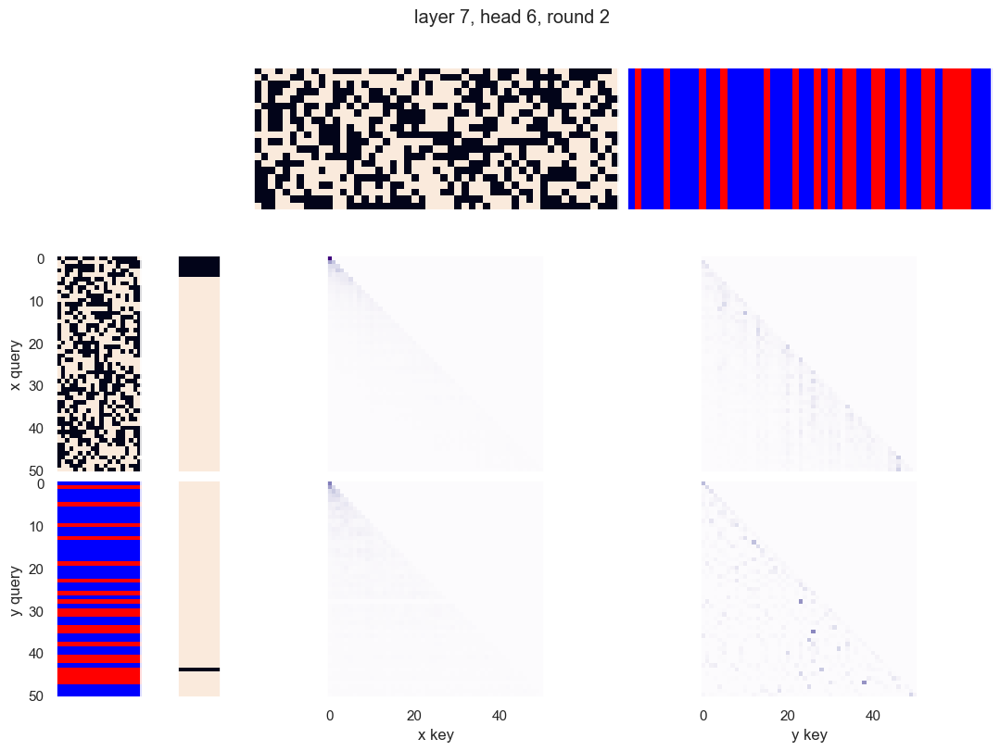

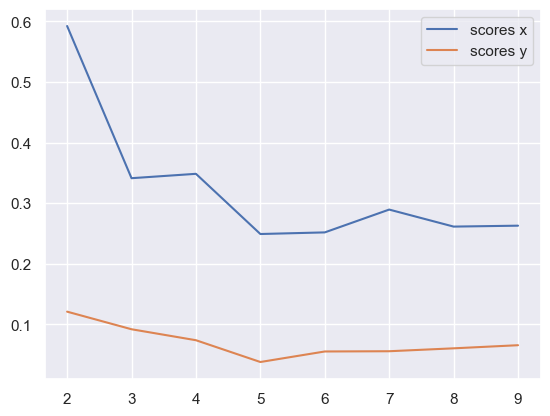

x query cluster:
SVM coefs: [ 0.10544312 -0.3793071   0.16403256  0.12083762 -0.24402766 -0.10237063
  0.08436967 -0.23419014  0.18886774  0.66353303 -0.04109536  0.52820825
 -0.17284112  0.06949156 -0.03458192 -0.08149699 -0.14972051 -0.68103842
  0.62447431  0.75904266]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17

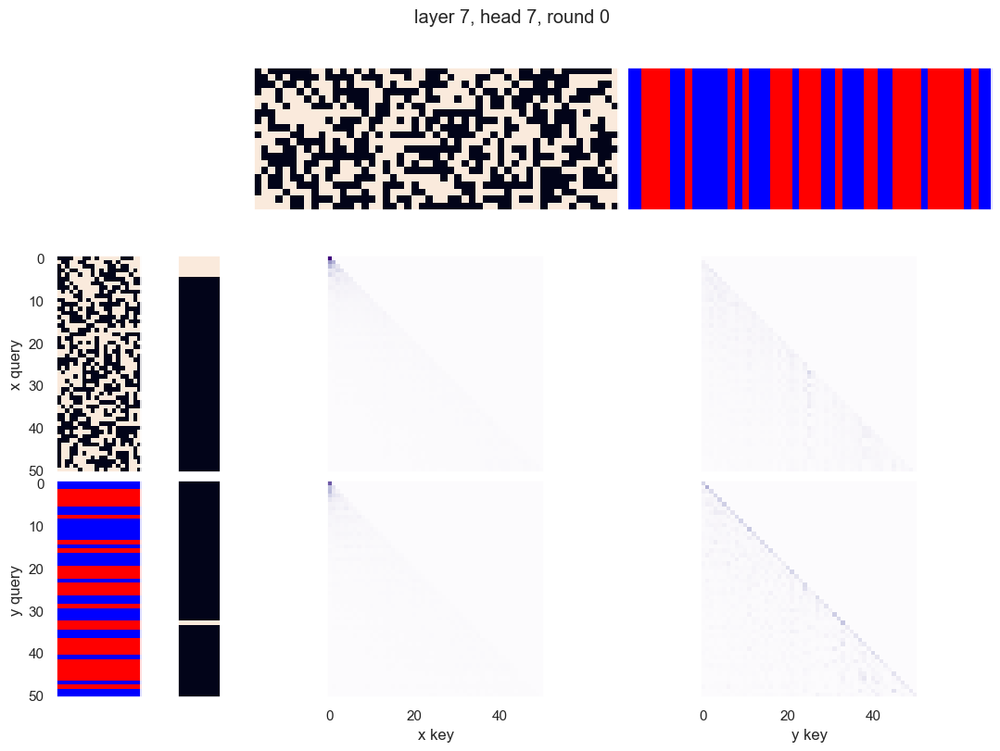

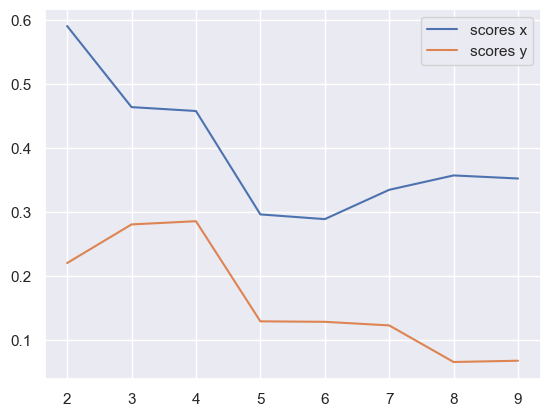

x query cluster:
SVM coefs: [-0.46865575 -0.57678027  0.27721404  0.21226418 -0.11847501 -0.05889498
  0.0072401  -0.45952411  0.42597374  0.43341367 -0.08995705  0.23647
 -0.24495393 -0.49575498 -0.29612275  0.17306283  0.11536646 -0.6792401
  0.21284376  0.87187048]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +19: 0.62; (4) +13: 0.62; (5) -16: 0.60; (6) -12: 0.60; (7) +6: 0.58; (8) +9: 0.58; (9) -3: 0.58; (10) -4: 0.56
(1) -3 AND +19: 0.44; (2) +0 AND +9: 0.44; (3) +0 AND -12: 0.42; (4) +13 AND +14: 0.42; (5) +5 AND -16: 0.42; (6) +9 AND +13: 0.42; (7) -12 AND +19: 0.42; (8) -12 AND -15: 0.42; (9) +0 AND -16: 0.42; (10) -2 AND -12: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +0 OR +11: 0.89; (6) +0 OR +17: 0.89; (7) +14 OR +17: 0.89; (8) +7 OR -12: 0.89; (9) +14 OR -16: 0.89; (10) +6 OR -16: 0.89
{0.

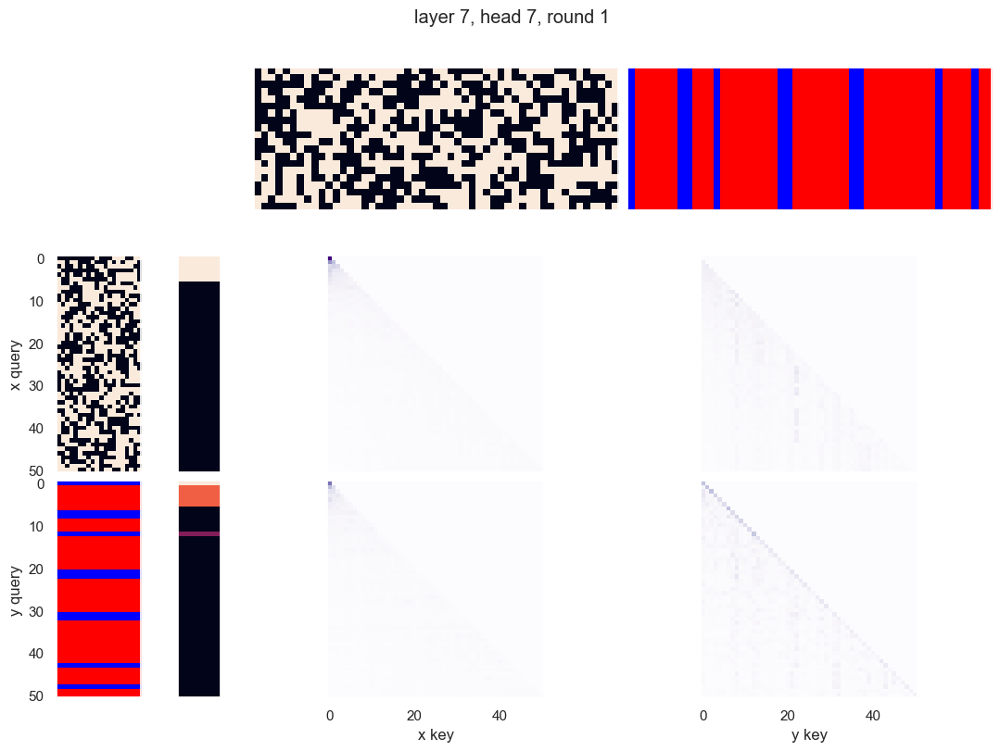

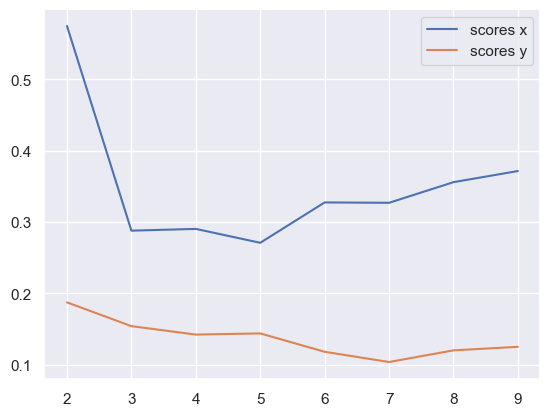

x query cluster:
SVM coefs: [ 0.10544004 -0.3793092   0.16403298  0.12083805 -0.24403069 -0.10237347
  0.08437022 -0.23419181  0.18886702  0.66353642 -0.04109531  0.52821004
 -0.17284729  0.06948764 -0.03458004 -0.08149921 -0.14971983 -0.68103823
  0.62447465  0.75904622]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

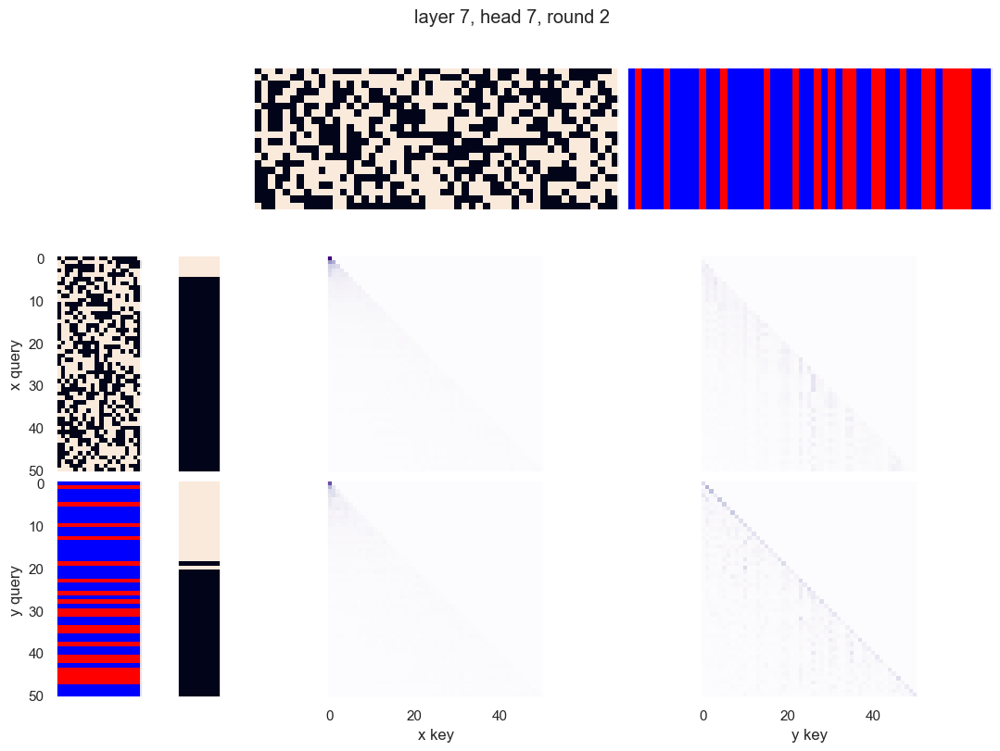

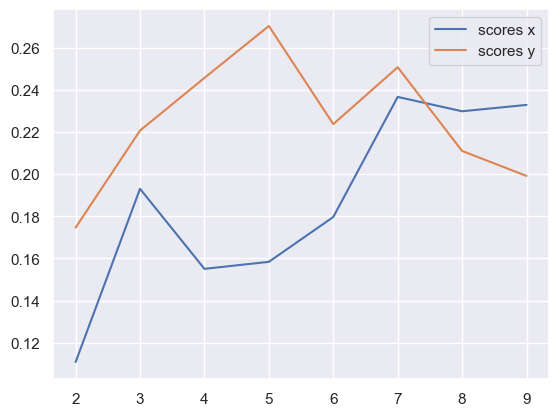

x query cluster:
SVM coefs for class 0: [-0.48871114 -0.20176338 -0.37380693  0.14713613 -0.56847844  0.24715115
 -0.13716823  0.28736137  0.25430622  0.41511129 -0.22678637  0.11392523
  0.46445787 -0.14746178  0.14449492 -0.86089777 -0.00575938 -0.4243193
  0.05280023  0.23303613]\class elements: [38 41 44 45 46]
(1) -0: 1.00; (2) +2: 1.00; (3) +5: 1.00; (4) -18: 0.80; (5) -15: 0.80; (6) +13: 0.80; (7) -12: 0.80; (8) -4: 0.80; (9) +19: 0.80; (10) -3: 0.80
(1) -0 AND +5: 1.00; (2) +2 AND +5: 1.00; (3) -0 AND +2: 1.00; (4) +2 AND -4: 0.80; (5) +5 AND -18: 0.80; (6) -0 AND -18: 0.80; (7) +5 AND -15: 0.80; (8) -3 AND -18: 0.80; (9) +5 AND +19: 0.80; (10) -3 AND +13: 0.80
(1) -0 OR -1: 1.00; (2) -4 OR -15: 1.00; (3) -4 OR -14: 1.00; (4) -4 OR +13: 1.00; (5) -4 OR -12: 1.00; (6) -4 OR +11: 1.00; (7) -4 OR -10: 1.00; (8) -4 OR -9: 1.00; (9) -4 OR -16: 1.00; (10) -4 OR -8: 1.00
{7.0: 0.1439432908082381, 11.0: 0.06853225970262429, 8.0: 0.14108262402296531, 13.0: 0.09257161200803239, 12.0: 0.0

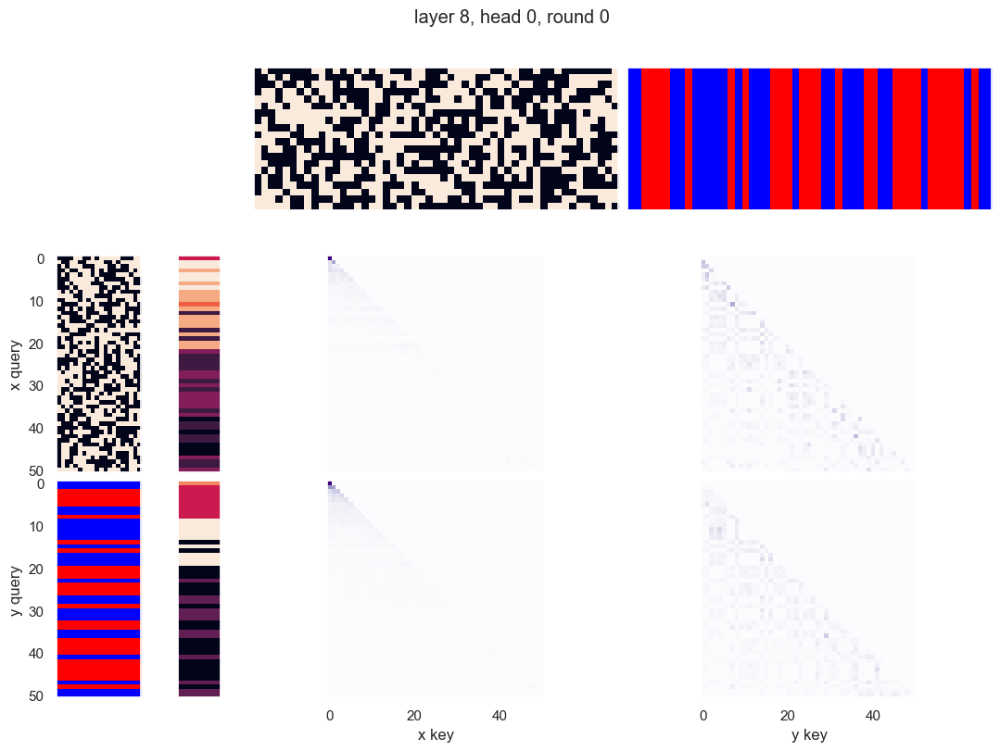

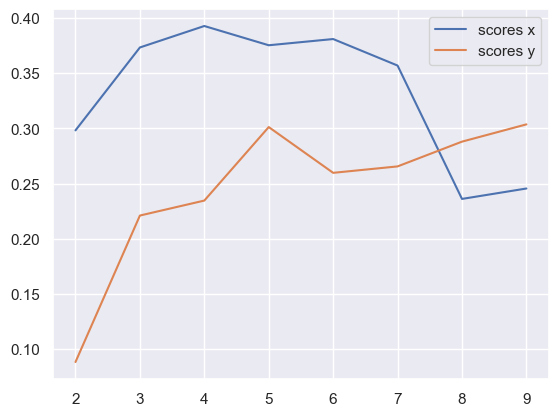

x query cluster:
SVM coefs for class 0: [ 0.32372728 -0.65864353 -0.20089375  0.06478511 -0.03015014 -0.43980465
 -0.58577978  0.28727713 -0.57766435 -0.15552489  0.02173145 -0.53281918
  0.3993287  -0.09896601  0.58160061  0.09032129 -0.78327803  0.50683268
 -0.15067923 -0.06230429]\class elements: [ 6  7 11 12 16 17 22 25 27 28 32 34 35 36 37 39 42 43 44 46 48 50]
(1) +2: 0.95; (2) +19: 0.73; (3) +14: 0.68; (4) +13: 0.68; (5) +0: 0.64; (6) -1: 0.64; (7) +17: 0.59; (8) -3: 0.59; (9) +15: 0.59; (10) +11: 0.59
(1) +2 AND +19: 0.68; (2) +2 AND +13: 0.68; (3) +2 AND +14: 0.64; (4) +2 AND +15: 0.59; (5) +2 AND +17: 0.59; (6) +0 AND +2: 0.59; (7) +2 AND -3: 0.59; (8) -1 AND +2: 0.59; (9) +2 AND -10: 0.55; (10) +11 AND +19: 0.55
(1) +2 OR +5: 1.00; (2) +2 OR -16: 1.00; (3) +2 OR -15: 1.00; (4) +2 OR +14: 1.00; (5) -1 OR +2: 1.00; (6) +2 OR -13: 1.00; (7) +2 OR -12: 1.00; (8) +2 OR +11: 1.00; (9) +2 OR -17: 1.00; (10) +2 OR +18: 1.00
{0.0: 0.8313190813906575}
SVM coefs for class 1: [-0.136620

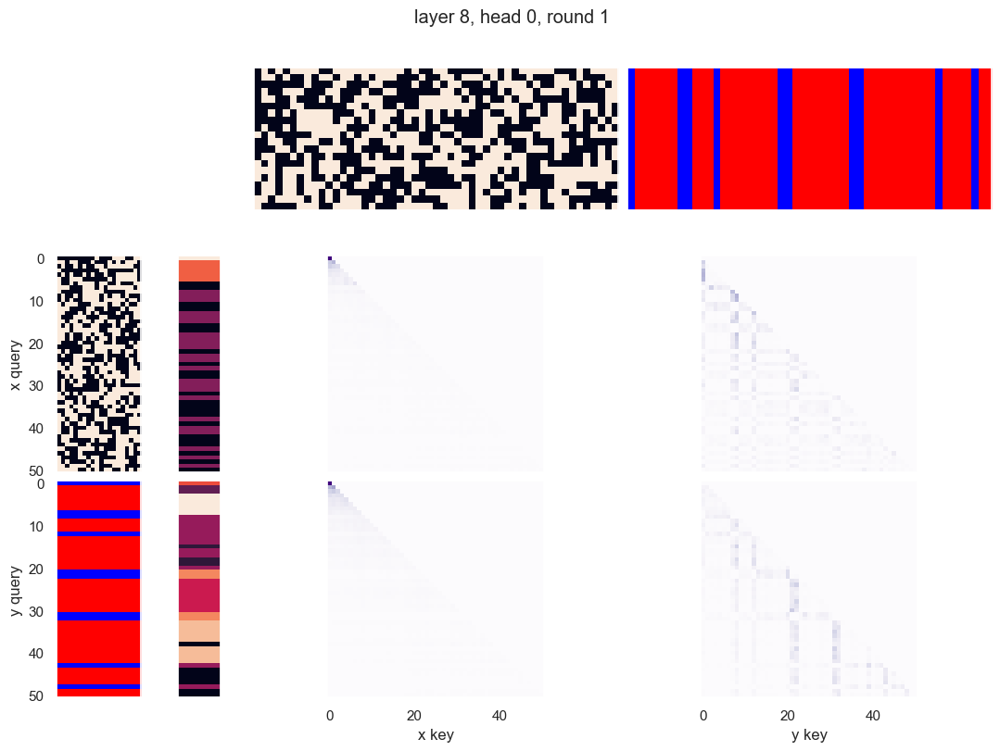

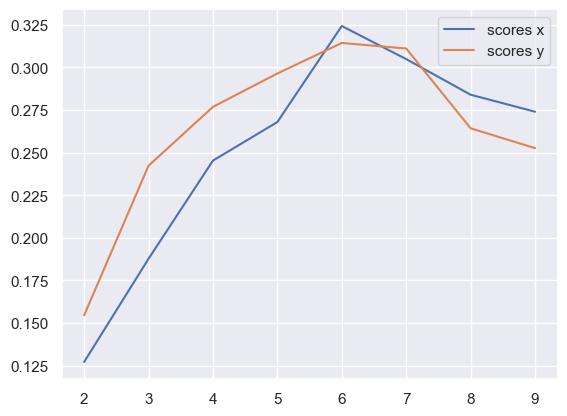

x query cluster:
SVM coefs for class 0: [-0.05527137  0.08438617  0.14397027  0.3676392  -0.30432856  0.21889288
 -0.08463473  0.03113073 -0.13522617  0.00394159  0.02257691 -0.11927434
  0.03987972  0.18410224  0.00441899  0.20603001 -0.0622256  -0.03954676
 -0.26518771 -0.05138079]\class elements: [27 28 30 34 35 37 38 40 42 44 45 47 49 50]
(1) +2: 1.00; (2) -1: 0.79; (3) +7: 0.79; (4) -10: 0.71; (5) +16: 0.71; (6) -15: 0.71; (7) -18: 0.64; (8) -3: 0.64; (9) -4: 0.64; (10) +5: 0.64
(1) +2 AND +7: 0.79; (2) -1 AND +2: 0.79; (3) +2 AND -15: 0.71; (4) +2 AND -10: 0.71; (5) +2 AND +16: 0.71; (6) +2 AND +5: 0.64; (7) -15 AND +16: 0.64; (8) +2 AND -3: 0.64; (9) -15 AND -18: 0.64; (10) +2 AND -4: 0.64
(1) +2 OR -4: 1.00; (2) +2 OR +15: 1.00; (3) +2 OR -15: 1.00; (4) +2 OR +14: 1.00; (5) -15 OR +18: 1.00; (6) +2 OR -14: 1.00; (7) +2 OR +13: 1.00; (8) +2 OR -13: 1.00; (9) +2 OR -12: 1.00; (10) +2 OR +11: 1.00
{0.0: 0.8633595552312598}
SVM coefs for class 1: [-0.17837987 -0.17591234 -0.4277017

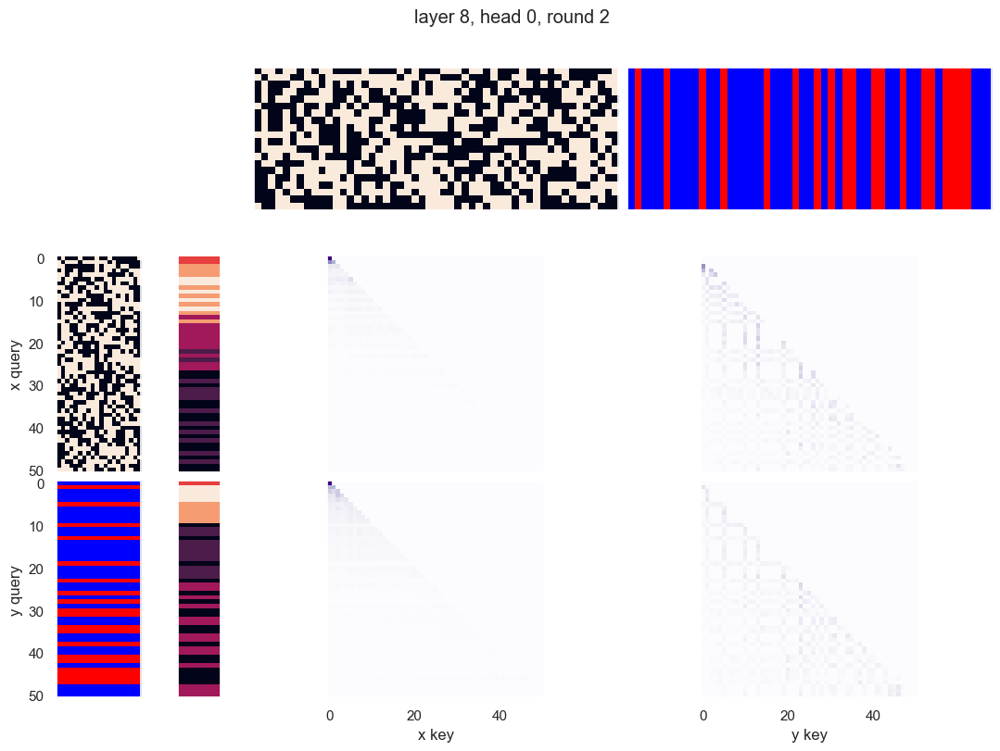

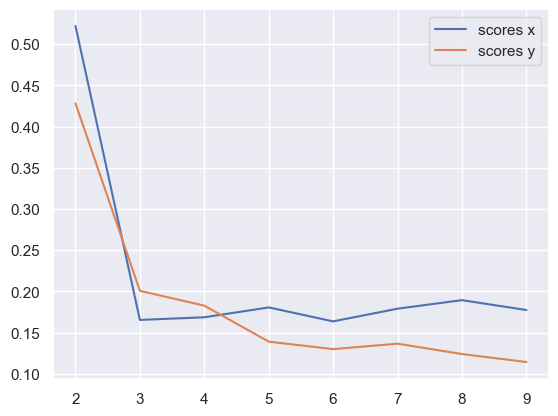

x query cluster:
SVM coefs: [ 0.25510075 -0.45922111  0.27299429  0.17551384 -0.21552073 -0.11985156
  0.07025382 -0.09279195  0.10831789  0.49036091 -0.00371686  0.2023796
 -0.11104899  0.23139032  0.04469571 -0.29457762 -0.46677833 -0.52134924
  0.57332339  0.62859257]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR 

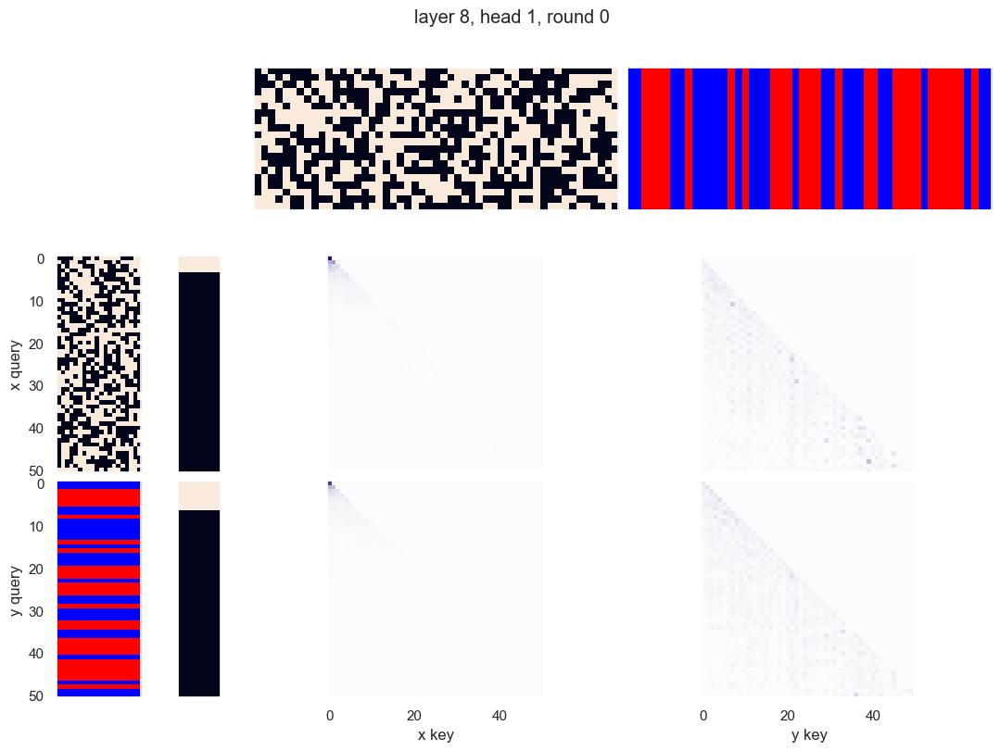

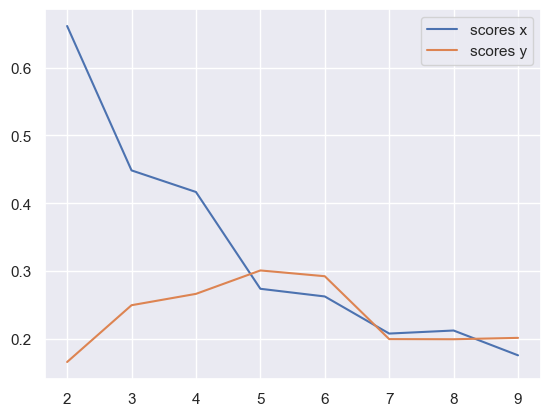

x query cluster:
SVM coefs: [ 0.26247799 -0.32280181  0.10229292  0.14784533 -0.20820411 -0.04183339
 -0.08340289 -0.00503959  0.46534836  0.28237469  0.02749544  0.26015906
  0.04959119  0.1337854   0.13217046 -0.16053197 -0.24772086 -0.57431952
  0.37579968  0.68952925]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) -12: 0.60; (4) +19: 0.58; (5) -16: 0.58; (6) +13: 0.58; (7) -2: 0.56; (8) -3: 0.56; (9) -4: 0.56; (10) +11: 0.56
(1) +0 AND -16: 0.42; (2) -3 AND +19: 0.42; (3) +0 AND -12: 0.42; (4) +0 AND +9: 0.42; (5) -2 AND -12: 0.42; (6) -12 AND -15: 0.42; (7) +0 AND -15: 0.40; (8) +9 AND +13: 0.40; (9) +5 AND -16: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.92; (2) +0 OR +14: 0.92; (3) +0 OR +11: 0.90; (4) +0 OR +17: 0.90; (5) +14 OR -15: 0.90; (6) +14 OR -16: 0.90; (7) +13 OR +19: 0.88; (8) +14 OR +19: 0.88; (9) +7 OR -12: 0.88; (10) +14 OR

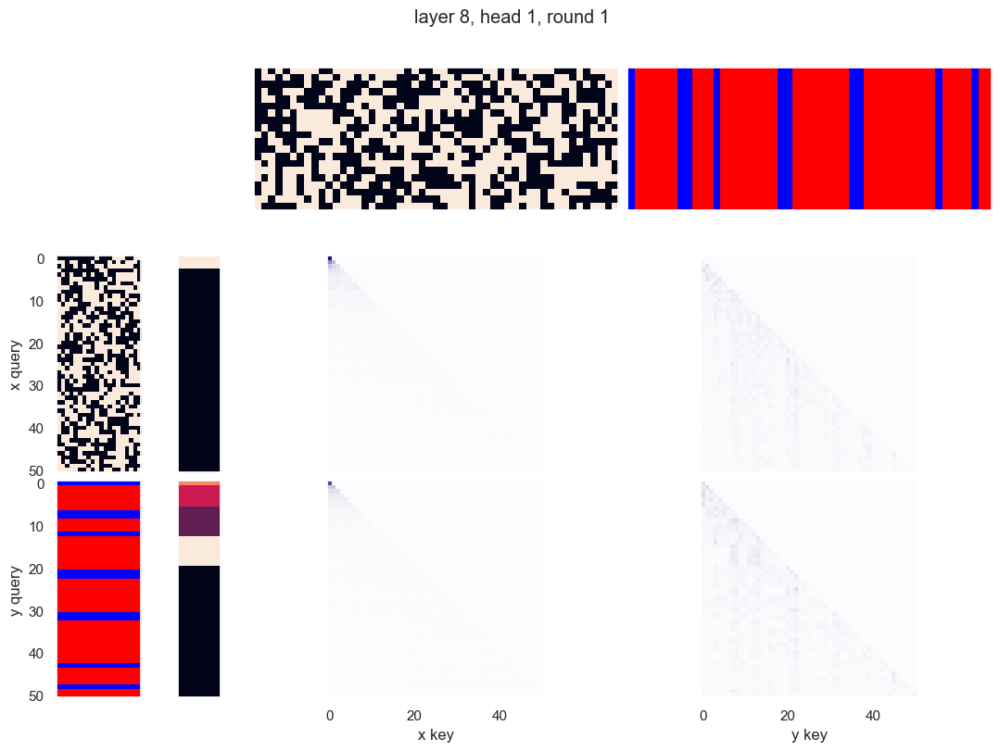

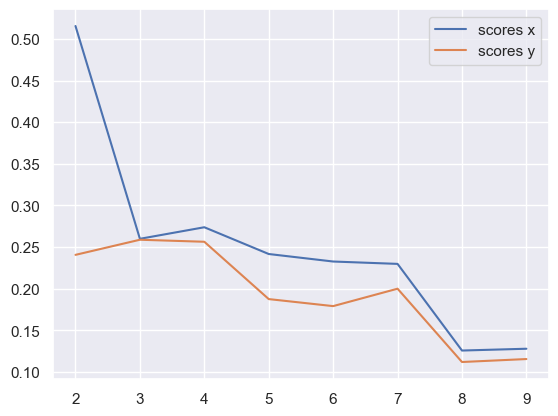

x query cluster:
SVM coefs: [-0.46865051 -0.57677458  0.27720697  0.21226312 -0.11848401 -0.05889635
  0.00722943 -0.45951761  0.42596593  0.43340772 -0.08995429  0.23646916
 -0.2449482  -0.49574894 -0.29612497  0.17306128  0.11536288 -0.67924637
  0.21284132  0.87186939]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.8

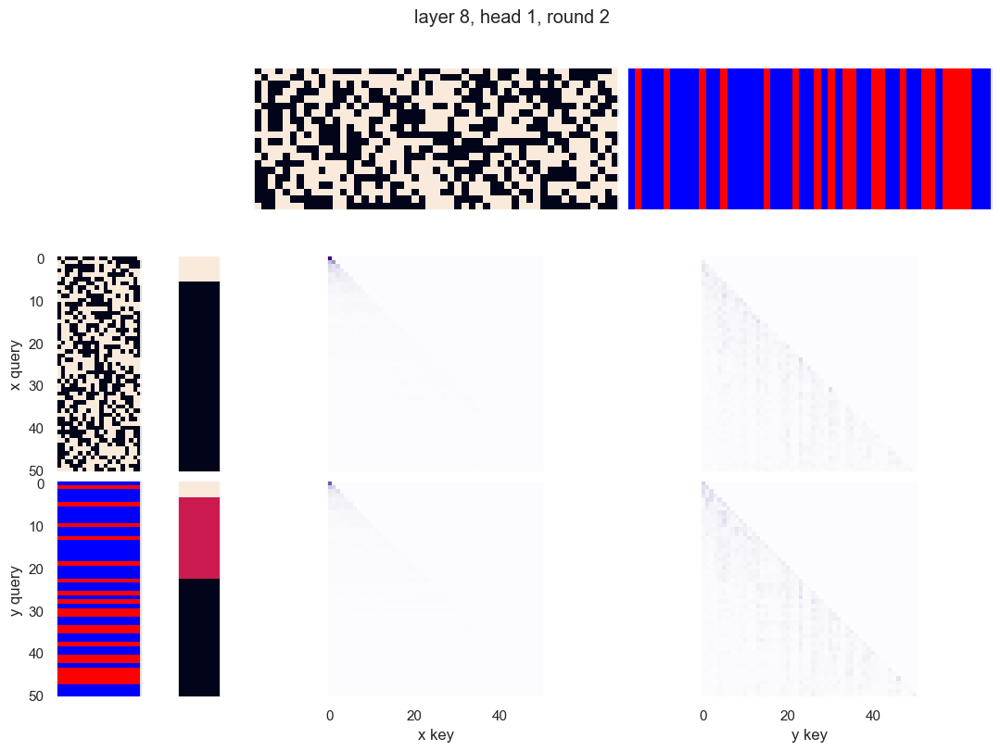

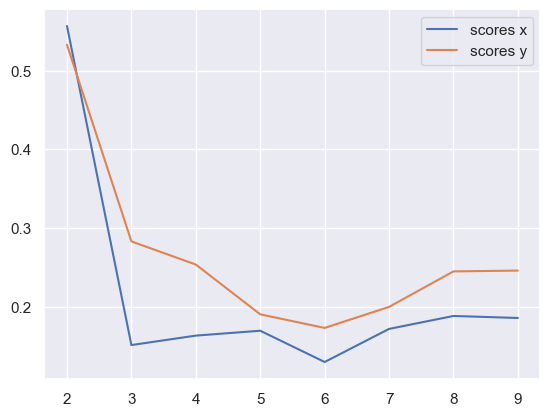

x query cluster:
SVM coefs: [ 0.25510581 -0.4592214   0.27299122  0.17551997 -0.21551569 -0.1198519
  0.0702562  -0.09279257  0.10832129  0.49036078 -0.00371107  0.2023808
 -0.11104666  0.23138637  0.04469394 -0.2945773  -0.4667764  -0.52135281
  0.57332257  0.62858861]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR +

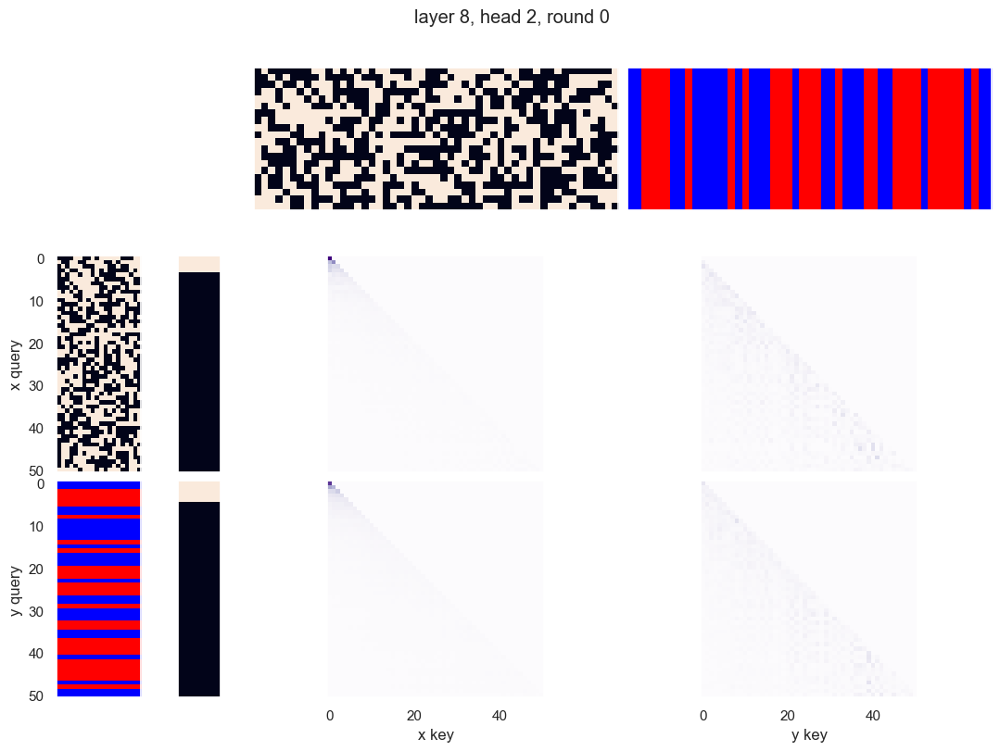

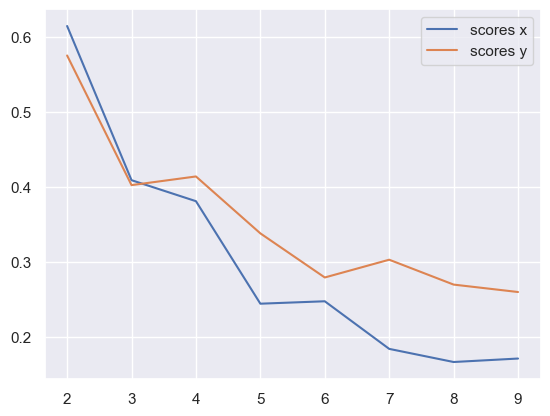

x query cluster:
SVM coefs: [ 0.25510576 -0.45921863  0.27299025  0.1755176  -0.21551703 -0.11985522
  0.07025079 -0.09279351  0.1083196   0.4903613  -0.00371323  0.20237896
 -0.1110503   0.23138612  0.0446938  -0.29457791 -0.46677137 -0.52135337
  0.57332401  0.62858552]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.66; (2) +0: 0.64; (3) +19: 0.60; (4) +13: 0.60; (5) -12: 0.60; (6) -16: 0.57; (7) +6: 0.57; (8) +17: 0.55; (9) +11: 0.55; (10) +5: 0.55
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) -12 AND -15: 0.40; (4) +5 AND -16: 0.40; (5) -12 AND +19: 0.40; (6) +9 AND +13: 0.40; (7) -4 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) -2 AND -12: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.91; (2) +0 OR +14: 0.91; (3) +0 OR +11: 0.89; (4) +14 OR +19: 0.89; (5) +14 OR +17: 0.89; (6) +0 OR +17: 0.89; (7) +13 OR +19: 0.89; (8) +14 OR -15: 0.89; (9) +14 OR -16: 0.89; (10) -12 OR

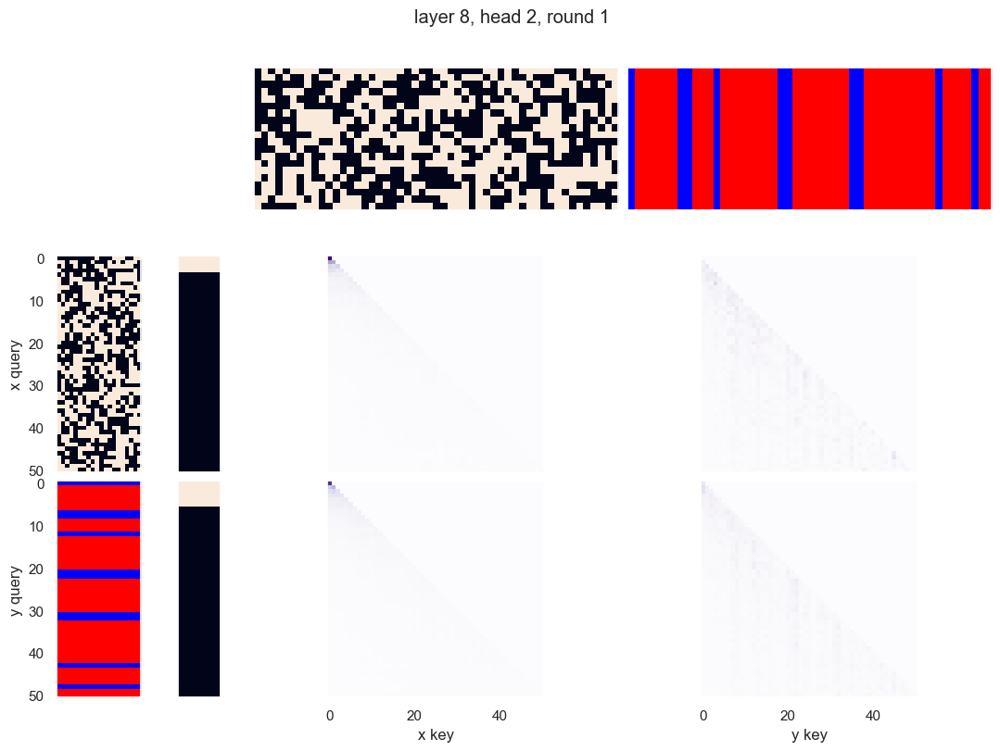

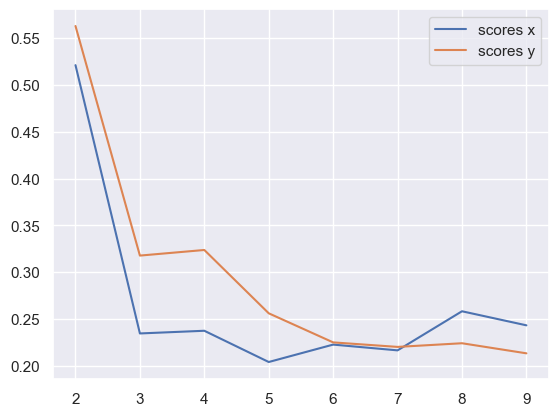

x query cluster:
SVM coefs: [ 0.10544253 -0.37931288  0.16402978  0.12083649 -0.24402579 -0.1023737
  0.08436982 -0.2341918   0.18886749  0.66353908 -0.04109563  0.52820671
 -0.17284536  0.06948966 -0.03458134 -0.08149505 -0.14972033 -0.68103747
  0.62447838  0.75904219]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0.

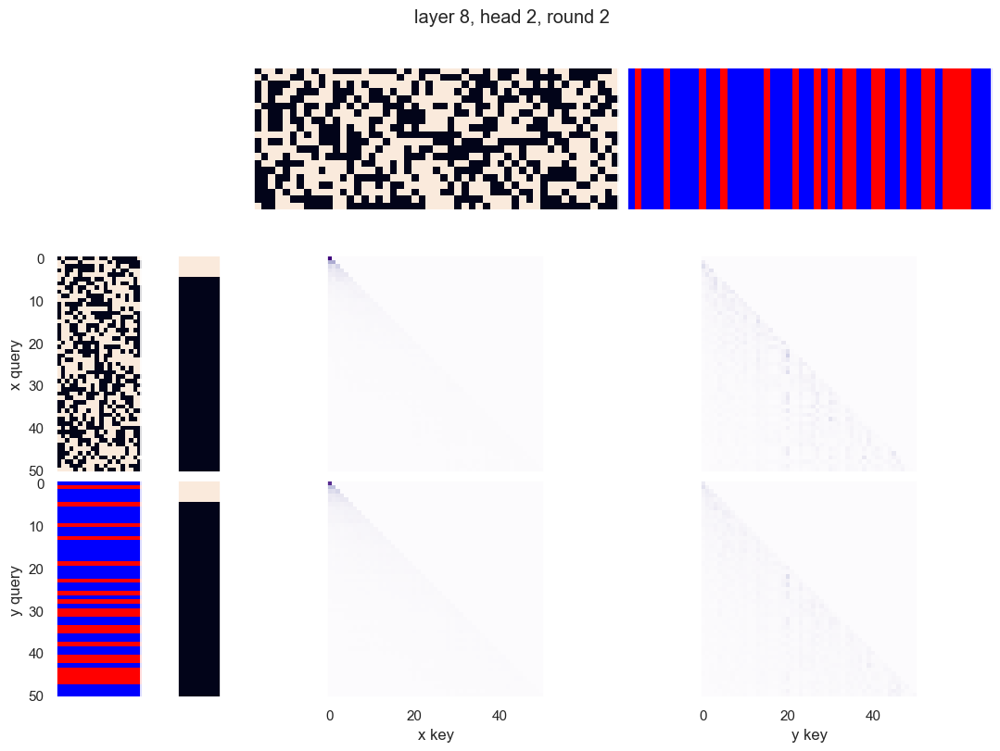

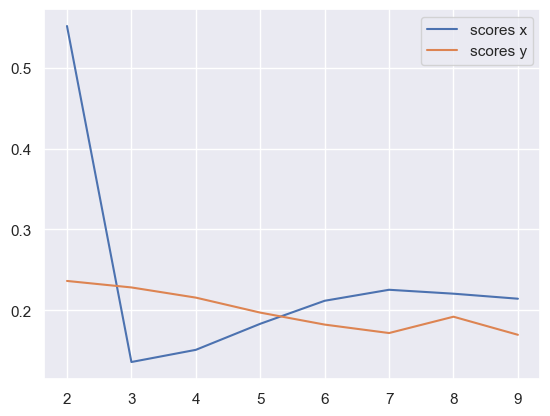

x query cluster:
SVM coefs: [ 0.25510578 -0.45922097  0.27298919  0.17551599 -0.2155146  -0.1198476
  0.07025058 -0.09278587  0.10832107  0.49035915 -0.00370829  0.20237883
 -0.11104619  0.23138342  0.04469708 -0.29457428 -0.46677783 -0.5213555
  0.57331927  0.62859037]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR +

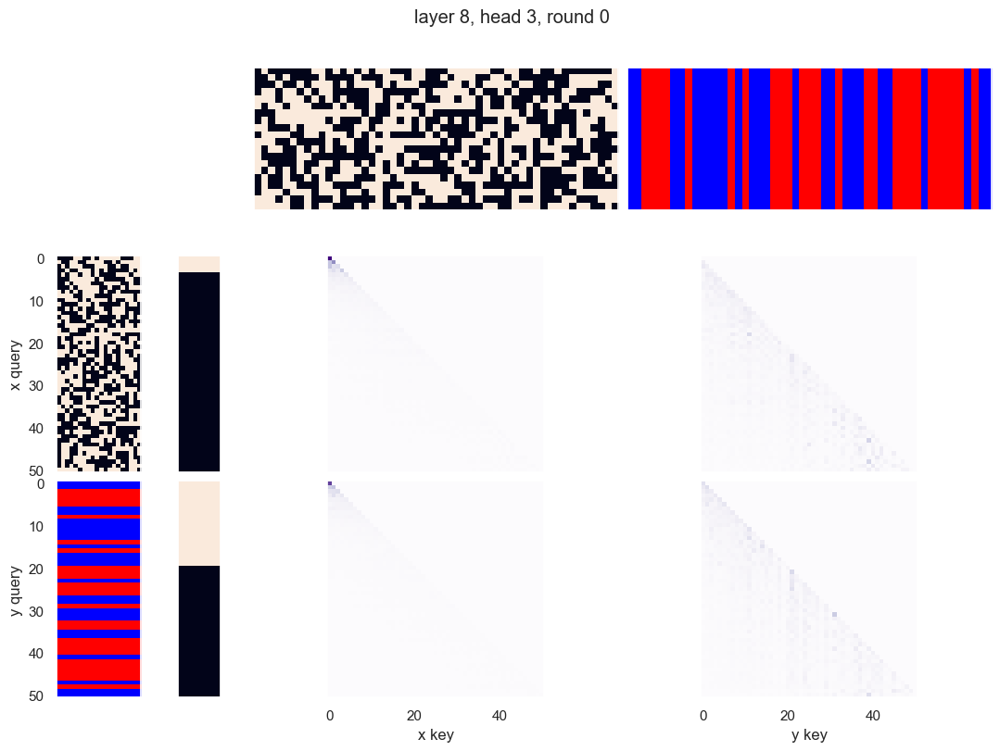

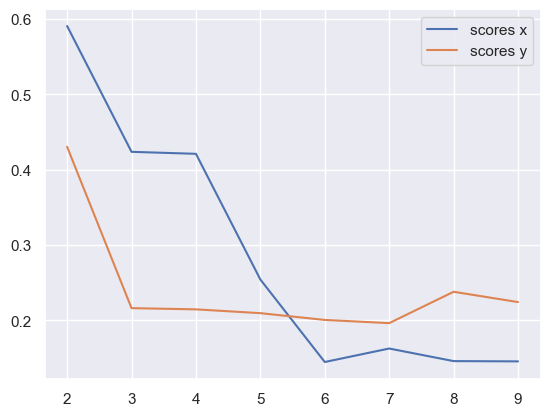

x query cluster:
SVM coefs: [ 0.10543991 -0.37930583  0.16403569  0.12083436 -0.24403014 -0.10237164
  0.08436823 -0.23418745  0.18886818  0.66353707 -0.04109732  0.52820685
 -0.17284632  0.069485   -0.03458198 -0.08149518 -0.14971422 -0.68103892
  0.6244714   0.75904489]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) +19: 0.61; (4) +13: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +6: 0.57; (8) +5: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) +9 AND +13: 0.41; (4) +0 AND -12: 0.41; (5) +0 AND -16: 0.41; (6) +13 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +5 AND -16: 0.41; (9) -12 AND +19: 0.41; (10) +0 AND +19: 0.39
(1) +13 OR +19: 0.91; (2) -12 OR +13: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR +19: 0.89; (5) +0 OR +17: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -15: 0.89; (8) +0 OR +11: 0.89; (9) +14 OR -16: 0.89; (10) -16 OR +19:

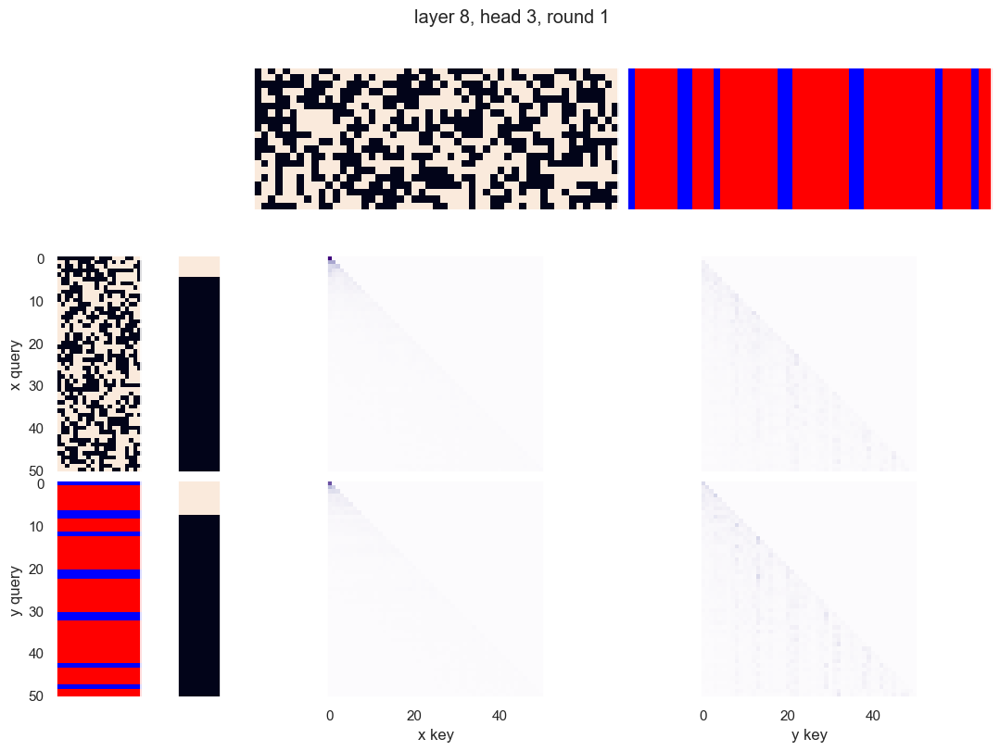

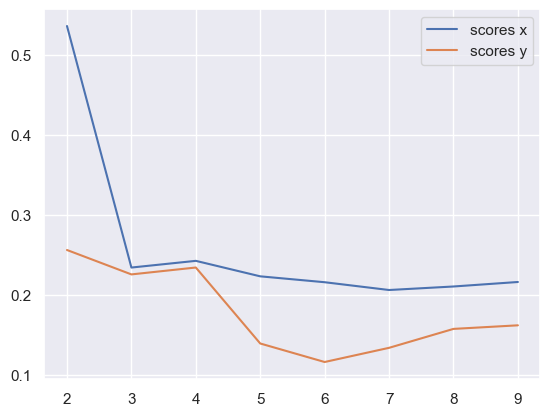

x query cluster:
SVM coefs: [ 0.10543621 -0.37931165  0.1640362   0.12083545 -0.24402251 -0.10236946
  0.08436778 -0.23418812  0.18886435  0.66353774 -0.04109648  0.52820913
 -0.17284517  0.06949077 -0.03457915 -0.08149577 -0.14972111 -0.68103802
  0.62447014  0.75904839]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

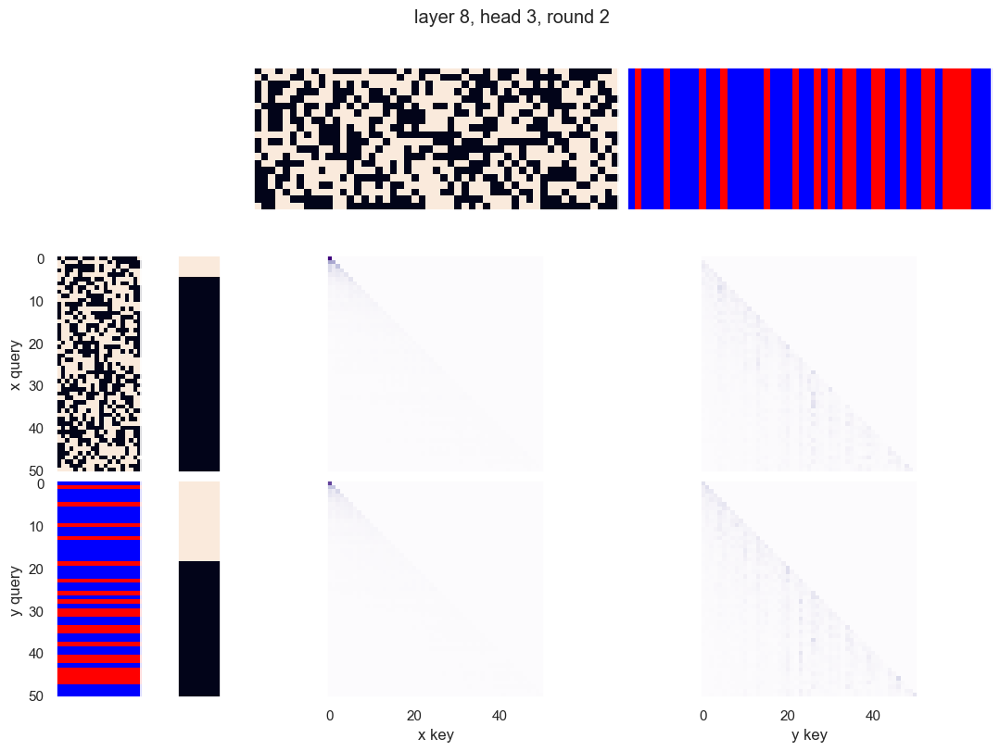

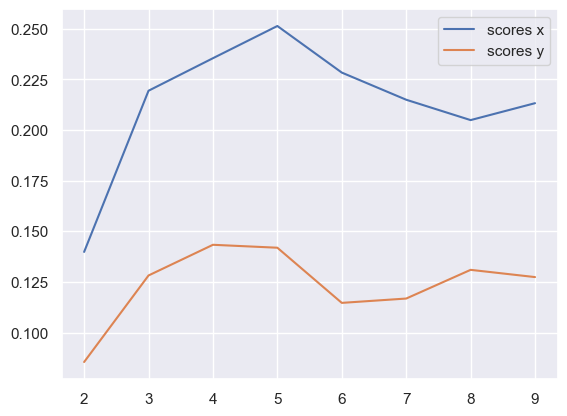

x query cluster:
SVM coefs for class 0: [ 0.3228921  -0.16792752  0.18244094  0.23821055 -0.59603343 -0.73312779
 -0.66525589 -0.06689778 -0.61167776  0.23059012 -0.23152115 -0.56608885
  0.43263938 -0.83760807  0.18847474  0.09219673  0.01169251 -0.02330154
  0.32602193 -0.05640355]\class elements: [22 25 26 29 31 34 36 39 44]
(1) -13: 1.00; (2) +18: 0.89; (3) -11: 0.89; (4) +3: 0.78; (5) +10: 0.67; (6) +1: 0.67; (7) -2: 0.67; (8) +17: 0.67; (9) -19: 0.67; (10) -8: 0.67
(1) -11 AND -13: 0.89; (2) -13 AND +18: 0.89; (3) +3 AND -13: 0.78; (4) -11 AND +18: 0.78; (5) -2 AND -13: 0.67; (6) +10 AND +18: 0.67; (7) -6 AND +18: 0.67; (8) -6 AND -13: 0.67; (9) +3 AND -11: 0.67; (10) +10 AND -13: 0.67
(1) +12 OR -13: 1.00; (2) -11 OR +12: 1.00; (3) -11 OR -13: 1.00; (4) +1 OR -11: 1.00; (5) +7 OR -13: 1.00; (6) +11 OR -13: 1.00; (7) -11 OR +14: 1.00; (8) -11 OR +15: 1.00; (9) -11 OR -16: 1.00; (10) -7 OR -13: 1.00
{7.0: 0.05883754873260234, 11.0: 0.09285160376586848, 8.0: 0.16188934093871568, 13

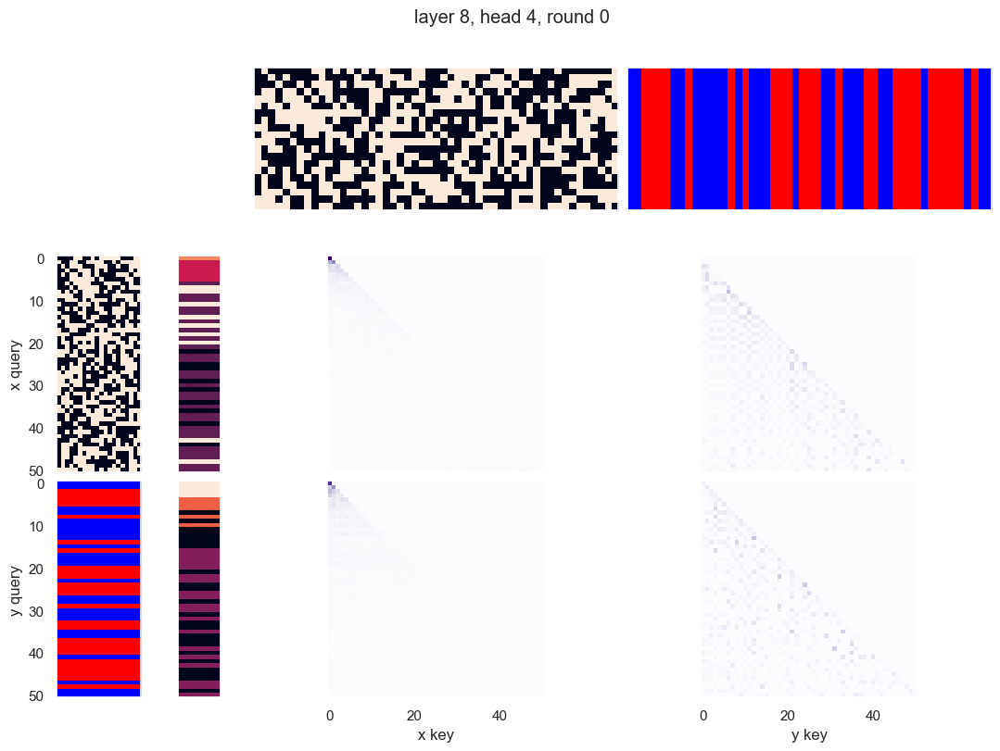

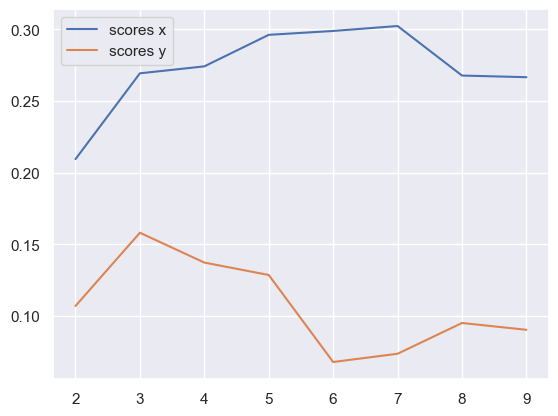

x query cluster:
SVM coefs for class 0: [-0.17017309  0.094195    0.19224718  0.01070802  0.07288458 -0.04549848
 -0.12977266 -0.05714269 -0.0193783   0.09558224 -0.07337459  0.14453646
  0.06954411 -0.0346244   0.02847766  0.07030711 -0.02665225 -0.11804316
  0.12109722 -0.10445103]\class elements: [12 13 14 23 29 30 38 39 41 42 43 44 45 47 50]
(1) -13: 1.00; (2) +19: 0.80; (3) -12: 0.80; (4) +1: 0.67; (5) +5: 0.67; (6) -9: 0.60; (7) -16: 0.60; (8) -4: 0.60; (9) +6: 0.60; (10) +18: 0.60
(1) -12 AND -13: 0.80; (2) -13 AND +19: 0.80; (3) +5 AND -13: 0.67; (4) +1 AND -13: 0.67; (5) +1 AND +19: 0.60; (6) +0 AND -13: 0.60; (7) +6 AND -13: 0.60; (8) -9 AND -13: 0.60; (9) -3 AND -13: 0.60; (10) -2 AND -13: 0.60
(1) +9 OR -13: 1.00; (2) -13 OR +14: 1.00; (3) -13 OR -14: 1.00; (4) -12 OR +19: 1.00; (5) -4 OR -13: 1.00; (6) +4 OR -13: 1.00; (7) -12 OR +17: 1.00; (8) +10 OR -13: 1.00; (9) -7 OR -13: 1.00; (10) -5 OR -13: 1.00
{0.0: 0.7862143822625515}
SVM coefs for class 1: [ 0.08595897  0.06470

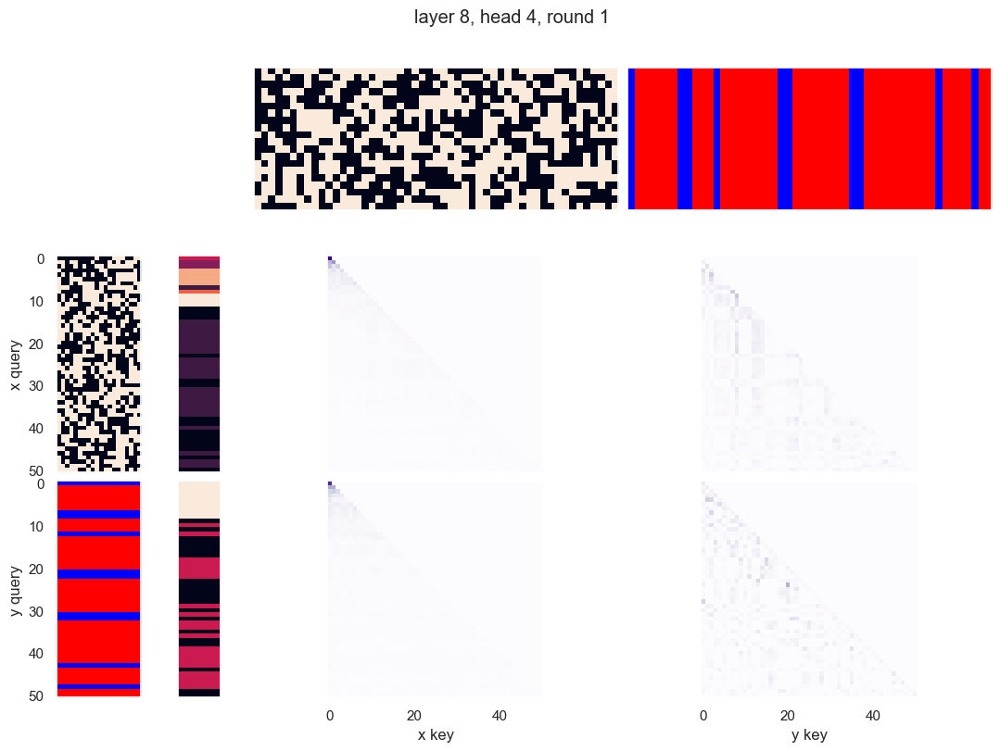

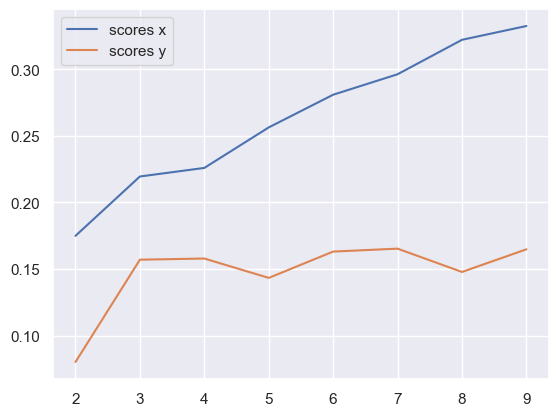

x query cluster:
SVM coefs for class 0: [-0.23687698 -0.12876867 -0.33748574  0.03885594 -1.03848222  0.36980031
 -0.40510019 -0.11433504  0.04013892 -0.18692588 -0.5015402   0.44428584
 -0.35078554 -0.02472866  0.21964013 -0.07410715  0.10937386 -0.4484542
 -0.91322913  0.3642991 ]\class elements: [33 35 37 40 41 42 44 45 46 48 49]
(1) +13: 1.00; (2) -3: 0.82; (3) -19: 0.73; (4) +8: 0.73; (5) +6: 0.73; (6) +2: 0.64; (7) +11: 0.64; (8) +10: 0.64; (9) -15: 0.64; (10) -9: 0.64
(1) -3 AND +13: 0.82; (2) +8 AND +13: 0.73; (3) +13 AND -19: 0.73; (4) +6 AND +13: 0.73; (5) -0 AND +13: 0.64; (6) -1 AND +13: 0.64; (7) +10 AND +13: 0.64; (8) -9 AND -19: 0.64; (9) +12 AND +13: 0.64; (10) -9 AND +13: 0.64
(1) -3 OR +17: 1.00; (2) -3 OR +6: 1.00; (3) +1 OR +13: 1.00; (4) -1 OR +13: 1.00; (5) -3 OR -7: 1.00; (6) -6 OR +13: 1.00; (7) +6 OR +13: 1.00; (8) +6 OR -14: 1.00; (9) +13 OR +14: 1.00; (10) +6 OR +16: 1.00
{0.0: 0.8161398053634913}
SVM coefs for class 1: [ 2.73896841e-01  3.07753822e-02  3.016

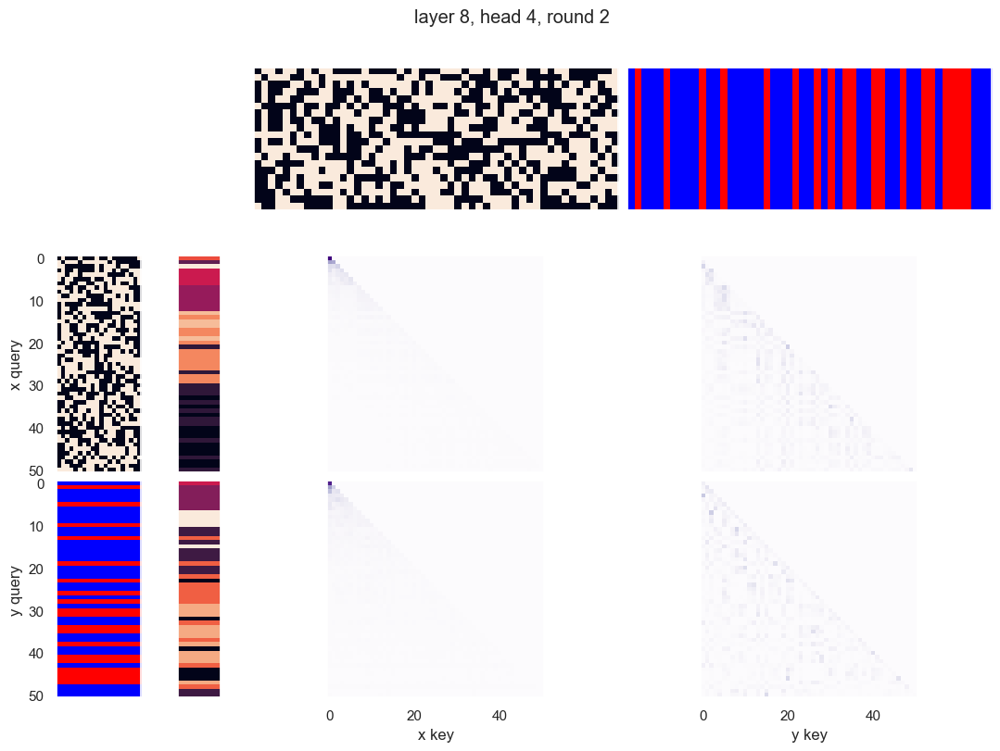

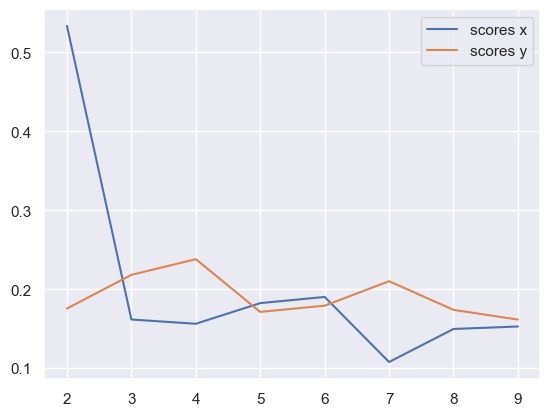

x query cluster:
SVM coefs: [ 0.25510285 -0.45922086  0.27299229  0.17551484 -0.2155221  -0.11985196
  0.07025354 -0.09279298  0.1083161   0.49036231 -0.00371551  0.20237723
 -0.11104745  0.23138361  0.04469639 -0.29457626 -0.46677567 -0.5213518
  0.57332348  0.62859139]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR 

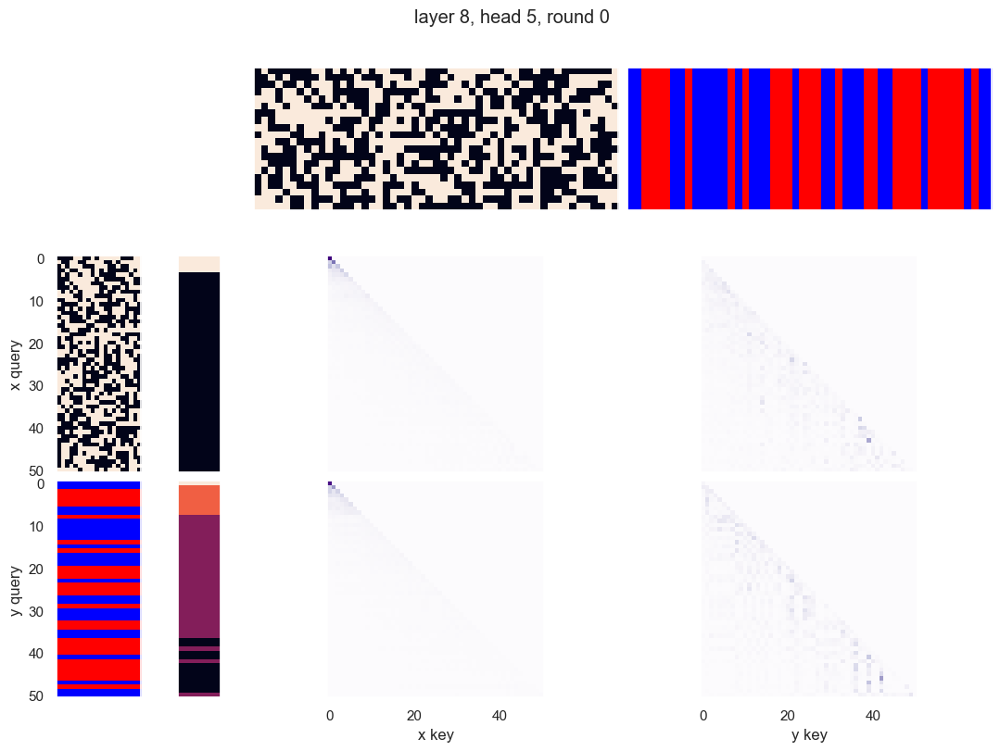

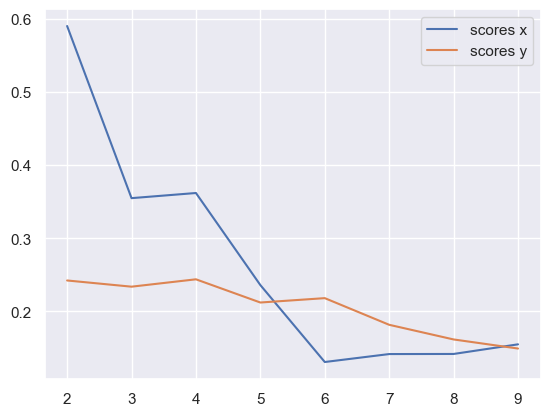

x query cluster:
SVM coefs: [ 0.10543656 -0.37930925  0.16403295  0.12083626 -0.24402346 -0.10237211
  0.08437144 -0.23418945  0.18886461  0.66353719 -0.04109704  0.52820757
 -0.17284931  0.06949238 -0.03457821 -0.08149726 -0.14972574 -0.68103406
  0.62447361  0.75904756]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) +19: 0.61; (4) +13: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +6: 0.57; (8) +5: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) +9 AND +13: 0.41; (4) +0 AND -12: 0.41; (5) +0 AND -16: 0.41; (6) +13 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +5 AND -16: 0.41; (9) -12 AND +19: 0.41; (10) +0 AND +19: 0.39
(1) +13 OR +19: 0.91; (2) -12 OR +13: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR +19: 0.89; (5) +0 OR +17: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -15: 0.89; (8) +0 OR +11: 0.89; (9) +14 OR -16: 0.89; (10) -16 OR +19:

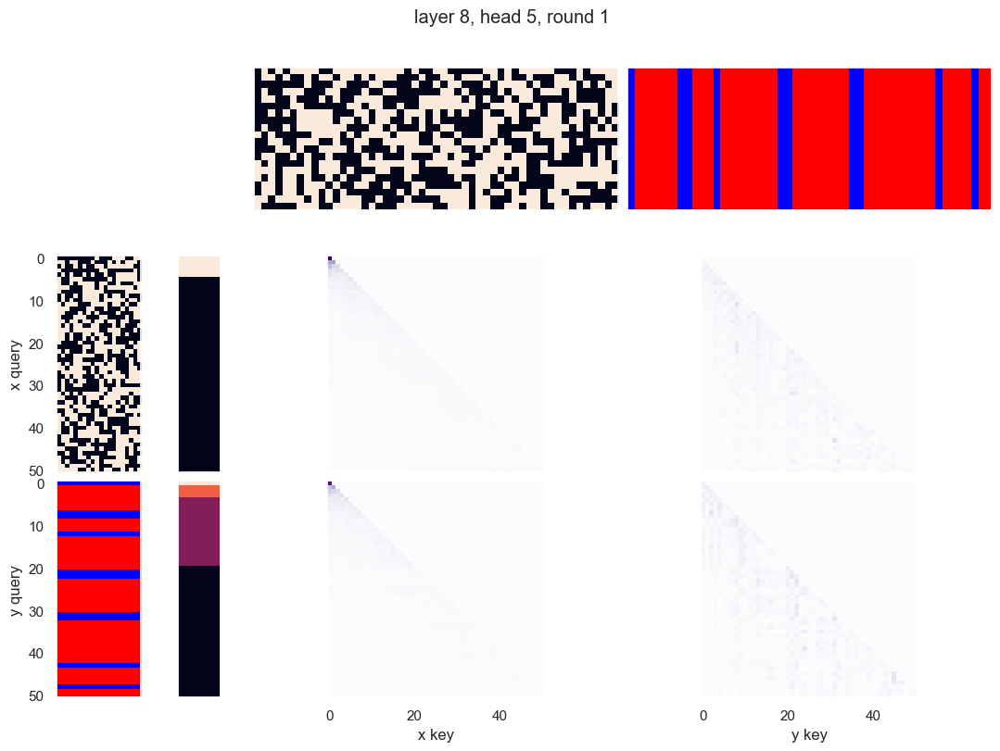

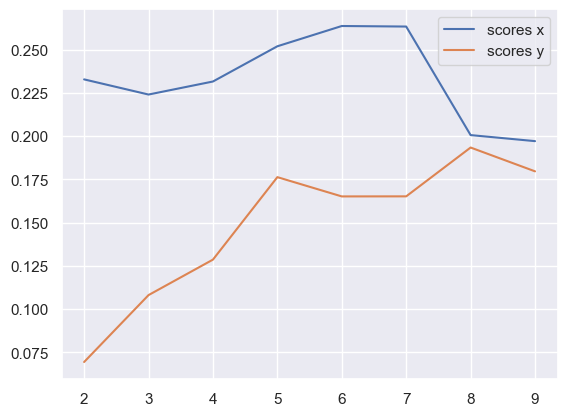

x query cluster:
SVM coefs for class 0: [-0.10436906  0.08096018 -0.01115432  0.03765678 -0.01645031  0.02943566
 -0.25736285  0.04356367 -0.14847529  0.0437664  -0.19065254  0.07102642
  0.04091816  0.16132976 -0.07534208  0.20723855  0.10381343  0.05789233
 -0.19466588 -0.12910432]\class elements: [20 23 26 27 28 30 31 32 34 35 38 39 40 41 42 44 45 46 47]
(1) -1: 1.00; (2) +2: 0.74; (3) +17: 0.68; (4) +16: 0.68; (5) -9: 0.63; (6) +12: 0.63; (7) -0: 0.58; (8) +14: 0.58; (9) -10: 0.58; (10) -19: 0.58
(1) -1 AND +2: 0.74; (2) -1 AND +16: 0.68; (3) -1 AND +17: 0.68; (4) -1 AND -9: 0.63; (5) -1 AND +12: 0.63; (6) -1 AND -5: 0.58; (7) -1 AND +6: 0.58; (8) -1 AND +7: 0.58; (9) -1 AND -10: 0.58; (10) -1 AND +13: 0.58
(1) -0 OR -1: 1.00; (2) -1 OR -11: 1.00; (3) +14 OR +16: 1.00; (4) -1 OR +10: 1.00; (5) -1 OR -10: 1.00; (6) -1 OR +9: 1.00; (7) -1 OR -9: 1.00; (8) -1 OR +8: 1.00; (9) -1 OR -8: 1.00; (10) -9 OR -10: 1.00
{0.0: 0.7591564578125192}
SVM coefs for class 1: [ 0.08896739 -0.70000041

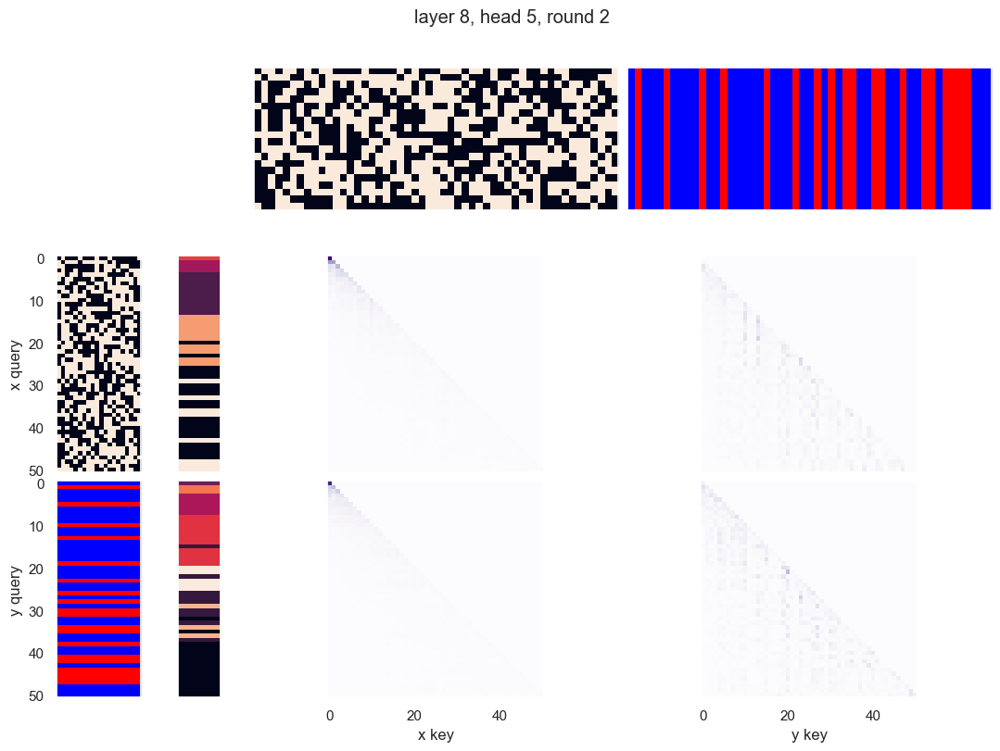

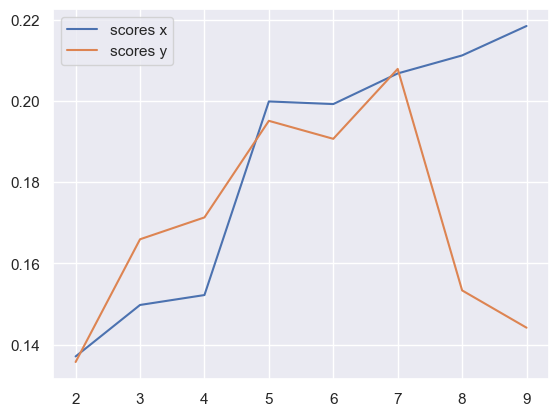

x query cluster:
SVM coefs for class 0: [ 0.00913266 -0.23796039  0.04707415  0.6580806   0.66955658  0.09404719
 -0.08608425  0.10251828 -0.84579479 -0.0327214   0.19451204 -0.17386923
 -0.14158156 -0.25237716 -0.23851679 -0.16012692 -0.30734397 -0.76010767
 -0.07405131  0.09537047]\class elements: [35 40 41 43 44]
(1) -17: 1.00; (2) -0: 0.80; (3) +10: 0.80; (4) -9: 0.80; (5) -8: 0.80; (6) -7: 0.80; (7) -15: 0.80; (8) +5: 0.80; (9) -1: 0.80; (10) -16: 0.80
(1) -1 AND -16: 0.80; (2) -0 AND -17: 0.80; (3) -7 AND -17: 0.80; (4) +5 AND -9: 0.80; (5) -1 AND -17: 0.80; (6) -16 AND -17: 0.80; (7) -8 AND -9: 0.80; (8) +5 AND -8: 0.80; (9) -8 AND -17: 0.80; (10) -9 AND -17: 0.80
(1) -0 OR -1: 1.00; (2) -9 OR +10: 1.00; (3) -8 OR +19: 1.00; (4) -8 OR +18: 1.00; (5) +8 OR -17: 1.00; (6) -8 OR -17: 1.00; (7) +2 OR -15: 1.00; (8) -8 OR -16: 1.00; (9) +2 OR -16: 1.00; (10) -8 OR -15: 1.00
{7.0: 0.10759280481142923, 11.0: 0.04158348296186887, 8.0: 0.25466882437467575, 13.0: 0.11557320130523294, 12.0

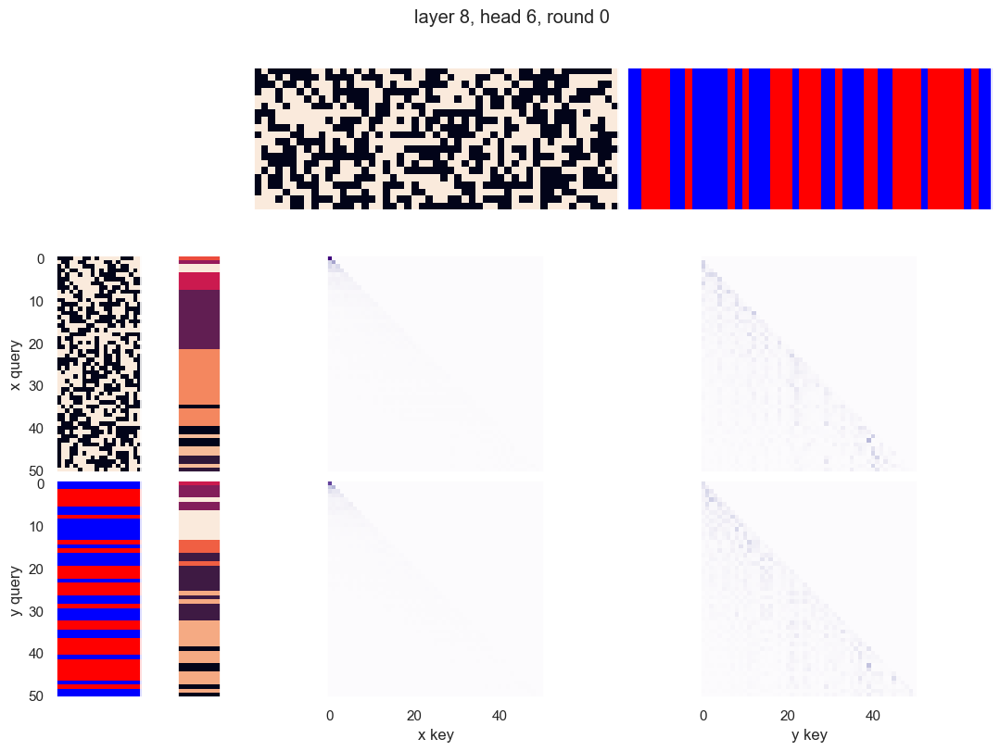

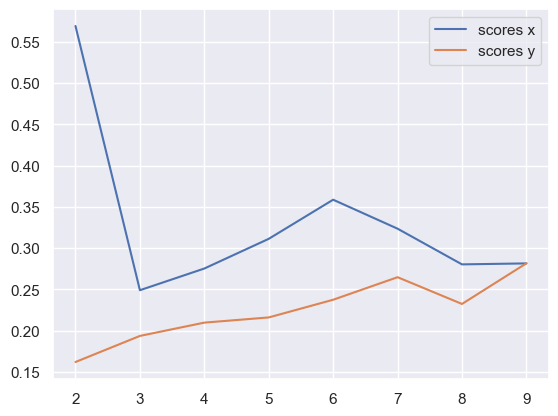

x query cluster:
SVM coefs: [ 0.26247781 -0.32280513  0.10229307  0.14784522 -0.20820203 -0.04183564
 -0.08340326 -0.00503835  0.46534627  0.28237152  0.02750327  0.26015575
  0.04958677  0.13378377  0.13217019 -0.16053301 -0.24772043 -0.5743174
  0.37580287  0.6895319 ]
class1: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) -12: 0.60; (4) +19: 0.58; (5) -16: 0.58; (6) +13: 0.58; (7) -2: 0.56; (8) -3: 0.56; (9) -4: 0.56; (10) +11: 0.56
(1) +0 AND -16: 0.42; (2) -3 AND +19: 0.42; (3) +0 AND -12: 0.42; (4) +0 AND +9: 0.42; (5) -2 AND -12: 0.42; (6) -12 AND -15: 0.42; (7) +0 AND -15: 0.40; (8) +9 AND +13: 0.40; (9) +5 AND -16: 0.40; (10) +13 AND +14: 0.40
(1) -12 OR +13: 0.92; (2) +0 OR +14: 0.92; (3) +0 OR +11: 0.90; (4) +0 OR +17: 0.90; (5) +14 OR -15: 0.90; (6) +14 OR -16: 0.90; (7) +13 OR +19: 0.88; (8) +14 OR +19: 0.88; (9) +7 OR -12: 0.88; (10) +14 OR 

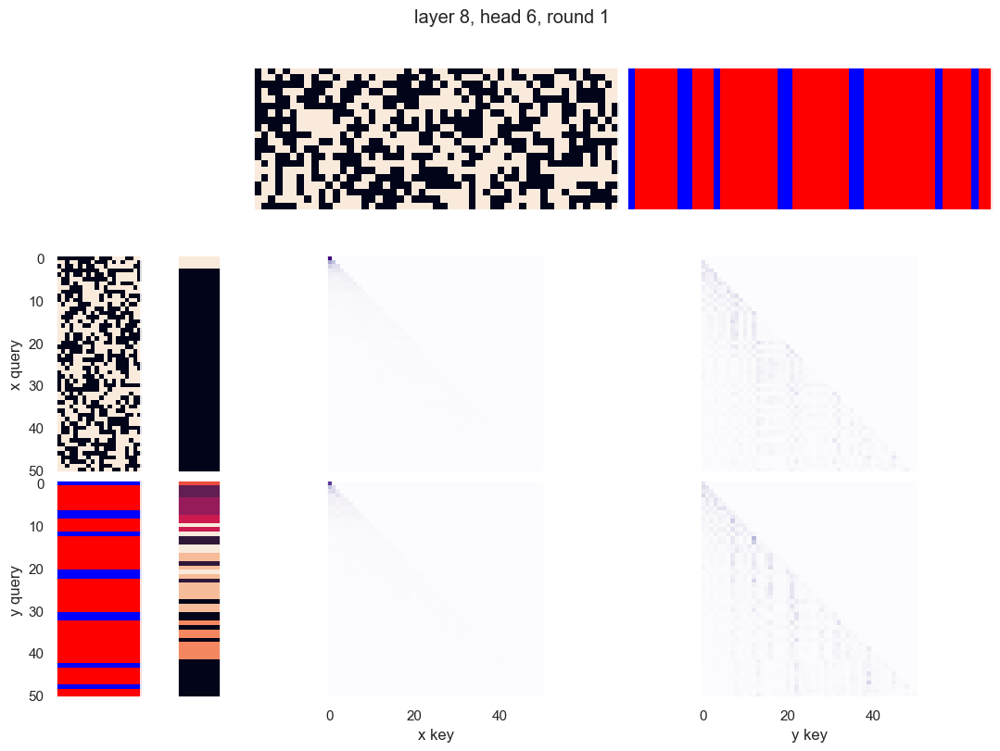

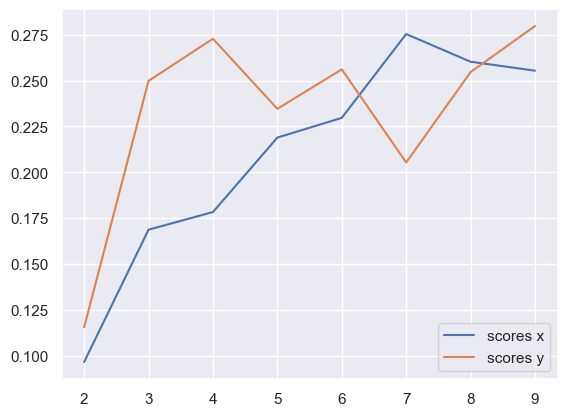

x query cluster:
SVM coefs for class 0: [ 0.3715481   0.15837766 -0.38935922 -0.04404372 -0.11908786 -0.18824038
 -0.36954118  0.41226014 -0.57666552  0.08889518 -0.22077952 -0.15969205
  0.03890573  0.14728977  0.23051536 -0.00981037 -0.30859851  0.0871416
 -0.23408809  0.10201834]\class elements: [28 30 31 32 36 39 41 42 44 45 46 47 48 50]
(1) +17: 1.00; (2) -19: 0.79; (3) -1: 0.79; (4) +16: 0.79; (5) -0: 0.64; (6) +7: 0.64; (7) -5: 0.64; (8) +12: 0.64; (9) -18: 0.64; (10) -14: 0.57
(1) +16 AND +17: 0.79; (2) +17 AND -19: 0.79; (3) -1 AND +17: 0.79; (4) -0 AND +17: 0.64; (5) -5 AND +17: 0.64; (6) +7 AND +17: 0.64; (7) +17 AND -18: 0.64; (8) -1 AND +16: 0.64; (9) +12 AND +17: 0.64; (10) +16 AND -18: 0.57
(1) -1 OR +8: 1.00; (2) -5 OR +17: 1.00; (3) +5 OR +17: 1.00; (4) +2 OR +17: 1.00; (5) +6 OR +7: 1.00; (6) +6 OR +16: 1.00; (7) -6 OR +17: 1.00; (8) +15 OR +16: 1.00; (9) +6 OR +17: 1.00; (10) -15 OR +17: 1.00
{0.0: 0.8892864724288557}
SVM coefs for class 1: [ 0.16490455  0.20734133  

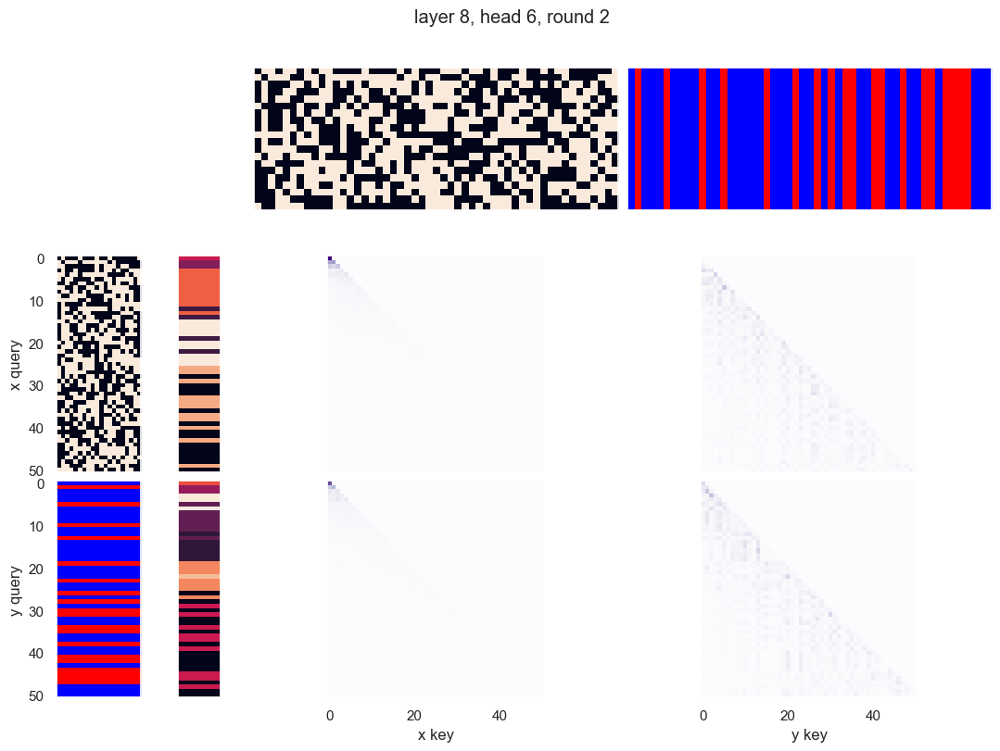

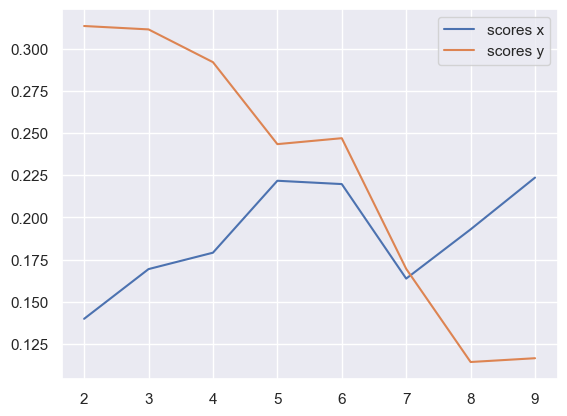

x query cluster:
SVM coefs for class 0: [-0.04985834  0.31882542 -0.40900042  0.43507383 -0.57886872  0.23170668
  0.31469182 -0.05810515 -0.53505286 -0.70917428 -0.38205257  0.01116891
  0.29449431 -0.13231971 -0.53241346 -0.3782359  -0.23314533 -0.6325058
 -0.4285025  -0.09736633]\class elements: [28 33 35 40 41 42 44 48 49 50]
(1) -9: 1.00; (2) -16: 0.90; (3) +13: 0.80; (4) +5: 0.80; (5) -15: 0.80; (6) -8: 0.70; (7) -14: 0.60; (8) -7: 0.60; (9) +6: 0.60; (10) -0: 0.60
(1) -9 AND -16: 0.90; (2) -9 AND +13: 0.80; (3) -9 AND -15: 0.80; (4) +5 AND -9: 0.80; (5) +13 AND -16: 0.80; (6) -8 AND -9: 0.70; (7) +5 AND -16: 0.70; (8) -15 AND -16: 0.70; (9) +5 AND -8: 0.70; (10) +1 AND -9: 0.60
(1) -9 OR +18: 1.00; (2) -9 OR +14: 1.00; (3) -9 OR -15: 1.00; (4) -9 OR +15: 1.00; (5) +1 OR -16: 1.00; (6) -9 OR -16: 1.00; (7) -9 OR +16: 1.00; (8) -9 OR -17: 1.00; (9) +1 OR -14: 1.00; (10) -9 OR +17: 1.00
{7.0: 0.10027291570586384, 11.0: 0.07465093366081416, 8.0: 0.1514410500741178, 13.0: 0.160993093

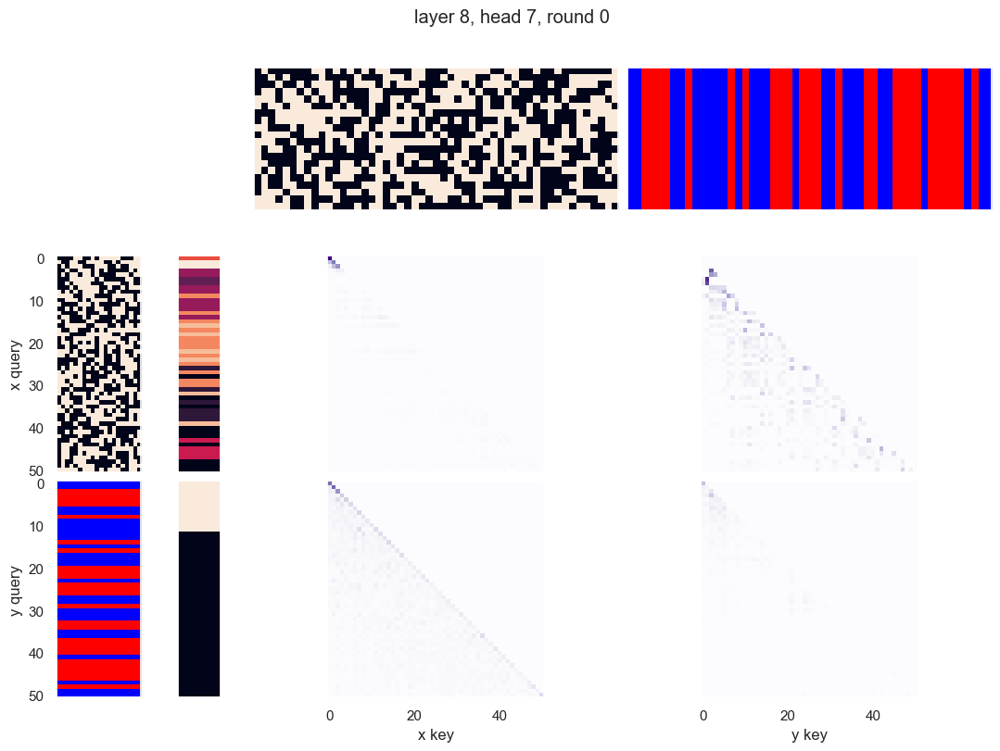

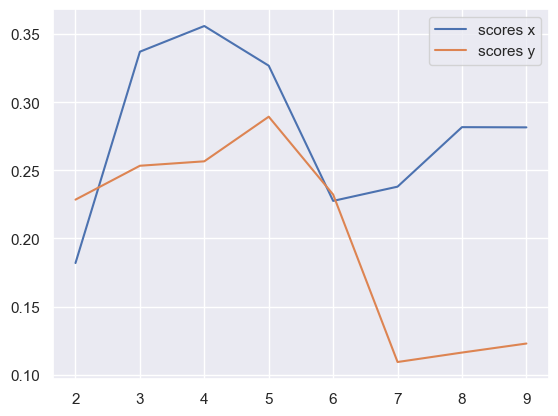

x query cluster:
SVM coefs for class 0: [-0.14520584  0.38587772 -0.26620114 -0.07798651 -0.1164354  -0.28326382
 -0.3557385  -0.15774297 -0.56066364 -0.05245011  0.25953573 -0.21918455
  0.16868545  0.40078088  0.04620349  0.36757844  0.12624563  0.3101056
 -0.423191   -0.30496279]\class elements: [12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35
 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) -16: 0.64; (3) +19: 0.62; (4) +14: 0.62; (5) +13: 0.62; (6) +5: 0.62; (7) -12: 0.59; (8) -3: 0.59; (9) -8: 0.56; (10) +9: 0.56
(1) +0 AND +9: 0.46; (2) +5 AND -16: 0.46; (3) -3 AND +19: 0.46; (4) +0 AND -16: 0.46; (5) +5 AND -15: 0.41; (6) +9 AND +13: 0.41; (7) +11 AND +19: 0.41; (8) -3 AND +5: 0.41; (9) +0 AND -12: 0.41; (10) +13 AND -16: 0.41
(1) -12 OR +13: 0.92; (2) -16 OR +19: 0.92; (3) +13 OR +19: 0.92; (4) -8 OR -16: 0.90; (5) -18 OR +19: 0.90; (6) +0 OR +17: 0.90; (7) +0 OR +14: 0.90; (8) +6 OR -16: 0.90; (9) +0 OR -8: 0.90; (10) +0 OR +19: 0.90
{0

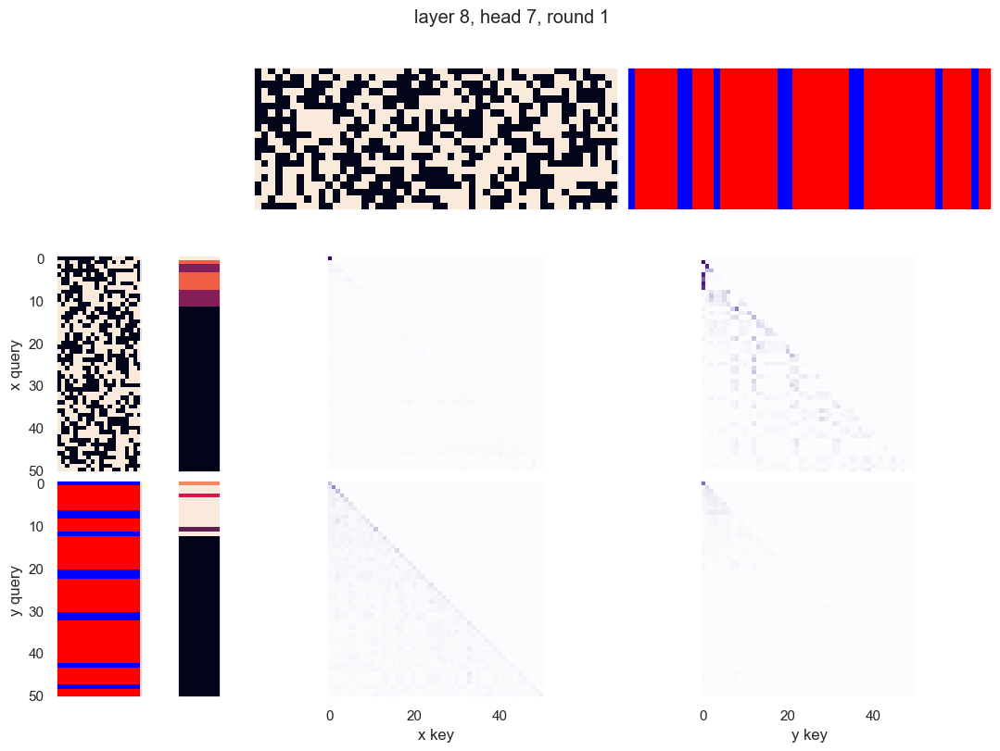

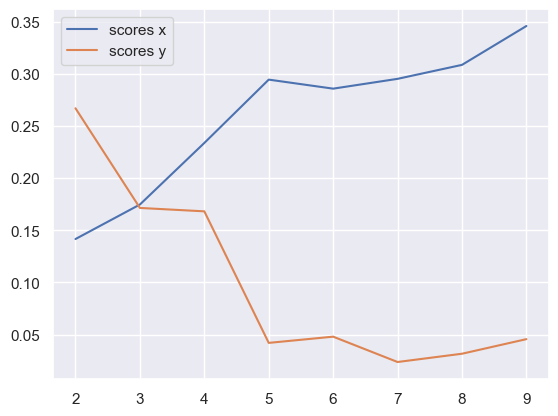

x query cluster:
SVM coefs for class 0: [-0.33682003  0.02377217 -0.30357578  0.45258438 -0.21261483 -0.04167216
 -0.10453156  0.10150974 -0.42369226  0.05402038 -0.17086094 -0.11248176
  0.22122221  0.34837161 -0.19362248  0.08980317 -0.17911254  0.0460593
 -0.17340444  0.11814585]\class elements: [22 26 27 28 32 40 41 42 44 45 46 49 50]
(1) -9: 1.00; (2) -19: 0.85; (3) -1: 0.77; (4) +13: 0.77; (5) -15: 0.77; (6) +6: 0.69; (7) +14: 0.69; (8) -5: 0.69; (9) +2: 0.69; (10) +16: 0.69
(1) -9 AND -19: 0.85; (2) -1 AND -9: 0.77; (3) -9 AND -15: 0.77; (4) -9 AND +13: 0.77; (5) -15 AND +16: 0.69; (6) -15 AND -19: 0.69; (7) +2 AND -9: 0.69; (8) -5 AND -9: 0.69; (9) -9 AND +14: 0.69; (10) +6 AND -9: 0.69
(1) -12 OR +13: 1.00; (2) -1 OR -15: 1.00; (3) -7 OR -9: 1.00; (4) +3 OR +13: 1.00; (5) +7 OR -9: 1.00; (6) +1 OR -9: 1.00; (7) -1 OR -9: 1.00; (8) -8 OR -9: 1.00; (9) +8 OR -9: 1.00; (10) -17 OR -19: 1.00
{0.0: 0.9442565546542727}
SVM coefs for class 1: [ 0.22777532  0.18821372  0.12783618 -0.1

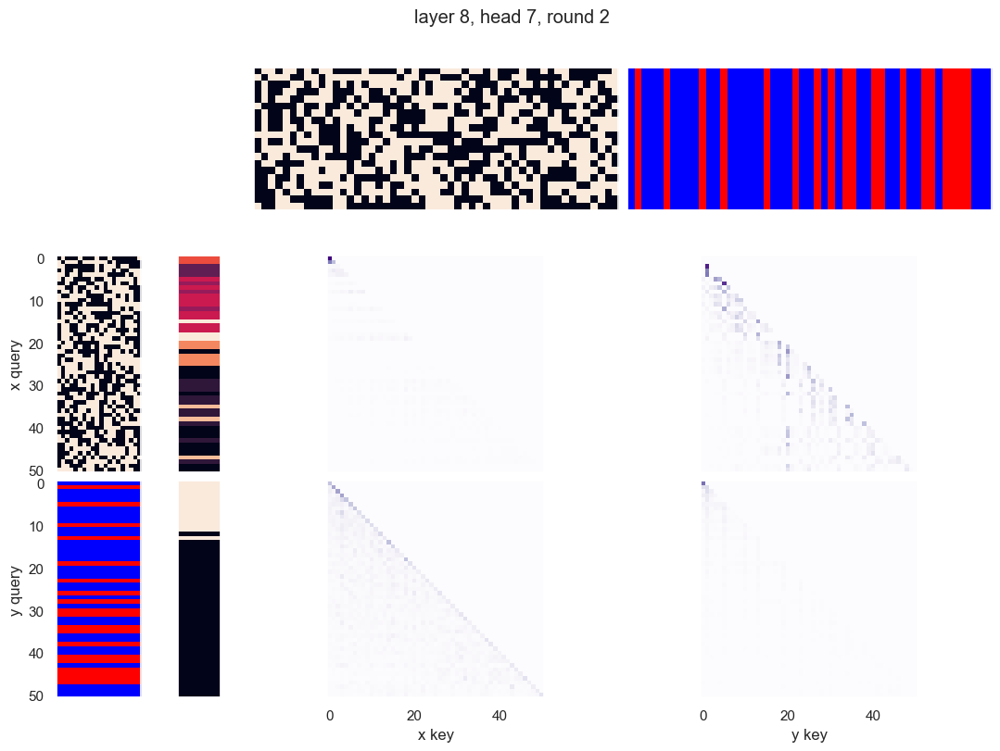

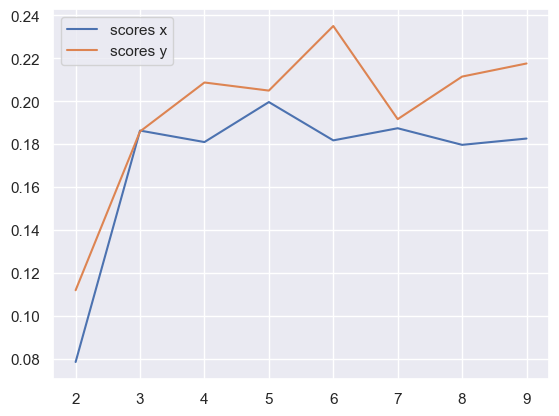

x query cluster:
SVM coefs for class 0: [-1.51147956  0.42765323  0.17563077 -0.29539666 -0.62360911  0.11574207
 -0.67576654 -0.58364032  0.45783884  0.4583312  -0.60150896 -0.21482728
  0.28728363  0.33561946 -0.02982377  0.0590481   0.39772114  0.33255939
  0.31395862 -0.38705994]\class elements: [21 24 25 26 33 34 37 38 40 41 43 44 45 46 47 48 49]
(1) -0: 1.00; (2) +17: 0.76; (3) +5: 0.76; (4) -11: 0.71; (5) -4: 0.71; (6) -3: 0.65; (7) -14: 0.65; (8) +13: 0.65; (9) -12: 0.65; (10) -16: 0.65
(1) -0 AND +17: 0.76; (2) -0 AND +5: 0.76; (3) -0 AND -11: 0.71; (4) -0 AND -4: 0.71; (5) -0 AND +13: 0.65; (6) -0 AND -18: 0.65; (7) -0 AND -16: 0.65; (8) -0 AND -15: 0.65; (9) -0 AND -14: 0.65; (10) -0 AND -3: 0.65
(1) -0 OR -1: 1.00; (2) -0 OR +9: 1.00; (3) -0 OR -10: 1.00; (4) -0 OR +10: 1.00; (5) +5 OR -16: 1.00; (6) -0 OR +11: 1.00; (7) -0 OR -12: 1.00; (8) -0 OR +12: 1.00; (9) -0 OR -13: 1.00; (10) -0 OR +13: 1.00
{7.0: 0.1764530112131444, 11.0: 0.03908485851784729, 8.0: 0.091987804434371

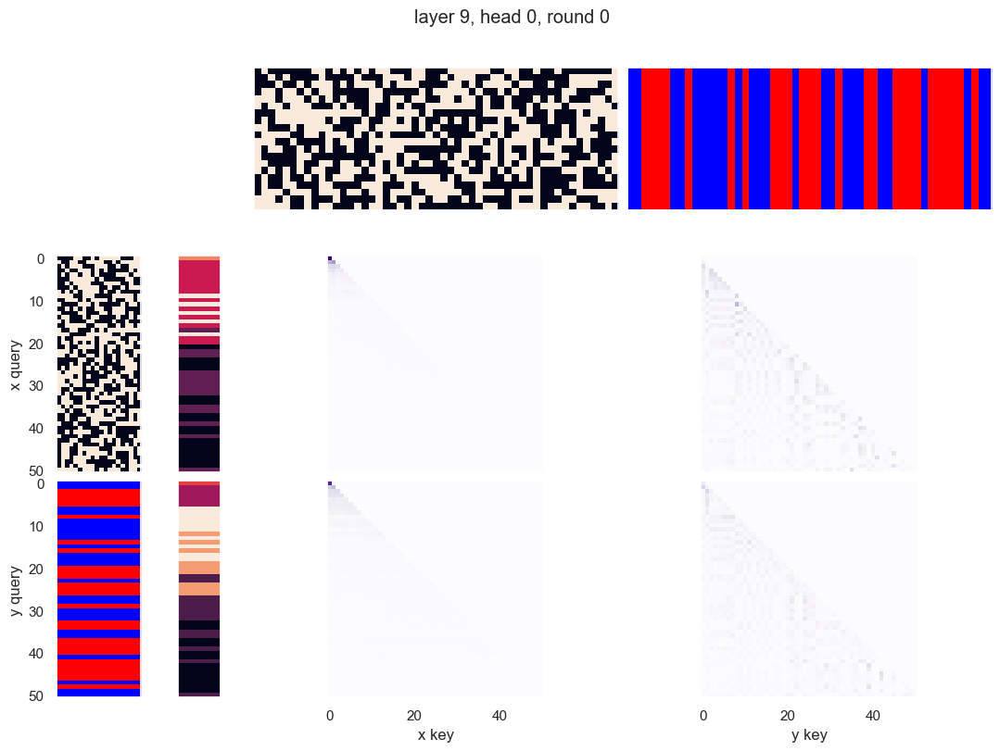

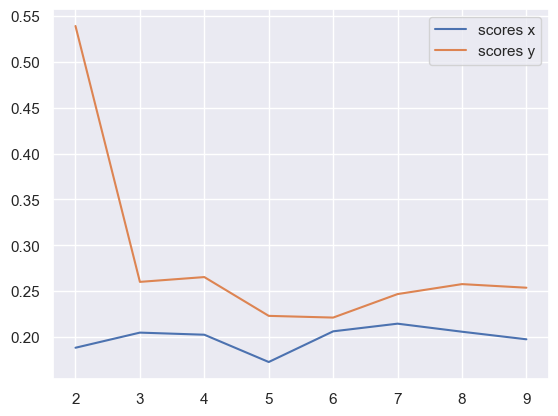

x query cluster:
SVM coefs for class 0: [-0.08187049  0.36416217  0.1679751   0.25034308 -0.02518189 -0.12471005
  0.38432431 -0.18104947  0.25708509  0.1817794   0.46659314 -0.31388729
 -0.27228103  0.23279387 -0.12517477  0.07443177  0.33538656 -0.13569381
 -0.00558364 -0.28546082]\class elements: [ 9 10 21 23 24 31 43 44]
(1) -0: 1.00; (2) +11: 0.88; (3) +14: 0.75; (4) -2: 0.75; (5) -3: 0.75; (6) -12: 0.75; (7) -5: 0.75; (8) +16: 0.62; (9) +15: 0.62; (10) +13: 0.62
(1) -0 AND +11: 0.88; (2) -0 AND -12: 0.75; (3) -5 AND +14: 0.75; (4) -0 AND -2: 0.75; (5) -2 AND +11: 0.75; (6) -0 AND -3: 0.75; (7) -0 AND +14: 0.75; (8) -3 AND +11: 0.75; (9) -0 AND -5: 0.75; (10) -0 AND -9: 0.62
(1) -0 OR -1: 1.00; (2) +4 OR +18: 1.00; (3) -10 OR +14: 1.00; (4) -10 OR +15: 1.00; (5) -4 OR -18: 1.00; (6) -10 OR +18: 1.00; (7) -2 OR +15: 1.00; (8) -10 OR +19: 1.00; (9) +11 OR -12: 1.00; (10) +4 OR +15: 1.00
{0.0: 0.6963777976889105}
SVM coefs for class 1: [-0.30553714 -0.28466288  0.31821546 -0.2970816 

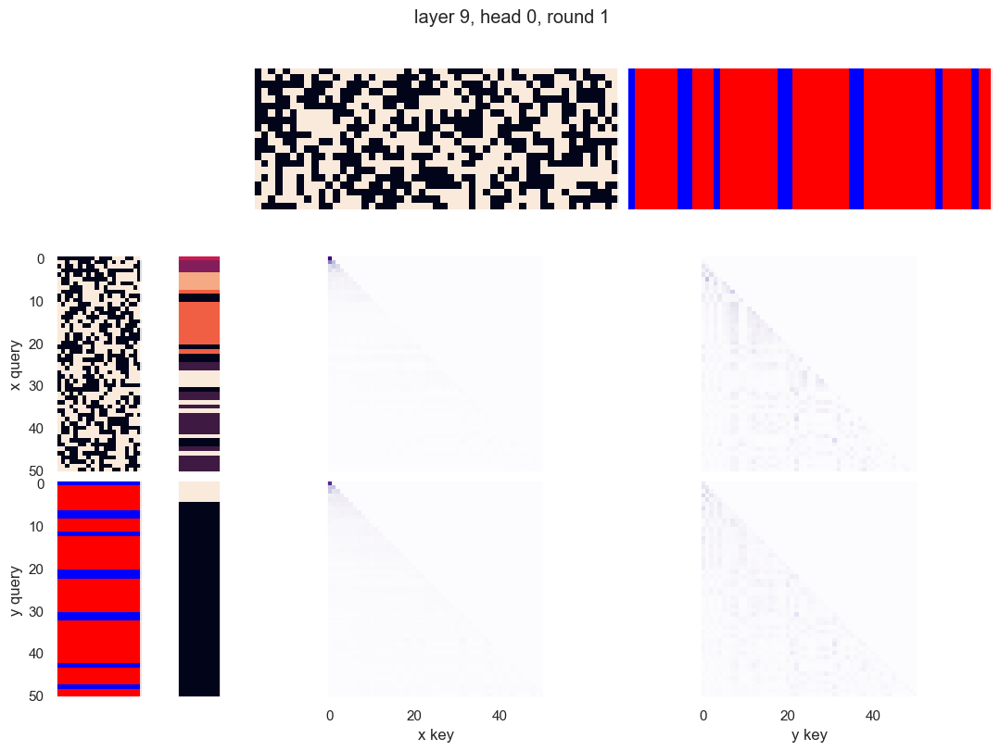

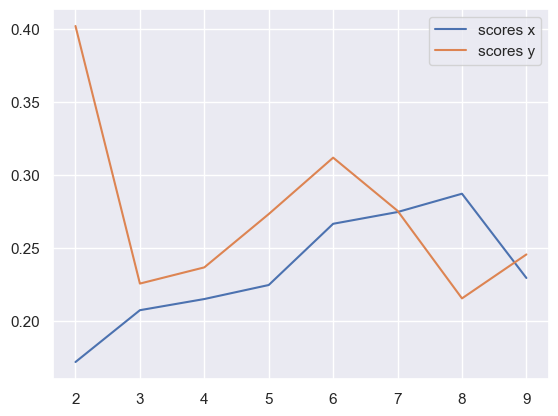

x query cluster:
SVM coefs for class 0: [-0.13168665 -0.1569669  -0.22286693  0.1484535  -0.31955119  0.14526893
 -0.00309976 -0.31373305 -0.22737648  0.15514976 -0.27285545 -0.24824328
  0.13170639 -0.02760309  0.07453496  0.18885697 -0.17850337  0.00812757
 -0.38168958 -0.03251679]\class elements: [24 25 29 32 34 35 36 38 39 41 44 45 46 47 48 49]
(1) -0: 1.00; (2) +7: 0.69; (3) +16: 0.69; (4) +8: 0.69; (5) +17: 0.69; (6) -1: 0.62; (7) +13: 0.62; (8) +6: 0.62; (9) +12: 0.62; (10) +15: 0.56
(1) -0 AND +8: 0.69; (2) -0 AND +7: 0.69; (3) -0 AND +17: 0.69; (4) -0 AND +16: 0.69; (5) -0 AND -1: 0.62; (6) -0 AND +6: 0.62; (7) -0 AND +12: 0.62; (8) -0 AND +13: 0.62; (9) -0 AND +15: 0.56; (10) -0 AND +14: 0.56
(1) -0 OR -1: 1.00; (2) -0 OR -9: 1.00; (3) -0 OR +9: 1.00; (4) -0 OR +19: 1.00; (5) -0 OR -10: 1.00; (6) -0 OR +10: 1.00; (7) +7 OR +17: 1.00; (8) -0 OR -11: 1.00; (9) -0 OR +11: 1.00; (10) -0 OR -12: 1.00
{0.0: 0.9158225270293769}
SVM coefs for class 1: [ 0.23855952 -0.05651907  0.3452

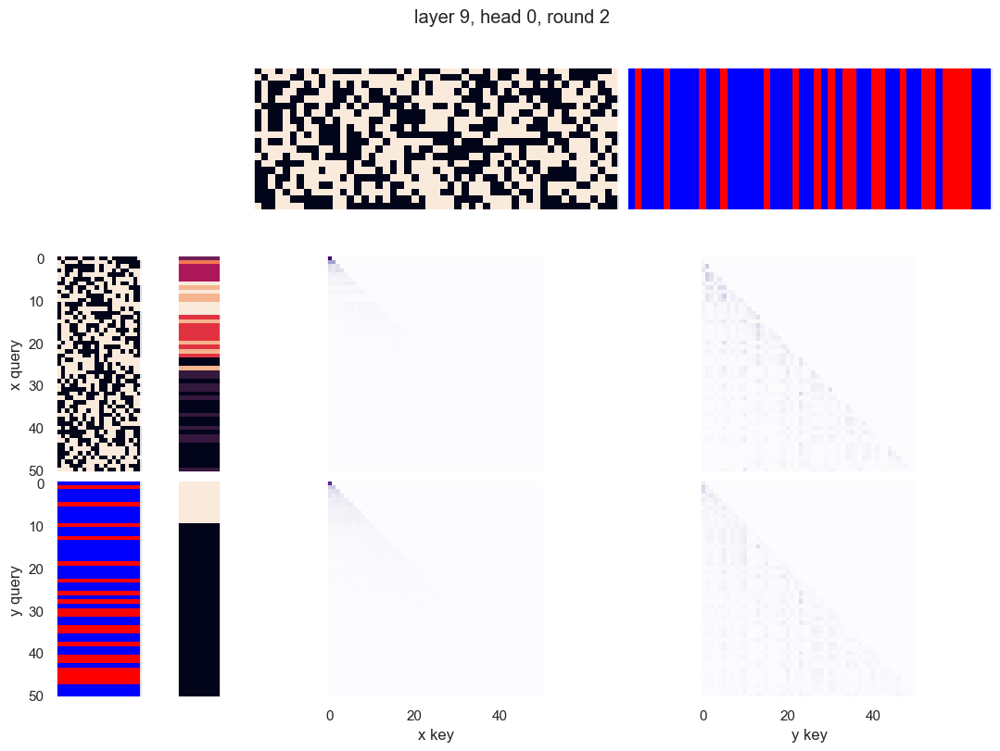

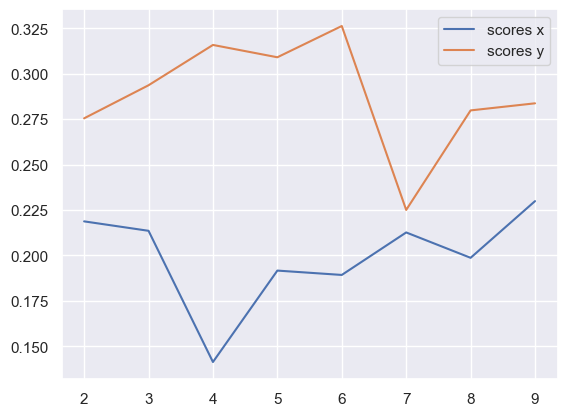

x query cluster:
SVM coefs for class 0: [-0.08680819  0.27671279 -0.63038442  0.62595805 -0.77405998 -0.01790007
  0.15288716  0.53005204 -0.05197577  0.03652231  0.22790385  0.19698949
 -0.24258146 -0.14578935  0.21865419  0.13004208 -0.17986477 -0.02980854
 -0.10119708  0.25722414]\class elements: [34 36 44 49]
(1) -4: 1.00; (2) +1: 1.00; (3) -11: 1.00; (4) +3: 1.00; (5) +7: 0.75; (6) +6: 0.75; (7) -12: 0.75; (8) -13: 0.75; (9) -0: 0.75; (10) +14: 0.75
(1) +1 AND +3: 1.00; (2) +3 AND -11: 1.00; (3) +1 AND -4: 1.00; (4) +1 AND -11: 1.00; (5) +3 AND -4: 1.00; (6) -4 AND -11: 1.00; (7) -11 AND -13: 0.75; (8) +6 AND +17: 0.75; (9) -11 AND +14: 0.75; (10) -11 AND -15: 0.75
(1) -10 OR -11: 1.00; (2) -9 OR -13: 1.00; (3) +3 OR +13: 1.00; (4) +3 OR -13: 1.00; (5) +3 OR +12: 1.00; (6) +3 OR -12: 1.00; (7) -9 OR +14: 1.00; (8) +3 OR +11: 1.00; (9) +9 OR -12: 1.00; (10) +3 OR -11: 1.00
{7.0: 0.17734268969252298, 11.0: 0.060760680215025786, 8.0: 0.10403368441257044, 13.0: 0.2602821081536604, 12.

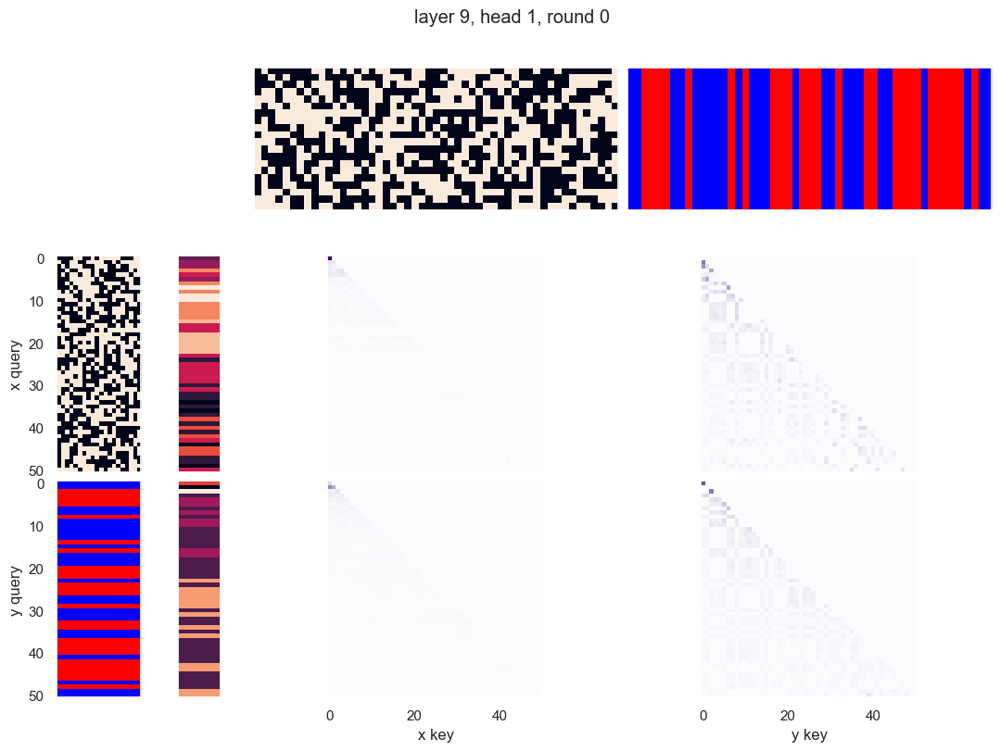

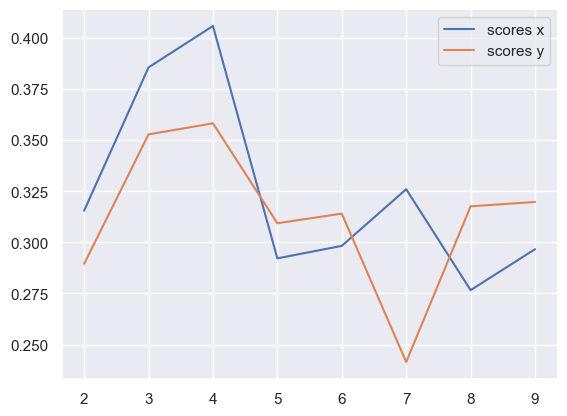

x query cluster:
SVM coefs for class 0: [-0.18857926  0.01891572 -0.2241549   0.25814011 -0.72928951 -0.10806068
 -0.18889438  0.14862352 -0.162113   -0.14869984 -0.08273076  0.46174871
 -0.02900021  0.1794335   0.03968713 -0.07684434  0.30892358  0.22295166
  0.24972179 -0.03822976]\class elements: [10 11 15 18 19 26 27 29 34 36 37 38 40 41 42 44 49 50]
(1) +3: 1.00; (2) +9: 0.67; (3) +13: 0.67; (4) +0: 0.61; (5) +14: 0.61; (6) +1: 0.61; (7) -16: 0.61; (8) -19: 0.61; (9) +6: 0.61; (10) +17: 0.61
(1) +3 AND +13: 0.67; (2) +3 AND +9: 0.67; (3) +3 AND -16: 0.61; (4) +3 AND +17: 0.61; (5) +3 AND -19: 0.61; (6) +3 AND +14: 0.61; (7) +1 AND +3: 0.61; (8) +3 AND +6: 0.61; (9) +0 AND +3: 0.61; (10) +3 AND +10: 0.56
(1) +3 OR -10: 1.00; (2) +3 OR -19: 1.00; (3) +3 OR +5: 1.00; (4) +3 OR -6: 1.00; (5) +3 OR -18: 1.00; (6) +3 OR +6: 1.00; (7) +3 OR +17: 1.00; (8) +3 OR -17: 1.00; (9) +3 OR -7: 1.00; (10) +3 OR +7: 1.00
{0.0: 0.8533556149842149}
SVM coefs for class 1: [ 0.27656424  0.1335973   0.

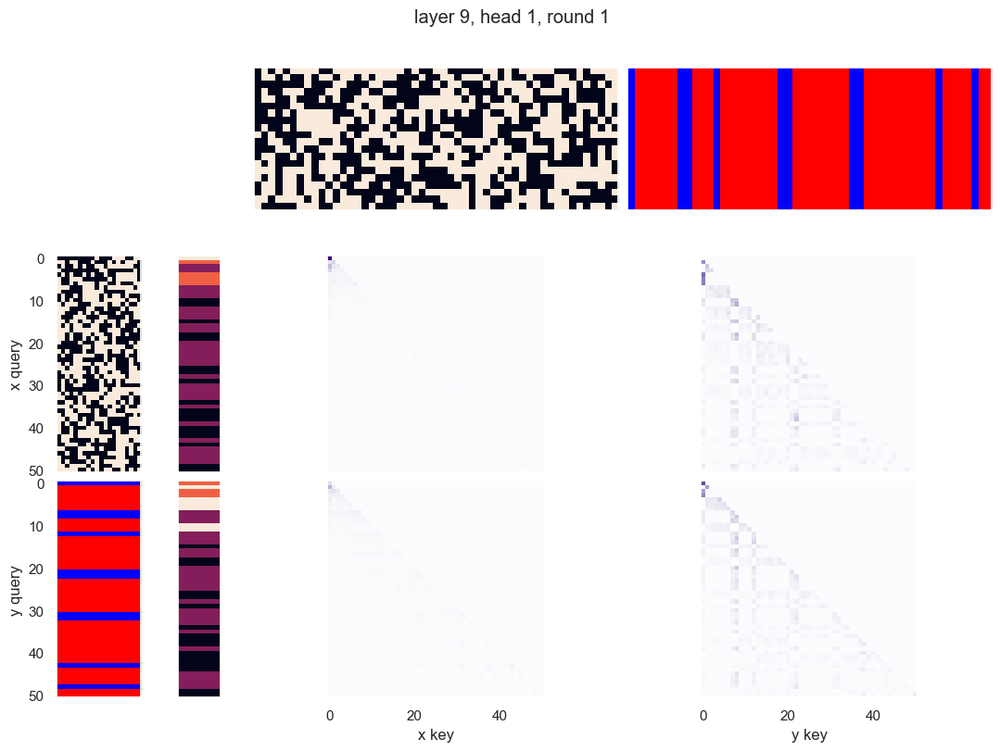

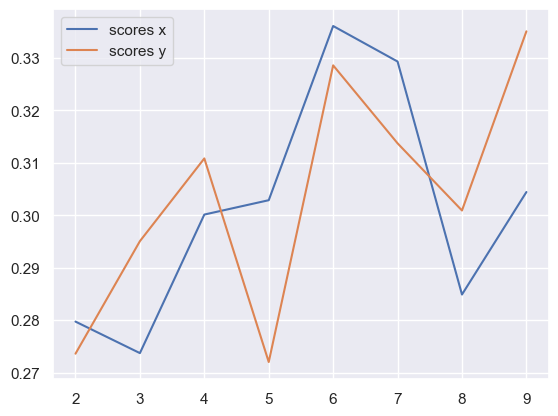

x query cluster:
SVM coefs for class 0: [-0.42035991  0.33269282  0.20290336  0.20138668 -0.00631119 -0.37247921
 -0.01713631 -0.15712357  0.06957937  0.02500734  0.04214155  0.16671935
  0.12099936  0.06033753 -0.00955083  0.35739777 -0.04250788  0.1752372
  0.15153646 -0.45272258]\class elements: [18 20 21 23 25 26 27 29 32 34 36 43 44 46 47 50]
(1) +3: 1.00; (2) +8: 0.75; (3) -0: 0.69; (4) +2: 0.69; (5) +17: 0.69; (6) +14: 0.69; (7) -10: 0.62; (8) -19: 0.62; (9) -9: 0.62; (10) +16: 0.62
(1) +3 AND +8: 0.75; (2) +3 AND +14: 0.69; (3) +3 AND +17: 0.69; (4) -0 AND +3: 0.69; (5) +2 AND +3: 0.69; (6) +3 AND +16: 0.62; (7) +3 AND -9: 0.62; (8) +3 AND -10: 0.62; (9) +3 AND -19: 0.62; (10) -0 AND +8: 0.56
(1) +2 OR +3: 1.00; (2) -10 OR +17: 1.00; (3) +3 OR +12: 1.00; (4) +3 OR -13: 1.00; (5) +3 OR +13: 1.00; (6) -9 OR -10: 1.00; (7) +3 OR -14: 1.00; (8) -1 OR +8: 1.00; (9) +3 OR +14: 1.00; (10) +3 OR -15: 1.00
{0.0: 0.9462155472820086}
SVM coefs for class 1: [ 0.07142537  0.00769927 -0.1426

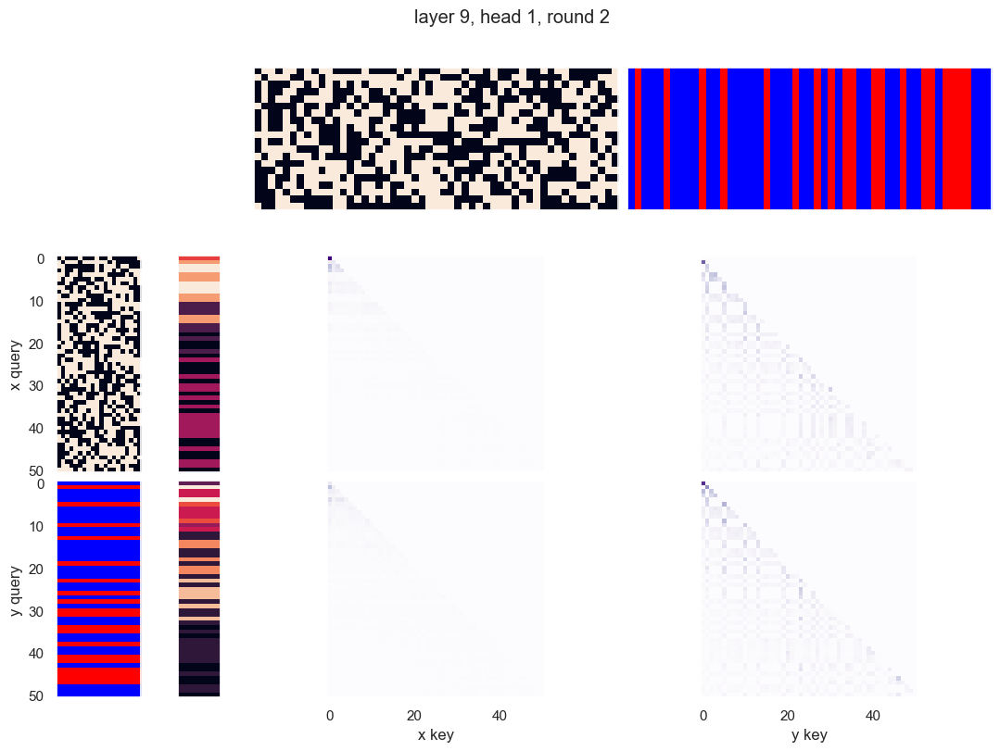

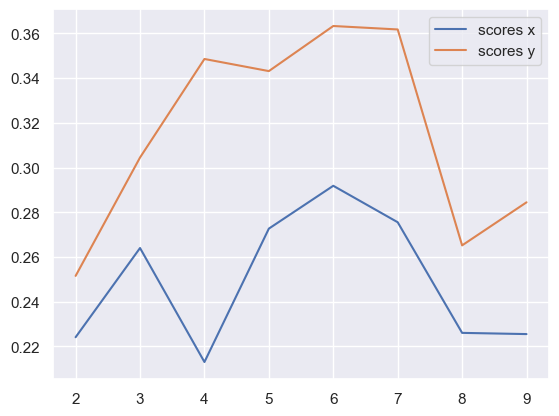

x query cluster:
SVM coefs for class 0: [-0.52874742 -0.15119896 -0.66694957  0.45079962 -1.7434364  -0.31424568
 -0.43702242 -0.25174623 -0.46879757  0.27463057  0.1566856  -0.3389876
  0.19793616  0.71052378 -0.1312369  -0.0616178  -0.06663496  0.00836363
 -0.69969102 -0.20722714]\class elements: [21 24 25 28 31 33 34 36 37 38 40 42 44 45 46 49]
(1) -4: 1.00; (2) +17: 0.88; (3) +10: 0.75; (4) -0: 0.75; (5) +13: 0.69; (6) +5: 0.69; (7) -11: 0.69; (8) -18: 0.69; (9) -14: 0.62; (10) -12: 0.62
(1) -4 AND +17: 0.88; (2) -4 AND +10: 0.75; (3) -0 AND -4: 0.75; (4) -4 AND +13: 0.69; (5) -4 AND -11: 0.69; (6) -4 AND +5: 0.69; (7) -4 AND -18: 0.69; (8) -4 AND -14: 0.62; (9) +13 AND -18: 0.62; (10) -4 AND -16: 0.62
(1) -4 OR +7: 1.00; (2) -11 OR -18: 1.00; (3) -12 OR +17: 1.00; (4) -3 OR -11: 1.00; (5) -0 OR +17: 1.00; (6) -4 OR +19: 1.00; (7) -4 OR -19: 1.00; (8) -1 OR -4: 1.00; (9) -4 OR +18: 1.00; (10) -4 OR -18: 1.00
{7.0: 0.11959073329808234, 11.0: 0.11048904947165286, 8.0: 0.1319207322251

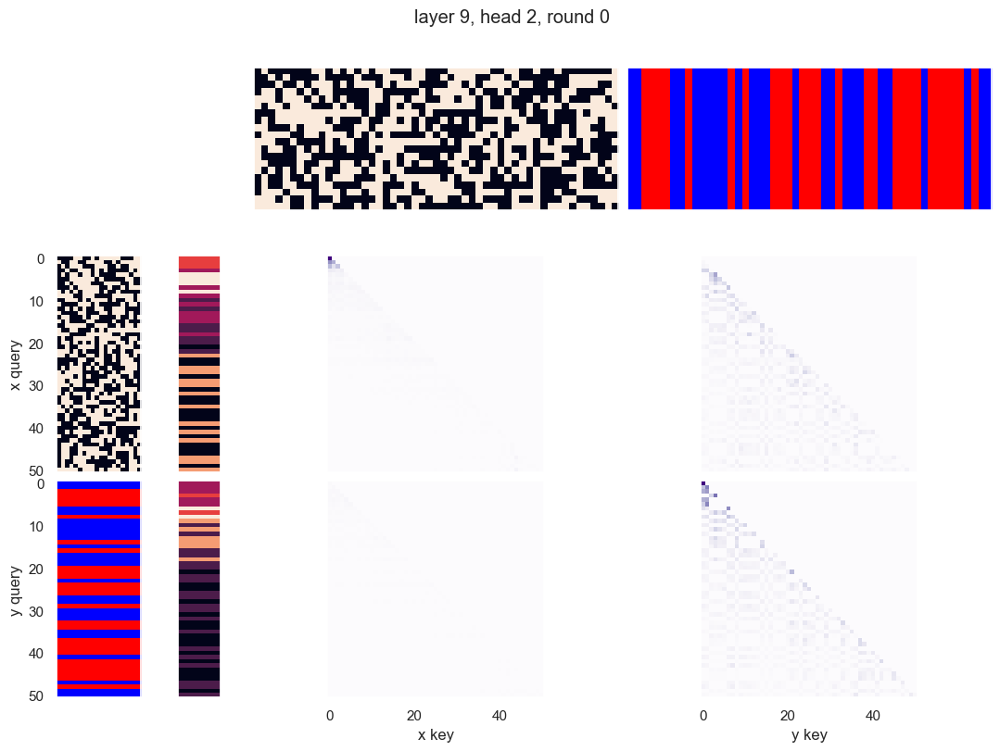

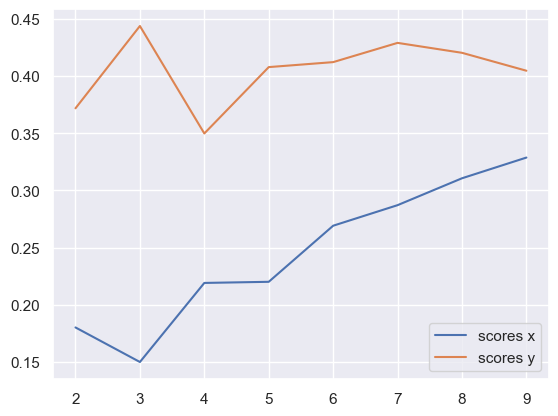

x query cluster:
SVM coefs for class 0: [-0.4941743  -0.22121513  0.74015465  0.52135983 -0.33550562  0.10636409
  0.02426813  0.05218652  0.69516813  0.02497884  0.12062065  0.44165313
  0.19528341 -0.06677123  0.20433609  0.55653664 -0.20924051  0.40034749
  0.8141107  -0.18093826]\class elements: [32 37 38 44 50]
(1) +4: 1.00; (2) -5: 1.00; (3) +9: 0.80; (4) +0: 0.80; (5) +2: 0.80; (6) +15: 0.80; (7) +3: 0.80; (8) -8: 0.80; (9) +18: 0.60; (10) +17: 0.60
(1) +4 AND -5: 1.00; (2) +0 AND -5: 0.80; (3) +3 AND -8: 0.80; (4) +2 AND +4: 0.80; (5) +2 AND -5: 0.80; (6) +0 AND +4: 0.80; (7) +4 AND +15: 0.80; (8) +3 AND -5: 0.80; (9) -5 AND +9: 0.80; (10) +3 AND +4: 0.80
(1) +9 OR -11: 1.00; (2) -8 OR +14: 1.00; (3) +2 OR +18: 1.00; (4) -8 OR +13: 1.00; (5) -8 OR +12: 1.00; (6) +2 OR +19: 1.00; (7) -3 OR +4: 1.00; (8) +3 OR +4: 1.00; (9) -3 OR -5: 1.00; (10) -8 OR -11: 1.00
{0.0: 0.9138702499229115}
SVM coefs for class 1: [-0.21380088 -0.07726292 -0.40401903 -0.72545076 -0.26439883 -1.15936262

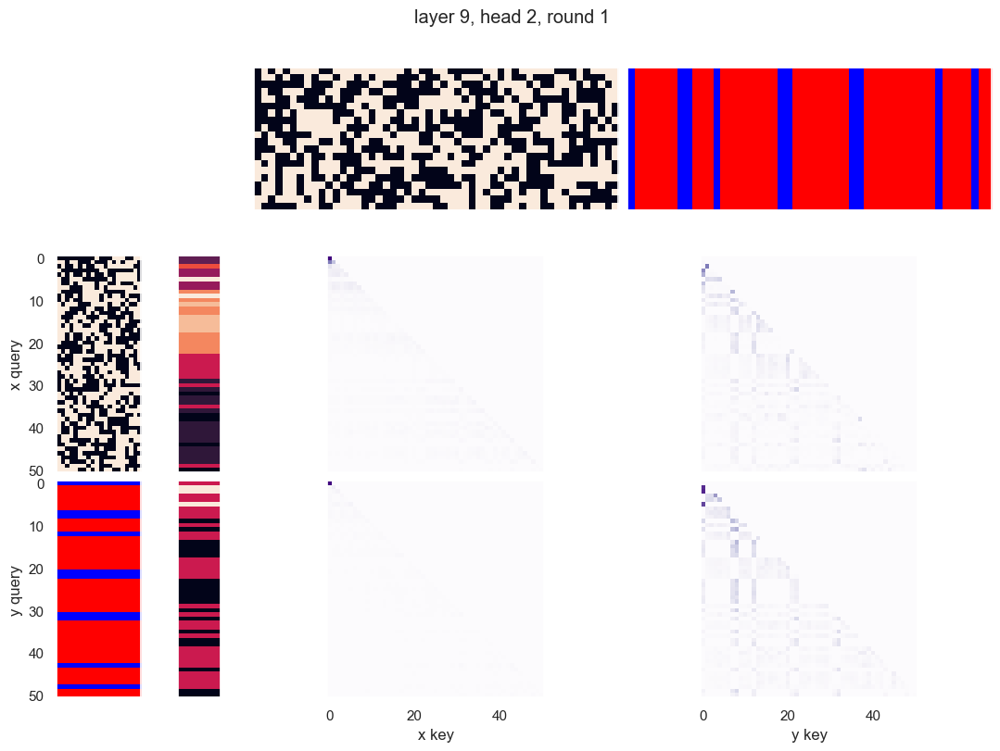

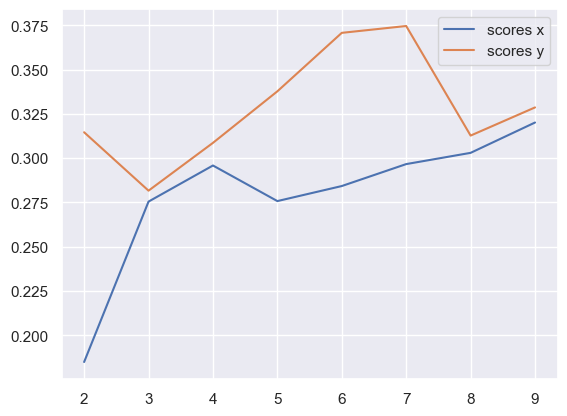

x query cluster:
SVM coefs for class 0: [-0.39634284 -0.07234845  0.39871275 -0.03964122  0.03104449  0.26153074
 -0.9802918  -0.33603662  1.0405459   0.28155471 -0.88386728  0.23566706
 -0.38119318 -0.10273635  0.28075793 -0.30994171  0.11254065  0.22822551
 -0.06262218 -0.18797007]\class elements: [32 33 37 39 43 44 45 46 48]
(1) +4: 1.00; (2) +18: 0.89; (3) -0: 0.67; (4) +17: 0.67; (5) +16: 0.67; (6) -2: 0.67; (7) -7: 0.67; (8) +6: 0.67; (9) +13: 0.67; (10) -19: 0.67
(1) +4 AND +18: 0.89; (2) +4 AND +16: 0.67; (3) -2 AND +4: 0.67; (4) -0 AND +4: 0.67; (5) -0 AND +17: 0.67; (6) +4 AND +10: 0.67; (7) +4 AND +6: 0.67; (8) +4 AND -7: 0.67; (9) +4 AND +13: 0.67; (10) +4 AND -19: 0.67
(1) +4 OR +18: 1.00; (2) +4 OR -9: 1.00; (3) +4 OR +8: 1.00; (4) +4 OR -8: 1.00; (5) +4 OR +7: 1.00; (6) +4 OR -7: 1.00; (7) +4 OR +6: 1.00; (8) +4 OR -6: 1.00; (9) +4 OR +5: 1.00; (10) +13 OR +18: 1.00
{0.0: 0.9083238653980111}
SVM coefs for class 1: [ 0.01639673  0.17031487 -0.16944844  0.20670157 -0.30615

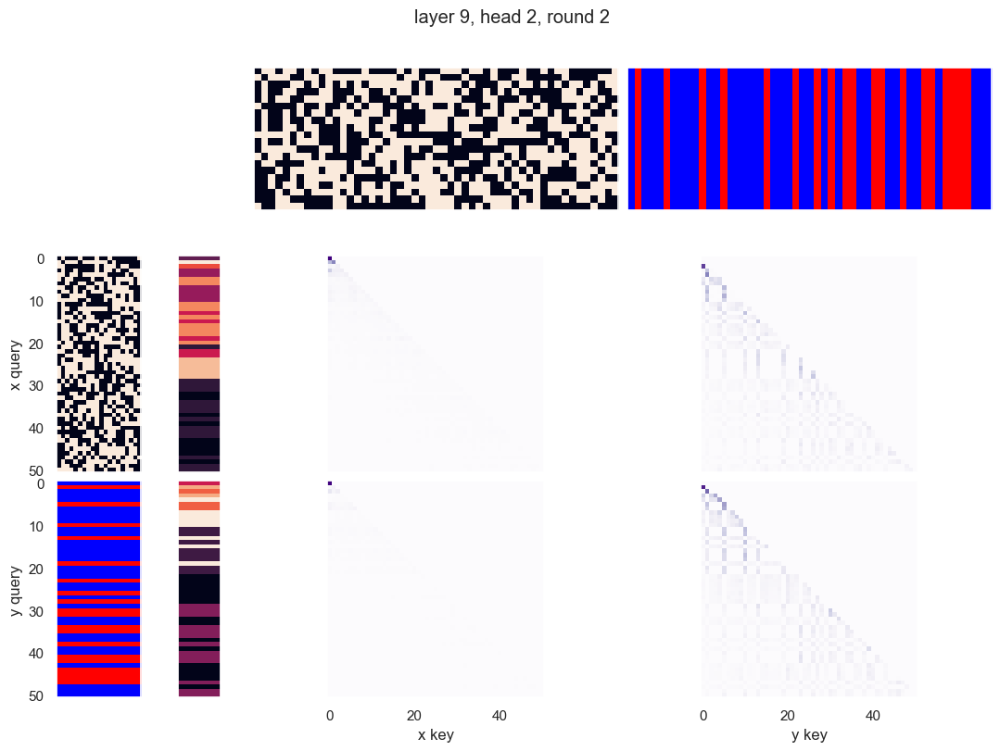

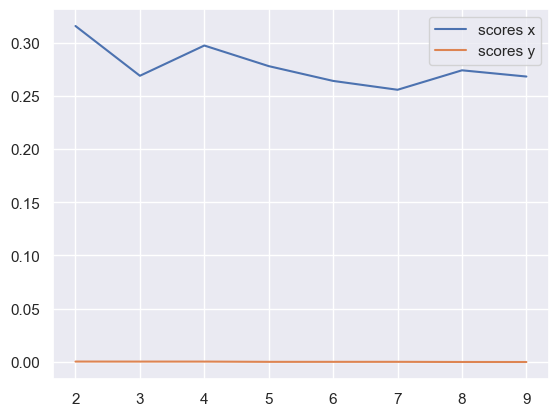

x query cluster:
SVM coefs: [ 0.28427254 -0.4047967   0.2856094  -0.20062021  0.02822646  0.27249371
  0.74537541  0.26694314  0.37080397  0.30621715  0.18325287 -0.00460938
 -0.52715385 -0.51385887 -0.04660037 -0.46538789 -0.38142796 -0.2998579
  0.38928414  0.30244098]
class1: [ 0 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37
 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +10: 0.70; (2) +17: 0.68; (3) -16: 0.65; (4) -11: 0.62; (5) +5: 0.62; (6) +13: 0.62; (7) -3: 0.59; (8) -9: 0.59; (9) -0: 0.57; (10) -18: 0.57
(1) +2 AND -18: 0.49; (2) +10 AND -16: 0.46; (3) -9 AND +10: 0.46; (4) -11 AND +17: 0.46; (5) +5 AND +13: 0.46; (6) -3 AND -18: 0.46; (7) -3 AND -16: 0.46; (8) +13 AND -18: 0.46; (9) -7 AND +10: 0.46; (10) -3 AND +13: 0.46
(1) -11 OR -16: 0.97; (2) +10 OR +17: 0.95; (3) -9 OR +17: 0.95; (4) -3 OR -11: 0.95; (5) +10 OR -11: 0.95; (6) -6 OR +17: 0.92; (7) -11 OR -18: 0.92; (8) +7 OR +10: 0.92; (9) -12 OR -16: 0.92; (10) -2 OR -18: 0.92
{7.0: 0.14798634907079

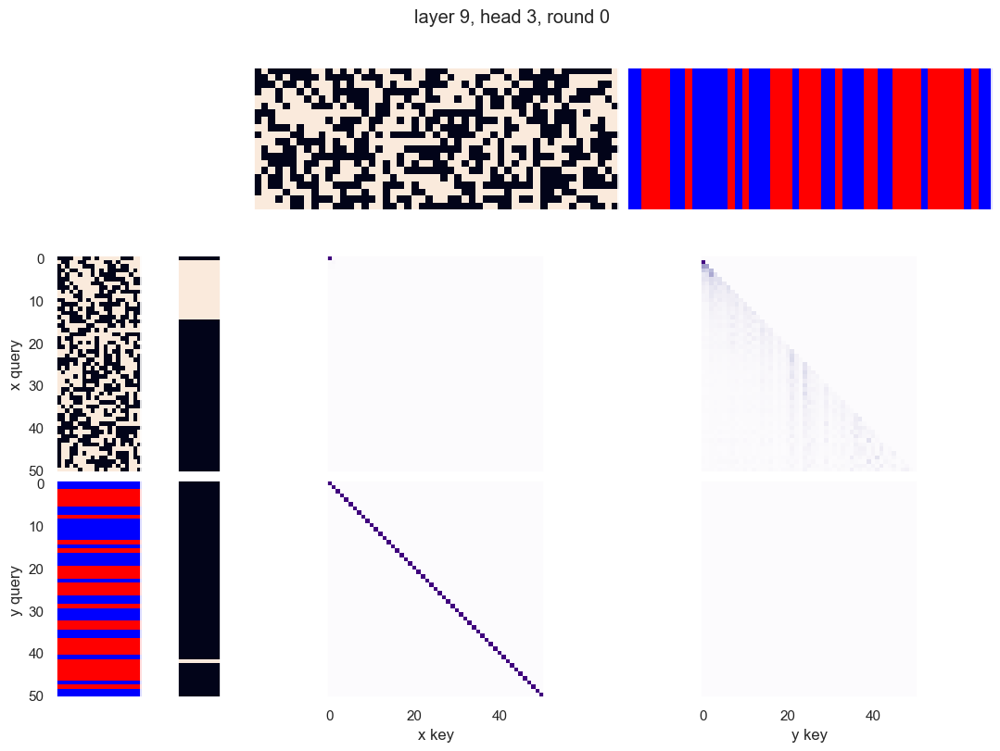

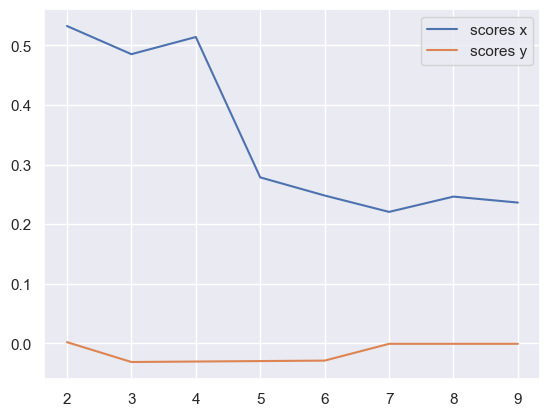

x query cluster:
SVM coefs: [-0.12267563 -0.24390431  0.71423022  0.23988456  0.26733782  0.34415825
  0.13319298  0.61014593  0.81258629  0.18137794 -0.20716765  0.51439034
  0.15692266 -0.69492522 -0.07989127 -0.10377184  0.19404699 -0.41687452
  0.6161837   0.62775369]
class1: [ 0  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +14: 0.64; (2) +13: 0.64; (3) +9: 0.61; (4) -16: 0.61; (5) -12: 0.61; (6) +19: 0.61; (7) +0: 0.61; (8) -3: 0.59; (9) -2: 0.55; (10) -4: 0.55
(1) +0 AND +9: 0.45; (2) +9 AND +13: 0.45; (3) -3 AND +19: 0.45; (4) -12 AND +19: 0.43; (5) +13 AND +14: 0.43; (6) +9 AND +14: 0.43; (7) -12 AND -15: 0.41; (8) +0 AND -16: 0.41; (9) +0 AND -12: 0.41; (10) +13 AND -16: 0.41
(1) +13 OR +19: 0.93; (2) -12 OR +13: 0.93; (3) -16 OR +19: 0.91; (4) +9 OR -12: 0.91; (5) +0 OR +14: 0.91; (6) +9 OR +11: 0.89; (7) +14 OR -16: 0.89; (8) +6 OR -16: 0.89; (9) +14 OR -15: 0.89; (10) +5 OR +9: 0.89
{0

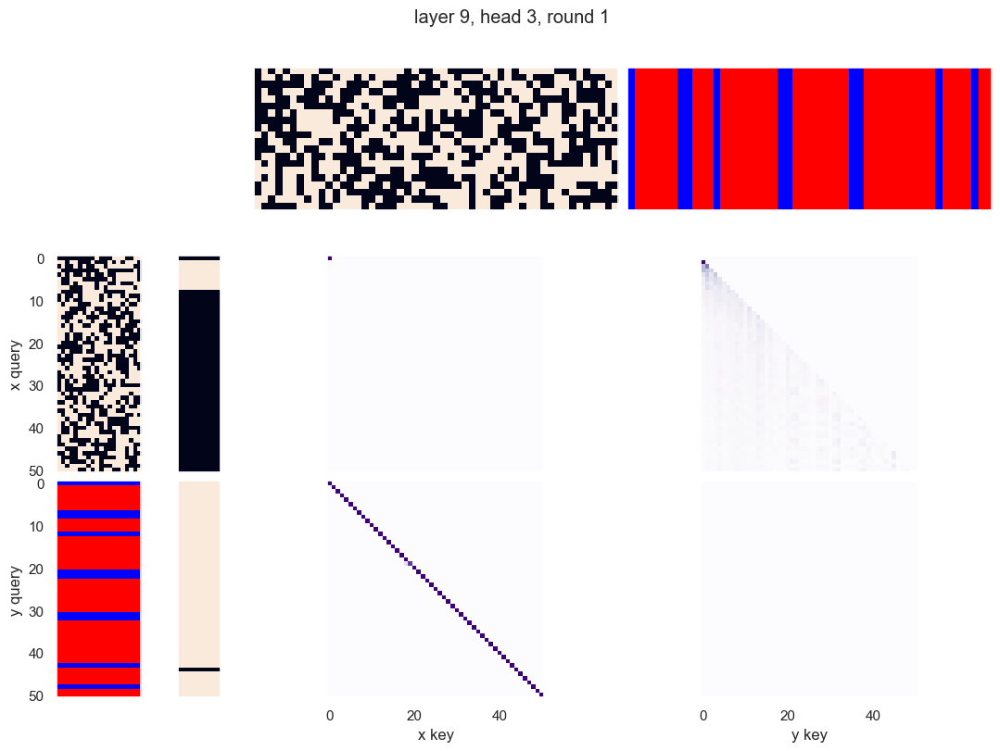

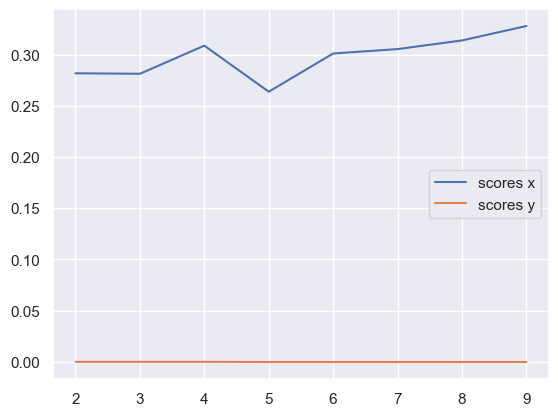

x query cluster:
SVM coefs for class 0: [-0.24296503 -0.00804571 -0.31948938 -0.19996248 -0.23694756 -0.22349549
 -0.28846415  0.17907445 -0.23703562  0.04161566 -0.04066342 -0.02922835
 -0.00032225  0.05697869  0.09467373 -0.16833292 -0.16077975  0.11320554
  0.04154471  0.08395301]\class elements: [36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.73; (2) +12: 0.73; (3) -19: 0.73; (4) -0: 0.67; (5) +8: 0.67; (6) +11: 0.67; (7) +17: 0.67; (8) +7: 0.60; (9) +13: 0.60; (10) -10: 0.60
(1) +8 AND -19: 0.60; (2) -9 AND -19: 0.53; (3) -4 AND -18: 0.53; (4) +8 AND +16: 0.53; (5) -0 AND +12: 0.53; (6) -15 AND +16: 0.53; (7) -0 AND +17: 0.53; (8) +13 AND -19: 0.53; (9) +11 AND +17: 0.53; (10) +11 AND -19: 0.53
(1) -0 OR -10: 1.00; (2) +11 OR +16: 1.00; (3) +16 OR -19: 1.00; (4) -10 OR +13: 1.00; (5) -10 OR -19: 1.00; (6) +6 OR +16: 1.00; (7) +4 OR -18: 1.00; (8) +8 OR +12: 1.00; (9) +12 OR +16: 1.00; (10) -1 OR +8: 1.00
{0.0: 0.9980219580931587}
SVM coefs for class 1: [-0.03239578 -0.27

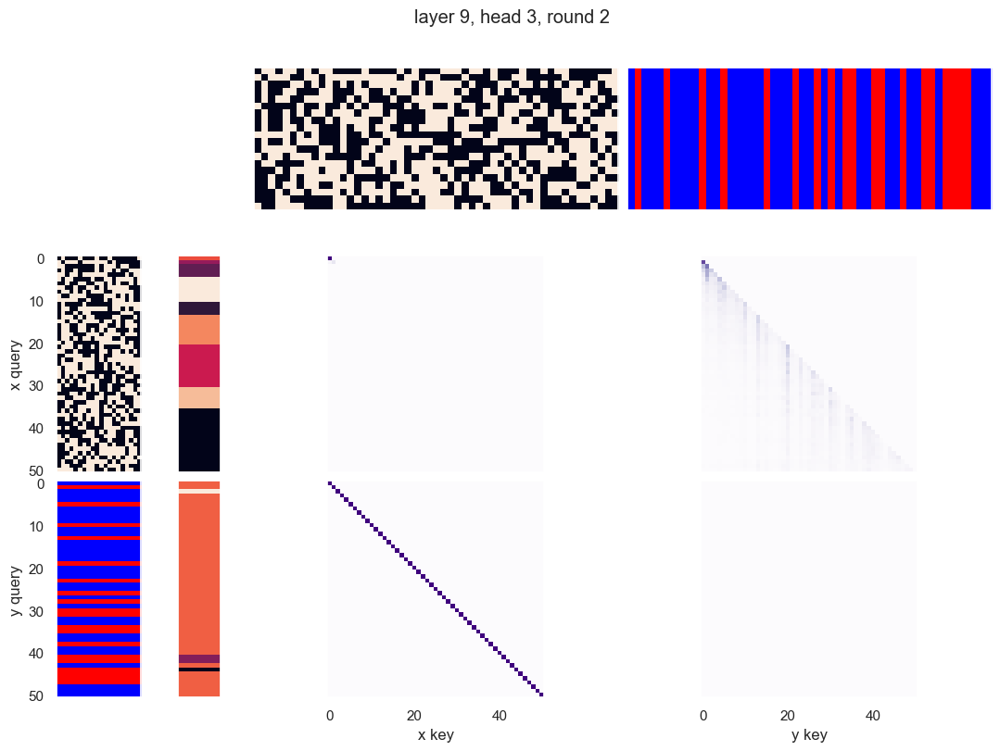

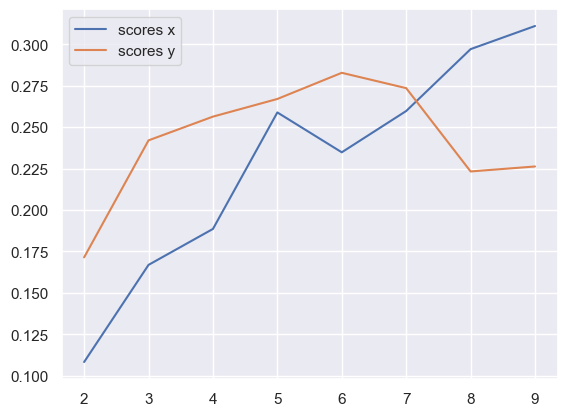

x query cluster:
SVM coefs for class 0: [-0.64175842 -0.09140752 -0.23518396  0.26446918 -0.95969162  0.34401977
 -0.30560562  0.00228063  0.57321906  0.36136564  0.18715291  0.30057575
 -0.15246356  0.30543135  0.1368586   0.05711311  0.0525163  -0.07848469
 -0.00535095 -0.03417846]\class elements: [37 38 40 44 45 46 49]
(1) -0: 1.00; (2) -4: 1.00; (3) +13: 0.86; (4) -12: 0.86; (5) +5: 0.86; (6) -18: 0.71; (7) +17: 0.71; (8) -16: 0.71; (9) +10: 0.71; (10) +8: 0.71
(1) -0 AND -4: 1.00; (2) -4 AND +13: 0.86; (3) -0 AND -12: 0.86; (4) -0 AND +5: 0.86; (5) -4 AND +5: 0.86; (6) -4 AND -12: 0.86; (7) -0 AND +13: 0.86; (8) +5 AND +13: 0.71; (9) -0 AND +8: 0.71; (10) +13 AND +19: 0.71
(1) -0 OR -1: 1.00; (2) -4 OR +11: 1.00; (3) -4 OR -12: 1.00; (4) -4 OR +12: 1.00; (5) -4 OR -13: 1.00; (6) -4 OR +13: 1.00; (7) -4 OR -14: 1.00; (8) -4 OR +14: 1.00; (9) -4 OR -15: 1.00; (10) -4 OR +15: 1.00
{7.0: 0.047021447381536866, 11.0: 0.18722146059319908, 8.0: 0.17258647072594613, 13.0: 0.282023447707095

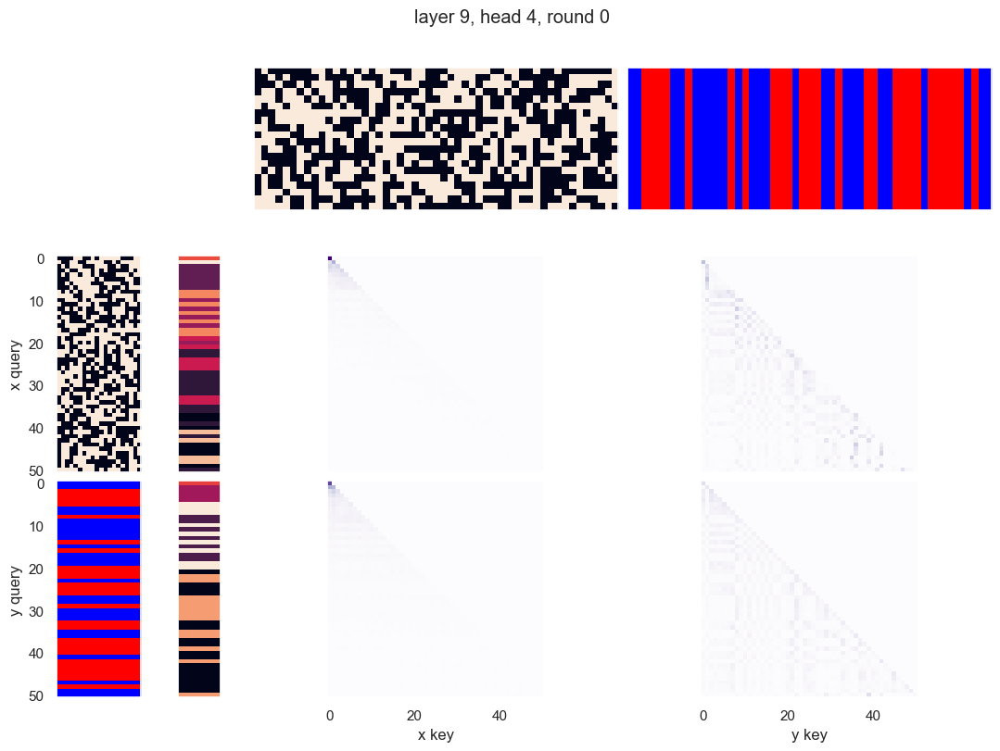

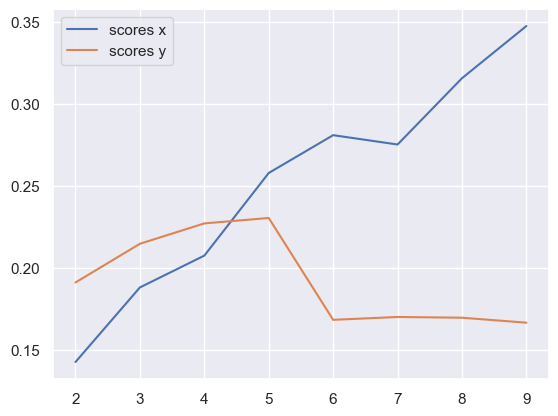

x query cluster:
SVM coefs for class 0: [ 0.18815734 -0.03798999 -0.05232816 -0.02843644 -0.05576139 -0.15084116
 -0.29790272 -0.21486589 -0.09626427  0.62090337  0.25005233 -0.26666669
 -0.04408439 -0.63670206  0.06051386 -0.4619752  -0.37508369 -0.50797776
  0.27028279 -0.20780961]\class elements: [31 43 44]
(1) -0: 1.00; (2) +16: 1.00; (3) +15: 1.00; (4) +14: 1.00; (5) -12: 1.00; (6) -5: 1.00; (7) -9: 1.00; (8) -6: 1.00; (9) +18: 0.67; (10) +17: 0.67
(1) -0 AND +14: 1.00; (2) -12 AND +15: 1.00; (3) -12 AND +14: 1.00; (4) -6 AND -12: 1.00; (5) +15 AND +16: 1.00; (6) +14 AND +16: 1.00; (7) -6 AND +14: 1.00; (8) +14 AND +15: 1.00; (9) -5 AND +16: 1.00; (10) -6 AND +15: 1.00
(1) -0 OR -1: 1.00; (2) -6 OR -15: 1.00; (3) +6 OR +14: 1.00; (4) -6 OR +14: 1.00; (5) -6 OR -14: 1.00; (6) -6 OR +13: 1.00; (7) -6 OR -13: 1.00; (8) +6 OR -12: 1.00; (9) -6 OR +12: 1.00; (10) -6 OR -12: 1.00
{0.0: 0.9472869752983873}
SVM coefs for class 1: [ 0.79257813  0.02215127  0.04103226 -0.3069888   0.0220080

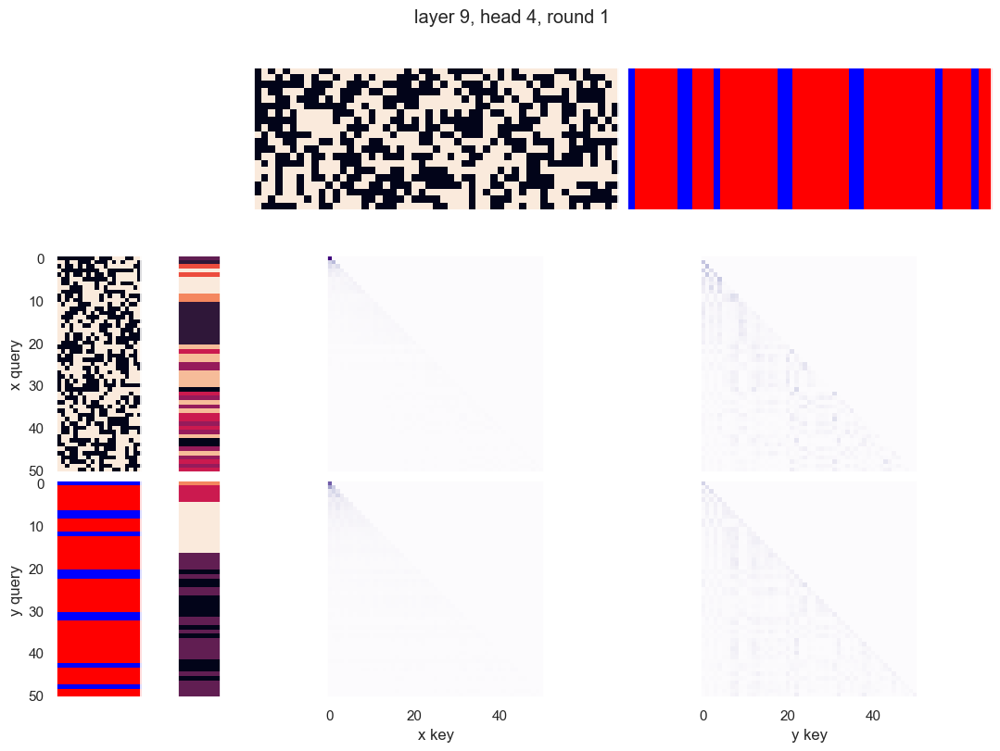

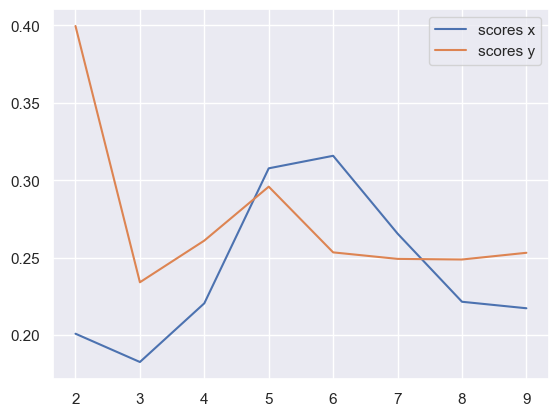

x query cluster:
SVM coefs for class 0: [-0.11721034 -0.15924415 -0.21117826  0.33418377 -0.26343729  0.1254998
 -0.1002758  -0.0849707  -0.22731474  0.17999998 -0.34923808 -0.08305784
  0.31872927 -0.04582026  0.14098987  0.19469076 -0.28552278 -0.0366988
 -0.4143302   0.09296541]\class elements: [29 32 34 35 36 38 39 41 44 45 46 47 48 49]
(1) -0: 1.00; (2) -1: 0.71; (3) +17: 0.64; (4) +16: 0.64; (5) +12: 0.64; (6) +8: 0.64; (7) +7: 0.64; (8) +14: 0.57; (9) +13: 0.57; (10) +11: 0.57
(1) -0 AND -1: 0.71; (2) -0 AND +8: 0.64; (3) -0 AND +17: 0.64; (4) -0 AND +16: 0.64; (5) -0 AND +12: 0.64; (6) -0 AND +7: 0.64; (7) -0 AND +9: 0.57; (8) -0 AND +6: 0.57; (9) -0 AND +11: 0.57; (10) -0 AND -5: 0.57
(1) -0 OR -1: 1.00; (2) -0 OR -8: 1.00; (3) -0 OR +8: 1.00; (4) +9 OR -19: 1.00; (5) +7 OR +17: 1.00; (6) -0 OR -9: 1.00; (7) -0 OR +9: 1.00; (8) -0 OR +16: 1.00; (9) -0 OR -10: 1.00; (10) -0 OR +10: 1.00
{0.0: 0.9081872522947378}
SVM coefs for class 1: [ 0.19229876  0.15598338  0.0531854  -0.601

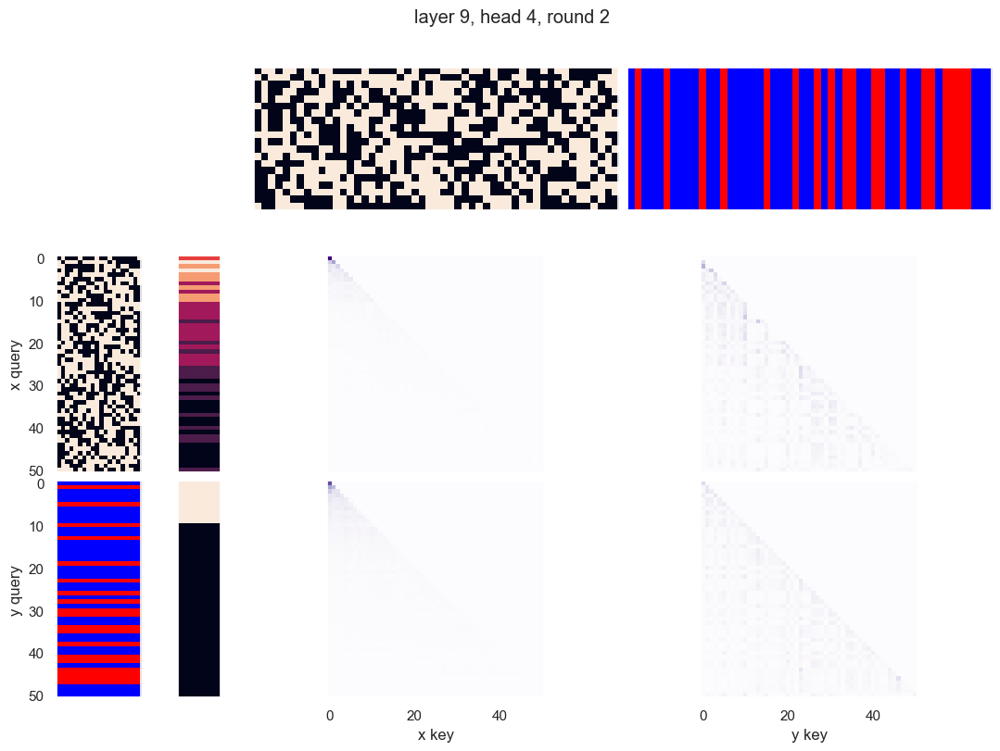

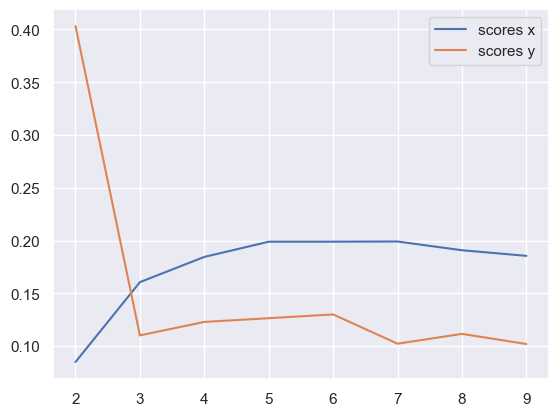

x query cluster:
SVM coefs for class 0: [-0.43222719  0.06095258 -1.03761974  0.2532841  -1.09899279  0.04902803
 -0.46146292  0.06691067  0.15112598  0.24832581 -0.0333878   0.35098401
 -0.13475291  0.32045867  0.12156903 -0.23321089  0.24545841 -0.19337965
 -0.34977212  0.11012573]\class elements: [40 42 44 45 46 49]
(1) -4: 1.00; (2) +5: 1.00; (3) -0: 0.83; (4) +13: 0.83; (5) -12: 0.83; (6) -18: 0.67; (7) +17: 0.67; (8) -16: 0.67; (9) -15: 0.67; (10) -14: 0.67
(1) -4 AND +5: 1.00; (2) -0 AND -4: 0.83; (3) -0 AND +5: 0.83; (4) -4 AND +13: 0.83; (5) +5 AND -12: 0.83; (6) -4 AND -12: 0.83; (7) -0 AND -12: 0.83; (8) +5 AND +13: 0.83; (9) -4 AND +19: 0.67; (10) -4 AND -15: 0.67
(1) -0 OR -1: 1.00; (2) -4 OR -14: 1.00; (3) -4 OR +14: 1.00; (4) -4 OR -15: 1.00; (5) -4 OR +15: 1.00; (6) -4 OR -16: 1.00; (7) -4 OR +16: 1.00; (8) -4 OR -17: 1.00; (9) -4 OR +17: 1.00; (10) -4 OR -18: 1.00
{7.0: 0.12491090428860235, 11.0: 0.10308893746696413, 8.0: 0.11837931540018568, 13.0: 0.13849173268924156,

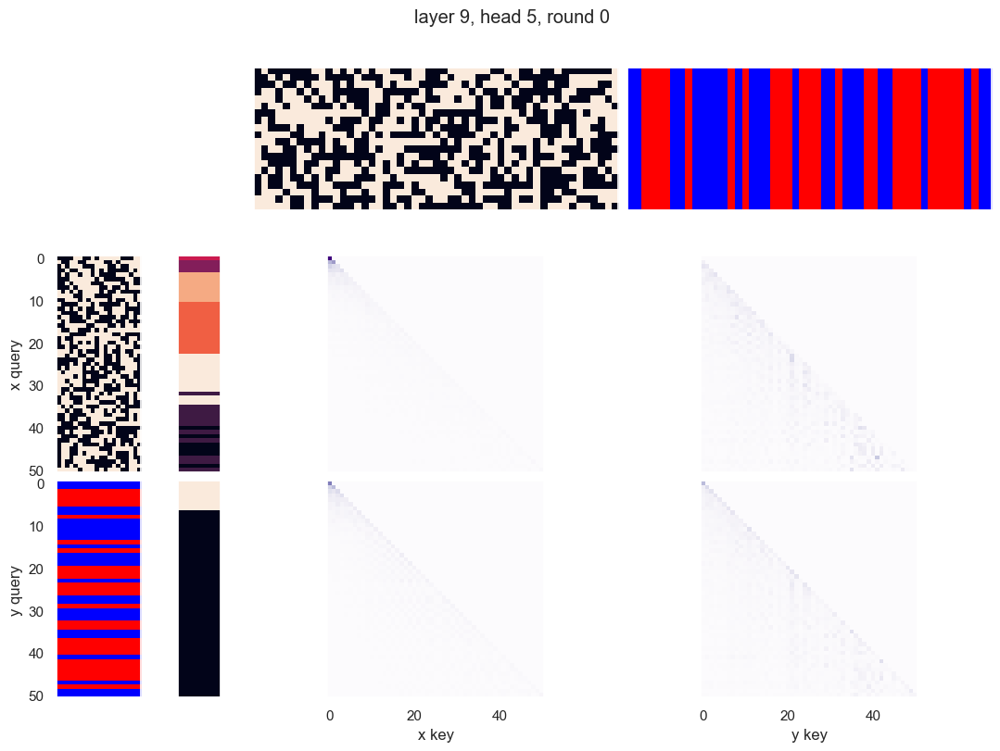

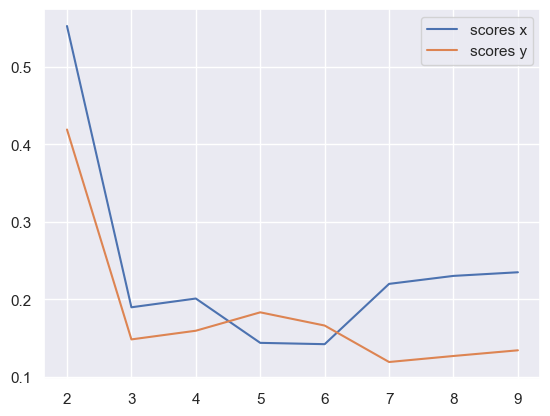

x query cluster:
SVM coefs: [-0.25510369  0.45921589 -0.27299072 -0.1755151   0.21551035  0.11984503
 -0.07025663  0.09278437 -0.10832159 -0.49035853  0.00370754 -0.20237987
  0.11104746 -0.23137768 -0.04470705  0.29457792  0.46677633  0.52135891
 -0.5733144  -0.62859324]
class1: [0 1 2 3]
(1) -5: 1.00; (2) -7: 1.00; (3) -2: 1.00; (4) -8: 0.75; (5) -6: 0.75; (6) +14: 0.75; (7) -19: 0.75; (8) -11: 0.75; (9) -3: 0.75; (10) +18: 0.75
(1) -5 AND -7: 1.00; (2) -2 AND -7: 1.00; (3) -2 AND -5: 1.00; (4) -2 AND +14: 0.75; (5) -7 AND -11: 0.75; (6) -5 AND +14: 0.75; (7) -3 AND -5: 0.75; (8) -2 AND -19: 0.75; (9) -2 AND +18: 0.75; (10) -5 AND -6: 0.75
(1) -2 OR -17: 1.00; (2) -3 OR -15: 1.00; (3) -9 OR -11: 1.00; (4) -3 OR +14: 1.00; (5) -3 OR -13: 1.00; (6) -3 OR +12: 1.00; (7) -9 OR +13: 1.00; (8) +9 OR -13: 1.00; (9) -9 OR +14: 1.00; (10) -3 OR -11: 1.00
{0.0: 0.16913254000246525}
class2: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 3

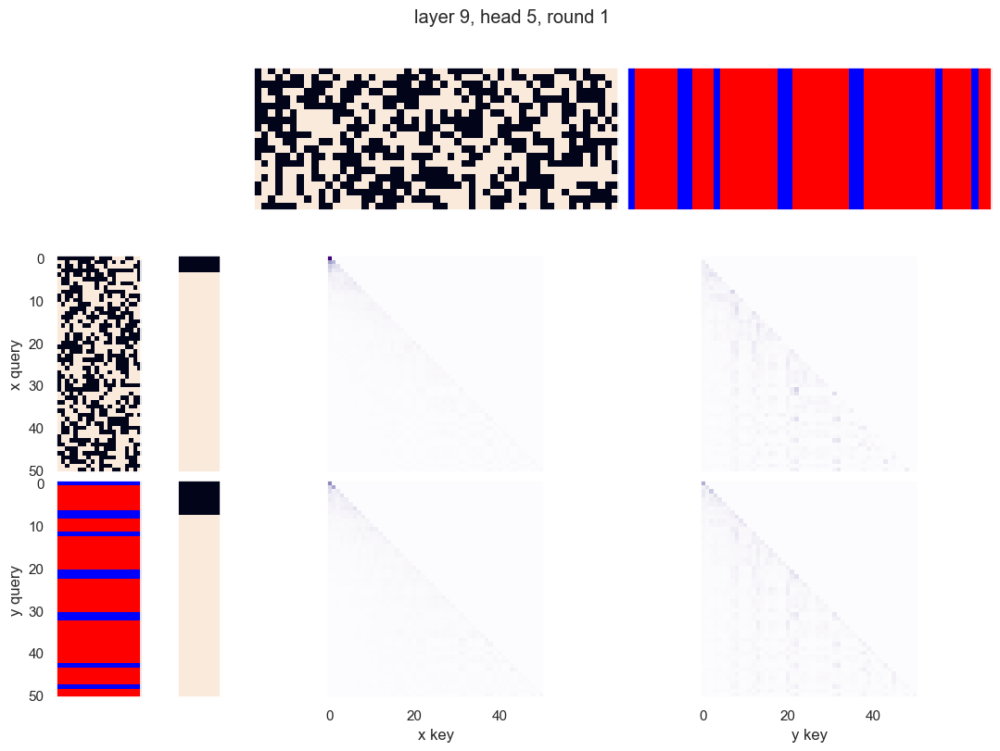

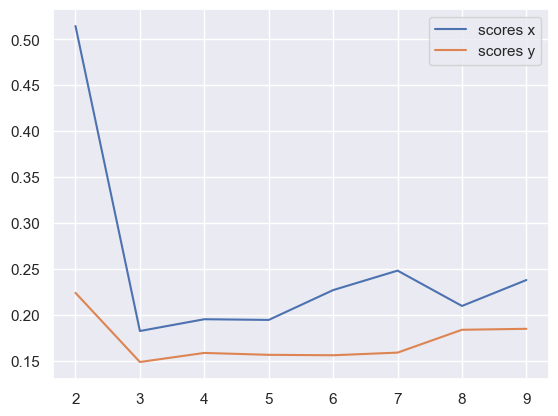

x query cluster:
SVM coefs: [ 0.25510145 -0.45921755  0.27299263  0.17551607 -0.21551349 -0.11985104
  0.07025634 -0.09278721  0.10832122  0.49036363 -0.00371247  0.20237862
 -0.11105276  0.23138403  0.04470273 -0.29458088 -0.46677695 -0.52135418
  0.57331876  0.62859345]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) +17: 0.64; (3) -19: 0.62; (4) +2: 0.62; (5) +8: 0.60; (6) +13: 0.60; (7) -0: 0.60; (8) +14: 0.60; (9) -9: 0.57; (10) +6: 0.57
(1) +8 AND +16: 0.47; (2) +17 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) -9 AND -19: 0.45; (5) -5 AND +16: 0.45; (6) +7 AND +16: 0.45; (7) -0 AND +17: 0.43; (8) -9 AND +13: 0.43; (9) +8 AND +13: 0.43; (10) +17 AND -18: 0.43
(1) +12 OR +16: 0.91; (2) +14 OR +16: 0.91; (3) +13 OR +16: 0.89; (4) +15 OR +16: 0.89; (5) +6 OR +16: 0.89; (6) +5 OR +16: 0.89; (7) +16 OR -19: 0.89; (8) +2 OR +16: 0.89; (9) +7 OR +17: 0.89; (10) +2 OR +4

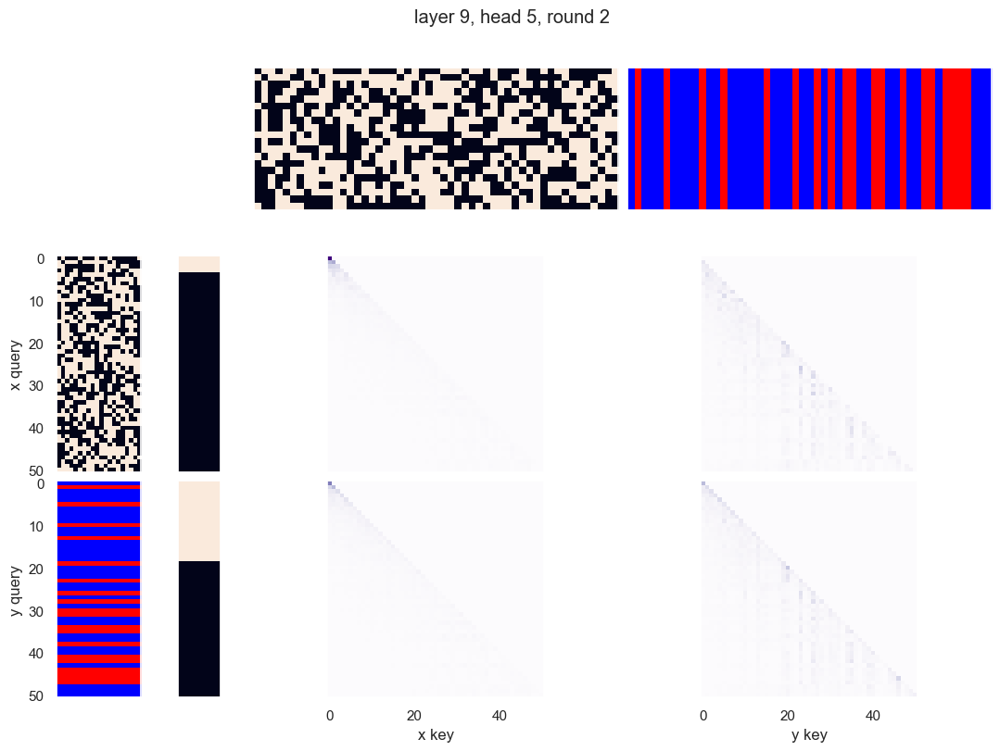

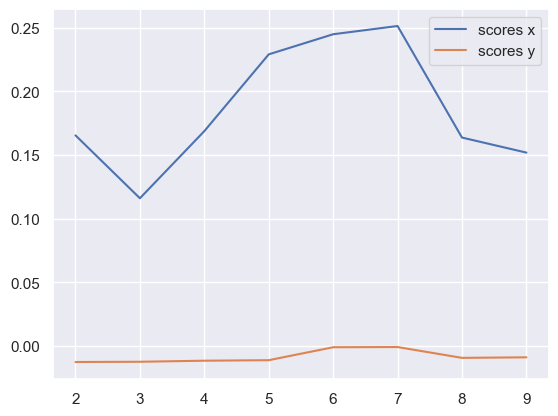

x query cluster:
SVM coefs for class 0: [-0.33983836 -0.1960879  -0.4541397   0.26799613 -0.89920882  0.1512379
 -0.31661308 -0.09063562 -0.09392173  0.32503167  0.23273259  0.30852116
  0.13633851  0.15235448  0.03785092 -0.51820724  0.21524488 -0.18578503
 -0.1702892  -0.09368736]\class elements: [38 40 42 44 46]
(1) -15: 1.00; (2) -4: 1.00; (3) +5: 1.00; (4) +10: 1.00; (5) -0: 0.80; (6) -18: 0.80; (7) -16: 0.80; (8) -14: 0.80; (9) -3: 0.80; (10) +13: 0.80
(1) -4 AND +5: 1.00; (2) +5 AND +10: 1.00; (3) -4 AND -15: 1.00; (4) +5 AND -15: 1.00; (5) +10 AND -15: 1.00; (6) -4 AND +10: 1.00; (7) -14 AND -16: 0.80; (8) +13 AND -14: 0.80; (9) -0 AND +10: 0.80; (10) -15 AND -16: 0.80
(1) -0 OR -1: 1.00; (2) +5 OR -15: 1.00; (3) -5 OR -15: 1.00; (4) +5 OR +14: 1.00; (5) +5 OR -14: 1.00; (6) +5 OR +13: 1.00; (7) +5 OR -13: 1.00; (8) +5 OR +12: 1.00; (9) +5 OR -12: 1.00; (10) +5 OR +11: 1.00
{7.0: 0.137600578693673, 11.0: 0.09439516144338994, 8.0: 0.19132612415123731, 13.0: 0.204170232382603, 12

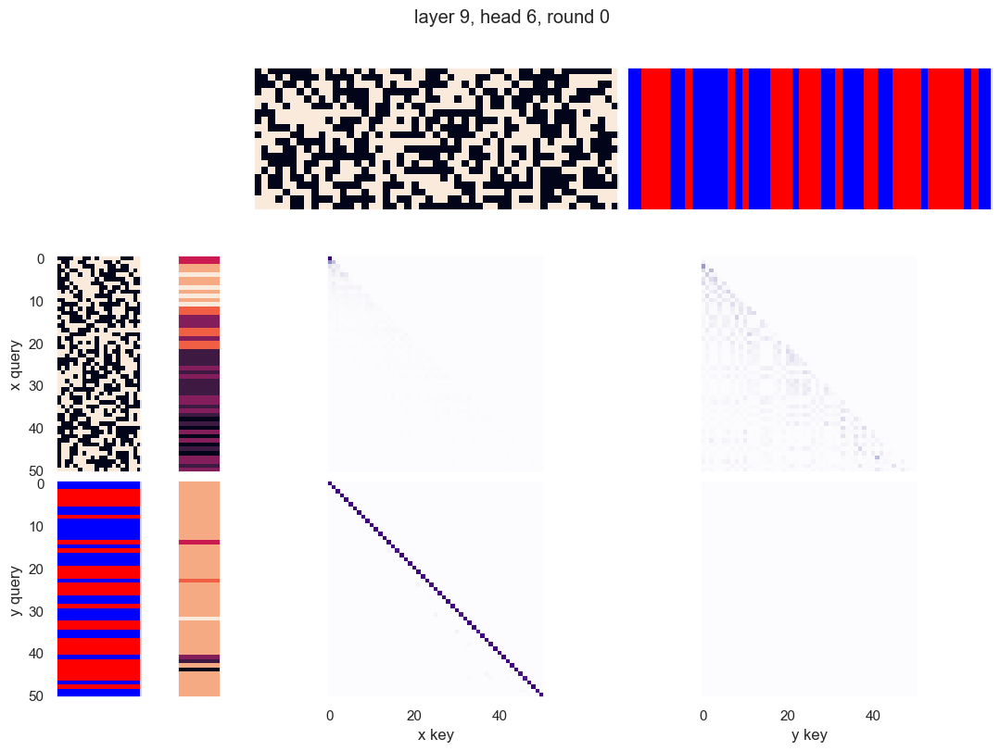

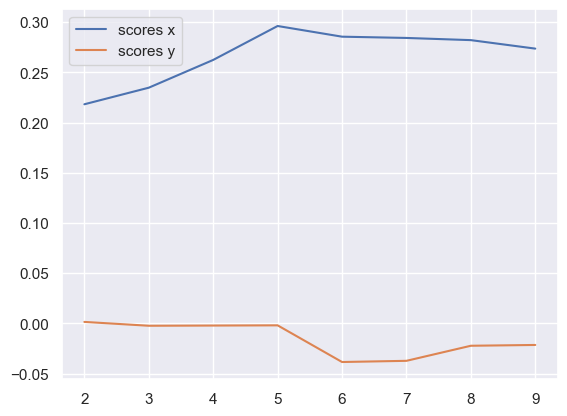

x query cluster:
SVM coefs for class 0: [ 0.10931394  0.11818254 -0.16742881 -0.16952378 -0.09167954  0.05901695
 -0.21113695  0.14852677  0.25288681  0.20463396  0.05747481 -0.19822335
 -0.28575189  0.080822    0.18893589 -0.27293716 -0.01678377  0.44273593
 -0.2059256  -0.21551761]\class elements: [10 12 15 16 21 28 31 32 34 37 42 43 44 45 46 47 48 49 50]
(1) +15: 1.00; (2) +14: 0.74; (3) +9: 0.63; (4) -16: 0.63; (5) +13: 0.63; (6) +19: 0.63; (7) +2: 0.63; (8) -10: 0.58; (9) +12: 0.58; (10) +7: 0.58
(1) +14 AND +15: 0.74; (2) +13 AND +15: 0.63; (3) +15 AND +19: 0.63; (4) +9 AND +15: 0.63; (5) +2 AND +15: 0.63; (6) +15 AND -16: 0.63; (7) -5 AND +15: 0.58; (8) -6 AND +15: 0.58; (9) +7 AND +15: 0.58; (10) -4 AND +15: 0.58
(1) +5 OR +15: 1.00; (2) +11 OR +15: 1.00; (3) +1 OR +15: 1.00; (4) -1 OR +15: 1.00; (5) -12 OR +15: 1.00; (6) +15 OR +19: 1.00; (7) +15 OR -19: 1.00; (8) +12 OR +15: 1.00; (9) -13 OR +15: 1.00; (10) +15 OR +18: 1.00
{0.0: 0.8366207395175527}
SVM coefs for class 1: [-0

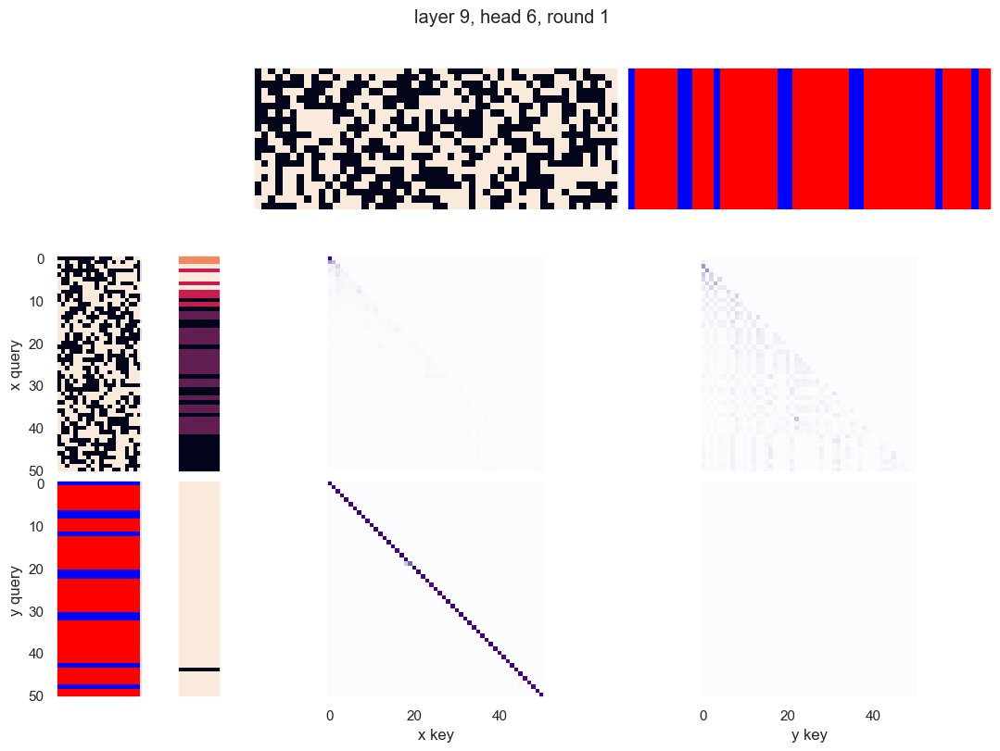

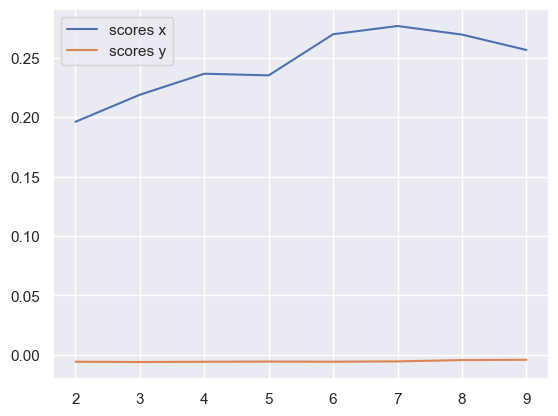

x query cluster:
SVM coefs for class 0: [-0.07230382  0.03398455  0.26090212  0.36885889  0.17430722  0.29059902
 -0.11019794 -0.06326101  0.01991872  0.00352439 -0.28191509  0.09800928
  0.22280233  0.08535455 -0.42670153 -0.00661452 -0.24113897 -0.25379137
 -0.14595566  0.02134158]\class elements: [28 30 32 33 35 38 40 41 42 43 44 47 49 50]
(1) -15: 1.00; (2) +16: 0.86; (3) -19: 0.71; (4) -1: 0.71; (5) -18: 0.71; (6) +2: 0.71; (7) +7: 0.64; (8) -4: 0.64; (9) +12: 0.64; (10) -3: 0.64
(1) -15 AND +16: 0.86; (2) +2 AND -15: 0.71; (3) -15 AND -19: 0.71; (4) -1 AND -15: 0.71; (5) -15 AND -18: 0.71; (6) +16 AND -18: 0.64; (7) +16 AND -19: 0.64; (8) +2 AND +16: 0.64; (9) +12 AND -15: 0.64; (10) -4 AND -15: 0.64
(1) -15 OR +17: 1.00; (2) -15 OR +16: 1.00; (3) -15 OR -19: 1.00; (4) -10 OR -15: 1.00; (5) +10 OR -15: 1.00; (6) +0 OR +16: 1.00; (7) +14 OR -15: 1.00; (8) +6 OR +16: 1.00; (9) +0 OR -15: 1.00; (10) -0 OR -15: 1.00
{0.0: 0.9272369924084549}
SVM coefs for class 1: [-0.01553943  0.129

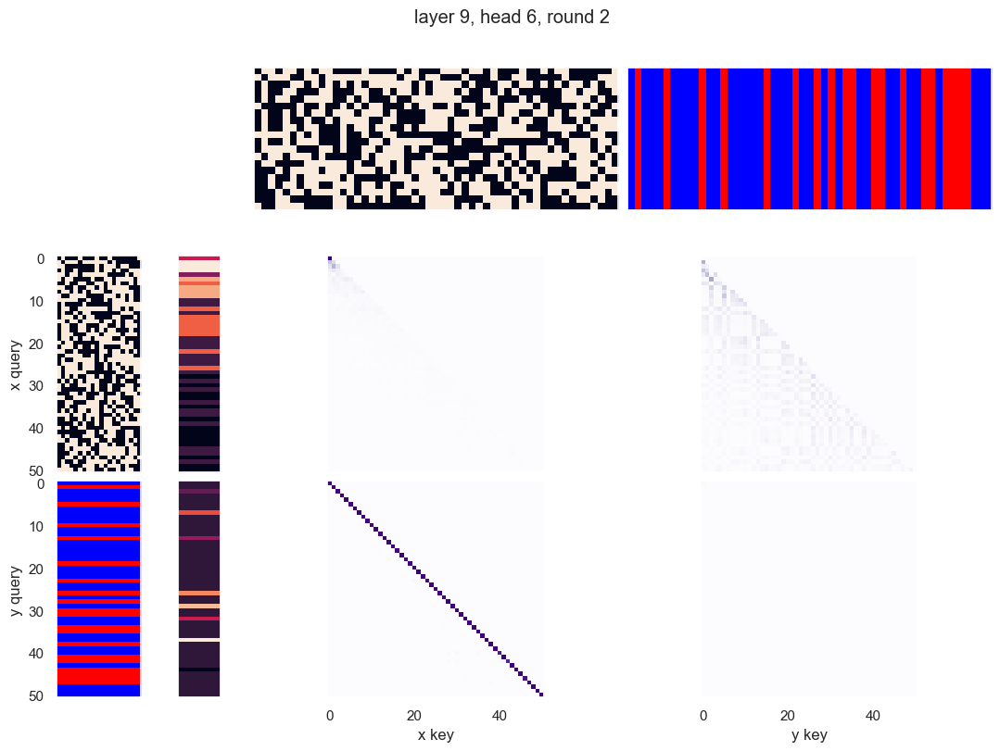

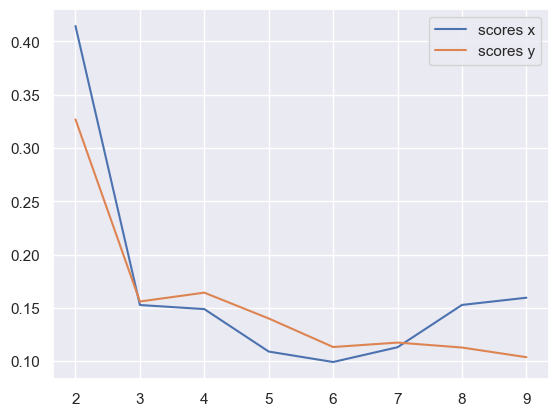

x query cluster:
SVM coefs: [-0.28794541 -0.47313881  1.02874055  0.38310777  0.32285156  0.25921522
  0.01952083  0.00169167  0.67963755  0.2714902  -0.32584382  0.59225331
  0.27770453 -0.56682945  0.12307888 -0.0507416   0.26542301 -0.64575592
  0.50792762  0.61017894]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.66; (3) +10: 0.64; (4) -11: 0.64; (5) -18: 0.61; (6) -12: 0.61; (7) +2: 0.59; (8) -3: 0.59; (9) +13: 0.59; (10) +6: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.48; (3) -11 AND +17: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -16: 0.48; (6) -3 AND -18: 0.48; (7) +6 AND -16: 0.45; (8) -0 AND +17: 0.43; (9) -12 AND +17: 0.43; (10) -12 AND -18: 0.43
(1) -11 OR -16: 0.95; (2) -11 OR -18: 0.95; (3) +10 OR -11: 0.93; (4) +17 OR -19: 0.93; (5) -2 OR -18: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) -3 OR -11: 0.93; (10) +10 OR -12: 

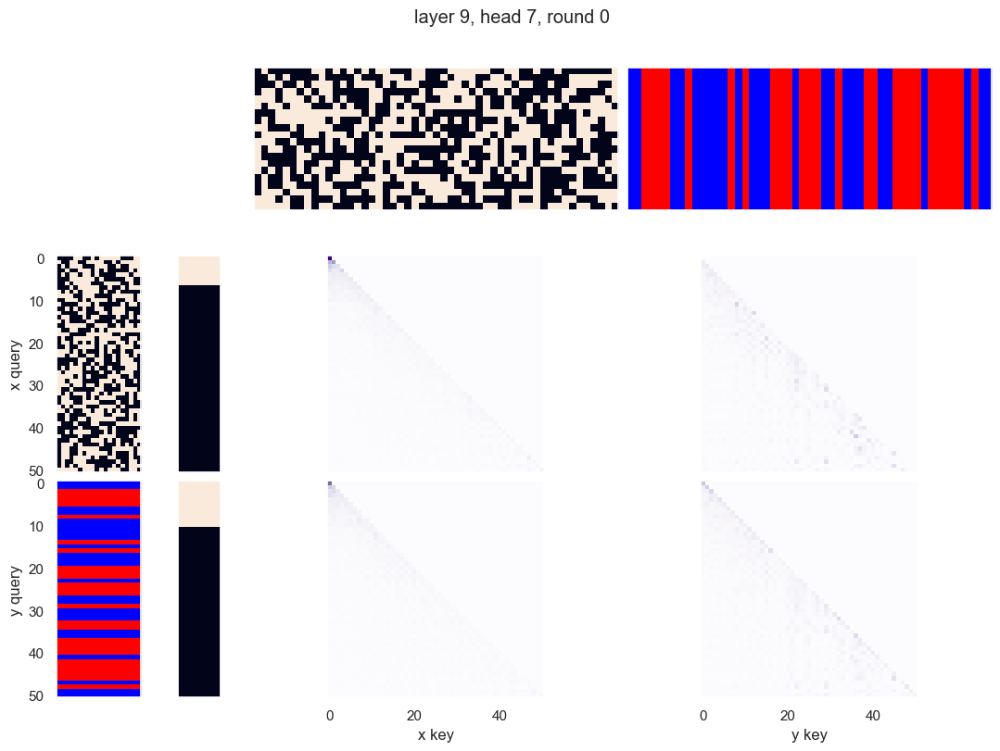

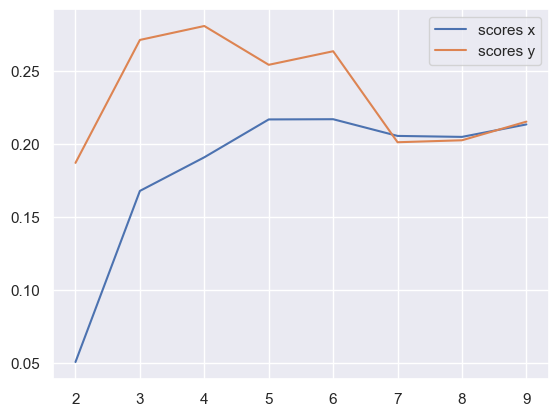

x query cluster:
SVM coefs for class 0: [-0.3229211  -0.23782526  0.0645067   0.10793915 -0.20743142 -0.13388897
 -0.47679387  0.21330586  0.16560118  0.04425964  0.09887361  0.17647699
  0.20275254 -0.16963383  0.27365971 -0.1643662  -0.40130027  0.02612291
  0.42625423 -0.16420187]\class elements: [37 38 40 43 44 48 50]
(1) -5: 1.00; (2) -6: 0.86; (3) +9: 0.71; (4) +0: 0.71; (5) +2: 0.71; (6) +15: 0.71; (7) +3: 0.71; (8) +14: 0.71; (9) +11: 0.71; (10) -10: 0.71
(1) -5 AND -6: 0.86; (2) +2 AND -6: 0.71; (3) -6 AND +15: 0.71; (4) -5 AND -10: 0.71; (5) +2 AND -5: 0.71; (6) +0 AND -5: 0.71; (7) -5 AND +9: 0.71; (8) -5 AND -8: 0.71; (9) -6 AND -10: 0.71; (10) -5 AND +11: 0.71
(1) +3 OR -5: 1.00; (2) +3 OR +15: 1.00; (3) -5 OR -8: 1.00; (4) -5 OR +8: 1.00; (5) +11 OR -19: 1.00; (6) -5 OR -9: 1.00; (7) -5 OR +9: 1.00; (8) +3 OR +14: 1.00; (9) -5 OR -10: 1.00; (10) +1 OR -6: 1.00
{0.0: 0.6277083153171198}
SVM coefs for class 1: [-0.12449066  0.49985246 -0.28770521  0.01288778  0.18547643 -0.

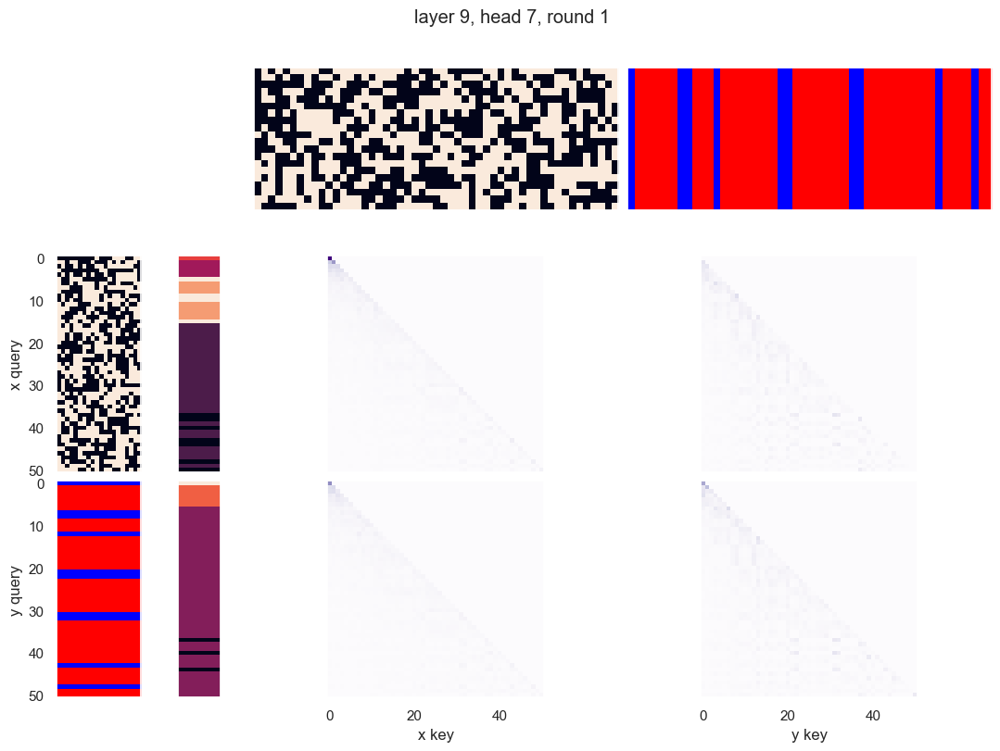

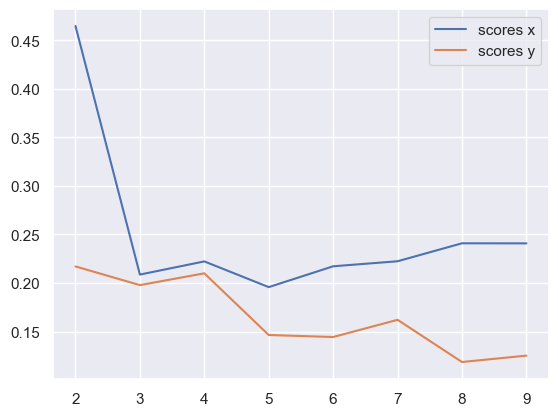

x query cluster:
SVM coefs: [-0.28794271 -0.47314424  1.02873744  0.383108    0.32285875  0.25921081
  0.01952547  0.00168466  0.67964464  0.2714932  -0.32583761  0.59225421
  0.27770133 -0.56682974  0.12307519 -0.05074293  0.26542173 -0.6457528
  0.50792678  0.61017949]
class1: [ 7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30
 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.68; (2) -19: 0.66; (3) +17: 0.64; (4) +13: 0.64; (5) +2: 0.61; (6) -0: 0.61; (7) +8: 0.59; (8) -9: 0.59; (9) +7: 0.59; (10) +14: 0.59
(1) +17 AND -19: 0.50; (2) -9 AND -19: 0.48; (3) +16 AND +17: 0.48; (4) -9 AND +13: 0.45; (5) -18 AND -19: 0.45; (6) +7 AND +16: 0.45; (7) +8 AND +13: 0.45; (8) +8 AND +16: 0.45; (9) -0 AND +16: 0.43; (10) +13 AND -19: 0.43
(1) -10 OR -19: 0.93; (2) -10 OR +13: 0.91; (3) +13 OR +16: 0.91; (4) +15 OR +16: 0.91; (5) +16 OR -19: 0.91; (6) +14 OR +16: 0.91; (7) +12 OR +16: 0.91; (8) +18 OR -19: 0.91; (9) +7 OR -19: 0.91; (10) +2 OR +16: 0.8

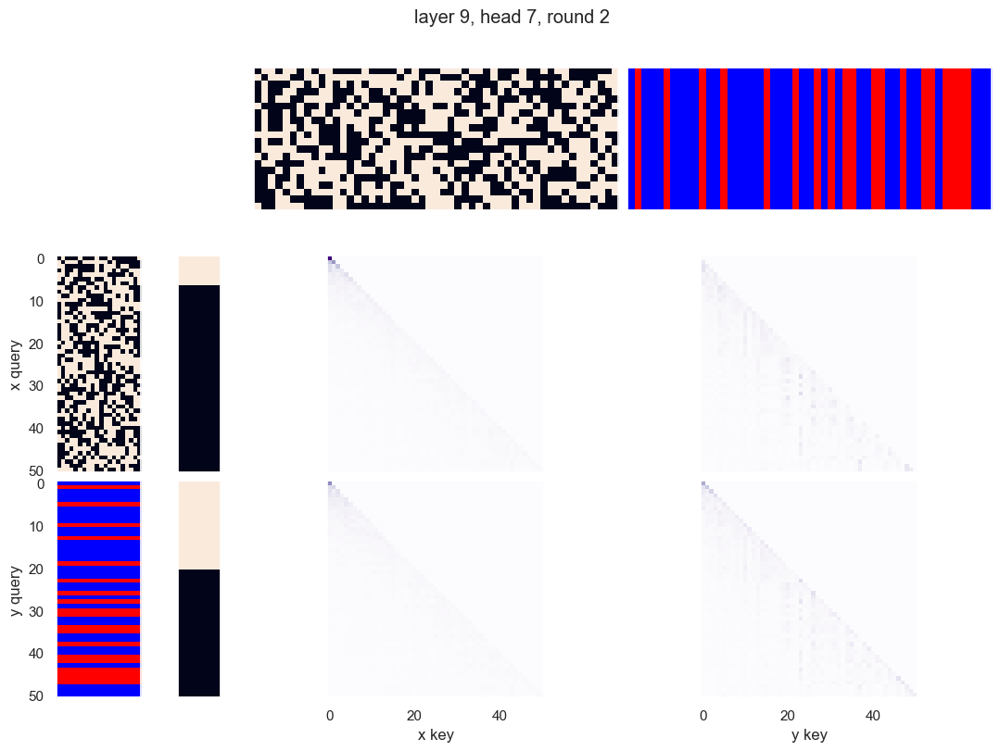

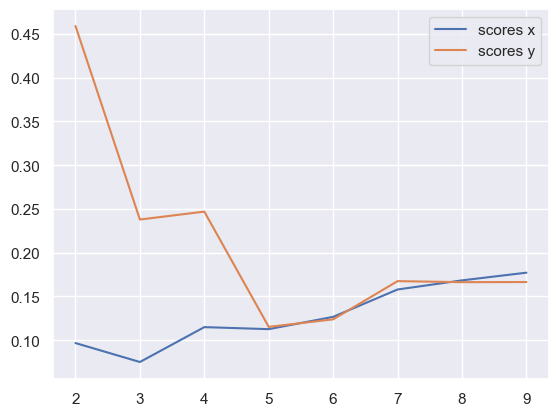

x query cluster:
SVM coefs for class 0: [-0.05238777  0.18941562 -0.08241363  0.54506367 -0.31831499 -0.33640652
 -0.14938582  0.43666228 -0.20110178  0.07697585  0.0968919   0.10274308
  0.15450736 -0.26142086  0.33331191 -0.05476698 -0.24646351 -0.14212231
 -0.11575417  0.19622839]\class elements: [34 36 44]
(1) +1: 1.00; (2) -15: 1.00; (3) +14: 1.00; (4) +3: 1.00; (5) -4: 1.00; (6) -13: 1.00; (7) -11: 1.00; (8) -0: 0.67; (9) +18: 0.67; (10) +17: 0.67
(1) +3 AND +14: 1.00; (2) +1 AND -11: 1.00; (3) +1 AND -13: 1.00; (4) +14 AND -15: 1.00; (5) +1 AND +14: 1.00; (6) +1 AND -15: 1.00; (7) -13 AND -15: 1.00; (8) -13 AND +14: 1.00; (9) +3 AND -4: 1.00; (10) -4 AND -15: 1.00
(1) +3 OR +7: 1.00; (2) -4 OR -7: 1.00; (3) +9 OR +18: 1.00; (4) -4 OR +6: 1.00; (5) -4 OR -6: 1.00; (6) +9 OR -19: 1.00; (7) -4 OR +5: 1.00; (8) -4 OR -5: 1.00; (9) +3 OR +19: 1.00; (10) +3 OR -19: 1.00
{7.0: 0.04451635616957599, 11.0: 0.010098100168913023, 8.0: 0.11747974971130284, 13.0: 0.09102979134665172, 12.0: 0.

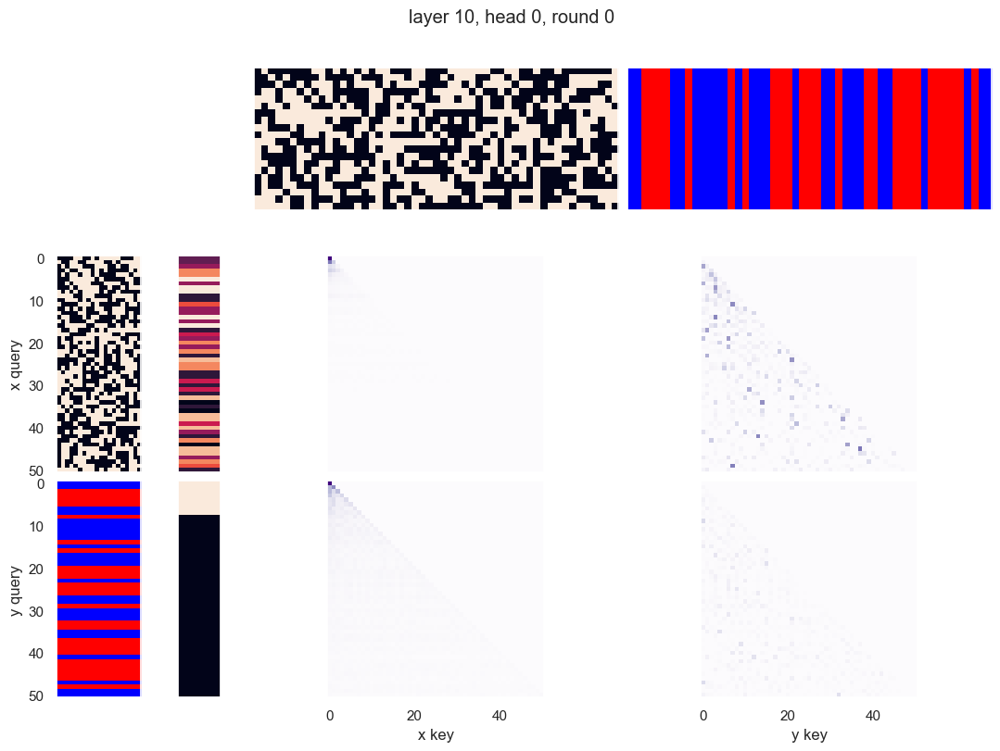

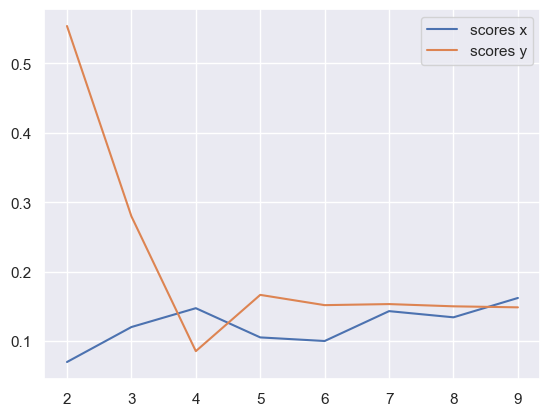

x query cluster:
SVM coefs for class 0: [-0.56978953  0.17274015 -0.04354632  0.33766634 -0.62559276 -0.31533559
 -0.22350928 -0.06888882  0.00736746  0.2325947   0.3610917   0.44088967
 -0.47806044 -0.1269146   0.1183131   0.03536976  0.98068083 -0.2884163
 -0.33882844  0.30266817]\class elements: [ 4  5 10 37 40 44]
(1) +14: 1.00; (2) -10: 1.00; (3) +3: 1.00; (4) -19: 1.00; (5) +15: 0.83; (6) -5: 0.83; (7) -2: 0.67; (8) -1: 0.67; (9) +18: 0.67; (10) -6: 0.67
(1) +14 AND -19: 1.00; (2) +3 AND +14: 1.00; (3) -10 AND +14: 1.00; (4) -10 AND -19: 1.00; (5) +3 AND -19: 1.00; (6) +3 AND -10: 1.00; (7) -10 AND +15: 0.83; (8) +3 AND -5: 0.83; (9) +3 AND +15: 0.83; (10) -5 AND -19: 0.83
(1) -0 OR -1: 1.00; (2) +2 OR -10: 1.00; (3) +7 OR -19: 1.00; (4) -2 OR -11: 1.00; (5) -7 OR -19: 1.00; (6) +7 OR +18: 1.00; (7) +7 OR +15: 1.00; (8) +7 OR +14: 1.00; (9) -7 OR +14: 1.00; (10) -2 OR +14: 1.00
{0.0: 0.9208158440883948}
SVM coefs for class 1: [-0.03999908 -0.10622527 -0.57976407 -0.84018296  0.67

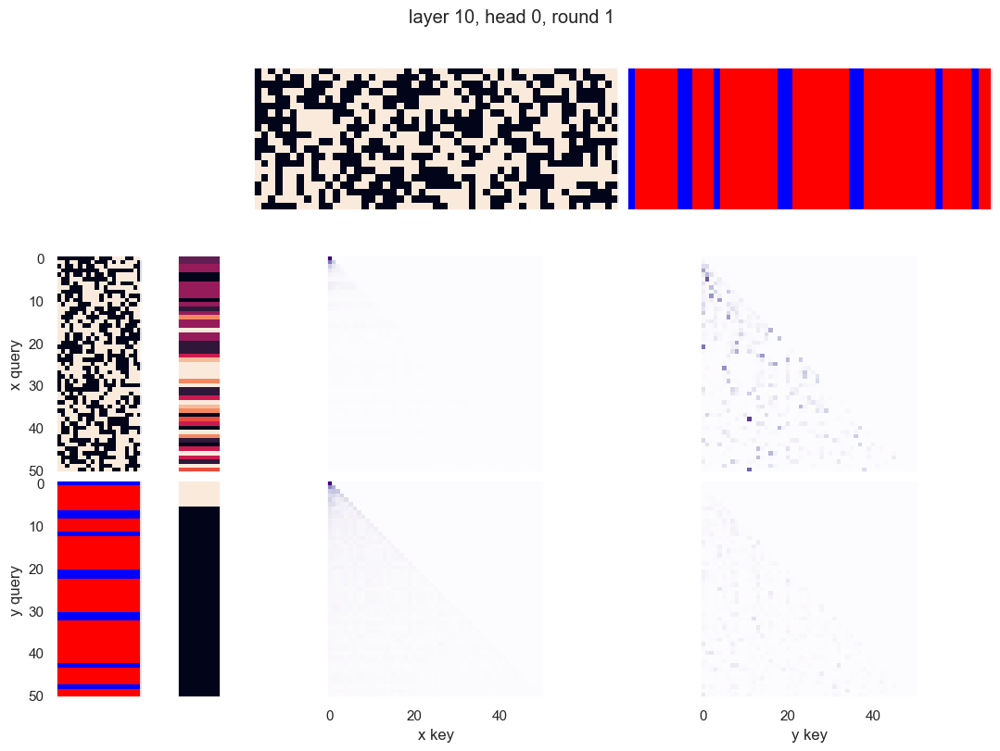

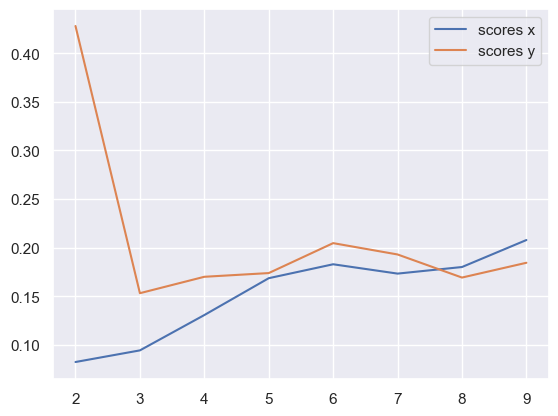

x query cluster:
SVM coefs for class 0: [-0.17994613 -0.07719304  0.1502672   0.6327996  -0.20559997  0.46578038
 -0.37658577 -0.03784291  0.70033071  0.22188565 -0.15235451  0.53013069
 -0.02731484  0.00396658  0.27612326 -0.12693418 -0.16963999  0.09171603
 -0.31211717 -0.00126227]\class elements: [32 44 46]
(1) -0: 1.00; (2) +10: 1.00; (3) -19: 1.00; (4) -9: 1.00; (5) +6: 1.00; (6) -5: 1.00; (7) +4: 1.00; (8) -7: 1.00; (9) +17: 1.00; (10) +3: 1.00
(1) -0 AND -1: 1.00; (2) -5 AND -9: 1.00; (3) -1 AND +17: 1.00; (4) -5 AND +10: 1.00; (5) -9 AND +10: 1.00; (6) -1 AND +10: 1.00; (7) -5 AND +17: 1.00; (8) -1 AND -9: 1.00; (9) -1 AND -19: 1.00; (10) -5 AND -19: 1.00
(1) -0 OR -1: 1.00; (2) +4 OR -17: 1.00; (3) -4 OR +17: 1.00; (4) +10 OR -14: 1.00; (5) +4 OR +16: 1.00; (6) +4 OR -16: 1.00; (7) +10 OR +14: 1.00; (8) +4 OR +15: 1.00; (9) +4 OR -15: 1.00; (10) +10 OR -15: 1.00
{0.0: 0.9719138783930246}
SVM coefs for class 1: [-0.34665624 -0.45668139  0.02987934  0.19932918 -0.31483089 -0.061

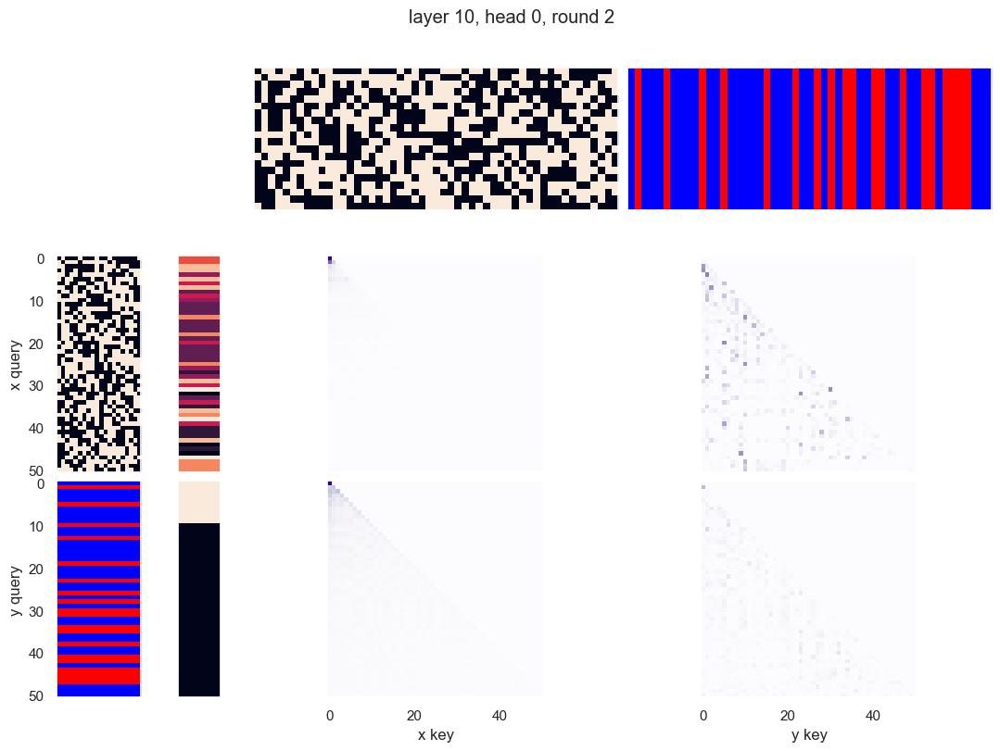

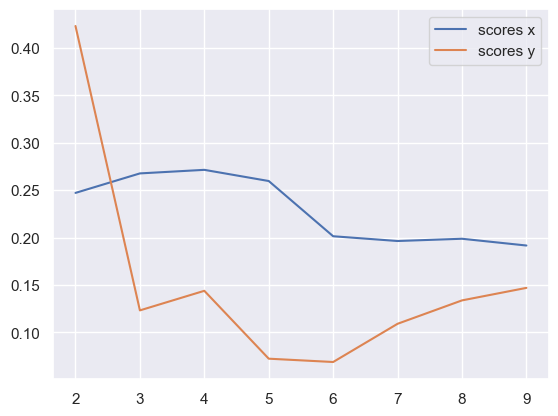

x query cluster:
SVM coefs for class 0: [-0.70060116  0.53960818 -0.78153109 -0.29755406 -0.74768032  0.0618922
 -0.22360652 -0.26273842  0.34439928  0.78679918  0.41975463  0.09845018
  0.48353825 -0.41532451  0.36323653  0.37241599 -0.49767534  0.4071572
  0.18925882 -0.56035754]\class elements: [11 14 16 18 20 22 25 26 29 31 34 36 37 38 40 43 44 45 46 48 49]
(1) -0: 0.71; (2) +17: 0.71; (3) -16: 0.71; (4) -13: 0.71; (5) -12: 0.67; (6) -11: 0.67; (7) +10: 0.67; (8) -4: 0.67; (9) +9: 0.62; (10) +1: 0.62
(1) -12 AND +17: 0.57; (2) -0 AND -12: 0.57; (3) -0 AND +17: 0.57; (4) -4 AND +17: 0.52; (5) +9 AND +17: 0.52; (6) -11 AND +17: 0.52; (7) -4 AND -12: 0.52; (8) -11 AND -13: 0.52; (9) -13 AND +17: 0.48; (10) +6 AND +17: 0.48
(1) +10 OR +17: 1.00; (2) -0 OR -13: 1.00; (3) +10 OR -11: 1.00; (4) -4 OR -13: 1.00; (5) +5 OR -13: 0.95; (6) -12 OR -16: 0.95; (7) -6 OR +17: 0.95; (8) +8 OR -13: 0.95; (9) -11 OR -16: 0.95; (10) -7 OR +17: 0.95
{7.0: 0.19053426012825575, 11.0: 0.0396249267500068,

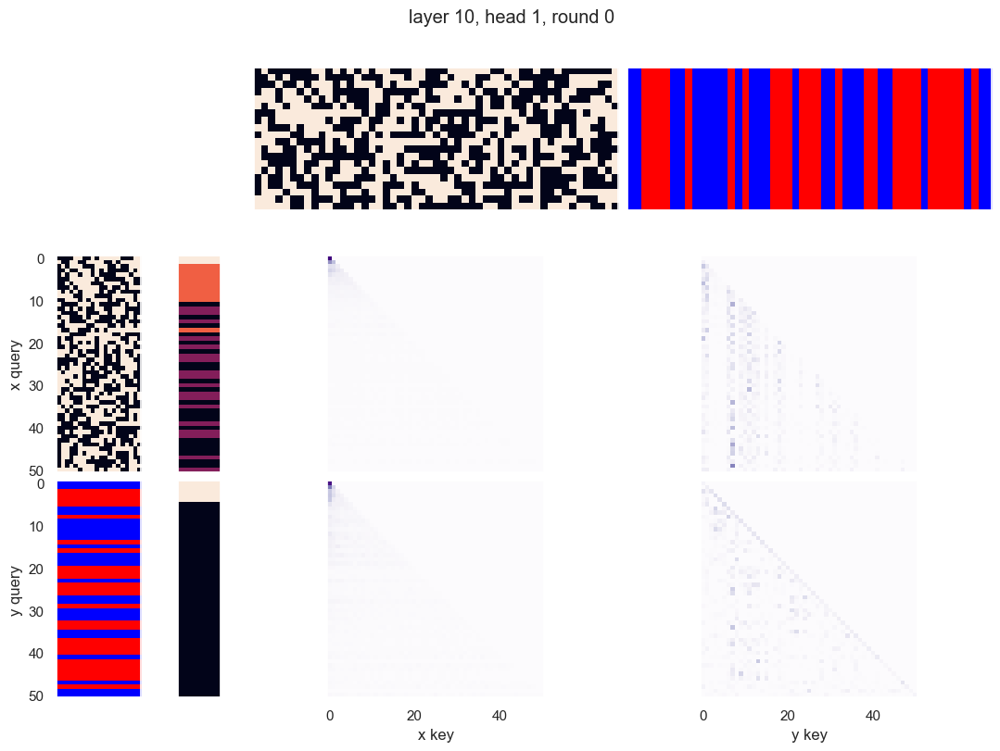

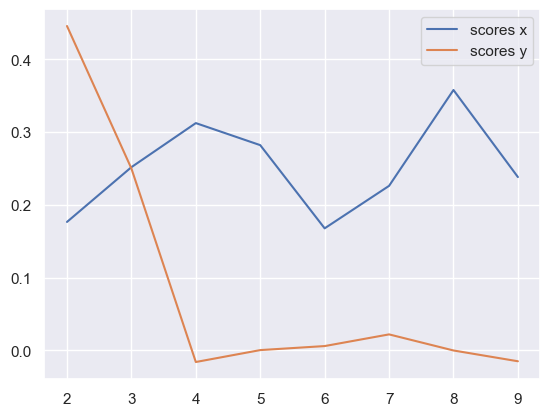

x query cluster:
SVM coefs for class 0: [-0.31942977 -0.09172436 -0.27916746  0.75460319 -0.79454394 -0.08873133
 -0.63313972 -0.22737315 -0.75052701  0.20167117 -0.37426195 -0.39465023
  0.05327263  0.51988651 -0.04509362  0.15673408  0.0555205  -0.34934265
 -0.84198104 -0.23911951]\class elements: [23 24 25 26 27 28 29 30 33 34 35 36 37 39 40 41 42 44 45 46 49]
(1) +5: 0.86; (2) +17: 0.71; (3) -16: 0.71; (4) +14: 0.67; (5) +13: 0.62; (6) -15: 0.62; (7) -10: 0.62; (8) -18: 0.57; (9) -9: 0.57; (10) -19: 0.52
(1) +5 AND +17: 0.67; (2) +5 AND -16: 0.62; (3) +5 AND -15: 0.57; (4) +13 AND -16: 0.52; (5) +5 AND +13: 0.52; (6) +5 AND +14: 0.52; (7) +5 AND +6: 0.52; (8) -16 AND +17: 0.52; (9) +5 AND -9: 0.52; (10) +5 AND +19: 0.48
(1) +5 OR -19: 1.00; (2) +3 OR +5: 1.00; (3) +5 OR -6: 1.00; (4) -1 OR +5: 1.00; (5) +5 OR +14: 1.00; (6) +5 OR -10: 1.00; (7) +2 OR +5: 0.95; (8) +5 OR +13: 0.95; (9) +4 OR +5: 0.95; (10) +5 OR +15: 0.95
{0.0: 0.45827525844926975}
SVM coefs for class 1: [ 0.2101450

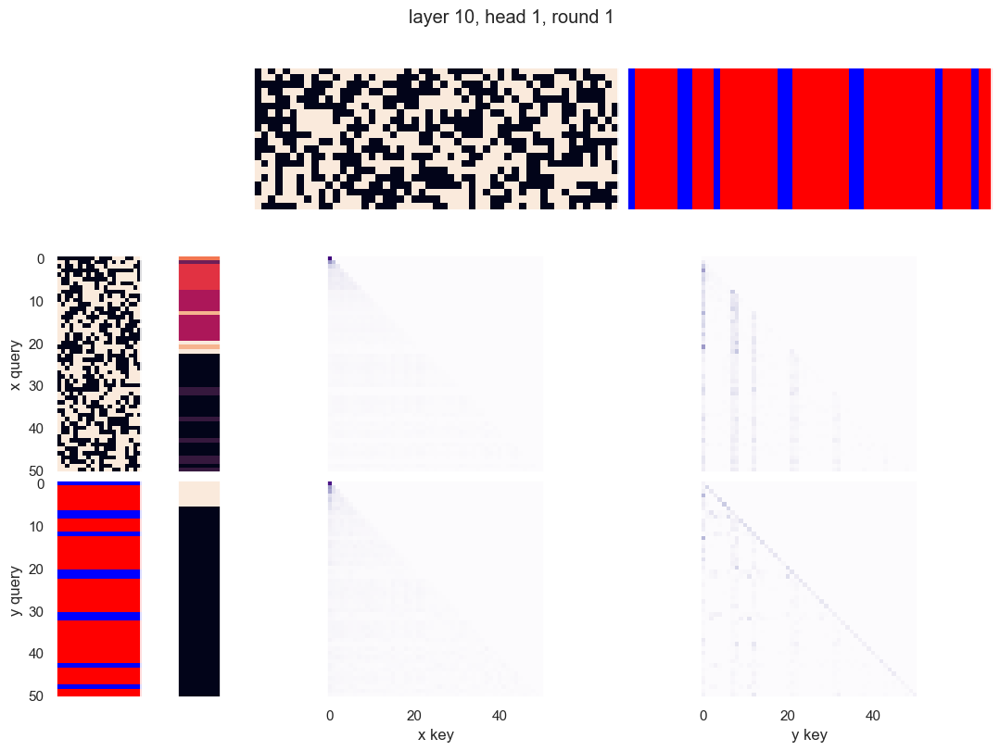

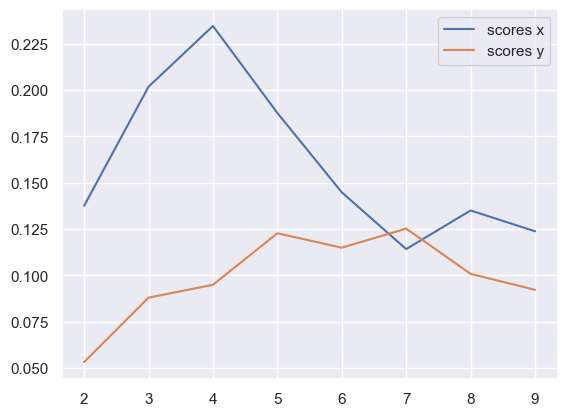

x query cluster:
SVM coefs for class 0: [-0.18941628 -0.0867104   0.27401917  0.21805177  0.05884296  0.50211043
 -0.5073259  -0.1231398   0.30660076  0.28217065 -0.28294654  0.03428892
  0.09988374  0.11372243 -0.01556026  0.0239218   0.27748955  0.08019307
 -0.28516815 -0.1236753 ]\class elements: [27 30 32 38 39 40 44 45 46 47]
(1) -1: 1.00; (2) -8: 0.80; (3) +6: 0.80; (4) -0: 0.70; (5) +14: 0.70; (6) +12: 0.70; (7) +17: 0.70; (8) +2: 0.70; (9) -15: 0.60; (10) -13: 0.60
(1) -1 AND +6: 0.80; (2) -1 AND -8: 0.80; (3) -0 AND -1: 0.70; (4) -1 AND +12: 0.70; (5) -1 AND +14: 0.70; (6) -1 AND +2: 0.70; (7) -1 AND +17: 0.70; (8) +5 AND -8: 0.60; (9) -1 AND +4: 0.60; (10) -1 AND +5: 0.60
(1) -0 OR -1: 1.00; (2) -1 OR -13: 1.00; (3) -1 OR +13: 1.00; (4) -10 OR +17: 1.00; (5) -1 OR -14: 1.00; (6) -1 OR +14: 1.00; (7) -1 OR -15: 1.00; (8) -1 OR +15: 1.00; (9) -10 OR -19: 1.00; (10) -1 OR -16: 1.00
{0.0: 0.8658232546804356}
SVM coefs for class 1: [-0.12835913  0.28089323 -0.67114743 -0.2270678  

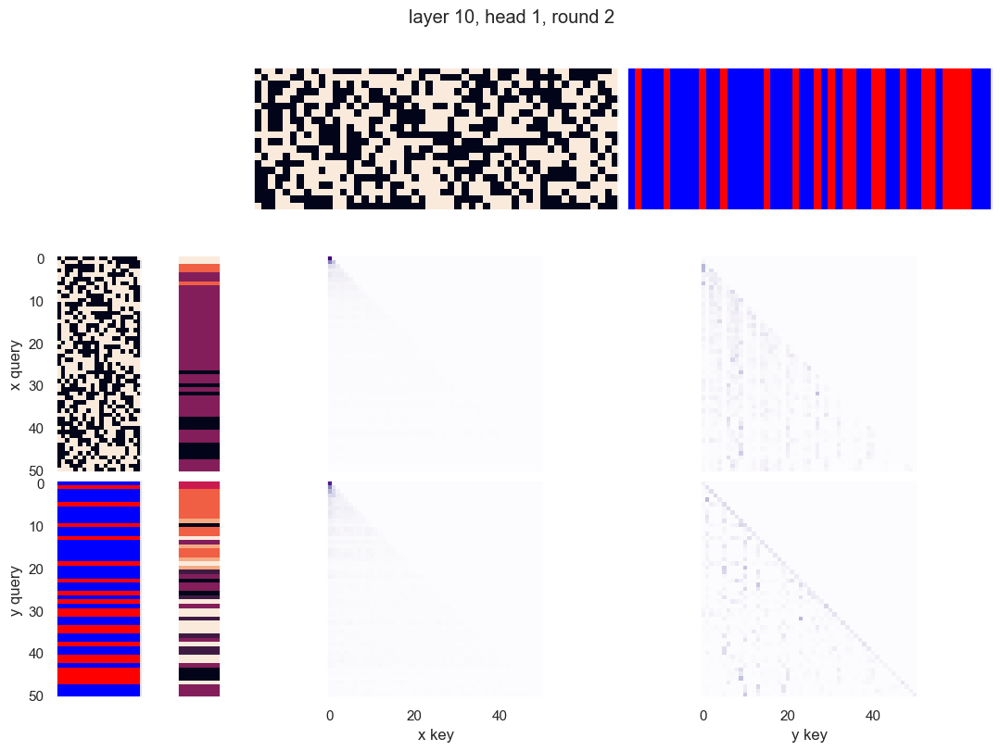

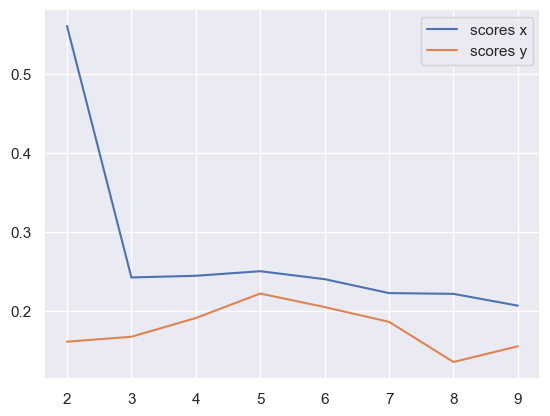

x query cluster:
SVM coefs: [ 0.25510214 -0.45922006  0.27299248  0.17551726 -0.21550769 -0.11984668
  0.07025472 -0.09277611  0.10832953  0.49035502 -0.00370583  0.20238302
 -0.11104543  0.23137986  0.04470073 -0.29457922 -0.46677635 -0.52135204
  0.57330948  0.62859878]
class1: [ 4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) -16: 0.64; (3) -11: 0.64; (4) -12: 0.62; (5) -18: 0.62; (6) +10: 0.62; (7) +6: 0.62; (8) +13: 0.57; (9) -0: 0.57; (10) -3: 0.57
(1) +2 AND -18: 0.51; (2) +6 AND +17: 0.49; (3) -3 AND -18: 0.47; (4) +13 AND -18: 0.47; (5) -11 AND +17: 0.47; (6) -3 AND -16: 0.47; (7) -0 AND +17: 0.45; (8) +5 AND +17: 0.45; (9) +17 AND -18: 0.45; (10) +6 AND -16: 0.45
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -12 OR -16: 0.94; (4) -2 OR -18: 0.94; (5) -3 OR -11: 0.94; (6) +10 OR +17: 0.91; (7) +6 OR +10: 0.91; (8) +10 OR -11: 0.91; (9) +7 OR +10: 0.91; (10) -16 OR

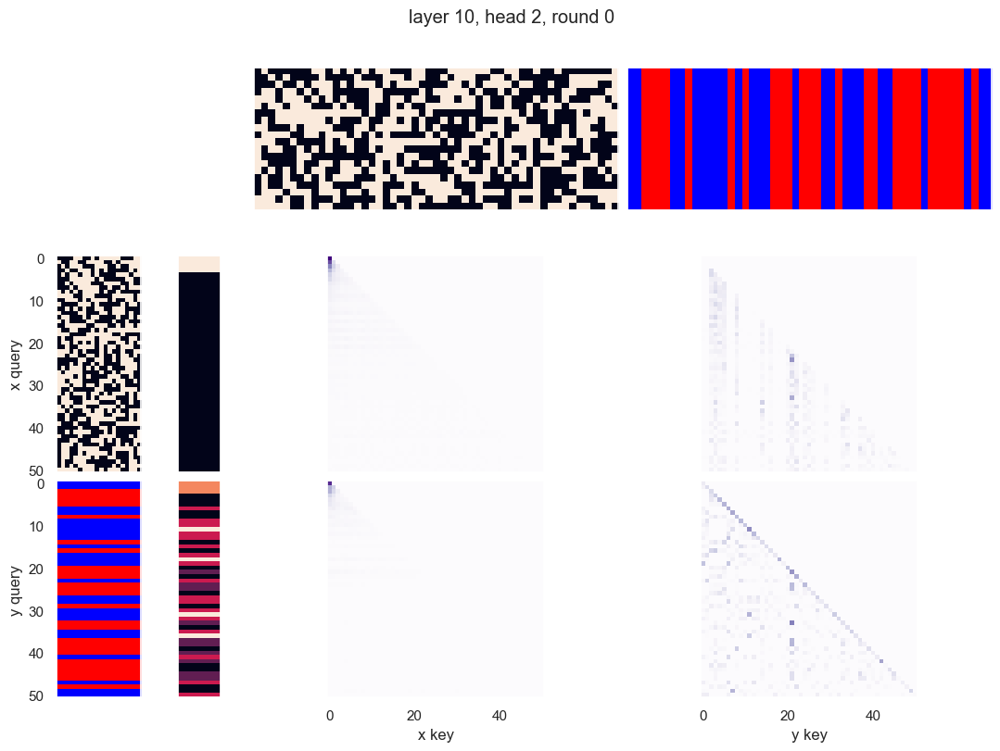

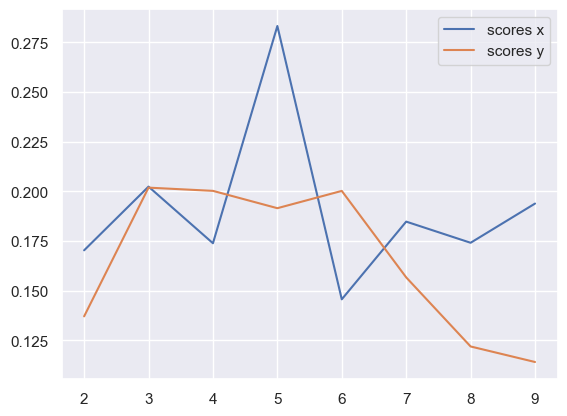

x query cluster:
SVM coefs for class 0: [-0.54682049 -0.26586521 -0.48512373  0.11446843 -0.89826726 -0.16682765
 -0.7399109   0.68971539  0.57762171 -0.18568846  0.18632375  0.99499239
  0.0322565  -0.11705108  0.72597278 -0.11514503  0.44720936 -0.14969897
  0.51657792  0.08981991]\class elements: [ 5 18 19 37 40 44]
(1) -19: 1.00; (2) +3: 1.00; (3) -5: 0.83; (4) +14: 0.83; (5) +0: 0.83; (6) -2: 0.67; (7) -1: 0.67; (8) -8: 0.67; (9) +13: 0.67; (10) -18: 0.67
(1) +3 AND -19: 1.00; (2) +14 AND -19: 0.83; (3) +0 AND -19: 0.83; (4) +3 AND +14: 0.83; (5) +3 AND -5: 0.83; (6) -5 AND -19: 0.83; (7) +0 AND +3: 0.83; (8) -5 AND +13: 0.67; (9) -12 AND -19: 0.67; (10) -1 AND -10: 0.67
(1) -4 OR +14: 1.00; (2) -2 OR -11: 1.00; (3) +5 OR -19: 1.00; (4) -5 OR -19: 1.00; (5) -5 OR +18: 1.00; (6) -2 OR +14: 1.00; (7) -5 OR +17: 1.00; (8) -5 OR +16: 1.00; (9) -2 OR +15: 1.00; (10) +18 OR -19: 1.00
{0.0: 0.8034197021085375}
SVM coefs for class 1: [-0.17643065  0.33044224 -0.24510607 -0.01229084  0.054

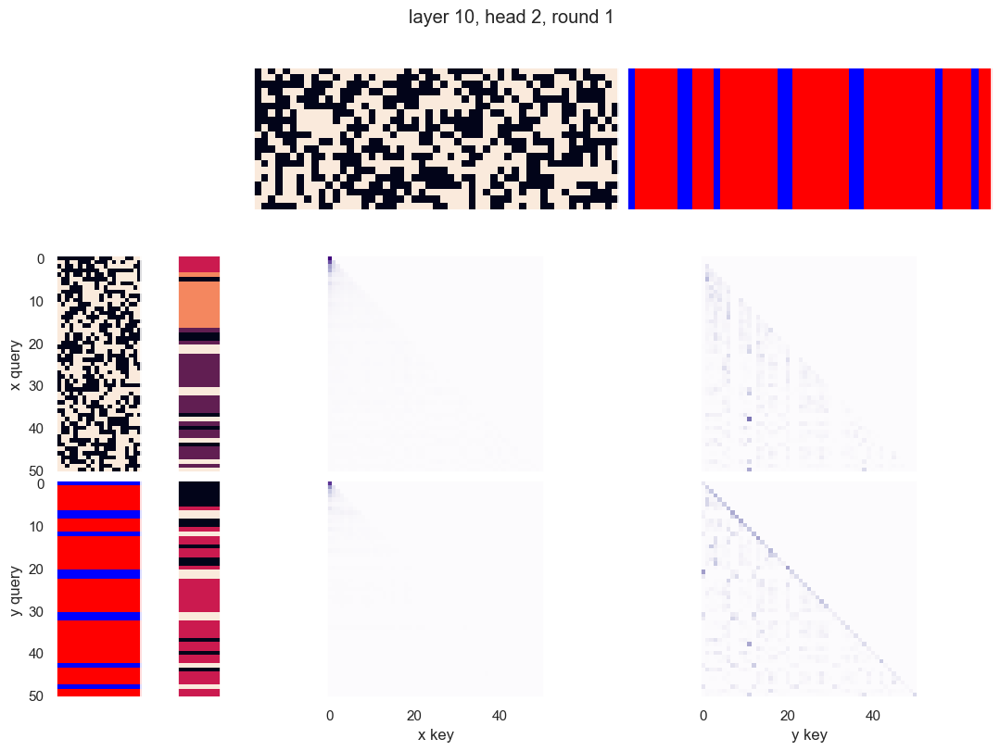

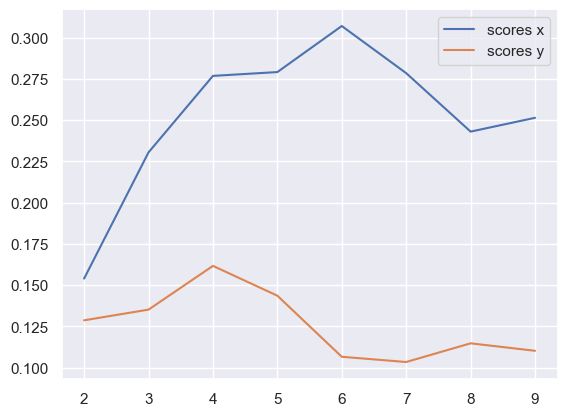

x query cluster:
SVM coefs for class 0: [ 0.09630409 -0.6378245   0.05537564  0.78913063 -0.28555259  0.56856424
 -0.90699485 -0.02440185  0.27810907 -0.01953761 -0.61119414 -0.09611228
 -0.0479264   0.08154009  0.22534833 -0.38399955 -0.16718734  0.238758
 -0.73172823  0.09656466]\class elements: [27 28 32 39 40 44 46]
(1) -1: 1.00; (2) +4: 0.86; (3) -9: 0.86; (4) +6: 0.86; (5) -7: 0.86; (6) -19: 0.71; (7) -5: 0.71; (8) +17: 0.71; (9) -0: 0.57; (10) -15: 0.57
(1) +6 AND -7: 0.86; (2) -1 AND +4: 0.86; (3) -1 AND +6: 0.86; (4) -1 AND -7: 0.86; (5) -1 AND -9: 0.86; (6) -5 AND +17: 0.71; (7) -9 AND -19: 0.71; (8) +4 AND -5: 0.71; (9) +4 AND +6: 0.71; (10) +4 AND -7: 0.71
(1) -0 OR -1: 1.00; (2) -1 OR +9: 1.00; (3) -7 OR -9: 1.00; (4) +4 OR -18: 1.00; (5) -1 OR -10: 1.00; (6) -1 OR +10: 1.00; (7) -7 OR +8: 1.00; (8) +13 OR +18: 1.00; (9) -1 OR -9: 1.00; (10) -1 OR -11: 1.00
{0.0: 0.8274018847878323}
SVM coefs for class 1: [-0.14998245  0.1001632  -0.13498683 -0.0848805  -0.09859756 -0.2547

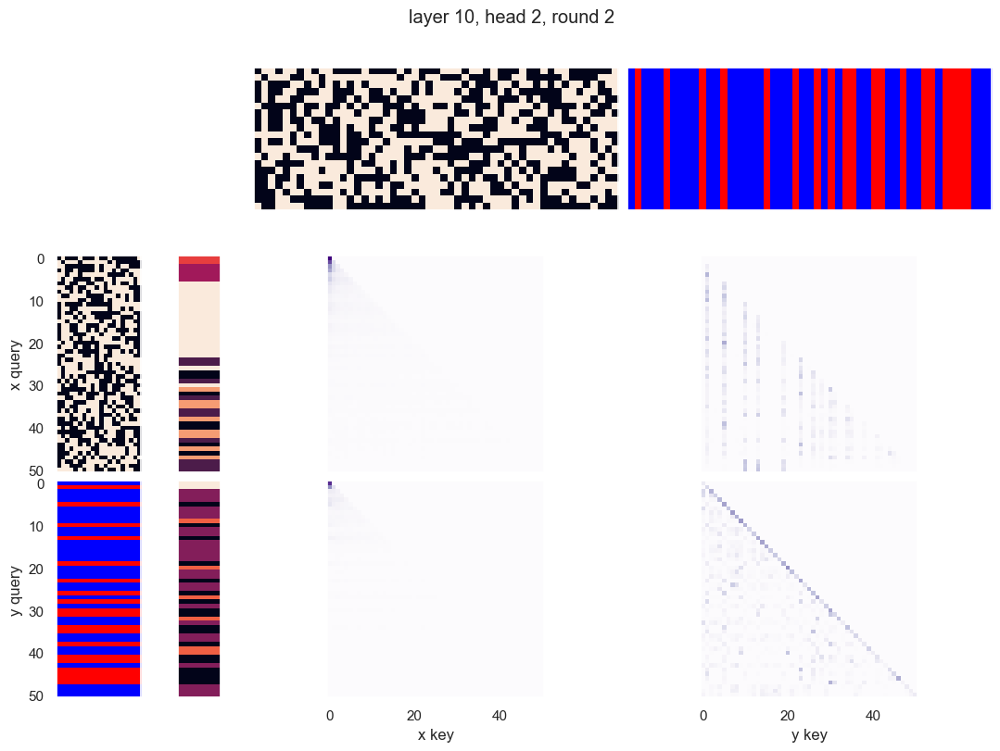

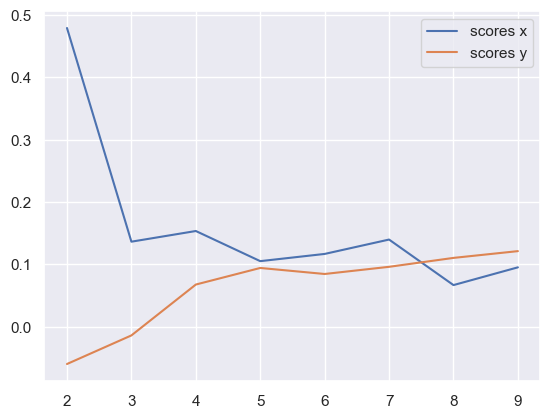

x query cluster:
SVM coefs: [ 0.1054392  -0.37930798  0.1640276   0.12083871 -0.24402407 -0.10237255
  0.08437242 -0.23418918  0.18886581  0.66353757 -0.0410938   0.5282075
 -0.17284396  0.06949218 -0.03458077 -0.08149973 -0.14972372 -0.68103966
  0.62447549  0.75904256]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17:

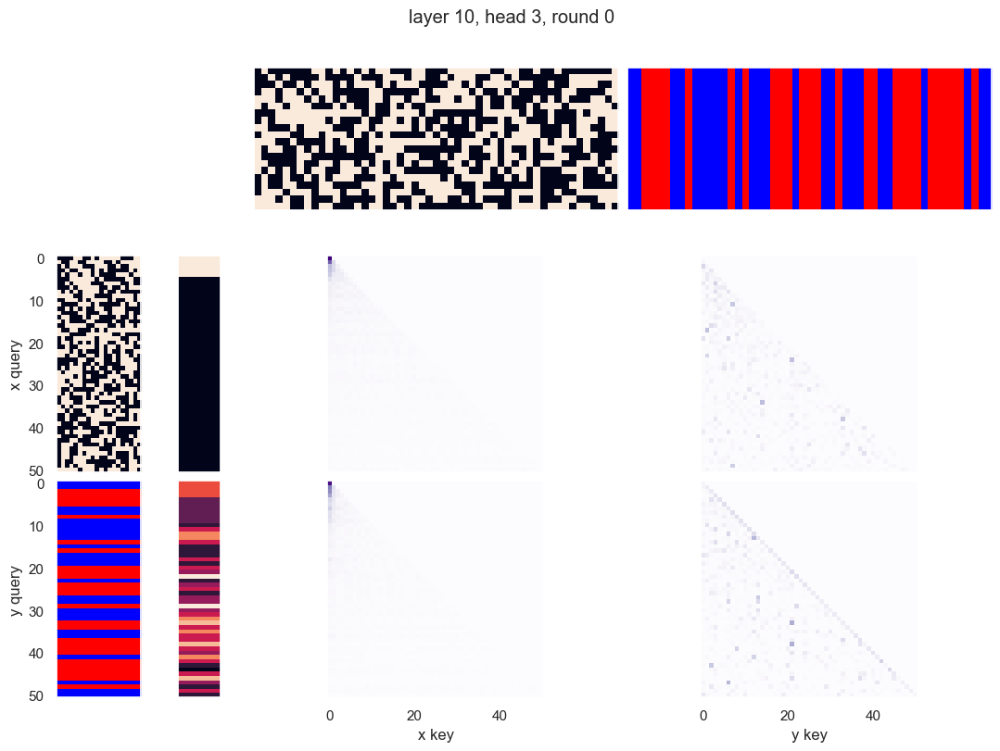

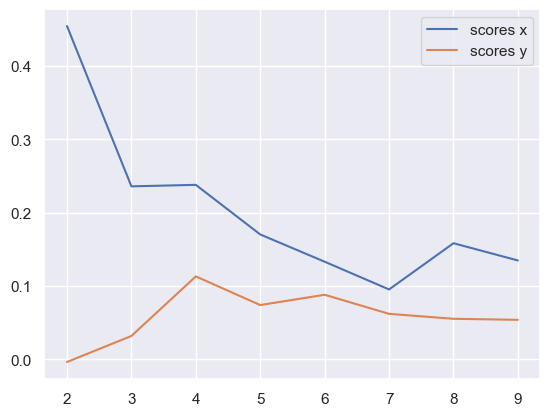

x query cluster:
SVM coefs: [ 0.46865343  0.57677499 -0.27721445 -0.21226483  0.11848009  0.05889447
 -0.00723669  0.45951885 -0.42596278 -0.43341196  0.08995767 -0.23646966
  0.24495516  0.49575197  0.29612866 -0.17306161 -0.11537209  0.67924498
 -0.21284533 -0.87186712]
class1: [0 1 2 3 4 5]
(1) -7: 1.00; (2) -2: 1.00; (3) +14: 0.83; (4) -5: 0.83; (5) +18: 0.83; (6) -19: 0.83; (7) +15: 0.67; (8) -10: 0.67; (9) +16: 0.67; (10) -9: 0.67
(1) -2 AND -7: 1.00; (2) -2 AND +18: 0.83; (3) -2 AND -5: 0.83; (4) -7 AND +14: 0.83; (5) -5 AND -7: 0.83; (6) -2 AND +14: 0.83; (7) -7 AND -19: 0.83; (8) -7 AND +18: 0.83; (9) -2 AND -19: 0.83; (10) +14 AND +16: 0.67
(1) -9 OR -11: 1.00; (2) -2 OR -12: 1.00; (3) -2 OR +12: 1.00; (4) -2 OR -13: 1.00; (5) -2 OR +13: 1.00; (6) -2 OR -14: 1.00; (7) -2 OR +14: 1.00; (8) -8 OR +14: 1.00; (9) -8 OR -13: 1.00; (10) -2 OR -15: 1.00
{0.0: 0.31370114752401906}
class2: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 3

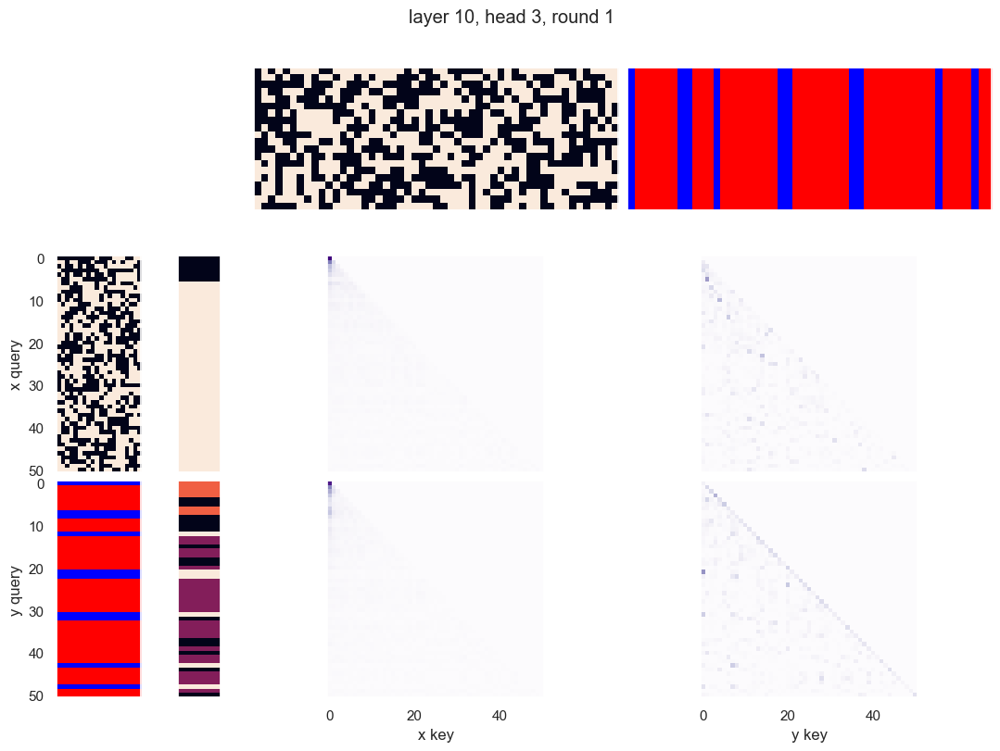

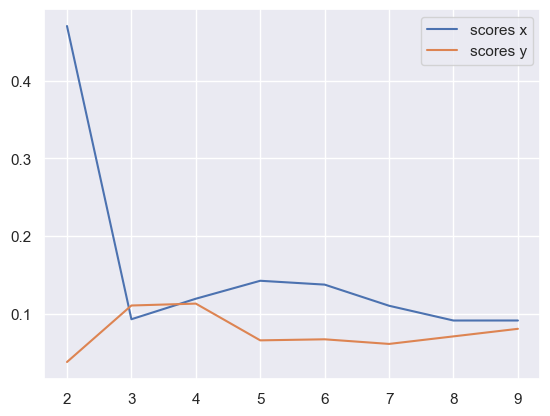

x query cluster:
SVM coefs: [-0.46865721 -0.5767806   0.27720937  0.21226239 -0.11847817 -0.0588934
  0.00723816 -0.45952039  0.42597114  0.43340819 -0.08995699  0.23647192
 -0.24495503 -0.49575305 -0.29612375  0.17306455  0.115366   -0.67924304
  0.21284189  0.8718675 ]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.89

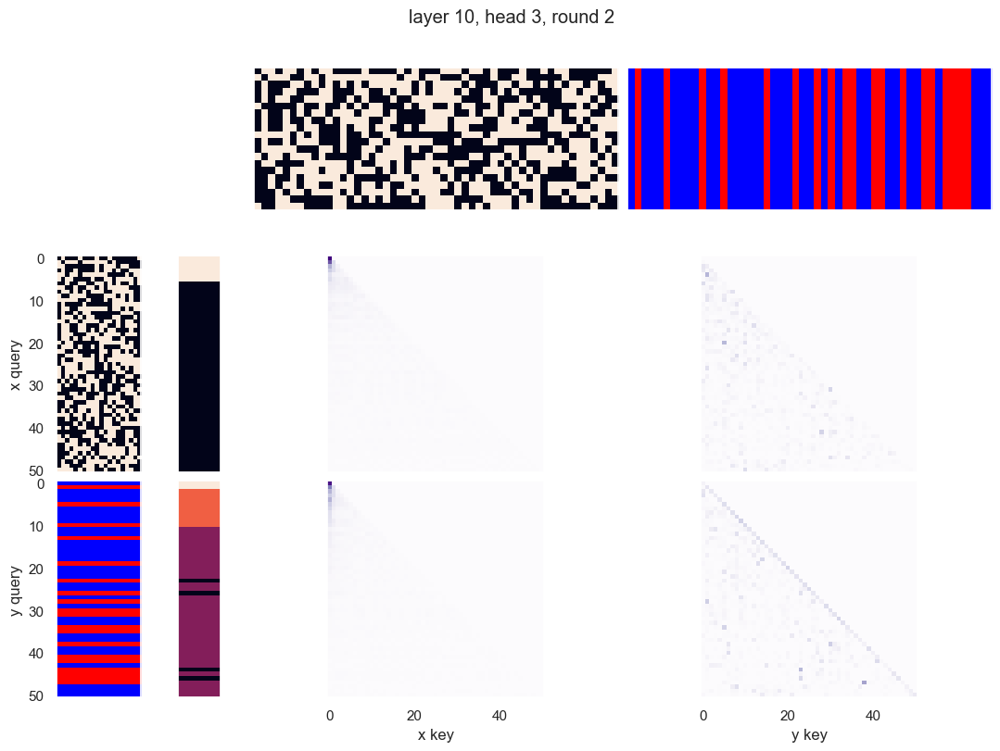

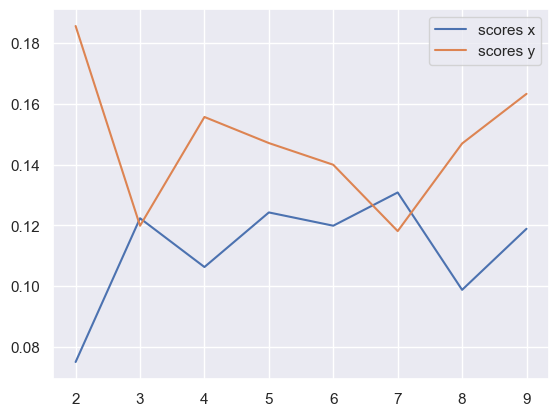

x query cluster:
SVM coefs for class 0: [-0.45267147  0.12398818 -0.50784035  0.12088039 -0.24729572  0.2369755
 -0.44680323 -0.00572978 -0.56291522  1.03627646  0.24636953  0.04163948
  0.71671618 -0.04485619  0.40931598  0.1380756   0.17607066  0.1477595
  0.04374848 -0.68015915]\class elements: [ 4  6 11 16 22 26 29 31 36 37 38 40 43 44 45 46 48]
(1) -0: 0.71; (2) -8: 0.71; (3) +17: 0.65; (4) -16: 0.65; (5) -13: 0.65; (6) -11: 0.65; (7) +10: 0.65; (8) +5: 0.65; (9) +9: 0.65; (10) -12: 0.59
(1) -8 AND -13: 0.59; (2) -13 AND +18: 0.59; (3) -11 AND -13: 0.53; (4) -8 AND +18: 0.53; (5) +9 AND +17: 0.53; (6) -0 AND +5: 0.53; (7) -11 AND +18: 0.53; (8) -0 AND -15: 0.53; (9) -2 AND +18: 0.47; (10) -0 AND +9: 0.47
(1) -3 OR -13: 1.00; (2) -8 OR +9: 1.00; (3) -8 OR +19: 1.00; (4) -13 OR -18: 1.00; (5) -0 OR -13: 1.00; (6) -0 OR +18: 1.00; (7) -0 OR -8: 1.00; (8) +5 OR -11: 1.00; (9) -0 OR +10: 0.94; (10) +9 OR -16: 0.94
{7.0: 0.17933341188355004, 11.0: 0.009693817126035644, 8.0: 0.2092637256

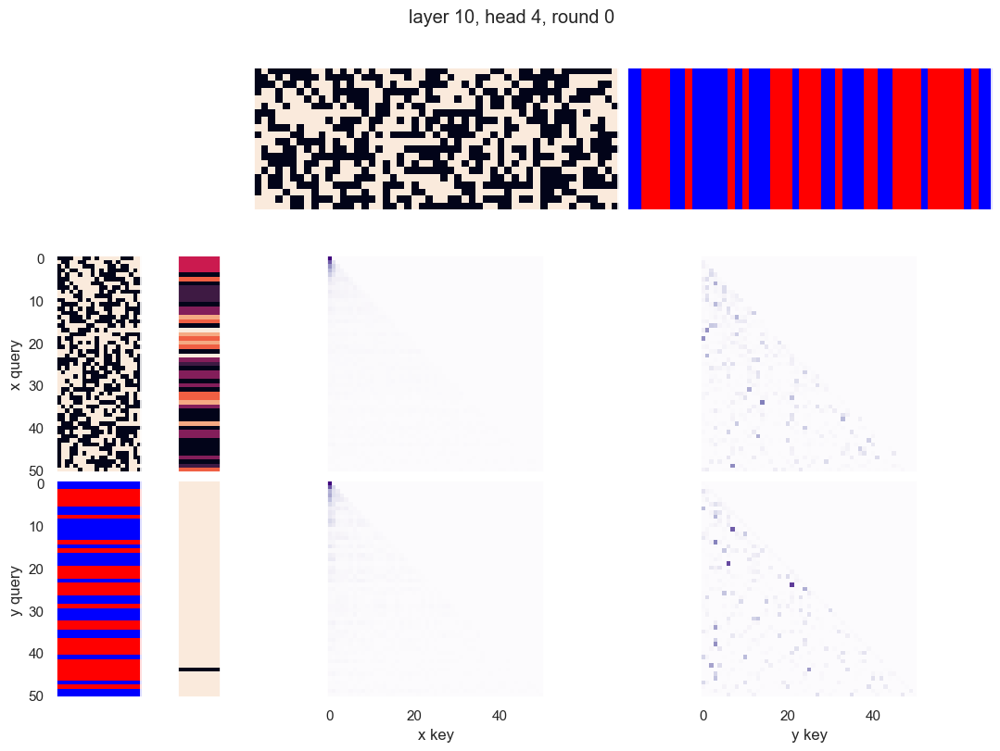

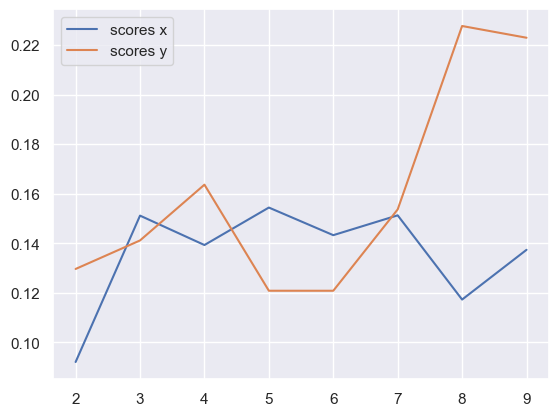

x query cluster:
SVM coefs for class 0: [ 0.02944994 -0.13922015  0.23366748 -0.09381005 -0.64463315 -0.09942751
 -0.27894911  0.21483471  0.29791125  0.07033668  0.14236664  0.3891495
 -0.10013238 -0.2789306   0.3737479   0.12047804  0.19281451 -0.30806835
  0.37144348  0.06134991]\class elements: [18 37 44]
(1) -11: 1.00; (2) -19: 1.00; (3) +14: 1.00; (4) -8: 1.00; (5) +3: 1.00; (6) -5: 1.00; (7) +9: 0.67; (8) +13: 0.67; (9) -10: 0.67; (10) +7: 0.67
(1) +3 AND -5: 1.00; (2) +3 AND -8: 1.00; (3) -5 AND +14: 1.00; (4) +3 AND -11: 1.00; (5) -5 AND -11: 1.00; (6) -5 AND -8: 1.00; (7) +3 AND +14: 1.00; (8) -11 AND -19: 1.00; (9) -5 AND -19: 1.00; (10) -8 AND -11: 1.00
(1) +3 OR -6: 1.00; (2) +3 OR +9: 1.00; (3) +3 OR -9: 1.00; (4) -8 OR -11: 1.00; (5) +3 OR +8: 1.00; (6) +3 OR -8: 1.00; (7) -5 OR -17: 1.00; (8) -3 OR -8: 1.00; (9) +3 OR +7: 1.00; (10) +3 OR -7: 1.00
{0.0: 0.8165626540464929}
SVM coefs for class 1: [-0.25522003  0.43869125 -0.19572293 -0.34434838 -0.07034658 -0.18405089
  

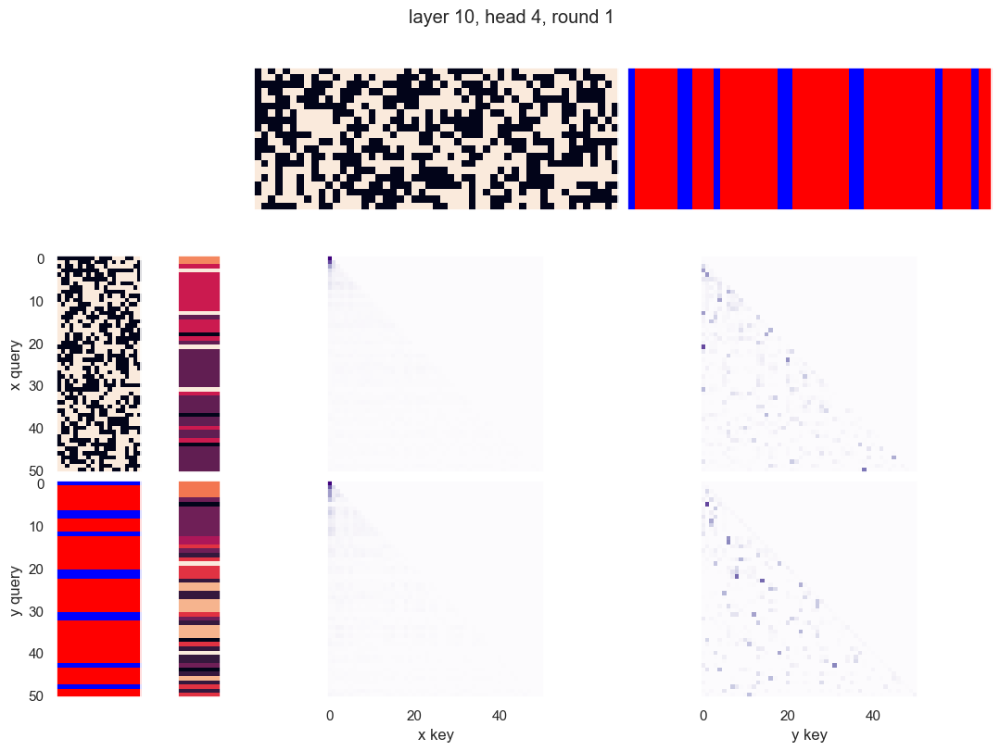

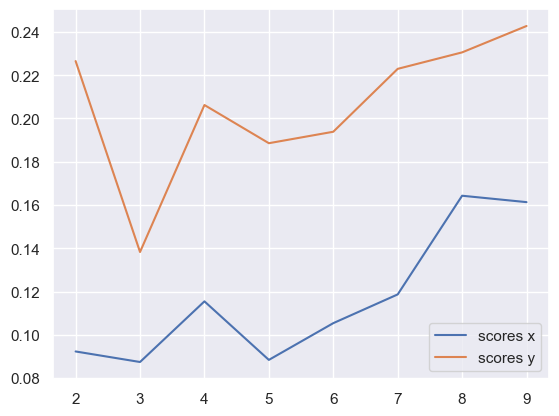

x query cluster:
SVM coefs for class 0: [-0.01626083  0.16314146  0.00785901  0.04991697 -0.21611795  0.12535486
 -0.09759548  0.15164918  0.31250754  0.18465948  0.52364921 -0.0944683
 -0.02147301 -0.186774    0.34620407 -0.50259644  0.00232734 -0.1143321
  0.03758733 -0.13479629]\class elements: [44 46]
(1) -0: 1.00; (2) +11: 1.00; (3) +10: 1.00; (4) -19: 1.00; (5) -9: 1.00; (6) +8: 1.00; (7) -7: 1.00; (8) -5: 1.00; (9) +4: 1.00; (10) +6: 1.00
(1) -0 AND -1: 1.00; (2) +3 AND +8: 1.00; (3) +3 AND -9: 1.00; (4) +10 AND +17: 1.00; (5) +3 AND +10: 1.00; (6) +3 AND +11: 1.00; (7) +3 AND +13: 1.00; (8) +10 AND +13: 1.00; (9) +3 AND +17: 1.00; (10) +10 AND +11: 1.00
(1) -0 OR -1: 1.00; (2) -5 OR -12: 1.00; (3) +5 OR +11: 1.00; (4) +11 OR +13: 1.00; (5) -5 OR +11: 1.00; (6) -5 OR -11: 1.00; (7) +5 OR +10: 1.00; (8) -5 OR +10: 1.00; (9) -5 OR -10: 1.00; (10) +5 OR -9: 1.00
{0.0: 0.8270297835879319}
SVM coefs for class 1: [-0.42240165  0.46986128 -0.3475642   0.45133695  0.12791096 -0.29147956

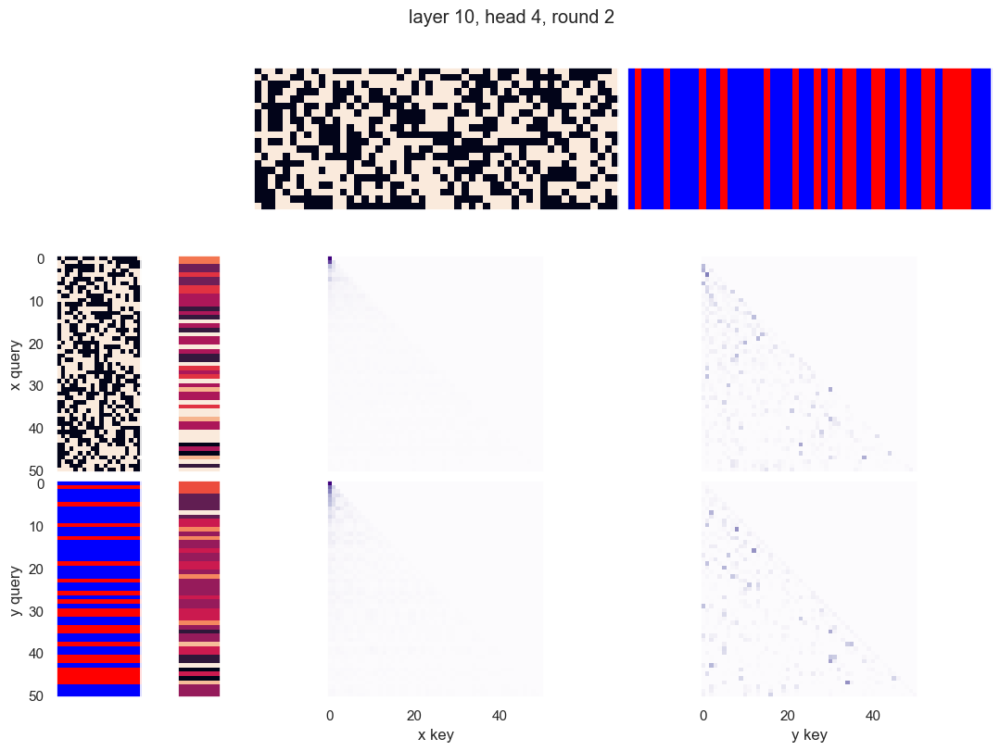

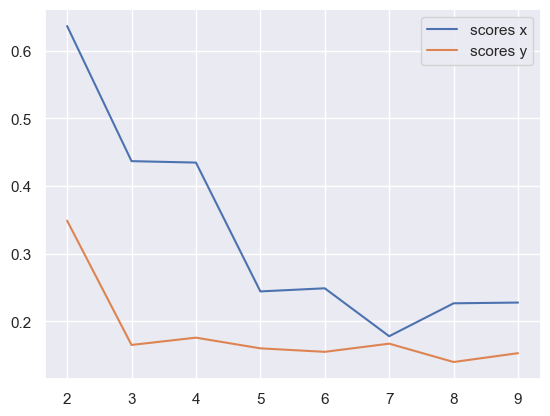

x query cluster:
SVM coefs: [-0.46865387 -0.57677454  0.27721012  0.21226313 -0.11848254 -0.05889471
  0.0072355  -0.45951845  0.42596615  0.43341316 -0.08996048  0.23647203
 -0.24495202 -0.49575043 -0.29612919  0.17306     0.11536529 -0.67924313
  0.21284258  0.87186993]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10:

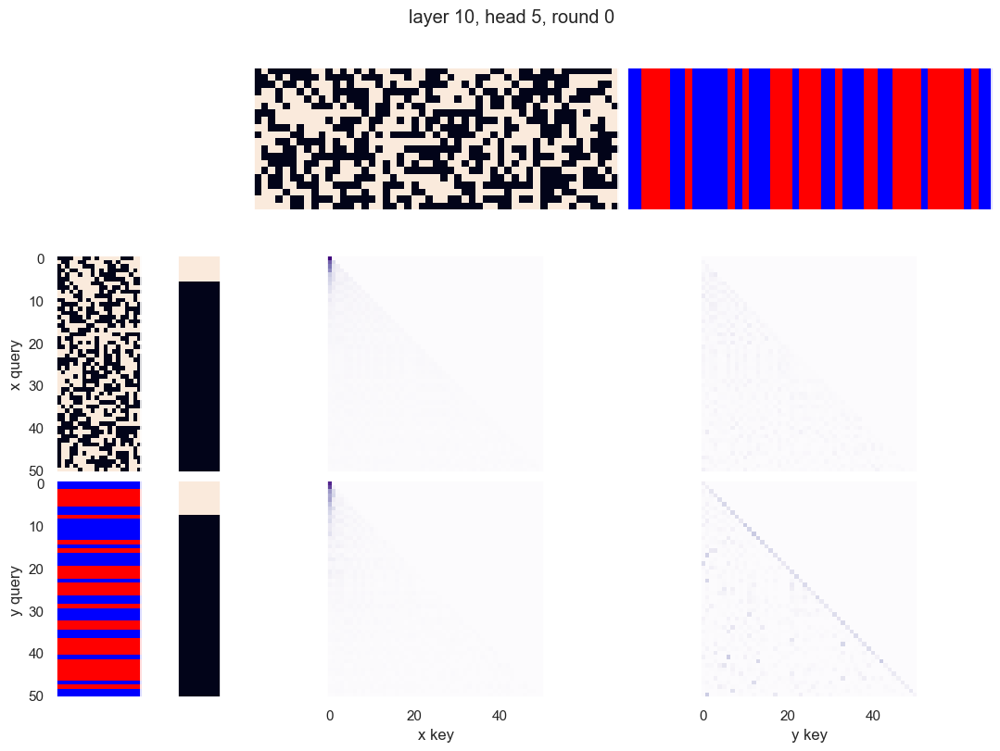

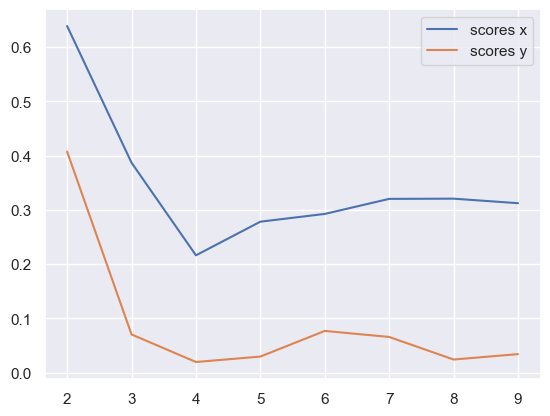

x query cluster:
SVM coefs: [-0.46865427 -0.57678381  0.27721111  0.21226622 -0.11848011 -0.05889409
  0.00723407 -0.45952756  0.42596862  0.43340758 -0.08995799  0.23647008
 -0.24495472 -0.49575495 -0.29612817  0.17306125  0.11536702 -0.67924115
  0.21284455  0.87186718]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +19: 0.62; (4) +13: 0.62; (5) -16: 0.60; (6) -12: 0.60; (7) +6: 0.58; (8) +9: 0.58; (9) -3: 0.58; (10) -4: 0.56
(1) -3 AND +19: 0.44; (2) +0 AND +9: 0.44; (3) +0 AND -12: 0.42; (4) +13 AND +14: 0.42; (5) +5 AND -16: 0.42; (6) +9 AND +13: 0.42; (7) -12 AND +19: 0.42; (8) -12 AND -15: 0.42; (9) +0 AND -16: 0.42; (10) -2 AND -12: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +0 OR +11: 0.89; (6) +0 OR +17: 0.89; (7) +14 OR +17: 0.89; (8) +7 OR -12: 0.89; (9) +14 OR -16: 0.89; (10) +6 OR -16: 0.89

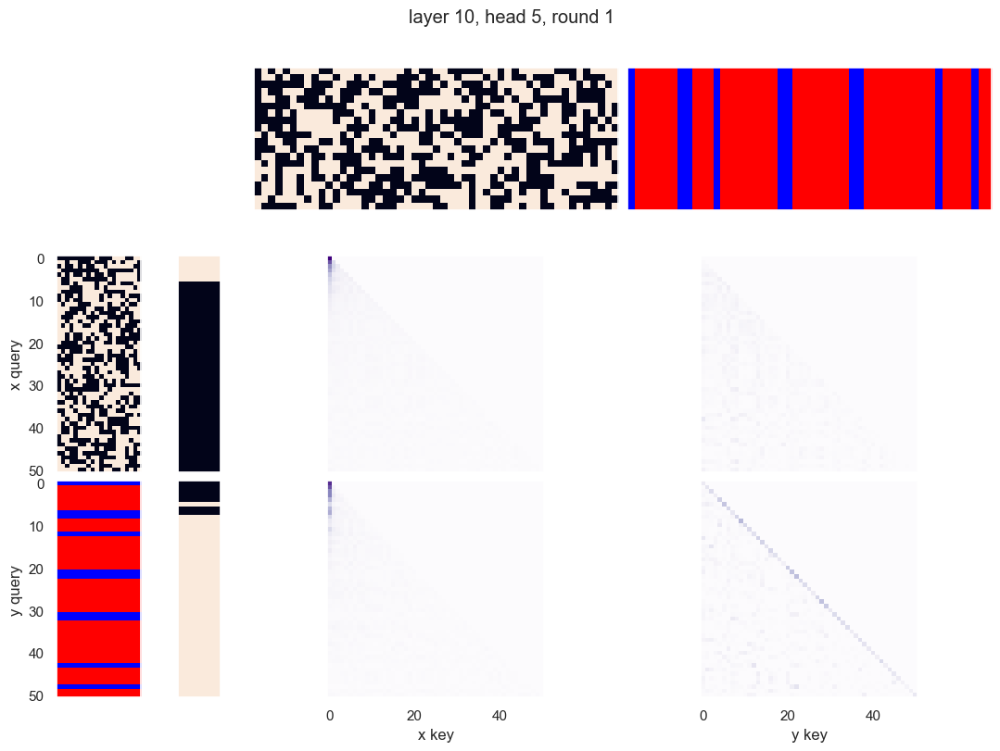

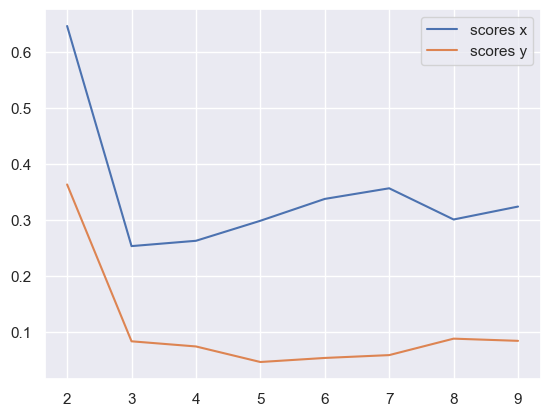

x query cluster:
SVM coefs: [-0.46865405 -0.57678143  0.27720433  0.2122688  -0.11847955 -0.05889413
  0.00723329 -0.45952272  0.42597207  0.43341194 -0.08995621  0.23646951
 -0.24495371 -0.49575414 -0.29612722  0.17305981  0.11536942 -0.6792422
  0.21284169  0.87186477]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.89

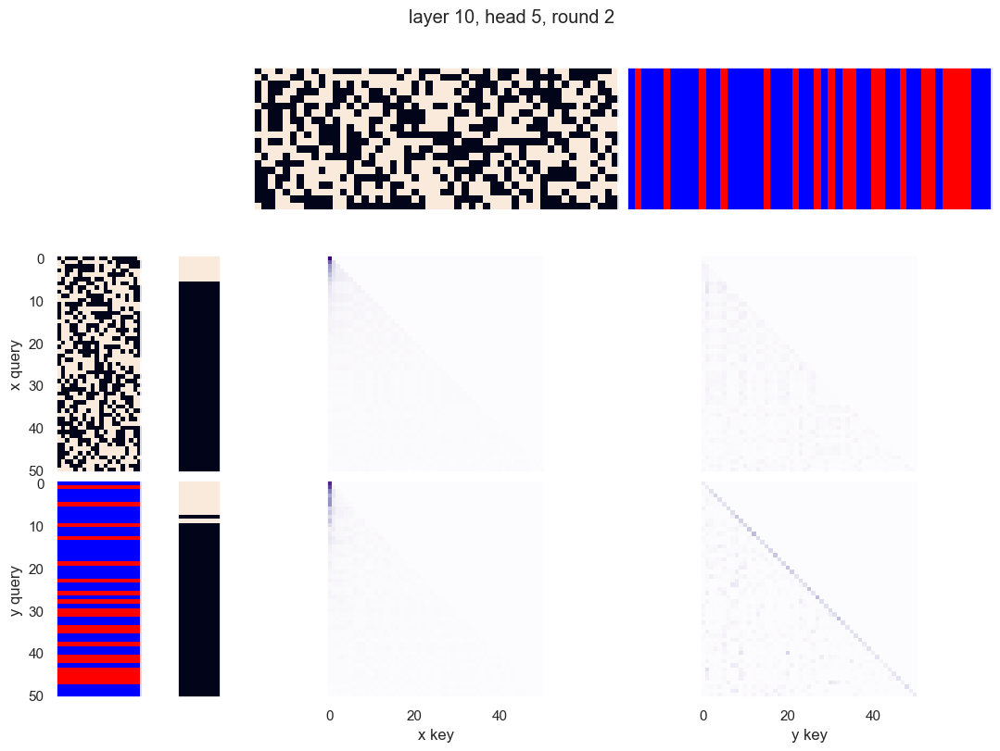

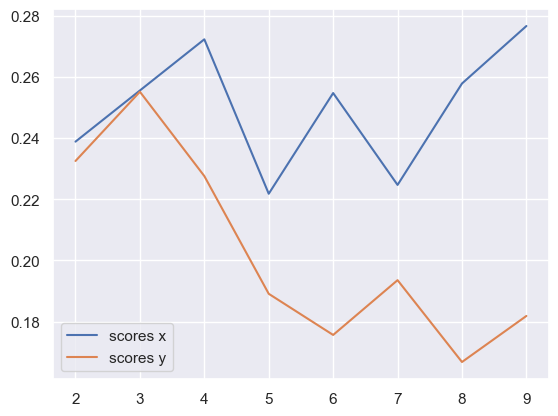

x query cluster:
SVM coefs for class 0: [-0.51319583 -0.25612252 -0.82704805  0.4270096  -1.7627376  -0.36325966
 -0.55260635 -0.39955993 -0.43106079  0.39389793  0.04321961 -0.21543264
  0.03216184  0.72469828 -0.08943039 -0.31257618 -0.17882235  0.01578429
 -0.66279679 -0.20899208]\class elements: [24 25 28 31 33 34 36 37 38 40 42 44 45 46 49]
(1) -4: 1.00; (2) +17: 0.87; (3) -0: 0.73; (4) +10: 0.73; (5) -18: 0.67; (6) -16: 0.67; (7) +13: 0.67; (8) -12: 0.67; (9) -11: 0.67; (10) +5: 0.67
(1) -4 AND +17: 0.87; (2) -0 AND -4: 0.73; (3) -4 AND +10: 0.73; (4) -4 AND -16: 0.67; (5) -4 AND +5: 0.67; (6) -4 AND -12: 0.67; (7) -4 AND -11: 0.67; (8) -4 AND -18: 0.67; (9) -4 AND +13: 0.67; (10) -11 AND +17: 0.60
(1) +2 OR -4: 1.00; (2) +3 OR +13: 1.00; (3) +5 OR +17: 1.00; (4) -3 OR -11: 1.00; (5) +3 OR -4: 1.00; (6) -3 OR -4: 1.00; (7) -6 OR +17: 1.00; (8) +7 OR +10: 1.00; (9) -7 OR +17: 1.00; (10) -8 OR +17: 1.00
{7.0: 0.1931922491658042, 11.0: 0.013548444769139663, 8.0: 0.14517945300900312,

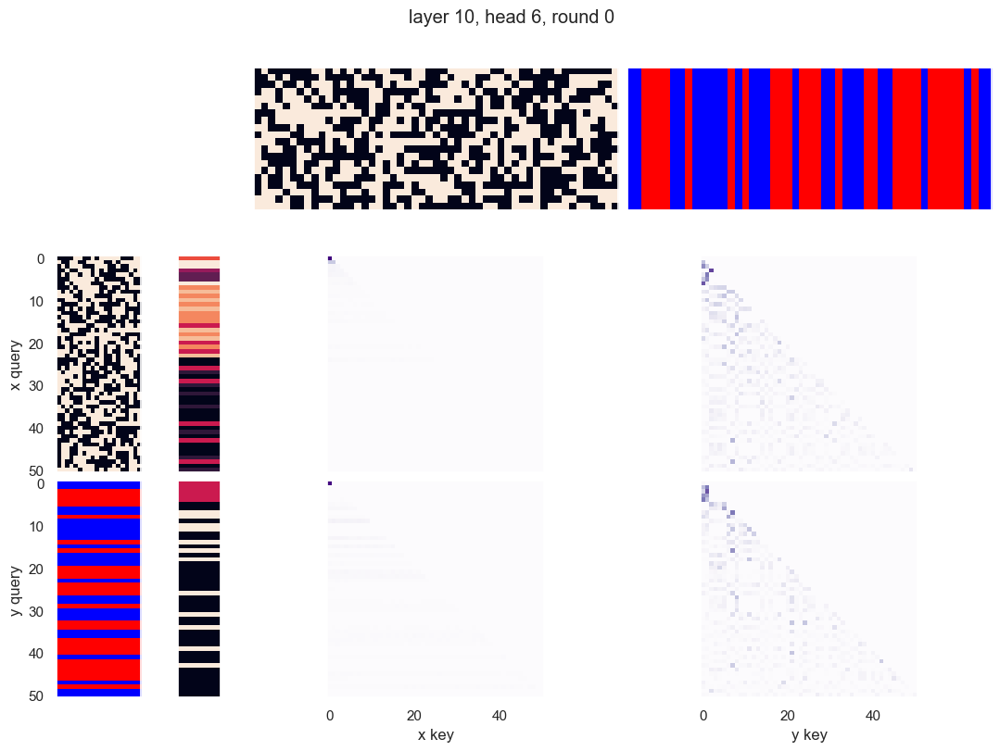

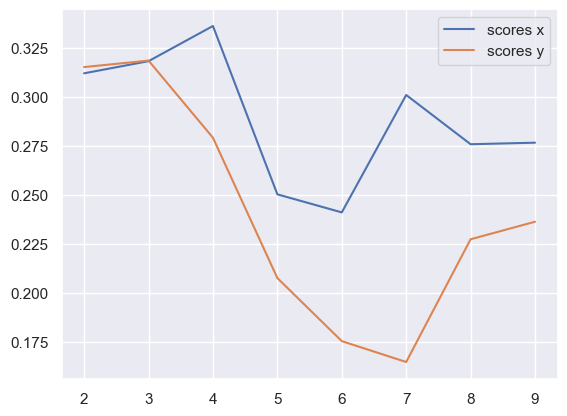

x query cluster:
SVM coefs for class 0: [-0.11347471 -0.3734576   0.75898425  0.50839478 -0.75573276  0.03764957
  0.46063354 -0.63176316  0.24426765 -0.88504976 -0.14590132 -1.02328884
 -0.69308279  0.3985075  -0.4050252   0.60635565 -0.38839211  0.59593107
  0.60117131 -0.17378684]\class elements: [ 9 11 14 15 17 23 24 25 26 27 28 32 35 37 38 44 49 50]
(1) +4: 1.00; (2) +13: 0.72; (3) +0: 0.67; (4) +9: 0.61; (5) -15: 0.61; (6) +11: 0.61; (7) +6: 0.61; (8) -18: 0.56; (9) -17: 0.56; (10) -16: 0.56
(1) +4 AND +13: 0.72; (2) +0 AND +4: 0.67; (3) +4 AND -15: 0.61; (4) +4 AND +11: 0.61; (5) +4 AND +9: 0.61; (6) +4 AND +6: 0.61; (7) +4 AND +14: 0.56; (8) +4 AND -18: 0.56; (9) +4 AND +19: 0.56; (10) +4 AND -12: 0.56
(1) -1 OR +4: 1.00; (2) +4 OR +11: 1.00; (3) +4 OR -12: 1.00; (4) +4 OR +12: 1.00; (5) +1 OR +4: 1.00; (6) +4 OR -13: 1.00; (7) +4 OR +13: 1.00; (8) +4 OR -14: 1.00; (9) +4 OR +14: 1.00; (10) +4 OR -11: 1.00
{0.0: 0.9521786392228709}
SVM coefs for class 1: [ 0.0588547   0.1059396

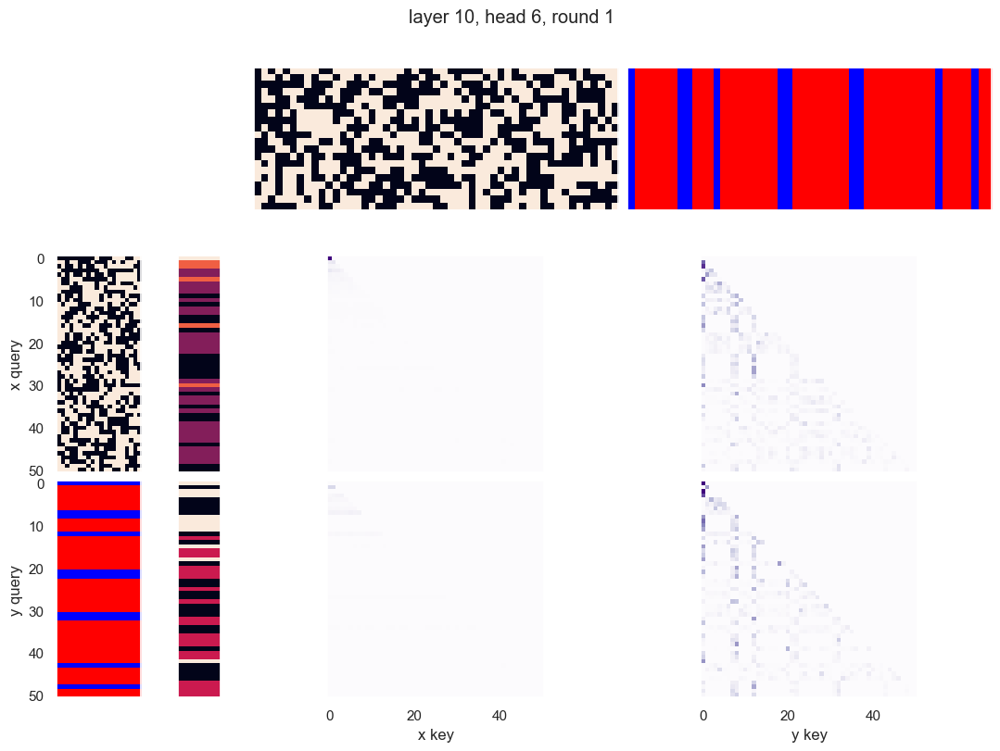

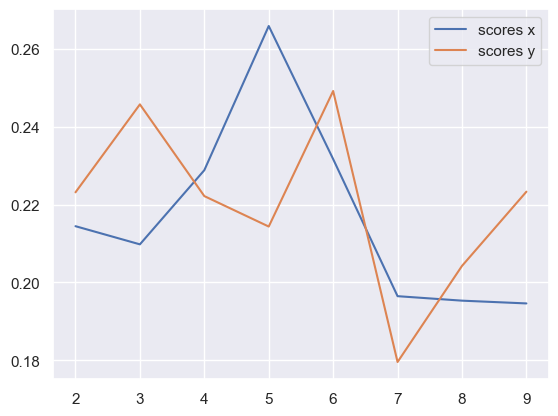

x query cluster:
SVM coefs for class 0: [-0.11230889 -0.09279898  0.08463889 -0.16449985 -0.07496409 -0.0912421
 -0.03901279 -0.30465193  0.13697352 -0.04130914 -0.12255689 -0.18464822
 -0.06725055  0.37614991  0.12249117 -0.24257872 -0.09482114  0.13127577
  0.28428484 -0.21923312]\class elements: [ 0 10 13 15 19 22 23 24 25 26 27 28 32 33 37 39 43 44 45 46 48]
(1) +4: 0.95; (2) +16: 0.67; (3) -5: 0.67; (4) +13: 0.62; (5) -19: 0.62; (6) -9: 0.62; (7) +6: 0.62; (8) +17: 0.62; (9) +18: 0.62; (10) -12: 0.57
(1) +4 AND +16: 0.67; (2) +4 AND -5: 0.67; (3) +4 AND -19: 0.62; (4) +4 AND +18: 0.62; (5) +4 AND +17: 0.62; (6) +4 AND +6: 0.62; (7) +4 AND +13: 0.62; (8) +4 AND -9: 0.62; (9) +4 AND +15: 0.57; (10) +4 AND -12: 0.57
(1) +4 OR -7: 1.00; (2) +4 OR -16: 1.00; (3) +4 OR -18: 1.00; (4) +4 OR -15: 1.00; (5) +4 OR -14: 1.00; (6) +4 OR -13: 1.00; (7) +4 OR +19: 1.00; (8) -3 OR +4: 1.00; (9) +4 OR +12: 1.00; (10) +4 OR -11: 1.00
{0.0: 0.9418582068837318}
SVM coefs for class 1: [ 0.48032197  0

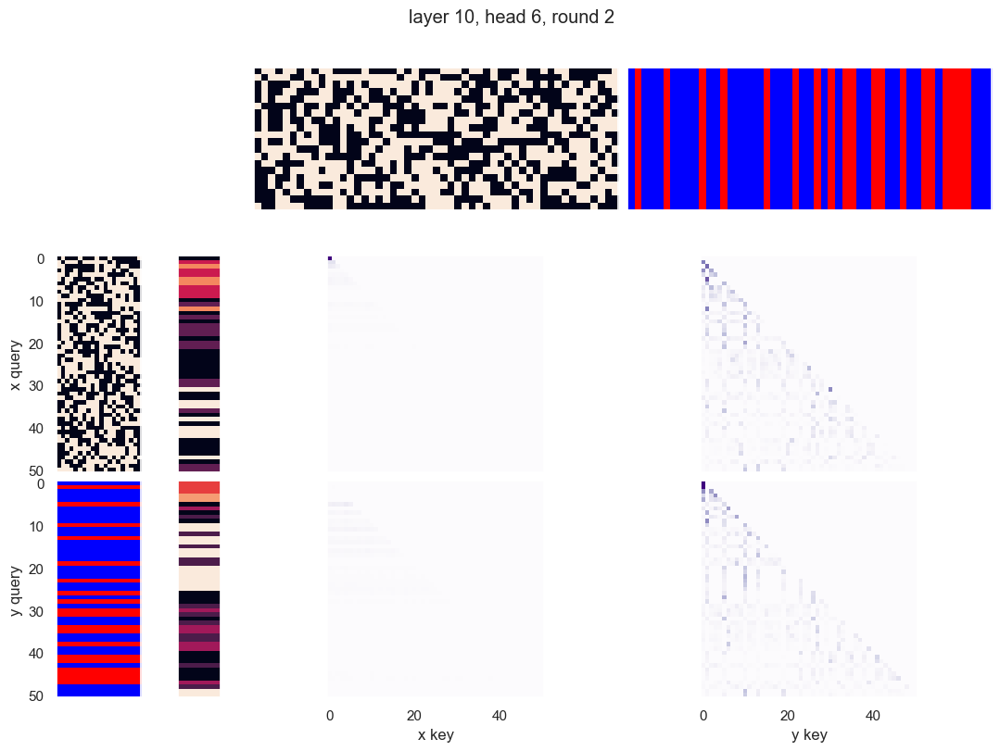

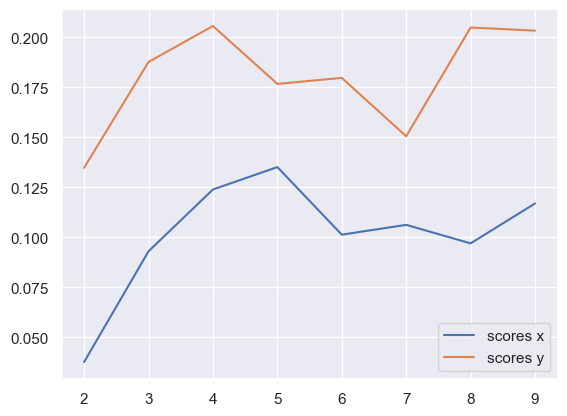

x query cluster:
SVM coefs for class 0: [ 0.1016526   0.17897213 -0.45617552 -0.34077516 -0.21820276  0.09073704
 -0.0846803  -0.16382463 -0.08399761 -0.06435064 -0.04155476 -0.0644729
  0.13751208 -0.08928597  0.164333    0.08029778  0.5940344   0.1900629
  0.04693829 -0.13668142]\class elements: [15 16 18 20 21 22 24 25 26 27 29 31 36 39 42 43 44 45 48 49]
(1) -11: 0.75; (2) +10: 0.70; (3) +17: 0.70; (4) -7: 0.65; (5) -13: 0.65; (6) -12: 0.60; (7) +15: 0.60; (8) +5: 0.60; (9) -14: 0.55; (10) -19: 0.55
(1) -11 AND +17: 0.55; (2) -7 AND +10: 0.55; (3) -13 AND +18: 0.50; (4) +5 AND +17: 0.50; (5) +10 AND -13: 0.50; (6) -11 AND +18: 0.50; (7) -12 AND +17: 0.50; (8) -11 AND +16: 0.50; (9) -11 AND -12: 0.50; (10) -7 AND -13: 0.50
(1) +10 OR -11: 1.00; (2) -7 OR -11: 0.95; (3) -4 OR -13: 0.95; (4) -11 OR -18: 0.95; (5) +5 OR -13: 0.95; (6) +10 OR -12: 0.95; (7) -4 OR -7: 0.95; (8) -13 OR -14: 0.95; (9) -11 OR -13: 0.95; (10) -13 OR -18: 0.95
{7.0: 0.12063158568216749, 11.0: 0.04006869283930

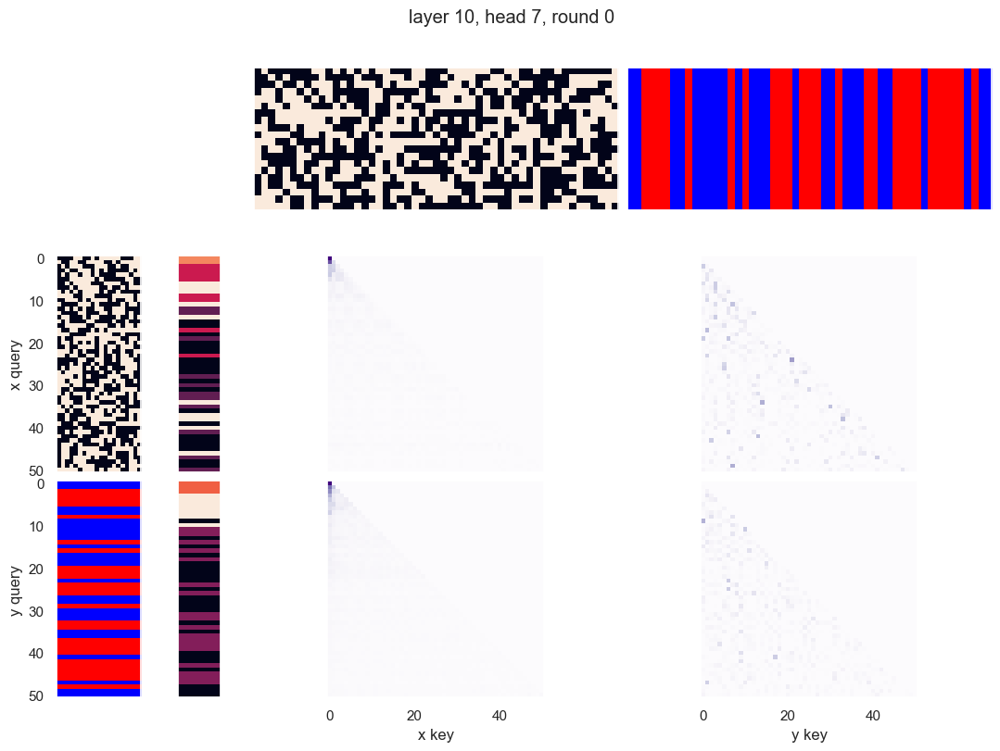

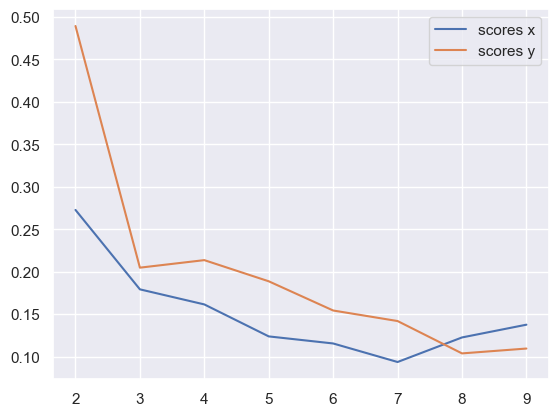

x query cluster:
SVM coefs: [-0.11382808  0.0965157  -0.18096776 -0.13935598 -0.0864486   0.03797222
  0.27036911 -0.2168508  -0.09493133 -0.01406586  0.04803641 -0.15034555
 -0.11379716  0.13704398 -0.10136679 -0.02887441  0.17050862  0.00158304
 -0.14754097 -0.16315441]
class1: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50]
(1) +14: 0.68; (2) +0: 0.64; (3) -2: 0.58; (4) +13: 0.58; (5) -12: 0.58; (6) +9: 0.56; (7) -16: 0.56; (8) +6: 0.56; (9) +19: 0.56; (10) -3: 0.56
(1) +9 AND +13: 0.42; (2) +13 AND +14: 0.42; (3) -2 AND -12: 0.40; (4) +0 AND -15: 0.40; (5) +0 AND +9: 0.40; (6) -4 AND +14: 0.40; (7) -2 AND +14: 0.40; (8) +0 AND -16: 0.40; (9) +0 AND -12: 0.40; (10) -3 AND +19: 0.40
(1) +0 OR +14: 0.94; (2) +14 OR -15: 0.90; (3) +14 OR -16: 0.90; (4) -12 OR +13: 0.90; (5) +13 OR +18: 0.88; (6) -2 OR +13: 0.88; (7) +10 OR +14: 0.88; (8) -2 OR +19: 0.88; (9) -12 OR +14: 0.88; (10) 

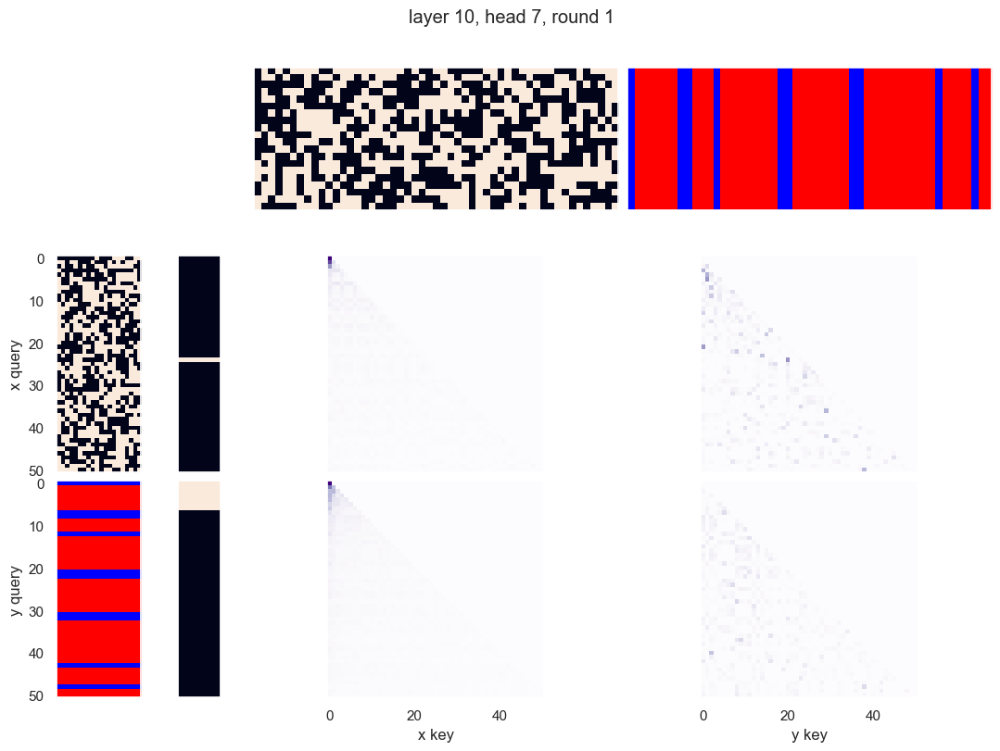

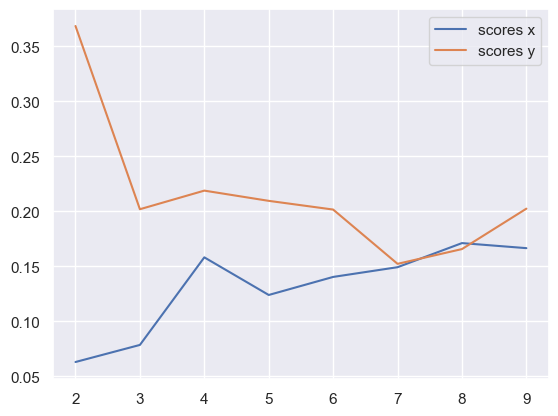

x query cluster:
SVM coefs for class 0: [ 0.48668945 -0.127467   -0.01661077  0.76785388 -0.46714257  0.3713011
 -0.38495048  0.15570372 -0.15550567  0.31003723 -0.34702686  0.14681938
 -0.07284787  0.31387603  0.32023983 -0.11632343 -0.20377382  0.13996992
 -0.09926487 -0.06205766]\class elements: [28 32 44]
(1) +17: 1.00; (2) -19: 1.00; (3) -1: 1.00; (4) -9: 1.00; (5) -12: 1.00; (6) -15: 1.00; (7) +4: 1.00; (8) -5: 1.00; (9) +10: 1.00; (10) +16: 1.00
(1) -1 AND -15: 1.00; (2) -5 AND -12: 1.00; (3) -5 AND +10: 1.00; (4) -9 AND -19: 1.00; (5) -5 AND -9: 1.00; (6) -12 AND -19: 1.00; (7) -15 AND -19: 1.00; (8) -9 AND +17: 1.00; (9) +10 AND -12: 1.00; (10) +4 AND +17: 1.00
(1) -0 OR -1: 1.00; (2) -5 OR +14: 1.00; (3) -5 OR -14: 1.00; (4) -12 OR +19: 1.00; (5) -5 OR +13: 1.00; (6) -5 OR -13: 1.00; (7) +12 OR -19: 1.00; (8) +5 OR -12: 1.00; (9) -5 OR +12: 1.00; (10) -5 OR -12: 1.00
{0.0: 0.7868976980656347}
SVM coefs for class 1: [ 0.14097517 -0.18015816 -0.17609404 -0.62500852  0.02047981 

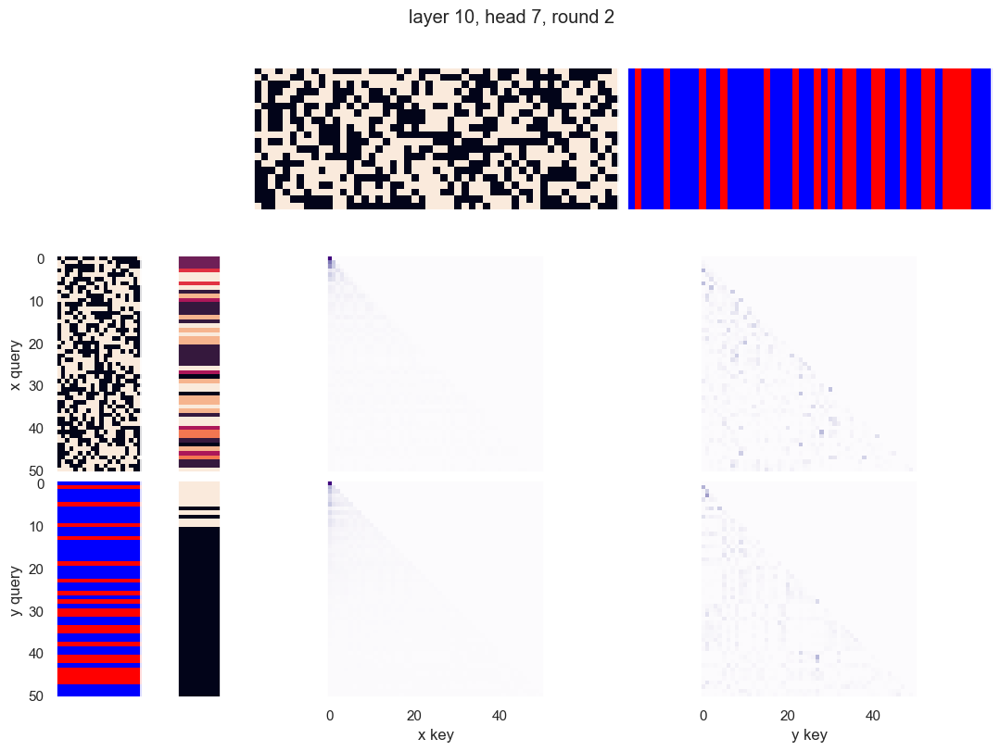

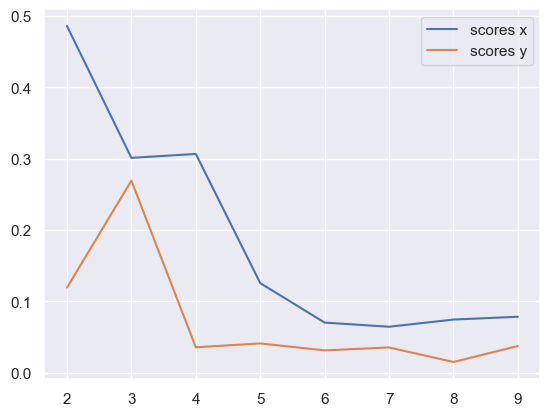

x query cluster:
SVM coefs: [-2.32156802e-01 -4.20214347e-01  7.42615603e-01  4.45014653e-01
  2.98554472e-01  3.58288261e-01  1.10684630e-01  1.84915241e-01
  8.03325408e-01  1.45550701e-01 -4.82856258e-01  6.11609966e-01
  2.99705699e-01 -6.64192058e-01 -3.04094688e-02 -3.44543164e-05
 -1.14822095e-01 -5.54176763e-01  5.13597896e-01  6.00325071e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.70; (2) +10: 0.65; (3) -16: 0.65; (4) -12: 0.63; (5) -18: 0.63; (6) -11: 0.63; (7) +13: 0.60; (8) +2: 0.60; (9) -3: 0.60; (10) +6: 0.58
(1) +2 AND -18: 0.53; (2) -3 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) +13 AND -18: 0.49; (5) +6 AND +17: 0.47; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.44; (8) -16 AND -18: 0.44; (9) -12 AND -18: 0.44; (10) +17 AND -18: 0.44
(1) -11 OR -18: 0.95; (2) -11 OR -16: 0.95; (3) +10 OR -11: 0.93; (4) -2 OR -18: 0.93; (5) +10 OR +17: 0.93; (6) -16 OR +17: 0.93; (7)

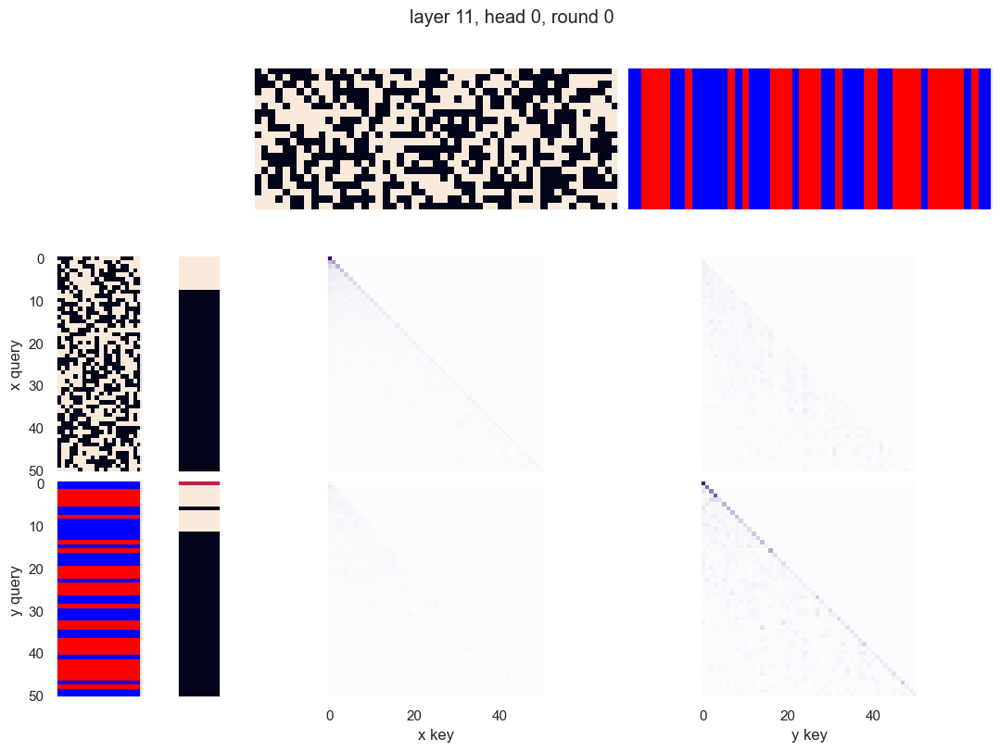

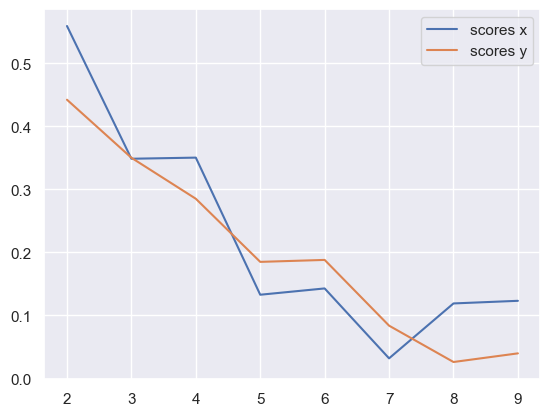

x query cluster:
SVM coefs: [-0.46865682 -0.57677989  0.27721107  0.21226272 -0.11848044 -0.05889207
  0.00723635 -0.45952051  0.42596685  0.43341056 -0.08996143  0.2364714
 -0.24495442 -0.49575307 -0.29612145  0.17306095  0.115368   -0.67923826
  0.21283936  0.87186629]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.64; (2) +14: 0.64; (3) +19: 0.62; (4) +13: 0.62; (5) -16: 0.60; (6) -12: 0.60; (7) +6: 0.58; (8) +9: 0.58; (9) -3: 0.58; (10) -4: 0.56
(1) -3 AND +19: 0.44; (2) +0 AND +9: 0.44; (3) +0 AND -12: 0.42; (4) +13 AND +14: 0.42; (5) +5 AND -16: 0.42; (6) +9 AND +13: 0.42; (7) -12 AND +19: 0.42; (8) -12 AND -15: 0.42; (9) +0 AND -16: 0.42; (10) -2 AND -12: 0.40
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) +0 OR +14: 0.91; (4) -16 OR +19: 0.91; (5) +0 OR +11: 0.89; (6) +0 OR +17: 0.89; (7) +14 OR +17: 0.89; (8) +7 OR -12: 0.89; (9) +14 OR -16: 0.89; (10) +6 OR -16: 0.89


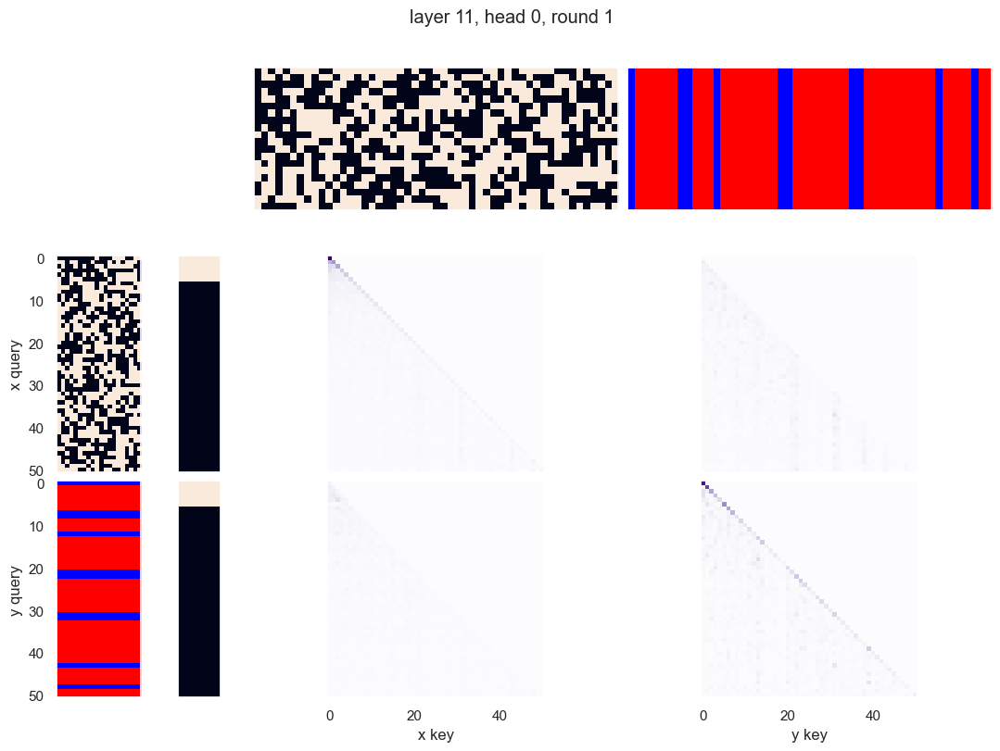

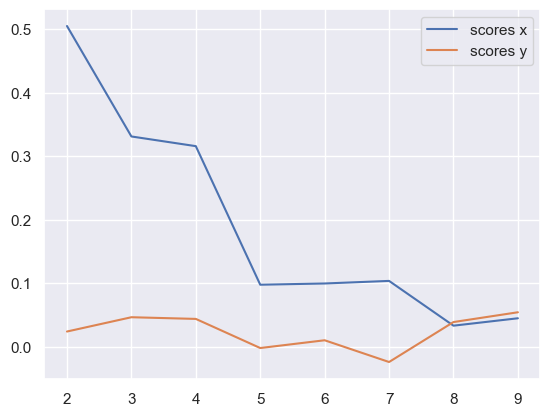

x query cluster:
SVM coefs: [-0.46865519 -0.5767805   0.27720855  0.21226576 -0.11847991 -0.05889404
  0.00723476 -0.45951563  0.42596805  0.43341302 -0.08995773  0.23646932
 -0.24495413 -0.49575139 -0.29612618  0.17305789  0.11536774 -0.67924241
  0.21284205  0.87186924]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.8

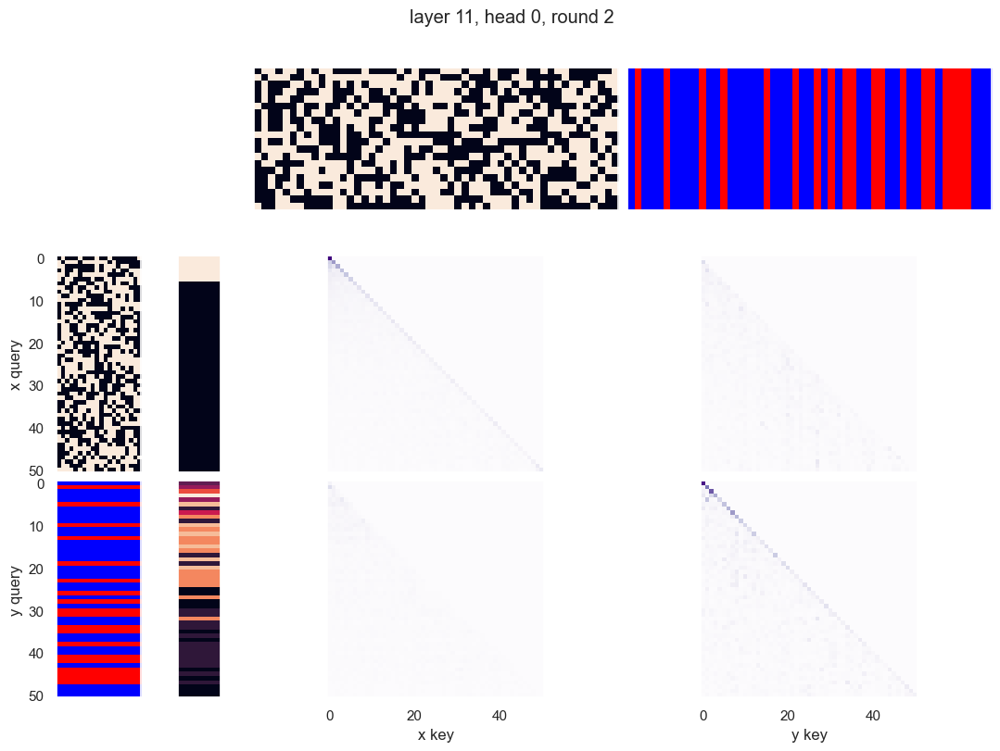

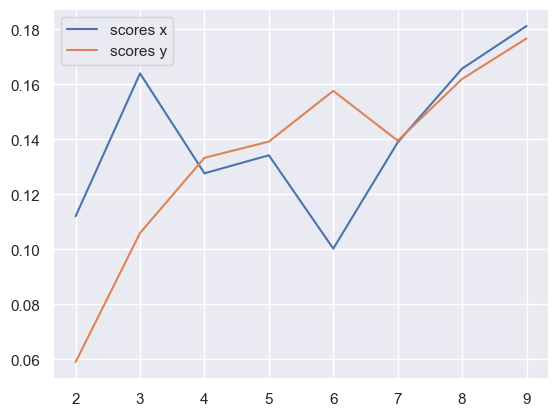

x query cluster:
SVM coefs for class 0: [-0.11615973  0.09785187 -0.2549806   0.40671652 -0.4278154   0.3164347
  0.17331345  0.07808858  0.27395602 -0.10816768 -0.03917552  0.15438646
 -0.13543733 -0.04045376  0.00830136  0.04420012  0.00320674 -0.24908506
  0.07522842  0.11369479]\class elements: [44 49]
(1) -0: 1.00; (2) +18: 1.00; (3) -11: 1.00; (4) +1: 1.00; (5) -12: 1.00; (6) +3: 1.00; (7) -4: 1.00; (8) -9: 1.00; (9) +5: 1.00; (10) -13: 0.50
(1) -0 AND -11: 1.00; (2) -0 AND -12: 1.00; (3) +1 AND +5: 1.00; (4) -4 AND +18: 1.00; (5) -4 AND -9: 1.00; (6) -12 AND +18: 1.00; (7) +5 AND -11: 1.00; (8) -4 AND -11: 1.00; (9) -4 AND -12: 1.00; (10) +1 AND -12: 1.00
(1) -0 OR -1: 1.00; (2) -6 OR +17: 1.00; (3) +6 OR +16: 1.00; (4) -6 OR -16: 1.00; (5) +6 OR -15: 1.00; (6) -6 OR +15: 1.00; (7) +6 OR +14: 1.00; (8) -6 OR -14: 1.00; (9) +6 OR -13: 1.00; (10) -6 OR +13: 1.00
{7.0: 0.03125976149021881, 11.0: 0.0269364768446394, 8.0: 0.0665084840848067, 13.0: 0.30657803823123686, 12.0: 0.1677914

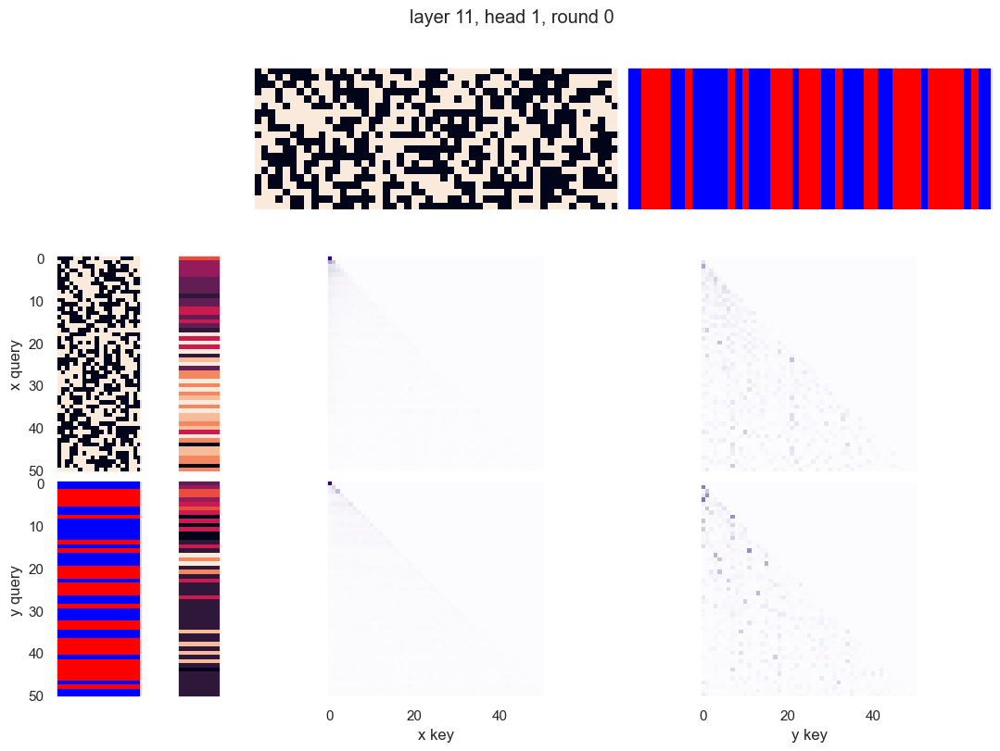

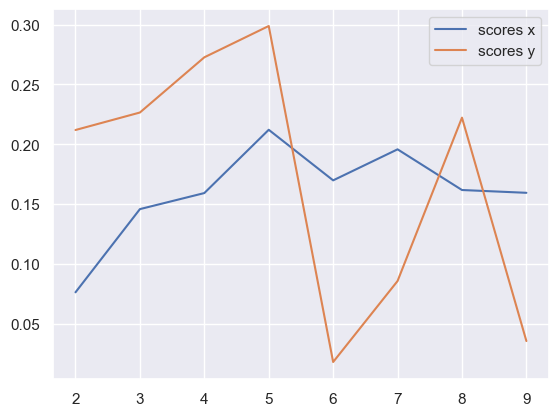

x query cluster:
SVM coefs for class 0: [ 0.05975131  0.08629506  0.26381657  0.61638388 -1.02420158 -0.39193391
 -0.18479961  0.4155521   0.40899156 -0.01650752  0.11983615  1.0162348
 -0.25490965  0.58316859  0.47947492  0.01945049  0.3007092  -0.61193854
 -0.00853443  0.56640655]\class elements: [ 9 10 18 19 37 40 44]
(1) -5: 1.00; (2) -19: 1.00; (3) +13: 0.86; (4) +14: 0.86; (5) +3: 0.86; (6) -12: 0.71; (7) +7: 0.71; (8) -10: 0.71; (9) +9: 0.71; (10) -17: 0.71
(1) -5 AND -19: 1.00; (2) +3 AND -5: 0.86; (3) -5 AND +13: 0.86; (4) +14 AND -19: 0.86; (5) +3 AND -19: 0.86; (6) +13 AND -19: 0.86; (7) -5 AND +14: 0.86; (8) -12 AND -18: 0.71; (9) +7 AND -19: 0.71; (10) -2 AND +13: 0.71
(1) -12 OR -19: 1.00; (2) -3 OR -5: 1.00; (3) +15 OR -18: 1.00; (4) +3 OR -5: 1.00; (5) +9 OR -12: 1.00; (6) +3 OR +6: 1.00; (7) +3 OR +7: 1.00; (8) +3 OR +8: 1.00; (9) +3 OR +9: 1.00; (10) +3 OR -10: 1.00
{0.0: 0.7474249321294502}
SVM coefs for class 1: [ 0.16607928  0.35096402 -0.2635275  -0.19753381  0.30

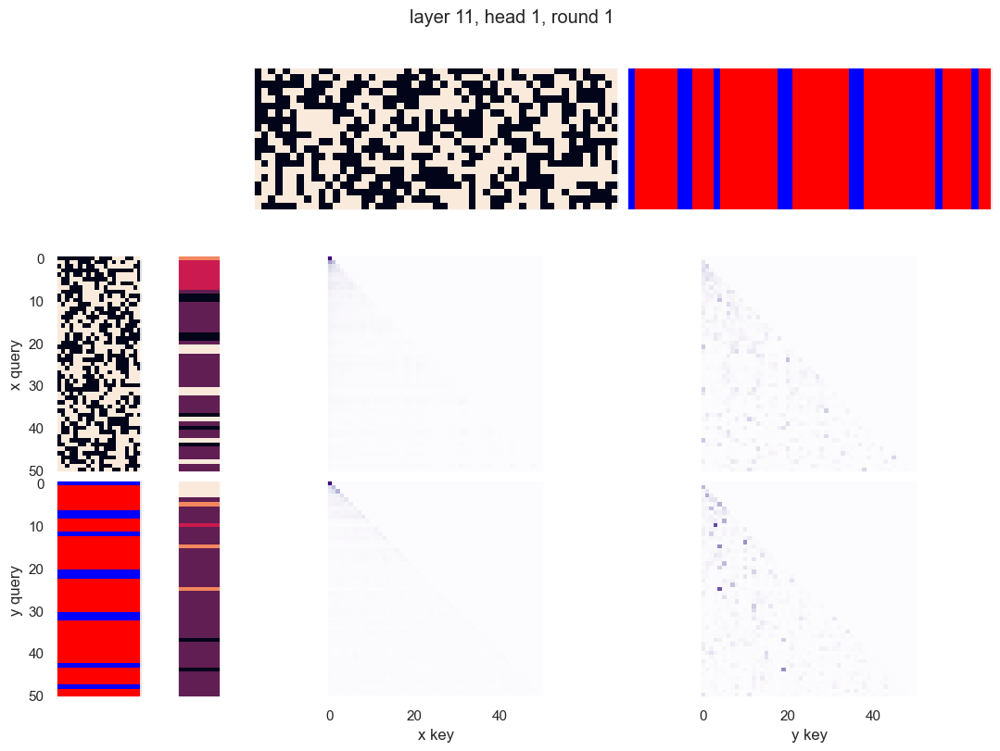

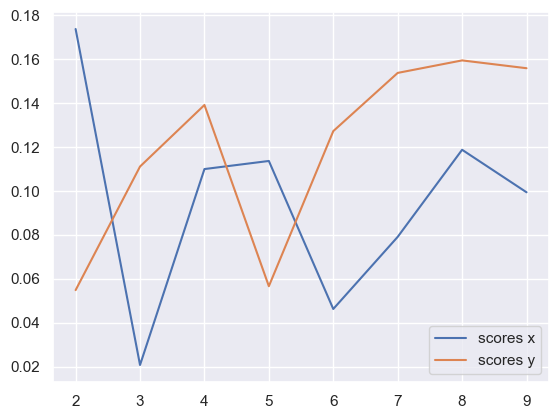

x query cluster:
SVM coefs: [-0.03572399 -0.04280297  0.03109691 -0.23934809  0.30185607 -0.14473716
  0.00270026 -0.09226613 -0.14555337  0.06175365 -0.02883232 -0.04208394
 -0.013101    0.14418144 -0.16348754  0.15122784 -0.0834903   0.30878709
 -0.09516465 -0.04678785]
class1: [44]
(1) -0: 1.00; (2) +8: 1.00; (3) -14: 1.00; (4) -15: 1.00; (5) -7: 1.00; (6) +6: 1.00; (7) -12: 1.00; (8) +10: 1.00; (9) -5: 1.00; (10) +4: 1.00
(1) -0 AND -1: 1.00; (2) +11 AND +17: 1.00; (3) +2 AND -5: 1.00; (4) -5 AND +6: 1.00; (5) +11 AND +16: 1.00; (6) +2 AND +6: 1.00; (7) +8 AND +10: 1.00; (8) +4 AND -19: 1.00; (9) +2 AND -7: 1.00; (10) +11 AND -15: 1.00
(1) -0 OR -1: 1.00; (2) +5 OR -19: 1.00; (3) -12 OR -16: 1.00; (4) -6 OR -7: 1.00; (5) +6 OR -7: 1.00; (6) +6 OR +7: 1.00; (7) +12 OR -15: 1.00; (8) -5 OR +19: 1.00; (9) -6 OR +8: 1.00; (10) +6 OR +8: 1.00
{0.0: 0.8915087583518471}
class2: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36

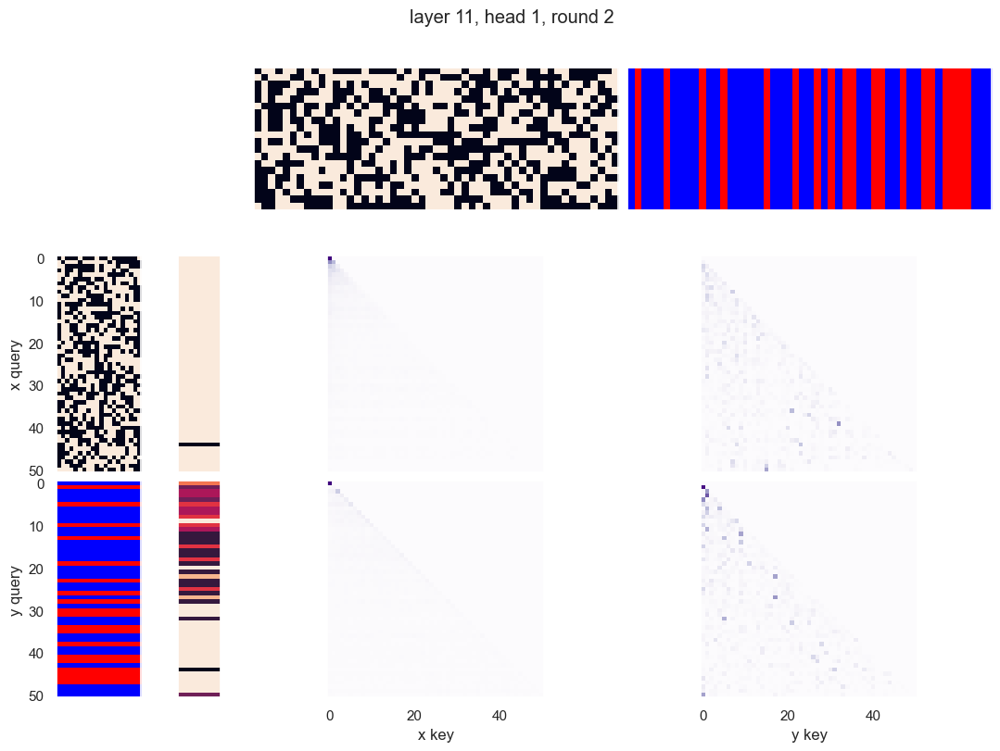

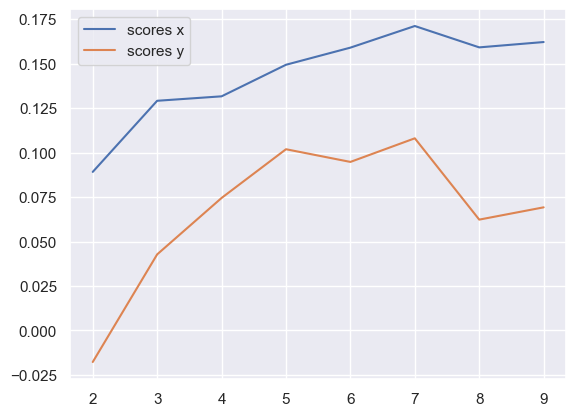

x query cluster:
SVM coefs for class 0: [-0.64175958 -0.09140514 -0.23518464  0.26447104 -0.95969006  0.3440201
 -0.30560444  0.00228065  0.57322092  0.36136626  0.18715226  0.30057514
 -0.15246232  0.30542759  0.13685647  0.05711292  0.05251671 -0.07848845
 -0.00534939 -0.03417683]\class elements: [37 38 40 44 45 46 49]
(1) -0: 1.00; (2) -4: 1.00; (3) +13: 0.86; (4) -12: 0.86; (5) +5: 0.86; (6) -18: 0.71; (7) +17: 0.71; (8) -16: 0.71; (9) +10: 0.71; (10) +8: 0.71
(1) -0 AND -4: 1.00; (2) -4 AND +13: 0.86; (3) -0 AND -12: 0.86; (4) -0 AND +5: 0.86; (5) -4 AND +5: 0.86; (6) -4 AND -12: 0.86; (7) -0 AND +13: 0.86; (8) +5 AND +13: 0.71; (9) -0 AND +8: 0.71; (10) +13 AND +19: 0.71
(1) -0 OR -1: 1.00; (2) -4 OR +11: 1.00; (3) -4 OR -12: 1.00; (4) -4 OR +12: 1.00; (5) -4 OR -13: 1.00; (6) -4 OR +13: 1.00; (7) -4 OR -14: 1.00; (8) -4 OR +14: 1.00; (9) -4 OR -15: 1.00; (10) -4 OR +15: 1.00
{7.0: 0.044922399902134216, 11.0: 0.02566506393278749, 8.0: 0.12160050706422355, 13.0: 0.1654015960968016

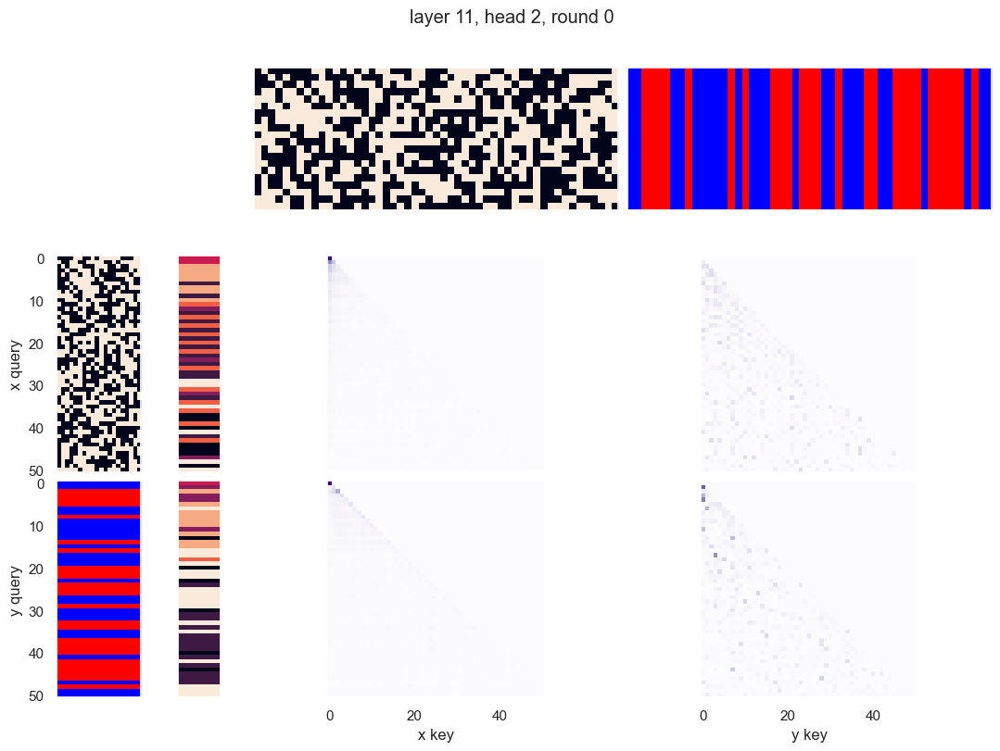

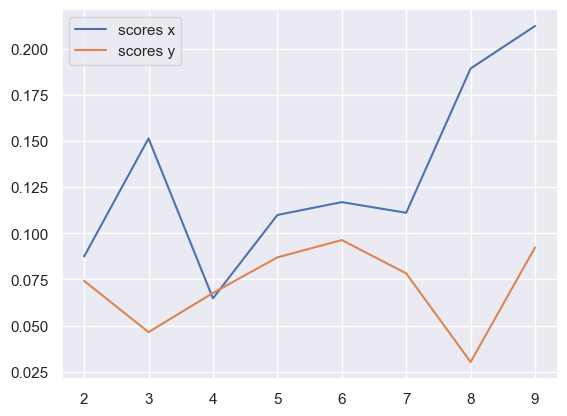

x query cluster:
SVM coefs for class 0: [-0.00439411  0.13855193 -0.20811431  0.44294918 -0.42560383  0.17337273
  0.03632176  0.04961652  0.26757074 -0.11654636  0.00240261  0.2717654
  0.12247836  0.12506819  0.24127354 -0.35377958  0.18462033 -0.17509972
  0.10952115  0.05454103]\class elements: [19 44]
(1) -9: 1.00; (2) -12: 1.00; (3) -18: 1.00; (4) +3: 1.00; (5) -5: 1.00; (6) -19: 1.00; (7) -10: 0.50; (8) +10: 0.50; (9) -11: 0.50; (10) +11: 0.50
(1) -9 AND -19: 1.00; (2) -5 AND -9: 1.00; (3) +3 AND -19: 1.00; (4) +3 AND -18: 1.00; (5) -12 AND -19: 1.00; (6) -9 AND -12: 1.00; (7) -5 AND -19: 1.00; (8) -12 AND -18: 1.00; (9) -5 AND -18: 1.00; (10) +3 AND -9: 1.00
(1) +3 OR -13: 1.00; (2) -4 OR +17: 1.00; (3) +4 OR -16: 1.00; (4) -4 OR +16: 1.00; (5) +10 OR +15: 1.00; (6) -10 OR -16: 1.00; (7) +4 OR -15: 1.00; (8) -4 OR +15: 1.00; (9) +4 OR -14: 1.00; (10) -4 OR +14: 1.00
{0.0: 0.6994875431419132}
SVM coefs for class 1: [-0.17642275  0.33043946 -0.24510111 -0.01228764  0.0549567  -0.

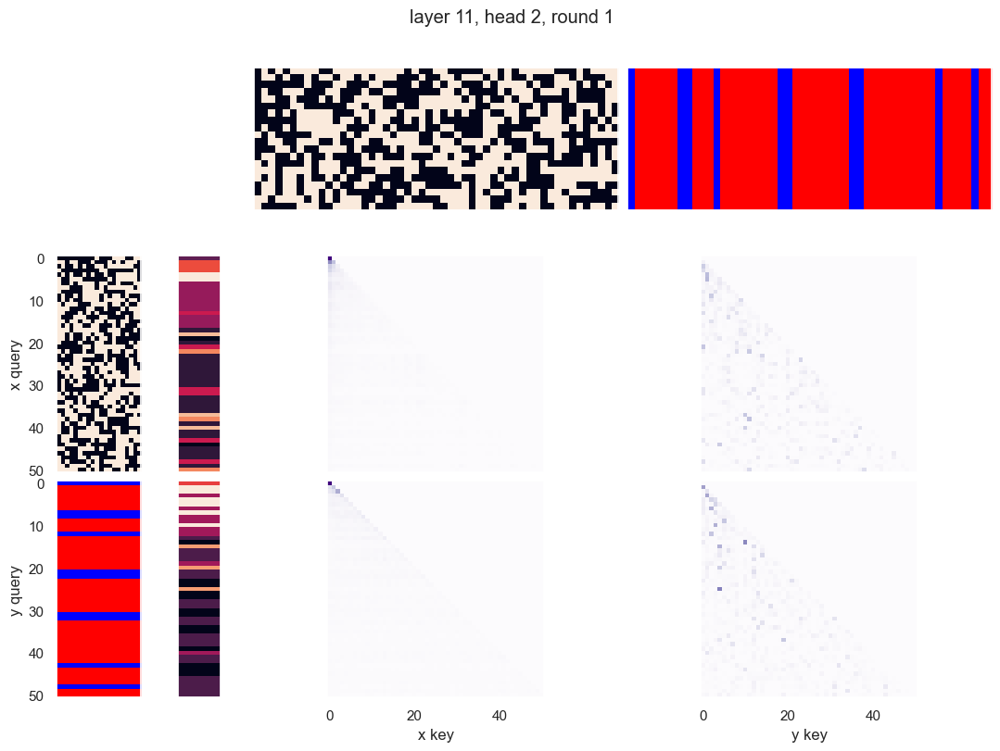

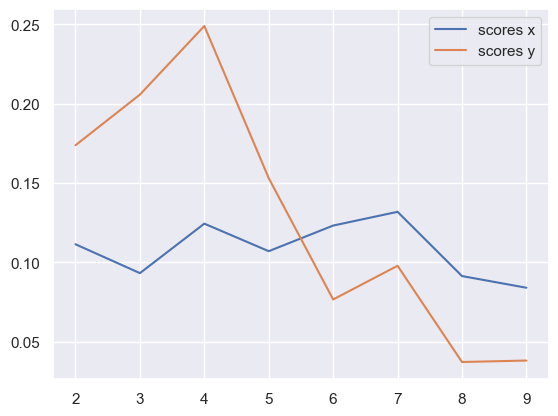

x query cluster:
SVM coefs for class 0: [ 0.08489814  0.0679362   0.00348445  0.22493718 -0.08285334  0.27987442
 -0.16674822  0.11397349  0.17843598  0.05382502  0.34330158 -0.60729673
 -0.02174409 -0.04029613  0.35798168 -0.5314793  -0.22947093 -0.0312559
 -0.1993832  -0.10684805]\class elements: [28 44 46]
(1) +17: 1.00; (2) -1: 1.00; (3) -19: 1.00; (4) +13: 1.00; (5) -9: 1.00; (6) +8: 1.00; (7) +4: 1.00; (8) -5: 1.00; (9) +10: 1.00; (10) +16: 0.67
(1) +8 AND +17: 1.00; (2) +10 AND +17: 1.00; (3) +4 AND +13: 1.00; (4) +4 AND +17: 1.00; (5) +10 AND +13: 1.00; (6) +4 AND -19: 1.00; (7) -5 AND +8: 1.00; (8) -5 AND -9: 1.00; (9) -5 AND +10: 1.00; (10) -9 AND -19: 1.00
(1) -0 OR -1: 1.00; (2) +4 OR -7: 1.00; (3) +13 OR +19: 1.00; (4) +8 OR +9: 1.00; (5) +4 OR +6: 1.00; (6) +4 OR -6: 1.00; (7) -8 OR +10: 1.00; (8) +8 OR -10: 1.00; (9) +4 OR +5: 1.00; (10) +4 OR -5: 1.00
{0.0: 0.7946639049478108}
SVM coefs for class 1: [-0.27731778 -0.20371435  0.11377203 -0.05641207  0.00830492 -0.4013856

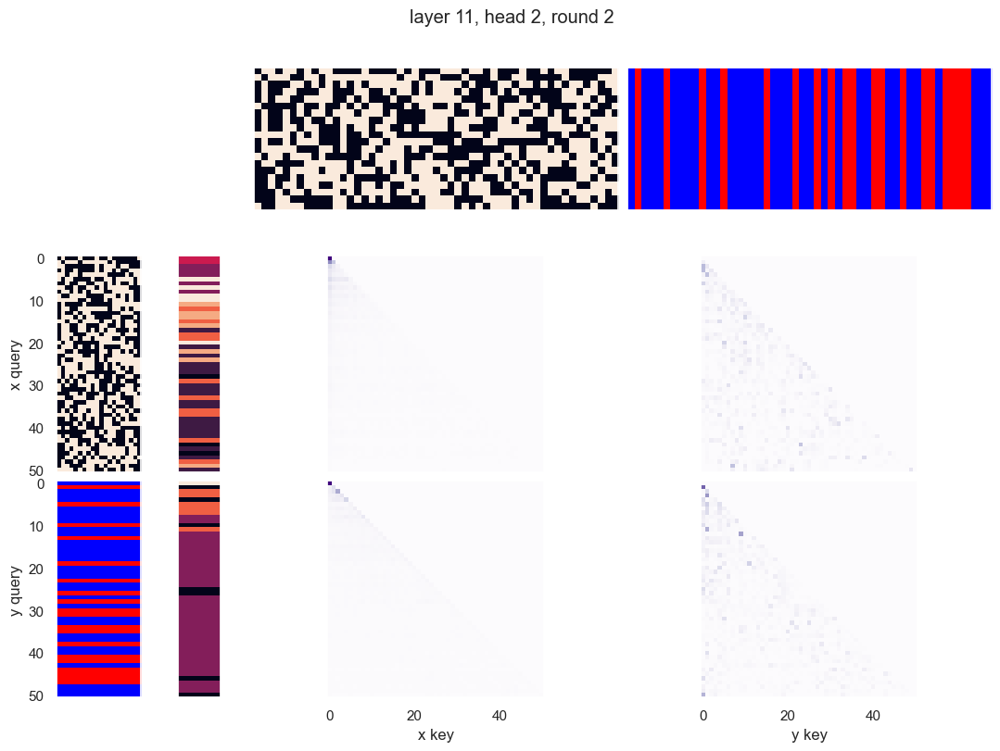

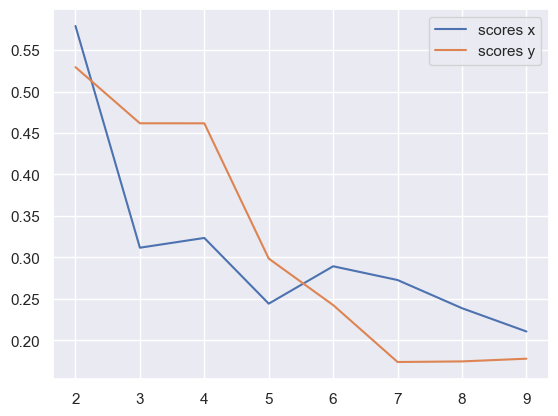

x query cluster:
SVM coefs: [ 0.10544439 -0.37931062  0.16402997  0.12084003 -0.24402619 -0.10237207
  0.0843679  -0.23419314  0.18886713  0.66353696 -0.04109421  0.52820739
 -0.17284292  0.06949295 -0.0345823  -0.08149747 -0.14972254 -0.68103724
  0.62447461  0.75904379]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17

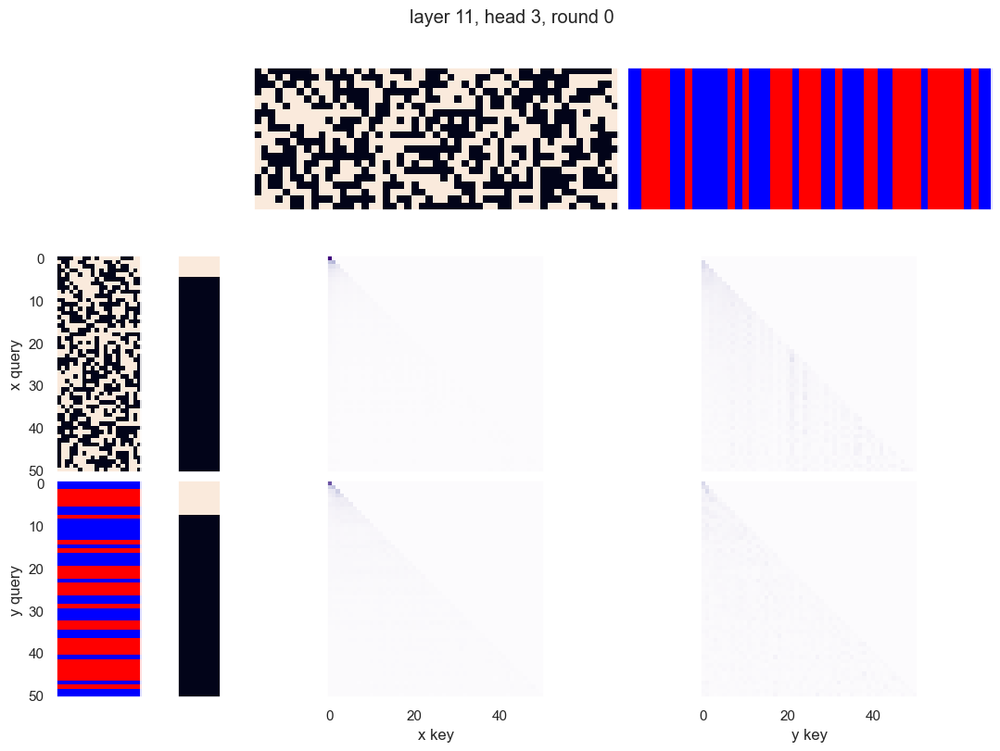

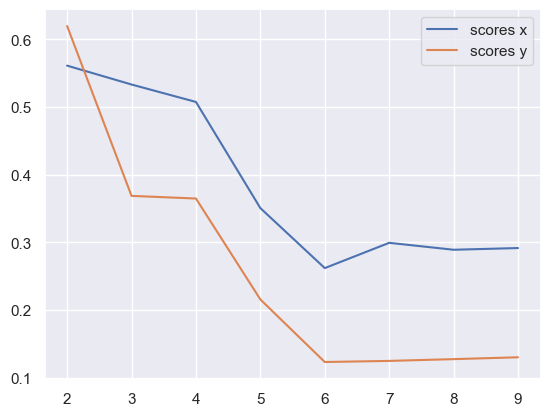

x query cluster:
SVM coefs: [-2.32153186e-01 -4.20207309e-01  7.42619191e-01  4.45016891e-01
  2.98550408e-01  3.58288311e-01  1.10680154e-01  1.84916357e-01
  8.03331476e-01  1.45553076e-01 -4.82857139e-01  6.11609436e-01
  2.99704669e-01 -6.64193264e-01 -3.04113999e-02 -3.31559606e-05
 -1.14823764e-01 -5.54170991e-01  5.13596872e-01  6.00329915e-01]
class1: [ 8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31
 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.63; (2) +14: 0.63; (3) +13: 0.63; (4) +9: 0.60; (5) -16: 0.60; (6) -12: 0.60; (7) +19: 0.60; (8) -3: 0.58; (9) +11: 0.56; (10) +5: 0.56
(1) +0 AND +9: 0.47; (2) +9 AND +13: 0.44; (3) -3 AND +19: 0.44; (4) -12 AND +19: 0.42; (5) +13 AND +14: 0.42; (6) +9 AND +14: 0.42; (7) +0 AND -16: 0.42; (8) -12 AND -15: 0.42; (9) +5 AND -16: 0.42; (10) +0 AND -12: 0.42
(1) -12 OR +13: 0.93; (2) +13 OR +19: 0.93; (3) -16 OR +19: 0.91; (4) +0 OR +14: 0.91; (5) +9 OR -12: 0.91; (6) +0 OR +17: 0.88; (7) +5 OR

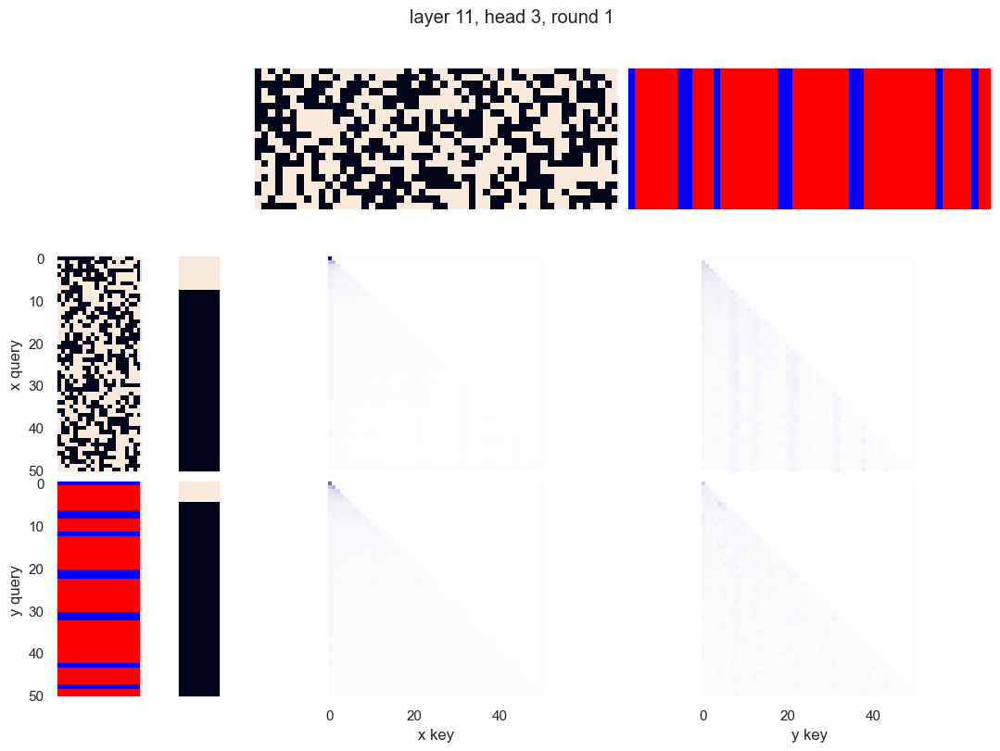

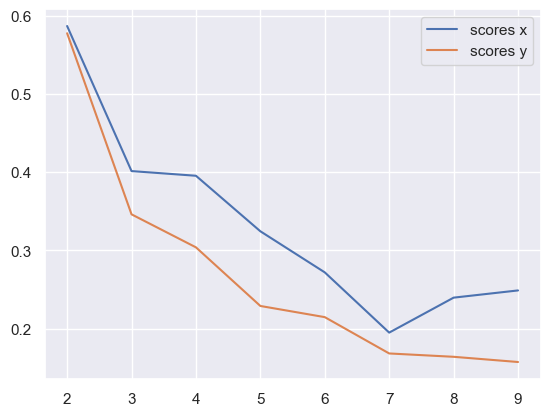

x query cluster:
SVM coefs: [ 0.10543443 -0.37931326  0.16399321  0.12084855 -0.24403165 -0.10238311
  0.08436295 -0.23418756  0.18884846  0.66354403 -0.0410774   0.52822817
 -0.17283825  0.06948875 -0.03457298 -0.08149183 -0.1497251  -0.68103539
  0.6244605   0.75905565]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

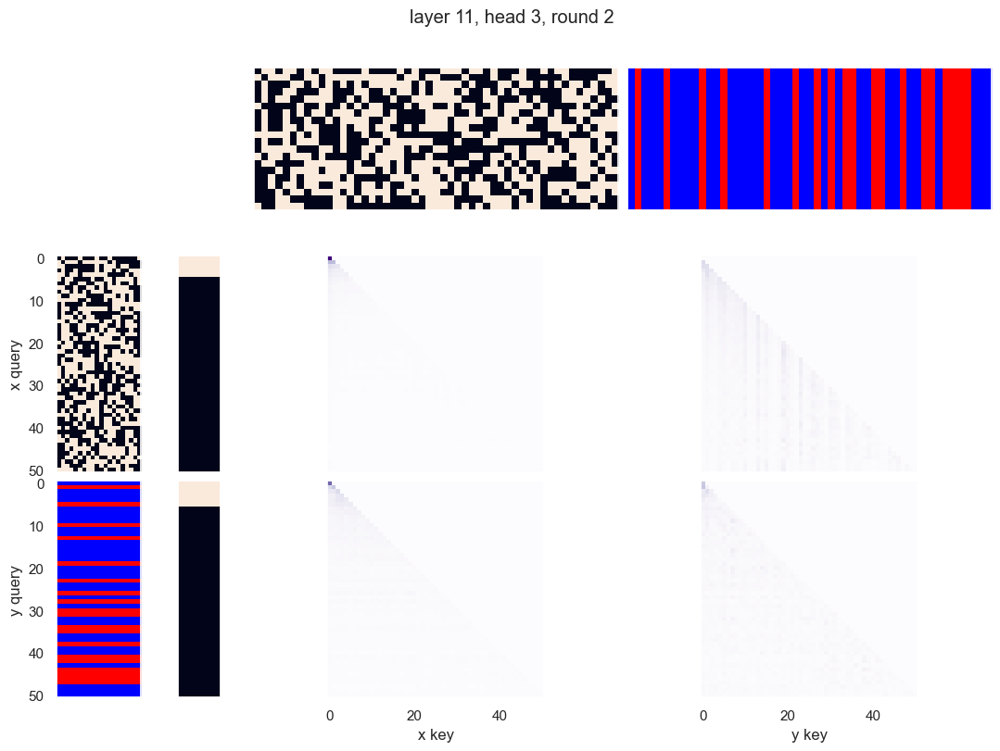

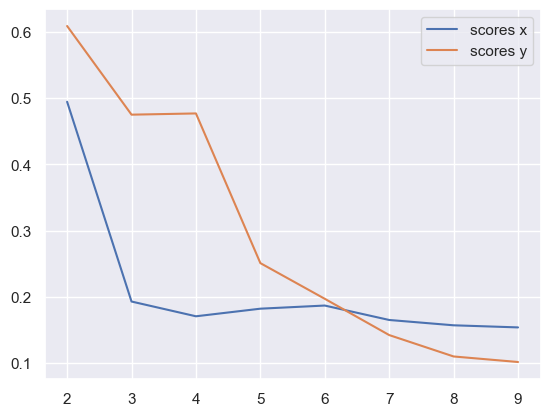

x query cluster:
SVM coefs: [ 0.10544016 -0.37931143  0.16403136  0.12083648 -0.24402517 -0.1023731
  0.08436916 -0.23419065  0.18886619  0.66353721 -0.04108971  0.52820794
 -0.17284686  0.06948935 -0.03458314 -0.08149734 -0.14972102 -0.68103859
  0.62447513  0.75904218]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.72; (2) -16: 0.65; (3) -18: 0.63; (4) +10: 0.63; (5) -11: 0.63; (6) -12: 0.61; (7) +6: 0.61; (8) +13: 0.59; (9) +5: 0.59; (10) -3: 0.59
(1) +2 AND -18: 0.52; (2) +6 AND +17: 0.50; (3) -3 AND -16: 0.48; (4) +13 AND -18: 0.48; (5) -3 AND -18: 0.48; (6) -11 AND +17: 0.48; (7) +6 AND -16: 0.46; (8) +5 AND +17: 0.46; (9) -0 AND +17: 0.46; (10) +17 AND -18: 0.46
(1) -11 OR -18: 0.96; (2) -11 OR -16: 0.96; (3) -16 OR +17: 0.93; (4) +17 OR -19: 0.93; (5) +10 OR +17: 0.93; (6) -2 OR -18: 0.93; (7) -12 OR -16: 0.93; (8) -3 OR -11: 0.93; (9) +5 OR +8: 0.91; (10) +2 OR +17:

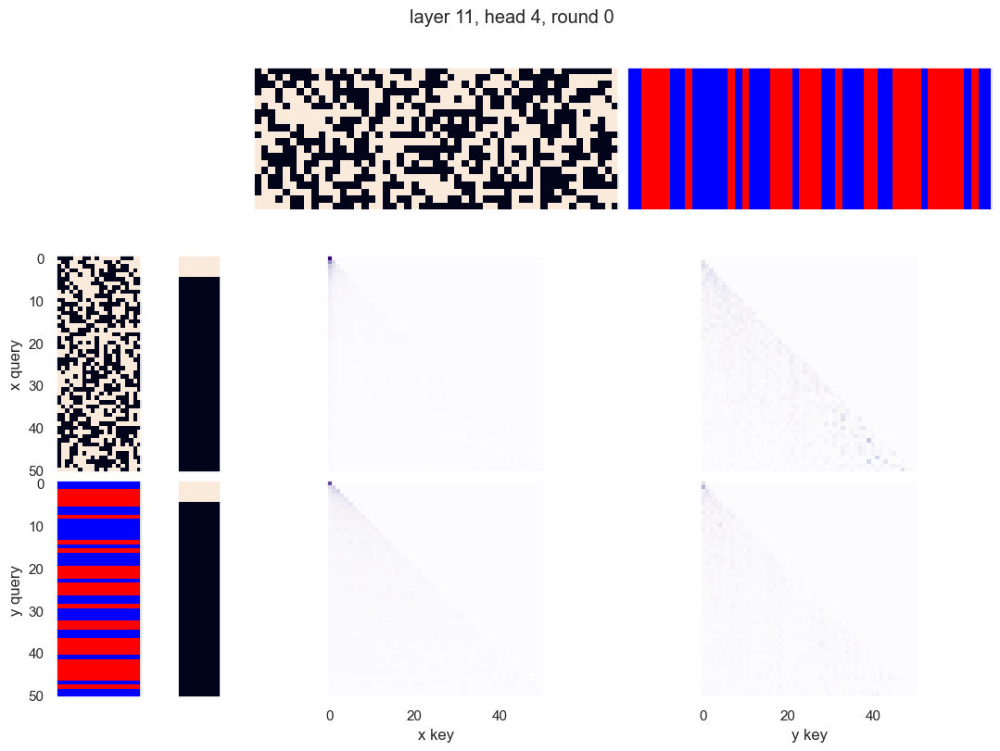

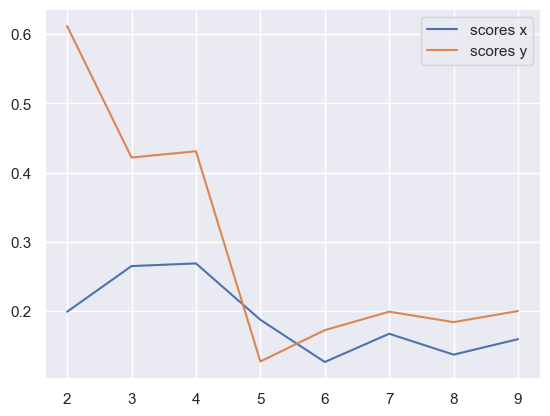

x query cluster:
SVM coefs for class 0: [ 0.04101388  0.02589857 -0.00376318  0.47734422 -0.10863719 -0.07729752
 -0.13983867  0.37176846 -0.02194901 -0.37766543  0.4349545  -0.12105528
  0.14682266 -0.22598859 -0.04040549 -0.57971275 -0.35352085 -0.49774942
  0.18595223  0.18356272]\class elements: [40 44 50]
(1) -6: 1.00; (2) -10: 1.00; (3) -18: 1.00; (4) +3: 1.00; (5) +7: 1.00; (6) -5: 1.00; (7) -13: 0.67; (8) -19: 0.67; (9) +14: 0.67; (10) -8: 0.67
(1) -5 AND +7: 1.00; (2) +7 AND -18: 1.00; (3) +3 AND -5: 1.00; (4) -6 AND +7: 1.00; (5) +3 AND -6: 1.00; (6) +3 AND +7: 1.00; (7) +7 AND -10: 1.00; (8) -5 AND -18: 1.00; (9) -6 AND -10: 1.00; (10) +3 AND -10: 1.00
(1) -10 OR +16: 1.00; (2) +9 OR +16: 1.00; (3) -4 OR -8: 1.00; (4) +4 OR +7: 1.00; (5) -4 OR +7: 1.00; (6) +9 OR +17: 1.00; (7) +4 OR -6: 1.00; (8) -9 OR -18: 1.00; (9) -4 OR -6: 1.00; (10) +9 OR -18: 1.00
{0.0: 0.7924231233895018}
SVM coefs for class 1: [-0.02207189  0.40870621 -0.76879257 -1.57328078  0.26832873 -0.31945557


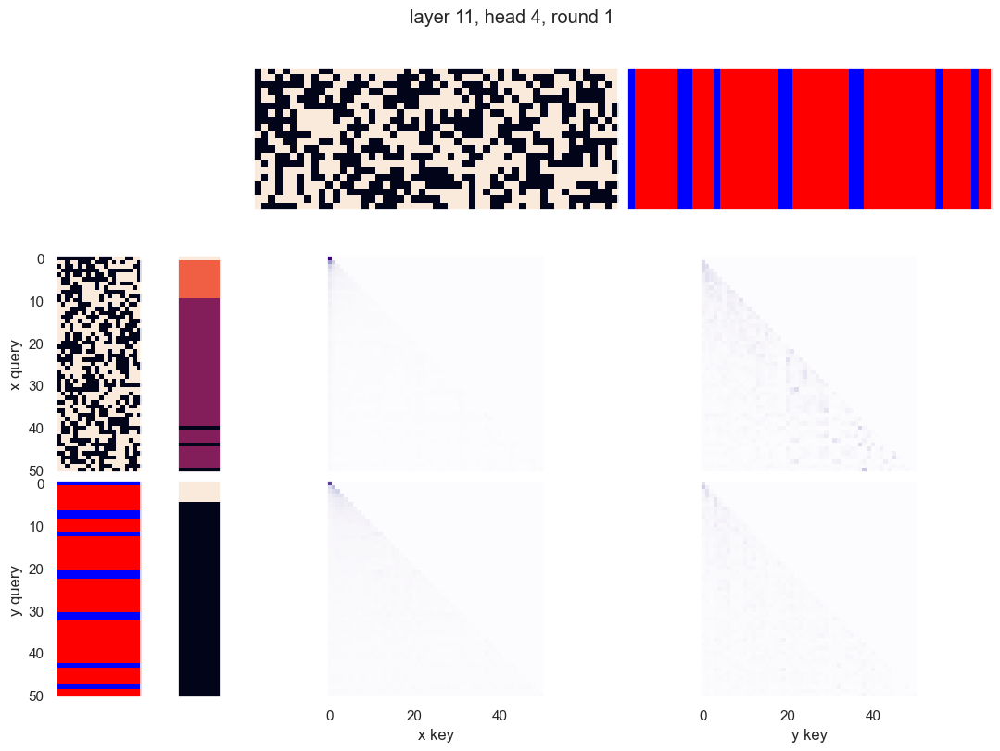

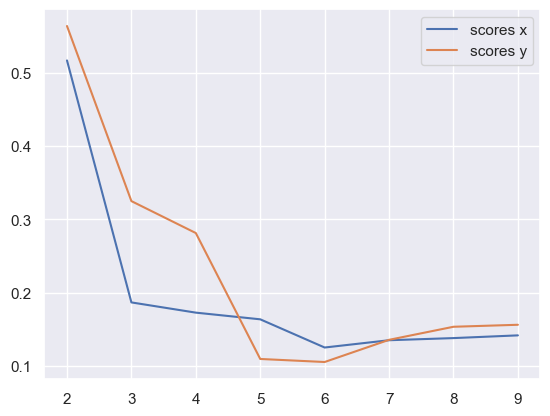

x query cluster:
SVM coefs: [ 0.1054382  -0.37931013  0.16403345  0.12083488 -0.24402737 -0.10237034
  0.08436825 -0.23418881  0.18886657  0.66353985 -0.04109234  0.52820537
 -0.17285016  0.06949018 -0.0345834  -0.08149595 -0.14972355 -0.68103145
  0.62447344  0.75904554]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) +17: 0.65; (3) -19: 0.63; (4) +2: 0.63; (5) -0: 0.61; (6) +13: 0.61; (7) +14: 0.61; (8) -9: 0.59; (9) +8: 0.59; (10) +6: 0.57
(1) +16 AND +17: 0.48; (2) +17 AND -19: 0.48; (3) +8 AND +16: 0.46; (4) -9 AND -19: 0.46; (5) +17 AND -18: 0.43; (6) -9 AND +13: 0.43; (7) -0 AND +17: 0.43; (8) +7 AND +16: 0.43; (9) -5 AND +16: 0.43; (10) -9 AND +17: 0.43
(1) -10 OR -19: 0.91; (2) +14 OR +16: 0.91; (3) +12 OR +16: 0.91; (4) +13 OR +16: 0.89; (5) -0 OR -10: 0.89; (6) +2 OR +16: 0.89; (7) +5 OR +16: 0.89; (8) +14 OR +17: 0.89; (9) +2 OR +17: 0.89; (10) +2 OR +4: 0

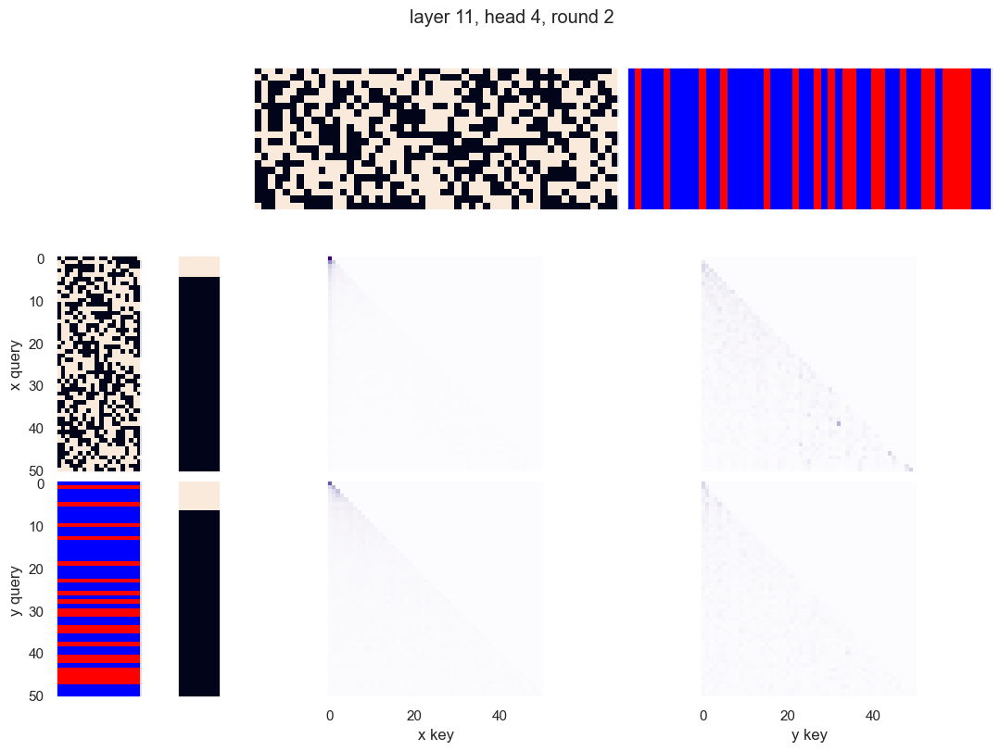

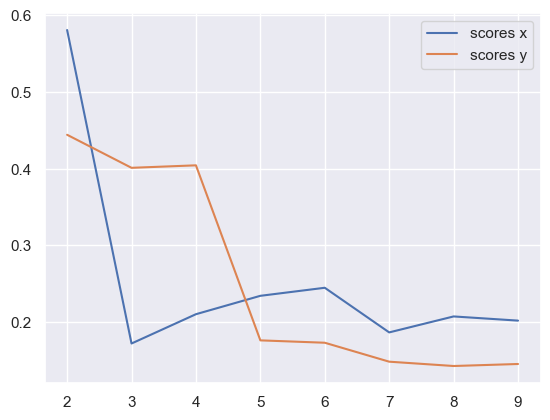

x query cluster:
SVM coefs: [-0.46865697 -0.57678079  0.27720713  0.21226544 -0.11848117 -0.05889654
  0.00723202 -0.45952211  0.42596898  0.43341302 -0.08995625  0.23647104
 -0.24495424 -0.49574975 -0.29612032  0.17306174  0.11536441 -0.67924307
  0.21283921  0.87186786]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +17: 0.71; (2) -16: 0.67; (3) -18: 0.62; (4) +10: 0.62; (5) -11: 0.62; (6) -12: 0.60; (7) +2: 0.60; (8) -3: 0.60; (9) +13: 0.60; (10) +6: 0.60
(1) +2 AND -18: 0.53; (2) +13 AND -18: 0.49; (3) -3 AND -16: 0.49; (4) -3 AND -18: 0.49; (5) +6 AND +17: 0.49; (6) -11 AND +17: 0.47; (7) +6 AND -16: 0.47; (8) +17 AND -18: 0.44; (9) +5 AND +17: 0.44; (10) -16 AND -18: 0.44
(1) -11 OR -16: 0.96; (2) -11 OR -18: 0.96; (3) +17 OR -19: 0.93; (4) -2 OR -18: 0.93; (5) -3 OR -11: 0.93; (6) -12 OR -16: 0.93; (7) -16 OR +17: 0.93; (8) +10 OR +17: 0.93; (9) +2 OR +17: 0.91; (10) +6 OR +10:

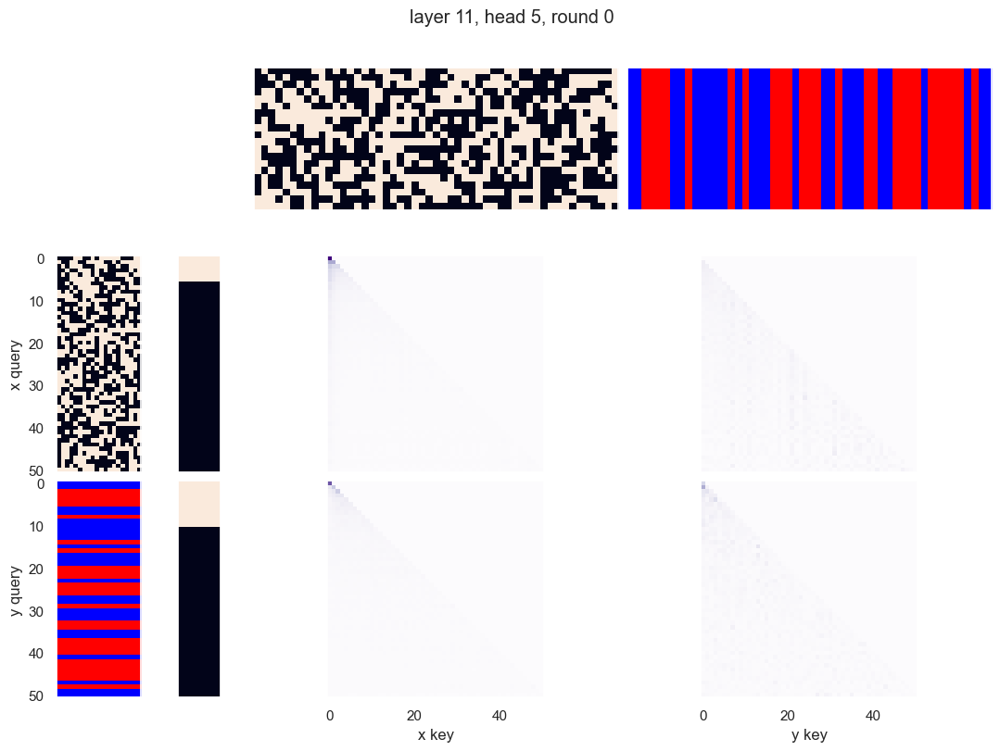

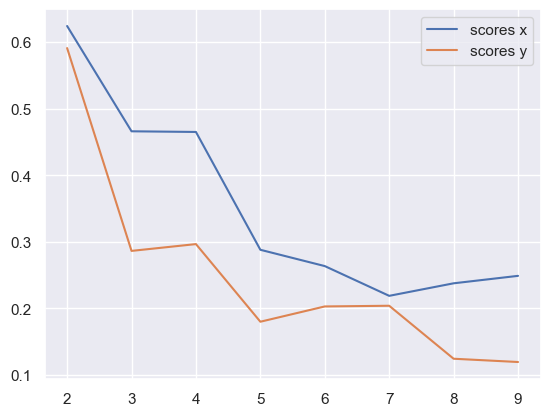

x query cluster:
SVM coefs: [ 0.10543736 -0.37931039  0.16403038  0.12083533 -0.2440252  -0.10237411
  0.08437208 -0.23418903  0.18886071  0.66353838 -0.0410945   0.52820856
 -0.17284677  0.06949318 -0.03457785 -0.0814984  -0.14972315 -0.68104021
  0.62447609  0.75904314]
class1: [ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +0: 0.65; (2) +14: 0.65; (3) +19: 0.61; (4) +13: 0.61; (5) -16: 0.59; (6) -12: 0.59; (7) +6: 0.57; (8) +5: 0.57; (9) +9: 0.57; (10) -3: 0.57
(1) +0 AND +9: 0.43; (2) -3 AND +19: 0.43; (3) +9 AND +13: 0.41; (4) +0 AND -12: 0.41; (5) +0 AND -16: 0.41; (6) +13 AND +14: 0.41; (7) -12 AND -15: 0.41; (8) +5 AND -16: 0.41; (9) -12 AND +19: 0.41; (10) +0 AND +19: 0.39
(1) +13 OR +19: 0.91; (2) -12 OR +13: 0.91; (3) +0 OR +14: 0.91; (4) +14 OR +19: 0.89; (5) +0 OR +17: 0.89; (6) +14 OR +17: 0.89; (7) +14 OR -15: 0.89; (8) +0 OR +11: 0.89; (9) +14 OR -16: 0.89; (10) -16 OR +19:

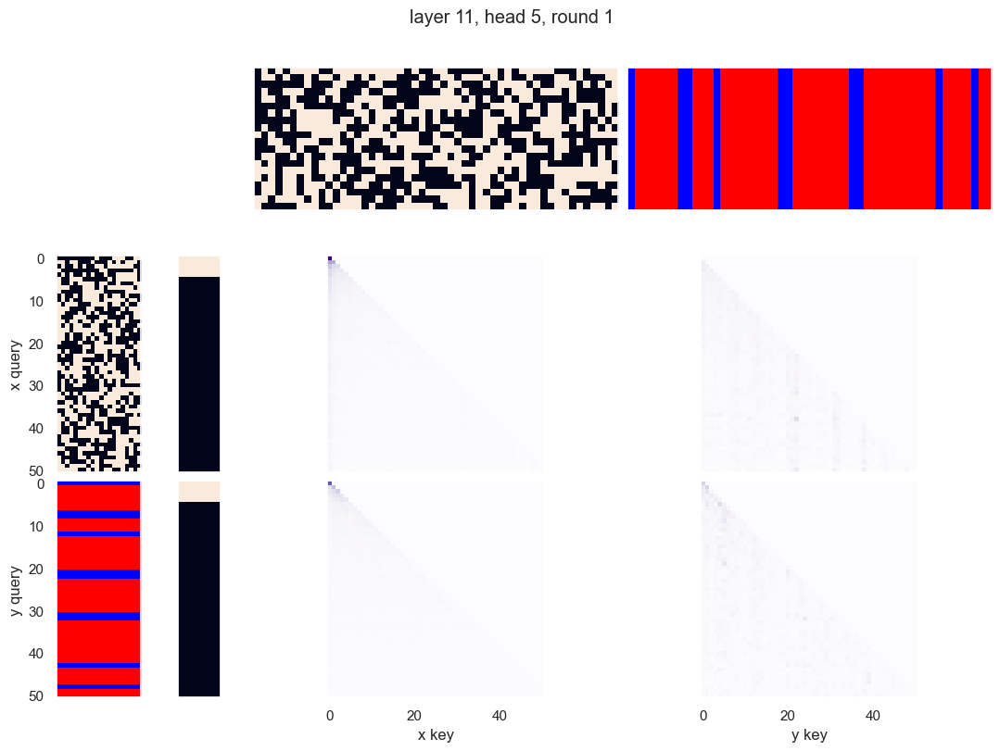

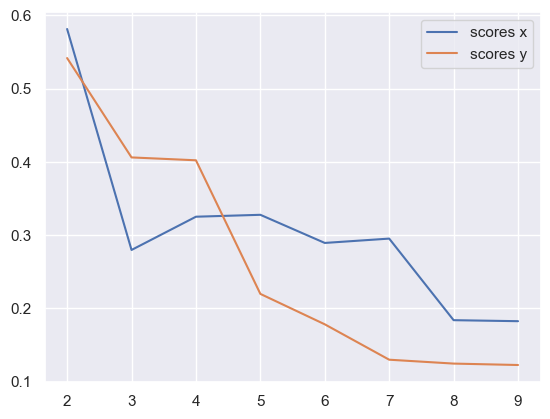

x query cluster:
SVM coefs: [-0.46865881 -0.57678027  0.27720913  0.21226386 -0.11848036 -0.05889301
  0.00723265 -0.4595222   0.42596437  0.43340852 -0.08995831  0.2364733
 -0.24495333 -0.49575437 -0.29612501  0.17306207  0.11536563 -0.6792429
  0.21284158  0.87186579]
class1: [ 6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29
 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50]
(1) +16: 0.67; (2) -19: 0.64; (3) +17: 0.64; (4) +13: 0.62; (5) +2: 0.62; (6) -0: 0.62; (7) +14: 0.60; (8) -9: 0.58; (9) +7: 0.58; (10) +6: 0.58
(1) +17 AND -19: 0.49; (2) -9 AND -19: 0.47; (3) +16 AND +17: 0.47; (4) +7 AND +16: 0.44; (5) -18 AND -19: 0.44; (6) +8 AND +13: 0.44; (7) -9 AND +13: 0.44; (8) +8 AND +16: 0.44; (9) -0 AND +17: 0.44; (10) +13 AND -19: 0.42
(1) -10 OR -19: 0.91; (2) +12 OR +16: 0.91; (3) +14 OR +16: 0.91; (4) +6 OR +16: 0.89; (5) +7 OR -19: 0.89; (6) +15 OR +16: 0.89; (7) +7 OR +17: 0.89; (8) +6 OR +7: 0.89; (9) +14 OR +17: 0.89; (10) +9 OR -19: 0.89


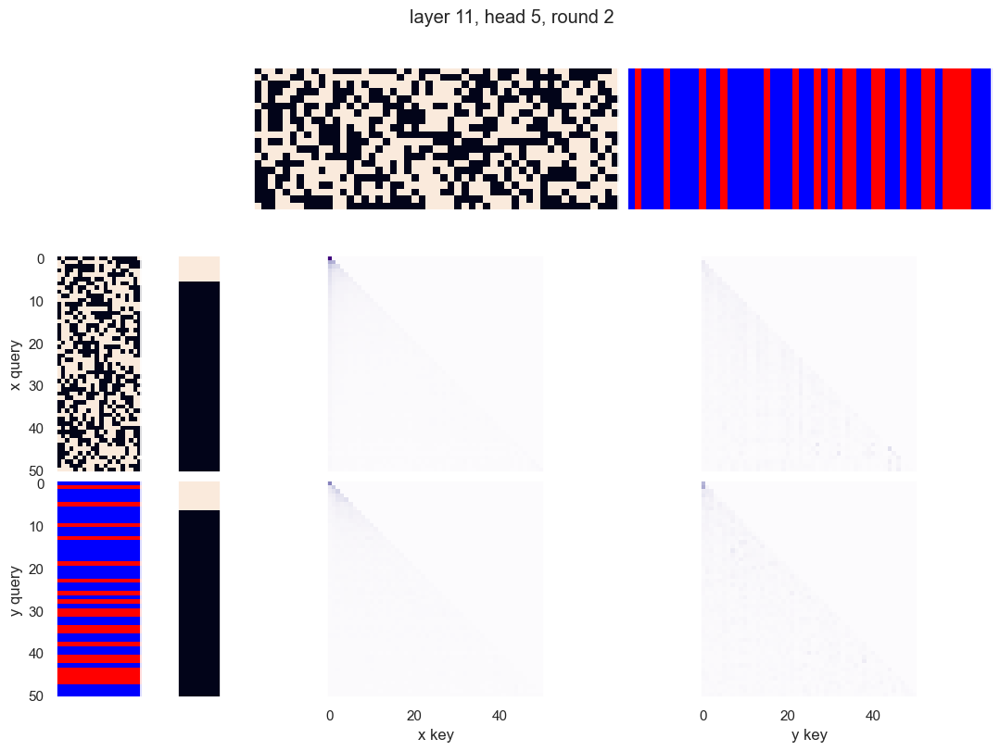

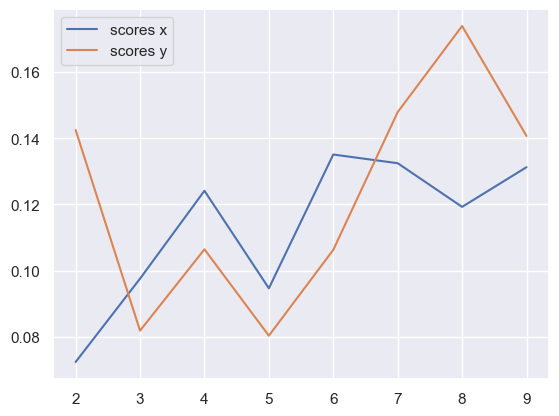

x query cluster:
SVM coefs for class 0: [-0.3258902   0.22476102 -0.63733193  0.59332147 -0.67142475 -0.0965298
  0.26041391  0.4943816  -0.02457491  0.13728874  0.17286662  0.02709964
 -0.07972497  0.12144107  0.27145929  0.30942586 -0.32762911 -0.154775
 -0.19315194  0.21618184]\class elements: [34 36 44 45 49]
(1) +1: 1.00; (2) -4: 1.00; (3) -11: 1.00; (4) -0: 0.80; (5) +17: 0.80; (6) +14: 0.80; (7) +3: 0.80; (8) -12: 0.80; (9) +6: 0.80; (10) +7: 0.80
(1) +1 AND -11: 1.00; (2) -4 AND -11: 1.00; (3) +1 AND -4: 1.00; (4) +1 AND +6: 0.80; (5) -4 AND +17: 0.80; (6) +6 AND +7: 0.80; (7) +6 AND -11: 0.80; (8) +1 AND +3: 0.80; (9) +6 AND +17: 0.80; (10) -0 AND -12: 0.80
(1) +6 OR +14: 1.00; (2) -4 OR -15: 1.00; (3) +6 OR +16: 1.00; (4) -4 OR +14: 1.00; (5) +2 OR +6: 1.00; (6) -4 OR -14: 1.00; (7) -10 OR -15: 1.00; (8) -6 OR +17: 1.00; (9) +2 OR +7: 1.00; (10) -10 OR +14: 1.00
{7.0: 0.055167902848916116, 11.0: 0.034906597725057505, 8.0: 0.12349937045728439, 13.0: 0.20350486862444084, 12.0: 

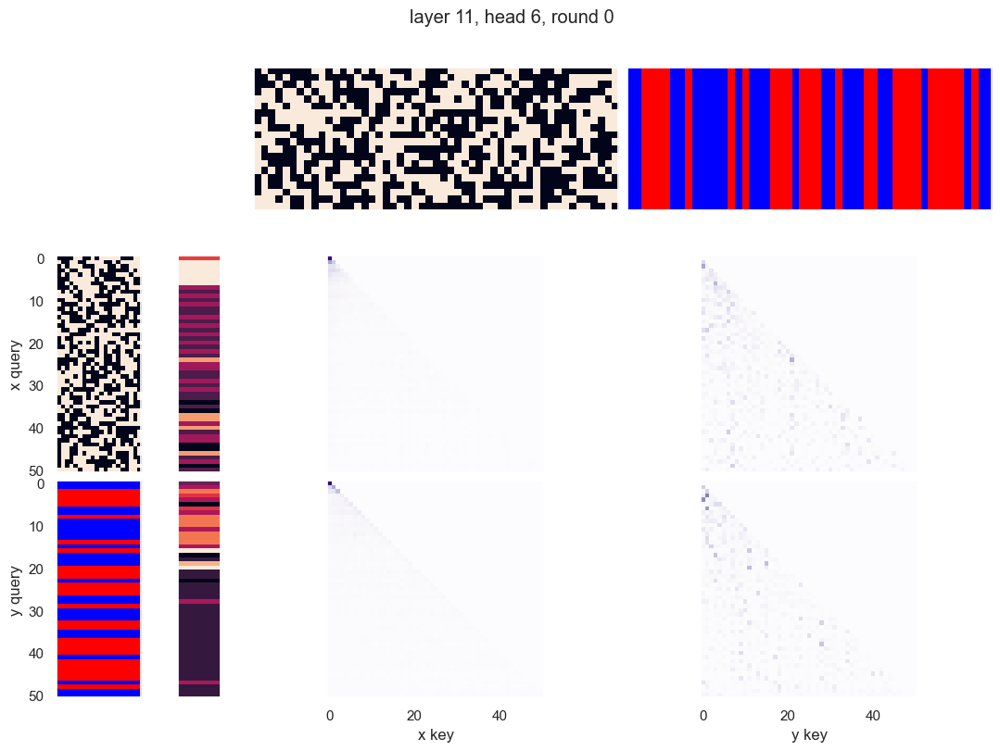

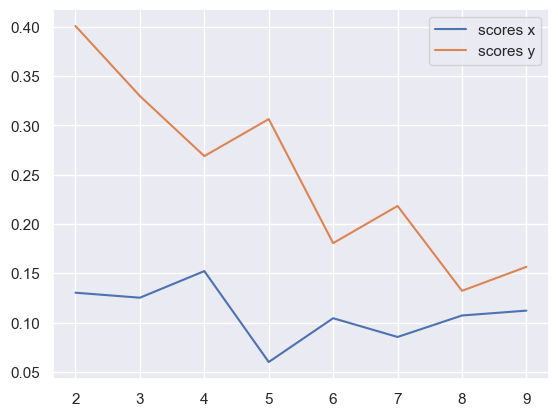

x query cluster:
SVM coefs for class 0: [-0.1343088  -0.34326816  0.50420669  0.05072651 -0.88602761 -0.36218306
 -0.46060419  0.45987125  0.36595952 -0.13297046  0.44461051  0.60152795
  0.21802823 -0.02927015  0.21041868 -0.37342694 -0.16937607 -0.21619494
  1.04991034  0.1115566 ]\class elements: [18 19 37 38 40 44 50]
(1) -5: 1.00; (2) +3: 1.00; (3) +0: 0.86; (4) +9: 0.71; (5) -12: 0.71; (6) -19: 0.71; (7) -18: 0.71; (8) -8: 0.71; (9) -16: 0.71; (10) -15: 0.57
(1) +3 AND -5: 1.00; (2) +0 AND -5: 0.86; (3) +0 AND +3: 0.86; (4) -5 AND -12: 0.71; (5) -5 AND -8: 0.71; (6) +3 AND -12: 0.71; (7) +3 AND -18: 0.71; (8) +0 AND -16: 0.71; (9) -5 AND -19: 0.71; (10) -5 AND -16: 0.71
(1) -5 OR -8: 1.00; (2) +3 OR -8: 1.00; (3) +3 OR +8: 1.00; (4) +3 OR -9: 1.00; (5) +3 OR +9: 1.00; (6) +3 OR -10: 1.00; (7) +3 OR +10: 1.00; (8) +3 OR -11: 1.00; (9) +3 OR +11: 1.00; (10) +3 OR -12: 1.00
{0.0: 0.8049805287507268}
SVM coefs for class 1: [-0.14899474  0.18249667 -0.16223307  0.26466324  0.01119233 

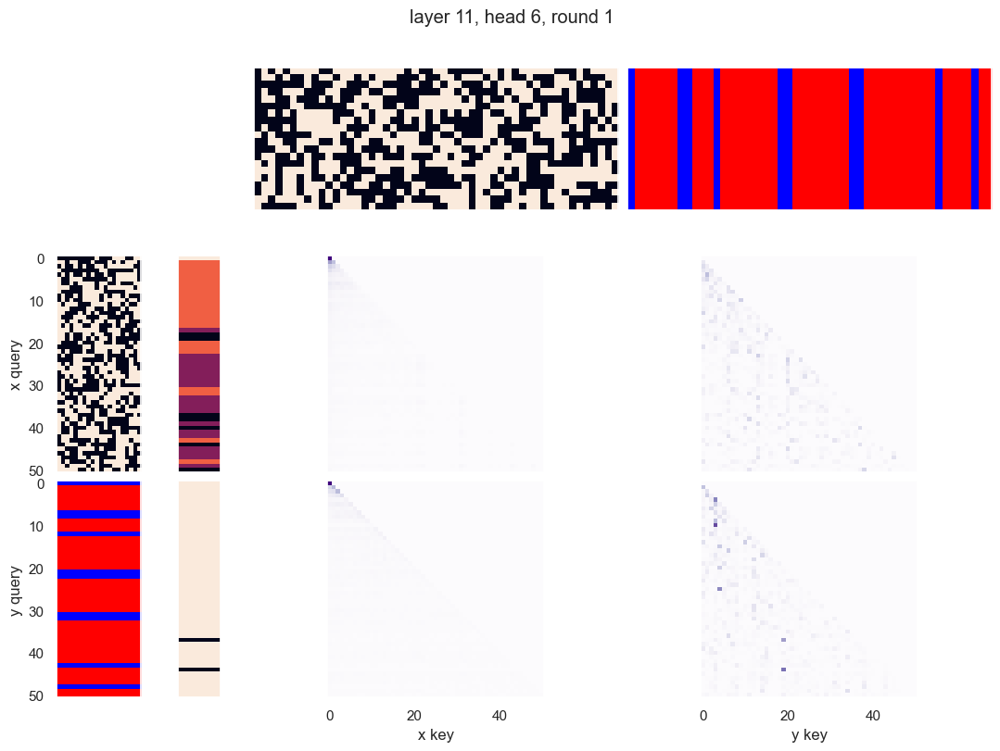

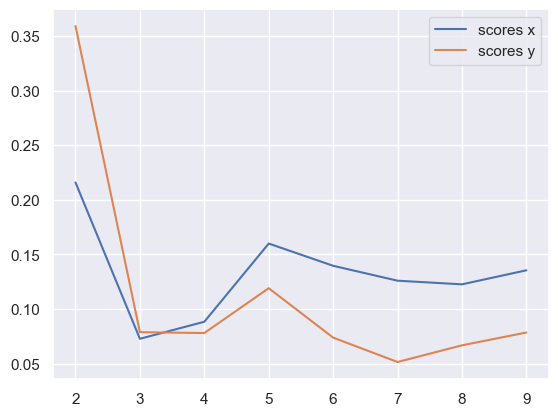

x query cluster:
SVM coefs: [-0.26866218  0.10617721 -0.0808656  -0.60887408  0.36931935 -0.61457331
  0.42808709  0.10564294 -0.61946767 -0.20267772  0.15216491 -0.10305037
  0.0147651  -0.17766643 -0.35830753  0.31519574  0.14173828 -0.21040741
  0.44745201  0.09358519]
class1: [28 32 44 46]
(1) -1: 1.00; (2) +10: 1.00; (3) -19: 1.00; (4) -9: 1.00; (5) +4: 1.00; (6) -5: 1.00; (7) +17: 1.00; (8) -0: 0.75; (9) -15: 0.75; (10) +13: 0.75
(1) +10 AND -19: 1.00; (2) +10 AND +17: 1.00; (3) -1 AND +10: 1.00; (4) +4 AND -19: 1.00; (5) +4 AND +10: 1.00; (6) +4 AND -9: 1.00; (7) -1 AND -5: 1.00; (8) +4 AND -5: 1.00; (9) -1 AND +4: 1.00; (10) -5 AND -9: 1.00
(1) -0 OR -1: 1.00; (2) -5 OR -6: 1.00; (3) +4 OR +19: 1.00; (4) +4 OR -19: 1.00; (5) -4 OR -19: 1.00; (6) +4 OR +18: 1.00; (7) +4 OR -18: 1.00; (8) -12 OR +13: 1.00; (9) +4 OR +17: 1.00; (10) +4 OR -17: 1.00
{0.0: 0.8707399734737464}
class2: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 29 30 31 33 34

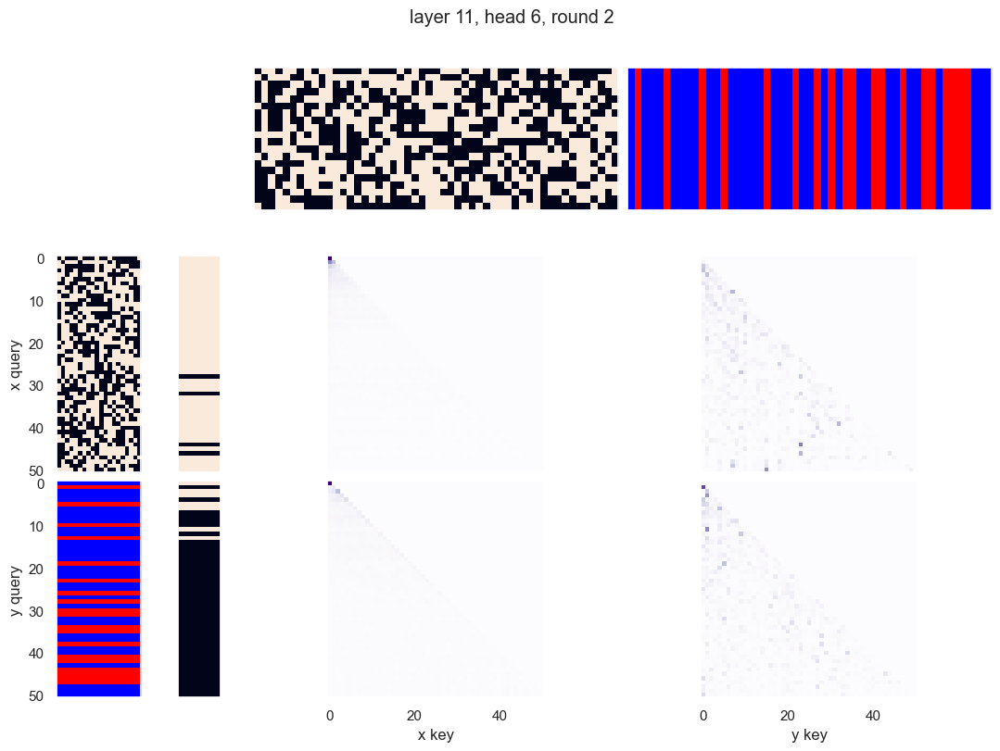

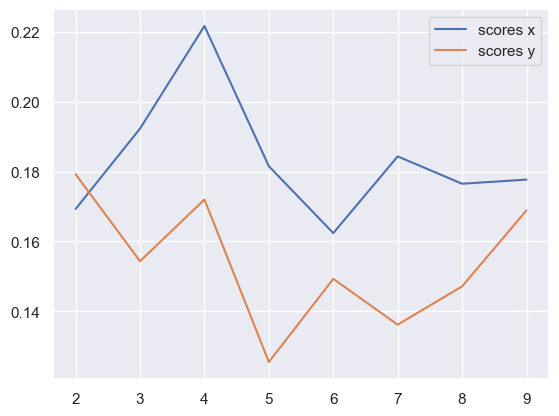

x query cluster:
SVM coefs for class 0: [-0.19578243  0.06145027 -0.8246367  -0.54981145 -1.3770648  -0.22634123
 -0.23756289  0.14079085  0.71101749  0.06122164  0.4655478  -0.39693446
 -0.7759836  -0.02566945  0.31205292  0.34918317 -0.48733178 -0.02504383
  0.24327317  0.22274035]\class elements: [11 14 20 25 31 34 37 40 44 45 46 49]
(1) -12: 1.00; (2) -4: 0.92; (3) -0: 0.83; (4) +17: 0.83; (5) -11: 0.75; (6) -16: 0.67; (7) +8: 0.67; (8) -18: 0.58; (9) +15: 0.58; (10) -13: 0.58
(1) -4 AND -12: 0.92; (2) -0 AND -12: 0.83; (3) -12 AND +17: 0.83; (4) -4 AND +17: 0.75; (5) -4 AND -11: 0.75; (6) -0 AND -4: 0.75; (7) -11 AND -12: 0.75; (8) -0 AND +17: 0.67; (9) -12 AND -16: 0.67; (10) -11 AND +17: 0.67
(1) -0 OR -1: 1.00; (2) -7 OR +17: 1.00; (3) +2 OR -4: 1.00; (4) -8 OR -12: 1.00; (5) +8 OR -12: 1.00; (6) +8 OR -19: 1.00; (7) -9 OR -12: 1.00; (8) +9 OR -12: 1.00; (9) +1 OR -12: 1.00; (10) -1 OR -12: 1.00
{7.0: 0.15160767311226664, 11.0: 0.0458643051145676, 8.0: 0.10381405396393954, 13.0

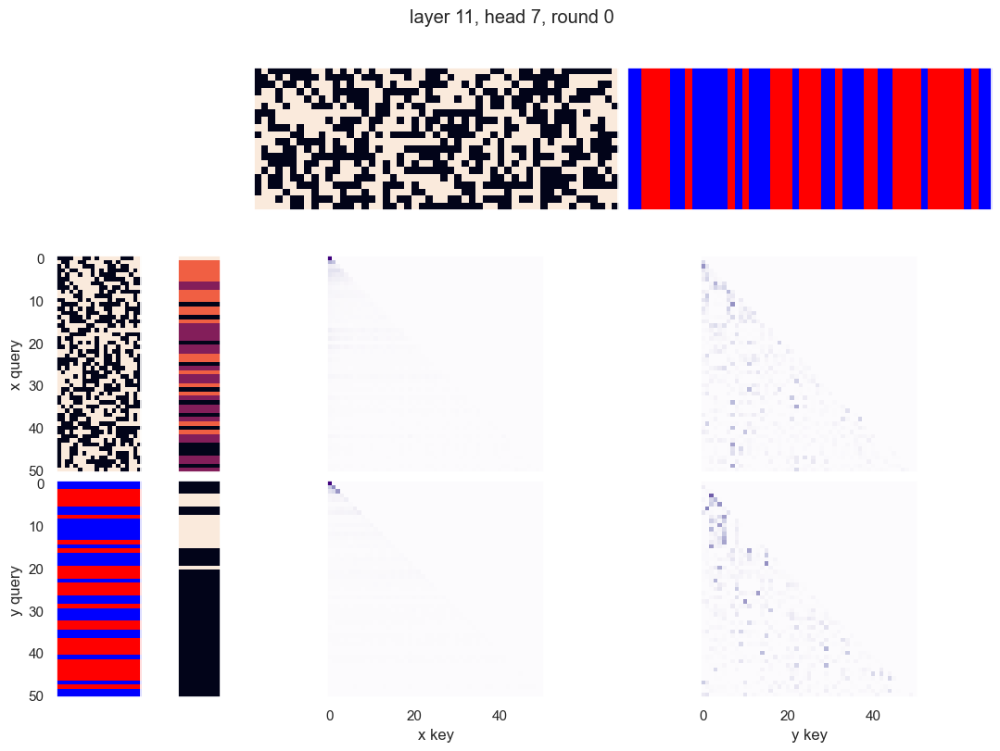

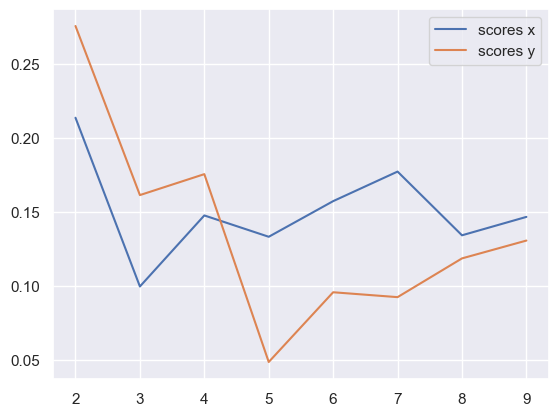

x query cluster:
SVM coefs: [ 0.02420111  0.394871   -0.29197031 -0.31888898 -0.07069345  0.11886339
  0.28724958 -0.37704984 -0.43004899  0.06328547  0.0631751  -0.46817913
 -0.096089   -0.02409554 -0.0728714  -0.06838669 -0.40839625  0.13184207
 -0.36150044 -0.44671279]
class1: [ 0  1  2  4  5  6  7 10 15 17 21 32 37 50]
(1) +14: 0.86; (2) +15: 0.79; (3) +12: 0.79; (4) -5: 0.79; (5) +18: 0.71; (6) +9: 0.64; (7) +13: 0.64; (8) +6: 0.64; (9) -11: 0.64; (10) -2: 0.64
(1) +14 AND +18: 0.71; (2) -5 AND +15: 0.71; (3) +14 AND +15: 0.64; (4) +12 AND +15: 0.64; (5) -5 AND +12: 0.64; (6) -5 AND +14: 0.64; (7) +12 AND +14: 0.64; (8) +4 AND +12: 0.57; (9) +0 AND +12: 0.57; (10) -2 AND +14: 0.57
(1) +6 OR -10: 1.00; (2) +1 OR +14: 1.00; (3) +0 OR +14: 1.00; (4) +14 OR -18: 1.00; (5) +4 OR +14: 1.00; (6) +0 OR -5: 1.00; (7) -2 OR +12: 1.00; (8) -4 OR +12: 1.00; (9) +0 OR +15: 1.00; (10) -8 OR +14: 1.00
{0.0: 0.594923799471961}
class2: [ 3  8  9 11 12 13 14 16 18 19 20 22 23 24 25 26 27 28 29 30 3

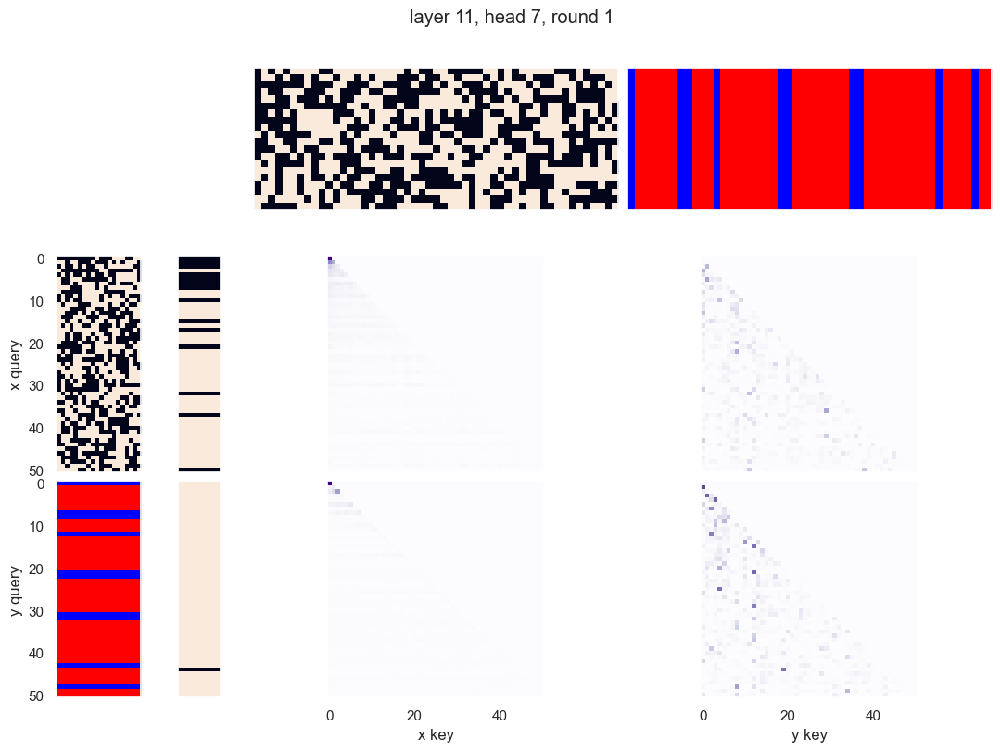

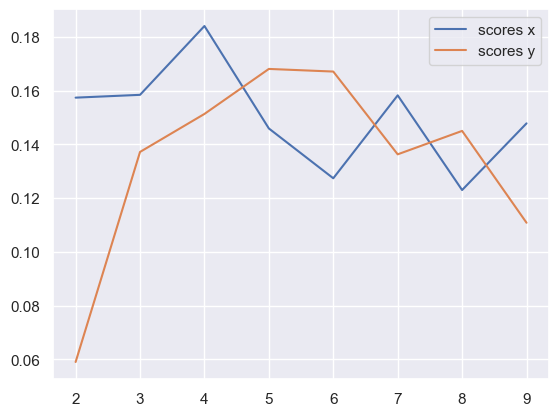

x query cluster:
SVM coefs for class 0: [ 0.08901274  0.07527854  0.03439853  0.24181096  0.12156455  0.29019928
  0.49386352 -0.39889631 -0.04990715  0.10659986  0.18977925 -0.26835142
 -0.11942582  0.06543254  0.07615721  0.29950927  0.20989832  0.02354846
 -0.27588228 -0.5837945 ]\class elements: [ 4  8 10 11 12 13 14 16 21 22 23 24 25 26 27 28 29 32 35 37 44 48 50]
(1) -12: 0.96; (2) +16: 0.83; (3) +13: 0.70; (4) -9: 0.70; (5) +8: 0.70; (6) +1: 0.70; (7) +4: 0.65; (8) -0: 0.65; (9) +2: 0.65; (10) +7: 0.61
(1) -12 AND +16: 0.78; (2) -9 AND -12: 0.65; (3) +1 AND -12: 0.65; (4) +8 AND -12: 0.65; (5) -12 AND +13: 0.65; (6) +2 AND -12: 0.65; (7) +8 AND +16: 0.61; (8) -0 AND -12: 0.61; (9) +4 AND -12: 0.61; (10) +7 AND -12: 0.57
(1) -12 OR +19: 1.00; (2) +3 OR +16: 1.00; (3) +8 OR -9: 1.00; (4) -0 OR -12: 1.00; (5) +5 OR -12: 1.00; (6) +10 OR -12: 1.00; (7) -12 OR +18: 1.00; (8) -9 OR -12: 1.00; (9) -12 OR +17: 1.00; (10) +1 OR -12: 1.00
{0.0: 0.8369978788437237}
SVM coefs for class 1: [

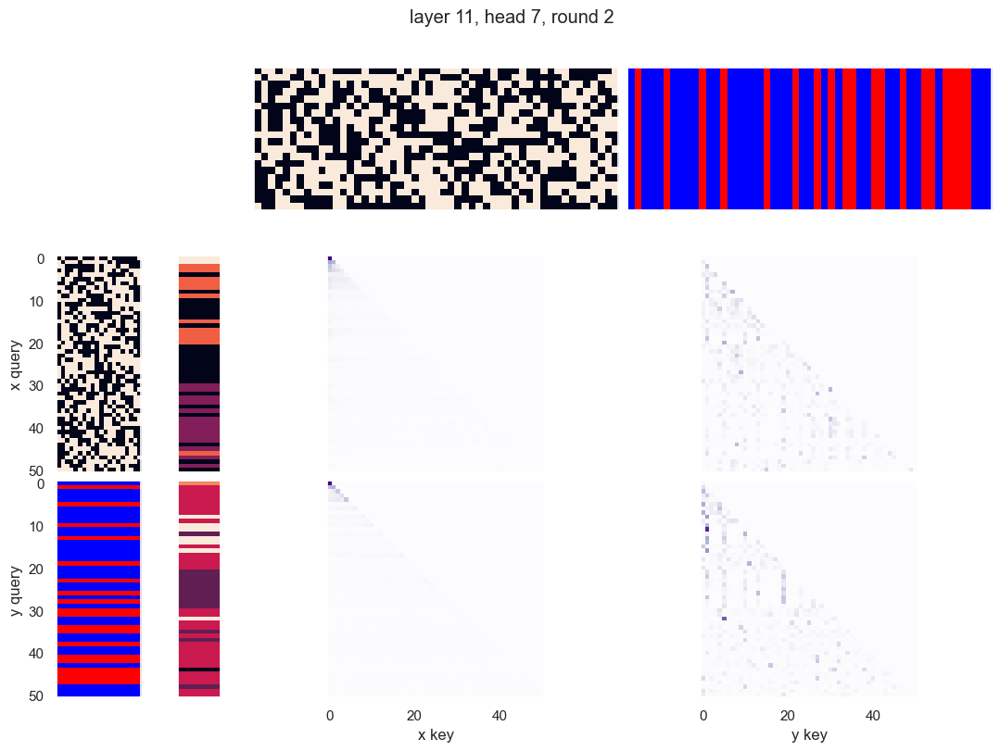

In [ ]:
layers = range(12)
heads = range(8)
samples = range(3)
for layer in layers:
    for head in heads:
        for sample in samples:
            analyze_attn_matrix(xs_boolean[:3, :51], ys_boolean[:3, :51], model, layer, head, sample, task_boolean)


In [ ]:
svm.SVC().fit(attn_x, kmeans_x.labels_)

SVC()

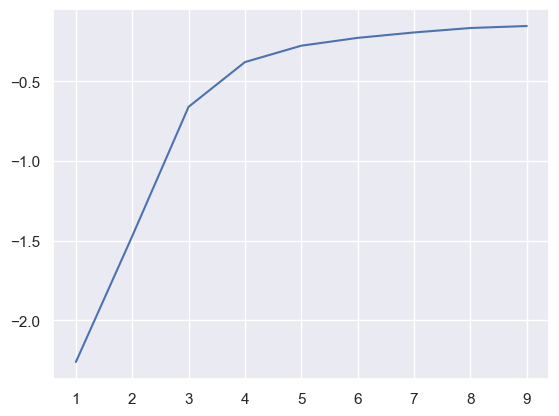

In [ ]:
k_vals = range(1, 10)
scores = []

for k in range(1, 10):
    kmeans_x = KMeans(n_clusters=k, random_state=0, n_init="auto").fit(attn_x)
    scores.append(kmeans_x.score(attn_x))

plt.plot(k_vals, scores)

In [ ]:
kmeans_x = KMeans(n_clusters=2, random_state=0, n_init="auto").fit(attn_x)

In [ ]:
kmeans_x.cluster_centers_[0]

array([ 2.09201226e-01,  5.68337473e-01,  5.01342007e-02,  1.45791117e-02,
        1.85601982e-02,  2.95504691e-03,  7.76029967e-03,  1.09188453e-03,
        9.91259994e-03,  7.52752476e-04,  1.96461496e-03,  1.76560317e-03,
        2.83522154e-03,  1.89753555e-04,  6.09921388e-03,  1.03233480e-03,
        3.12700928e-03,  8.72477225e-05,  1.78349107e-03,  7.78777265e-05,
        9.99840393e-04,  4.40412685e-05,  2.01546824e-03,  5.11725121e-04,
        2.92846506e-03,  3.12736764e-05,  2.16352343e-03,  2.03490329e-05,
        1.71970275e-02,  2.89781373e-05,  1.79756079e-03,  1.89889914e-05,
        2.04100006e-03,  2.36982007e-04,  2.72643050e-03,  1.07184580e-05,
        6.58089001e-03,  2.01644757e-04,  2.39625998e-03,  7.23184473e-06,
        4.87461160e-04,  7.88673959e-06,  7.64187848e-04,  6.29606611e-06,
        3.94167975e-03,  6.19432599e-06,  3.19593938e-03,  1.34948100e-04,
        5.83566256e-04,  4.57946454e-06,  1.59274138e-03,  9.06821815e-05,
        1.59714853e-03,  

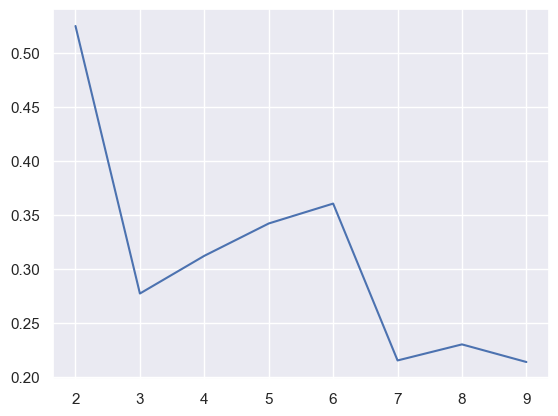

In [ ]:
k_vals = range(2, 10)
scores = []

for k in k_vals:
    kmeans_y = KMeans(n_clusters=k, random_state=0, n_init="auto").fit(attn_y)
    scores.append(silhouette_score(attn_y, kmeans_y.labels_))

plt.plot(k_vals, scores)

In [ ]:
kmeans_x.cluster_centers_[1]

array([1.99722936e-01, 3.88512457e-01, 4.78922862e-02, 1.65820125e-02,
       2.08205030e-02, 4.47841727e-03, 1.07966781e-02, 1.88165610e-03,
       1.26859000e-02, 1.54517383e-03, 3.45547515e-03, 3.35775749e-03,
       5.10843417e-03, 6.07720116e-04, 9.52435808e-03, 2.34528521e-03,
       5.78709277e-03, 3.81488259e-04, 3.61372317e-03, 3.57526803e-04,
       2.53456907e-03, 2.35004344e-04, 4.38096458e-03, 1.50831718e-03,
       5.89105439e-03, 1.89355328e-04, 4.60730953e-03, 1.41390487e-04,
       2.56373024e-02, 1.43588524e-04, 3.80823431e-03, 1.03027637e-04,
       4.64260093e-03, 8.09484285e-04, 5.61738008e-03, 7.59473169e-05,
       1.22210775e-02, 7.93643589e-04, 5.31235351e-03, 6.81499677e-05,
       1.91189640e-03, 7.32014738e-05, 2.45291810e-03, 6.15136270e-05,
       8.36576427e-03, 5.98458426e-05, 6.68541723e-03, 5.04646730e-04,
       1.63735373e-03, 3.39403851e-05, 3.48047633e-03, 3.60600834e-04,
       4.00184324e-03, 5.76575106e-05, 1.85301758e-03, 2.67783366e-05,
      